## Procedimiento para obtener tabla integrada ECS,P2,wind

In [5]:
import pandas as pd
import numpy as np

### Open tabla que contienen medidas de p2

In [6]:
pwd

'/Users/pcandia/Documents/GEMINI/Proyecto/Ventgates/tablas/VentGateProject/Tablas_csv/ML_work/ECS_position'

In [4]:
tb1=pd.read_csv("gmos_pwfs2_2022.csv")

In [5]:
tb1.head(10)

,fecha,datetime,pwfs2_see
0,12/31/21 11:53,44561.49553,0.341473
1,1/1/22 0:08,44562.00595,0.000000
2,1/1/22 0:57,44562.03975,0.000000
3,1/1/22 0:58,44562.04034,7.547265
4,1/1/22 0:58,44562.04091,1.916648
5,1/1/22 1:06,44562.04614,0.785322
6,1/1/22 1:07,44562.04671,0.864125
7,1/1/22 1:08,44562.04729,0.956818
8,1/1/22 1:08,44562.04787,0.857955
9,1/1/22 1:09,44562.04845,0.789396


In [9]:
tb1.shape

(65804, 3)

### Leer datos de viento

In [47]:
tv1= pd.read_csv("windsp_2022_2.csv")

In [48]:
tv1['fecha'].fillna(0, inplace=True)

In [49]:
tv1.head()

,fecha,datetime,windSp
0,12/31/21 17:59,44561.74931,4.3
1,12/31/21 18:04,44561.75278,3.6
2,12/31/21 18:09,44561.75625,5.0
3,12/31/21 18:14,44561.75972,4.5
4,12/31/21 18:19,44561.76319,3.6


In [50]:
tv1.shape

(52167, 3)

### Separar wind en intervalos de 5.2 minutos (usa tv1)

In [51]:
tpo=[]
wind=[]
fecha=[]
tw=[]
tw2=[]

for index,row in tv1.iterrows():
    #print('index:',index,'row:',row)
    for column in tv1.columns:
        if column=='datetime':
            tpo_value = row[column]
            #print('datetime-->',tpo_value)   
        if column=='fecha':
            fecha_value= row[column]
            #print("fecha->",fecha_value)
        if column=='windSp':
            w_value = row[column]
            #print('datetime-->',w_value)
            if w_value != 0:
                fecha.append(fecha_value)
                tpo.append(tpo_value)
                wind.append(w_value)
                tw=[tpo_value,fecha_value,w_value]
                tw2.append(tw)
            if w_value== 0:
                w_value=0.1
                wind.append(w_value)
                tw=[tpo_value,fecha_value,w_value]
                tw2.append(tw)
            
                
                
                    
print(tpo[0:20])
print(fecha[0:20])
print(wind[0:20])
print(tw2[0:5])
print(len(tpo),len(fecha),len(wind))


[44561.74931, 44561.75278, 44561.75625, 44561.75972, 44561.76319, 44561.76667, 44561.77014, 44561.773610000004, 44561.77708, 44561.78056, 44561.78403, 44561.7875, 44561.79097, 44561.79444, 44561.79792, 44561.80139, 44561.804860000004, 44561.80833, 44561.81181, 44561.81528]
['12/31/21 17:59', '12/31/21 18:04', '12/31/21 18:09', '12/31/21 18:14', '12/31/21 18:19', '12/31/21 18:24', '12/31/21 18:29', '12/31/21 18:34', '12/31/21 18:39', '12/31/21 18:44', '12/31/21 18:49', '12/31/21 18:54', '12/31/21 18:59', '12/31/21 19:04', '12/31/21 19:09', '12/31/21 19:14', '12/31/21 19:19', '12/31/21 19:24', '12/31/21 19:29', '12/31/21 19:34']
[4.3, 3.6, 5.0, 4.5, 3.6, 3.3, 1.9, 4.2, 3.1, 4.4, 5.4, 4.3, 2.9, 3.7, 4.4, 3.2, 4.4, 3.9, 4.5, 5.5]
[[44561.74931, '12/31/21 17:59', 4.3], [44561.75278, '12/31/21 18:04', 3.6], [44561.75625, '12/31/21 18:09', 5.0], [44561.75972, '12/31/21 18:14', 4.5], [44561.76319, '12/31/21 18:19', 3.6]]
51512 51512 52167


### Correr segundo script para obtener separacion del viento en 5.2min

In [52]:
dafi=[]
fech=[]
winf=[]
print(len(tpo),len(fecha),len(wind))
import numpy as np
for i in np.arange(len(tpo)-1):
    dif=(tpo[i+1]-tpo[i])*24*60
    #print(dif)
    print(tpo[i], tpo[i+1], dif)
    if dif<= 5.2:
        print("datetime-->",tpo[i],"fecha-->",fecha[i] ,  "wind-->",wind[i], "wind[i+1]:", wind[i+1], dif, (wind[i+1]+wind[i])/2)
        dafi.append(tpo[i])
        fech.append(fecha[i])
        winf.append(wind[i])

print(dafi[0:20])
print(fech[0:20])
print(winf[0:20])

print(len(dafi))
print(len(fech))
print(len(winf))

51512 51512 52167
44561.74931 44561.75278 4.996800004737452
datetime--> 44561.74931 fecha--> 12/31/21 17:59 wind--> 4.3 wind[i+1]: 3.6 4.996800004737452 3.95
44561.75278 44561.75625 4.996799994260073
datetime--> 44561.75278 fecha--> 12/31/21 18:04 wind--> 3.6 wind[i+1]: 5.0 4.996799994260073 4.3
44561.75625 44561.75972 4.996800004737452
datetime--> 44561.75625 fecha--> 12/31/21 18:09 wind--> 5.0 wind[i+1]: 4.5 4.996800004737452 4.75
44561.75972 44561.76319 4.996799994260073
datetime--> 44561.75972 fecha--> 12/31/21 18:14 wind--> 4.5 wind[i+1]: 3.6 4.996799994260073 4.05
44561.76319 44561.76667 5.011199999134988
datetime--> 44561.76319 fecha--> 12/31/21 18:19 wind--> 3.6 wind[i+1]: 3.3 5.011199999134988 3.45
44561.76667 44561.77014 4.996800004737452
datetime--> 44561.76667 fecha--> 12/31/21 18:24 wind--> 3.3 wind[i+1]: 1.9 4.996800004737452 2.5999999999999996
44561.77014 44561.773610000004 4.996800004737452
datetime--> 44561.77014 fecha--> 12/31/21 18:29 wind--> 1.9 wind[i+1]: 4.2 4.996

44562.84306 44562.84653 4.996800004737452
datetime--> 44562.84306 fecha--> 1/1/22 20:14 wind--> 5.8 wind[i+1]: 6.3 4.996800004737452 6.05
44562.84653 44562.85 4.996799994260073
datetime--> 44562.84653 fecha--> 1/1/22 20:19 wind--> 6.3 wind[i+1]: 5.6 4.996799994260073 5.949999999999999
44562.85 44562.85347 4.996800004737452
datetime--> 44562.85 fecha--> 1/1/22 20:24 wind--> 5.6 wind[i+1]: 4.5 4.996800004737452 5.05
44562.85347 44562.85694 4.996799994260073
datetime--> 44562.85347 fecha--> 1/1/22 20:29 wind--> 4.5 wind[i+1]: 4.2 4.996799994260073 4.35
44562.85694 44562.86042 5.011199999134988
datetime--> 44562.85694 fecha--> 1/1/22 20:34 wind--> 4.2 wind[i+1]: 6.6 5.011199999134988 5.4
44562.86042 44562.86389 4.996800004737452
datetime--> 44562.86042 fecha--> 1/1/22 20:39 wind--> 6.6 wind[i+1]: 6.2 4.996800004737452 6.4
44562.86389 44562.867360000004 4.996800004737452
datetime--> 44562.86389 fecha--> 1/1/22 20:44 wind--> 6.2 wind[i+1]: 2.5 4.996800004737452 4.35
44562.867360000004 44562.

datetime--> 44563.54444 fecha--> 1/2/22 13:04 wind--> 5.6 wind[i+1]: 5.5 5.011199999134988 5.55
44563.54792 44563.55139 4.996800004737452
datetime--> 44563.54792 fecha--> 1/2/22 13:09 wind--> 5.5 wind[i+1]: 5.8 4.996800004737452 5.65
44563.55139 44563.554860000004 4.996800004737452
datetime--> 44563.55139 fecha--> 1/2/22 13:14 wind--> 5.8 wind[i+1]: 5.7 4.996800004737452 5.75
44563.554860000004 44563.55833 4.996799994260073
datetime--> 44563.554860000004 fecha--> 1/2/22 13:19 wind--> 5.7 wind[i+1]: 4.8 4.996799994260073 5.25
44563.55833 44563.56181 5.011199999134988
datetime--> 44563.55833 fecha--> 1/2/22 13:24 wind--> 4.8 wind[i+1]: 5.2 5.011199999134988 5.0
44563.56181 44563.57222 14.990400003734976
44563.57222 44563.57569 4.996799994260073
datetime--> 44563.57222 fecha--> 1/2/22 13:44 wind--> 5.4 wind[i+1]: 5.3 4.996799994260073 5.35
44563.57569 44563.57917 5.011199999134988
datetime--> 44563.57569 fecha--> 1/2/22 13:49 wind--> 5.3 wind[i+1]: 4.3 5.011199999134988 4.8
44563.57917 44

datetime--> 44564.67292 fecha--> 1/3/22 16:09 wind--> 2.8 wind[i+1]: 2.4 4.996800004737452 2.5999999999999996
44564.67639 44564.679860000004 4.996800004737452
datetime--> 44564.67639 fecha--> 1/3/22 16:14 wind--> 2.4 wind[i+1]: 1.5 4.996800004737452 1.95
44564.679860000004 44564.68333 4.996799994260073
datetime--> 44564.679860000004 fecha--> 1/3/22 16:19 wind--> 1.5 wind[i+1]: 1.8 4.996799994260073 1.65
44564.68333 44564.68681 5.011199999134988
datetime--> 44564.68333 fecha--> 1/3/22 16:24 wind--> 1.8 wind[i+1]: 3.2 5.011199999134988 2.5
44564.68681 44564.69028 4.996800004737452
datetime--> 44564.68681 fecha--> 1/3/22 16:29 wind--> 3.2 wind[i+1]: 3.8 4.996800004737452 3.5
44564.69028 44564.69375 4.996799994260073
datetime--> 44564.69028 fecha--> 1/3/22 16:34 wind--> 3.8 wind[i+1]: 3.7 4.996799994260073 3.75
44564.69375 44564.69722 4.996800004737452
datetime--> 44564.69375 fecha--> 1/3/22 16:39 wind--> 3.7 wind[i+1]: 5.9 4.996800004737452 4.800000000000001
44564.69722 44564.70069 4.9967

datetime--> 44565.92292 fecha--> 1/4/22 22:09 wind--> 2.3 wind[i+1]: 3.8 4.996800004737452 3.05
44565.92639 44565.929860000004 4.996800004737452
datetime--> 44565.92639 fecha--> 1/4/22 22:14 wind--> 3.8 wind[i+1]: 3.5 4.996800004737452 3.65
44565.929860000004 44565.93333 4.996799994260073
datetime--> 44565.929860000004 fecha--> 1/4/22 22:19 wind--> 3.5 wind[i+1]: 4.3 4.996799994260073 3.9
44565.93333 44565.93681 5.011199999134988
datetime--> 44565.93333 fecha--> 1/4/22 22:24 wind--> 4.3 wind[i+1]: 2.9 5.011199999134988 3.5999999999999996
44565.93681 44565.94028 4.996800004737452
datetime--> 44565.93681 fecha--> 1/4/22 22:29 wind--> 2.9 wind[i+1]: 5.0 4.996800004737452 3.95
44565.94028 44565.94375 4.996799994260073
datetime--> 44565.94028 fecha--> 1/4/22 22:34 wind--> 5.0 wind[i+1]: 2.3 4.996799994260073 3.65
44565.94375 44565.94722 4.996800004737452
datetime--> 44565.94375 fecha--> 1/4/22 22:39 wind--> 2.3 wind[i+1]: 4.8 4.996800004737452 3.55
44565.94722 44565.95069 4.996799994260073


datetime--> 44567.06875 fecha--> 1/6/22 1:39 wind--> 0.6 wind[i+1]: 1.3 4.996800004737452 0.95
44567.07222 44567.07569 4.996799994260073
datetime--> 44567.07222 fecha--> 1/6/22 1:44 wind--> 1.3 wind[i+1]: 0.1 4.996799994260073 0.7000000000000001
44567.07569 44567.07917 5.011199999134988
datetime--> 44567.07569 fecha--> 1/6/22 1:49 wind--> 0.1 wind[i+1]: 0.9 5.011199999134988 0.5
44567.07917 44567.08264 4.996800004737452
datetime--> 44567.07917 fecha--> 1/6/22 1:54 wind--> 0.9 wind[i+1]: 1.1 4.996800004737452 1.0
44567.08264 44567.086110000004 4.996800004737452
datetime--> 44567.08264 fecha--> 1/6/22 1:59 wind--> 1.1 wind[i+1]: 0.2 4.996800004737452 0.65
44567.086110000004 44567.09306 10.00799999339506
44567.09306 44567.09653 4.996800004737452
datetime--> 44567.09306 fecha--> 1/6/22 2:14 wind--> 0.6 wind[i+1]: 0.3 4.996800004737452 0.44999999999999996
44567.09653 44567.1 4.996799994260073
datetime--> 44567.09653 fecha--> 1/6/22 2:19 wind--> 0.3 wind[i+1]: 0.1 4.996799994260073 0.2
44567

44568.33958 44568.34306 5.011199999134988
datetime--> 44568.33958 fecha--> 1/7/22 8:09 wind--> 1.3 wind[i+1]: 1.0 5.011199999134988 1.15
44568.34306 44568.34653 4.996800004737452
datetime--> 44568.34306 fecha--> 1/7/22 8:14 wind--> 1.0 wind[i+1]: 1.2 4.996800004737452 1.1
44568.34653 44568.35347 9.993599998997524
44568.35347 44568.36042 10.00799999339506
44568.36042 44568.36389 4.996800004737452
datetime--> 44568.36042 fecha--> 1/7/22 8:39 wind--> 1.4 wind[i+1]: 1.5 4.996800004737452 1.45
44568.36389 44568.37083 9.993599998997524
44568.37083 44568.37431 5.011199999134988
datetime--> 44568.37083 fecha--> 1/7/22 8:54 wind--> 1.6 wind[i+1]: 1.7 5.011199999134988 1.65
44568.37431 44568.38125 9.993599998997524
44568.38125 44568.38472 4.996800004737452
datetime--> 44568.38125 fecha--> 1/7/22 9:09 wind--> 1.8 wind[i+1]: 1.6 4.996800004737452 1.7000000000000002
44568.38472 44568.38819 4.996799994260073
datetime--> 44568.38472 fecha--> 1/7/22 9:14 wind--> 1.6 wind[i+1]: 1.1 4.996799994260073 1.

datetime--> 44569.554860000004 fecha--> 1/8/22 13:19 wind--> 5.5 wind[i+1]: 6.4 4.996799994260073 5.95
44569.55833 44569.56181 5.011199999134988
datetime--> 44569.55833 fecha--> 1/8/22 13:24 wind--> 6.4 wind[i+1]: 6.2 5.011199999134988 6.300000000000001
44569.56181 44569.56528 4.996800004737452
datetime--> 44569.56181 fecha--> 1/8/22 13:29 wind--> 6.2 wind[i+1]: 4.6 4.996800004737452 5.4
44569.56528 44569.56875 4.996799994260073
datetime--> 44569.56528 fecha--> 1/8/22 13:34 wind--> 4.6 wind[i+1]: 6.0 4.996799994260073 5.3
44569.56875 44569.57222 4.996800004737452
datetime--> 44569.56875 fecha--> 1/8/22 13:39 wind--> 6.0 wind[i+1]: 6.3 4.996800004737452 6.15
44569.57222 44569.57569 4.996799994260073
datetime--> 44569.57222 fecha--> 1/8/22 13:44 wind--> 6.3 wind[i+1]: 6.0 4.996799994260073 6.15
44569.57569 44569.57917 5.011199999134988
datetime--> 44569.57569 fecha--> 1/8/22 13:49 wind--> 6.0 wind[i+1]: 5.9 5.011199999134988 5.95
44569.57917 44569.58264 4.996800004737452
datetime--> 4456

datetime--> 44570.69028 fecha--> 1/9/22 16:34 wind--> 1.4 wind[i+1]: 1.9 4.996799994260073 1.65
44570.69375 44570.69722 4.996800004737452
datetime--> 44570.69375 fecha--> 1/9/22 16:39 wind--> 1.9 wind[i+1]: 1.3 4.996800004737452 1.6
44570.69722 44570.70069 4.996799994260073
datetime--> 44570.69722 fecha--> 1/9/22 16:44 wind--> 1.3 wind[i+1]: 1.4 4.996799994260073 1.35
44570.70069 44570.70417 5.011199999134988
datetime--> 44570.70069 fecha--> 1/9/22 16:49 wind--> 1.4 wind[i+1]: 2.1 5.011199999134988 1.75
44570.70417 44570.70764 4.996800004737452
datetime--> 44570.70417 fecha--> 1/9/22 16:54 wind--> 2.1 wind[i+1]: 2.2 4.996800004737452 2.1500000000000004
44570.70764 44570.711110000004 4.996800004737452
datetime--> 44570.70764 fecha--> 1/9/22 16:59 wind--> 2.2 wind[i+1]: 0.9 4.996800004737452 1.55
44570.711110000004 44570.71458 4.996799994260073
datetime--> 44570.711110000004 fecha--> 1/9/22 17:04 wind--> 0.9 wind[i+1]: 1.6 4.996799994260073 1.25
44570.71458 44570.71806 5.011199999134988


datetime--> 44571.93681 fecha--> 1/10/22 22:29 wind--> 4.5 wind[i+1]: 4.3 4.996800004737452 4.4
44571.94028 44571.94375 4.996799994260073
datetime--> 44571.94028 fecha--> 1/10/22 22:34 wind--> 4.3 wind[i+1]: 5.5 4.996799994260073 4.9
44571.94375 44571.94722 4.996800004737452
datetime--> 44571.94375 fecha--> 1/10/22 22:39 wind--> 5.5 wind[i+1]: 3.7 4.996800004737452 4.6
44571.94722 44571.95069 4.996799994260073
datetime--> 44571.94722 fecha--> 1/10/22 22:44 wind--> 3.7 wind[i+1]: 3.8 4.996799994260073 3.75
44571.95069 44571.95417 5.011199999134988
datetime--> 44571.95069 fecha--> 1/10/22 22:49 wind--> 3.8 wind[i+1]: 6.4 5.011199999134988 5.1
44571.95417 44571.95764 4.996800004737452
datetime--> 44571.95417 fecha--> 1/10/22 22:54 wind--> 6.4 wind[i+1]: 4.6 4.996800004737452 5.5
44571.95764 44571.961110000004 4.996800004737452
datetime--> 44571.95764 fecha--> 1/10/22 22:59 wind--> 4.6 wind[i+1]: 2.5 4.996800004737452 3.55
44571.961110000004 44571.96458 4.996799994260073
datetime--> 44571.

datetime--> 44572.98889 fecha--> 1/11/22 23:44 wind--> 5.0 wind[i+1]: 5.3 4.996800004737452 5.15
44572.992360000004 44572.99583 4.996799994260073
datetime--> 44572.992360000004 fecha--> 1/11/22 23:49 wind--> 5.3 wind[i+1]: 3.4 4.996799994260073 4.35
44572.99583 44572.99931 5.011199999134988
datetime--> 44572.99583 fecha--> 1/11/22 23:54 wind--> 3.4 wind[i+1]: 3.3 5.011199999134988 3.3499999999999996
44572.99931 44573.00278 4.996800004737452
datetime--> 44572.99931 fecha--> 1/11/22 23:59 wind--> 3.3 wind[i+1]: 3.4 4.996800004737452 3.3499999999999996
44573.00278 44573.00625 4.996799994260073
datetime--> 44573.00278 fecha--> 1/12/22 0:04 wind--> 3.4 wind[i+1]: 1.5 4.996799994260073 2.45
44573.00625 44573.00972 4.996800004737452
datetime--> 44573.00625 fecha--> 1/12/22 0:09 wind--> 1.5 wind[i+1]: 0.7 4.996800004737452 1.1
44573.00972 44573.01319 4.996799994260073
datetime--> 44573.00972 fecha--> 1/12/22 0:14 wind--> 0.7 wind[i+1]: 3.9 4.996799994260073 2.3
44573.01319 44573.01667 5.011199

datetime--> 44574.29792 fecha--> 1/13/22 7:09 wind--> 0.9 wind[i+1]: 0.7 4.996800004737452 0.8
44574.30139 44574.304860000004 4.996800004737452
datetime--> 44574.30139 fecha--> 1/13/22 7:14 wind--> 0.7 wind[i+1]: 1.2 4.996800004737452 0.95
44574.304860000004 44574.30833 4.996799994260073
datetime--> 44574.304860000004 fecha--> 1/13/22 7:19 wind--> 1.2 wind[i+1]: 1.0 4.996799994260073 1.1
44574.30833 44574.31181 5.011199999134988
datetime--> 44574.30833 fecha--> 1/13/22 7:24 wind--> 1.0 wind[i+1]: 1.1 5.011199999134988 1.05
44574.31181 44574.31528 4.996800004737452
datetime--> 44574.31181 fecha--> 1/13/22 7:29 wind--> 1.1 wind[i+1]: 1.2 4.996800004737452 1.15
44574.31528 44574.31875 4.996799994260073
datetime--> 44574.31528 fecha--> 1/13/22 7:34 wind--> 1.2 wind[i+1]: 0.4 4.996799994260073 0.8
44574.31875 44574.32222 4.996800004737452
datetime--> 44574.31875 fecha--> 1/13/22 7:39 wind--> 0.4 wind[i+1]: 1.2 4.996800004737452 0.8
44574.32222 44574.32569 4.996799994260073
datetime--> 44574

44575.60347 44575.60694 4.996799994260073
datetime--> 44575.60347 fecha--> 1/14/22 14:29 wind--> 1.8 wind[i+1]: 2.2 4.996799994260073 2.0
44575.60694 44575.61042 5.011199999134988
datetime--> 44575.60694 fecha--> 1/14/22 14:34 wind--> 2.2 wind[i+1]: 2.1 5.011199999134988 2.1500000000000004
44575.61042 44575.61389 4.996800004737452
datetime--> 44575.61042 fecha--> 1/14/22 14:39 wind--> 2.1 wind[i+1]: 2.3 4.996800004737452 2.2
44575.61389 44575.617360000004 4.996800004737452
datetime--> 44575.61389 fecha--> 1/14/22 14:44 wind--> 2.3 wind[i+1]: 2.4 4.996800004737452 2.3499999999999996
44575.617360000004 44575.62083 4.996799994260073
datetime--> 44575.617360000004 fecha--> 1/14/22 14:49 wind--> 2.4 wind[i+1]: 2.8 4.996799994260073 2.5999999999999996
44575.62083 44575.62431 5.011199999134988
datetime--> 44575.62083 fecha--> 1/14/22 14:54 wind--> 2.8 wind[i+1]: 2.6 5.011199999134988 2.7
44575.62431 44575.62778 4.996800004737452
datetime--> 44575.62431 fecha--> 1/14/22 14:59 wind--> 2.6 wind[

datetime--> 44576.888889999995 fecha--> 1/15/22 21:20 wind--> 6.0 wind[i+1]: 6.8 4.996800015214831 6.4
44576.892360000005 44576.89583 4.996799994260073
datetime--> 44576.892360000005 fecha--> 1/15/22 21:25 wind--> 6.8 wind[i+1]: 5.7 4.996799994260073 6.25
44576.89583 44576.89931 5.011199999134988
datetime--> 44576.89583 fecha--> 1/15/22 21:30 wind--> 5.7 wind[i+1]: 7.5 5.011199999134988 6.6
44576.89931 44576.902780000004 4.996800004737452
datetime--> 44576.89931 fecha--> 1/15/22 21:35 wind--> 7.5 wind[i+1]: 7.6 4.996800004737452 7.55
44576.902780000004 44576.90625 4.996799994260073
datetime--> 44576.902780000004 fecha--> 1/15/22 21:40 wind--> 7.6 wind[i+1]: 6.6 4.996799994260073 7.1
44576.90625 44576.909719999996 4.996799994260073
datetime--> 44576.90625 fecha--> 1/15/22 21:45 wind--> 6.6 wind[i+1]: 8.5 4.996799994260073 7.55
44576.909719999996 44576.91319 4.996800004737452
datetime--> 44576.909719999996 fecha--> 1/15/22 21:50 wind--> 8.5 wind[i+1]: 7.1 4.996800004737452 7.8
44576.9131

44578.027780000004 44578.03125 4.996799994260073
datetime--> 44578.027780000004 fecha--> 1/17/22 0:40 wind--> 5.6 wind[i+1]: 5.5 4.996799994260073 5.55
44578.03125 44578.034719999996 4.996799994260073
datetime--> 44578.03125 fecha--> 1/17/22 0:45 wind--> 5.5 wind[i+1]: 6.6 4.996799994260073 6.05
44578.034719999996 44578.03819 4.996800004737452
datetime--> 44578.034719999996 fecha--> 1/17/22 0:50 wind--> 6.6 wind[i+1]: 6.7 4.996800004737452 6.65
44578.03819 44578.04167 5.011199999134988
datetime--> 44578.03819 fecha--> 1/17/22 0:55 wind--> 6.7 wind[i+1]: 4.6 5.011199999134988 5.65
44578.04167 44578.045139999995 4.996799994260073
datetime--> 44578.04167 fecha--> 1/17/22 1:00 wind--> 4.6 wind[i+1]: 7.0 4.996799994260073 5.8
44578.045139999995 44578.048610000005 4.996800015214831
datetime--> 44578.045139999995 fecha--> 1/17/22 1:05 wind--> 7.0 wind[i+1]: 8.4 4.996800015214831 7.7
44578.048610000005 44578.05208 4.996799994260073
datetime--> 44578.048610000005 fecha--> 1/17/22 1:10 wind--> 8

datetime--> 44579.05556 fecha--> 1/18/22 1:20 wind--> 7.9 wind[i+1]: 4.1 4.996800004737452 6.0
44579.059030000004 44579.0625 4.996799994260073
datetime--> 44579.059030000004 fecha--> 1/18/22 1:25 wind--> 4.1 wind[i+1]: 7.7 4.996799994260073 5.9
44579.0625 44579.065969999996 4.996799994260073
datetime--> 44579.0625 fecha--> 1/18/22 1:30 wind--> 7.7 wind[i+1]: 7.2 4.996799994260073 7.45
44579.065969999996 44579.06944 4.996800004737452
datetime--> 44579.065969999996 fecha--> 1/18/22 1:35 wind--> 7.2 wind[i+1]: 10.6 4.996800004737452 8.9
44579.06944 44579.07292 5.011199999134988
datetime--> 44579.06944 fecha--> 1/18/22 1:40 wind--> 10.6 wind[i+1]: 6.9 5.011199999134988 8.75
44579.07292 44579.079860000005 9.993600009474903
44579.079860000005 44579.08333 4.996799994260073
datetime--> 44579.079860000005 fecha--> 1/18/22 1:55 wind--> 7.3 wind[i+1]: 6.2 4.996799994260073 6.75
44579.08333 44579.08681 5.011199999134988
datetime--> 44579.08333 fecha--> 1/18/22 2:00 wind--> 6.2 wind[i+1]: 9.3 5.011

datetime--> 44580.138889999995 fecha--> 1/19/22 3:20 wind--> 10.4 wind[i+1]: 5.0 4.996800015214831 7.7
44580.142360000005 44580.14583 4.996799994260073
datetime--> 44580.142360000005 fecha--> 1/19/22 3:25 wind--> 5.0 wind[i+1]: 8.1 4.996799994260073 6.55
44580.14583 44580.14931 5.011199999134988
datetime--> 44580.14583 fecha--> 1/19/22 3:30 wind--> 8.1 wind[i+1]: 9.4 5.011199999134988 8.75
44580.14931 44580.152780000004 4.996800004737452
datetime--> 44580.14931 fecha--> 1/19/22 3:35 wind--> 9.4 wind[i+1]: 5.3 4.996800004737452 7.35
44580.152780000004 44580.15625 4.996799994260073
datetime--> 44580.152780000004 fecha--> 1/19/22 3:40 wind--> 5.3 wind[i+1]: 7.7 4.996799994260073 6.5
44580.15625 44580.159719999996 4.996799994260073
datetime--> 44580.15625 fecha--> 1/19/22 3:45 wind--> 7.7 wind[i+1]: 8.7 4.996799994260073 8.2
44580.159719999996 44580.16319 4.996800004737452
datetime--> 44580.159719999996 fecha--> 1/19/22 3:50 wind--> 8.7 wind[i+1]: 6.5 4.996800004737452 7.6
44580.16319 4458

44581.27708 44581.28056 5.011199999134988
datetime--> 44581.27708 fecha--> 1/20/22 6:39 wind--> 13.2 wind[i+1]: 12.2 5.011199999134988 12.7
44581.28056 44581.28403 4.996800004737452
datetime--> 44581.28056 fecha--> 1/20/22 6:44 wind--> 12.2 wind[i+1]: 11.9 4.996800004737452 12.05
44581.28403 44581.2875 4.996799994260073
datetime--> 44581.28403 fecha--> 1/20/22 6:49 wind--> 11.9 wind[i+1]: 11.4 4.996799994260073 11.65
44581.2875 44581.29097 4.996800004737452
datetime--> 44581.2875 fecha--> 1/20/22 6:54 wind--> 11.4 wind[i+1]: 14.5 4.996800004737452 12.95
44581.29097 44581.29444 4.996799994260073
datetime--> 44581.29097 fecha--> 1/20/22 6:59 wind--> 14.5 wind[i+1]: 12.8 4.996799994260073 13.65
44581.29444 44581.29792 5.011199999134988
datetime--> 44581.29444 fecha--> 1/20/22 7:04 wind--> 12.8 wind[i+1]: 12.0 5.011199999134988 12.4
44581.29792 44581.30139 4.996800004737452
datetime--> 44581.29792 fecha--> 1/20/22 7:09 wind--> 12.0 wind[i+1]: 11.5 4.996800004737452 11.75
44581.30139 44581.

44582.32292 44582.326389999995 4.996799994260073
datetime--> 44582.32292 fecha--> 1/21/22 7:45 wind--> 5.3 wind[i+1]: 4.6 4.996799994260073 4.949999999999999
44582.326389999995 44582.329860000005 4.996800015214831
datetime--> 44582.326389999995 fecha--> 1/21/22 7:50 wind--> 4.6 wind[i+1]: 4.7 4.996800015214831 4.65
44582.329860000005 44582.33333 4.996799994260073
datetime--> 44582.329860000005 fecha--> 1/21/22 7:55 wind--> 4.7 wind[i+1]: 4.5 4.996799994260073 4.6
44582.33333 44582.33681 5.011199999134988
datetime--> 44582.33333 fecha--> 1/21/22 8:00 wind--> 4.5 wind[i+1]: 4.3 5.011199999134988 4.4
44582.33681 44582.340280000004 4.996800004737452
datetime--> 44582.33681 fecha--> 1/21/22 8:05 wind--> 4.3 wind[i+1]: 4.6 4.996800004737452 4.449999999999999
44582.340280000004 44582.34375 4.996799994260073
datetime--> 44582.340280000004 fecha--> 1/21/22 8:10 wind--> 4.6 wind[i+1]: 5.2 4.996799994260073 4.9
44582.34375 44582.347219999996 4.996799994260073
datetime--> 44582.34375 fecha--> 1/21

datetime--> 44583.611110000005 fecha--> 1/22/22 14:40 wind--> 4.2 wind[i+1]: 4.7 4.996799994260073 4.45
44583.61458 44583.61806 5.011199999134988
datetime--> 44583.61458 fecha--> 1/22/22 14:45 wind--> 4.7 wind[i+1]: 4.5 5.011199999134988 4.6
44583.61806 44583.621530000004 4.996800004737452
datetime--> 44583.61806 fecha--> 1/22/22 14:50 wind--> 4.5 wind[i+1]: 4.1 4.996800004737452 4.3
44583.621530000004 44583.625 4.996799994260073
datetime--> 44583.621530000004 fecha--> 1/22/22 14:55 wind--> 4.1 wind[i+1]: 3.5 4.996799994260073 3.8
44583.625 44583.628469999996 4.996799994260073
datetime--> 44583.625 fecha--> 1/22/22 15:00 wind--> 3.5 wind[i+1]: 3.6 4.996799994260073 3.55
44583.628469999996 44583.63194 4.996800004737452
datetime--> 44583.628469999996 fecha--> 1/22/22 15:05 wind--> 3.6 wind[i+1]: 4.1 4.996800004737452 3.8499999999999996
44583.63194 44583.63542 5.011199999134988
datetime--> 44583.63194 fecha--> 1/22/22 15:10 wind--> 4.1 wind[i+1]: 4.2 5.011199999134988 4.15
44583.63542 445

datetime--> 44584.77083 fecha--> 1/23/22 18:30 wind--> 1.3 wind[i+1]: 1.0 5.011199999134988 1.15
44584.77431 44584.777780000004 4.996800004737452
datetime--> 44584.77431 fecha--> 1/23/22 18:35 wind--> 1.0 wind[i+1]: 1.8 4.996800004737452 1.4
44584.777780000004 44584.78125 4.996799994260073
datetime--> 44584.777780000004 fecha--> 1/23/22 18:40 wind--> 1.8 wind[i+1]: 2.7 4.996799994260073 2.25
44584.78125 44584.784719999996 4.996799994260073
datetime--> 44584.78125 fecha--> 1/23/22 18:45 wind--> 2.7 wind[i+1]: 2.1 4.996799994260073 2.4000000000000004
44584.784719999996 44584.78819 4.996800004737452
datetime--> 44584.784719999996 fecha--> 1/23/22 18:50 wind--> 2.1 wind[i+1]: 2.0 4.996800004737452 2.05
44584.78819 44584.79167 5.011199999134988
datetime--> 44584.78819 fecha--> 1/23/22 18:55 wind--> 2.0 wind[i+1]: 1.9 5.011199999134988 1.95
44584.79167 44584.795139999995 4.996799994260073
datetime--> 44584.79167 fecha--> 1/23/22 19:00 wind--> 1.9 wind[i+1]: 1.8 4.996799994260073 1.85
44584.7

datetime--> 44585.88194 fecha--> 1/24/22 21:10 wind--> 0.8 wind[i+1]: 0.3 5.011199999134988 0.55
44585.88542 44585.888889999995 4.996799994260073
datetime--> 44585.88542 fecha--> 1/24/22 21:15 wind--> 0.3 wind[i+1]: 1.6 4.996799994260073 0.9500000000000001
44585.888889999995 44585.892360000005 4.996800015214831
datetime--> 44585.888889999995 fecha--> 1/24/22 21:20 wind--> 1.6 wind[i+1]: 2.0 4.996800015214831 1.8
44585.892360000005 44585.89583 4.996799994260073
datetime--> 44585.892360000005 fecha--> 1/24/22 21:25 wind--> 2.0 wind[i+1]: 1.6 4.996799994260073 1.8
44585.89583 44585.89931 5.011199999134988
datetime--> 44585.89583 fecha--> 1/24/22 21:30 wind--> 1.6 wind[i+1]: 2.3 5.011199999134988 1.95
44585.89931 44585.902780000004 4.996800004737452
datetime--> 44585.89931 fecha--> 1/24/22 21:35 wind--> 2.3 wind[i+1]: 1.4 4.996800004737452 1.8499999999999999
44585.902780000004 44585.90625 4.996799994260073
datetime--> 44585.902780000004 fecha--> 1/24/22 21:40 wind--> 1.4 wind[i+1]: 1.1 4.9

44587.17292 44587.17639 4.996800004737452
datetime--> 44587.17292 fecha--> 1/26/22 4:09 wind--> 2.2 wind[i+1]: 6.2 4.996800004737452 4.2
44587.17639 44587.179860000004 4.996800004737452
datetime--> 44587.17639 fecha--> 1/26/22 4:14 wind--> 6.2 wind[i+1]: 2.3 4.996800004737452 4.25
44587.179860000004 44587.18333 4.996799994260073
datetime--> 44587.179860000004 fecha--> 1/26/22 4:19 wind--> 2.3 wind[i+1]: 6.4 4.996799994260073 4.35
44587.18333 44587.18681 5.011199999134988
datetime--> 44587.18333 fecha--> 1/26/22 4:24 wind--> 6.4 wind[i+1]: 3.8 5.011199999134988 5.1
44587.18681 44587.19028 4.996800004737452
datetime--> 44587.18681 fecha--> 1/26/22 4:29 wind--> 3.8 wind[i+1]: 5.6 4.996800004737452 4.699999999999999
44587.19028 44587.19375 4.996799994260073
datetime--> 44587.19028 fecha--> 1/26/22 4:34 wind--> 5.6 wind[i+1]: 4.7 4.996799994260073 5.15
44587.19375 44587.19722 4.996800004737452
datetime--> 44587.19375 fecha--> 1/26/22 4:39 wind--> 4.7 wind[i+1]: 4.3 4.996800004737452 4.5
445

datetime--> 44588.375 fecha--> 1/27/22 9:00 wind--> 1.2 wind[i+1]: 0.3 4.996799994260073 0.75
44588.378469999996 44588.38194 4.996800004737452
datetime--> 44588.378469999996 fecha--> 1/27/22 9:05 wind--> 0.3 wind[i+1]: 2.2 4.996800004737452 1.25
44588.38194 44588.38542 5.011199999134988
datetime--> 44588.38194 fecha--> 1/27/22 9:10 wind--> 2.2 wind[i+1]: 1.1 5.011199999134988 1.6500000000000001
44588.38542 44588.388889999995 4.996799994260073
datetime--> 44588.38542 fecha--> 1/27/22 9:15 wind--> 1.1 wind[i+1]: 1.3 4.996799994260073 1.2000000000000002
44588.388889999995 44588.392360000005 4.996800015214831
datetime--> 44588.388889999995 fecha--> 1/27/22 9:20 wind--> 1.3 wind[i+1]: 1.2 4.996800015214831 1.25
44588.392360000005 44588.39583 4.996799994260073
datetime--> 44588.392360000005 fecha--> 1/27/22 9:25 wind--> 1.2 wind[i+1]: 1.6 4.996799994260073 1.4
44588.39583 44588.39931 5.011199999134988
datetime--> 44588.39583 fecha--> 1/27/22 9:30 wind--> 1.6 wind[i+1]: 1.2 5.011199999134988 

44589.66944 44589.67292 5.011199999134988
datetime--> 44589.66944 fecha--> 1/28/22 16:04 wind--> 1.1 wind[i+1]: 1.3 5.011199999134988 1.2000000000000002
44589.67292 44589.67639 4.996800004737452
datetime--> 44589.67292 fecha--> 1/28/22 16:09 wind--> 1.3 wind[i+1]: 1.5 4.996800004737452 1.4
44589.67639 44589.679860000004 4.996800004737452
datetime--> 44589.67639 fecha--> 1/28/22 16:14 wind--> 1.5 wind[i+1]: 1.6 4.996800004737452 1.55
44589.679860000004 44589.68333 4.996799994260073
datetime--> 44589.679860000004 fecha--> 1/28/22 16:19 wind--> 1.6 wind[i+1]: 1.3 4.996799994260073 1.4500000000000002
44589.68333 44589.68681 5.011199999134988
datetime--> 44589.68333 fecha--> 1/28/22 16:24 wind--> 1.3 wind[i+1]: 1.4 5.011199999134988 1.35
44589.68681 44589.69028 4.996800004737452
datetime--> 44589.68681 fecha--> 1/28/22 16:29 wind--> 1.4 wind[i+1]: 1.2 4.996800004737452 1.2999999999999998
44589.69028 44589.69375 4.996799994260073
datetime--> 44589.69028 fecha--> 1/28/22 16:34 wind--> 1.2 win

datetime--> 44590.88819 fecha--> 1/29/22 21:19 wind--> 1.1 wind[i+1]: 0.9 5.011199999134988 1.0
44590.89167 44590.89514 4.996800004737452
datetime--> 44590.89167 fecha--> 1/29/22 21:24 wind--> 0.9 wind[i+1]: 0.7 4.996800004737452 0.8
44590.89514 44590.898610000004 4.996800004737452
datetime--> 44590.89514 fecha--> 1/29/22 21:29 wind--> 0.7 wind[i+1]: 1.4 4.996800004737452 1.0499999999999998
44590.898610000004 44590.90208 4.996799994260073
datetime--> 44590.898610000004 fecha--> 1/29/22 21:34 wind--> 1.4 wind[i+1]: 1.8 4.996799994260073 1.6
44590.90208 44590.909719999996 11.00159999448806
44590.909719999996 44590.91319 4.996800004737452
datetime--> 44590.909719999996 fecha--> 1/29/22 21:50 wind--> 0.8 wind[i+1]: 1.2 4.996800004737452 1.0
44590.91319 44590.91667 5.011199999134988
datetime--> 44590.91319 fecha--> 1/29/22 21:55 wind--> 1.2 wind[i+1]: 0.8 5.011199999134988 1.0
44590.91667 44590.920139999995 4.996799994260073
datetime--> 44590.91667 fecha--> 1/29/22 22:00 wind--> 0.8 wind[i+

datetime--> 44592.11042 fecha--> 1/31/22 2:39 wind--> 0.9 wind[i+1]: 0.7 4.996800004737452 0.8
44592.11389 44592.117360000004 4.996800004737452
datetime--> 44592.11389 fecha--> 1/31/22 2:44 wind--> 0.7 wind[i+1]: 2.2 4.996800004737452 1.4500000000000002
44592.117360000004 44592.12431 10.00799999339506
44592.12431 44592.12778 4.996800004737452
datetime--> 44592.12431 fecha--> 1/31/22 2:59 wind--> 3.0 wind[i+1]: 4.6 4.996800004737452 3.8
44592.12778 44592.13125 4.996799994260073
datetime--> 44592.12778 fecha--> 1/31/22 3:04 wind--> 4.6 wind[i+1]: 1.8 4.996799994260073 3.1999999999999997
44592.13125 44592.13472 4.996800004737452
datetime--> 44592.13125 fecha--> 1/31/22 3:09 wind--> 1.8 wind[i+1]: 2.0 4.996800004737452 1.9
44592.13472 44592.13819 4.996799994260073
datetime--> 44592.13472 fecha--> 1/31/22 3:14 wind--> 2.0 wind[i+1]: 1.7 4.996799994260073 1.85
44592.13819 44592.14167 5.011199999134988
datetime--> 44592.13819 fecha--> 1/31/22 3:19 wind--> 1.7 wind[i+1]: 3.5 5.011199999134988 

datetime--> 44593.38542 fecha--> 2/1/22 9:15 wind--> 0.4 wind[i+1]: 2.3 4.996799994260073 1.3499999999999999
44593.388889999995 44593.392360000005 4.996800015214831
datetime--> 44593.388889999995 fecha--> 2/1/22 9:20 wind--> 2.3 wind[i+1]: 3.2 4.996800015214831 2.75
44593.392360000005 44593.39583 4.996799994260073
datetime--> 44593.392360000005 fecha--> 2/1/22 9:25 wind--> 3.2 wind[i+1]: 1.0 4.996799994260073 2.1
44593.39583 44593.39931 5.011199999134988
datetime--> 44593.39583 fecha--> 2/1/22 9:30 wind--> 1.0 wind[i+1]: 0.4 5.011199999134988 0.7
44593.39931 44593.402780000004 4.996800004737452
datetime--> 44593.39931 fecha--> 2/1/22 9:35 wind--> 0.4 wind[i+1]: 2.2 4.996800004737452 1.3
44593.402780000004 44593.40625 4.996799994260073
datetime--> 44593.402780000004 fecha--> 2/1/22 9:40 wind--> 2.2 wind[i+1]: 2.6 4.996799994260073 2.4000000000000004
44593.40625 44593.409719999996 4.996799994260073
datetime--> 44593.40625 fecha--> 2/1/22 9:45 wind--> 2.6 wind[i+1]: 1.9 4.996799994260073 

44594.61806 44594.621530000004 4.996800004737452
datetime--> 44594.61806 fecha--> 2/2/22 14:50 wind--> 3.0 wind[i+1]: 2.5 4.996800004737452 2.75
44594.621530000004 44594.625 4.996799994260073
datetime--> 44594.621530000004 fecha--> 2/2/22 14:55 wind--> 2.5 wind[i+1]: 2.8 4.996799994260073 2.65
44594.625 44594.628469999996 4.996799994260073
datetime--> 44594.625 fecha--> 2/2/22 15:00 wind--> 2.8 wind[i+1]: 2.6 4.996799994260073 2.7
44594.628469999996 44594.63194 4.996800004737452
datetime--> 44594.628469999996 fecha--> 2/2/22 15:05 wind--> 2.6 wind[i+1]: 2.4 4.996800004737452 2.5
44594.63194 44594.63542 5.011199999134988
datetime--> 44594.63194 fecha--> 2/2/22 15:10 wind--> 2.4 wind[i+1]: 2.0 5.011199999134988 2.2
44594.63542 44594.638889999995 4.996799994260073
datetime--> 44594.63542 fecha--> 2/2/22 15:15 wind--> 2.0 wind[i+1]: 1.3 4.996799994260073 1.65
44594.638889999995 44594.642360000005 4.996800015214831
datetime--> 44594.638889999995 fecha--> 2/2/22 15:20 wind--> 1.3 wind[i+1]: 

44595.82917 44595.83264 4.996800004737452
datetime--> 44595.82917 fecha--> 2/3/22 19:54 wind--> 0.8 wind[i+1]: 0.9 4.996800004737452 0.8500000000000001
44595.83264 44595.836110000004 4.996800004737452
datetime--> 44595.83264 fecha--> 2/3/22 19:59 wind--> 0.9 wind[i+1]: 0.8 4.996800004737452 0.8500000000000001
44595.836110000004 44595.83958 4.996799994260073
datetime--> 44595.836110000004 fecha--> 2/3/22 20:04 wind--> 0.8 wind[i+1]: 1.4 4.996799994260073 1.1
44595.83958 44595.84306 5.011199999134988
datetime--> 44595.83958 fecha--> 2/3/22 20:09 wind--> 1.4 wind[i+1]: 1.3 5.011199999134988 1.35
44595.84306 44595.85 9.993599998997524
44595.85 44595.85347 4.996800004737452
datetime--> 44595.85 fecha--> 2/3/22 20:24 wind--> 1.2 wind[i+1]: 1.4 4.996800004737452 1.2999999999999998
44595.85347 44595.85694 4.996799994260073
datetime--> 44595.85347 fecha--> 2/3/22 20:29 wind--> 1.4 wind[i+1]: 1.1 4.996799994260073 1.25
44595.85694 44595.86042 5.011199999134988
datetime--> 44595.85694 fecha--> 2/

datetime--> 44596.804860000004 fecha--> 2/4/22 19:19 wind--> 3.2 wind[i+1]: 0.8 4.996799994260073 2.0
44596.80833 44596.81181 5.011199999134988
datetime--> 44596.80833 fecha--> 2/4/22 19:24 wind--> 0.8 wind[i+1]: 2.0 5.011199999134988 1.4
44596.81181 44596.81528 4.996800004737452
datetime--> 44596.81181 fecha--> 2/4/22 19:29 wind--> 2.0 wind[i+1]: 1.5 4.996800004737452 1.75
44596.81528 44596.81875 4.996799994260073
datetime--> 44596.81528 fecha--> 2/4/22 19:34 wind--> 1.5 wind[i+1]: 1.8 4.996799994260073 1.65
44596.81875 44596.82222 4.996800004737452
datetime--> 44596.81875 fecha--> 2/4/22 19:39 wind--> 1.8 wind[i+1]: 1.7 4.996800004737452 1.75
44596.82222 44596.82569 4.996799994260073
datetime--> 44596.82222 fecha--> 2/4/22 19:44 wind--> 1.7 wind[i+1]: 3.7 4.996799994260073 2.7
44596.82569 44596.82917 5.011199999134988
datetime--> 44596.82569 fecha--> 2/4/22 19:49 wind--> 3.7 wind[i+1]: 5.8 5.011199999134988 4.75
44596.82917 44596.83264 4.996800004737452
datetime--> 44596.82917 fecha-

datetime--> 44597.94028 fecha--> 2/5/22 22:34 wind--> 5.0 wind[i+1]: 4.8 4.996799994260073 4.9
44597.94375 44597.94722 4.996800004737452
datetime--> 44597.94375 fecha--> 2/5/22 22:39 wind--> 4.8 wind[i+1]: 5.1 4.996800004737452 4.949999999999999
44597.94722 44597.95069 4.996799994260073
datetime--> 44597.94722 fecha--> 2/5/22 22:44 wind--> 5.1 wind[i+1]: 4.8 4.996799994260073 4.949999999999999
44597.95069 44597.95417 5.011199999134988
datetime--> 44597.95069 fecha--> 2/5/22 22:49 wind--> 4.8 wind[i+1]: 5.4 5.011199999134988 5.1
44597.95417 44597.95764 4.996800004737452
datetime--> 44597.95417 fecha--> 2/5/22 22:54 wind--> 5.4 wind[i+1]: 5.8 4.996800004737452 5.6
44597.95764 44597.961110000004 4.996800004737452
datetime--> 44597.95764 fecha--> 2/5/22 22:59 wind--> 5.8 wind[i+1]: 5.9 4.996800004737452 5.85
44597.961110000004 44597.96458 4.996799994260073
datetime--> 44597.961110000004 fecha--> 2/5/22 23:04 wind--> 5.9 wind[i+1]: 6.0 4.996799994260073 5.95
44597.96458 44597.96806 5.011199

datetime--> 44599.35 fecha--> 2/7/22 8:24 wind--> 4.8 wind[i+1]: 4.3 4.996800004737452 4.55
44599.35347 44599.35694 4.996799994260073
datetime--> 44599.35347 fecha--> 2/7/22 8:29 wind--> 4.3 wind[i+1]: 6.9 4.996799994260073 5.6
44599.35694 44599.36042 5.011199999134988
datetime--> 44599.35694 fecha--> 2/7/22 8:34 wind--> 6.9 wind[i+1]: 6.4 5.011199999134988 6.65
44599.36042 44599.36389 4.996800004737452
datetime--> 44599.36042 fecha--> 2/7/22 8:39 wind--> 6.4 wind[i+1]: 7.1 4.996800004737452 6.75
44599.36389 44599.367360000004 4.996800004737452
datetime--> 44599.36389 fecha--> 2/7/22 8:44 wind--> 7.1 wind[i+1]: 5.9 4.996800004737452 6.5
44599.367360000004 44599.37083 4.996799994260073
datetime--> 44599.367360000004 fecha--> 2/7/22 8:49 wind--> 5.9 wind[i+1]: 7.2 4.996799994260073 6.550000000000001
44599.37083 44599.37431 5.011199999134988
datetime--> 44599.37083 fecha--> 2/7/22 8:54 wind--> 7.2 wind[i+1]: 6.7 5.011199999134988 6.95
44599.37431 44599.37778 4.996800004737452
datetime--> 

datetime--> 44600.659719999996 fecha--> 2/8/22 15:50 wind--> 1.5 wind[i+1]: 1.7 4.996800004737452 1.6
44600.66319 44600.66667 5.011199999134988
datetime--> 44600.66319 fecha--> 2/8/22 15:55 wind--> 1.7 wind[i+1]: 1.8 5.011199999134988 1.75
44600.66667 44600.670139999995 4.996799994260073
datetime--> 44600.66667 fecha--> 2/8/22 16:00 wind--> 1.8 wind[i+1]: 2.1 4.996799994260073 1.9500000000000002
44600.670139999995 44600.673610000005 4.996800015214831
datetime--> 44600.670139999995 fecha--> 2/8/22 16:05 wind--> 2.1 wind[i+1]: 1.8 4.996800015214831 1.9500000000000002
44600.673610000005 44600.67639 4.0031999931670725
datetime--> 44600.673610000005 fecha--> 2/8/22 16:10 wind--> 1.8 wind[i+1]: 1.6 4.0031999931670725 1.7000000000000002
44600.67639 44600.679860000004 4.996800004737452
datetime--> 44600.67639 fecha--> 2/8/22 16:14 wind--> 1.6 wind[i+1]: 1.8 4.996800004737452 1.7000000000000002
44600.679860000004 44600.68333 4.996799994260073
datetime--> 44600.679860000004 fecha--> 2/8/22 16:19

datetime--> 44601.898610000004 fecha--> 2/9/22 21:34 wind--> 0.3 wind[i+1]: 0.8 4.996799994260073 0.55
44601.90208 44601.90556 5.011199999134988
datetime--> 44601.90208 fecha--> 2/9/22 21:39 wind--> 0.8 wind[i+1]: 1.1 5.011199999134988 0.9500000000000001
44601.90556 44601.90903 4.996800004737452
datetime--> 44601.90556 fecha--> 2/9/22 21:44 wind--> 1.1 wind[i+1]: 1.0 4.996800004737452 1.05
44601.90903 44601.9125 4.996799994260073
datetime--> 44601.90903 fecha--> 2/9/22 21:49 wind--> 1.0 wind[i+1]: 0.9 4.996799994260073 0.95
44601.9125 44601.91597 4.996800004737452
datetime--> 44601.9125 fecha--> 2/9/22 21:54 wind--> 0.9 wind[i+1]: 1.1 4.996800004737452 1.0
44601.91597 44601.91944 4.996799994260073
datetime--> 44601.91597 fecha--> 2/9/22 21:59 wind--> 1.1 wind[i+1]: 0.8 4.996799994260073 0.9500000000000001
44601.91944 44601.92292 5.011199999134988
datetime--> 44601.91944 fecha--> 2/9/22 22:04 wind--> 0.8 wind[i+1]: 1.1 5.011199999134988 0.9500000000000001
44601.92292 44601.92639 4.99680

datetime--> 44603.26667 fecha--> 2/11/22 6:24 wind--> 3.8 wind[i+1]: 3.5 4.996800004737452 3.65
44603.27014 44603.273610000004 4.996800004737452
datetime--> 44603.27014 fecha--> 2/11/22 6:29 wind--> 3.5 wind[i+1]: 4.4 4.996800004737452 3.95
44603.273610000004 44603.27708 4.996799994260073
datetime--> 44603.273610000004 fecha--> 2/11/22 6:34 wind--> 4.4 wind[i+1]: 4.1 4.996799994260073 4.25
44603.27708 44603.28056 5.011199999134988
datetime--> 44603.27708 fecha--> 2/11/22 6:39 wind--> 4.1 wind[i+1]: 5.2 5.011199999134988 4.65
44603.28056 44603.28403 4.996800004737452
datetime--> 44603.28056 fecha--> 2/11/22 6:44 wind--> 5.2 wind[i+1]: 4.4 4.996800004737452 4.800000000000001
44603.28403 44603.2875 4.996799994260073
datetime--> 44603.28403 fecha--> 2/11/22 6:49 wind--> 4.4 wind[i+1]: 5.2 4.996799994260073 4.800000000000001
44603.2875 44603.29097 4.996800004737452
datetime--> 44603.2875 fecha--> 2/11/22 6:54 wind--> 5.2 wind[i+1]: 5.6 4.996800004737452 5.4
44603.29097 44603.295139999995 6.

datetime--> 44604.523610000004 fecha--> 2/12/22 12:34 wind--> 4.4 wind[i+1]: 6.1 4.996799994260073 5.25
44604.52708 44604.53056 5.011199999134988
datetime--> 44604.52708 fecha--> 2/12/22 12:39 wind--> 6.1 wind[i+1]: 3.6 5.011199999134988 4.85
44604.53056 44604.53403 4.996800004737452
datetime--> 44604.53056 fecha--> 2/12/22 12:44 wind--> 3.6 wind[i+1]: 5.1 4.996800004737452 4.35
44604.53403 44604.5375 4.996799994260073
datetime--> 44604.53403 fecha--> 2/12/22 12:49 wind--> 5.1 wind[i+1]: 1.9 4.996799994260073 3.5
44604.5375 44604.54097 4.996800004737452
datetime--> 44604.5375 fecha--> 2/12/22 12:54 wind--> 1.9 wind[i+1]: 3.9 4.996800004737452 2.9
44604.54097 44604.54444 4.996799994260073
datetime--> 44604.54097 fecha--> 2/12/22 12:59 wind--> 3.9 wind[i+1]: 5.0 4.996799994260073 4.45
44604.54444 44604.54792 5.011199999134988
datetime--> 44604.54444 fecha--> 2/12/22 13:04 wind--> 5.0 wind[i+1]: 2.7 5.011199999134988 3.85
44604.54792 44604.55139 4.996800004737452
datetime--> 44604.54792 f

datetime--> 44605.74583 fecha--> 2/13/22 17:54 wind--> 0.4 wind[i+1]: 0.6 5.011199999134988 0.5
44605.74931 44605.75278 4.996800004737452
datetime--> 44605.74931 fecha--> 2/13/22 17:59 wind--> 0.6 wind[i+1]: 1.0 4.996800004737452 0.8
44605.75278 44605.75625 4.996799994260073
datetime--> 44605.75278 fecha--> 2/13/22 18:04 wind--> 1.0 wind[i+1]: 0.7 4.996799994260073 0.85
44605.75625 44605.75972 4.996800004737452
datetime--> 44605.75625 fecha--> 2/13/22 18:09 wind--> 0.7 wind[i+1]: 0.4 4.996800004737452 0.55
44605.75972 44605.76319 4.996799994260073
datetime--> 44605.75972 fecha--> 2/13/22 18:14 wind--> 0.4 wind[i+1]: 0.5 4.996799994260073 0.45
44605.76319 44605.76667 5.011199999134988
datetime--> 44605.76319 fecha--> 2/13/22 18:19 wind--> 0.5 wind[i+1]: 0.8 5.011199999134988 0.65
44605.76667 44605.77014 4.996800004737452
datetime--> 44605.76667 fecha--> 2/13/22 18:24 wind--> 0.8 wind[i+1]: 1.1 4.996800004737452 0.9500000000000001
44605.77014 44605.773610000004 4.996800004737452
datetime

datetime--> 44607.09653 fecha--> 2/15/22 2:19 wind--> 5.9 wind[i+1]: 4.7 4.996799994260073 5.300000000000001
44607.1 44607.10347 4.996800004737452
datetime--> 44607.1 fecha--> 2/15/22 2:24 wind--> 4.7 wind[i+1]: 4.2 4.996800004737452 4.45
44607.10347 44607.10694 4.996799994260073
datetime--> 44607.10347 fecha--> 2/15/22 2:29 wind--> 4.2 wind[i+1]: 4.3 4.996799994260073 4.25
44607.10694 44607.11389 10.00800000387244
44607.11389 44607.117360000004 4.996800004737452
datetime--> 44607.11389 fecha--> 2/15/22 2:44 wind--> 5.3 wind[i+1]: 6.0 4.996800004737452 5.65
44607.117360000004 44607.12083 4.996799994260073
datetime--> 44607.117360000004 fecha--> 2/15/22 2:49 wind--> 6.0 wind[i+1]: 5.8 4.996799994260073 5.9
44607.12083 44607.12431 5.011199999134988
datetime--> 44607.12083 fecha--> 2/15/22 2:54 wind--> 5.8 wind[i+1]: 5.3 5.011199999134988 5.55
44607.12431 44607.12778 4.996800004737452
datetime--> 44607.12431 fecha--> 2/15/22 2:59 wind--> 5.3 wind[i+1]: 4.9 4.996800004737452 5.1
44607.1277

44608.39514 44608.398610000004 4.996800004737452
datetime--> 44608.39514 fecha--> 2/16/22 9:29 wind--> 2.3 wind[i+1]: 3.3 4.996800004737452 2.8
44608.398610000004 44608.40208 4.996799994260073
datetime--> 44608.398610000004 fecha--> 2/16/22 9:34 wind--> 3.3 wind[i+1]: 1.2 4.996799994260073 2.25
44608.40208 44608.40556 5.011199999134988
datetime--> 44608.40208 fecha--> 2/16/22 9:39 wind--> 1.2 wind[i+1]: 2.6 5.011199999134988 1.9
44608.40556 44608.40903 4.996800004737452
datetime--> 44608.40556 fecha--> 2/16/22 9:44 wind--> 2.6 wind[i+1]: 1.2 4.996800004737452 1.9
44608.40903 44608.4125 4.996799994260073
datetime--> 44608.40903 fecha--> 2/16/22 9:49 wind--> 1.2 wind[i+1]: 2.2 4.996799994260073 1.7000000000000002
44608.4125 44608.41944 9.993599998997524
44608.41944 44608.42292 5.011199999134988
datetime--> 44608.41944 fecha--> 2/16/22 10:04 wind--> 3.8 wind[i+1]: 2.0 5.011199999134988 2.9
44608.42292 44608.42639 4.996800004737452
datetime--> 44608.42292 fecha--> 2/16/22 10:09 wind--> 2.0

datetime--> 44609.58958 fecha--> 2/17/22 14:09 wind--> 2.3 wind[i+1]: 7.9 5.011199999134988 5.1
44609.59306 44609.59653 4.996800004737452
datetime--> 44609.59306 fecha--> 2/17/22 14:14 wind--> 7.9 wind[i+1]: 7.8 4.996800004737452 7.85
44609.59653 44609.6 4.996799994260073
datetime--> 44609.59653 fecha--> 2/17/22 14:19 wind--> 7.8 wind[i+1]: 4.5 4.996799994260073 6.15
44609.6 44609.60347 4.996800004737452
datetime--> 44609.6 fecha--> 2/17/22 14:24 wind--> 4.5 wind[i+1]: 6.2 4.996800004737452 5.35
44609.60347 44609.60694 4.996799994260073
datetime--> 44609.60347 fecha--> 2/17/22 14:29 wind--> 6.2 wind[i+1]: 2.5 4.996799994260073 4.35
44609.60694 44609.61042 5.011199999134988
datetime--> 44609.60694 fecha--> 2/17/22 14:34 wind--> 2.5 wind[i+1]: 3.0 5.011199999134988 2.75
44609.61042 44609.61389 4.996800004737452
datetime--> 44609.61042 fecha--> 2/17/22 14:39 wind--> 3.0 wind[i+1]: 3.9 4.996800004737452 3.45
44609.61389 44609.617360000004 4.996800004737452
datetime--> 44609.61389 fecha--> 

44610.625 44610.628469999996 4.996799994260073
datetime--> 44610.625 fecha--> 2/18/22 15:00 wind--> 5.4 wind[i+1]: 6.2 4.996799994260073 5.800000000000001
44610.628469999996 44610.63125 4.0032000036444515
datetime--> 44610.628469999996 fecha--> 2/18/22 15:05 wind--> 6.2 wind[i+1]: 6.6 4.0032000036444515 6.4
44610.63125 44610.63472 4.996800004737452
datetime--> 44610.63125 fecha--> 2/18/22 15:09 wind--> 6.6 wind[i+1]: 7.7 4.996800004737452 7.15
44610.63472 44610.63819 4.996799994260073
datetime--> 44610.63472 fecha--> 2/18/22 15:14 wind--> 7.7 wind[i+1]: 6.4 4.996799994260073 7.050000000000001
44610.63819 44610.64167 5.011199999134988
datetime--> 44610.63819 fecha--> 2/18/22 15:19 wind--> 6.4 wind[i+1]: 7.5 5.011199999134988 6.95
44610.64167 44610.64514 4.996800004737452
datetime--> 44610.64167 fecha--> 2/18/22 15:24 wind--> 7.5 wind[i+1]: 6.9 4.996800004737452 7.2
44610.64514 44610.648610000004 4.996800004737452
datetime--> 44610.64514 fecha--> 2/18/22 15:29 wind--> 6.9 wind[i+1]: 6.8 

datetime--> 44611.829860000005 fecha--> 2/19/22 19:55 wind--> 5.1 wind[i+1]: 4.8 4.996799994260073 4.949999999999999
44611.83333 44611.83681 5.011199999134988
datetime--> 44611.83333 fecha--> 2/19/22 20:00 wind--> 4.8 wind[i+1]: 5.0 5.011199999134988 4.9
44611.83681 44611.840280000004 4.996800004737452
datetime--> 44611.83681 fecha--> 2/19/22 20:05 wind--> 5.0 wind[i+1]: 4.1 4.996800004737452 4.55
44611.840280000004 44611.84375 4.996799994260073
datetime--> 44611.840280000004 fecha--> 2/19/22 20:10 wind--> 4.1 wind[i+1]: 4.3 4.996799994260073 4.199999999999999
44611.84375 44611.847219999996 4.996799994260073
datetime--> 44611.84375 fecha--> 2/19/22 20:15 wind--> 4.3 wind[i+1]: 4.9 4.996799994260073 4.6
44611.847219999996 44611.85069 4.996800004737452
datetime--> 44611.847219999996 fecha--> 2/19/22 20:20 wind--> 4.9 wind[i+1]: 5.0 4.996800004737452 4.95
44611.85069 44611.85417 5.011199999134988
datetime--> 44611.85069 fecha--> 2/19/22 20:25 wind--> 5.0 wind[i+1]: 4.7 5.011199999134988 4

datetime--> 44613.02083 fecha--> 2/21/22 0:30 wind--> 4.8 wind[i+1]: 4.7 5.011199999134988 4.75
44613.02431 44613.02708 3.9887999987695366
datetime--> 44613.02431 fecha--> 2/21/22 0:35 wind--> 4.7 wind[i+1]: 4.9 3.9887999987695366 4.800000000000001
44613.02708 44613.03056 5.011199999134988
datetime--> 44613.02708 fecha--> 2/21/22 0:39 wind--> 4.9 wind[i+1]: 4.4 5.011199999134988 4.65
44613.03056 44613.034719999996 5.990399995353073
44613.034719999996 44613.03819 4.996800004737452
datetime--> 44613.034719999996 fecha--> 2/21/22 0:50 wind--> 4.6 wind[i+1]: 5.0 4.996800004737452 4.8
44613.03819 44613.04167 5.011199999134988
datetime--> 44613.03819 fecha--> 2/21/22 0:55 wind--> 5.0 wind[i+1]: 5.3 5.011199999134988 5.15
44613.04167 44613.04444 3.9887999987695366
datetime--> 44613.04167 fecha--> 2/21/22 1:00 wind--> 5.3 wind[i+1]: 6.2 3.9887999987695366 5.75
44613.04444 44613.04792 5.011199999134988
datetime--> 44613.04444 fecha--> 2/21/22 1:04 wind--> 6.2 wind[i+1]: 5.9 5.011199999134988 6.

44614.17292 44614.17639 4.996800004737452
datetime--> 44614.17292 fecha--> 2/22/22 4:09 wind--> 11.8 wind[i+1]: 11.9 4.996800004737452 11.850000000000001
44614.17639 44614.179860000004 4.996800004737452
datetime--> 44614.17639 fecha--> 2/22/22 4:14 wind--> 11.9 wind[i+1]: 9.4 4.996800004737452 10.65
44614.179860000004 44614.18333 4.996799994260073
datetime--> 44614.179860000004 fecha--> 2/22/22 4:19 wind--> 9.4 wind[i+1]: 11.6 4.996799994260073 10.5
44614.18333 44614.18681 5.011199999134988
datetime--> 44614.18333 fecha--> 2/22/22 4:24 wind--> 11.6 wind[i+1]: 9.7 5.011199999134988 10.649999999999999
44614.18681 44614.19028 4.996800004737452
datetime--> 44614.18681 fecha--> 2/22/22 4:29 wind--> 9.7 wind[i+1]: 10.2 4.996800004737452 9.95
44614.19028 44614.19375 4.996799994260073
datetime--> 44614.19028 fecha--> 2/22/22 4:34 wind--> 10.2 wind[i+1]: 9.8 4.996799994260073 10.0
44614.19375 44614.19722 4.996800004737452
datetime--> 44614.19375 fecha--> 2/22/22 4:39 wind--> 9.8 wind[i+1]: 9.3 

datetime--> 44615.225 fecha--> 2/23/22 5:24 wind--> 16.7 wind[i+1]: 10.1 4.996800004737452 13.399999999999999
44615.22847 44615.23194 4.996799994260073
datetime--> 44615.22847 fecha--> 2/23/22 5:29 wind--> 10.1 wind[i+1]: 10.5 4.996799994260073 10.3
44615.23194 44615.23542 5.011199999134988
datetime--> 44615.23194 fecha--> 2/23/22 5:34 wind--> 10.5 wind[i+1]: 10.1 5.011199999134988 10.3
44615.23542 44615.23889 4.996800004737452
datetime--> 44615.23542 fecha--> 2/23/22 5:39 wind--> 10.1 wind[i+1]: 17.5 4.996800004737452 13.8
44615.23889 44615.242360000004 4.996800004737452
datetime--> 44615.23889 fecha--> 2/23/22 5:44 wind--> 17.5 wind[i+1]: 14.4 4.996800004737452 15.95
44615.242360000004 44615.24583 4.996799994260073
datetime--> 44615.242360000004 fecha--> 2/23/22 5:49 wind--> 14.4 wind[i+1]: 12.1 4.996799994260073 13.25
44615.24583 44615.24931 5.011199999134988
datetime--> 44615.24583 fecha--> 2/23/22 5:54 wind--> 12.1 wind[i+1]: 12.9 5.011199999134988 12.5
44615.24931 44615.25278 4.9

datetime--> 44616.152780000004 fecha--> 2/24/22 3:40 wind--> 16.1 wind[i+1]: 0.1 4.996799994260073 8.100000000000001
44616.15625 44616.159719999996 4.996799994260073
datetime--> 44616.15625 fecha--> 2/24/22 3:45 wind--> 0.1 wind[i+1]: 15.8 4.996799994260073 7.95
44616.159719999996 44616.16319 4.996800004737452
datetime--> 44616.159719999996 fecha--> 2/24/22 3:50 wind--> 15.8 wind[i+1]: 12.0 4.996800004737452 13.9
44616.16319 44616.16667 5.011199999134988
datetime--> 44616.16319 fecha--> 2/24/22 3:55 wind--> 12.0 wind[i+1]: 15.0 5.011199999134988 13.5
44616.16667 44616.16944 3.9887999987695366
datetime--> 44616.16667 fecha--> 2/24/22 4:00 wind--> 15.0 wind[i+1]: 12.3 3.9887999987695366 13.65
44616.16944 44616.17292 5.011199999134988
datetime--> 44616.16944 fecha--> 2/24/22 4:04 wind--> 12.3 wind[i+1]: 15.1 5.011199999134988 13.7
44616.17292 44616.17639 4.996800004737452
datetime--> 44616.17292 fecha--> 2/24/22 4:09 wind--> 15.1 wind[i+1]: 13.2 4.996800004737452 14.149999999999999
44616.

44617.19375 44617.19722 4.996800004737452
datetime--> 44617.19375 fecha--> 2/25/22 4:39 wind--> 6.9 wind[i+1]: 7.1 4.996800004737452 7.0
44617.19722 44617.20069 4.996799994260073
datetime--> 44617.19722 fecha--> 2/25/22 4:44 wind--> 7.1 wind[i+1]: 7.3 4.996799994260073 7.199999999999999
44617.20069 44617.20417 5.011199999134988
datetime--> 44617.20069 fecha--> 2/25/22 4:49 wind--> 7.3 wind[i+1]: 7.1 5.011199999134988 7.199999999999999
44617.20417 44617.20764 4.996800004737452
datetime--> 44617.20417 fecha--> 2/25/22 4:54 wind--> 7.1 wind[i+1]: 7.4 4.996800004737452 7.25
44617.20764 44617.211110000004 4.996800004737452
datetime--> 44617.20764 fecha--> 2/25/22 4:59 wind--> 7.4 wind[i+1]: 8.1 4.996800004737452 7.75
44617.211110000004 44617.21458 4.996799994260073
datetime--> 44617.211110000004 fecha--> 2/25/22 5:04 wind--> 8.1 wind[i+1]: 7.9 4.996799994260073 8.0
44617.21458 44617.22153 10.00800000387244
44617.22153 44617.225 4.996799994260073
datetime--> 44617.22153 fecha--> 2/25/22 5:19

44618.50625 44618.50972 4.996800004737452
datetime--> 44618.50625 fecha--> 2/26/22 12:09 wind--> 5.6 wind[i+1]: 3.5 4.996800004737452 4.55
44618.50972 44618.51319 4.996799994260073
datetime--> 44618.50972 fecha--> 2/26/22 12:14 wind--> 3.5 wind[i+1]: 2.7 4.996799994260073 3.1
44618.51319 44618.51667 5.011199999134988
datetime--> 44618.51319 fecha--> 2/26/22 12:19 wind--> 2.7 wind[i+1]: 3.8 5.011199999134988 3.25
44618.51667 44618.52014 4.996800004737452
datetime--> 44618.51667 fecha--> 2/26/22 12:24 wind--> 3.8 wind[i+1]: 4.8 4.996800004737452 4.3
44618.52014 44618.523610000004 4.996800004737452
datetime--> 44618.52014 fecha--> 2/26/22 12:29 wind--> 4.8 wind[i+1]: 3.6 4.996800004737452 4.2
44618.523610000004 44618.52708 4.996799994260073
datetime--> 44618.523610000004 fecha--> 2/26/22 12:34 wind--> 3.6 wind[i+1]: 7.0 4.996799994260073 5.3
44618.52708 44618.53056 5.011199999134988
datetime--> 44618.52708 fecha--> 2/26/22 12:39 wind--> 7.0 wind[i+1]: 5.8 5.011199999134988 6.4
44618.53056

44619.72153 44619.72569 5.990399995353073
44619.72569 44619.72847 4.0032000036444515
datetime--> 44619.72569 fecha--> 2/27/22 17:25 wind--> 5.3 wind[i+1]: 3.0 4.0032000036444515 4.15
44619.72847 44619.73194 4.996799994260073
datetime--> 44619.72847 fecha--> 2/27/22 17:29 wind--> 3.0 wind[i+1]: 0.7 4.996799994260073 1.85
44619.73194 44619.736110000005 6.004800010705367
44619.736110000005 44619.73889 4.0031999931670725
datetime--> 44619.736110000005 fecha--> 2/27/22 17:40 wind--> 2.2 wind[i+1]: 4.8 4.0031999931670725 3.5
44619.73889 44619.742360000004 4.996800004737452
datetime--> 44619.73889 fecha--> 2/27/22 17:44 wind--> 4.8 wind[i+1]: 3.4 4.996800004737452 4.1
44619.742360000004 44619.74583 4.996799994260073
datetime--> 44619.742360000004 fecha--> 2/27/22 17:49 wind--> 3.4 wind[i+1]: 5.3 4.996799994260073 4.35
44619.74583 44619.74931 5.011199999134988
datetime--> 44619.74583 fecha--> 2/27/22 17:54 wind--> 5.3 wind[i+1]: 2.8 5.011199999134988 4.05
44619.74931 44619.75278 4.996800004737

44621.01667 44621.02014 4.996800004737452
datetime--> 44621.01667 fecha--> 3/1/22 0:24 wind--> 1.4 wind[i+1]: 1.8 4.996800004737452 1.6
44621.02014 44621.023610000004 4.996800004737452
datetime--> 44621.02014 fecha--> 3/1/22 0:29 wind--> 1.8 wind[i+1]: 2.0 4.996800004737452 1.9
44621.023610000004 44621.03056 10.00799999339506
44621.03056 44621.03403 4.996800004737452
datetime--> 44621.03056 fecha--> 3/1/22 0:44 wind--> 1.6 wind[i+1]: 1.7 4.996800004737452 1.65
44621.03403 44621.0375 4.996799994260073
datetime--> 44621.03403 fecha--> 3/1/22 0:49 wind--> 1.7 wind[i+1]: 1.3 4.996799994260073 1.5
44621.0375 44621.04097 4.996800004737452
datetime--> 44621.0375 fecha--> 3/1/22 0:54 wind--> 1.3 wind[i+1]: 1.2 4.996800004737452 1.25
44621.04097 44621.04444 4.996799994260073
datetime--> 44621.04097 fecha--> 3/1/22 0:59 wind--> 1.2 wind[i+1]: 1.7 4.996799994260073 1.45
44621.04444 44621.04792 5.011199999134988
datetime--> 44621.04444 fecha--> 3/1/22 1:04 wind--> 1.7 wind[i+1]: 1.6 5.011199999134

datetime--> 44622.22847 fecha--> 3/2/22 5:29 wind--> 2.5 wind[i+1]: 2.6 4.996799994260073 2.55
44622.23194 44622.23542 5.011199999134988
datetime--> 44622.23194 fecha--> 3/2/22 5:34 wind--> 2.6 wind[i+1]: 0.1 5.011199999134988 1.35
44622.23542 44622.23889 4.996800004737452
datetime--> 44622.23542 fecha--> 3/2/22 5:39 wind--> 0.1 wind[i+1]: 2.9 4.996800004737452 1.5
44622.23889 44622.24583 9.993599998997524
44622.24583 44622.24931 5.011199999134988
datetime--> 44622.24583 fecha--> 3/2/22 5:54 wind--> 3.9 wind[i+1]: 3.7 5.011199999134988 3.8
44622.24931 44622.25278 4.996800004737452
datetime--> 44622.24931 fecha--> 3/2/22 5:59 wind--> 3.7 wind[i+1]: 3.9 4.996800004737452 3.8
44622.25278 44622.25625 4.996799994260073
datetime--> 44622.25278 fecha--> 3/2/22 6:04 wind--> 3.9 wind[i+1]: 3.8 4.996799994260073 3.8499999999999996
44622.25625 44622.25972 4.996800004737452
datetime--> 44622.25625 fecha--> 3/2/22 6:09 wind--> 3.8 wind[i+1]: 3.2 4.996800004737452 3.5
44622.25972 44622.26319 4.99679

datetime--> 44623.222219999996 fecha--> 3/3/22 5:20 wind--> 0.2 wind[i+1]: 1.3 4.996800004737452 0.75
44623.22569 44623.22917 5.011199999134988
datetime--> 44623.22569 fecha--> 3/3/22 5:25 wind--> 1.3 wind[i+1]: 1.6 5.011199999134988 1.4500000000000002
44623.22917 44623.236110000005 9.993600009474903
44623.236110000005 44623.24306 10.00799999339506
44623.24306 44623.246530000004 4.996800004737452
datetime--> 44623.24306 fecha--> 3/3/22 5:50 wind--> 2.0 wind[i+1]: 1.8 4.996800004737452 1.9
44623.246530000004 44623.25 4.996799994260073
datetime--> 44623.246530000004 fecha--> 3/3/22 5:55 wind--> 1.8 wind[i+1]: 1.4 4.996799994260073 1.6
44623.25 44623.253469999996 4.996799994260073
datetime--> 44623.25 fecha--> 3/3/22 6:00 wind--> 1.4 wind[i+1]: 1.3 4.996799994260073 1.35
44623.253469999996 44623.25694 4.996800004737452
datetime--> 44623.253469999996 fecha--> 3/3/22 6:05 wind--> 1.3 wind[i+1]: 1.6 4.996800004737452 1.4500000000000002
44623.25694 44623.26042 5.011199999134988
datetime--> 44

datetime--> 44624.57292 fecha--> 3/4/22 13:45 wind--> 6.3 wind[i+1]: 7.0 3.9887999987695366 6.65
44624.57569 44624.57917 5.011199999134988
datetime--> 44624.57569 fecha--> 3/4/22 13:49 wind--> 7.0 wind[i+1]: 6.1 5.011199999134988 6.55
44624.57917 44624.58264 4.996800004737452
datetime--> 44624.57917 fecha--> 3/4/22 13:54 wind--> 6.1 wind[i+1]: 5.9 4.996800004737452 6.0
44624.58264 44624.586110000004 4.996800004737452
datetime--> 44624.58264 fecha--> 3/4/22 13:59 wind--> 5.9 wind[i+1]: 7.9 4.996800004737452 6.9
44624.586110000004 44624.58958 4.996799994260073
datetime--> 44624.586110000004 fecha--> 3/4/22 14:04 wind--> 7.9 wind[i+1]: 6.4 4.996799994260073 7.15
44624.58958 44624.59306 5.011199999134988
datetime--> 44624.58958 fecha--> 3/4/22 14:09 wind--> 6.4 wind[i+1]: 5.6 5.011199999134988 6.0
44624.59306 44624.59653 4.996800004737452
datetime--> 44624.59306 fecha--> 3/4/22 14:14 wind--> 5.6 wind[i+1]: 6.0 4.996800004737452 5.8
44624.59653 44624.6 4.996799994260073
datetime--> 44624.59

datetime--> 44625.83958 fecha--> 3/5/22 20:09 wind--> 5.2 wind[i+1]: 4.5 5.011199999134988 4.85
44625.84306 44625.84653 4.996800004737452
datetime--> 44625.84306 fecha--> 3/5/22 20:14 wind--> 4.5 wind[i+1]: 3.9 4.996800004737452 4.2
44625.84653 44625.85 4.996799994260073
datetime--> 44625.84653 fecha--> 3/5/22 20:19 wind--> 3.9 wind[i+1]: 2.4 4.996799994260073 3.15
44625.85 44625.85347 4.996800004737452
datetime--> 44625.85 fecha--> 3/5/22 20:24 wind--> 2.4 wind[i+1]: 4.1 4.996800004737452 3.25
44625.85347 44625.85694 4.996799994260073
datetime--> 44625.85347 fecha--> 3/5/22 20:29 wind--> 4.1 wind[i+1]: 5.4 4.996799994260073 4.75
44625.85694 44625.86042 5.011199999134988
datetime--> 44625.85694 fecha--> 3/5/22 20:34 wind--> 5.4 wind[i+1]: 3.6 5.011199999134988 4.5
44625.86042 44625.86389 4.996800004737452
datetime--> 44625.86042 fecha--> 3/5/22 20:39 wind--> 3.6 wind[i+1]: 3.4 4.996800004737452 3.5
44625.86389 44625.867360000004 4.996800004737452
datetime--> 44625.86389 fecha--> 3/5/22

datetime--> 44626.98889 fecha--> 3/6/22 23:44 wind--> 2.2 wind[i+1]: 2.3 4.996800004737452 2.25
44626.992360000004 44626.99583 4.996799994260073
datetime--> 44626.992360000004 fecha--> 3/6/22 23:49 wind--> 2.3 wind[i+1]: 1.7 4.996799994260073 2.0
44626.99583 44626.99931 5.011199999134988
datetime--> 44626.99583 fecha--> 3/6/22 23:54 wind--> 1.7 wind[i+1]: 2.4 5.011199999134988 2.05
44626.99931 44627.00278 4.996800004737452
datetime--> 44626.99931 fecha--> 3/6/22 23:59 wind--> 2.4 wind[i+1]: 2.8 4.996800004737452 2.5999999999999996
44627.00278 44627.00625 4.996799994260073
datetime--> 44627.00278 fecha--> 3/7/22 0:04 wind--> 2.8 wind[i+1]: 2.0 4.996799994260073 2.4
44627.00625 44627.00972 4.996800004737452
datetime--> 44627.00625 fecha--> 3/7/22 0:09 wind--> 2.0 wind[i+1]: 2.2 4.996800004737452 2.1
44627.00972 44627.01319 4.996799994260073
datetime--> 44627.00972 fecha--> 3/7/22 0:14 wind--> 2.2 wind[i+1]: 2.1 4.996799994260073 2.1500000000000004
44627.01319 44627.01667 5.01119999913498

datetime--> 44627.98889 fecha--> 3/7/22 23:44 wind--> 4.7 wind[i+1]: 4.4 4.996800004737452 4.550000000000001
44627.992360000004 44627.99583 4.996799994260073
datetime--> 44627.992360000004 fecha--> 3/7/22 23:49 wind--> 4.4 wind[i+1]: 5.1 4.996799994260073 4.75
44627.99583 44627.99931 5.011199999134988
datetime--> 44627.99583 fecha--> 3/7/22 23:54 wind--> 5.1 wind[i+1]: 5.3 5.011199999134988 5.199999999999999
44627.99931 44628.00625 9.993599998997524
44628.00625 44628.00972 4.996800004737452
datetime--> 44628.00625 fecha--> 3/8/22 0:09 wind--> 5.1 wind[i+1]: 5.0 4.996800004737452 5.05
44628.00972 44628.01319 4.996799994260073
datetime--> 44628.00972 fecha--> 3/8/22 0:14 wind--> 5.0 wind[i+1]: 4.8 4.996799994260073 4.9
44628.01319 44628.01667 5.011199999134988
datetime--> 44628.01319 fecha--> 3/8/22 0:19 wind--> 4.8 wind[i+1]: 5.1 5.011199999134988 4.949999999999999
44628.01667 44628.02014 4.996800004737452
datetime--> 44628.01667 fecha--> 3/8/22 0:24 wind--> 5.1 wind[i+1]: 5.0 4.9968000

datetime--> 44629.07222 fecha--> 3/9/22 1:44 wind--> 1.5 wind[i+1]: 1.4 4.996799994260073 1.45
44629.07569 44629.07917 5.011199999134988
datetime--> 44629.07569 fecha--> 3/9/22 1:49 wind--> 1.4 wind[i+1]: 1.1 5.011199999134988 1.25
44629.07917 44629.08264 4.996800004737452
datetime--> 44629.07917 fecha--> 3/9/22 1:54 wind--> 1.1 wind[i+1]: 1.8 4.996800004737452 1.4500000000000002
44629.08264 44629.086110000004 4.996800004737452
datetime--> 44629.08264 fecha--> 3/9/22 1:59 wind--> 1.8 wind[i+1]: 1.5 4.996800004737452 1.65
44629.086110000004 44629.08958 4.996799994260073
datetime--> 44629.086110000004 fecha--> 3/9/22 2:04 wind--> 1.5 wind[i+1]: 1.0 4.996799994260073 1.25
44629.08958 44629.09653 10.00800000387244
44629.09653 44629.1 4.996799994260073
datetime--> 44629.09653 fecha--> 3/9/22 2:19 wind--> 1.1 wind[i+1]: 0.9 4.996799994260073 1.0
44629.1 44629.10347 4.996800004737452
datetime--> 44629.1 fecha--> 3/9/22 2:24 wind--> 0.9 wind[i+1]: 1.1 4.996800004737452 1.0
44629.10347 44629.10

44630.14167 44630.14514 4.996800004737452
datetime--> 44630.14167 fecha--> 3/10/22 3:24 wind--> 2.8 wind[i+1]: 1.9 4.996800004737452 2.3499999999999996
44630.14514 44630.148610000004 4.996800004737452
datetime--> 44630.14514 fecha--> 3/10/22 3:29 wind--> 1.9 wind[i+1]: 3.6 4.996800004737452 2.75
44630.148610000004 44630.15208 4.996799994260073
datetime--> 44630.148610000004 fecha--> 3/10/22 3:34 wind--> 3.6 wind[i+1]: 3.5 4.996799994260073 3.55
44630.15208 44630.15556 5.011199999134988
datetime--> 44630.15208 fecha--> 3/10/22 3:39 wind--> 3.5 wind[i+1]: 2.9 5.011199999134988 3.2
44630.15556 44630.15903 4.996800004737452
datetime--> 44630.15556 fecha--> 3/10/22 3:44 wind--> 2.9 wind[i+1]: 3.7 4.996800004737452 3.3
44630.15903 44630.1625 4.996799994260073
datetime--> 44630.15903 fecha--> 3/10/22 3:49 wind--> 3.7 wind[i+1]: 3.0 4.996799994260073 3.35
44630.1625 44630.16597 4.996800004737452
datetime--> 44630.1625 fecha--> 3/10/22 3:54 wind--> 3.0 wind[i+1]: 3.8 4.996800004737452 3.4
44630

datetime--> 44631.35417 fecha--> 3/11/22 8:30 wind--> 1.7 wind[i+1]: 1.9 4.996799994260073 1.7999999999999998
44631.357639999995 44631.361110000005 4.996800015214831
datetime--> 44631.357639999995 fecha--> 3/11/22 8:35 wind--> 1.9 wind[i+1]: 2.1 4.996800015214831 2.0
44631.361110000005 44631.36458 4.996799994260073
datetime--> 44631.361110000005 fecha--> 3/11/22 8:40 wind--> 2.1 wind[i+1]: 2.2 4.996799994260073 2.1500000000000004
44631.36458 44631.36806 5.011199999134988
datetime--> 44631.36458 fecha--> 3/11/22 8:45 wind--> 2.2 wind[i+1]: 2.0 5.011199999134988 2.1
44631.36806 44631.371530000004 4.996800004737452
datetime--> 44631.36806 fecha--> 3/11/22 8:50 wind--> 2.0 wind[i+1]: 1.8 4.996800004737452 1.9
44631.371530000004 44631.378469999996 9.993599988520145
44631.378469999996 44631.38194 4.996800004737452
datetime--> 44631.378469999996 fecha--> 3/11/22 9:05 wind--> 1.7 wind[i+1]: 1.6 4.996800004737452 1.65
44631.38194 44631.38542 5.011199999134988
datetime--> 44631.38194 fecha--> 3/

datetime--> 44632.523610000004 fecha--> 3/12/22 12:34 wind--> 4.9 wind[i+1]: 5.4 4.996799994260073 5.15
44632.52708 44632.53056 5.011199999134988
datetime--> 44632.52708 fecha--> 3/12/22 12:39 wind--> 5.4 wind[i+1]: 4.4 5.011199999134988 4.9
44632.53056 44632.53403 4.996800004737452
datetime--> 44632.53056 fecha--> 3/12/22 12:44 wind--> 4.4 wind[i+1]: 5.1 4.996800004737452 4.75
44632.53403 44632.54167 11.00159999448806
44632.54167 44632.545139999995 4.996799994260073
datetime--> 44632.54167 fecha--> 3/12/22 13:00 wind--> 4.1 wind[i+1]: 5.2 4.996799994260073 4.65
44632.545139999995 44632.54792 4.0032000036444515
datetime--> 44632.545139999995 fecha--> 3/12/22 13:05 wind--> 5.2 wind[i+1]: 5.3 4.0032000036444515 5.25
44632.54792 44632.55208 5.990400005830452
44632.55208 44632.55556 5.011199999134988
datetime--> 44632.55208 fecha--> 3/12/22 13:15 wind--> 4.2 wind[i+1]: 4.5 5.011199999134988 4.35
44632.55556 44632.55833 3.9887999987695366
datetime--> 44632.55556 fecha--> 3/12/22 13:20 wind-

datetime--> 44633.701389999995 fecha--> 3/13/22 16:50 wind--> 3.4 wind[i+1]: 5.8 4.996800015214831 4.6
44633.704860000005 44633.70833 4.996799994260073
datetime--> 44633.704860000005 fecha--> 3/13/22 16:55 wind--> 5.8 wind[i+1]: 6.6 4.996799994260073 6.199999999999999
44633.70833 44633.71181 5.011199999134988
datetime--> 44633.70833 fecha--> 3/13/22 17:00 wind--> 6.6 wind[i+1]: 5.1 5.011199999134988 5.85
44633.71181 44633.715280000004 4.996800004737452
datetime--> 44633.71181 fecha--> 3/13/22 17:05 wind--> 5.1 wind[i+1]: 4.1 4.996800004737452 4.6
44633.715280000004 44633.71875 4.996799994260073
datetime--> 44633.715280000004 fecha--> 3/13/22 17:10 wind--> 4.1 wind[i+1]: 5.7 4.996799994260073 4.9
44633.71875 44633.722219999996 4.996799994260073
datetime--> 44633.71875 fecha--> 3/13/22 17:15 wind--> 5.7 wind[i+1]: 6.0 4.996799994260073 5.85
44633.722219999996 44633.72569 4.996800004737452
datetime--> 44633.722219999996 fecha--> 3/13/22 17:20 wind--> 6.0 wind[i+1]: 7.5 4.996800004737452 6

datetime--> 44634.878469999996 fecha--> 3/14/22 21:05 wind--> 4.2 wind[i+1]: 4.6 4.996800004737452 4.4
44634.88194 44634.88542 5.011199999134988
datetime--> 44634.88194 fecha--> 3/14/22 21:10 wind--> 4.6 wind[i+1]: 5.6 5.011199999134988 5.1
44634.88542 44634.888889999995 4.996799994260073
datetime--> 44634.88542 fecha--> 3/14/22 21:15 wind--> 5.6 wind[i+1]: 7.0 4.996799994260073 6.3
44634.888889999995 44634.892360000005 4.996800015214831
datetime--> 44634.888889999995 fecha--> 3/14/22 21:20 wind--> 7.0 wind[i+1]: 3.4 4.996800015214831 5.2
44634.892360000005 44634.89583 4.996799994260073
datetime--> 44634.892360000005 fecha--> 3/14/22 21:25 wind--> 3.4 wind[i+1]: 5.1 4.996799994260073 4.25
44634.89583 44634.89931 5.011199999134988
datetime--> 44634.89583 fecha--> 3/14/22 21:30 wind--> 5.1 wind[i+1]: 5.4 5.011199999134988 5.25
44634.89931 44634.902780000004 4.996800004737452
datetime--> 44634.89931 fecha--> 3/14/22 21:35 wind--> 5.4 wind[i+1]: 3.6 4.996800004737452 4.5
44634.902780000004

44635.982639999995 44635.986110000005 4.996800015214831
datetime--> 44635.982639999995 fecha--> 3/15/22 23:35 wind--> 1.1 wind[i+1]: 4.1 4.996800015214831 2.5999999999999996
44635.986110000005 44635.98889 4.0031999931670725
datetime--> 44635.986110000005 fecha--> 3/15/22 23:40 wind--> 4.1 wind[i+1]: 4.0 4.0031999931670725 4.05
44635.98889 44635.992360000004 4.996800004737452
datetime--> 44635.98889 fecha--> 3/15/22 23:44 wind--> 4.0 wind[i+1]: 1.2 4.996800004737452 2.6
44635.992360000004 44635.99583 4.996799994260073
datetime--> 44635.992360000004 fecha--> 3/15/22 23:49 wind--> 1.2 wind[i+1]: 2.5 4.996799994260073 1.85
44635.99583 44636.0 6.004800000227988
44636.0 44636.003469999996 4.996799994260073
datetime--> 44636.0 fecha--> 3/16/22 0:00 wind--> 2.2 wind[i+1]: 0.8 4.996799994260073 1.5
44636.003469999996 44636.00694 4.996800004737452
datetime--> 44636.003469999996 fecha--> 3/16/22 0:05 wind--> 0.8 wind[i+1]: 1.4 4.996800004737452 1.1
44636.00694 44636.01042 5.011199999134988
dateti

datetime--> 44637.142360000005 fecha--> 3/17/22 3:25 wind--> 0.5 wind[i+1]: 1.3 4.996799994260073 0.9
44637.14583 44637.14931 5.011199999134988
datetime--> 44637.14583 fecha--> 3/17/22 3:30 wind--> 1.3 wind[i+1]: 1.0 5.011199999134988 1.15
44637.14931 44637.152780000004 4.996800004737452
datetime--> 44637.14931 fecha--> 3/17/22 3:35 wind--> 1.0 wind[i+1]: 1.2 4.996800004737452 1.1
44637.152780000004 44637.15625 4.996799994260073
datetime--> 44637.152780000004 fecha--> 3/17/22 3:40 wind--> 1.2 wind[i+1]: 1.3 4.996799994260073 1.25
44637.15625 44637.159719999996 4.996799994260073
datetime--> 44637.15625 fecha--> 3/17/22 3:45 wind--> 1.3 wind[i+1]: 1.4 4.996799994260073 1.35
44637.159719999996 44637.16319 4.996800004737452
datetime--> 44637.159719999996 fecha--> 3/17/22 3:50 wind--> 1.4 wind[i+1]: 0.7 4.996800004737452 1.0499999999999998
44637.16319 44637.16667 5.011199999134988
datetime--> 44637.16319 fecha--> 3/17/22 3:55 wind--> 0.7 wind[i+1]: 0.4 5.011199999134988 0.55
44637.16667 446

datetime--> 44638.44792 fecha--> 3/18/22 10:45 wind--> 4.5 wind[i+1]: 4.8 4.996799994260073 4.65
44638.451389999995 44638.45417 4.0032000036444515
datetime--> 44638.451389999995 fecha--> 3/18/22 10:50 wind--> 4.8 wind[i+1]: 5.1 4.0032000036444515 4.949999999999999
44638.45417 44638.45764 4.996800004737452
datetime--> 44638.45417 fecha--> 3/18/22 10:54 wind--> 5.1 wind[i+1]: 4.5 4.996800004737452 4.8
44638.45764 44638.461110000004 4.996800004737452
datetime--> 44638.45764 fecha--> 3/18/22 10:59 wind--> 4.5 wind[i+1]: 5.4 4.996800004737452 4.95
44638.461110000004 44638.46458 4.996799994260073
datetime--> 44638.461110000004 fecha--> 3/18/22 11:04 wind--> 5.4 wind[i+1]: 4.7 4.996799994260073 5.050000000000001
44638.46458 44638.46806 5.011199999134988
datetime--> 44638.46458 fecha--> 3/18/22 11:09 wind--> 4.7 wind[i+1]: 4.4 5.011199999134988 4.550000000000001
44638.46806 44638.47153 4.996800004737452
datetime--> 44638.46806 fecha--> 3/18/22 11:14 wind--> 4.4 wind[i+1]: 5.2 4.996800004737452

datetime--> 44639.75972 fecha--> 3/19/22 18:14 wind--> 8.6 wind[i+1]: 11.1 4.996799994260073 9.85
44639.76319 44639.76667 5.011199999134988
datetime--> 44639.76319 fecha--> 3/19/22 18:19 wind--> 11.1 wind[i+1]: 9.1 5.011199999134988 10.1
44639.76667 44639.77014 4.996800004737452
datetime--> 44639.76667 fecha--> 3/19/22 18:24 wind--> 9.1 wind[i+1]: 10.6 4.996800004737452 9.85
44639.77014 44639.773610000004 4.996800004737452
datetime--> 44639.77014 fecha--> 3/19/22 18:29 wind--> 10.6 wind[i+1]: 9.8 4.996800004737452 10.2
44639.773610000004 44639.77708 4.996799994260073
datetime--> 44639.773610000004 fecha--> 3/19/22 18:34 wind--> 9.8 wind[i+1]: 9.1 4.996799994260073 9.45
44639.77708 44639.78056 5.011199999134988
datetime--> 44639.77708 fecha--> 3/19/22 18:39 wind--> 9.1 wind[i+1]: 6.9 5.011199999134988 8.0
44639.78056 44639.78403 4.996800004737452
datetime--> 44639.78056 fecha--> 3/19/22 18:44 wind--> 6.9 wind[i+1]: 10.3 4.996800004737452 8.600000000000001
44639.78403 44639.7875 4.996799

datetime--> 44640.77708 fecha--> 3/20/22 18:39 wind--> 7.3 wind[i+1]: 6.4 5.011199999134988 6.85
44640.78056 44640.78403 4.996800004737452
datetime--> 44640.78056 fecha--> 3/20/22 18:44 wind--> 6.4 wind[i+1]: 6.2 4.996800004737452 6.300000000000001
44640.78403 44640.7875 4.996799994260073
datetime--> 44640.78403 fecha--> 3/20/22 18:49 wind--> 6.2 wind[i+1]: 5.7 4.996799994260073 5.95
44640.7875 44640.79097 4.996800004737452
datetime--> 44640.7875 fecha--> 3/20/22 18:54 wind--> 5.7 wind[i+1]: 8.1 4.996800004737452 6.9
44640.79097 44640.79444 4.996799994260073
datetime--> 44640.79097 fecha--> 3/20/22 18:59 wind--> 8.1 wind[i+1]: 8.0 4.996799994260073 8.05
44640.79444 44640.79792 5.011199999134988
datetime--> 44640.79444 fecha--> 3/20/22 19:04 wind--> 8.0 wind[i+1]: 6.9 5.011199999134988 7.45
44640.79792 44640.80139 4.996800004737452
datetime--> 44640.79792 fecha--> 3/20/22 19:09 wind--> 6.9 wind[i+1]: 5.1 4.996800004737452 6.0
44640.80139 44640.804860000004 4.996800004737452
datetime--> 

datetime--> 44641.83958 fecha--> 3/21/22 20:09 wind--> 7.6 wind[i+1]: 7.7 5.011199999134988 7.65
44641.84306 44641.84653 4.996800004737452
datetime--> 44641.84306 fecha--> 3/21/22 20:14 wind--> 7.7 wind[i+1]: 6.6 4.996800004737452 7.15
44641.84653 44641.85 4.996799994260073
datetime--> 44641.84653 fecha--> 3/21/22 20:19 wind--> 6.6 wind[i+1]: 7.7 4.996799994260073 7.15
44641.85 44641.85347 4.996800004737452
datetime--> 44641.85 fecha--> 3/21/22 20:24 wind--> 7.7 wind[i+1]: 6.3 4.996800004737452 7.0
44641.85347 44641.85694 4.996799994260073
datetime--> 44641.85347 fecha--> 3/21/22 20:29 wind--> 6.3 wind[i+1]: 5.6 4.996799994260073 5.949999999999999
44641.85694 44641.86042 5.011199999134988
datetime--> 44641.85694 fecha--> 3/21/22 20:34 wind--> 5.6 wind[i+1]: 7.7 5.011199999134988 6.65
44641.86042 44641.86389 4.996800004737452
datetime--> 44641.86042 fecha--> 3/21/22 20:39 wind--> 7.7 wind[i+1]: 8.7 4.996800004737452 8.2
44641.86389 44641.867360000004 4.996800004737452
datetime--> 44641.

datetime--> 44643.03403 fecha--> 3/23/22 0:49 wind--> 4.6 wind[i+1]: 4.5 4.996799994260073 4.55
44643.0375 44643.04097 4.996800004737452
datetime--> 44643.0375 fecha--> 3/23/22 0:54 wind--> 4.5 wind[i+1]: 4.3 4.996800004737452 4.4
44643.04097 44643.045139999995 6.004799989750609
44643.045139999995 44643.04792 4.0032000036444515
datetime--> 44643.045139999995 fecha--> 3/23/22 1:05 wind--> 4.2 wind[i+1]: 4.0 4.0032000036444515 4.1
44643.04792 44643.05208 5.990400005830452
44643.05208 44643.05556 5.011199999134988
datetime--> 44643.05208 fecha--> 3/23/22 1:15 wind--> 4.3 wind[i+1]: 3.8 5.011199999134988 4.05
44643.05556 44643.059030000004 4.996800004737452
datetime--> 44643.05556 fecha--> 3/23/22 1:20 wind--> 3.8 wind[i+1]: 4.1 4.996800004737452 3.9499999999999997
44643.059030000004 44643.0625 4.996799994260073
datetime--> 44643.059030000004 fecha--> 3/23/22 1:25 wind--> 4.1 wind[i+1]: 3.8 4.996799994260073 3.9499999999999997
44643.0625 44643.065969999996 4.996799994260073
datetime--> 446

44643.92639 44643.929860000004 4.996800004737452
datetime--> 44643.92639 fecha--> 3/23/22 22:14 wind--> 5.0 wind[i+1]: 0.4 4.996800004737452 2.7
44643.929860000004 44643.93333 4.996799994260073
datetime--> 44643.929860000004 fecha--> 3/23/22 22:19 wind--> 0.4 wind[i+1]: 4.8 4.996799994260073 2.6
44643.93333 44643.93681 5.011199999134988
datetime--> 44643.93333 fecha--> 3/23/22 22:24 wind--> 4.8 wind[i+1]: 0.8 5.011199999134988 2.8
44643.93681 44643.94028 4.996800004737452
datetime--> 44643.93681 fecha--> 3/23/22 22:29 wind--> 0.8 wind[i+1]: 2.3 4.996800004737452 1.5499999999999998
44643.94028 44643.94375 4.996799994260073
datetime--> 44643.94028 fecha--> 3/23/22 22:34 wind--> 2.3 wind[i+1]: 3.7 4.996799994260073 3.0
44643.94375 44643.94722 4.996800004737452
datetime--> 44643.94375 fecha--> 3/23/22 22:39 wind--> 3.7 wind[i+1]: 0.7 4.996800004737452 2.2
44643.94722 44643.95069 4.996799994260073
datetime--> 44643.94722 fecha--> 3/23/22 22:44 wind--> 0.7 wind[i+1]: 2.4 4.996799994260073 1.

datetime--> 44645.08264 fecha--> 3/25/22 1:59 wind--> 4.2 wind[i+1]: 4.6 4.996800004737452 4.4
44645.086110000004 44645.097219999996 15.998399988748133
44645.097219999996 44645.10069 4.996800004737452
datetime--> 44645.097219999996 fecha--> 3/25/22 2:20 wind--> 4.5 wind[i+1]: 4.0 4.996800004737452 4.25
44645.10069 44645.10417 5.011199999134988
datetime--> 44645.10069 fecha--> 3/25/22 2:25 wind--> 4.0 wind[i+1]: 5.9 5.011199999134988 4.95
44645.10417 44645.107639999995 4.996799994260073
datetime--> 44645.10417 fecha--> 3/25/22 2:30 wind--> 5.9 wind[i+1]: 5.8 4.996799994260073 5.85
44645.107639999995 44645.111110000005 4.996800015214831
datetime--> 44645.107639999995 fecha--> 3/25/22 2:35 wind--> 5.8 wind[i+1]: 7.0 4.996800015214831 6.4
44645.111110000005 44645.11458 4.996799994260073
datetime--> 44645.111110000005 fecha--> 3/25/22 2:40 wind--> 7.0 wind[i+1]: 7.1 4.996799994260073 7.05
44645.11458 44645.11806 5.011199999134988
datetime--> 44645.11458 fecha--> 3/25/22 2:45 wind--> 7.1 win

datetime--> 44646.32917 fecha--> 3/26/22 7:54 wind--> 1.4 wind[i+1]: 1.7 4.996800004737452 1.5499999999999998
44646.33264 44646.336110000004 4.996800004737452
datetime--> 44646.33264 fecha--> 3/26/22 7:59 wind--> 1.7 wind[i+1]: 1.9 4.996800004737452 1.7999999999999998
44646.336110000004 44646.33958 4.996799994260073
datetime--> 44646.336110000004 fecha--> 3/26/22 8:04 wind--> 1.9 wind[i+1]: 1.8 4.996799994260073 1.85
44646.33958 44646.34306 5.011199999134988
datetime--> 44646.33958 fecha--> 3/26/22 8:09 wind--> 1.8 wind[i+1]: 1.5 5.011199999134988 1.65
44646.34306 44646.34653 4.996800004737452
datetime--> 44646.34306 fecha--> 3/26/22 8:14 wind--> 1.5 wind[i+1]: 1.1 4.996800004737452 1.3
44646.34653 44646.35 4.996799994260073
datetime--> 44646.34653 fecha--> 3/26/22 8:19 wind--> 1.1 wind[i+1]: 1.3 4.996799994260073 1.2000000000000002
44646.35 44646.35347 4.996800004737452
datetime--> 44646.35 fecha--> 3/26/22 8:24 wind--> 1.3 wind[i+1]: 1.5 4.996800004737452 1.4
44646.35347 44646.35694 

datetime--> 44647.51667 fecha--> 3/27/22 12:24 wind--> 5.1 wind[i+1]: 5.4 4.996800004737452 5.25
44647.52014 44647.52708 9.993599998997524
44647.52708 44647.53056 5.011199999134988
datetime--> 44647.52708 fecha--> 3/27/22 12:39 wind--> 0.1 wind[i+1]: 5.7 5.011199999134988 2.9
44647.53056 44647.5375 9.993599998997524
44647.5375 44647.54097 4.996800004737452
datetime--> 44647.5375 fecha--> 3/27/22 12:54 wind--> 5.6 wind[i+1]: 5.7 4.996800004737452 5.65
44647.54097 44647.54444 4.996799994260073
datetime--> 44647.54097 fecha--> 3/27/22 12:59 wind--> 5.7 wind[i+1]: 5.5 4.996799994260073 5.6
44647.54444 44647.54792 5.011199999134988
datetime--> 44647.54444 fecha--> 3/27/22 13:04 wind--> 5.5 wind[i+1]: 6.2 5.011199999134988 5.85
44647.54792 44647.55139 4.996800004737452
datetime--> 44647.54792 fecha--> 3/27/22 13:09 wind--> 6.2 wind[i+1]: 6.5 4.996800004737452 6.35
44647.55139 44647.55833 9.993599998997524
44647.55833 44647.56528 10.00800000387244
44647.56528 44647.56875 4.996799994260073
dat

datetime--> 44648.83333 fecha--> 3/28/22 20:00 wind--> 3.7 wind[i+1]: 0.8 5.011199999134988 2.25
44648.83681 44648.840280000004 4.996800004737452
datetime--> 44648.83681 fecha--> 3/28/22 20:05 wind--> 0.8 wind[i+1]: 4.4 4.996800004737452 2.6
44648.840280000004 44648.84375 4.996799994260073
datetime--> 44648.840280000004 fecha--> 3/28/22 20:10 wind--> 4.4 wind[i+1]: 5.4 4.996799994260073 4.9
44648.84375 44648.847219999996 4.996799994260073
datetime--> 44648.84375 fecha--> 3/28/22 20:15 wind--> 5.4 wind[i+1]: 5.8 4.996799994260073 5.6
44648.847219999996 44648.85 4.0032000036444515
datetime--> 44648.847219999996 fecha--> 3/28/22 20:20 wind--> 5.8 wind[i+1]: 3.5 4.0032000036444515 4.65
44648.85 44648.85347 4.996800004737452
datetime--> 44648.85 fecha--> 3/28/22 20:24 wind--> 3.5 wind[i+1]: 4.8 4.996800004737452 4.15
44648.85347 44648.85694 4.996799994260073
datetime--> 44648.85347 fecha--> 3/28/22 20:29 wind--> 4.8 wind[i+1]: 4.9 4.996799994260073 4.85
44648.85694 44648.86042 5.01119999913

datetime--> 44649.93681 fecha--> 3/29/22 22:29 wind--> 4.4 wind[i+1]: 5.8 4.996800004737452 5.1
44649.94028 44649.94375 4.996799994260073
datetime--> 44649.94028 fecha--> 3/29/22 22:34 wind--> 5.8 wind[i+1]: 6.5 4.996799994260073 6.15
44649.94375 44649.94722 4.996800004737452
datetime--> 44649.94375 fecha--> 3/29/22 22:39 wind--> 6.5 wind[i+1]: 6.0 4.996800004737452 6.25
44649.94722 44649.951389999995 6.004799989750609
44649.951389999995 44649.954860000005 4.996800015214831
datetime--> 44649.951389999995 fecha--> 3/29/22 22:50 wind--> 4.0 wind[i+1]: 2.6 4.996800015214831 3.3
44649.954860000005 44649.95833 4.996799994260073
datetime--> 44649.954860000005 fecha--> 3/29/22 22:55 wind--> 2.6 wind[i+1]: 6.3 4.996799994260073 4.45
44649.95833 44649.96181 5.011199999134988
datetime--> 44649.95833 fecha--> 3/29/22 23:00 wind--> 6.3 wind[i+1]: 5.8 5.011199999134988 6.05
44649.96181 44649.965280000004 4.996800004737452
datetime--> 44649.96181 fecha--> 3/29/22 23:05 wind--> 5.8 wind[i+1]: 6.2 4.9

datetime--> 44651.02431 fecha--> 3/31/22 0:35 wind--> 4.8 wind[i+1]: 7.1 4.996800004737452 5.949999999999999
44651.027780000004 44651.03125 4.996799994260073
datetime--> 44651.027780000004 fecha--> 3/31/22 0:40 wind--> 7.1 wind[i+1]: 5.9 4.996799994260073 6.5
44651.03125 44651.03819 9.993599998997524
44651.03819 44651.04167 5.011199999134988
datetime--> 44651.03819 fecha--> 3/31/22 0:55 wind--> 5.1 wind[i+1]: 4.5 5.011199999134988 4.8
44651.04167 44651.045139999995 4.996799994260073
datetime--> 44651.04167 fecha--> 3/31/22 1:00 wind--> 4.5 wind[i+1]: 5.2 4.996799994260073 4.85
44651.045139999995 44651.048610000005 4.996800015214831
datetime--> 44651.045139999995 fecha--> 3/31/22 1:05 wind--> 5.2 wind[i+1]: 4.8 4.996800015214831 5.0
44651.048610000005 44651.05208 4.996799994260073
datetime--> 44651.048610000005 fecha--> 3/31/22 1:10 wind--> 4.8 wind[i+1]: 3.6 4.996799994260073 4.2
44651.05208 44651.05556 5.011199999134988
datetime--> 44651.05208 fecha--> 3/31/22 1:15 wind--> 3.6 wind[i+

44652.18333 44652.18681 5.011199999134988
datetime--> 44652.18333 fecha--> 4/1/22 4:24 wind--> 1.1 wind[i+1]: 1.5 5.011199999134988 1.3
44652.18681 44652.19028 4.996800004737452
datetime--> 44652.18681 fecha--> 4/1/22 4:29 wind--> 1.5 wind[i+1]: 1.7 4.996800004737452 1.6
44652.19028 44652.19375 4.996799994260073
datetime--> 44652.19028 fecha--> 4/1/22 4:34 wind--> 1.7 wind[i+1]: 1.3 4.996799994260073 1.5
44652.19375 44652.19722 4.996800004737452
datetime--> 44652.19375 fecha--> 4/1/22 4:39 wind--> 1.3 wind[i+1]: 1.2 4.996800004737452 1.25
44652.19722 44652.20069 4.996799994260073
datetime--> 44652.19722 fecha--> 4/1/22 4:44 wind--> 1.2 wind[i+1]: 1.0 4.996799994260073 1.1
44652.20069 44652.20417 5.011199999134988
datetime--> 44652.20069 fecha--> 4/1/22 4:49 wind--> 1.0 wind[i+1]: 1.2 5.011199999134988 1.1
44652.20417 44652.20764 4.996800004737452
datetime--> 44652.20417 fecha--> 4/1/22 4:54 wind--> 1.2 wind[i+1]: 1.7 4.996800004737452 1.45
44652.20764 44652.211110000004 4.9968000047374

44653.15208 44653.15903 10.00800000387244
44653.15903 44653.1625 4.996799994260073
datetime--> 44653.15903 fecha--> 4/2/22 3:49 wind--> 3.6 wind[i+1]: 4.2 4.996799994260073 3.9000000000000004
44653.1625 44653.16597 4.996800004737452
datetime--> 44653.1625 fecha--> 4/2/22 3:54 wind--> 4.2 wind[i+1]: 4.6 4.996800004737452 4.4
44653.16597 44653.16944 4.996799994260073
datetime--> 44653.16597 fecha--> 4/2/22 3:59 wind--> 4.6 wind[i+1]: 4.5 4.996799994260073 4.55
44653.16944 44653.17292 5.011199999134988
datetime--> 44653.16944 fecha--> 4/2/22 4:04 wind--> 4.5 wind[i+1]: 4.9 5.011199999134988 4.7
44653.17292 44653.17639 4.996800004737452
datetime--> 44653.17292 fecha--> 4/2/22 4:09 wind--> 4.9 wind[i+1]: 4.6 4.996800004737452 4.75
44653.17639 44653.179860000004 4.996800004737452
datetime--> 44653.17639 fecha--> 4/2/22 4:14 wind--> 4.6 wind[i+1]: 5.2 4.996800004737452 4.9
44653.179860000004 44653.18333 4.996799994260073
datetime--> 44653.179860000004 fecha--> 4/2/22 4:19 wind--> 5.2 wind[i+1

44654.496530000004 44654.5 4.996799994260073
datetime--> 44654.496530000004 fecha--> 4/3/22 11:55 wind--> 7.5 wind[i+1]: 6.9 4.996799994260073 7.2
44654.5 44654.503469999996 4.996799994260073
datetime--> 44654.5 fecha--> 4/3/22 12:00 wind--> 6.9 wind[i+1]: 7.4 4.996799994260073 7.15
44654.503469999996 44654.50694 4.996800004737452
datetime--> 44654.503469999996 fecha--> 4/3/22 12:05 wind--> 7.4 wind[i+1]: 7.5 4.996800004737452 7.45
44654.50694 44654.51042 5.011199999134988
datetime--> 44654.50694 fecha--> 4/3/22 12:10 wind--> 7.5 wind[i+1]: 7.0 5.011199999134988 7.25
44654.51042 44654.513889999995 4.996799994260073
datetime--> 44654.51042 fecha--> 4/3/22 12:15 wind--> 7.0 wind[i+1]: 6.4 4.996799994260073 6.7
44654.513889999995 44654.51667 4.0032000036444515
datetime--> 44654.513889999995 fecha--> 4/3/22 12:20 wind--> 6.4 wind[i+1]: 7.0 4.0032000036444515 6.7
44654.51667 44654.52014 4.996800004737452
datetime--> 44654.51667 fecha--> 4/3/22 12:24 wind--> 7.0 wind[i+1]: 6.7 4.996800004737

44655.753469999996 44655.75694 4.996800004737452
datetime--> 44655.753469999996 fecha--> 4/4/22 18:05 wind--> 4.9 wind[i+1]: 5.5 4.996800004737452 5.2
44655.75694 44655.76042 5.011199999134988
datetime--> 44655.75694 fecha--> 4/4/22 18:10 wind--> 5.5 wind[i+1]: 5.1 5.011199999134988 5.3
44655.76042 44655.763889999995 4.996799994260073
datetime--> 44655.76042 fecha--> 4/4/22 18:15 wind--> 5.1 wind[i+1]: 5.4 4.996799994260073 5.25
44655.763889999995 44655.767360000005 4.996800015214831
datetime--> 44655.763889999995 fecha--> 4/4/22 18:20 wind--> 5.4 wind[i+1]: 6.4 4.996800015214831 5.9
44655.767360000005 44655.77083 4.996799994260073
datetime--> 44655.767360000005 fecha--> 4/4/22 18:25 wind--> 6.4 wind[i+1]: 7.0 4.996799994260073 6.7
44655.77083 44655.77431 5.011199999134988
datetime--> 44655.77083 fecha--> 4/4/22 18:30 wind--> 7.0 wind[i+1]: 5.3 5.011199999134988 6.15
44655.77431 44655.777780000004 4.996800004737452
datetime--> 44655.77431 fecha--> 4/4/22 18:35 wind--> 5.3 wind[i+1]: 6.

datetime--> 44656.871530000004 fecha--> 4/5/22 20:55 wind--> 7.2 wind[i+1]: 6.0 4.996799994260073 6.6
44656.875 44656.878469999996 4.996799994260073
datetime--> 44656.875 fecha--> 4/5/22 21:00 wind--> 6.0 wind[i+1]: 4.7 4.996799994260073 5.35
44656.878469999996 44656.88194 4.996800004737452
datetime--> 44656.878469999996 fecha--> 4/5/22 21:05 wind--> 4.7 wind[i+1]: 7.4 4.996800004737452 6.050000000000001
44656.88194 44656.88542 5.011199999134988
datetime--> 44656.88194 fecha--> 4/5/22 21:10 wind--> 7.4 wind[i+1]: 5.8 5.011199999134988 6.6
44656.88542 44656.888889999995 4.996799994260073
datetime--> 44656.88542 fecha--> 4/5/22 21:15 wind--> 5.8 wind[i+1]: 6.0 4.996799994260073 5.9
44656.888889999995 44656.892360000005 4.996800015214831
datetime--> 44656.888889999995 fecha--> 4/5/22 21:20 wind--> 6.0 wind[i+1]: 6.6 4.996800015214831 6.3
44656.892360000005 44656.89583 4.996799994260073
datetime--> 44656.892360000005 fecha--> 4/5/22 21:25 wind--> 6.6 wind[i+1]: 8.2 4.996799994260073 7.3999

datetime--> 44658.09653 fecha--> 4/7/22 2:19 wind--> 5.5 wind[i+1]: 5.0 4.996799994260073 5.25
44658.1 44658.10347 4.996800004737452
datetime--> 44658.1 fecha--> 4/7/22 2:24 wind--> 5.0 wind[i+1]: 6.3 4.996800004737452 5.65
44658.10347 44658.10694 4.996799994260073
datetime--> 44658.10347 fecha--> 4/7/22 2:29 wind--> 6.3 wind[i+1]: 4.3 4.996799994260073 5.3
44658.10694 44658.11042 5.011199999134988
datetime--> 44658.10694 fecha--> 4/7/22 2:34 wind--> 4.3 wind[i+1]: 5.3 5.011199999134988 4.8
44658.11042 44658.11389 4.996800004737452
datetime--> 44658.11042 fecha--> 4/7/22 2:39 wind--> 5.3 wind[i+1]: 6.5 4.996800004737452 5.9
44658.11389 44658.117360000004 4.996800004737452
datetime--> 44658.11389 fecha--> 4/7/22 2:44 wind--> 6.5 wind[i+1]: 4.8 4.996800004737452 5.65
44658.117360000004 44658.12083 4.996799994260073
datetime--> 44658.117360000004 fecha--> 4/7/22 2:49 wind--> 4.8 wind[i+1]: 4.9 4.996799994260073 4.85
44658.12083 44658.12431 5.011199999134988
datetime--> 44658.12083 fecha--

44659.18333 44659.18681 5.011199999134988
datetime--> 44659.18333 fecha--> 4/8/22 4:24 wind--> 0.1 wind[i+1]: 0.6 5.011199999134988 0.35
44659.18681 44659.19028 4.996800004737452
datetime--> 44659.18681 fecha--> 4/8/22 4:29 wind--> 0.6 wind[i+1]: 0.2 4.996800004737452 0.4
44659.19028 44659.19375 4.996799994260073
datetime--> 44659.19028 fecha--> 4/8/22 4:34 wind--> 0.2 wind[i+1]: 0.8 4.996799994260073 0.5
44659.19375 44659.19722 4.996800004737452
datetime--> 44659.19375 fecha--> 4/8/22 4:39 wind--> 0.8 wind[i+1]: 0.7 4.996800004737452 0.75
44659.19722 44659.20069 4.996799994260073
datetime--> 44659.19722 fecha--> 4/8/22 4:44 wind--> 0.7 wind[i+1]: 0.6 4.996799994260073 0.6499999999999999
44659.20069 44659.20417 5.011199999134988
datetime--> 44659.20069 fecha--> 4/8/22 4:49 wind--> 0.6 wind[i+1]: 0.7 5.011199999134988 0.6499999999999999
44659.20417 44659.20764 4.996800004737452
datetime--> 44659.20417 fecha--> 4/8/22 4:54 wind--> 0.7 wind[i+1]: 0.5 4.996800004737452 0.6
44659.20764 4465

44660.461110000004 44660.46806 10.00799999339506
44660.46806 44660.47153 4.996800004737452
datetime--> 44660.46806 fecha--> 4/9/22 11:14 wind--> 1.7 wind[i+1]: 2.1 4.996800004737452 1.9
44660.47153 44660.475 4.996799994260073
datetime--> 44660.47153 fecha--> 4/9/22 11:19 wind--> 2.1 wind[i+1]: 2.0 4.996799994260073 2.05
44660.475 44660.47847 4.996800004737452
datetime--> 44660.475 fecha--> 4/9/22 11:24 wind--> 2.0 wind[i+1]: 3.1 4.996800004737452 2.55
44660.47847 44660.48194 4.996799994260073
datetime--> 44660.47847 fecha--> 4/9/22 11:29 wind--> 3.1 wind[i+1]: 3.2 4.996799994260073 3.1500000000000004
44660.48194 44660.48542 5.011199999134988
datetime--> 44660.48194 fecha--> 4/9/22 11:34 wind--> 3.2 wind[i+1]: 3.0 5.011199999134988 3.1
44660.48542 44660.48889 4.996800004737452
datetime--> 44660.48542 fecha--> 4/9/22 11:39 wind--> 3.0 wind[i+1]: 3.2 4.996800004737452 3.1
44660.48889 44660.492360000004 4.996800004737452
datetime--> 44660.48889 fecha--> 4/9/22 11:44 wind--> 3.2 wind[i+1]: 

datetime--> 44661.69722 fecha--> 4/10/22 16:44 wind--> 7.3 wind[i+1]: 7.2 4.996799994260073 7.25
44661.70069 44661.70417 5.011199999134988
datetime--> 44661.70069 fecha--> 4/10/22 16:49 wind--> 7.2 wind[i+1]: 7.1 5.011199999134988 7.15
44661.70417 44661.711110000004 9.993600009474903
44661.711110000004 44661.71458 4.996799994260073
datetime--> 44661.711110000004 fecha--> 4/10/22 17:04 wind--> 0.1 wind[i+1]: 7.3 4.996799994260073 3.6999999999999997
44661.71458 44661.71806 5.011199999134988
datetime--> 44661.71458 fecha--> 4/10/22 17:09 wind--> 7.3 wind[i+1]: 7.4 5.011199999134988 7.35
44661.71806 44661.72153 4.996800004737452
datetime--> 44661.71806 fecha--> 4/10/22 17:14 wind--> 7.4 wind[i+1]: 7.6 4.996800004737452 7.5
44661.72153 44661.72569 5.990399995353073
44661.72569 44661.72917 5.011199999134988
datetime--> 44661.72569 fecha--> 4/10/22 17:25 wind--> 7.7 wind[i+1]: 8.1 5.011199999134988 7.9
44661.72917 44661.732639999995 4.996799994260073
datetime--> 44661.72917 fecha--> 4/10/22 1

datetime--> 44662.867360000004 fecha--> 4/11/22 20:49 wind--> 6.0 wind[i+1]: 7.5 4.996799994260073 6.75
44662.87083 44662.875 6.004800000227988
44662.875 44662.878469999996 4.996799994260073
datetime--> 44662.875 fecha--> 4/11/22 21:00 wind--> 6.9 wind[i+1]: 5.9 4.996799994260073 6.4
44662.878469999996 44662.88194 4.996800004737452
datetime--> 44662.878469999996 fecha--> 4/11/22 21:05 wind--> 5.9 wind[i+1]: 6.6 4.996800004737452 6.25
44662.88194 44662.88542 5.011199999134988
datetime--> 44662.88194 fecha--> 4/11/22 21:10 wind--> 6.6 wind[i+1]: 6.9 5.011199999134988 6.75
44662.88542 44662.888889999995 4.996799994260073
datetime--> 44662.88542 fecha--> 4/11/22 21:15 wind--> 6.9 wind[i+1]: 6.4 4.996799994260073 6.65
44662.888889999995 44662.892360000005 4.996800015214831
datetime--> 44662.888889999995 fecha--> 4/11/22 21:20 wind--> 6.4 wind[i+1]: 6.5 4.996800015214831 6.45
44662.892360000005 44662.89583 4.996799994260073
datetime--> 44662.892360000005 fecha--> 4/11/22 21:25 wind--> 6.5 wi

datetime--> 44664.00694 fecha--> 4/13/22 0:10 wind--> 9.6 wind[i+1]: 10.8 5.011199999134988 10.2
44664.01042 44664.013889999995 4.996799994260073
datetime--> 44664.01042 fecha--> 4/13/22 0:15 wind--> 10.8 wind[i+1]: 8.2 4.996799994260073 9.5
44664.013889999995 44664.017360000005 4.996800015214831
datetime--> 44664.013889999995 fecha--> 4/13/22 0:20 wind--> 8.2 wind[i+1]: 8.0 4.996800015214831 8.1
44664.017360000005 44664.02083 4.996799994260073
datetime--> 44664.017360000005 fecha--> 4/13/22 0:25 wind--> 8.0 wind[i+1]: 6.7 4.996799994260073 7.35
44664.02083 44664.027780000004 10.00800000387244
44664.027780000004 44664.03125 4.996799994260073
datetime--> 44664.027780000004 fecha--> 4/13/22 0:40 wind--> 5.8 wind[i+1]: 7.4 4.996799994260073 6.6
44664.03125 44664.034719999996 4.996799994260073
datetime--> 44664.03125 fecha--> 4/13/22 0:45 wind--> 7.4 wind[i+1]: 8.8 4.996799994260073 8.100000000000001
44664.034719999996 44664.03819 4.996800004737452
datetime--> 44664.034719999996 fecha--> 4

44665.22847 44665.23542 10.00799999339506
44665.23542 44665.23889 4.996800004737452
datetime--> 44665.23542 fecha--> 4/14/22 5:39 wind--> 4.7 wind[i+1]: 4.2 4.996800004737452 4.45
44665.23889 44665.242360000004 4.996800004737452
datetime--> 44665.23889 fecha--> 4/14/22 5:44 wind--> 4.2 wind[i+1]: 4.4 4.996800004737452 4.300000000000001
44665.242360000004 44665.24583 4.996799994260073
datetime--> 44665.242360000004 fecha--> 4/14/22 5:49 wind--> 4.4 wind[i+1]: 3.3 4.996799994260073 3.85
44665.24583 44665.25 6.004800000227988
44665.25 44665.25278 4.0032000036444515
datetime--> 44665.25 fecha--> 4/14/22 6:00 wind--> 3.5 wind[i+1]: 3.4 4.0032000036444515 3.45
44665.25278 44665.25625 4.996799994260073
datetime--> 44665.25278 fecha--> 4/14/22 6:04 wind--> 3.4 wind[i+1]: 2.7 4.996799994260073 3.05
44665.25625 44665.25972 4.996800004737452
datetime--> 44665.25625 fecha--> 4/14/22 6:09 wind--> 2.7 wind[i+1]: 2.6 4.996800004737452 2.6500000000000004
44665.25972 44665.26319 4.996799994260073
datet

datetime--> 44666.48194 fecha--> 4/15/22 11:34 wind--> 2.4 wind[i+1]: 2.7 5.011199999134988 2.55
44666.48542 44666.48958 5.990400005830452
44666.48958 44666.492360000004 4.0032000036444515
datetime--> 44666.48958 fecha--> 4/15/22 11:45 wind--> 3.2 wind[i+1]: 3.3 4.0032000036444515 3.25
44666.492360000004 44666.49583 4.996799994260073
datetime--> 44666.492360000004 fecha--> 4/15/22 11:49 wind--> 3.3 wind[i+1]: 3.1 4.996799994260073 3.2
44666.49583 44666.49931 5.011199999134988
datetime--> 44666.49583 fecha--> 4/15/22 11:54 wind--> 3.1 wind[i+1]: 3.7 5.011199999134988 3.4000000000000004
44666.49931 44666.50278 4.996800004737452
datetime--> 44666.49931 fecha--> 4/15/22 11:59 wind--> 3.7 wind[i+1]: 4.0 4.996800004737452 3.85
44666.50278 44666.50625 4.996799994260073
datetime--> 44666.50278 fecha--> 4/15/22 12:04 wind--> 4.0 wind[i+1]: 3.8 4.996799994260073 3.9
44666.50625 44666.50972 4.996800004737452
datetime--> 44666.50625 fecha--> 4/15/22 12:09 wind--> 3.8 wind[i+1]: 3.9 4.9968000047374

44667.72153 44667.725 4.996799994260073
datetime--> 44667.72153 fecha--> 4/16/22 17:19 wind--> 2.8 wind[i+1]: 2.3 4.996799994260073 2.55
44667.725 44667.72847 4.996800004737452
datetime--> 44667.725 fecha--> 4/16/22 17:24 wind--> 2.3 wind[i+1]: 3.0 4.996800004737452 2.65
44667.72847 44667.73194 4.996799994260073
datetime--> 44667.72847 fecha--> 4/16/22 17:29 wind--> 3.0 wind[i+1]: 2.7 4.996799994260073 2.85
44667.73194 44667.73542 5.011199999134988
datetime--> 44667.73194 fecha--> 4/16/22 17:34 wind--> 2.7 wind[i+1]: 2.5 5.011199999134988 2.6
44667.73542 44667.73889 4.996800004737452
datetime--> 44667.73542 fecha--> 4/16/22 17:39 wind--> 2.5 wind[i+1]: 2.3 4.996800004737452 2.4
44667.73889 44667.742360000004 4.996800004737452
datetime--> 44667.73889 fecha--> 4/16/22 17:44 wind--> 2.3 wind[i+1]: 2.8 4.996800004737452 2.55
44667.742360000004 44667.74583 4.996799994260073
datetime--> 44667.742360000004 fecha--> 4/16/22 17:49 wind--> 2.8 wind[i+1]: 2.6 4.996799994260073 2.7
44667.74583 446

datetime--> 44668.920139999995 fecha--> 4/17/22 22:05 wind--> 0.9 wind[i+1]: 0.1 4.996800015214831 0.5
44668.923610000005 44668.92708 4.996799994260073
datetime--> 44668.923610000005 fecha--> 4/17/22 22:10 wind--> 0.1 wind[i+1]: 0.6 4.996799994260073 0.35
44668.92708 44668.93056 5.011199999134988
datetime--> 44668.92708 fecha--> 4/17/22 22:15 wind--> 0.6 wind[i+1]: 0.1 5.011199999134988 0.35
44668.93056 44668.934030000004 4.996800004737452
datetime--> 44668.93056 fecha--> 4/17/22 22:20 wind--> 0.1 wind[i+1]: 0.7 4.996800004737452 0.39999999999999997
44668.934030000004 44668.9375 4.996799994260073
datetime--> 44668.934030000004 fecha--> 4/17/22 22:25 wind--> 0.7 wind[i+1]: 1.3 4.996799994260073 1.0
44668.9375 44668.940969999996 4.996799994260073
datetime--> 44668.9375 fecha--> 4/17/22 22:30 wind--> 1.3 wind[i+1]: 1.5 4.996799994260073 1.4
44668.940969999996 44668.94375 4.0032000036444515
datetime--> 44668.940969999996 fecha--> 4/17/22 22:35 wind--> 1.5 wind[i+1]: 0.7 4.0032000036444515 

datetime--> 44670.19375 fecha--> 4/19/22 4:39 wind--> 4.7 wind[i+1]: 7.1 4.996800004737452 5.9
44670.19722 44670.20069 4.996799994260073
datetime--> 44670.19722 fecha--> 4/19/22 4:44 wind--> 7.1 wind[i+1]: 4.3 4.996799994260073 5.699999999999999
44670.20069 44670.20417 5.011199999134988
datetime--> 44670.20069 fecha--> 4/19/22 4:49 wind--> 4.3 wind[i+1]: 7.1 5.011199999134988 5.699999999999999
44670.20417 44670.20764 4.996800004737452
datetime--> 44670.20417 fecha--> 4/19/22 4:54 wind--> 7.1 wind[i+1]: 6.4 4.996800004737452 6.75
44670.20764 44670.211110000004 4.996800004737452
datetime--> 44670.20764 fecha--> 4/19/22 4:59 wind--> 6.4 wind[i+1]: 7.1 4.996800004737452 6.75
44670.211110000004 44670.21458 4.996799994260073
datetime--> 44670.211110000004 fecha--> 4/19/22 5:04 wind--> 7.1 wind[i+1]: 6.4 4.996799994260073 6.75
44670.21458 44670.21806 5.011199999134988
datetime--> 44670.21458 fecha--> 4/19/22 5:09 wind--> 6.4 wind[i+1]: 3.8 5.011199999134988 5.1
44670.21806 44670.22153 4.99680

datetime--> 44671.32917 fecha--> 4/20/22 7:54 wind--> 2.6 wind[i+1]: 1.7 4.996800004737452 2.15
44671.33264 44671.336110000004 4.996800004737452
datetime--> 44671.33264 fecha--> 4/20/22 7:59 wind--> 1.7 wind[i+1]: 1.8 4.996800004737452 1.75
44671.336110000004 44671.33958 4.996799994260073
datetime--> 44671.336110000004 fecha--> 4/20/22 8:04 wind--> 1.8 wind[i+1]: 2.9 4.996799994260073 2.35
44671.33958 44671.34306 5.011199999134988
datetime--> 44671.33958 fecha--> 4/20/22 8:09 wind--> 2.9 wind[i+1]: 2.4 5.011199999134988 2.65
44671.34306 44671.35 9.993599998997524
44671.35 44671.35347 4.996800004737452
datetime--> 44671.35 fecha--> 4/20/22 8:24 wind--> 2.9 wind[i+1]: 2.2 4.996800004737452 2.55
44671.35347 44671.35694 4.996799994260073
datetime--> 44671.35347 fecha--> 4/20/22 8:29 wind--> 2.2 wind[i+1]: 2.8 4.996799994260073 2.5
44671.35694 44671.36042 5.011199999134988
datetime--> 44671.35694 fecha--> 4/20/22 8:34 wind--> 2.8 wind[i+1]: 2.9 5.011199999134988 2.8499999999999996
44671.360

datetime--> 44672.51042 fecha--> 4/21/22 12:15 wind--> 11.3 wind[i+1]: 9.9 4.996799994260073 10.600000000000001
44672.513889999995 44672.51667 4.0032000036444515
datetime--> 44672.513889999995 fecha--> 4/21/22 12:20 wind--> 9.9 wind[i+1]: 12.0 4.0032000036444515 10.95
44672.51667 44672.523610000004 9.993600009474903
44672.523610000004 44672.52708 4.996799994260073
datetime--> 44672.523610000004 fecha--> 4/21/22 12:34 wind--> 11.3 wind[i+1]: 10.7 4.996799994260073 11.0
44672.52708 44673.56181 1490.011199999135
44673.56181 44673.56528 4.996800004737452
datetime--> 44673.56181 fecha--> 4/22/22 13:29 wind--> 8.9 wind[i+1]: 10.8 4.996800004737452 9.850000000000001
44673.56528 44673.56875 4.996799994260073
datetime--> 44673.56528 fecha--> 4/22/22 13:34 wind--> 10.8 wind[i+1]: 10.4 4.996799994260073 10.600000000000001
44673.56875 44673.57569 9.993599998997524
44673.57569 44673.57917 5.011199999134988
datetime--> 44673.57569 fecha--> 4/22/22 13:49 wind--> 11.0 wind[i+1]: 11.1 5.011199999134988

datetime--> 44674.81181 fecha--> 4/23/22 19:29 wind--> 8.3 wind[i+1]: 8.1 4.996800004737452 8.2
44674.81528 44674.81875 4.996799994260073
datetime--> 44674.81528 fecha--> 4/23/22 19:34 wind--> 8.1 wind[i+1]: 7.2 4.996799994260073 7.65
44674.81875 44674.82222 4.996800004737452
datetime--> 44674.81875 fecha--> 4/23/22 19:39 wind--> 7.2 wind[i+1]: 5.9 4.996800004737452 6.550000000000001
44674.82222 44674.82569 4.996799994260073
datetime--> 44674.82222 fecha--> 4/23/22 19:44 wind--> 5.9 wind[i+1]: 6.8 4.996799994260073 6.35
44674.82569 44674.82917 5.011199999134988
datetime--> 44674.82569 fecha--> 4/23/22 19:49 wind--> 6.8 wind[i+1]: 7.5 5.011199999134988 7.15
44674.82917 44674.83333 5.990400005830452
44674.83333 44674.83681 5.011199999134988
datetime--> 44674.83333 fecha--> 4/23/22 20:00 wind--> 6.0 wind[i+1]: 6.3 5.011199999134988 6.15
44674.83681 44674.840280000004 4.996800004737452
datetime--> 44674.83681 fecha--> 4/23/22 20:05 wind--> 6.3 wind[i+1]: 6.4 4.996800004737452 6.35
44674.84

datetime--> 44676.02014 fecha--> 4/25/22 0:29 wind--> 6.6 wind[i+1]: 6.7 4.996800004737452 6.65
44676.023610000004 44676.02708 4.996799994260073
datetime--> 44676.023610000004 fecha--> 4/25/22 0:34 wind--> 6.7 wind[i+1]: 6.3 4.996799994260073 6.5
44676.02708 44676.03056 5.011199999134988
datetime--> 44676.02708 fecha--> 4/25/22 0:39 wind--> 6.3 wind[i+1]: 6.8 5.011199999134988 6.55
44676.03056 44676.0375 9.993599998997524
44676.0375 44676.04097 4.996800004737452
datetime--> 44676.0375 fecha--> 4/25/22 0:54 wind--> 6.7 wind[i+1]: 7.0 4.996800004737452 6.85
44676.04097 44676.04444 4.996799994260073
datetime--> 44676.04097 fecha--> 4/25/22 0:59 wind--> 7.0 wind[i+1]: 7.4 4.996799994260073 7.2
44676.04444 44676.04792 5.011199999134988
datetime--> 44676.04444 fecha--> 4/25/22 1:04 wind--> 7.4 wind[i+1]: 6.4 5.011199999134988 6.9
44676.04792 44676.05139 4.996800004737452
datetime--> 44676.04792 fecha--> 4/25/22 1:09 wind--> 6.4 wind[i+1]: 6.5 4.996800004737452 6.45
44676.05139 44676.05486000

datetime--> 44677.059030000004 fecha--> 4/26/22 1:25 wind--> 9.6 wind[i+1]: 8.8 4.996799994260073 9.2
44677.0625 44677.065969999996 4.996799994260073
datetime--> 44677.0625 fecha--> 4/26/22 1:30 wind--> 8.8 wind[i+1]: 7.9 4.996799994260073 8.350000000000001
44677.065969999996 44677.06944 4.996800004737452
datetime--> 44677.065969999996 fecha--> 4/26/22 1:35 wind--> 7.9 wind[i+1]: 7.4 4.996800004737452 7.65
44677.06944 44677.07292 5.011199999134988
datetime--> 44677.06944 fecha--> 4/26/22 1:40 wind--> 7.4 wind[i+1]: 8.1 5.011199999134988 7.75
44677.07292 44677.076389999995 4.996799994260073
datetime--> 44677.07292 fecha--> 4/26/22 1:45 wind--> 8.1 wind[i+1]: 11.7 4.996799994260073 9.899999999999999
44677.076389999995 44677.079860000005 4.996800015214831
datetime--> 44677.076389999995 fecha--> 4/26/22 1:50 wind--> 11.7 wind[i+1]: 10.1 4.996800015214831 10.899999999999999
44677.079860000005 44677.08681 10.00799999339506
44677.08681 44677.090280000004 4.996800004737452
datetime--> 44677.08

datetime--> 44678.12431 fecha--> 4/27/22 2:59 wind--> 11.6 wind[i+1]: 10.8 4.996800004737452 11.2
44678.12778 44678.13125 4.996799994260073
datetime--> 44678.12778 fecha--> 4/27/22 3:04 wind--> 10.8 wind[i+1]: 12.5 4.996799994260073 11.65
44678.13125 44678.13472 4.996800004737452
datetime--> 44678.13125 fecha--> 4/27/22 3:09 wind--> 12.5 wind[i+1]: 11.5 4.996800004737452 12.0
44678.13472 44678.14167 10.00799999339506
44678.14167 44678.14514 4.996800004737452
datetime--> 44678.14167 fecha--> 4/27/22 3:24 wind--> 8.7 wind[i+1]: 8.9 4.996800004737452 8.8
44678.14514 44678.148610000004 4.996800004737452
datetime--> 44678.14514 fecha--> 4/27/22 3:29 wind--> 8.9 wind[i+1]: 9.9 4.996800004737452 9.4
44678.148610000004 44678.15208 4.996799994260073
datetime--> 44678.148610000004 fecha--> 4/27/22 3:34 wind--> 9.9 wind[i+1]: 10.4 4.996799994260073 10.15
44678.15208 44678.15556 5.011199999134988
datetime--> 44678.15208 fecha--> 4/27/22 3:39 wind--> 10.4 wind[i+1]: 9.8 5.011199999134988 10.1000000

datetime--> 44679.16944 fecha--> 4/28/22 4:04 wind--> 13.5 wind[i+1]: 12.8 5.011199999134988 13.15
44679.17292 44679.17708 5.990400005830452
44679.17708 44679.18056 5.011199999134988
datetime--> 44679.17708 fecha--> 4/28/22 4:15 wind--> 14.2 wind[i+1]: 12.3 5.011199999134988 13.25
44679.18056 44679.184030000004 4.996800004737452
datetime--> 44679.18056 fecha--> 4/28/22 4:20 wind--> 12.3 wind[i+1]: 11.3 4.996800004737452 11.8
44679.184030000004 44679.18681 4.0031999931670725
datetime--> 44679.184030000004 fecha--> 4/28/22 4:25 wind--> 11.3 wind[i+1]: 13.1 4.0031999931670725 12.2
44679.18681 44679.19028 4.996800004737452
datetime--> 44679.18681 fecha--> 4/28/22 4:29 wind--> 13.1 wind[i+1]: 11.5 4.996800004737452 12.3
44679.19028 44679.19375 4.996799994260073
datetime--> 44679.19028 fecha--> 4/28/22 4:34 wind--> 11.5 wind[i+1]: 12.5 4.996799994260073 12.0
44679.19375 44679.19722 4.996800004737452
datetime--> 44679.19375 fecha--> 4/28/22 4:39 wind--> 12.5 wind[i+1]: 12.3 4.996800004737452 

44680.19375 44680.19722 4.996800004737452
datetime--> 44680.19375 fecha--> 4/29/22 4:39 wind--> 10.5 wind[i+1]: 11.1 4.996800004737452 10.8
44680.19722 44680.20069 4.996799994260073
datetime--> 44680.19722 fecha--> 4/29/22 4:44 wind--> 11.1 wind[i+1]: 11.6 4.996799994260073 11.35
44680.20069 44680.20417 5.011199999134988
datetime--> 44680.20069 fecha--> 4/29/22 4:49 wind--> 11.6 wind[i+1]: 9.7 5.011199999134988 10.649999999999999
44680.20417 44680.20764 4.996800004737452
datetime--> 44680.20417 fecha--> 4/29/22 4:54 wind--> 9.7 wind[i+1]: 12.3 4.996800004737452 11.0
44680.20764 44680.211110000004 4.996800004737452
datetime--> 44680.20764 fecha--> 4/29/22 4:59 wind--> 12.3 wind[i+1]: 9.7 4.996800004737452 11.0
44680.211110000004 44680.21458 4.996799994260073
datetime--> 44680.211110000004 fecha--> 4/29/22 5:04 wind--> 9.7 wind[i+1]: 12.8 4.996799994260073 11.25
44680.21458 44680.21806 5.011199999134988
datetime--> 44680.21458 fecha--> 4/29/22 5:09 wind--> 12.8 wind[i+1]: 8.6 5.011199999

datetime--> 44681.434030000004 fecha--> 4/30/22 10:25 wind--> 1.5 wind[i+1]: 1.3 4.0031999931670725 1.4
44681.43681 44681.44028 4.996800004737452
datetime--> 44681.43681 fecha--> 4/30/22 10:29 wind--> 1.3 wind[i+1]: 0.6 4.996800004737452 0.95
44681.44028 44681.44722 9.993599998997524
44681.44722 44681.45069 4.996799994260073
datetime--> 44681.44722 fecha--> 4/30/22 10:44 wind--> 0.7 wind[i+1]: 1.3 4.996799994260073 1.0
44681.45069 44681.454860000005 6.004800010705367
44681.454860000005 44681.46458 13.996799992164597
44681.46458 44681.46806 5.011199999134988
datetime--> 44681.46458 fecha--> 4/30/22 11:09 wind--> 1.0 wind[i+1]: 1.4 5.011199999134988 1.2
44681.46806 44681.47153 4.996800004737452
datetime--> 44681.46806 fecha--> 4/30/22 11:14 wind--> 1.4 wind[i+1]: 1.2 4.996800004737452 1.2999999999999998
44681.47153 44681.47847 9.993599998997524
44681.47847 44681.48194 4.996799994260073
datetime--> 44681.47847 fecha--> 4/30/22 11:29 wind--> 0.9 wind[i+1]: 0.5 4.996799994260073 0.7
44681.4

datetime--> 44682.58264 fecha--> 5/1/22 13:59 wind--> 2.6 wind[i+1]: 1.2 4.996800004737452 1.9
44682.586110000004 44682.58958 4.996799994260073
datetime--> 44682.586110000004 fecha--> 5/1/22 14:04 wind--> 1.2 wind[i+1]: 2.0 4.996799994260073 1.6
44682.58958 44682.59306 5.011199999134988
datetime--> 44682.58958 fecha--> 5/1/22 14:09 wind--> 2.0 wind[i+1]: 1.2 5.011199999134988 1.6
44682.59306 44682.59653 4.996800004737452
datetime--> 44682.59306 fecha--> 5/1/22 14:14 wind--> 1.2 wind[i+1]: 1.0 4.996800004737452 1.1
44682.59653 44682.6 4.996799994260073
datetime--> 44682.59653 fecha--> 5/1/22 14:19 wind--> 1.0 wind[i+1]: 0.5 4.996799994260073 0.75
44682.6 44682.60347 4.996800004737452
datetime--> 44682.6 fecha--> 5/1/22 14:24 wind--> 0.5 wind[i+1]: 0.7 4.996800004737452 0.6
44682.60347 44682.60694 4.996799994260073
datetime--> 44682.60347 fecha--> 5/1/22 14:29 wind--> 0.7 wind[i+1]: 1.7 4.996799994260073 1.2
44682.60694 44682.61042 5.011199999134988
datetime--> 44682.60694 fecha--> 5/1/2

datetime--> 44683.79444 fecha--> 5/2/22 19:04 wind--> 3.1 wind[i+1]: 3.4 5.011199999134988 3.25
44683.79792 44683.80139 4.996800004737452
datetime--> 44683.79792 fecha--> 5/2/22 19:09 wind--> 3.4 wind[i+1]: 3.8 4.996800004737452 3.5999999999999996
44683.80139 44683.804860000004 4.996800004737452
datetime--> 44683.80139 fecha--> 5/2/22 19:14 wind--> 3.8 wind[i+1]: 3.1 4.996800004737452 3.45
44683.804860000004 44683.80833 4.996799994260073
datetime--> 44683.804860000004 fecha--> 5/2/22 19:19 wind--> 3.1 wind[i+1]: 3.6 4.996799994260073 3.35
44683.80833 44683.81181 5.011199999134988
datetime--> 44683.80833 fecha--> 5/2/22 19:24 wind--> 3.6 wind[i+1]: 3.1 5.011199999134988 3.35
44683.81181 44683.81528 4.996800004737452
datetime--> 44683.81181 fecha--> 5/2/22 19:29 wind--> 3.1 wind[i+1]: 4.3 4.996800004737452 3.7
44683.81528 44683.81944 5.990399995353073
44683.81944 44683.82292 5.011199999134988
datetime--> 44683.81944 fecha--> 5/2/22 19:40 wind--> 3.8 wind[i+1]: 4.1 5.011199999134988 3.949

datetime--> 44685.15556 fecha--> 5/4/22 3:44 wind--> 5.5 wind[i+1]: 4.3 4.996800004737452 4.9
44685.15903 44685.1625 4.996799994260073
datetime--> 44685.15903 fecha--> 5/4/22 3:49 wind--> 4.3 wind[i+1]: 4.7 4.996799994260073 4.5
44685.1625 44685.16597 4.996800004737452
datetime--> 44685.1625 fecha--> 5/4/22 3:54 wind--> 4.7 wind[i+1]: 5.6 4.996800004737452 5.15
44685.16597 44685.16944 4.996799994260073
datetime--> 44685.16597 fecha--> 5/4/22 3:59 wind--> 5.6 wind[i+1]: 5.1 4.996799994260073 5.35
44685.16944 44685.17292 5.011199999134988
datetime--> 44685.16944 fecha--> 5/4/22 4:04 wind--> 5.1 wind[i+1]: 4.7 5.011199999134988 4.9
44685.17292 44685.17639 4.996800004737452
datetime--> 44685.17292 fecha--> 5/4/22 4:09 wind--> 4.7 wind[i+1]: 5.9 4.996800004737452 5.300000000000001
44685.17639 44685.18333 9.993599998997524
44685.18333 44685.18681 5.011199999134988
datetime--> 44685.18333 fecha--> 5/4/22 4:24 wind--> 4.8 wind[i+1]: 5.2 5.011199999134988 5.0
44685.18681 44685.19028 4.996800004

datetime--> 44686.23889 fecha--> 5/5/22 5:44 wind--> 3.1 wind[i+1]: 3.4 4.996800004737452 3.25
44686.242360000004 44686.24583 4.996799994260073
datetime--> 44686.242360000004 fecha--> 5/5/22 5:49 wind--> 3.4 wind[i+1]: 2.1 4.996799994260073 2.75
44686.24583 44686.24931 5.011199999134988
datetime--> 44686.24583 fecha--> 5/5/22 5:54 wind--> 2.1 wind[i+1]: 1.6 5.011199999134988 1.85
44686.24931 44686.25278 4.996800004737452
datetime--> 44686.24931 fecha--> 5/5/22 5:59 wind--> 1.6 wind[i+1]: 1.4 4.996800004737452 1.5
44686.25278 44686.25972 9.993599998997524
44686.25972 44686.26319 4.996799994260073
datetime--> 44686.25972 fecha--> 5/5/22 6:14 wind--> 1.1 wind[i+1]: 2.1 4.996799994260073 1.6
44686.26319 44686.26667 5.011199999134988
datetime--> 44686.26319 fecha--> 5/5/22 6:19 wind--> 2.1 wind[i+1]: 2.7 5.011199999134988 2.4000000000000004
44686.26667 44686.27014 4.996800004737452
datetime--> 44686.26667 fecha--> 5/5/22 6:24 wind--> 2.7 wind[i+1]: 1.0 4.996800004737452 1.85
44686.27014 446

datetime--> 44687.367360000004 fecha--> 5/6/22 8:49 wind--> 4.0 wind[i+1]: 4.6 4.996799994260073 4.3
44687.37083 44687.37431 5.011199999134988
datetime--> 44687.37083 fecha--> 5/6/22 8:54 wind--> 4.6 wind[i+1]: 3.7 5.011199999134988 4.15
44687.37431 44687.37778 4.996800004737452
datetime--> 44687.37431 fecha--> 5/6/22 8:59 wind--> 3.7 wind[i+1]: 5.3 4.996800004737452 4.5
44687.37778 44687.38125 4.996799994260073
datetime--> 44687.37778 fecha--> 5/6/22 9:04 wind--> 5.3 wind[i+1]: 4.8 4.996799994260073 5.05
44687.38125 44687.38472 4.996800004737452
datetime--> 44687.38125 fecha--> 5/6/22 9:09 wind--> 4.8 wind[i+1]: 3.0 4.996800004737452 3.9
44687.38472 44687.38819 4.996799994260073
datetime--> 44687.38472 fecha--> 5/6/22 9:14 wind--> 3.0 wind[i+1]: 3.1 4.996799994260073 3.05
44687.38819 44687.39167 5.011199999134988
datetime--> 44687.38819 fecha--> 5/6/22 9:19 wind--> 3.1 wind[i+1]: 4.8 5.011199999134988 3.95
44687.39167 44687.39514 4.996800004737452
datetime--> 44687.39167 fecha--> 5/6/

datetime--> 44688.517360000005 fecha--> 5/7/22 12:25 wind--> 1.9 wind[i+1]: 1.5 4.996799994260073 1.7
44688.52083 44688.52431 5.011199999134988
datetime--> 44688.52083 fecha--> 5/7/22 12:30 wind--> 1.5 wind[i+1]: 1.2 5.011199999134988 1.35
44688.52431 44688.52708 3.9887999987695366
datetime--> 44688.52431 fecha--> 5/7/22 12:35 wind--> 1.2 wind[i+1]: 2.2 3.9887999987695366 1.7000000000000002
44688.52708 44688.53056 5.011199999134988
datetime--> 44688.52708 fecha--> 5/7/22 12:39 wind--> 2.2 wind[i+1]: 2.6 5.011199999134988 2.4000000000000004
44688.53056 44688.53403 4.996800004737452
datetime--> 44688.53056 fecha--> 5/7/22 12:44 wind--> 2.6 wind[i+1]: 1.6 4.996800004737452 2.1
44688.53403 44688.5375 4.996799994260073
datetime--> 44688.53403 fecha--> 5/7/22 12:49 wind--> 1.6 wind[i+1]: 2.8 4.996799994260073 2.2
44688.5375 44688.54097 4.996800004737452
datetime--> 44688.5375 fecha--> 5/7/22 12:54 wind--> 2.8 wind[i+1]: 3.6 4.996800004737452 3.2
44688.54097 44688.54444 4.996799994260073
date

datetime--> 44689.75625 fecha--> 5/8/22 18:09 wind--> 3.9 wind[i+1]: 4.7 4.996800004737452 4.3
44689.75972 44689.76319 4.996799994260073
datetime--> 44689.75972 fecha--> 5/8/22 18:14 wind--> 4.7 wind[i+1]: 4.9 4.996799994260073 4.800000000000001
44689.76319 44689.76667 5.011199999134988
datetime--> 44689.76319 fecha--> 5/8/22 18:19 wind--> 4.9 wind[i+1]: 4.5 5.011199999134988 4.7
44689.76667 44689.77014 4.996800004737452
datetime--> 44689.76667 fecha--> 5/8/22 18:24 wind--> 4.5 wind[i+1]: 4.1 4.996800004737452 4.3
44689.77014 44689.773610000004 4.996800004737452
datetime--> 44689.77014 fecha--> 5/8/22 18:29 wind--> 4.1 wind[i+1]: 4.9 4.996800004737452 4.5
44689.773610000004 44689.77708 4.996799994260073
datetime--> 44689.773610000004 fecha--> 5/8/22 18:34 wind--> 4.9 wind[i+1]: 5.4 4.996799994260073 5.15
44689.77708 44689.78056 5.011199999134988
datetime--> 44689.77708 fecha--> 5/8/22 18:39 wind--> 5.4 wind[i+1]: 4.8 5.011199999134988 5.1
44689.78056 44689.78403 4.996800004737452
datet

datetime--> 44690.84306 fecha--> 5/9/22 20:14 wind--> 1.3 wind[i+1]: 1.5 4.996800004737452 1.4
44690.84653 44690.85 4.996799994260073
datetime--> 44690.84653 fecha--> 5/9/22 20:19 wind--> 1.5 wind[i+1]: 2.2 4.996799994260073 1.85
44690.85 44690.85347 4.996800004737452
datetime--> 44690.85 fecha--> 5/9/22 20:24 wind--> 2.2 wind[i+1]: 1.5 4.996800004737452 1.85
44690.85347 44690.85694 4.996799994260073
datetime--> 44690.85347 fecha--> 5/9/22 20:29 wind--> 1.5 wind[i+1]: 2.8 4.996799994260073 2.15
44690.85694 44690.86042 5.011199999134988
datetime--> 44690.85694 fecha--> 5/9/22 20:34 wind--> 2.8 wind[i+1]: 2.5 5.011199999134988 2.65
44690.86042 44690.86389 4.996800004737452
datetime--> 44690.86042 fecha--> 5/9/22 20:39 wind--> 2.5 wind[i+1]: 2.8 4.996800004737452 2.65
44690.86389 44690.867360000004 4.996800004737452
datetime--> 44690.86389 fecha--> 5/9/22 20:44 wind--> 2.8 wind[i+1]: 3.0 4.996800004737452 2.9
44690.867360000004 44690.87083 4.996799994260073
datetime--> 44690.867360000004 

datetime--> 44692.06528 fecha--> 5/11/22 1:34 wind--> 7.1 wind[i+1]: 6.7 4.996799994260073 6.9
44692.06875 44692.07222 4.996800004737452
datetime--> 44692.06875 fecha--> 5/11/22 1:39 wind--> 6.7 wind[i+1]: 7.2 4.996800004737452 6.95
44692.07222 44692.07569 4.996799994260073
datetime--> 44692.07222 fecha--> 5/11/22 1:44 wind--> 7.2 wind[i+1]: 6.4 4.996799994260073 6.800000000000001
44692.07569 44692.07917 5.011199999134988
datetime--> 44692.07569 fecha--> 5/11/22 1:49 wind--> 6.4 wind[i+1]: 6.9 5.011199999134988 6.65
44692.07917 44692.08264 4.996800004737452
datetime--> 44692.07917 fecha--> 5/11/22 1:54 wind--> 6.9 wind[i+1]: 7.5 4.996800004737452 7.2
44692.08264 44692.086110000004 4.996800004737452
datetime--> 44692.08264 fecha--> 5/11/22 1:59 wind--> 7.5 wind[i+1]: 7.0 4.996800004737452 7.25
44692.086110000004 44692.08958 4.996799994260073
datetime--> 44692.086110000004 fecha--> 5/11/22 2:04 wind--> 7.0 wind[i+1]: 6.7 4.996799994260073 6.85
44692.08958 44692.09306 5.011199999134988
da

datetime--> 44693.48542 fecha--> 5/12/22 11:39 wind--> 5.6 wind[i+1]: 6.1 4.996800004737452 5.85
44693.48889 44693.492360000004 4.996800004737452
datetime--> 44693.48889 fecha--> 5/12/22 11:44 wind--> 6.1 wind[i+1]: 5.6 4.996800004737452 5.85
44693.492360000004 44693.49583 4.996799994260073
datetime--> 44693.492360000004 fecha--> 5/12/22 11:49 wind--> 5.6 wind[i+1]: 5.4 4.996799994260073 5.5
44693.49583 44693.49931 5.011199999134988
datetime--> 44693.49583 fecha--> 5/12/22 11:54 wind--> 5.4 wind[i+1]: 0.1 5.011199999134988 2.75
44693.49931 44693.50278 4.996800004737452
datetime--> 44693.49931 fecha--> 5/12/22 11:59 wind--> 0.1 wind[i+1]: 5.5 4.996800004737452 2.8
44693.50278 44693.50625 4.996799994260073
datetime--> 44693.50278 fecha--> 5/12/22 12:04 wind--> 5.5 wind[i+1]: 0.1 4.996799994260073 2.8
44693.50625 44693.50972 4.996800004737452
datetime--> 44693.50625 fecha--> 5/12/22 12:09 wind--> 0.1 wind[i+1]: 5.4 4.996800004737452 2.75
44693.50972 44693.51319 4.996799994260073
datetime-

datetime--> 44694.55833 fecha--> 5/13/22 13:24 wind--> 4.8 wind[i+1]: 5.0 5.011199999134988 4.9
44694.56181 44694.56528 4.996800004737452
datetime--> 44694.56181 fecha--> 5/13/22 13:29 wind--> 5.0 wind[i+1]: 7.2 4.996800004737452 6.1
44694.56528 44694.57222 9.993599998997524
44694.57222 44694.57569 4.996799994260073
datetime--> 44694.57222 fecha--> 5/13/22 13:44 wind--> 7.0 wind[i+1]: 7.8 4.996799994260073 7.4
44694.57569 44694.57917 5.011199999134988
datetime--> 44694.57569 fecha--> 5/13/22 13:49 wind--> 7.8 wind[i+1]: 7.9 5.011199999134988 7.85
44694.57917 44694.58264 4.996800004737452
datetime--> 44694.57917 fecha--> 5/13/22 13:54 wind--> 7.9 wind[i+1]: 8.3 4.996800004737452 8.100000000000001
44694.58264 44694.586110000004 4.996800004737452
datetime--> 44694.58264 fecha--> 5/13/22 13:59 wind--> 8.3 wind[i+1]: 7.0 4.996800004737452 7.65
44694.586110000004 44694.58958 4.996799994260073
datetime--> 44694.586110000004 fecha--> 5/13/22 14:04 wind--> 7.0 wind[i+1]: 8.6 4.996799994260073 7

datetime--> 44695.65556 fecha--> 5/14/22 15:44 wind--> 11.1 wind[i+1]: 11.0 4.996800004737452 11.05
44695.65903 44695.6625 4.996799994260073
datetime--> 44695.65903 fecha--> 5/14/22 15:49 wind--> 11.0 wind[i+1]: 10.8 4.996799994260073 10.9
44695.6625 44695.66597 4.996800004737452
datetime--> 44695.6625 fecha--> 5/14/22 15:54 wind--> 10.8 wind[i+1]: 11.9 4.996800004737452 11.350000000000001
44695.66597 44695.66944 4.996799994260073
datetime--> 44695.66597 fecha--> 5/14/22 15:59 wind--> 11.9 wind[i+1]: 11.7 4.996799994260073 11.8
44695.66944 44695.67292 5.011199999134988
datetime--> 44695.66944 fecha--> 5/14/22 16:04 wind--> 11.7 wind[i+1]: 12.1 5.011199999134988 11.899999999999999
44695.67292 44695.67639 4.996800004737452
datetime--> 44695.67292 fecha--> 5/14/22 16:09 wind--> 12.1 wind[i+1]: 11.6 4.996800004737452 11.85
44695.67639 44695.679860000004 4.996800004737452
datetime--> 44695.67639 fecha--> 5/14/22 16:14 wind--> 11.6 wind[i+1]: 11.9 4.996800004737452 11.75
44695.679860000004 4

44696.76319 44696.76667 5.011199999134988
datetime--> 44696.76319 fecha--> 5/15/22 18:19 wind--> 6.9 wind[i+1]: 7.2 5.011199999134988 7.050000000000001
44696.76667 44696.77014 4.996800004737452
datetime--> 44696.76667 fecha--> 5/15/22 18:24 wind--> 7.2 wind[i+1]: 7.7 4.996800004737452 7.45
44696.77014 44696.773610000004 4.996800004737452
datetime--> 44696.77014 fecha--> 5/15/22 18:29 wind--> 7.7 wind[i+1]: 8.4 4.996800004737452 8.05
44696.773610000004 44696.77708 4.996799994260073
datetime--> 44696.773610000004 fecha--> 5/15/22 18:34 wind--> 8.4 wind[i+1]: 7.2 4.996799994260073 7.800000000000001
44696.77708 44696.78056 5.011199999134988
datetime--> 44696.77708 fecha--> 5/15/22 18:39 wind--> 7.2 wind[i+1]: 8.7 5.011199999134988 7.949999999999999
44696.78056 44696.78403 4.996800004737452
datetime--> 44696.78056 fecha--> 5/15/22 18:44 wind--> 8.7 wind[i+1]: 8.0 4.996800004737452 8.35
44696.78403 44696.7875 4.996799994260073
datetime--> 44696.78403 fecha--> 5/15/22 18:49 wind--> 8.0 wind[i

datetime--> 44697.96806 fecha--> 5/16/22 23:14 wind--> 7.9 wind[i+1]: 7.7 4.996800004737452 7.800000000000001
44697.97153 44697.975 4.996799994260073
datetime--> 44697.97153 fecha--> 5/16/22 23:19 wind--> 7.7 wind[i+1]: 7.3 4.996799994260073 7.5
44697.975 44697.97847 4.996800004737452
datetime--> 44697.975 fecha--> 5/16/22 23:24 wind--> 7.3 wind[i+1]: 7.5 4.996800004737452 7.4
44697.97847 44697.98194 4.996799994260073
datetime--> 44697.97847 fecha--> 5/16/22 23:29 wind--> 7.5 wind[i+1]: 7.1 4.996799994260073 7.3
44697.98194 44697.98542 5.011199999134988
datetime--> 44697.98194 fecha--> 5/16/22 23:34 wind--> 7.1 wind[i+1]: 7.2 5.011199999134988 7.15
44697.98542 44697.98889 4.996800004737452
datetime--> 44697.98542 fecha--> 5/16/22 23:39 wind--> 7.2 wind[i+1]: 7.3 4.996800004737452 7.25
44697.98889 44697.992360000004 4.996800004737452
datetime--> 44697.98889 fecha--> 5/16/22 23:44 wind--> 7.3 wind[i+1]: 7.2 4.996800004737452 7.25
44697.992360000004 44697.99583 4.996799994260073
datetime-

datetime--> 44699.13819 fecha--> 5/18/22 3:19 wind--> 4.0 wind[i+1]: 4.3 5.011199999134988 4.15
44699.14167 44699.15208 14.990400003734976
44699.15208 44699.15556 5.011199999134988
datetime--> 44699.15208 fecha--> 5/18/22 3:39 wind--> 5.1 wind[i+1]: 4.3 5.011199999134988 4.699999999999999
44699.15556 44699.15903 4.996800004737452
datetime--> 44699.15556 fecha--> 5/18/22 3:44 wind--> 4.3 wind[i+1]: 4.8 4.996800004737452 4.55
44699.15903 44699.1625 4.996799994260073
datetime--> 44699.15903 fecha--> 5/18/22 3:49 wind--> 4.8 wind[i+1]: 4.4 4.996799994260073 4.6
44699.1625 44699.16597 4.996800004737452
datetime--> 44699.1625 fecha--> 5/18/22 3:54 wind--> 4.4 wind[i+1]: 4.8 4.996800004737452 4.6
44699.16597 44699.16944 4.996799994260073
datetime--> 44699.16597 fecha--> 5/18/22 3:59 wind--> 4.8 wind[i+1]: 4.2 4.996799994260073 4.5
44699.16944 44699.17292 5.011199999134988
datetime--> 44699.16944 fecha--> 5/18/22 4:04 wind--> 4.2 wind[i+1]: 4.8 5.011199999134988 4.5
44699.17292 44699.17639 4.9

datetime--> 44700.29444 fecha--> 5/19/22 7:04 wind--> 5.6 wind[i+1]: 4.8 5.011199999134988 5.199999999999999
44700.29792 44700.30139 4.996800004737452
datetime--> 44700.29792 fecha--> 5/19/22 7:09 wind--> 4.8 wind[i+1]: 5.0 4.996800004737452 4.9
44700.30139 44700.304860000004 4.996800004737452
datetime--> 44700.30139 fecha--> 5/19/22 7:14 wind--> 5.0 wind[i+1]: 4.7 4.996800004737452 4.85
44700.304860000004 44700.30833 4.996799994260073
datetime--> 44700.304860000004 fecha--> 5/19/22 7:19 wind--> 4.7 wind[i+1]: 3.4 4.996799994260073 4.05
44700.30833 44700.31181 5.011199999134988
datetime--> 44700.30833 fecha--> 5/19/22 7:24 wind--> 3.4 wind[i+1]: 5.1 5.011199999134988 4.25
44700.31181 44700.31528 4.996800004737452
datetime--> 44700.31181 fecha--> 5/19/22 7:29 wind--> 5.1 wind[i+1]: 5.7 4.996800004737452 5.4
44700.31528 44700.31875 4.996799994260073
datetime--> 44700.31528 fecha--> 5/19/22 7:34 wind--> 5.7 wind[i+1]: 5.2 4.996799994260073 5.45
44700.31875 44700.32222 4.996800004737452
da

datetime--> 44701.35347 fecha--> 5/20/22 8:29 wind--> 8.0 wind[i+1]: 6.8 4.996799994260073 7.4
44701.35694 44701.36042 5.011199999134988
datetime--> 44701.35694 fecha--> 5/20/22 8:34 wind--> 6.8 wind[i+1]: 7.1 5.011199999134988 6.949999999999999
44701.36042 44701.36389 4.996800004737452
datetime--> 44701.36042 fecha--> 5/20/22 8:39 wind--> 7.1 wind[i+1]: 8.3 4.996800004737452 7.7
44701.36389 44701.367360000004 4.996800004737452
datetime--> 44701.36389 fecha--> 5/20/22 8:44 wind--> 8.3 wind[i+1]: 7.7 4.996800004737452 8.0
44701.367360000004 44701.37083 4.996799994260073
datetime--> 44701.367360000004 fecha--> 5/20/22 8:49 wind--> 7.7 wind[i+1]: 7.8 4.996799994260073 7.75
44701.37083 44701.37431 5.011199999134988
datetime--> 44701.37083 fecha--> 5/20/22 8:54 wind--> 7.8 wind[i+1]: 9.9 5.011199999134988 8.85
44701.37431 44701.37778 4.996800004737452
datetime--> 44701.37431 fecha--> 5/20/22 8:59 wind--> 9.9 wind[i+1]: 10.4 4.996800004737452 10.15
44701.37778 44701.38125 4.996799994260073
d

44702.49583 44702.49931 5.011199999134988
datetime--> 44702.49583 fecha--> 5/21/22 11:54 wind--> 16.8 wind[i+1]: 15.7 5.011199999134988 16.25
44702.49931 44702.50278 4.996800004737452
datetime--> 44702.49931 fecha--> 5/21/22 11:59 wind--> 15.7 wind[i+1]: 15.1 4.996800004737452 15.399999999999999
44702.50278 44702.50625 4.996799994260073
datetime--> 44702.50278 fecha--> 5/21/22 12:04 wind--> 15.1 wind[i+1]: 15.7 4.996799994260073 15.399999999999999
44702.50625 44702.50972 4.996800004737452
datetime--> 44702.50625 fecha--> 5/21/22 12:09 wind--> 15.7 wind[i+1]: 11.8 4.996800004737452 13.75
44702.50972 44702.51319 4.996799994260073
datetime--> 44702.50972 fecha--> 5/21/22 12:14 wind--> 11.8 wind[i+1]: 15.4 4.996799994260073 13.600000000000001
44702.51319 44702.51667 5.011199999134988
datetime--> 44702.51319 fecha--> 5/21/22 12:19 wind--> 15.4 wind[i+1]: 15.2 5.011199999134988 15.3
44702.51667 44702.52014 4.996800004737452
datetime--> 44702.51667 fecha--> 5/21/22 12:24 wind--> 15.2 wind[i+1

datetime--> 44703.63819 fecha--> 5/22/22 15:19 wind--> 6.5 wind[i+1]: 8.4 5.011199999134988 7.45
44703.64167 44703.64514 4.996800004737452
datetime--> 44703.64167 fecha--> 5/22/22 15:24 wind--> 8.4 wind[i+1]: 6.9 4.996800004737452 7.65
44703.64514 44703.648610000004 4.996800004737452
datetime--> 44703.64514 fecha--> 5/22/22 15:29 wind--> 6.9 wind[i+1]: 7.2 4.996800004737452 7.050000000000001
44703.648610000004 44703.65208 4.996799994260073
datetime--> 44703.648610000004 fecha--> 5/22/22 15:34 wind--> 7.2 wind[i+1]: 6.9 4.996799994260073 7.050000000000001
44703.65208 44703.65556 5.011199999134988
datetime--> 44703.65208 fecha--> 5/22/22 15:39 wind--> 6.9 wind[i+1]: 5.9 5.011199999134988 6.4
44703.65556 44703.65903 4.996800004737452
datetime--> 44703.65556 fecha--> 5/22/22 15:44 wind--> 5.9 wind[i+1]: 7.0 4.996800004737452 6.45
44703.65903 44703.6625 4.996799994260073
datetime--> 44703.65903 fecha--> 5/22/22 15:49 wind--> 7.0 wind[i+1]: 7.4 4.996799994260073 7.2
44703.6625 44703.66597 4.

44704.7875 44704.79097 4.996800004737452
datetime--> 44704.7875 fecha--> 5/23/22 18:54 wind--> 4.5 wind[i+1]: 4.3 4.996800004737452 4.4
44704.79097 44704.79444 4.996799994260073
datetime--> 44704.79097 fecha--> 5/23/22 18:59 wind--> 4.3 wind[i+1]: 4.8 4.996799994260073 4.55
44704.79444 44704.79792 5.011199999134988
datetime--> 44704.79444 fecha--> 5/23/22 19:04 wind--> 4.8 wind[i+1]: 4.9 5.011199999134988 4.85
44704.79792 44704.80139 4.996800004737452
datetime--> 44704.79792 fecha--> 5/23/22 19:09 wind--> 4.9 wind[i+1]: 5.6 4.996800004737452 5.25
44704.80139 44704.804860000004 4.996800004737452
datetime--> 44704.80139 fecha--> 5/23/22 19:14 wind--> 5.6 wind[i+1]: 4.3 4.996800004737452 4.949999999999999
44704.804860000004 44704.80833 4.996799994260073
datetime--> 44704.804860000004 fecha--> 5/23/22 19:19 wind--> 4.3 wind[i+1]: 5.2 4.996799994260073 4.75
44704.80833 44704.81181 5.011199999134988
datetime--> 44704.80833 fecha--> 5/23/22 19:24 wind--> 5.2 wind[i+1]: 5.3 5.011199999134988 5

44706.00278 44706.00625 4.996799994260073
datetime--> 44706.00278 fecha--> 5/25/22 0:04 wind--> 6.7 wind[i+1]: 6.1 4.996799994260073 6.4
44706.00625 44706.00972 4.996800004737452
datetime--> 44706.00625 fecha--> 5/25/22 0:09 wind--> 6.1 wind[i+1]: 4.8 4.996800004737452 5.449999999999999
44706.00972 44706.01667 10.00799999339506
44706.01667 44706.02014 4.996800004737452
datetime--> 44706.01667 fecha--> 5/25/22 0:24 wind--> 7.2 wind[i+1]: 7.0 4.996800004737452 7.1
44706.02014 44706.023610000004 4.996800004737452
datetime--> 44706.02014 fecha--> 5/25/22 0:29 wind--> 7.0 wind[i+1]: 6.9 4.996800004737452 6.95
44706.023610000004 44706.02708 4.996799994260073
datetime--> 44706.023610000004 fecha--> 5/25/22 0:34 wind--> 6.9 wind[i+1]: 6.4 4.996799994260073 6.65
44706.02708 44706.03056 5.011199999134988
datetime--> 44706.02708 fecha--> 5/25/22 0:39 wind--> 6.4 wind[i+1]: 6.7 5.011199999134988 6.550000000000001
44706.03056 44706.03403 4.996800004737452
datetime--> 44706.03056 fecha--> 5/25/22 0:

datetime--> 44707.28403 fecha--> 5/26/22 6:49 wind--> 8.1 wind[i+1]: 8.3 4.996799994260073 8.2
44707.2875 44707.29097 4.996800004737452
datetime--> 44707.2875 fecha--> 5/26/22 6:54 wind--> 8.3 wind[i+1]: 7.9 4.996800004737452 8.100000000000001
44707.29097 44707.29444 4.996799994260073
datetime--> 44707.29097 fecha--> 5/26/22 6:59 wind--> 7.9 wind[i+1]: 6.9 4.996799994260073 7.4
44707.29444 44707.29792 5.011199999134988
datetime--> 44707.29444 fecha--> 5/26/22 7:04 wind--> 6.9 wind[i+1]: 0.1 5.011199999134988 3.5
44707.29792 44707.30139 4.996800004737452
datetime--> 44707.29792 fecha--> 5/26/22 7:09 wind--> 0.1 wind[i+1]: 6.7 4.996800004737452 3.4
44707.30139 44707.304860000004 4.996800004737452
datetime--> 44707.30139 fecha--> 5/26/22 7:14 wind--> 6.7 wind[i+1]: 7.3 4.996800004737452 7.0
44707.304860000004 44707.31181 10.00799999339506
44707.31181 44707.31528 4.996800004737452
datetime--> 44707.31181 fecha--> 5/26/22 7:29 wind--> 6.6 wind[i+1]: 7.6 4.996800004737452 7.1
44707.31528 447

datetime--> 44708.62083 fecha--> 5/27/22 14:54 wind--> 10.8 wind[i+1]: 7.4 5.011199999134988 9.100000000000001
44708.62431 44708.62778 4.996800004737452
datetime--> 44708.62431 fecha--> 5/27/22 14:59 wind--> 7.4 wind[i+1]: 8.2 4.996800004737452 7.8
44708.62778 44708.63472 9.993599998997524
44708.63472 44708.63819 4.996799994260073
datetime--> 44708.63472 fecha--> 5/27/22 15:14 wind--> 8.5 wind[i+1]: 7.9 4.996799994260073 8.2
44708.63819 44708.64514 10.00800000387244
44708.64514 44708.648610000004 4.996800004737452
datetime--> 44708.64514 fecha--> 5/27/22 15:29 wind--> 7.6 wind[i+1]: 9.0 4.996800004737452 8.3
44708.648610000004 44708.65208 4.996799994260073
datetime--> 44708.648610000004 fecha--> 5/27/22 15:34 wind--> 9.0 wind[i+1]: 7.3 4.996799994260073 8.15
44708.65208 44708.65556 5.011199999134988
datetime--> 44708.65208 fecha--> 5/27/22 15:39 wind--> 7.3 wind[i+1]: 9.3 5.011199999134988 8.3
44708.65556 44708.65903 4.996800004737452
datetime--> 44708.65556 fecha--> 5/27/22 15:44 wind

44709.77708 44709.78056 5.011199999134988
datetime--> 44709.77708 fecha--> 5/28/22 18:39 wind--> 7.4 wind[i+1]: 7.5 5.011199999134988 7.45
44709.78056 44709.78403 4.996800004737452
datetime--> 44709.78056 fecha--> 5/28/22 18:44 wind--> 7.5 wind[i+1]: 7.2 4.996800004737452 7.35
44709.78403 44709.7875 4.996799994260073
datetime--> 44709.78403 fecha--> 5/28/22 18:49 wind--> 7.2 wind[i+1]: 6.8 4.996799994260073 7.0
44709.7875 44709.79097 4.996800004737452
datetime--> 44709.7875 fecha--> 5/28/22 18:54 wind--> 6.8 wind[i+1]: 7.8 4.996800004737452 7.3
44709.79097 44709.79444 4.996799994260073
datetime--> 44709.79097 fecha--> 5/28/22 18:59 wind--> 7.8 wind[i+1]: 8.3 4.996799994260073 8.05
44709.79444 44709.79792 5.011199999134988
datetime--> 44709.79444 fecha--> 5/28/22 19:04 wind--> 8.3 wind[i+1]: 6.9 5.011199999134988 7.6000000000000005
44709.79792 44709.804860000004 9.993600009474903
44709.804860000004 44709.80833 4.996799994260073
datetime--> 44709.804860000004 fecha--> 5/28/22 19:19 wind-

44710.84306 44710.84653 4.996800004737452
datetime--> 44710.84306 fecha--> 5/29/22 20:14 wind--> 11.5 wind[i+1]: 11.3 4.996800004737452 11.4
44710.84653 44710.85347 9.993599998997524
44710.85347 44710.85694 4.996799994260073
datetime--> 44710.85347 fecha--> 5/29/22 20:29 wind--> 11.0 wind[i+1]: 11.5 4.996799994260073 11.25
44710.85694 44710.86042 5.011199999134988
datetime--> 44710.85694 fecha--> 5/29/22 20:34 wind--> 11.5 wind[i+1]: 11.4 5.011199999134988 11.45
44710.86042 44710.86389 4.996800004737452
datetime--> 44710.86042 fecha--> 5/29/22 20:39 wind--> 11.4 wind[i+1]: 11.2 4.996800004737452 11.3
44710.86389 44710.867360000004 4.996800004737452
datetime--> 44710.86389 fecha--> 5/29/22 20:44 wind--> 11.2 wind[i+1]: 11.6 4.996800004737452 11.399999999999999
44710.867360000004 44710.87083 4.996799994260073
datetime--> 44710.867360000004 fecha--> 5/29/22 20:49 wind--> 11.6 wind[i+1]: 11.3 4.996799994260073 11.45
44710.87083 44710.87431 5.011199999134988
datetime--> 44710.87083 fecha-->

datetime--> 44712.05139 fecha--> 5/31/22 1:14 wind--> 10.2 wind[i+1]: 11.1 4.996800004737452 10.649999999999999
44712.054860000004 44712.05833 4.996799994260073
datetime--> 44712.054860000004 fecha--> 5/31/22 1:19 wind--> 11.1 wind[i+1]: 10.9 4.996799994260073 11.0
44712.05833 44712.06181 5.011199999134988
datetime--> 44712.05833 fecha--> 5/31/22 1:24 wind--> 10.9 wind[i+1]: 12.9 5.011199999134988 11.9
44712.06181 44712.06528 4.996800004737452
datetime--> 44712.06181 fecha--> 5/31/22 1:29 wind--> 12.9 wind[i+1]: 13.3 4.996800004737452 13.100000000000001
44712.06528 44712.06875 4.996799994260073
datetime--> 44712.06528 fecha--> 5/31/22 1:34 wind--> 13.3 wind[i+1]: 12.4 4.996799994260073 12.850000000000001
44712.06875 44712.07222 4.996800004737452
datetime--> 44712.06875 fecha--> 5/31/22 1:39 wind--> 12.4 wind[i+1]: 12.7 4.996800004737452 12.55
44712.07222 44712.07569 4.996799994260073
datetime--> 44712.07222 fecha--> 5/31/22 1:44 wind--> 12.7 wind[i+1]: 10.9 4.996799994260073 11.8
44712

datetime--> 44713.15208 fecha--> 6/1/22 3:39 wind--> 0.1 wind[i+1]: 0.9 5.011199999134988 0.5
44713.15556 44713.15903 4.996800004737452
datetime--> 44713.15556 fecha--> 6/1/22 3:44 wind--> 0.9 wind[i+1]: 11.3 4.996800004737452 6.1000000000000005
44713.15903 44713.1625 4.996799994260073
datetime--> 44713.15903 fecha--> 6/1/22 3:49 wind--> 11.3 wind[i+1]: 12.6 4.996799994260073 11.95
44713.1625 44713.16597 4.996800004737452
datetime--> 44713.1625 fecha--> 6/1/22 3:54 wind--> 12.6 wind[i+1]: 12.5 4.996800004737452 12.55
44713.16597 44713.16944 4.996799994260073
datetime--> 44713.16597 fecha--> 6/1/22 3:59 wind--> 12.5 wind[i+1]: 12.2 4.996799994260073 12.35
44713.16944 44713.17292 5.011199999134988
datetime--> 44713.16944 fecha--> 6/1/22 4:04 wind--> 12.2 wind[i+1]: 12.3 5.011199999134988 12.25
44713.17292 44713.17639 4.996800004737452
datetime--> 44713.17292 fecha--> 6/1/22 4:09 wind--> 12.3 wind[i+1]: 12.5 4.996800004737452 12.4
44713.17639 44713.179860000004 4.996800004737452
datetime-

44714.32569 44714.32917 5.011199999134988
datetime--> 44714.32569 fecha--> 6/2/22 7:49 wind--> 0.8 wind[i+1]: 0.1 5.011199999134988 0.45
44714.32917 44714.33264 4.996800004737452
datetime--> 44714.32917 fecha--> 6/2/22 7:54 wind--> 0.1 wind[i+1]: 8.8 4.996800004737452 4.45
44714.33264 44714.336110000004 4.996800004737452
datetime--> 44714.33264 fecha--> 6/2/22 7:59 wind--> 8.8 wind[i+1]: 8.4 4.996800004737452 8.600000000000001
44714.336110000004 44714.33958 4.996799994260073
datetime--> 44714.336110000004 fecha--> 6/2/22 8:04 wind--> 8.4 wind[i+1]: 11.4 4.996799994260073 9.9
44714.33958 44714.34306 5.011199999134988
datetime--> 44714.33958 fecha--> 6/2/22 8:09 wind--> 11.4 wind[i+1]: 0.1 5.011199999134988 5.75
44714.34306 44714.34653 4.996800004737452
datetime--> 44714.34306 fecha--> 6/2/22 8:14 wind--> 0.1 wind[i+1]: 0.1 4.996800004737452 0.1
44714.34653 44714.35347 9.993599998997524
44714.35347 44714.35694 4.996799994260073
datetime--> 44714.35347 fecha--> 6/2/22 8:29 wind--> 0.9 win

datetime--> 44715.56181 fecha--> 6/3/22 13:29 wind--> 10.1 wind[i+1]: 11.9 4.996800004737452 11.0
44715.56528 44715.56875 4.996799994260073
datetime--> 44715.56528 fecha--> 6/3/22 13:34 wind--> 11.9 wind[i+1]: 11.3 4.996799994260073 11.600000000000001
44715.56875 44715.57222 4.996800004737452
datetime--> 44715.56875 fecha--> 6/3/22 13:39 wind--> 11.3 wind[i+1]: 12.1 4.996800004737452 11.7
44715.57222 44715.57569 4.996799994260073
datetime--> 44715.57222 fecha--> 6/3/22 13:44 wind--> 12.1 wind[i+1]: 15.1 4.996799994260073 13.6
44715.57569 44715.57917 5.011199999134988
datetime--> 44715.57569 fecha--> 6/3/22 13:49 wind--> 15.1 wind[i+1]: 12.5 5.011199999134988 13.8
44715.57917 44715.58264 4.996800004737452
datetime--> 44715.57917 fecha--> 6/3/22 13:54 wind--> 12.5 wind[i+1]: 11.1 4.996800004737452 11.8
44715.58264 44715.586110000004 4.996800004737452
datetime--> 44715.58264 fecha--> 6/3/22 13:59 wind--> 11.1 wind[i+1]: 12.9 4.996800004737452 12.0
44715.586110000004 44715.58958 4.99679999

datetime--> 44716.72847 fecha--> 6/4/22 17:29 wind--> 5.1 wind[i+1]: 3.9 4.996799994260073 4.5
44716.73194 44716.73542 5.011199999134988
datetime--> 44716.73194 fecha--> 6/4/22 17:34 wind--> 3.9 wind[i+1]: 0.7 5.011199999134988 2.3
44716.73542 44716.73889 4.996800004737452
datetime--> 44716.73542 fecha--> 6/4/22 17:39 wind--> 0.7 wind[i+1]: 0.5 4.996800004737452 0.6
44716.73889 44716.742360000004 4.996800004737452
datetime--> 44716.73889 fecha--> 6/4/22 17:44 wind--> 0.5 wind[i+1]: 0.7 4.996800004737452 0.6
44716.742360000004 44716.74583 4.996799994260073
datetime--> 44716.742360000004 fecha--> 6/4/22 17:49 wind--> 0.7 wind[i+1]: 6.5 4.996799994260073 3.6
44716.74583 44716.74931 5.011199999134988
datetime--> 44716.74583 fecha--> 6/4/22 17:54 wind--> 6.5 wind[i+1]: 0.6 5.011199999134988 3.55
44716.74931 44716.75278 4.996800004737452
datetime--> 44716.74931 fecha--> 6/4/22 17:59 wind--> 0.6 wind[i+1]: 6.9 4.996800004737452 3.75
44716.75278 44716.75625 4.996799994260073
datetime--> 44716.

datetime--> 44717.96458 fecha--> 6/5/22 23:09 wind--> 11.9 wind[i+1]: 13.5 5.011199999134988 12.7
44717.96806 44717.975 9.993599998997524
44717.975 44717.97847 4.996800004737452
datetime--> 44717.975 fecha--> 6/5/22 23:24 wind--> 15.1 wind[i+1]: 16.8 4.996800004737452 15.95
44717.97847 44717.98194 4.996799994260073
datetime--> 44717.97847 fecha--> 6/5/22 23:29 wind--> 16.8 wind[i+1]: 13.5 4.996799994260073 15.15
44717.98194 44717.98542 5.011199999134988
datetime--> 44717.98194 fecha--> 6/5/22 23:34 wind--> 13.5 wind[i+1]: 12.8 5.011199999134988 13.15
44717.98542 44717.98889 4.996800004737452
datetime--> 44717.98542 fecha--> 6/5/22 23:39 wind--> 12.8 wind[i+1]: 16.7 4.996800004737452 14.75
44717.98889 44717.992360000004 4.996800004737452
datetime--> 44717.98889 fecha--> 6/5/22 23:44 wind--> 16.7 wind[i+1]: 15.3 4.996800004737452 16.0
44717.992360000004 44717.99583 4.996799994260073
datetime--> 44717.992360000004 fecha--> 6/5/22 23:49 wind--> 15.3 wind[i+1]: 15.0 4.996799994260073 15.15


datetime--> 44719.19028 fecha--> 6/7/22 4:34 wind--> 19.1 wind[i+1]: 20.6 4.996799994260073 19.85
44719.19375 44719.19722 4.996800004737452
datetime--> 44719.19375 fecha--> 6/7/22 4:39 wind--> 20.6 wind[i+1]: 18.4 4.996800004737452 19.5
44719.19722 44719.20069 4.996799994260073
datetime--> 44719.19722 fecha--> 6/7/22 4:44 wind--> 18.4 wind[i+1]: 18.2 4.996799994260073 18.299999999999997
44719.20069 44719.20417 5.011199999134988
datetime--> 44719.20069 fecha--> 6/7/22 4:49 wind--> 18.2 wind[i+1]: 0.2 5.011199999134988 9.2
44719.20417 44719.211110000004 9.993600009474903
44719.211110000004 44719.21458 4.996799994260073
datetime--> 44719.211110000004 fecha--> 6/7/22 5:04 wind--> 18.6 wind[i+1]: 15.0 4.996799994260073 16.8
44719.21458 44719.21806 5.011199999134988
datetime--> 44719.21458 fecha--> 6/7/22 5:09 wind--> 15.0 wind[i+1]: 15.3 5.011199999134988 15.15
44719.21806 44719.22153 4.996800004737452
datetime--> 44719.21806 fecha--> 6/7/22 5:14 wind--> 15.3 wind[i+1]: 16.4 4.9968000047374

44720.57917 44720.58264 4.996800004737452
datetime--> 44720.57917 fecha--> 6/8/22 13:54 wind--> 2.4 wind[i+1]: 2.0 4.996800004737452 2.2
44720.58264 44720.586110000004 4.996800004737452
datetime--> 44720.58264 fecha--> 6/8/22 13:59 wind--> 2.0 wind[i+1]: 2.1 4.996800004737452 2.05
44720.586110000004 44720.58958 4.996799994260073
datetime--> 44720.586110000004 fecha--> 6/8/22 14:04 wind--> 2.1 wind[i+1]: 0.9 4.996799994260073 1.5
44720.58958 44720.59306 5.011199999134988
datetime--> 44720.58958 fecha--> 6/8/22 14:09 wind--> 0.9 wind[i+1]: 2.3 5.011199999134988 1.5999999999999999
44720.59306 44720.59653 4.996800004737452
datetime--> 44720.59306 fecha--> 6/8/22 14:14 wind--> 2.3 wind[i+1]: 1.4 4.996800004737452 1.8499999999999999
44720.59653 44720.6 4.996799994260073
datetime--> 44720.59653 fecha--> 6/8/22 14:19 wind--> 1.4 wind[i+1]: 1.9 4.996799994260073 1.65
44720.6 44720.60347 4.996800004737452
datetime--> 44720.6 fecha--> 6/8/22 14:24 wind--> 1.9 wind[i+1]: 2.7 4.996800004737452 2.3


44721.76319 44721.76667 5.011199999134988
datetime--> 44721.76319 fecha--> 6/9/22 18:19 wind--> 7.3 wind[i+1]: 7.1 5.011199999134988 7.199999999999999
44721.76667 44721.77014 4.996800004737452
datetime--> 44721.76667 fecha--> 6/9/22 18:24 wind--> 7.1 wind[i+1]: 5.9 4.996800004737452 6.5
44721.77014 44721.773610000004 4.996800004737452
datetime--> 44721.77014 fecha--> 6/9/22 18:29 wind--> 5.9 wind[i+1]: 5.7 4.996800004737452 5.800000000000001
44721.773610000004 44721.77708 4.996799994260073
datetime--> 44721.773610000004 fecha--> 6/9/22 18:34 wind--> 5.7 wind[i+1]: 6.7 4.996799994260073 6.2
44721.77708 44721.78056 5.011199999134988
datetime--> 44721.77708 fecha--> 6/9/22 18:39 wind--> 6.7 wind[i+1]: 6.6 5.011199999134988 6.65
44721.78056 44721.78403 4.996800004737452
datetime--> 44721.78056 fecha--> 6/9/22 18:44 wind--> 6.6 wind[i+1]: 6.3 4.996800004737452 6.449999999999999
44721.78403 44721.7875 4.996799994260073
datetime--> 44721.78403 fecha--> 6/9/22 18:49 wind--> 6.3 wind[i+1]: 7.1 

datetime--> 44723.00278 fecha--> 6/11/22 0:04 wind--> 1.8 wind[i+1]: 1.4 4.996799994260073 1.6
44723.00625 44723.00972 4.996800004737452
datetime--> 44723.00625 fecha--> 6/11/22 0:09 wind--> 1.4 wind[i+1]: 1.3 4.996800004737452 1.35
44723.00972 44723.01319 4.996799994260073
datetime--> 44723.00972 fecha--> 6/11/22 0:14 wind--> 1.3 wind[i+1]: 1.4 4.996799994260073 1.35
44723.01319 44723.01667 5.011199999134988
datetime--> 44723.01319 fecha--> 6/11/22 0:19 wind--> 1.4 wind[i+1]: 1.0 5.011199999134988 1.2
44723.01667 44723.02014 4.996800004737452
datetime--> 44723.01667 fecha--> 6/11/22 0:24 wind--> 1.0 wind[i+1]: 1.2 4.996800004737452 1.1
44723.02014 44723.023610000004 4.996800004737452
datetime--> 44723.02014 fecha--> 6/11/22 0:29 wind--> 1.2 wind[i+1]: 1.0 4.996800004737452 1.1
44723.023610000004 44723.02708 4.996799994260073
datetime--> 44723.023610000004 fecha--> 6/11/22 0:34 wind--> 1.0 wind[i+1]: 1.6 4.996799994260073 1.3
44723.02708 44723.03056 5.011199999134988
datetime--> 44723.

datetime--> 44724.30139 fecha--> 6/12/22 7:14 wind--> 6.2 wind[i+1]: 6.3 4.996800004737452 6.25
44724.304860000004 44724.30833 4.996799994260073
datetime--> 44724.304860000004 fecha--> 6/12/22 7:19 wind--> 6.3 wind[i+1]: 6.4 4.996799994260073 6.35
44724.30833 44724.31181 5.011199999134988
datetime--> 44724.30833 fecha--> 6/12/22 7:24 wind--> 6.4 wind[i+1]: 5.9 5.011199999134988 6.15
44724.31181 44724.31528 4.996800004737452
datetime--> 44724.31181 fecha--> 6/12/22 7:29 wind--> 5.9 wind[i+1]: 5.6 4.996800004737452 5.75
44724.31528 44724.31875 4.996799994260073
datetime--> 44724.31528 fecha--> 6/12/22 7:34 wind--> 5.6 wind[i+1]: 4.7 4.996799994260073 5.15
44724.31875 44724.32222 4.996800004737452
datetime--> 44724.31875 fecha--> 6/12/22 7:39 wind--> 4.7 wind[i+1]: 5.8 4.996800004737452 5.25
44724.32222 44724.32569 4.996799994260073
datetime--> 44724.32222 fecha--> 6/12/22 7:44 wind--> 5.8 wind[i+1]: 4.6 4.996799994260073 5.199999999999999
44724.32569 44724.33264 10.00800000387244
44724.3

datetime--> 44725.34306 fecha--> 6/13/22 8:14 wind--> 6.8 wind[i+1]: 6.4 4.996800004737452 6.6
44725.34653 44725.35 4.996799994260073
datetime--> 44725.34653 fecha--> 6/13/22 8:19 wind--> 6.4 wind[i+1]: 6.6 4.996799994260073 6.5
44725.35 44725.35347 4.996800004737452
datetime--> 44725.35 fecha--> 6/13/22 8:24 wind--> 6.6 wind[i+1]: 6.2 4.996800004737452 6.4
44725.35347 44725.35694 4.996799994260073
datetime--> 44725.35347 fecha--> 6/13/22 8:29 wind--> 6.2 wind[i+1]: 6.6 4.996799994260073 6.4
44725.35694 44725.36042 5.011199999134988
datetime--> 44725.35694 fecha--> 6/13/22 8:34 wind--> 6.6 wind[i+1]: 6.3 5.011199999134988 6.449999999999999
44725.36042 44725.36389 4.996800004737452
datetime--> 44725.36042 fecha--> 6/13/22 8:39 wind--> 6.3 wind[i+1]: 6.0 4.996800004737452 6.15
44725.36389 44725.367360000004 4.996800004737452
datetime--> 44725.36389 fecha--> 6/13/22 8:44 wind--> 6.0 wind[i+1]: 6.6 4.996800004737452 6.3
44725.367360000004 44725.37083 4.996799994260073
datetime--> 44725.367

44726.492360000004 44726.49583 4.996799994260073
datetime--> 44726.492360000004 fecha--> 6/14/22 11:49 wind--> 3.5 wind[i+1]: 4.0 4.996799994260073 3.75
44726.49583 44726.49931 5.011199999134988
datetime--> 44726.49583 fecha--> 6/14/22 11:54 wind--> 4.0 wind[i+1]: 3.7 5.011199999134988 3.85
44726.49931 44726.50278 4.996800004737452
datetime--> 44726.49931 fecha--> 6/14/22 11:59 wind--> 3.7 wind[i+1]: 4.1 4.996800004737452 3.9
44726.50278 44726.50625 4.996799994260073
datetime--> 44726.50278 fecha--> 6/14/22 12:04 wind--> 4.1 wind[i+1]: 4.8 4.996799994260073 4.449999999999999
44726.50625 44726.50972 4.996800004737452
datetime--> 44726.50625 fecha--> 6/14/22 12:09 wind--> 4.8 wind[i+1]: 4.2 4.996800004737452 4.5
44726.50972 44726.51319 4.996799994260073
datetime--> 44726.50972 fecha--> 6/14/22 12:14 wind--> 4.2 wind[i+1]: 4.3 4.996799994260073 4.25
44726.51319 44726.51667 5.011199999134988
datetime--> 44726.51319 fecha--> 6/14/22 12:19 wind--> 4.3 wind[i+1]: 4.7 5.011199999134988 4.5
447

datetime--> 44727.55833 fecha--> 6/15/22 13:24 wind--> 9.8 wind[i+1]: 8.8 5.011199999134988 9.3
44727.56181 44727.56528 4.996800004737452
datetime--> 44727.56181 fecha--> 6/15/22 13:29 wind--> 8.8 wind[i+1]: 9.5 4.996800004737452 9.15
44727.56528 44727.56875 4.996799994260073
datetime--> 44727.56528 fecha--> 6/15/22 13:34 wind--> 9.5 wind[i+1]: 10.1 4.996799994260073 9.8
44727.56875 44727.57222 4.996800004737452
datetime--> 44727.56875 fecha--> 6/15/22 13:39 wind--> 10.1 wind[i+1]: 11.0 4.996800004737452 10.55
44727.57222 44727.57569 4.996799994260073
datetime--> 44727.57222 fecha--> 6/15/22 13:44 wind--> 11.0 wind[i+1]: 10.7 4.996799994260073 10.85
44727.57569 44727.57917 5.011199999134988
datetime--> 44727.57569 fecha--> 6/15/22 13:49 wind--> 10.7 wind[i+1]: 10.5 5.011199999134988 10.6
44727.57917 44727.58264 4.996800004737452
datetime--> 44727.57917 fecha--> 6/15/22 13:54 wind--> 10.5 wind[i+1]: 11.7 4.996800004737452 11.1
44727.58264 44727.586110000004 4.996800004737452
datetime-->

datetime--> 44728.65208 fecha--> 6/16/22 15:39 wind--> 14.7 wind[i+1]: 13.0 5.011199999134988 13.85
44728.65556 44728.65903 4.996800004737452
datetime--> 44728.65556 fecha--> 6/16/22 15:44 wind--> 13.0 wind[i+1]: 9.7 4.996800004737452 11.35
44728.65903 44728.6625 4.996799994260073
datetime--> 44728.65903 fecha--> 6/16/22 15:49 wind--> 9.7 wind[i+1]: 12.0 4.996799994260073 10.85
44728.6625 44728.66597 4.996800004737452
datetime--> 44728.6625 fecha--> 6/16/22 15:54 wind--> 12.0 wind[i+1]: 11.5 4.996800004737452 11.75
44728.66597 44728.66944 4.996799994260073
datetime--> 44728.66597 fecha--> 6/16/22 15:59 wind--> 11.5 wind[i+1]: 11.0 4.996799994260073 11.25
44728.66944 44728.67292 5.011199999134988
datetime--> 44728.66944 fecha--> 6/16/22 16:04 wind--> 11.0 wind[i+1]: 13.2 5.011199999134988 12.1
44728.67292 44728.67639 4.996800004737452
datetime--> 44728.67292 fecha--> 6/16/22 16:09 wind--> 13.2 wind[i+1]: 12.5 4.996800004737452 12.85
44728.67639 44728.679860000004 4.996800004737452
datet

datetime--> 44729.78403 fecha--> 6/17/22 18:49 wind--> 15.8 wind[i+1]: 14.1 4.996799994260073 14.95
44729.7875 44729.79097 4.996800004737452
datetime--> 44729.7875 fecha--> 6/17/22 18:54 wind--> 14.1 wind[i+1]: 13.4 4.996800004737452 13.75
44729.79097 44729.79444 4.996799994260073
datetime--> 44729.79097 fecha--> 6/17/22 18:59 wind--> 13.4 wind[i+1]: 13.1 4.996799994260073 13.25
44729.79444 44729.79792 5.011199999134988
datetime--> 44729.79444 fecha--> 6/17/22 19:04 wind--> 13.1 wind[i+1]: 12.7 5.011199999134988 12.899999999999999
44729.79792 44729.80139 4.996800004737452
datetime--> 44729.79792 fecha--> 6/17/22 19:09 wind--> 12.7 wind[i+1]: 16.0 4.996800004737452 14.35
44729.80139 44729.804860000004 4.996800004737452
datetime--> 44729.80139 fecha--> 6/17/22 19:14 wind--> 16.0 wind[i+1]: 15.9 4.996800004737452 15.95
44729.804860000004 44729.80833 4.996799994260073
datetime--> 44729.804860000004 fecha--> 6/17/22 19:19 wind--> 15.9 wind[i+1]: 14.2 4.996799994260073 15.05
44729.80833 4472

datetime--> 44730.85 fecha--> 6/18/22 20:24 wind--> 5.0 wind[i+1]: 6.7 4.996800004737452 5.85
44730.85347 44730.85694 4.996799994260073
datetime--> 44730.85347 fecha--> 6/18/22 20:29 wind--> 6.7 wind[i+1]: 5.8 4.996799994260073 6.25
44730.85694 44730.86042 5.011199999134988
datetime--> 44730.85694 fecha--> 6/18/22 20:34 wind--> 5.8 wind[i+1]: 5.7 5.011199999134988 5.75
44730.86042 44730.86389 4.996800004737452
datetime--> 44730.86042 fecha--> 6/18/22 20:39 wind--> 5.7 wind[i+1]: 7.0 4.996800004737452 6.35
44730.86389 44730.867360000004 4.996800004737452
datetime--> 44730.86389 fecha--> 6/18/22 20:44 wind--> 7.0 wind[i+1]: 3.7 4.996800004737452 5.35
44730.867360000004 44730.87083 4.996799994260073
datetime--> 44730.867360000004 fecha--> 6/18/22 20:49 wind--> 3.7 wind[i+1]: 5.5 4.996799994260073 4.6
44730.87083 44730.87431 5.011199999134988
datetime--> 44730.87083 fecha--> 6/18/22 20:54 wind--> 5.5 wind[i+1]: 4.5 5.011199999134988 5.0
44730.87431 44730.87778 4.996800004737452
datetime-->

datetime--> 44731.98194 fecha--> 6/19/22 23:34 wind--> 3.0 wind[i+1]: 3.6 5.011199999134988 3.3
44731.98542 44731.98889 4.996800004737452
datetime--> 44731.98542 fecha--> 6/19/22 23:39 wind--> 3.6 wind[i+1]: 2.9 4.996800004737452 3.25
44731.98889 44731.992360000004 4.996800004737452
datetime--> 44731.98889 fecha--> 6/19/22 23:44 wind--> 2.9 wind[i+1]: 3.3 4.996800004737452 3.0999999999999996
44731.992360000004 44731.99583 4.996799994260073
datetime--> 44731.992360000004 fecha--> 6/19/22 23:49 wind--> 3.3 wind[i+1]: 3.1 4.996799994260073 3.2
44731.99583 44731.99931 5.011199999134988
datetime--> 44731.99583 fecha--> 6/19/22 23:54 wind--> 3.1 wind[i+1]: 2.9 5.011199999134988 3.0
44731.99931 44732.00278 4.996800004737452
datetime--> 44731.99931 fecha--> 6/19/22 23:59 wind--> 2.9 wind[i+1]: 3.2 4.996800004737452 3.05
44732.00278 44732.00625 4.996799994260073
datetime--> 44732.00278 fecha--> 6/20/22 0:04 wind--> 3.2 wind[i+1]: 3.3 4.996799994260073 3.25
44732.00625 44732.00972 4.996800004737

datetime--> 44733.09653 fecha--> 6/21/22 2:19 wind--> 9.3 wind[i+1]: 6.1 4.996799994260073 7.7
44733.1 44733.10347 4.996800004737452
datetime--> 44733.1 fecha--> 6/21/22 2:24 wind--> 6.1 wind[i+1]: 8.5 4.996800004737452 7.3
44733.10347 44733.10694 4.996799994260073
datetime--> 44733.10347 fecha--> 6/21/22 2:29 wind--> 8.5 wind[i+1]: 8.3 4.996799994260073 8.4
44733.10694 44733.11042 5.011199999134988
datetime--> 44733.10694 fecha--> 6/21/22 2:34 wind--> 8.3 wind[i+1]: 10.4 5.011199999134988 9.350000000000001
44733.11042 44733.11389 4.996800004737452
datetime--> 44733.11042 fecha--> 6/21/22 2:39 wind--> 10.4 wind[i+1]: 9.6 4.996800004737452 10.0
44733.11389 44733.117360000004 4.996800004737452
datetime--> 44733.11389 fecha--> 6/21/22 2:44 wind--> 9.6 wind[i+1]: 9.3 4.996800004737452 9.45
44733.117360000004 44733.12083 4.996799994260073
datetime--> 44733.117360000004 fecha--> 6/21/22 2:49 wind--> 9.3 wind[i+1]: 9.6 4.996799994260073 9.45
44733.12083 44733.12431 5.011199999134988
datetime-

datetime--> 44734.65556 fecha--> 6/22/22 15:44 wind--> 13.2 wind[i+1]: 13.1 4.996800004737452 13.149999999999999
44734.65903 44734.6625 4.996799994260073
datetime--> 44734.65903 fecha--> 6/22/22 15:49 wind--> 13.1 wind[i+1]: 12.6 4.996799994260073 12.85
44734.6625 44734.66597 4.996800004737452
datetime--> 44734.6625 fecha--> 6/22/22 15:54 wind--> 12.6 wind[i+1]: 12.2 4.996800004737452 12.399999999999999
44734.66597 44734.66944 4.996799994260073
datetime--> 44734.66597 fecha--> 6/22/22 15:59 wind--> 12.2 wind[i+1]: 12.0 4.996799994260073 12.1
44734.66944 44734.67292 5.011199999134988
datetime--> 44734.66944 fecha--> 6/22/22 16:04 wind--> 12.0 wind[i+1]: 11.5 5.011199999134988 11.75
44734.67292 44734.67639 4.996800004737452
datetime--> 44734.67292 fecha--> 6/22/22 16:09 wind--> 11.5 wind[i+1]: 12.0 4.996800004737452 11.75
44734.67639 44734.679860000004 4.996800004737452
datetime--> 44734.67639 fecha--> 6/22/22 16:14 wind--> 12.0 wind[i+1]: 11.7 4.996800004737452 11.85
44734.679860000004 

datetime--> 44737.12083 fecha--> 6/25/22 2:54 wind--> 4.5 wind[i+1]: 4.8 5.011199999134988 4.65
44737.12431 44737.12778 4.996800004737452
datetime--> 44737.12431 fecha--> 6/25/22 2:59 wind--> 4.8 wind[i+1]: 4.3 4.996800004737452 4.55
44737.12778 44737.13125 4.996799994260073
datetime--> 44737.12778 fecha--> 6/25/22 3:04 wind--> 4.3 wind[i+1]: 2.9 4.996799994260073 3.5999999999999996
44737.13125 44737.13472 4.996800004737452
datetime--> 44737.13125 fecha--> 6/25/22 3:09 wind--> 2.9 wind[i+1]: 3.1 4.996800004737452 3.0
44737.13472 44737.13819 4.996799994260073
datetime--> 44737.13472 fecha--> 6/25/22 3:14 wind--> 3.1 wind[i+1]: 1.8 4.996799994260073 2.45
44737.13819 44737.14167 5.011199999134988
datetime--> 44737.13819 fecha--> 6/25/22 3:19 wind--> 1.8 wind[i+1]: 4.2 5.011199999134988 3.0
44737.14167 44737.14514 4.996800004737452
datetime--> 44737.14167 fecha--> 6/25/22 3:24 wind--> 4.2 wind[i+1]: 3.9 4.996800004737452 4.05
44737.14514 44737.148610000004 4.996800004737452
datetime--> 447

44738.26319 44738.26667 5.011199999134988
datetime--> 44738.26319 fecha--> 6/26/22 6:19 wind--> 0.1 wind[i+1]: 19.8 5.011199999134988 9.950000000000001
44738.26667 44738.27014 4.996800004737452
datetime--> 44738.26667 fecha--> 6/26/22 6:24 wind--> 19.8 wind[i+1]: 13.1 4.996800004737452 16.45
44738.27014 44738.273610000004 4.996800004737452
datetime--> 44738.27014 fecha--> 6/26/22 6:29 wind--> 13.1 wind[i+1]: 11.0 4.996800004737452 12.05
44738.273610000004 44738.27708 4.996799994260073
datetime--> 44738.273610000004 fecha--> 6/26/22 6:34 wind--> 11.0 wind[i+1]: 9.2 4.996799994260073 10.1
44738.27708 44738.28056 5.011199999134988
datetime--> 44738.27708 fecha--> 6/26/22 6:39 wind--> 9.2 wind[i+1]: 28.6 5.011199999134988 18.9
44738.28056 44738.28403 4.996800004737452
datetime--> 44738.28056 fecha--> 6/26/22 6:44 wind--> 28.6 wind[i+1]: 10.9 4.996800004737452 19.75
44738.28403 44738.2875 4.996799994260073
datetime--> 44738.28403 fecha--> 6/26/22 6:49 wind--> 10.9 wind[i+1]: 12.8 4.99679999

datetime--> 44739.50625 fecha--> 6/27/22 12:09 wind--> 13.0 wind[i+1]: 10.1 4.996800004737452 11.55
44739.50972 44739.51319 4.996799994260073
datetime--> 44739.50972 fecha--> 6/27/22 12:14 wind--> 10.1 wind[i+1]: 12.0 4.996799994260073 11.05
44739.51319 44739.51667 5.011199999134988
datetime--> 44739.51319 fecha--> 6/27/22 12:19 wind--> 12.0 wind[i+1]: 11.2 5.011199999134988 11.6
44739.51667 44739.52014 4.996800004737452
datetime--> 44739.51667 fecha--> 6/27/22 12:24 wind--> 11.2 wind[i+1]: 11.5 4.996800004737452 11.35
44739.52014 44739.523610000004 4.996800004737452
datetime--> 44739.52014 fecha--> 6/27/22 12:29 wind--> 11.5 wind[i+1]: 11.6 4.996800004737452 11.55
44739.523610000004 44739.52708 4.996799994260073
datetime--> 44739.523610000004 fecha--> 6/27/22 12:34 wind--> 11.6 wind[i+1]: 12.9 4.996799994260073 12.25
44739.52708 44739.53056 5.011199999134988
datetime--> 44739.52708 fecha--> 6/27/22 12:39 wind--> 12.9 wind[i+1]: 11.5 5.011199999134988 12.2
44739.53056 44739.53403 4.996

datetime--> 44740.96458 fecha--> 6/28/22 23:09 wind--> 18.1 wind[i+1]: 19.2 5.011199999134988 18.65
44740.96806 44740.97153 4.996800004737452
datetime--> 44740.96806 fecha--> 6/28/22 23:14 wind--> 19.2 wind[i+1]: 0.1 4.996800004737452 9.65
44740.97153 44740.97847 9.993599998997524
44740.97847 44740.98194 4.996799994260073
datetime--> 44740.97847 fecha--> 6/28/22 23:29 wind--> 17.9 wind[i+1]: 18.5 4.996799994260073 18.2
44740.98194 44740.992360000004 15.004800008609891
44740.992360000004 44740.99583 4.996799994260073
datetime--> 44740.992360000004 fecha--> 6/28/22 23:49 wind--> 0.1 wind[i+1]: 19.1 4.996799994260073 9.600000000000001
44740.99583 44740.99931 5.011199999134988
datetime--> 44740.99583 fecha--> 6/28/22 23:54 wind--> 19.1 wind[i+1]: 19.0 5.011199999134988 19.05
44740.99931 44741.00278 4.996800004737452
datetime--> 44740.99931 fecha--> 6/28/22 23:59 wind--> 19.0 wind[i+1]: 21.5 4.996800004737452 20.25
44741.00278 44741.00625 4.996799994260073
datetime--> 44741.00278 fecha--> 6

datetime--> 44742.17292 fecha--> 6/30/22 4:09 wind--> 11.3 wind[i+1]: 9.7 4.996800004737452 10.5
44742.17639 44742.179860000004 4.996800004737452
datetime--> 44742.17639 fecha--> 6/30/22 4:14 wind--> 9.7 wind[i+1]: 11.2 4.996800004737452 10.45
44742.179860000004 44742.18333 4.996799994260073
datetime--> 44742.179860000004 fecha--> 6/30/22 4:19 wind--> 11.2 wind[i+1]: 10.4 4.996799994260073 10.8
44742.18333 44742.18681 5.011199999134988
datetime--> 44742.18333 fecha--> 6/30/22 4:24 wind--> 10.4 wind[i+1]: 14.0 5.011199999134988 12.2
44742.18681 44742.19028 4.996800004737452
datetime--> 44742.18681 fecha--> 6/30/22 4:29 wind--> 14.0 wind[i+1]: 13.9 4.996800004737452 13.95
44742.19028 44742.19375 4.996799994260073
datetime--> 44742.19028 fecha--> 6/30/22 4:34 wind--> 13.9 wind[i+1]: 12.3 4.996799994260073 13.100000000000001
44742.19375 44742.19722 4.996800004737452
datetime--> 44742.19375 fecha--> 6/30/22 4:39 wind--> 12.3 wind[i+1]: 12.0 4.996800004737452 12.15
44742.19722 44742.20069 4.

datetime--> 44743.27708 fecha--> 7/1/22 6:39 wind--> 4.9 wind[i+1]: 5.1 5.011199999134988 5.0
44743.28056 44743.28403 4.996800004737452
datetime--> 44743.28056 fecha--> 7/1/22 6:44 wind--> 5.1 wind[i+1]: 5.2 4.996800004737452 5.15
44743.28403 44743.2875 4.996799994260073
datetime--> 44743.28403 fecha--> 7/1/22 6:49 wind--> 5.2 wind[i+1]: 4.8 4.996799994260073 5.0
44743.2875 44743.29097 4.996800004737452
datetime--> 44743.2875 fecha--> 7/1/22 6:54 wind--> 4.8 wind[i+1]: 5.9 4.996800004737452 5.35
44743.29097 44743.29444 4.996799994260073
datetime--> 44743.29097 fecha--> 7/1/22 6:59 wind--> 5.9 wind[i+1]: 5.1 4.996799994260073 5.5
44743.29444 44743.29792 5.011199999134988
datetime--> 44743.29444 fecha--> 7/1/22 7:04 wind--> 5.1 wind[i+1]: 4.9 5.011199999134988 5.0
44743.29792 44743.30139 4.996800004737452
datetime--> 44743.29792 fecha--> 7/1/22 7:09 wind--> 4.9 wind[i+1]: 5.2 4.996800004737452 5.050000000000001
44743.30139 44743.304860000004 4.996800004737452
datetime--> 44743.30139 fech

datetime--> 44744.45069 fecha--> 7/2/22 10:49 wind--> 7.7 wind[i+1]: 8.4 5.011199999134988 8.05
44744.45417 44744.45764 4.996800004737452
datetime--> 44744.45417 fecha--> 7/2/22 10:54 wind--> 8.4 wind[i+1]: 8.2 4.996800004737452 8.3
44744.45764 44744.461110000004 4.996800004737452
datetime--> 44744.45764 fecha--> 7/2/22 10:59 wind--> 8.2 wind[i+1]: 8.3 4.996800004737452 8.25
44744.461110000004 44744.46458 4.996799994260073
datetime--> 44744.461110000004 fecha--> 7/2/22 11:04 wind--> 8.3 wind[i+1]: 8.1 4.996799994260073 8.2
44744.46458 44744.46806 5.011199999134988
datetime--> 44744.46458 fecha--> 7/2/22 11:09 wind--> 8.1 wind[i+1]: 8.0 5.011199999134988 8.05
44744.46806 44744.48194 19.98719999799505
44744.48194 44744.48542 5.011199999134988
datetime--> 44744.48194 fecha--> 7/2/22 11:34 wind--> 7.9 wind[i+1]: 8.2 5.011199999134988 8.05
44744.48542 44744.49583 14.990400003734976
44744.49583 44744.49931 5.011199999134988
datetime--> 44744.49583 fecha--> 7/2/22 11:54 wind--> 8.7 wind[i+1]:

datetime--> 44745.50625 fecha--> 7/3/22 12:09 wind--> 2.8 wind[i+1]: 3.2 4.996800004737452 3.0
44745.50972 44745.51319 4.996799994260073
datetime--> 44745.50972 fecha--> 7/3/22 12:14 wind--> 3.2 wind[i+1]: 3.1 4.996799994260073 3.1500000000000004
44745.51319 44745.51667 5.011199999134988
datetime--> 44745.51319 fecha--> 7/3/22 12:19 wind--> 3.1 wind[i+1]: 3.2 5.011199999134988 3.1500000000000004
44745.51667 44745.52014 4.996800004737452
datetime--> 44745.51667 fecha--> 7/3/22 12:24 wind--> 3.2 wind[i+1]: 3.4 4.996800004737452 3.3
44745.52014 44745.523610000004 4.996800004737452
datetime--> 44745.52014 fecha--> 7/3/22 12:29 wind--> 3.4 wind[i+1]: 3.8 4.996800004737452 3.5999999999999996
44745.523610000004 44745.52708 4.996799994260073
datetime--> 44745.523610000004 fecha--> 7/3/22 12:34 wind--> 3.8 wind[i+1]: 3.6 4.996799994260073 3.7
44745.52708 44745.53056 5.011199999134988
datetime--> 44745.52708 fecha--> 7/3/22 12:39 wind--> 3.6 wind[i+1]: 4.2 5.011199999134988 3.9000000000000004
44

datetime--> 44746.63125 fecha--> 7/4/22 15:09 wind--> 0.1 wind[i+1]: 1.3 4.996800004737452 0.7000000000000001
44746.63472 44746.63819 4.996799994260073
datetime--> 44746.63472 fecha--> 7/4/22 15:14 wind--> 1.3 wind[i+1]: 0.1 4.996799994260073 0.7000000000000001
44746.63819 44746.64167 5.011199999134988
datetime--> 44746.63819 fecha--> 7/4/22 15:19 wind--> 0.1 wind[i+1]: 13.6 5.011199999134988 6.85
44746.64167 44746.64514 4.996800004737452
datetime--> 44746.64167 fecha--> 7/4/22 15:24 wind--> 13.6 wind[i+1]: 11.6 4.996800004737452 12.6
44746.64514 44746.648610000004 4.996800004737452
datetime--> 44746.64514 fecha--> 7/4/22 15:29 wind--> 11.6 wind[i+1]: 12.7 4.996800004737452 12.149999999999999
44746.648610000004 44746.65208 4.996799994260073
datetime--> 44746.648610000004 fecha--> 7/4/22 15:34 wind--> 12.7 wind[i+1]: 11.8 4.996799994260073 12.25
44746.65208 44746.65556 5.011199999134988
datetime--> 44746.65208 fecha--> 7/4/22 15:39 wind--> 11.8 wind[i+1]: 13.9 5.011199999134988 12.85000

44748.04792 44748.05139 4.996800004737452
datetime--> 44748.04792 fecha--> 7/6/22 1:09 wind--> 10.2 wind[i+1]: 10.8 4.996800004737452 10.5
44748.05139 44748.05556 6.004800000227988
44748.05556 44748.05833 3.9887999987695366
datetime--> 44748.05556 fecha--> 7/6/22 1:20 wind--> 10.1 wind[i+1]: 9.4 3.9887999987695366 9.75
44748.05833 44748.06181 5.011199999134988
datetime--> 44748.05833 fecha--> 7/6/22 1:24 wind--> 9.4 wind[i+1]: 10.2 5.011199999134988 9.8
44748.06181 44748.06528 4.996800004737452
datetime--> 44748.06181 fecha--> 7/6/22 1:29 wind--> 10.2 wind[i+1]: 9.5 4.996800004737452 9.85
44748.06528 44748.06875 4.996799994260073
datetime--> 44748.06528 fecha--> 7/6/22 1:34 wind--> 9.5 wind[i+1]: 9.6 4.996799994260073 9.55
44748.06875 44748.07222 4.996800004737452
datetime--> 44748.06875 fecha--> 7/6/22 1:39 wind--> 9.6 wind[i+1]: 10.1 4.996800004737452 9.85
44748.07222 44748.07569 4.996799994260073
datetime--> 44748.07222 fecha--> 7/6/22 1:44 wind--> 10.1 wind[i+1]: 8.7 4.996799994260

datetime--> 44749.242360000004 fecha--> 7/7/22 5:49 wind--> 10.4 wind[i+1]: 10.2 4.996799994260073 10.3
44749.24583 44749.24931 5.011199999134988
datetime--> 44749.24583 fecha--> 7/7/22 5:54 wind--> 10.2 wind[i+1]: 10.5 5.011199999134988 10.35
44749.24931 44749.25278 4.996800004737452
datetime--> 44749.24931 fecha--> 7/7/22 5:59 wind--> 10.5 wind[i+1]: 8.8 4.996800004737452 9.65
44749.25278 44749.25972 9.993599998997524
44749.25972 44749.26667 10.00799999339506
44749.26667 44749.27014 4.996800004737452
datetime--> 44749.26667 fecha--> 7/7/22 6:24 wind--> 10.2 wind[i+1]: 10.0 4.996800004737452 10.1
44749.27014 44749.273610000004 4.996800004737452
datetime--> 44749.27014 fecha--> 7/7/22 6:29 wind--> 10.0 wind[i+1]: 10.6 4.996800004737452 10.3
44749.273610000004 44749.28056 10.00799999339506
44749.28056 44749.28403 4.996800004737452
datetime--> 44749.28056 fecha--> 7/7/22 6:44 wind--> 10.0 wind[i+1]: 10.2 4.996800004737452 10.1
44749.28403 44749.29097 9.993599998997524
44749.29097 44749.2

44750.32917 44750.33264 4.996800004737452
datetime--> 44750.32917 fecha--> 7/8/22 7:54 wind--> 10.2 wind[i+1]: 10.3 4.996800004737452 10.25
44750.33264 44750.33958 9.993599998997524
44750.33958 44750.34306 5.011199999134988
datetime--> 44750.33958 fecha--> 7/8/22 8:09 wind--> 9.7 wind[i+1]: 8.0 5.011199999134988 8.85
44750.34306 44750.34653 4.996800004737452
datetime--> 44750.34306 fecha--> 7/8/22 8:14 wind--> 8.0 wind[i+1]: 10.3 4.996800004737452 9.15
44750.34653 44750.35 4.996799994260073
datetime--> 44750.34653 fecha--> 7/8/22 8:19 wind--> 10.3 wind[i+1]: 9.3 4.996799994260073 9.8
44750.35 44750.35347 4.996800004737452
datetime--> 44750.35 fecha--> 7/8/22 8:24 wind--> 9.3 wind[i+1]: 10.0 4.996800004737452 9.65
44750.35347 44750.35694 4.996799994260073
datetime--> 44750.35347 fecha--> 7/8/22 8:29 wind--> 10.0 wind[i+1]: 11.5 4.996799994260073 10.75
44750.35694 44750.361110000005 6.004800010705367
44750.361110000005 44750.36389 4.0031999931670725
datetime--> 44750.361110000005 fecha--

datetime--> 44751.46806 fecha--> 7/9/22 11:14 wind--> 8.4 wind[i+1]: 8.1 4.996800004737452 8.25
44751.47153 44751.475 4.996799994260073
datetime--> 44751.47153 fecha--> 7/9/22 11:19 wind--> 8.1 wind[i+1]: 8.5 4.996799994260073 8.3
44751.475 44751.47847 4.996800004737452
datetime--> 44751.475 fecha--> 7/9/22 11:24 wind--> 8.5 wind[i+1]: 7.4 4.996800004737452 7.95
44751.47847 44751.48194 4.996799994260073
datetime--> 44751.47847 fecha--> 7/9/22 11:29 wind--> 7.4 wind[i+1]: 7.8 4.996799994260073 7.6
44751.48194 44751.48542 5.011199999134988
datetime--> 44751.48194 fecha--> 7/9/22 11:34 wind--> 7.8 wind[i+1]: 8.2 5.011199999134988 8.0
44751.48542 44751.48889 4.996800004737452
datetime--> 44751.48542 fecha--> 7/9/22 11:39 wind--> 8.2 wind[i+1]: 8.5 4.996800004737452 8.35
44751.48889 44751.492360000004 4.996800004737452
datetime--> 44751.48889 fecha--> 7/9/22 11:44 wind--> 8.5 wind[i+1]: 8.7 4.996800004737452 8.6
44751.492360000004 44751.49931 10.00799999339506
44751.49931 44751.50278 4.9968

datetime--> 44754.91597 fecha--> 7/12/22 21:59 wind--> 8.7 wind[i+1]: 11.3 4.996799994260073 10.0
44754.91944 44754.92292 5.011199999134988
datetime--> 44754.91944 fecha--> 7/12/22 22:04 wind--> 11.3 wind[i+1]: 10.9 5.011199999134988 11.100000000000001
44754.92292 44754.92639 4.996800004737452
datetime--> 44754.92292 fecha--> 7/12/22 22:09 wind--> 10.9 wind[i+1]: 9.4 4.996800004737452 10.15
44754.92639 44754.929860000004 4.996800004737452
datetime--> 44754.92639 fecha--> 7/12/22 22:14 wind--> 9.4 wind[i+1]: 9.3 4.996800004737452 9.350000000000001
44754.929860000004 44754.93333 4.996799994260073
datetime--> 44754.929860000004 fecha--> 7/12/22 22:19 wind--> 9.3 wind[i+1]: 10.8 4.996799994260073 10.05
44754.93333 44754.93681 5.011199999134988
datetime--> 44754.93333 fecha--> 7/12/22 22:24 wind--> 10.8 wind[i+1]: 8.0 5.011199999134988 9.4
44754.93681 44754.94028 4.996800004737452
datetime--> 44754.93681 fecha--> 7/12/22 22:29 wind--> 8.0 wind[i+1]: 8.4 4.996800004737452 8.2
44754.94028 447

datetime--> 44756.10417 fecha--> 7/14/22 2:30 wind--> 49.8 wind[i+1]: 19.2 4.996799994260073 34.5
44756.107639999995 44756.11042 4.0032000036444515
datetime--> 44756.107639999995 fecha--> 7/14/22 2:35 wind--> 19.2 wind[i+1]: 18.2 4.0032000036444515 18.7
44756.11042 44756.11389 4.996800004737452
datetime--> 44756.11042 fecha--> 7/14/22 2:39 wind--> 18.2 wind[i+1]: 17.4 4.996800004737452 17.799999999999997
44756.11389 44756.117360000004 4.996800004737452
datetime--> 44756.11389 fecha--> 7/14/22 2:44 wind--> 17.4 wind[i+1]: 16.5 4.996800004737452 16.95
44756.117360000004 44756.12083 4.996799994260073
datetime--> 44756.117360000004 fecha--> 7/14/22 2:49 wind--> 16.5 wind[i+1]: 21.4 4.996799994260073 18.95
44756.12083 44756.12431 5.011199999134988
datetime--> 44756.12083 fecha--> 7/14/22 2:54 wind--> 21.4 wind[i+1]: 20.9 5.011199999134988 21.15
44756.12431 44756.12778 4.996800004737452
datetime--> 44756.12431 fecha--> 7/14/22 2:59 wind--> 20.9 wind[i+1]: 22.3 4.996800004737452 21.6
44756.12

datetime--> 44771.25972 fecha--> 7/29/22 6:14 wind--> 6.8 wind[i+1]: 7.2 4.996799994260073 7.0
44771.26319 44771.26667 5.011199999134988
datetime--> 44771.26319 fecha--> 7/29/22 6:19 wind--> 7.2 wind[i+1]: 7.6 5.011199999134988 7.4
44771.26667 44771.27014 4.996800004737452
datetime--> 44771.26667 fecha--> 7/29/22 6:24 wind--> 7.6 wind[i+1]: 6.7 4.996800004737452 7.15
44771.27014 44771.273610000004 4.996800004737452
datetime--> 44771.27014 fecha--> 7/29/22 6:29 wind--> 6.7 wind[i+1]: 6.6 4.996800004737452 6.65
44771.273610000004 44771.27708 4.996799994260073
datetime--> 44771.273610000004 fecha--> 7/29/22 6:34 wind--> 6.6 wind[i+1]: 6.9 4.996799994260073 6.75
44771.27708 44771.28056 5.011199999134988
datetime--> 44771.27708 fecha--> 7/29/22 6:39 wind--> 6.9 wind[i+1]: 7.3 5.011199999134988 7.1
44771.28056 44771.28403 4.996800004737452
datetime--> 44771.28056 fecha--> 7/29/22 6:44 wind--> 7.3 wind[i+1]: 7.2 4.996800004737452 7.25
44771.28403 44771.2875 4.996799994260073
datetime--> 44771

44772.28403 44772.2875 4.996799994260073
datetime--> 44772.28403 fecha--> 7/30/22 6:49 wind--> 13.3 wind[i+1]: 12.9 4.996799994260073 13.100000000000001
44772.2875 44772.29097 4.996800004737452
datetime--> 44772.2875 fecha--> 7/30/22 6:54 wind--> 12.9 wind[i+1]: 8.5 4.996800004737452 10.7
44772.29097 44772.29444 4.996799994260073
datetime--> 44772.29097 fecha--> 7/30/22 6:59 wind--> 8.5 wind[i+1]: 12.6 4.996799994260073 10.55
44772.29444 44772.29792 5.011199999134988
datetime--> 44772.29444 fecha--> 7/30/22 7:04 wind--> 12.6 wind[i+1]: 12.1 5.011199999134988 12.35
44772.29792 44772.30139 4.996800004737452
datetime--> 44772.29792 fecha--> 7/30/22 7:09 wind--> 12.1 wind[i+1]: 10.0 4.996800004737452 11.05
44772.30139 44772.304860000004 4.996800004737452
datetime--> 44772.30139 fecha--> 7/30/22 7:14 wind--> 10.0 wind[i+1]: 11.3 4.996800004737452 10.65
44772.304860000004 44772.30833 4.996799994260073
datetime--> 44772.304860000004 fecha--> 7/30/22 7:19 wind--> 11.3 wind[i+1]: 9.8 4.99679999

In [123]:
tv1_2=pd.DataFrame({'datetime':dafi,'fecha':fech,'windSp':winf})

NameError: name 'dafi' is not defined

In [54]:
tv1_2.head()

,datetime,fecha,windSp
0,44561.74931,12/31/21 17:59,4.3
1,44561.75278,12/31/21 18:04,3.6
2,44561.75625,12/31/21 18:09,5.0
3,44561.75972,12/31/21 18:14,4.5
4,44561.76319,12/31/21 18:19,3.6


### ECS values

In [12]:
ecs1= pd.read_csv('GS_ECS_20220101_0808.csv')

In [14]:
ecs1.head()

,fecha,datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,westVent_pos
0,12/31/21 18:01,44561.75069,0.0,0.0,0.0,0.0,0.138298
1,12/31/21 18:02,44561.75139,0.0,0.0,0.0,0.0,0.138298
2,12/31/21 18:04,44561.75278,0.0,0.0,0.0,0.0,0.138298
3,12/31/21 18:05,44561.75347,0.0,0.0,0.0,0.0,0.138298
4,12/31/21 18:06,44561.75417,0.0,0.0,0.0,0.0,0.138298


redondear valores

In [16]:
ecs1['westVent_pos']=ecs1['westVent_pos'].round()

In [17]:
ecs1['eastVent_pos']=ecs1['eastVent_pos'].round()

In [18]:
ecs1.head()

,fecha,datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,westVent_pos
0,12/31/21 18:01,44561.75069,0.0,0.0,0.0,0.0,0.0
1,12/31/21 18:02,44561.75139,0.0,0.0,0.0,0.0,0.0
2,12/31/21 18:04,44561.75278,0.0,0.0,0.0,0.0,0.0
3,12/31/21 18:05,44561.75347,0.0,0.0,0.0,0.0,0.0
4,12/31/21 18:06,44561.75417,0.0,0.0,0.0,0.0,0.0


In [19]:
ecs1.to_csv('GS_ecs_round.csv', index=False)

In [20]:
ecs1.shape

(281154, 7)

#### Merge ecs con P2

In [21]:
tb_merge = pd.merge(ecs1, tb1, on='datetime', how='outer')

In [23]:
datos_ordenados = tb_merge.sort_values("datetime", ascending=True)

In [24]:
datos_ordenados.head()

,fecha_x,datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,westVent_pos,fecha_y,pwfs2_see
281158,NaN,44561.49553,NaN,NaN,NaN,NaN,NaN,12/31/21 11:53,0.341473
0,12/31/21 18:01,44561.75069,0.0,0.0,0.0,0.0,0.0,NaN,NaN
1,12/31/21 18:02,44561.75139,0.0,0.0,0.0,0.0,0.0,NaN,NaN
2,12/31/21 18:04,44561.75278,0.0,0.0,0.0,0.0,0.0,NaN,NaN
3,12/31/21 18:05,44561.75347,0.0,0.0,0.0,0.0,0.0,NaN,NaN


In [25]:
datos_ordenados.to_csv("GS_ecs_p2_merge.csv", index=False)

#### Merge con tabla Viento

In [26]:
tb_merge2=pd.read_csv("GS_ecs_p2_merge.csv")

In [55]:
tb_merge3= pd.merge(tb_merge2,tv1_2,on='datetime', how='outer')

In [127]:
tb_merge3.head(10)

NameError: name 'tb_merge3' is not defined

### Rellenando Nan con -0.1

In [57]:
tb_merge3['windSp'].fillna(-0.1, inplace=True)

In [58]:
tb_merge3['fecha'].fillna(-0.1, inplace=True)

In [59]:
tb_merge3['pwfs2_see'].fillna(-0.1, inplace=True)

In [60]:
tb_merge3['fecha_x'].fillna(-0.1, inplace=True)

In [61]:
tb_merge3['fecha_y'].fillna(-0.1, inplace=True)

In [62]:
tb_merge3.head()

,fecha_x,datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,westVent_pos,fecha_y,pwfs2_see,fecha,windSp
0,-0.1,44561.49553,NaN,NaN,NaN,NaN,NaN,12/31/21 11:53,0.341473,-0.1,-0.1
1,12/31/21 18:01,44561.75069,0.0,0.0,0.0,0.0,0.0,-0.1,-0.100000,-0.1,-0.1
2,12/31/21 18:02,44561.75139,0.0,0.0,0.0,0.0,0.0,-0.1,-0.100000,-0.1,-0.1
3,12/31/21 18:04,44561.75278,0.0,0.0,0.0,0.0,0.0,-0.1,-0.100000,12/31/21 18:04,3.6
4,12/31/21 18:05,44561.75347,0.0,0.0,0.0,0.0,0.0,-0.1,-0.100000,-0.1,-0.1


In [63]:
tb_merge3.shape

(368569, 11)

### Eliminamos las 3 primeras filas de la tabla, ya que para hacer los promedios del viento
el script trabaja mejor si el primer numero es positivo.

In [64]:
tb_merge3.drop(tb_merge3[(tb_merge3['datetime'] == 44561.49553 )].index, inplace=True)

In [65]:
tb_merge3.drop(tb_merge3[(tb_merge3['datetime'] == 44561.75069 )].index, inplace=True)

In [66]:
tb_merge3.drop(tb_merge3[(tb_merge3['datetime'] == 44561.75139 )].index, inplace=True)

### Grabar la tabla anterior en f_p2_w_1.csv
contiene p2 y wind y esta rellenado con -0.1

In [96]:
tb_merge3.to_csv('f_p2_w_1.csv', index=False)

In [42]:
tb_merge3=pd.read_csv("f_p2_w_1.csv")

In [43]:
tb_merge3.head(10)

,fecha_x,datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,westVent_pos,fecha_y,pwfs2_see,fecha,windSp
0,12/31/21 18:04,44561.75278,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,12/31/21 18:04,3.6
1,12/31/21 18:05,44561.75347,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,-0.1,-0.1
2,12/31/21 18:06,44561.75417,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,-0.1,-0.1
3,12/31/21 18:07,44561.75486,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,-0.1,-0.1
4,12/31/21 18:08,44561.75556,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,-0.1,-0.1
5,12/31/21 18:09,44561.75625,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,12/31/21 18:09,5.0
6,12/31/21 18:11,44561.75764,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,-0.1,-0.1
7,12/31/21 18:12,44561.75833,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,-0.1,-0.1
8,12/31/21 18:13,44561.75903,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,-0.1,-0.1
9,12/31/21 18:14,44561.75972,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,12/31/21 18:14,4.5


In [44]:
tb_merge3.shape

(368566, 11)

In [102]:
tb_merge3.dtypes

fecha_x          object
datetime        float64
ecs_az_pos      float64
topshut_pos     float64
botshut_pos     float64
eastVent_pos    float64
westVent_pos    float64
fecha_y          object
pwfs2_see       float64
fecha            object
windSp          float64
dtype: object

### Correr script promWind_v1.py sobre archivo f_p2_w_1.csv
codigo para remplazar los -0.1 por el valor promedio de un arreglo entre 2 valores **(ej: wd=[2,0,0,4]. 
En este caso el promedio=(2+4)/2 =3 y los ceros son reemplazados por valor 3, asi, [2,3,3,4]
                                                                                      
Debido a que el merge entre f_p2_w_1.csv y el viento promediado resulto con algunos nan
se modifico promWind_v1.py para construir toda la tabla. El script usado es promWind_v2.py

In [3]:
cd /Users/pcandia/Documents/GEMINI/Proyecto/Ventgates/tablas/VentGateProject/Tablas_csv/ML_work/ECS_position

/Users/pcandia/Documents/GEMINI/Proyecto/Ventgates/tablas/VentGateProject/Tablas_csv/ML_work/ECS_position


In [45]:
tf= pd.read_csv("f_p2_w_1_out.csv")

In [46]:
tf.head(10)

,datetime,wind
0,44561.75278,3.6
1,44561.75347,4.3
2,44561.75417,4.3
3,44561.75486,4.3
4,44561.75556,4.3
5,44561.75625,5.0
6,44561.75764,4.8
7,44561.75833,4.8
8,44561.75903,4.8
9,44561.75972,4.5


In [47]:
tb_merge4= pd.merge(tb_merge3,tf,on='datetime', how='outer')

In [49]:
tb_merge4.head()

,fecha_x,datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,westVent_pos,fecha_y,pwfs2_see,fecha,windSp,wind
0,12/31/21 18:04,44561.75278,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,12/31/21 18:04,3.6,3.6
1,12/31/21 18:05,44561.75347,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,-0.1,-0.1,4.3
2,12/31/21 18:06,44561.75417,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,-0.1,-0.1,4.3
3,12/31/21 18:07,44561.75486,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,-0.1,-0.1,4.3
4,12/31/21 18:08,44561.75556,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,-0.1,-0.1,NaN


#### Corremos promWind_v2.py

In [50]:
tf= pd.read_csv("f_p2_w_1_copy_out2.csv")

In [53]:
tf.head(10)

,fecha,datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,westVent_pos,pwfs2_see,windSp,windAve
0,12/31/21 18:04,44561.75278,0.0,0.0,0.0,0.0,0.0,-0.1,3.6,3.6
1,12/31/21 18:05,44561.75347,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,4.3
2,12/31/21 18:06,44561.75417,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,4.3
3,12/31/21 18:07,44561.75486,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,4.3
4,12/31/21 18:08,44561.75556,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,4.3
5,12/31/21 18:09,44561.75625,0.0,0.0,0.0,0.0,0.0,-0.1,5.0,5.0
6,12/31/21 18:11,44561.75764,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,4.8
7,12/31/21 18:12,44561.75833,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,4.8
8,12/31/21 18:13,44561.75903,0.0,0.0,0.0,0.0,0.0,-0.1,-0.1,4.8
9,12/31/21 18:14,44561.75972,0.0,0.0,0.0,0.0,0.0,-0.1,4.5,4.5


### Redondear valores
Debido a que el merge entre f_p2_w_1.csv 

In [54]:
tf['westVent_pos']=tf['westVent_pos'].round()

In [55]:
tf['eastVent_pos']=tf['eastVent_pos'].round()

In [56]:
tf['topshut_pos']=tf['topshut_pos'].round(1)

In [57]:
tf['botshut_pos']=tf['botshut_pos'].round(1)

#### redondear a 2 decimales

In [58]:
tf['ecs_az_pos']=tf['ecs_az_pos'].round(2)

#### Redondear a 5 decimales

In [59]:
tf['datetime']=tf['datetime'].round(5)

#### Filling some columns with -0.1

In [60]:
tf['ecs_az_pos'].fillna(-0.1, inplace=True)

In [61]:
tf['topshut_pos'].fillna(-0.1, inplace=True)

In [62]:
tf['botshut_pos'].fillna(-0.1, inplace=True)

In [63]:
tf['eastVent_pos'].fillna(-0.1, inplace=True)

In [64]:
tf['westVent_pos'].fillna(-0.1, inplace=True)

In [65]:
tf.to_csv('f_p2_w_1_fin1.csv', index=False)

In [66]:
tf.dtypes

fecha            object
datetime        float64
ecs_az_pos      float64
topshut_pos     float64
botshut_pos     float64
eastVent_pos    float64
westVent_pos    float64
pwfs2_see       float64
windSp          float64
windAve         float64
dtype: object

#### Corremos Decimal.py para eliminar los datos tomados durante el dia
el output es: f_p2_w_1_fin3.txt el cual fue convertido a csv file.

In [186]:
tf2= pd.read_csv("f_p2_w_1_fin3.csv")

In [187]:
tf2.shape

(144305, 10)

In [188]:
tf2.head()

,Date,Hour,Datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,westVent_pos,pwfs2_see,windAve
0,12/31/21,21:00:00,44561.87500,0.0,0.0,0.0,0.0,0.0,-0.1,7.9
1,12/31/21,21:00:59,44561.87569,0.0,0.0,0.0,0.0,0.0,-0.1,7.9
2,12/31/21,21:02:00,44561.87639,0.0,0.0,0.0,0.0,0.0,-0.1,7.9
3,12/31/21,21:02:59,44561.87708,0.0,0.0,0.0,0.0,0.0,-0.1,7.9
4,12/31/21,21:04:00,44561.87778,0.0,0.0,0.0,0.0,0.0,-0.1,8.3


#### ECS, West and East Vengate: We need to fill the gaps so that P2 has Vengate value. 
The same should be applied for the other fields, Top, bottom shutter and AZ position.

#### Converting estVentgate to list.

In [75]:
cellA=[]
cellB=[]
for index,row in tf2.iterrows():
    for column in tf2.columns:
        cell_value = row[column]
        if column=='Datetime':
            print("rowA->",cell_value)
            cellA.append(cell_value)
        if column=='eastVent_pos':
            print("rowB->",cell_value)
            cellB.append(cell_value)
            
df_mtx = pd.DataFrame({'datetime2': cellA, 'eastV_fill':cellB})

rowA-> 44561.875
rowB-> 0.0
rowA-> 44561.87569
rowB-> 0.0
rowA-> 44561.87639
rowB-> 0.0
rowA-> 44561.87708
rowB-> 0.0
rowA-> 44561.87778
rowB-> 0.0
rowA-> 44561.878469999996
rowB-> 0.0
rowA-> 44561.87917
rowB-> 0.0
rowA-> 44561.87986
rowB-> 0.0
rowA-> 44561.880560000005
rowB-> 0.0
rowA-> 44561.88125
rowB-> 0.0
rowA-> 44561.88194
rowB-> 0.0
rowA-> 44561.882639999996
rowB-> 0.0
rowA-> 44561.883330000004
rowB-> 0.0
rowA-> 44561.88403
rowB-> 0.0
rowA-> 44561.88472
rowB-> 0.0
rowA-> 44561.88542
rowB-> 0.0
rowA-> 44561.88611
rowB-> 0.0
rowA-> 44561.88681
rowB-> 0.0
rowA-> 44561.8875
rowB-> 0.0
rowA-> 44561.88819
rowB-> 0.0
rowA-> 44561.888889999995
rowB-> 0.0
rowA-> 44561.88958
rowB-> 0.0
rowA-> 44561.89028
rowB-> 0.0
rowA-> 44561.89097
rowB-> 0.0
rowA-> 44561.89167
rowB-> 0.0
rowA-> 44561.892360000005
rowB-> 0.0
rowA-> 44561.89306
rowB-> 0.0
rowA-> 44561.89375
rowB-> 0.0
rowA-> 44561.89444
rowB-> 0.0
rowA-> 44561.89514
rowB-> 0.0
rowA-> 44561.89583
rowB-> 0.0
rowA-> 44561.89653
rowB-> 0.0
r

rowB-> -0.1
rowA-> 44562.13819
rowB-> 30.0
rowA-> 44562.1383
rowB-> -0.1
rowA-> 44562.13865
rowB-> -0.1
rowA-> 44562.138889999995
rowB-> 30.0
rowA-> 44562.139
rowB-> -0.1
rowA-> 44562.13935
rowB-> -0.1
rowA-> 44562.13958
rowB-> 30.0
rowA-> 44562.1397
rowB-> -0.1
rowA-> 44562.14004
rowB-> -0.1
rowA-> 44562.14028
rowB-> 30.0
rowA-> 44562.14039
rowB-> -0.1
rowA-> 44562.140739999995
rowB-> -0.1
rowA-> 44562.14097
rowB-> 30.0
rowA-> 44562.14109
rowB-> -0.1
rowA-> 44562.14144
rowB-> -0.1
rowA-> 44562.14167
rowB-> 30.0
rowA-> 44562.141789999994
rowB-> -0.1
rowA-> 44562.14213
rowB-> -0.1
rowA-> 44562.142360000005
rowB-> 30.0
rowA-> 44562.14248
rowB-> -0.1
rowA-> 44562.142830000004
rowB-> -0.1
rowA-> 44562.14306
rowB-> 30.0
rowA-> 44562.14318
rowB-> -0.1
rowA-> 44562.14353
rowB-> -0.1
rowA-> 44562.14375
rowB-> 30.0
rowA-> 44562.14387
rowB-> -0.1
rowA-> 44562.14422
rowB-> -0.1
rowA-> 44562.14444
rowB-> 30.0
rowA-> 44562.14457
rowB-> -0.1
rowA-> 44562.14492
rowB-> -0.1
rowA-> 44562.14514
rowB-> 3

rowA-> 44563.003469999996
rowB-> 30.0
rowA-> 44563.00417
rowB-> 30.0
rowA-> 44563.00486
rowB-> 30.0
rowA-> 44563.005560000005
rowB-> 30.0
rowA-> 44563.00625
rowB-> 30.0
rowA-> 44563.00694
rowB-> 30.0
rowA-> 44563.007639999996
rowB-> 30.0
rowA-> 44563.008330000004
rowB-> 30.0
rowA-> 44563.00903
rowB-> 30.0
rowA-> 44563.00972
rowB-> 30.0
rowA-> 44563.01042
rowB-> 30.0
rowA-> 44563.01111
rowB-> 30.0
rowA-> 44563.01181
rowB-> 30.0
rowA-> 44563.0125
rowB-> 30.0
rowA-> 44563.01319
rowB-> 30.0
rowA-> 44563.013889999995
rowB-> 30.0
rowA-> 44563.01458
rowB-> 30.0
rowA-> 44563.01528
rowB-> 30.0
rowA-> 44563.01597
rowB-> 30.0
rowA-> 44563.01667
rowB-> 30.0
rowA-> 44563.017360000005
rowB-> 30.0
rowA-> 44563.01806
rowB-> 30.0
rowA-> 44563.01875
rowB-> 30.0
rowA-> 44563.01944
rowB-> 30.0
rowA-> 44563.01952
rowB-> -0.1
rowA-> 44563.01987
rowB-> -0.1
rowA-> 44563.02014
rowB-> 30.0
rowA-> 44563.02022
rowB-> -0.1
rowA-> 44563.020560000004
rowB-> -0.1
rowA-> 44563.02083
rowB-> 30.0
rowA-> 44563.02091
row

rowA-> 44563.960419999996
rowB-> 0.0
rowA-> 44563.961110000004
rowB-> 0.0
rowA-> 44563.96181
rowB-> 0.0
rowA-> 44563.9625
rowB-> 0.0
rowA-> 44563.963189999995
rowB-> 0.0
rowA-> 44563.96389
rowB-> 0.0
rowA-> 44563.96458
rowB-> 0.0
rowA-> 44563.965280000004
rowB-> 0.0
rowA-> 44563.96597
rowB-> 0.0
rowA-> 44563.96667
rowB-> 0.0
rowA-> 44563.96736
rowB-> 0.0
rowA-> 44563.96806
rowB-> 0.0
rowA-> 44563.96875
rowB-> 0.0
rowA-> 44563.96944
rowB-> 0.0
rowA-> 44563.97014
rowB-> 0.0
rowA-> 44563.97083
rowB-> 0.0
rowA-> 44563.97153
rowB-> 0.0
rowA-> 44563.972219999996
rowB-> 0.0
rowA-> 44563.97292
rowB-> 0.0
rowA-> 44563.97361
rowB-> 0.0
rowA-> 44563.974310000005
rowB-> 0.0
rowA-> 44563.975
rowB-> 0.0
rowA-> 44563.97569
rowB-> 0.0
rowA-> 44563.976389999996
rowB-> 0.0
rowA-> 44563.977080000004
rowB-> 0.0
rowA-> 44563.97778
rowB-> 0.0
rowA-> 44563.97847
rowB-> 0.0
rowA-> 44563.97917
rowB-> 0.0
rowA-> 44563.97986
rowB-> 0.0
rowA-> 44563.98056
rowB-> 0.0
rowA-> 44563.98125
rowB-> 0.0
rowA-> 44563.9819

rowA-> 44564.23056
rowB-> 30.0
rowA-> 44564.23069
rowB-> -0.1
rowA-> 44564.23104
rowB-> -0.1
rowA-> 44564.23125
rowB-> 30.0
rowA-> 44564.231380000005
rowB-> -0.1
rowA-> 44564.23173
rowB-> -0.1
rowA-> 44564.23194
rowB-> 30.0
rowA-> 44564.23208
rowB-> -0.1
rowA-> 44564.232430000004
rowB-> -0.1
rowA-> 44564.232639999995
rowB-> 30.0
rowA-> 44564.23278
rowB-> -0.1
rowA-> 44564.23313
rowB-> -0.1
rowA-> 44564.23333
rowB-> 30.0
rowA-> 44564.23348
rowB-> -0.1
rowA-> 44564.233830000005
rowB-> -0.1
rowA-> 44564.23403
rowB-> 30.0
rowA-> 44564.23418
rowB-> -0.1
rowA-> 44564.23453
rowB-> -0.1
rowA-> 44564.23472
rowB-> 30.0
rowA-> 44564.23488
rowB-> -0.1
rowA-> 44564.23522
rowB-> -0.1
rowA-> 44564.23542
rowB-> 30.0
rowA-> 44564.23557
rowB-> -0.1
rowA-> 44564.23592
rowB-> -0.1
rowA-> 44564.236110000005
rowB-> 30.0
rowA-> 44564.23627
rowB-> -0.1
rowA-> 44564.236619999996
rowB-> -0.1
rowA-> 44564.23681
rowB-> 30.0
rowA-> 44564.23697
rowB-> -0.1
rowA-> 44564.23732
rowB-> -0.1
rowA-> 44564.2375
rowB-> 30.

rowA-> 44566.065969999996
rowB-> 95.0
rowA-> 44566.06667
rowB-> 95.0
rowA-> 44566.06736
rowB-> 95.0
rowA-> 44566.068060000005
rowB-> 95.0
rowA-> 44566.06875
rowB-> 95.0
rowA-> 44566.06944
rowB-> 95.0
rowA-> 44566.070139999996
rowB-> 95.0
rowA-> 44566.070830000004
rowB-> 95.0
rowA-> 44566.07153
rowB-> 95.0
rowA-> 44566.07222
rowB-> 95.0
rowA-> 44566.07292
rowB-> 95.0
rowA-> 44566.07361
rowB-> 95.0
rowA-> 44566.07431
rowB-> 95.0
rowA-> 44566.075
rowB-> 95.0
rowA-> 44566.07569
rowB-> 95.0
rowA-> 44566.076389999995
rowB-> 95.0
rowA-> 44566.07708
rowB-> 95.0
rowA-> 44566.07778
rowB-> 95.0
rowA-> 44566.07847
rowB-> 95.0
rowA-> 44566.07917
rowB-> 95.0
rowA-> 44566.079860000005
rowB-> 95.0
rowA-> 44566.08056
rowB-> 95.0
rowA-> 44566.08125
rowB-> 95.0
rowA-> 44566.08194
rowB-> 95.0
rowA-> 44566.08264
rowB-> 95.0
rowA-> 44566.08333
rowB-> 95.0
rowA-> 44566.08403
rowB-> 95.0
rowA-> 44566.08472
rowB-> 95.0
rowA-> 44566.085419999996
rowB-> 95.0
rowA-> 44566.086110000004
rowB-> 95.0
rowA-> 44566.086

rowB-> 95.0
rowA-> 44566.22778
rowB-> 95.0
rowA-> 44566.22847
rowB-> 95.0
rowA-> 44566.22917
rowB-> 95.0
rowA-> 44566.22986
rowB-> 95.0
rowA-> 44566.23056
rowB-> 95.0
rowA-> 44566.23125
rowB-> 95.0
rowA-> 44566.23194
rowB-> 95.0
rowA-> 44566.232639999995
rowB-> 95.0
rowA-> 44566.23333
rowB-> 95.0
rowA-> 44566.23403
rowB-> 95.0
rowA-> 44566.23453
rowB-> -0.1
rowA-> 44566.23472
rowB-> 95.0
rowA-> 44566.23488
rowB-> -0.1
rowA-> 44566.23523
rowB-> -0.1
rowA-> 44566.23542
rowB-> 95.0
rowA-> 44566.23558
rowB-> -0.1
rowA-> 44566.23593
rowB-> -0.1
rowA-> 44566.236110000005
rowB-> 95.0
rowA-> 44566.23629
rowB-> -0.1
rowA-> 44566.23665
rowB-> -0.1
rowA-> 44566.23681
rowB-> 95.0
rowA-> 44566.237
rowB-> -0.1
rowA-> 44566.23735
rowB-> -0.1
rowA-> 44566.2375
rowB-> 95.0
rowA-> 44566.23772
rowB-> -0.1
rowA-> 44566.23807
rowB-> -0.1
rowA-> 44566.23819
rowB-> 95.0
rowA-> 44566.23842
rowB-> -0.1
rowA-> 44566.238789999996
rowB-> -0.1
rowA-> 44566.23889
rowB-> 95.0
rowA-> 44566.23915
rowB-> -0.1
rowA-> 44

rowA-> 44568.05069
rowB-> 100.0
rowA-> 44568.05139
rowB-> 100.0
rowA-> 44568.05139
rowB-> 100.0
rowA-> 44568.05139
rowB-> 100.0
rowA-> 44568.05208
rowB-> 100.0
rowA-> 44568.05278
rowB-> 100.0
rowA-> 44568.05347
rowB-> 100.0
rowA-> 44568.054169999996
rowB-> 100.0
rowA-> 44568.054860000004
rowB-> 100.0
rowA-> 44568.05556
rowB-> 100.0
rowA-> 44568.05625
rowB-> 100.0
rowA-> 44568.056939999995
rowB-> 100.0
rowA-> 44568.05764
rowB-> 100.0
rowA-> 44568.05833
rowB-> 100.0
rowA-> 44568.059030000004
rowB-> 100.0
rowA-> 44568.05972
rowB-> 100.0
rowA-> 44568.06042
rowB-> 100.0
rowA-> 44568.06111
rowB-> 100.0
rowA-> 44568.06181
rowB-> 100.0
rowA-> 44568.0625
rowB-> 100.0
rowA-> 44568.06319
rowB-> 100.0
rowA-> 44568.06389
rowB-> 100.0
rowA-> 44568.06458
rowB-> 100.0
rowA-> 44568.06528
rowB-> 100.0
rowA-> 44568.065969999996
rowB-> 100.0
rowA-> 44568.06667
rowB-> 100.0
rowA-> 44568.06736
rowB-> 100.0
rowA-> 44568.068060000005
rowB-> 100.0
rowA-> 44568.06875
rowB-> 100.0
rowA-> 44568.06944
rowB-> 100.0

rowA-> 44568.23681
rowB-> 100.0
rowA-> 44568.23712
rowB-> -0.1
rowA-> 44568.23747
rowB-> -0.1
rowA-> 44568.2375
rowB-> 100.0
rowA-> 44568.23782
rowB-> -0.1
rowA-> 44568.23817
rowB-> -0.1
rowA-> 44568.23819
rowB-> 100.0
rowA-> 44568.23852
rowB-> -0.1
rowA-> 44568.23889
rowB-> 100.0
rowA-> 44568.23958
rowB-> 100.0
rowA-> 44568.24028
rowB-> 100.0
rowA-> 44568.24097
rowB-> 100.0
rowA-> 44568.24144
rowB-> -0.1
rowA-> 44568.241669999996
rowB-> 100.0
rowA-> 44568.24179
rowB-> -0.1
rowA-> 44568.24213
rowB-> -0.1
rowA-> 44568.242360000004
rowB-> 100.0
rowA-> 44568.24248
rowB-> -0.1
rowA-> 44568.24283
rowB-> -0.1
rowA-> 44568.24306
rowB-> 100.0
rowA-> 44568.24318
rowB-> -0.1
rowA-> 44568.24353
rowB-> -0.1
rowA-> 44568.24375
rowB-> 100.0
rowA-> 44568.24388
rowB-> -0.1
rowA-> 44568.244230000004
rowB-> -0.1
rowA-> 44568.244439999995
rowB-> 100.0
rowA-> 44568.24458
rowB-> -0.1
rowA-> 44568.24493
rowB-> -0.1
rowA-> 44568.24514
rowB-> 100.0
rowA-> 44568.24528
rowB-> -0.1
rowA-> 44568.24563
rowB-> -0.1

rowB-> 100.0
rowA-> 44569.09306
rowB-> 100.0
rowA-> 44569.09375
rowB-> 100.0
rowA-> 44569.09514
rowB-> 100.0
rowA-> 44569.09583
rowB-> 100.0
rowA-> 44569.09653
rowB-> 100.0
rowA-> 44569.097219999996
rowB-> 100.0
rowA-> 44569.09792
rowB-> 100.0
rowA-> 44569.09861
rowB-> 100.0
rowA-> 44569.099310000005
rowB-> 100.0
rowA-> 44569.1
rowB-> 100.0
rowA-> 44569.1
rowB-> 100.0
rowA-> 44569.10069
rowB-> 100.0
rowA-> 44569.101389999996
rowB-> 100.0
rowA-> 44569.102080000004
rowB-> 100.0
rowA-> 44569.102080000004
rowB-> 100.0
rowA-> 44569.10278
rowB-> 100.0
rowA-> 44569.10278
rowB-> 100.0
rowA-> 44569.10347
rowB-> 100.0
rowA-> 44569.10417
rowB-> 100.0
rowA-> 44569.10486
rowB-> 100.0
rowA-> 44569.10486
rowB-> 100.0
rowA-> 44569.10556
rowB-> 100.0
rowA-> 44569.10625
rowB-> 100.0
rowA-> 44569.10694
rowB-> 100.0
rowA-> 44569.10694
rowB-> 100.0
rowA-> 44569.107639999995
rowB-> 100.0
rowA-> 44569.107639999995
rowB-> 100.0
rowA-> 44569.10833
rowB-> 100.0
rowA-> 44569.10903
rowB-> 100.0
rowA-> 44569.10972

rowA-> 44569.93889
rowB-> 0.0
rowA-> 44569.93958
rowB-> 0.0
rowA-> 44569.94028
rowB-> 0.0
rowA-> 44569.940969999996
rowB-> 0.0
rowA-> 44569.940969999996
rowB-> 0.0
rowA-> 44569.94167
rowB-> 0.0
rowA-> 44569.94236
rowB-> 0.0
rowA-> 44569.943060000005
rowB-> 0.0
rowA-> 44569.94375
rowB-> 0.0
rowA-> 44569.94444
rowB-> 0.0
rowA-> 44569.945139999996
rowB-> 0.0
rowA-> 44569.945830000004
rowB-> 0.0
rowA-> 44569.94653
rowB-> 0.0
rowA-> 44569.94722
rowB-> 0.0
rowA-> 44569.94792
rowB-> 0.0
rowA-> 44569.94861
rowB-> 0.0
rowA-> 44569.94931
rowB-> 0.0
rowA-> 44569.95
rowB-> 0.0
rowA-> 44569.95069
rowB-> 0.0
rowA-> 44569.951389999995
rowB-> 0.0
rowA-> 44569.95208
rowB-> 0.0
rowA-> 44569.95278
rowB-> 0.0
rowA-> 44569.95278
rowB-> 0.0
rowA-> 44569.95347
rowB-> 0.0
rowA-> 44569.95417
rowB-> 0.0
rowA-> 44569.954860000005
rowB-> 0.0
rowA-> 44569.95556
rowB-> 0.0
rowA-> 44569.95625
rowB-> 0.0
rowA-> 44569.95694
rowB-> 0.0
rowA-> 44569.95764
rowB-> 0.0
rowA-> 44569.95833
rowB-> 0.0
rowA-> 44569.95903
rowB-

rowA-> 44570.12083
rowB-> 70.0
rowA-> 44570.12085
rowB-> -0.1
rowA-> 44570.1212
rowB-> -0.1
rowA-> 44570.121530000004
rowB-> 70.0
rowA-> 44570.121530000004
rowB-> 70.0
rowA-> 44570.12155
rowB-> -0.1
rowA-> 44570.1219
rowB-> -0.1
rowA-> 44570.12222
rowB-> 70.0
rowA-> 44570.12222
rowB-> 70.0
rowA-> 44570.12225
rowB-> -0.1
rowA-> 44570.1226
rowB-> -0.1
rowA-> 44570.12292
rowB-> 70.0
rowA-> 44570.12292
rowB-> 70.0
rowA-> 44570.12295
rowB-> -0.1
rowA-> 44570.1233
rowB-> -0.1
rowA-> 44570.12364
rowB-> -0.1
rowA-> 44570.12399
rowB-> -0.1
rowA-> 44570.12431
rowB-> 70.0
rowA-> 44570.125
rowB-> 70.0
rowA-> 44570.12569
rowB-> 47.0
rowA-> 44570.12569
rowB-> 47.0
rowA-> 44570.12639
rowB-> 30.0
rowA-> 44570.12655
rowB-> -0.1
rowA-> 44570.1269
rowB-> -0.1
rowA-> 44570.12708
rowB-> 30.0
rowA-> 44570.12725
rowB-> -0.1
rowA-> 44570.12759
rowB-> -0.1
rowA-> 44570.12778
rowB-> 30.0
rowA-> 44570.12778
rowB-> 30.0
rowA-> 44570.12794
rowB-> -0.1
rowA-> 44570.12829
rowB-> -0.1
rowA-> 44570.128469999996
rowB->

rowB-> 95.0
rowA-> 44571.01667
rowB-> 95.0
rowA-> 44571.01667
rowB-> 95.0
rowA-> 44571.017360000005
rowB-> 95.0
rowA-> 44571.017360000005
rowB-> 95.0
rowA-> 44571.017589999996
rowB-> -0.1
rowA-> 44571.01806
rowB-> 95.0
rowA-> 44571.01806
rowB-> 95.0
rowA-> 44571.01875
rowB-> 95.0
rowA-> 44571.01875
rowB-> 95.0
rowA-> 44571.01944
rowB-> 95.0
rowA-> 44571.01944
rowB-> 95.0
rowA-> 44571.02014
rowB-> 95.0
rowA-> 44571.02014
rowB-> 95.0
rowA-> 44571.02083
rowB-> 95.0
rowA-> 44571.02083
rowB-> 95.0
rowA-> 44571.02153
rowB-> 95.0
rowA-> 44571.02153
rowB-> 95.0
rowA-> 44571.02222
rowB-> 95.0
rowA-> 44571.02222
rowB-> 95.0
rowA-> 44571.02222
rowB-> 95.0
rowA-> 44571.022919999996
rowB-> 95.0
rowA-> 44571.022919999996
rowB-> 95.0
rowA-> 44571.023610000004
rowB-> 95.0
rowA-> 44571.023610000004
rowB-> 95.0
rowA-> 44571.02431
rowB-> 95.0
rowA-> 44571.02431
rowB-> 95.0
rowA-> 44571.025
rowB-> 95.0
rowA-> 44571.025
rowB-> 95.0
rowA-> 44571.025689999995
rowB-> 95.0
rowA-> 44571.025689999995
rowB-> 95.0

rowA-> 44571.10694
rowB-> 95.0
rowA-> 44571.10725
rowB-> -0.1
rowA-> 44571.1076
rowB-> -0.1
rowA-> 44571.107639999995
rowB-> 95.0
rowA-> 44571.10795
rowB-> -0.1
rowA-> 44571.1083
rowB-> -0.1
rowA-> 44571.10833
rowB-> 95.0
rowA-> 44571.10833
rowB-> 95.0
rowA-> 44571.10903
rowB-> 95.0
rowA-> 44571.10903
rowB-> 95.0
rowA-> 44571.10972
rowB-> 95.0
rowA-> 44571.10972
rowB-> 95.0
rowA-> 44571.11042
rowB-> 95.0
rowA-> 44571.11042
rowB-> 95.0
rowA-> 44571.111110000005
rowB-> 95.0
rowA-> 44571.111110000005
rowB-> 95.0
rowA-> 44571.11181
rowB-> 95.0
rowA-> 44571.11181
rowB-> 95.0
rowA-> 44571.1125
rowB-> 95.0
rowA-> 44571.1125
rowB-> 95.0
rowA-> 44571.11319
rowB-> 95.0
rowA-> 44571.11319
rowB-> 95.0
rowA-> 44571.11389
rowB-> 95.0
rowA-> 44571.11389
rowB-> 95.0
rowA-> 44571.11389
rowB-> 95.0
rowA-> 44571.11458
rowB-> 95.0
rowA-> 44571.11458
rowB-> 95.0
rowA-> 44571.11528
rowB-> 95.0
rowA-> 44571.11528
rowB-> 95.0
rowA-> 44571.11597
rowB-> 95.0
rowA-> 44571.11597
rowB-> 95.0
rowA-> 44571.11597
row

rowA-> 44571.201389999995
rowB-> 50.0
rowA-> 44571.20152
rowB-> -0.1
rowA-> 44571.20187
rowB-> -0.1
rowA-> 44571.20208
rowB-> 50.0
rowA-> 44571.20222
rowB-> -0.1
rowA-> 44571.20257
rowB-> -0.1
rowA-> 44571.20278
rowB-> 50.0
rowA-> 44571.202919999996
rowB-> -0.1
rowA-> 44571.20327
rowB-> -0.1
rowA-> 44571.20347
rowB-> 50.0
rowA-> 44571.20347
rowB-> 50.0
rowA-> 44571.20362
rowB-> -0.1
rowA-> 44571.20397
rowB-> -0.1
rowA-> 44571.20417
rowB-> 50.0
rowA-> 44571.20417
rowB-> 50.0
rowA-> 44571.20432
rowB-> -0.1
rowA-> 44571.20467
rowB-> -0.1
rowA-> 44571.204860000005
rowB-> 50.0
rowA-> 44571.204860000005
rowB-> 50.0
rowA-> 44571.204860000005
rowB-> 50.0
rowA-> 44571.20502
rowB-> -0.1
rowA-> 44571.20536
rowB-> -0.1
rowA-> 44571.20556
rowB-> 50.0
rowA-> 44571.20556
rowB-> 50.0
rowA-> 44571.20556
rowB-> 50.0
rowA-> 44571.20571
rowB-> -0.1
rowA-> 44571.206060000004
rowB-> -0.1
rowA-> 44571.20625
rowB-> 50.0
rowA-> 44571.20625
rowB-> 50.0
rowA-> 44571.20641
rowB-> -0.1
rowA-> 44571.20676
rowB-> -0

rowB-> 50.0
rowA-> 44572.03415
rowB-> -0.1
rowA-> 44572.03449
rowB-> -0.1
rowA-> 44572.03486
rowB-> -0.1
rowA-> 44572.03521
rowB-> -0.1
rowA-> 44572.035560000004
rowB-> -0.1
rowA-> 44572.035910000006
rowB-> -0.1
rowA-> 44572.03626
rowB-> -0.1
rowA-> 44572.03661
rowB-> -0.1
rowA-> 44572.03697
rowB-> -0.1
rowA-> 44572.037319999996
rowB-> -0.1
rowA-> 44572.0375
rowB-> 50.0
rowA-> 44572.03767
rowB-> -0.1
rowA-> 44572.03802
rowB-> -0.1
rowA-> 44572.03819
rowB-> 50.0
rowA-> 44572.03837
rowB-> -0.1
rowA-> 44572.038889999996
rowB-> 50.0
rowA-> 44572.039580000004
rowB-> 50.0
rowA-> 44572.04028
rowB-> 50.0
rowA-> 44572.044069999996
rowB-> -0.1
rowA-> 44572.04442
rowB-> -0.1
rowA-> 44572.04444
rowB-> 34.0
rowA-> 44572.04477
rowB-> -0.1
rowA-> 44572.04513
rowB-> -0.1
rowA-> 44572.045139999995
rowB-> 25.0
rowA-> 44572.04548
rowB-> -0.1
rowA-> 44572.04583
rowB-> 25.0
rowA-> 44572.04617
rowB-> -0.1
rowA-> 44572.046519999996
rowB-> -0.1
rowA-> 44572.04653
rowB-> 25.0
rowA-> 44572.04722
rowB-> 25.0
row

rowB-> 95.0
rowA-> 44573.01042
rowB-> 95.0
rowA-> 44573.01111
rowB-> 95.0
rowA-> 44573.01181
rowB-> 95.0
rowA-> 44573.0125
rowB-> 95.0
rowA-> 44573.01319
rowB-> 95.0
rowA-> 44573.013889999995
rowB-> 95.0
rowA-> 44573.01458
rowB-> 95.0
rowA-> 44573.01528
rowB-> 95.0
rowA-> 44573.01528
rowB-> 95.0
rowA-> 44573.01597
rowB-> 95.0
rowA-> 44573.016319999995
rowB-> -0.1
rowA-> 44573.01667
rowB-> 95.0
rowA-> 44573.01702
rowB-> -0.1
rowA-> 44573.017360000005
rowB-> 95.0
rowA-> 44573.01806
rowB-> 95.0
rowA-> 44573.01806
rowB-> 95.0
rowA-> 44573.01875
rowB-> 95.0
rowA-> 44573.01944
rowB-> 95.0
rowA-> 44573.02014
rowB-> 95.0
rowA-> 44573.02083
rowB-> 95.0
rowA-> 44573.02153
rowB-> 95.0
rowA-> 44573.02153
rowB-> 95.0
rowA-> 44573.02222
rowB-> 95.0
rowA-> 44573.022919999996
rowB-> 95.0
rowA-> 44573.023610000004
rowB-> 95.0
rowA-> 44573.02431
rowB-> 95.0
rowA-> 44573.02496
rowB-> -0.1
rowA-> 44573.025
rowB-> 95.0
rowA-> 44573.025310000005
rowB-> -0.1
rowA-> 44573.02566
rowB-> -0.1
rowA-> 44573.025689

rowB-> 95.0
rowA-> 44573.155
rowB-> -0.1
rowA-> 44573.15541
rowB-> -0.1
rowA-> 44573.15556
rowB-> 95.0
rowA-> 44573.155810000004
rowB-> -0.1
rowA-> 44573.15622
rowB-> -0.1
rowA-> 44573.15625
rowB-> 95.0
rowA-> 44573.15625
rowB-> 95.0
rowA-> 44573.15663
rowB-> -0.1
rowA-> 44573.15694
rowB-> 95.0
rowA-> 44573.15694
rowB-> 95.0
rowA-> 44573.15704
rowB-> -0.1
rowA-> 44573.15745
rowB-> -0.1
rowA-> 44573.15764
rowB-> 95.0
rowA-> 44573.15764
rowB-> 95.0
rowA-> 44573.15786
rowB-> -0.1
rowA-> 44573.158260000004
rowB-> -0.1
rowA-> 44573.15833
rowB-> 95.0
rowA-> 44573.15833
rowB-> 95.0
rowA-> 44573.15833
rowB-> 95.0
rowA-> 44573.15867
rowB-> -0.1
rowA-> 44573.15903
rowB-> 95.0
rowA-> 44573.15908
rowB-> -0.1
rowA-> 44573.159719999996
rowB-> 95.0
rowA-> 44573.159719999996
rowB-> 95.0
rowA-> 44573.15997
rowB-> -0.1
rowA-> 44573.160319999995
rowB-> -0.1
rowA-> 44573.16042
rowB-> 95.0
rowA-> 44573.16042
rowB-> 95.0
rowA-> 44573.16067
rowB-> -0.1
rowA-> 44573.16102
rowB-> -0.1
rowA-> 44573.16111
rowB->

rowA-> 44574.04082
rowB-> -0.1
rowA-> 44574.04117
rowB-> -0.1
rowA-> 44574.04152
rowB-> -0.1
rowA-> 44574.04167
rowB-> 95.0
rowA-> 44574.04187
rowB-> -0.1
rowA-> 44574.042219999996
rowB-> -0.1
rowA-> 44574.04236
rowB-> 95.0
rowA-> 44574.04257
rowB-> -0.1
rowA-> 44574.04306
rowB-> 95.0
rowA-> 44574.04375
rowB-> 95.0
rowA-> 44574.04375
rowB-> 95.0
rowA-> 44574.04444
rowB-> 95.0
rowA-> 44574.04474
rowB-> -0.1
rowA-> 44574.04508
rowB-> -0.1
rowA-> 44574.045139999995
rowB-> 95.0
rowA-> 44574.045139999995
rowB-> 95.0
rowA-> 44574.04543
rowB-> -0.1
rowA-> 44574.04578
rowB-> -0.1
rowA-> 44574.04583
rowB-> 95.0
rowA-> 44574.04613
rowB-> -0.1
rowA-> 44574.046480000005
rowB-> -0.1
rowA-> 44574.04653
rowB-> 95.0
rowA-> 44574.046819999996
rowB-> -0.1
rowA-> 44574.04722
rowB-> 95.0
rowA-> 44574.04792
rowB-> 95.0
rowA-> 44574.048610000005
rowB-> 95.0
rowA-> 44574.0489
rowB-> -0.1
rowA-> 44574.04925
rowB-> -0.1
rowA-> 44574.04931
rowB-> 95.0
rowA-> 44574.04931
rowB-> 95.0
rowA-> 44574.0496
rowB-> -0.1

rowA-> 44574.217339999996
rowB-> -0.1
rowA-> 44574.21856
rowB-> -0.1
rowA-> 44574.21891
rowB-> -0.1
rowA-> 44574.219260000005
rowB-> -0.1
rowA-> 44574.21961
rowB-> -0.1
rowA-> 44574.21996
rowB-> -0.1
rowA-> 44574.220310000004
rowB-> -0.1
rowA-> 44574.22153
rowB-> 95.0
rowA-> 44574.222219999996
rowB-> 95.0
rowA-> 44574.22292
rowB-> 95.0
rowA-> 44574.22361
rowB-> 95.0
rowA-> 44574.225
rowB-> 95.0
rowA-> 44574.22778
rowB-> 95.0
rowA-> 44574.22847
rowB-> 95.0
rowA-> 44574.22847
rowB-> 95.0
rowA-> 44574.22917
rowB-> 95.0
rowA-> 44574.22917
rowB-> 95.0
rowA-> 44574.22986
rowB-> 95.0
rowA-> 44574.22986
rowB-> 95.0
rowA-> 44574.23056
rowB-> 95.0
rowA-> 44574.23056
rowB-> 95.0
rowA-> 44574.23125
rowB-> 95.0
rowA-> 44574.23125
rowB-> 95.0
rowA-> 44574.2333
rowB-> -0.1
rowA-> 44574.23365
rowB-> -0.1
rowA-> 44574.234000000004
rowB-> -0.1
rowA-> 44574.23435
rowB-> -0.1
rowA-> 44574.2347
rowB-> -0.1
rowA-> 44574.23505
rowB-> -0.1
rowA-> 44574.2354
rowB-> -0.1
rowA-> 44574.23575
rowB-> -0.1
rowA-> 44

rowA-> 44575.22153
rowB-> 35.0
rowA-> 44575.222219999996
rowB-> 35.0
rowA-> 44575.22292
rowB-> 35.0
rowA-> 44575.22361
rowB-> 35.0
rowA-> 44575.22361
rowB-> 35.0
rowA-> 44575.224310000005
rowB-> 35.0
rowA-> 44575.225
rowB-> 35.0
rowA-> 44575.225
rowB-> 35.0
rowA-> 44575.22569
rowB-> 35.0
rowA-> 44575.226389999996
rowB-> 35.0
rowA-> 44575.226389999996
rowB-> 35.0
rowA-> 44575.227080000004
rowB-> 35.0
rowA-> 44575.22778
rowB-> 35.0
rowA-> 44575.22847
rowB-> 35.0
rowA-> 44575.22847
rowB-> 35.0
rowA-> 44575.22917
rowB-> 35.0
rowA-> 44575.22917
rowB-> 35.0
rowA-> 44575.22986
rowB-> 35.0
rowA-> 44575.22986
rowB-> 35.0
rowA-> 44575.23056
rowB-> 35.0
rowA-> 44575.23056
rowB-> 35.0
rowA-> 44575.23056
rowB-> 35.0
rowA-> 44575.23125
rowB-> 35.0
rowA-> 44575.23194
rowB-> 35.0
rowA-> 44575.23194
rowB-> 35.0
rowA-> 44575.232639999995
rowB-> 35.0
rowA-> 44575.232639999995
rowB-> 35.0
rowA-> 44575.23333
rowB-> 35.0
rowA-> 44575.23403
rowB-> 35.0
rowA-> 44575.23472
rowB-> 35.0
rowA-> 44575.23542
rowB->

rowA-> 44579.16597
rowB-> 15.0
rowA-> 44579.16597
rowB-> 15.0
rowA-> 44579.16597
rowB-> 15.0
rowA-> 44579.16667
rowB-> 15.0
rowA-> 44579.16875
rowB-> 15.0
rowA-> 44579.16944
rowB-> 15.0
rowA-> 44579.17083
rowB-> 15.0
rowA-> 44579.17153
rowB-> 15.0
rowA-> 44579.17153
rowB-> 15.0
rowA-> 44579.17222
rowB-> 15.0
rowA-> 44579.17222
rowB-> 15.0
rowA-> 44579.17292
rowB-> 15.0
rowA-> 44579.17431
rowB-> 15.0
rowA-> 44579.17569
rowB-> 15.0
rowA-> 44579.17708
rowB-> 15.0
rowA-> 44579.17847
rowB-> 15.0
rowA-> 44579.179169999996
rowB-> 15.0
rowA-> 44579.179860000004
rowB-> 15.0
rowA-> 44579.179860000004
rowB-> 15.0
rowA-> 44579.18056
rowB-> 15.0
rowA-> 44579.18056
rowB-> 15.0
rowA-> 44579.18125
rowB-> 15.0
rowA-> 44579.18264
rowB-> 15.0
rowA-> 44579.18333
rowB-> 15.0
rowA-> 44579.18333
rowB-> 15.0
rowA-> 44579.18542
rowB-> 15.0
rowA-> 44579.18611
rowB-> 15.0
rowA-> 44579.18611
rowB-> 15.0
rowA-> 44579.18681
rowB-> 15.0
rowA-> 44579.1875
rowB-> 15.0
rowA-> 44579.18819
rowB-> 15.0
rowA-> 44579.18819


rowA-> 44580.16806
rowB-> 0.0
rowA-> 44580.16875
rowB-> 0.0
rowA-> 44580.16875
rowB-> 0.0
rowA-> 44580.16944
rowB-> 0.0
rowA-> 44580.170139999995
rowB-> 0.0
rowA-> 44580.170139999995
rowB-> 0.0
rowA-> 44580.17083
rowB-> 0.0
rowA-> 44580.17083
rowB-> 0.0
rowA-> 44580.17083
rowB-> 0.0
rowA-> 44580.17153
rowB-> 0.0
rowA-> 44580.17222
rowB-> 0.0
rowA-> 44580.17292
rowB-> 0.0
rowA-> 44580.17292
rowB-> 0.0
rowA-> 44580.173610000005
rowB-> 0.0
rowA-> 44580.173610000005
rowB-> 0.0
rowA-> 44580.173610000005
rowB-> 0.0
rowA-> 44580.17431
rowB-> 0.0
rowA-> 44580.17431
rowB-> 0.0
rowA-> 44580.175
rowB-> 0.0
rowA-> 44580.17569
rowB-> 0.0
rowA-> 44580.17569
rowB-> 0.0
rowA-> 44580.17639
rowB-> 0.0
rowA-> 44580.17639
rowB-> 0.0
rowA-> 44580.17708
rowB-> 0.0
rowA-> 44580.17708
rowB-> 0.0
rowA-> 44580.17708
rowB-> 0.0
rowA-> 44580.17778
rowB-> 0.0
rowA-> 44580.17778
rowB-> 0.0
rowA-> 44580.17847
rowB-> 0.0
rowA-> 44580.17847
rowB-> 0.0
rowA-> 44580.17847
rowB-> 0.0
rowA-> 44580.179169999996
rowB-> 0.0


rowB-> 19.0
rowA-> 44581.8875
rowB-> 19.0
rowA-> 44581.88819
rowB-> 19.0
rowA-> 44581.888889999995
rowB-> 19.0
rowA-> 44581.88958
rowB-> 19.0
rowA-> 44581.89028
rowB-> 19.0
rowA-> 44581.89097
rowB-> 19.0
rowA-> 44581.89167
rowB-> 19.0
rowA-> 44581.892360000005
rowB-> 19.0
rowA-> 44581.89306
rowB-> 19.0
rowA-> 44581.89375
rowB-> 19.0
rowA-> 44581.89444
rowB-> 19.0
rowA-> 44581.89514
rowB-> 19.0
rowA-> 44581.89583
rowB-> 19.0
rowA-> 44581.89653
rowB-> 19.0
rowA-> 44581.897919999996
rowB-> 19.0
rowA-> 44581.898610000004
rowB-> 19.0
rowA-> 44581.89931
rowB-> 19.0
rowA-> 44581.9
rowB-> 19.0
rowA-> 44581.900689999995
rowB-> 19.0
rowA-> 44581.90139
rowB-> 19.0
rowA-> 44581.90208
rowB-> 19.0
rowA-> 44581.90347
rowB-> 19.0
rowA-> 44581.90417
rowB-> 19.0
rowA-> 44581.90486
rowB-> 16.0
rowA-> 44581.90486
rowB-> 16.0
rowA-> 44581.90556
rowB-> 16.0
rowA-> 44581.90625
rowB-> 16.0
rowA-> 44581.90694
rowB-> 16.0
rowA-> 44581.90764
rowB-> 16.0
rowA-> 44581.90833
rowB-> 16.0
rowA-> 44581.90903
rowB-> 16

rowA-> 44582.211110000004
rowB-> 50.0
rowA-> 44582.21181
rowB-> 50.0
rowA-> 44582.2125
rowB-> 50.0
rowA-> 44582.2125
rowB-> 50.0
rowA-> 44582.213189999995
rowB-> 50.0
rowA-> 44582.213189999995
rowB-> 50.0
rowA-> 44582.213189999995
rowB-> 50.0
rowA-> 44582.21389
rowB-> 50.0
rowA-> 44582.21389
rowB-> 50.0
rowA-> 44582.21458
rowB-> 50.0
rowA-> 44582.215280000004
rowB-> 50.0
rowA-> 44582.215280000004
rowB-> 50.0
rowA-> 44582.21597
rowB-> 50.0
rowA-> 44582.21597
rowB-> 50.0
rowA-> 44582.21597
rowB-> 50.0
rowA-> 44582.21667
rowB-> 50.0
rowA-> 44582.21736
rowB-> 50.0
rowA-> 44582.21736
rowB-> 50.0
rowA-> 44582.21806
rowB-> 50.0
rowA-> 44582.21875
rowB-> 50.0
rowA-> 44582.21875
rowB-> 50.0
rowA-> 44582.21944
rowB-> 50.0
rowA-> 44582.21944
rowB-> 50.0
rowA-> 44582.21944
rowB-> 50.0
rowA-> 44582.22014
rowB-> 50.0
rowA-> 44582.22014
rowB-> 50.0
rowA-> 44582.22083
rowB-> 50.0
rowA-> 44582.22153
rowB-> 50.0
rowA-> 44582.222219999996
rowB-> 50.0
rowA-> 44582.222219999996
rowB-> 50.0
rowA-> 44582.222

rowA-> 44584.05556
rowB-> 0.0
rowA-> 44584.06111
rowB-> 0.0
rowA-> 44584.06319
rowB-> 0.0
rowA-> 44584.06389
rowB-> 0.0
rowA-> 44584.06458
rowB-> 0.0
rowA-> 44584.065969999996
rowB-> 0.0
rowA-> 44584.06667
rowB-> 0.0
rowA-> 44584.06736
rowB-> 0.0
rowA-> 44584.075
rowB-> 0.0
rowA-> 44584.07569
rowB-> 0.0
rowA-> 44584.076389999995
rowB-> 0.0
rowA-> 44584.076389999995
rowB-> 0.0
rowA-> 44584.08472
rowB-> 0.0
rowA-> 44584.088189999995
rowB-> 0.0
rowA-> 44584.090280000004
rowB-> 0.0
rowA-> 44584.09306
rowB-> 0.0
rowA-> 44584.09514
rowB-> 0.0
rowA-> 44584.09653
rowB-> 0.0
rowA-> 44584.1
rowB-> 0.0
rowA-> 44584.10069
rowB-> 0.0
rowA-> 44584.10069
rowB-> 0.0
rowA-> 44584.101389999996
rowB-> 0.0
rowA-> 44584.10278
rowB-> 0.0
rowA-> 44584.10347
rowB-> 0.0
rowA-> 44584.10417
rowB-> 0.0
rowA-> 44584.10486
rowB-> 0.0
rowA-> 44584.10556
rowB-> 0.0
rowA-> 44584.10625
rowB-> 0.0
rowA-> 44584.10903
rowB-> 0.0
rowA-> 44584.11458
rowB-> 0.0
rowA-> 44584.11528
rowB-> 0.0
rowA-> 44584.11528
rowB-> 0.0
rowA

rowA-> 44585.15903
rowB-> 0.0
rowA-> 44585.159719999996
rowB-> 0.0
rowA-> 44585.16042
rowB-> 0.0
rowA-> 44585.16042
rowB-> 0.0
rowA-> 44585.16111
rowB-> 0.0
rowA-> 44585.16111
rowB-> 0.0
rowA-> 44585.161810000005
rowB-> 0.0
rowA-> 44585.161810000005
rowB-> 0.0
rowA-> 44585.1625
rowB-> 0.0
rowA-> 44585.1625
rowB-> 0.0
rowA-> 44585.16319
rowB-> 0.0
rowA-> 44585.163889999996
rowB-> 0.0
rowA-> 44585.164580000004
rowB-> 0.0
rowA-> 44585.16528
rowB-> 0.0
rowA-> 44585.16528
rowB-> 0.0
rowA-> 44585.16597
rowB-> 0.0
rowA-> 44585.16667
rowB-> 0.0
rowA-> 44585.16736
rowB-> 0.0
rowA-> 44585.16806
rowB-> 0.0
rowA-> 44585.16806
rowB-> 0.0
rowA-> 44585.16875
rowB-> 0.0
rowA-> 44585.16944
rowB-> 0.0
rowA-> 44585.170139999995
rowB-> 0.0
rowA-> 44585.17083
rowB-> 0.0
rowA-> 44585.17153
rowB-> 0.0
rowA-> 44585.17153
rowB-> 0.0
rowA-> 44585.17222
rowB-> 0.0
rowA-> 44585.17292
rowB-> 0.0
rowA-> 44585.173610000005
rowB-> 0.0
rowA-> 44585.173610000005
rowB-> 0.0
rowA-> 44585.17431
rowB-> 0.0
rowA-> 44585.175

rowA-> 44586.147919999996
rowB-> 20.0
rowA-> 44586.148610000004
rowB-> 20.0
rowA-> 44586.148610000004
rowB-> 20.0
rowA-> 44586.14931
rowB-> 20.0
rowA-> 44586.15
rowB-> 20.0
rowA-> 44586.150689999995
rowB-> 20.0
rowA-> 44586.15139
rowB-> 20.0
rowA-> 44586.15208
rowB-> 20.0
rowA-> 44586.15208
rowB-> 20.0
rowA-> 44586.152780000004
rowB-> 20.0
rowA-> 44586.15347
rowB-> 20.0
rowA-> 44586.15417
rowB-> 20.0
rowA-> 44586.15486
rowB-> 20.0
rowA-> 44586.15486
rowB-> 20.0
rowA-> 44586.15556
rowB-> 20.0
rowA-> 44586.15625
rowB-> 20.0
rowA-> 44586.15694
rowB-> 20.0
rowA-> 44586.15764
rowB-> 20.0
rowA-> 44586.15764
rowB-> 20.0
rowA-> 44586.15833
rowB-> 20.0
rowA-> 44586.15903
rowB-> 20.0
rowA-> 44586.159719999996
rowB-> 20.0
rowA-> 44586.16042
rowB-> 20.0
rowA-> 44586.16042
rowB-> 20.0
rowA-> 44586.16111
rowB-> 20.0
rowA-> 44586.161810000005
rowB-> 20.0
rowA-> 44586.1625
rowB-> 20.0
rowA-> 44586.16319
rowB-> 20.0
rowA-> 44586.16319
rowB-> 20.0
rowA-> 44586.163889999996
rowB-> 20.0
rowA-> 44586.16458

rowB-> 17.0
rowA-> 44587.929169999996
rowB-> 17.0
rowA-> 44587.929860000004
rowB-> 17.0
rowA-> 44587.93056
rowB-> 17.0
rowA-> 44587.93125
rowB-> 17.0
rowA-> 44587.931939999995
rowB-> 17.0
rowA-> 44587.93264
rowB-> 17.0
rowA-> 44587.93333
rowB-> 17.0
rowA-> 44587.934030000004
rowB-> 17.0
rowA-> 44587.93472
rowB-> 17.0
rowA-> 44587.93542
rowB-> 17.0
rowA-> 44587.93611
rowB-> 17.0
rowA-> 44587.93681
rowB-> 17.0
rowA-> 44587.9375
rowB-> 17.0
rowA-> 44587.93819
rowB-> 17.0
rowA-> 44587.93889
rowB-> 17.0
rowA-> 44587.93958
rowB-> 17.0
rowA-> 44587.94028
rowB-> 17.0
rowA-> 44587.940969999996
rowB-> 17.0
rowA-> 44587.94167
rowB-> 17.0
rowA-> 44587.94236
rowB-> 17.0
rowA-> 44587.943060000005
rowB-> 17.0
rowA-> 44587.94375
rowB-> 17.0
rowA-> 44587.94444
rowB-> 17.0
rowA-> 44587.945139999996
rowB-> 17.0
rowA-> 44587.945830000004
rowB-> 17.0
rowA-> 44587.94653
rowB-> 17.0
rowA-> 44587.94722
rowB-> 17.0
rowA-> 44587.94792
rowB-> 17.0
rowA-> 44587.94861
rowB-> 17.0
rowA-> 44587.94931
rowB-> 17.0
row

rowA-> 44588.19653
rowB-> 0.0
rowA-> 44588.19722
rowB-> 0.0
rowA-> 44588.19792
rowB-> 0.0
rowA-> 44588.19861
rowB-> 0.0
rowA-> 44588.19931
rowB-> 0.0
rowA-> 44588.2
rowB-> 0.0
rowA-> 44588.2
rowB-> 0.0
rowA-> 44588.20069
rowB-> 0.0
rowA-> 44588.201389999995
rowB-> 0.0
rowA-> 44588.20208
rowB-> 0.0
rowA-> 44588.20278
rowB-> 0.0
rowA-> 44588.20278
rowB-> 0.0
rowA-> 44588.204860000005
rowB-> 0.0
rowA-> 44588.211110000004
rowB-> 0.0
rowA-> 44588.22083
rowB-> 0.0
rowA-> 44588.22847
rowB-> 0.0
rowA-> 44588.23056
rowB-> 0.0
rowA-> 44588.23889
rowB-> 0.0
rowA-> 44588.23958
rowB-> 0.0
rowA-> 44588.24028
rowB-> 0.0
rowA-> 44588.24097
rowB-> 0.0
rowA-> 44588.241669999996
rowB-> 0.0
rowA-> 44588.242360000004
rowB-> 0.0
rowA-> 44588.24306
rowB-> 0.0
rowA-> 44588.24375
rowB-> 0.0
rowA-> 44588.244439999995
rowB-> 0.0
rowA-> 44588.24514
rowB-> 0.0
rowA-> 44588.24583
rowB-> 0.0
rowA-> 44588.246530000004
rowB-> 0.0
rowA-> 44588.246530000004
rowB-> 0.0
rowA-> 44588.24722
rowB-> 0.0
rowA-> 44588.24792
row

rowA-> 44589.19028
rowB-> 16.0
rowA-> 44589.190969999996
rowB-> 16.0
rowA-> 44589.190969999996
rowB-> 16.0
rowA-> 44589.19167
rowB-> 16.0
rowA-> 44589.19236
rowB-> 16.0
rowA-> 44589.193060000005
rowB-> 16.0
rowA-> 44589.19375
rowB-> 16.0
rowA-> 44589.19375
rowB-> 16.0
rowA-> 44589.19444
rowB-> 16.0
rowA-> 44589.195139999996
rowB-> 16.0
rowA-> 44589.195830000004
rowB-> 16.0
rowA-> 44589.19653
rowB-> 16.0
rowA-> 44589.19722
rowB-> 16.0
rowA-> 44589.19722
rowB-> 16.0
rowA-> 44589.19792
rowB-> 16.0
rowA-> 44589.19861
rowB-> 16.0
rowA-> 44589.19931
rowB-> 16.0
rowA-> 44589.2
rowB-> 16.0
rowA-> 44589.2
rowB-> 16.0
rowA-> 44589.20069
rowB-> 16.0
rowA-> 44589.201389999995
rowB-> 16.0
rowA-> 44589.20208
rowB-> 16.0
rowA-> 44589.20278
rowB-> 16.0
rowA-> 44589.20278
rowB-> 16.0
rowA-> 44589.20347
rowB-> 16.0
rowA-> 44589.20417
rowB-> 16.0
rowA-> 44589.204860000005
rowB-> 16.0
rowA-> 44589.20556
rowB-> 16.0
rowA-> 44589.20556
rowB-> 16.0
rowA-> 44589.20625
rowB-> 16.0
rowA-> 44589.20694
rowB-> 16.

rowB-> 13.0
rowA-> 44590.142360000005
rowB-> 13.0
rowA-> 44590.14306
rowB-> 13.0
rowA-> 44590.14375
rowB-> 13.0
rowA-> 44590.14444
rowB-> 13.0
rowA-> 44590.14514
rowB-> 13.0
rowA-> 44590.14583
rowB-> 13.0
rowA-> 44590.14583
rowB-> 13.0
rowA-> 44590.14653
rowB-> 13.0
rowA-> 44590.14722
rowB-> 13.0
rowA-> 44590.147919999996
rowB-> 13.0
rowA-> 44590.148610000004
rowB-> 13.0
rowA-> 44590.148610000004
rowB-> 13.0
rowA-> 44590.14931
rowB-> 13.0
rowA-> 44590.15
rowB-> 13.0
rowA-> 44590.150689999995
rowB-> 13.0
rowA-> 44590.15139
rowB-> 13.0
rowA-> 44590.15139
rowB-> 13.0
rowA-> 44590.15208
rowB-> 13.0
rowA-> 44590.15208
rowB-> 13.0
rowA-> 44590.152780000004
rowB-> 13.0
rowA-> 44590.15347
rowB-> 13.0
rowA-> 44590.15417
rowB-> 13.0
rowA-> 44590.15486
rowB-> 13.0
rowA-> 44590.15556
rowB-> 13.0
rowA-> 44590.15556
rowB-> 13.0
rowA-> 44590.15625
rowB-> 13.0
rowA-> 44590.15694
rowB-> 13.0
rowA-> 44590.15764
rowB-> 13.0
rowA-> 44590.15833
rowB-> 13.0
rowA-> 44590.15903
rowB-> 13.0
rowA-> 44590.15903


rowA-> 44591.97153
rowB-> 0.0
rowA-> 44591.972219999996
rowB-> 0.0
rowA-> 44591.97361
rowB-> 0.0
rowA-> 44591.974310000005
rowB-> 0.0
rowA-> 44591.975
rowB-> 0.0
rowA-> 44591.97569
rowB-> 0.0
rowA-> 44591.976389999996
rowB-> 0.0
rowA-> 44591.97847
rowB-> 0.0
rowA-> 44591.97917
rowB-> 0.0
rowA-> 44591.97986
rowB-> 0.0
rowA-> 44591.98056
rowB-> 0.0
rowA-> 44591.98472
rowB-> 0.0
rowA-> 44591.98542
rowB-> 0.0
rowA-> 44591.986110000005
rowB-> 0.0
rowA-> 44591.98681
rowB-> 0.0
rowA-> 44591.98819
rowB-> 0.0
rowA-> 44591.98889
rowB-> 0.0
rowA-> 44591.99097
rowB-> 0.0
rowA-> 44591.991669999996
rowB-> 0.0
rowA-> 44591.99306
rowB-> 0.0
rowA-> 44591.994439999995
rowB-> 0.0
rowA-> 44591.99514
rowB-> 0.0
rowA-> 44591.99583
rowB-> 0.0
rowA-> 44591.996530000004
rowB-> 0.0
rowA-> 44591.99722
rowB-> 0.0
rowA-> 44591.99792
rowB-> 0.0
rowA-> 44591.99792
rowB-> 0.0
rowA-> 44591.99861
rowB-> 0.0
rowA-> 44591.99931
rowB-> 0.0
rowA-> 44591.99931
rowB-> 0.0
rowA-> 44592.0
rowB-> 0.0
rowA-> 44592.0
rowB-> 0.0
r

rowA-> 44593.02917
rowB-> 9.0
rowA-> 44593.02986
rowB-> 9.0
rowA-> 44593.02986
rowB-> 9.0
rowA-> 44593.03056
rowB-> 9.0
rowA-> 44593.03125
rowB-> 9.0
rowA-> 44593.03125
rowB-> 9.0
rowA-> 44593.03194
rowB-> 9.0
rowA-> 44593.03194
rowB-> 9.0
rowA-> 44593.03264
rowB-> 9.0
rowA-> 44593.03264
rowB-> 9.0
rowA-> 44593.03333
rowB-> 9.0
rowA-> 44593.03333
rowB-> 9.0
rowA-> 44593.03403
rowB-> 9.0
rowA-> 44593.03403
rowB-> 9.0
rowA-> 44593.034719999996
rowB-> 9.0
rowA-> 44593.03542
rowB-> 9.0
rowA-> 44593.03611
rowB-> 9.0
rowA-> 44593.036810000005
rowB-> 9.0
rowA-> 44593.0375
rowB-> 9.0
rowA-> 44593.03819
rowB-> 9.0
rowA-> 44593.038889999996
rowB-> 9.0
rowA-> 44593.038889999996
rowB-> 9.0
rowA-> 44593.039580000004
rowB-> 9.0
rowA-> 44593.04028
rowB-> 9.0
rowA-> 44593.04097
rowB-> 9.0
rowA-> 44593.04167
rowB-> 9.0
rowA-> 44593.04236
rowB-> 9.0
rowA-> 44593.04306
rowB-> 9.0
rowA-> 44593.04306
rowB-> 9.0
rowA-> 44593.04375
rowB-> 9.0
rowA-> 44593.04444
rowB-> 9.0
rowA-> 44593.045139999995
rowB-> 9.0

rowB-> 15.0
rowA-> 44594.01042
rowB-> 15.0
rowA-> 44594.01111
rowB-> 15.0
rowA-> 44594.01181
rowB-> 15.0
rowA-> 44594.0125
rowB-> 15.0
rowA-> 44594.01319
rowB-> 15.0
rowA-> 44594.01319
rowB-> 15.0
rowA-> 44594.013889999995
rowB-> 15.0
rowA-> 44594.01458
rowB-> 15.0
rowA-> 44594.01528
rowB-> 15.0
rowA-> 44594.01597
rowB-> 15.0
rowA-> 44594.01597
rowB-> 15.0
rowA-> 44594.01667
rowB-> 15.0
rowA-> 44594.017360000005
rowB-> 15.0
rowA-> 44594.01806
rowB-> 15.0
rowA-> 44594.01875
rowB-> 15.0
rowA-> 44594.01944
rowB-> 15.0
rowA-> 44594.01944
rowB-> 15.0
rowA-> 44594.02014
rowB-> 15.0
rowA-> 44594.02083
rowB-> 15.0
rowA-> 44594.02153
rowB-> 15.0
rowA-> 44594.02222
rowB-> 15.0
rowA-> 44594.02222
rowB-> 15.0
rowA-> 44594.022919999996
rowB-> 15.0
rowA-> 44594.023610000004
rowB-> 15.0
rowA-> 44594.02431
rowB-> 15.0
rowA-> 44594.025
rowB-> 15.0
rowA-> 44594.025
rowB-> 15.0
rowA-> 44594.025689999995
rowB-> 15.0
rowA-> 44594.02639
rowB-> 15.0
rowA-> 44594.02708
rowB-> 15.0
rowA-> 44594.027780000004
ro

rowB-> 0.0
rowA-> 44595.03125
rowB-> 0.0
rowA-> 44595.03194
rowB-> 0.0
rowA-> 44595.03264
rowB-> 0.0
rowA-> 44595.03333
rowB-> 0.0
rowA-> 44595.03403
rowB-> 0.0
rowA-> 44595.034719999996
rowB-> 0.0
rowA-> 44595.03542
rowB-> 0.0
rowA-> 44595.03611
rowB-> 0.0
rowA-> 44595.036810000005
rowB-> 0.0
rowA-> 44595.0375
rowB-> 0.0
rowA-> 44595.03819
rowB-> 0.0
rowA-> 44595.038889999996
rowB-> 0.0
rowA-> 44595.039580000004
rowB-> 0.0
rowA-> 44595.04028
rowB-> 0.0
rowA-> 44595.04097
rowB-> 0.0
rowA-> 44595.04167
rowB-> 0.0
rowA-> 44595.04236
rowB-> 0.0
rowA-> 44595.04236
rowB-> 0.0
rowA-> 44595.04306
rowB-> 0.0
rowA-> 44595.04375
rowB-> 0.0
rowA-> 44595.04444
rowB-> 0.0
rowA-> 44595.04444
rowB-> 0.0
rowA-> 44595.045139999995
rowB-> 0.0
rowA-> 44595.045139999995
rowB-> 0.0
rowA-> 44595.04583
rowB-> 0.0
rowA-> 44595.04583
rowB-> 0.0
rowA-> 44595.04653
rowB-> 0.0
rowA-> 44595.04653
rowB-> 0.0
rowA-> 44595.04653
rowB-> 0.0
rowA-> 44595.04722
rowB-> 0.0
rowA-> 44595.04722
rowB-> 0.0
rowA-> 44595.04722

rowA-> 44597.01944
rowB-> 0.0
rowA-> 44597.02014
rowB-> 0.0
rowA-> 44597.02222
rowB-> 0.0
rowA-> 44597.022919999996
rowB-> 0.0
rowA-> 44597.025
rowB-> 0.0
rowA-> 44597.025689999995
rowB-> 0.0
rowA-> 44597.025689999995
rowB-> 0.0
rowA-> 44597.02639
rowB-> 0.0
rowA-> 44597.02639
rowB-> 0.0
rowA-> 44597.02708
rowB-> 0.0
rowA-> 44597.02708
rowB-> 0.0
rowA-> 44597.027780000004
rowB-> 0.0
rowA-> 44597.027780000004
rowB-> 0.0
rowA-> 44597.02847
rowB-> 0.0
rowA-> 44597.02917
rowB-> 0.0
rowA-> 44597.02986
rowB-> 0.0
rowA-> 44597.03056
rowB-> 0.0
rowA-> 44597.03125
rowB-> 0.0
rowA-> 44597.03194
rowB-> 0.0
rowA-> 44597.03264
rowB-> 0.0
rowA-> 44597.03333
rowB-> 0.0
rowA-> 44597.03403
rowB-> 0.0
rowA-> 44597.03403
rowB-> 0.0
rowA-> 44597.034719999996
rowB-> 0.0
rowA-> 44597.036810000005
rowB-> 0.0
rowA-> 44597.0375
rowB-> 0.0
rowA-> 44597.03819
rowB-> 0.0
rowA-> 44597.038889999996
rowB-> 0.0
rowA-> 44597.039580000004
rowB-> 0.0
rowA-> 44597.04028
rowB-> 0.0
rowA-> 44597.04028
rowB-> 0.0
rowA-> 445

rowA-> 44598.1
rowB-> 0.0
rowA-> 44598.10069
rowB-> 0.0
rowA-> 44598.101389999996
rowB-> 0.0
rowA-> 44598.102080000004
rowB-> 0.0
rowA-> 44598.10278
rowB-> 0.0
rowA-> 44598.10347
rowB-> 0.0
rowA-> 44598.10417
rowB-> 0.0
rowA-> 44598.10486
rowB-> 0.0
rowA-> 44598.10556
rowB-> 0.0
rowA-> 44598.10625
rowB-> 0.0
rowA-> 44598.10625
rowB-> 0.0
rowA-> 44598.10694
rowB-> 0.0
rowA-> 44598.10694
rowB-> 0.0
rowA-> 44598.107639999995
rowB-> 0.0
rowA-> 44598.10833
rowB-> 0.0
rowA-> 44598.10903
rowB-> 0.0
rowA-> 44598.10972
rowB-> 0.0
rowA-> 44598.11042
rowB-> 0.0
rowA-> 44598.111110000005
rowB-> 0.0
rowA-> 44598.11181
rowB-> 0.0
rowA-> 44598.1125
rowB-> 0.0
rowA-> 44598.11319
rowB-> 0.0
rowA-> 44598.11389
rowB-> 0.0
rowA-> 44598.11458
rowB-> 0.0
rowA-> 44598.11528
rowB-> 0.0
rowA-> 44598.11528
rowB-> 0.0
rowA-> 44598.11597
rowB-> 0.0
rowA-> 44598.116669999996
rowB-> 0.0
rowA-> 44598.117360000004
rowB-> 0.0
rowA-> 44598.11806
rowB-> 0.0
rowA-> 44598.11875
rowB-> 0.0
rowA-> 44598.119439999995
rowB-> 

rowA-> 44599.121530000004
rowB-> 0.0
rowA-> 44599.12222
rowB-> 0.0
rowA-> 44599.12292
rowB-> 0.0
rowA-> 44599.12361
rowB-> 0.0
rowA-> 44599.12431
rowB-> 0.0
rowA-> 44599.125
rowB-> 0.0
rowA-> 44599.12569
rowB-> 0.0
rowA-> 44599.12639
rowB-> 0.0
rowA-> 44599.12708
rowB-> 0.0
rowA-> 44599.12778
rowB-> 0.0
rowA-> 44599.128469999996
rowB-> 0.0
rowA-> 44599.12917
rowB-> 0.0
rowA-> 44599.12986
rowB-> 0.0
rowA-> 44599.130560000005
rowB-> 0.0
rowA-> 44599.13125
rowB-> 0.0
rowA-> 44599.13194
rowB-> 0.0
rowA-> 44599.132639999996
rowB-> 0.0
rowA-> 44599.133330000004
rowB-> 0.0
rowA-> 44599.13403
rowB-> 0.0
rowA-> 44599.13472
rowB-> 0.0
rowA-> 44599.13542
rowB-> 0.0
rowA-> 44599.13611
rowB-> 0.0
rowA-> 44599.13681
rowB-> 0.0
rowA-> 44599.1375
rowB-> 0.0
rowA-> 44599.13819
rowB-> 0.0
rowA-> 44599.138889999995
rowB-> 0.0
rowA-> 44599.13958
rowB-> 0.0
rowA-> 44599.14028
rowB-> 0.0
rowA-> 44599.14097
rowB-> 0.0
rowA-> 44599.14167
rowB-> 0.0
rowA-> 44599.142360000005
rowB-> 0.0
rowA-> 44599.14306
rowB-

rowA-> 44600.18056
rowB-> 20.0
rowA-> 44600.18125
rowB-> 20.0
rowA-> 44600.181939999995
rowB-> 20.0
rowA-> 44600.18264
rowB-> 20.0
rowA-> 44600.18333
rowB-> 20.0
rowA-> 44600.18333
rowB-> 20.0
rowA-> 44600.184030000004
rowB-> 20.0
rowA-> 44600.18472
rowB-> 20.0
rowA-> 44600.18542
rowB-> 20.0
rowA-> 44600.18611
rowB-> 20.0
rowA-> 44600.18681
rowB-> 20.0
rowA-> 44600.18681
rowB-> 20.0
rowA-> 44600.1875
rowB-> 20.0
rowA-> 44600.18819
rowB-> 20.0
rowA-> 44600.18889
rowB-> 20.0
rowA-> 44600.18958
rowB-> 20.0
rowA-> 44600.19028
rowB-> 20.0
rowA-> 44600.19028
rowB-> 20.0
rowA-> 44600.190969999996
rowB-> 20.0
rowA-> 44600.190969999996
rowB-> 20.0
rowA-> 44600.19167
rowB-> 20.0
rowA-> 44600.19167
rowB-> 20.0
rowA-> 44600.19236
rowB-> 20.0
rowA-> 44600.193060000005
rowB-> 20.0
rowA-> 44600.19375
rowB-> 20.0
rowA-> 44600.19444
rowB-> 20.0
rowA-> 44600.19444
rowB-> 20.0
rowA-> 44600.195139999996
rowB-> 20.0
rowA-> 44600.195830000004
rowB-> 20.0
rowA-> 44600.19653
rowB-> 20.0
rowA-> 44600.19722
row

rowB-> 1.0
rowA-> 44601.91667
rowB-> 1.0
rowA-> 44601.91736
rowB-> 1.0
rowA-> 44601.91806
rowB-> 1.0
rowA-> 44601.91875
rowB-> 1.0
rowA-> 44601.91944
rowB-> 1.0
rowA-> 44601.920139999995
rowB-> 1.0
rowA-> 44601.92083
rowB-> 1.0
rowA-> 44601.92153
rowB-> 1.0
rowA-> 44601.92222
rowB-> 1.0
rowA-> 44601.92292
rowB-> 1.0
rowA-> 44601.923610000005
rowB-> 1.0
rowA-> 44601.92431
rowB-> 1.0
rowA-> 44601.925
rowB-> 1.0
rowA-> 44601.92569
rowB-> 1.0
rowA-> 44601.92639
rowB-> 1.0
rowA-> 44601.92708
rowB-> 1.0
rowA-> 44601.92778
rowB-> 1.0
rowA-> 44601.92847
rowB-> 1.0
rowA-> 44601.929169999996
rowB-> 1.0
rowA-> 44601.929860000004
rowB-> 1.0
rowA-> 44601.93056
rowB-> 1.0
rowA-> 44601.93125
rowB-> 1.0
rowA-> 44601.931939999995
rowB-> 1.0
rowA-> 44601.93264
rowB-> 1.0
rowA-> 44601.93333
rowB-> 1.0
rowA-> 44601.934030000004
rowB-> 1.0
rowA-> 44601.93472
rowB-> 1.0
rowA-> 44601.93542
rowB-> 1.0
rowA-> 44601.93611
rowB-> 1.0
rowA-> 44601.93681
rowB-> 1.0
rowA-> 44601.9375
rowB-> 1.0
rowA-> 44601.93819
r

rowA-> 44602.20625
rowB-> 0.0
rowA-> 44602.20694
rowB-> 0.0
rowA-> 44602.20694
rowB-> 0.0
rowA-> 44602.20764
rowB-> 0.0
rowA-> 44602.20833
rowB-> 0.0
rowA-> 44602.20903
rowB-> 0.0
rowA-> 44602.20972
rowB-> 0.0
rowA-> 44602.210419999996
rowB-> 0.0
rowA-> 44602.210419999996
rowB-> 0.0
rowA-> 44602.211110000004
rowB-> 0.0
rowA-> 44602.21181
rowB-> 0.0
rowA-> 44602.2125
rowB-> 0.0
rowA-> 44602.213189999995
rowB-> 0.0
rowA-> 44602.213189999995
rowB-> 0.0
rowA-> 44602.215280000004
rowB-> 0.0
rowA-> 44602.21597
rowB-> 0.0
rowA-> 44602.21597
rowB-> 0.0
rowA-> 44602.21667
rowB-> 0.0
rowA-> 44602.21667
rowB-> 0.0
rowA-> 44602.21736
rowB-> 0.0
rowA-> 44602.21736
rowB-> 0.0
rowA-> 44602.21806
rowB-> 0.0
rowA-> 44602.21806
rowB-> 0.0
rowA-> 44602.21806
rowB-> 0.0
rowA-> 44602.21875
rowB-> 0.0
rowA-> 44602.21944
rowB-> 0.0
rowA-> 44602.22014
rowB-> 0.0
rowA-> 44602.22083
rowB-> 39.0
rowA-> 44602.22083
rowB-> 39.0
rowA-> 44602.22153
rowB-> 70.0
rowA-> 44602.22153
rowB-> 70.0
rowA-> 44602.22153
rowB->

rowA-> 44603.88125
rowB-> 11.0
rowA-> 44603.88194
rowB-> 11.0
rowA-> 44603.882639999996
rowB-> 11.0
rowA-> 44603.883330000004
rowB-> 11.0
rowA-> 44603.88403
rowB-> 11.0
rowA-> 44603.88472
rowB-> 11.0
rowA-> 44603.88542
rowB-> 11.0
rowA-> 44603.88611
rowB-> 11.0
rowA-> 44603.88681
rowB-> 11.0
rowA-> 44603.8875
rowB-> 11.0
rowA-> 44603.88819
rowB-> 11.0
rowA-> 44603.888889999995
rowB-> 11.0
rowA-> 44603.88958
rowB-> 11.0
rowA-> 44603.89028
rowB-> 11.0
rowA-> 44603.89097
rowB-> 11.0
rowA-> 44603.89167
rowB-> 11.0
rowA-> 44603.892360000005
rowB-> 11.0
rowA-> 44603.89306
rowB-> 11.0
rowA-> 44603.89375
rowB-> 11.0
rowA-> 44603.89444
rowB-> 11.0
rowA-> 44603.89514
rowB-> 11.0
rowA-> 44603.89583
rowB-> 11.0
rowA-> 44603.89653
rowB-> 11.0
rowA-> 44603.89722
rowB-> 11.0
rowA-> 44603.897919999996
rowB-> 11.0
rowA-> 44603.898610000004
rowB-> 11.0
rowA-> 44603.89931
rowB-> 11.0
rowA-> 44603.9
rowB-> 11.0
rowA-> 44603.900689999995
rowB-> 11.0
rowA-> 44603.90139
rowB-> 11.0
rowA-> 44603.90208
rowB-> 

rowA-> 44604.24097
rowB-> 11.0
rowA-> 44604.241669999996
rowB-> 11.0
rowA-> 44604.242360000004
rowB-> 11.0
rowA-> 44604.244439999995
rowB-> 11.0
rowA-> 44604.24722
rowB-> 11.0
rowA-> 44604.24792
rowB-> 11.0
rowA-> 44604.24861
rowB-> 11.0
rowA-> 44604.24861
rowB-> 11.0
rowA-> 44604.24931
rowB-> 11.0
rowA-> 44604.24931
rowB-> 11.0
rowA-> 44604.88542
rowB-> 0.0
rowA-> 44604.88819
rowB-> 0.0
rowA-> 44604.89167
rowB-> 0.0
rowA-> 44604.9
rowB-> 0.0
rowA-> 44604.90347
rowB-> 0.0
rowA-> 44604.9125
rowB-> 0.0
rowA-> 44604.91736
rowB-> 0.0
rowA-> 44604.92569
rowB-> 0.0
rowA-> 44604.92639
rowB-> 0.0
rowA-> 44604.93611
rowB-> 0.0
rowA-> 44604.97847
rowB-> 0.0
rowA-> 44604.98056
rowB-> 0.0
rowA-> 44604.98125
rowB-> 0.0
rowA-> 44604.98194
rowB-> 0.0
rowA-> 44604.98681
rowB-> 28.0
rowA-> 44604.9875
rowB-> 50.0
rowA-> 44604.98819
rowB-> 50.0
rowA-> 44604.98819
rowB-> 50.0
rowA-> 44604.98889
rowB-> 50.0
rowA-> 44604.98889
rowB-> 50.0
rowA-> 44604.98958
rowB-> 50.0
rowA-> 44604.98958
rowB-> 50.0
rowA-> 

rowB-> 40.0
rowA-> 44605.97847
rowB-> 33.0
rowA-> 44605.98125
rowB-> 25.0
rowA-> 44605.98194
rowB-> 25.0
rowA-> 44605.982639999995
rowB-> 25.0
rowA-> 44605.98333
rowB-> 25.0
rowA-> 44605.98403
rowB-> 25.0
rowA-> 44605.98472
rowB-> 25.0
rowA-> 44605.98542
rowB-> 25.0
rowA-> 44605.986110000005
rowB-> 19.0
rowA-> 44605.98681
rowB-> 15.0
rowA-> 44605.9875
rowB-> 15.0
rowA-> 44605.98819
rowB-> 15.0
rowA-> 44605.98889
rowB-> 15.0
rowA-> 44605.98958
rowB-> 15.0
rowA-> 44605.99028
rowB-> 15.0
rowA-> 44605.99097
rowB-> 15.0
rowA-> 44605.99097
rowB-> 15.0
rowA-> 44605.991669999996
rowB-> 15.0
rowA-> 44605.991669999996
rowB-> 15.0
rowA-> 44605.992360000004
rowB-> 15.0
rowA-> 44605.992360000004
rowB-> 15.0
rowA-> 44605.99306
rowB-> 15.0
rowA-> 44605.99375
rowB-> 15.0
rowA-> 44605.994439999995
rowB-> 15.0
rowA-> 44605.99514
rowB-> 15.0
rowA-> 44605.99514
rowB-> 15.0
rowA-> 44605.99583
rowB-> 15.0
rowA-> 44605.996530000004
rowB-> 15.0
rowA-> 44605.99722
rowB-> 15.0
rowA-> 44605.99792
rowB-> 15.0
row

rowA-> 44606.24931
rowB-> 0.0
rowA-> 44606.24931
rowB-> 0.0
rowA-> 44606.875
rowB-> 0.0
rowA-> 44606.875
rowB-> 0.0
rowA-> 44606.87569
rowB-> 0.0
rowA-> 44606.87639
rowB-> 0.0
rowA-> 44606.87708
rowB-> 0.0
rowA-> 44606.87708
rowB-> 0.0
rowA-> 44606.87778
rowB-> 0.0
rowA-> 44606.878469999996
rowB-> 0.0
rowA-> 44606.87917
rowB-> 0.0
rowA-> 44606.87986
rowB-> 0.0
rowA-> 44606.880560000005
rowB-> 0.0
rowA-> 44606.88125
rowB-> 0.0
rowA-> 44606.88125
rowB-> 0.0
rowA-> 44606.88194
rowB-> 0.0
rowA-> 44606.882639999996
rowB-> 0.0
rowA-> 44606.883330000004
rowB-> 0.0
rowA-> 44606.88403
rowB-> 0.0
rowA-> 44606.88472
rowB-> 0.0
rowA-> 44606.88542
rowB-> 0.0
rowA-> 44606.88542
rowB-> 0.0
rowA-> 44606.88611
rowB-> 0.0
rowA-> 44606.88681
rowB-> 0.0
rowA-> 44606.8875
rowB-> 0.0
rowA-> 44606.88819
rowB-> 0.0
rowA-> 44606.888889999995
rowB-> 0.0
rowA-> 44606.88958
rowB-> 0.0
rowA-> 44606.89028
rowB-> 0.0
rowA-> 44606.89097
rowB-> 0.0
rowA-> 44606.89167
rowB-> 0.0
rowA-> 44606.892360000005
rowB-> 0.0
row

rowA-> 44607.19028
rowB-> 10.0
rowA-> 44607.19028
rowB-> 10.0
rowA-> 44607.190969999996
rowB-> 10.0
rowA-> 44607.190969999996
rowB-> 10.0
rowA-> 44607.19167
rowB-> 10.0
rowA-> 44607.19236
rowB-> 10.0
rowA-> 44607.19236
rowB-> 10.0
rowA-> 44607.193060000005
rowB-> 10.0
rowA-> 44607.193060000005
rowB-> 10.0
rowA-> 44607.19375
rowB-> 10.0
rowA-> 44607.19444
rowB-> 10.0
rowA-> 44607.19444
rowB-> 10.0
rowA-> 44607.195139999996
rowB-> 10.0
rowA-> 44607.195139999996
rowB-> 10.0
rowA-> 44607.195830000004
rowB-> 10.0
rowA-> 44607.195830000004
rowB-> 10.0
rowA-> 44607.195830000004
rowB-> 10.0
rowA-> 44607.19653
rowB-> 10.0
rowA-> 44607.19722
rowB-> 10.0
rowA-> 44607.19792
rowB-> 10.0
rowA-> 44607.19792
rowB-> 10.0
rowA-> 44607.19861
rowB-> 10.0
rowA-> 44607.19861
rowB-> 10.0
rowA-> 44607.19861
rowB-> 10.0
rowA-> 44607.19931
rowB-> 10.0
rowA-> 44607.2
rowB-> 10.0
rowA-> 44607.20069
rowB-> 10.0
rowA-> 44607.201389999995
rowB-> 10.0
rowA-> 44607.201389999995
rowB-> 10.0
rowA-> 44607.20208
rowB-> 10

rowA-> 44608.16736
rowB-> 0.0
rowA-> 44608.16806
rowB-> 0.0
rowA-> 44608.16875
rowB-> 0.0
rowA-> 44608.16875
rowB-> 0.0
rowA-> 44608.16944
rowB-> 0.0
rowA-> 44608.170139999995
rowB-> 0.0
rowA-> 44608.17083
rowB-> 0.0
rowA-> 44608.17153
rowB-> 0.0
rowA-> 44608.17222
rowB-> 0.0
rowA-> 44608.17292
rowB-> 0.0
rowA-> 44608.173610000005
rowB-> 0.0
rowA-> 44608.17431
rowB-> 0.0
rowA-> 44608.175
rowB-> 0.0
rowA-> 44608.17569
rowB-> 0.0
rowA-> 44608.17569
rowB-> 0.0
rowA-> 44608.17639
rowB-> 0.0
rowA-> 44608.17708
rowB-> 0.0
rowA-> 44608.17778
rowB-> 0.0
rowA-> 44608.17847
rowB-> 0.0
rowA-> 44608.179169999996
rowB-> 0.0
rowA-> 44608.179169999996
rowB-> 0.0
rowA-> 44608.179860000004
rowB-> 0.0
rowA-> 44608.18056
rowB-> 0.0
rowA-> 44608.18125
rowB-> 0.0
rowA-> 44608.181939999995
rowB-> 0.0
rowA-> 44608.181939999995
rowB-> 0.0
rowA-> 44608.18264
rowB-> 0.0
rowA-> 44608.18333
rowB-> 0.0
rowA-> 44608.184030000004
rowB-> 0.0
rowA-> 44608.18472
rowB-> 0.0
rowA-> 44608.18542
rowB-> 0.0
rowA-> 44608.186

rowA-> 44609.15486
rowB-> 10.0
rowA-> 44609.15486
rowB-> 10.0
rowA-> 44609.15556
rowB-> 10.0
rowA-> 44609.15625
rowB-> 10.0
rowA-> 44609.15625
rowB-> 10.0
rowA-> 44609.15694
rowB-> 10.0
rowA-> 44609.15694
rowB-> 10.0
rowA-> 44609.15764
rowB-> 10.0
rowA-> 44609.15764
rowB-> 10.0
rowA-> 44609.15833
rowB-> 10.0
rowA-> 44609.15833
rowB-> 10.0
rowA-> 44609.15833
rowB-> 10.0
rowA-> 44609.15903
rowB-> 10.0
rowA-> 44609.159719999996
rowB-> 10.0
rowA-> 44609.16042
rowB-> 10.0
rowA-> 44609.16042
rowB-> 10.0
rowA-> 44609.16111
rowB-> 10.0
rowA-> 44609.16111
rowB-> 10.0
rowA-> 44609.16111
rowB-> 10.0
rowA-> 44609.161810000005
rowB-> 10.0
rowA-> 44609.1625
rowB-> 10.0
rowA-> 44609.16319
rowB-> 10.0
rowA-> 44609.163889999996
rowB-> 10.0
rowA-> 44609.163889999996
rowB-> 10.0
rowA-> 44609.164580000004
rowB-> 10.0
rowA-> 44609.16528
rowB-> 10.0
rowA-> 44609.16528
rowB-> 10.0
rowA-> 44609.16597
rowB-> 10.0
rowA-> 44609.16597
rowB-> 10.0
rowA-> 44609.16667
rowB-> 10.0
rowA-> 44609.16667
rowB-> 10.0
rowA-

rowB-> 0.0
rowA-> 44610.13403
rowB-> 0.0
rowA-> 44610.13403
rowB-> 0.0
rowA-> 44610.13403
rowB-> 0.0
rowA-> 44610.13472
rowB-> 0.0
rowA-> 44610.13542
rowB-> 0.0
rowA-> 44610.13611
rowB-> 0.0
rowA-> 44610.13681
rowB-> 0.0
rowA-> 44610.13681
rowB-> 0.0
rowA-> 44610.1375
rowB-> 0.0
rowA-> 44610.13819
rowB-> 0.0
rowA-> 44610.138889999995
rowB-> 0.0
rowA-> 44610.13958
rowB-> 0.0
rowA-> 44610.13958
rowB-> 0.0
rowA-> 44610.14028
rowB-> 0.0
rowA-> 44610.14097
rowB-> 0.0
rowA-> 44610.14167
rowB-> 0.0
rowA-> 44610.142360000005
rowB-> 0.0
rowA-> 44610.142360000005
rowB-> 0.0
rowA-> 44610.14306
rowB-> 0.0
rowA-> 44610.14375
rowB-> 0.0
rowA-> 44610.14444
rowB-> 0.0
rowA-> 44610.14514
rowB-> 0.0
rowA-> 44610.14514
rowB-> 0.0
rowA-> 44610.14583
rowB-> 0.0
rowA-> 44610.14653
rowB-> 0.0
rowA-> 44610.14722
rowB-> 0.0
rowA-> 44610.14722
rowB-> 0.0
rowA-> 44610.147919999996
rowB-> 0.0
rowA-> 44610.147919999996
rowB-> 0.0
rowA-> 44610.148610000004
rowB-> 0.0
rowA-> 44610.14931
rowB-> 0.0
rowA-> 44610.15
ro

rowA-> 44611.09306
rowB-> 5.0
rowA-> 44611.09375
rowB-> 5.0
rowA-> 44611.09653
rowB-> 5.0
rowA-> 44611.097219999996
rowB-> 5.0
rowA-> 44611.09861
rowB-> 5.0
rowA-> 44611.099310000005
rowB-> 5.0
rowA-> 44611.099310000005
rowB-> 5.0
rowA-> 44611.1
rowB-> 5.0
rowA-> 44611.10069
rowB-> 5.0
rowA-> 44611.101389999996
rowB-> 5.0
rowA-> 44611.102080000004
rowB-> 5.0
rowA-> 44611.10278
rowB-> 5.0
rowA-> 44611.10347
rowB-> 5.0
rowA-> 44611.10417
rowB-> 5.0
rowA-> 44611.10486
rowB-> 5.0
rowA-> 44611.10556
rowB-> 5.0
rowA-> 44611.10833
rowB-> 5.0
rowA-> 44611.10903
rowB-> 5.0
rowA-> 44611.10972
rowB-> 5.0
rowA-> 44611.11042
rowB-> 5.0
rowA-> 44611.11181
rowB-> 5.0
rowA-> 44611.11458
rowB-> 5.0
rowA-> 44611.11528
rowB-> 5.0
rowA-> 44611.11597
rowB-> 5.0
rowA-> 44611.117360000004
rowB-> 5.0
rowA-> 44611.11806
rowB-> 5.0
rowA-> 44611.11806
rowB-> 5.0
rowA-> 44611.11875
rowB-> 5.0
rowA-> 44611.119439999995
rowB-> 5.0
rowA-> 44611.119439999995
rowB-> 5.0
rowA-> 44611.12083
rowB-> 5.0
rowA-> 44611.12153

rowA-> 44611.99375
rowB-> 100.0
rowA-> 44611.994439999995
rowB-> 100.0
rowA-> 44611.99514
rowB-> 100.0
rowA-> 44611.99583
rowB-> 100.0
rowA-> 44611.99583
rowB-> 100.0
rowA-> 44611.996530000004
rowB-> 100.0
rowA-> 44611.99722
rowB-> 100.0
rowA-> 44611.99792
rowB-> 100.0
rowA-> 44611.99792
rowB-> 100.0
rowA-> 44611.99861
rowB-> 100.0
rowA-> 44611.99931
rowB-> 100.0
rowA-> 44612.0
rowB-> 100.0
rowA-> 44612.00069
rowB-> 100.0
rowA-> 44612.00139
rowB-> 100.0
rowA-> 44612.00208
rowB-> 100.0
rowA-> 44612.00278
rowB-> 100.0
rowA-> 44612.003469999996
rowB-> 100.0
rowA-> 44612.00417
rowB-> 100.0
rowA-> 44612.00486
rowB-> 100.0
rowA-> 44612.00486
rowB-> 100.0
rowA-> 44612.005560000005
rowB-> 100.0
rowA-> 44612.005560000005
rowB-> 100.0
rowA-> 44612.00625
rowB-> 100.0
rowA-> 44612.00694
rowB-> 100.0
rowA-> 44612.007639999996
rowB-> 100.0
rowA-> 44612.008330000004
rowB-> 100.0
rowA-> 44612.00903
rowB-> 100.0
rowA-> 44612.00972
rowB-> 100.0
rowA-> 44612.00972
rowB-> 100.0
rowA-> 44612.01042
rowB-> 1

rowA-> 44612.17708
rowB-> 50.0
rowA-> 44612.17708
rowB-> 50.0
rowA-> 44612.17778
rowB-> 50.0
rowA-> 44612.17778
rowB-> 50.0
rowA-> 44612.17847
rowB-> 50.0
rowA-> 44612.17847
rowB-> 50.0
rowA-> 44612.179169999996
rowB-> 50.0
rowA-> 44612.179169999996
rowB-> 50.0
rowA-> 44612.179860000004
rowB-> 50.0
rowA-> 44612.179860000004
rowB-> 50.0
rowA-> 44612.18056
rowB-> 50.0
rowA-> 44612.18056
rowB-> 50.0
rowA-> 44612.18125
rowB-> 50.0
rowA-> 44612.18125
rowB-> 50.0
rowA-> 44612.181939999995
rowB-> 50.0
rowA-> 44612.181939999995
rowB-> 50.0
rowA-> 44612.181939999995
rowB-> 50.0
rowA-> 44612.18264
rowB-> 50.0
rowA-> 44612.18264
rowB-> 50.0
rowA-> 44612.18333
rowB-> 50.0
rowA-> 44612.18333
rowB-> 50.0
rowA-> 44612.184030000004
rowB-> 50.0
rowA-> 44612.184030000004
rowB-> 50.0
rowA-> 44612.18472
rowB-> 50.0
rowA-> 44612.18472
rowB-> 50.0
rowA-> 44612.18542
rowB-> 50.0
rowA-> 44612.18542
rowB-> 50.0
rowA-> 44612.18611
rowB-> 50.0
rowA-> 44612.18611
rowB-> 50.0
rowA-> 44612.18681
rowB-> 50.0
rowA-> 

rowB-> 0.0
rowA-> 44613.07847
rowB-> 0.0
rowA-> 44613.07917
rowB-> 0.0
rowA-> 44613.079860000005
rowB-> 0.0
rowA-> 44613.08056
rowB-> 0.0
rowA-> 44613.08125
rowB-> 0.0
rowA-> 44613.08194
rowB-> 0.0
rowA-> 44613.08264
rowB-> 0.0
rowA-> 44613.08264
rowB-> 0.0
rowA-> 44613.08333
rowB-> 0.0
rowA-> 44613.08403
rowB-> 0.0
rowA-> 44613.08472
rowB-> 0.0
rowA-> 44613.085419999996
rowB-> 0.0
rowA-> 44613.085419999996
rowB-> 0.0
rowA-> 44613.086110000004
rowB-> 0.0
rowA-> 44613.086110000004
rowB-> 0.0
rowA-> 44613.08681
rowB-> 0.0
rowA-> 44613.08681
rowB-> 0.0
rowA-> 44613.0875
rowB-> 0.0
rowA-> 44613.088189999995
rowB-> 0.0
rowA-> 44613.08889
rowB-> 0.0
rowA-> 44613.08958
rowB-> 0.0
rowA-> 44613.08958
rowB-> 0.0
rowA-> 44613.090280000004
rowB-> 0.0
rowA-> 44613.09097
rowB-> 0.0
rowA-> 44613.09167
rowB-> 0.0
rowA-> 44613.09236
rowB-> 0.0
rowA-> 44613.09306
rowB-> 0.0
rowA-> 44613.09306
rowB-> 0.0
rowA-> 44613.09375
rowB-> 0.0
rowA-> 44613.09375
rowB-> 0.0
rowA-> 44613.09444
rowB-> 0.0
rowA-> 4461

rowB-> 0.0
rowA-> 44613.965280000004
rowB-> 0.0
rowA-> 44613.96597
rowB-> 0.0
rowA-> 44613.96597
rowB-> 0.0
rowA-> 44613.96667
rowB-> 0.0
rowA-> 44613.96667
rowB-> 0.0
rowA-> 44613.96736
rowB-> 0.0
rowA-> 44613.96736
rowB-> 0.0
rowA-> 44613.96806
rowB-> 0.0
rowA-> 44613.96806
rowB-> 0.0
rowA-> 44613.96875
rowB-> 0.0
rowA-> 44613.96875
rowB-> 0.0
rowA-> 44613.96944
rowB-> 0.0
rowA-> 44613.96944
rowB-> 0.0
rowA-> 44613.97014
rowB-> 0.0
rowA-> 44613.97014
rowB-> 0.0
rowA-> 44613.97083
rowB-> 0.0
rowA-> 44613.97083
rowB-> 0.0
rowA-> 44613.97153
rowB-> 0.0
rowA-> 44613.97153
rowB-> 0.0
rowA-> 44613.972219999996
rowB-> 0.0
rowA-> 44613.972219999996
rowB-> 0.0
rowA-> 44613.97292
rowB-> 0.0
rowA-> 44613.97292
rowB-> 0.0
rowA-> 44613.97361
rowB-> 0.0
rowA-> 44613.97361
rowB-> 0.0
rowA-> 44613.974310000005
rowB-> 0.0
rowA-> 44613.974310000005
rowB-> 0.0
rowA-> 44613.975
rowB-> 0.0
rowA-> 44613.975
rowB-> 0.0
rowA-> 44613.97569
rowB-> 0.0
rowA-> 44613.97569
rowB-> 0.0
rowA-> 44613.976389999996
ro

rowA-> 44614.19861
rowB-> 0.0
rowA-> 44614.19931
rowB-> 0.0
rowA-> 44614.2
rowB-> 0.0
rowA-> 44614.20069
rowB-> 0.0
rowA-> 44614.201389999995
rowB-> 0.0
rowA-> 44614.20208
rowB-> 0.0
rowA-> 44614.20278
rowB-> 0.0
rowA-> 44614.20347
rowB-> 0.0
rowA-> 44614.20417
rowB-> 0.0
rowA-> 44614.204860000005
rowB-> 0.0
rowA-> 44614.20556
rowB-> 0.0
rowA-> 44614.20625
rowB-> 0.0
rowA-> 44614.20694
rowB-> 0.0
rowA-> 44614.20764
rowB-> 0.0
rowA-> 44614.20833
rowB-> 0.0
rowA-> 44614.20903
rowB-> 0.0
rowA-> 44614.20972
rowB-> 0.0
rowA-> 44614.210419999996
rowB-> 0.0
rowA-> 44614.211110000004
rowB-> 0.0
rowA-> 44614.21181
rowB-> 0.0
rowA-> 44614.2125
rowB-> 0.0
rowA-> 44614.213189999995
rowB-> 0.0
rowA-> 44614.21389
rowB-> 0.0
rowA-> 44614.21458
rowB-> 0.0
rowA-> 44614.215280000004
rowB-> 0.0
rowA-> 44614.21597
rowB-> 0.0
rowA-> 44614.21667
rowB-> 0.0
rowA-> 44614.21736
rowB-> 0.0
rowA-> 44614.21806
rowB-> 0.0
rowA-> 44614.21875
rowB-> 0.0
rowA-> 44614.21944
rowB-> 0.0
rowA-> 44614.22014
rowB-> 0.0
row

rowA-> 44615.05833
rowB-> 0.0
rowA-> 44615.059030000004
rowB-> 0.0
rowA-> 44615.05972
rowB-> 0.0
rowA-> 44615.06042
rowB-> 0.0
rowA-> 44615.06042
rowB-> 0.0
rowA-> 44615.06111
rowB-> 0.0
rowA-> 44615.06181
rowB-> 0.0
rowA-> 44615.06181
rowB-> 0.0
rowA-> 44615.0625
rowB-> 0.0
rowA-> 44615.0625
rowB-> 0.0
rowA-> 44615.06319
rowB-> 0.0
rowA-> 44615.06319
rowB-> 0.0
rowA-> 44615.06389
rowB-> 0.0
rowA-> 44615.06458
rowB-> 0.0
rowA-> 44615.06528
rowB-> 0.0
rowA-> 44615.06528
rowB-> 0.0
rowA-> 44615.065969999996
rowB-> 0.0
rowA-> 44615.06667
rowB-> 0.0
rowA-> 44615.06736
rowB-> 0.0
rowA-> 44615.068060000005
rowB-> 0.0
rowA-> 44615.06875
rowB-> 0.0
rowA-> 44615.06875
rowB-> 0.0
rowA-> 44615.06944
rowB-> 0.0
rowA-> 44615.06944
rowB-> 0.0
rowA-> 44615.070139999996
rowB-> 0.0
rowA-> 44615.070139999996
rowB-> 0.0
rowA-> 44615.070139999996
rowB-> 0.0
rowA-> 44615.070830000004
rowB-> 0.0
rowA-> 44615.07153
rowB-> 0.0
rowA-> 44615.07222
rowB-> 0.0
rowA-> 44615.07222
rowB-> 0.0
rowA-> 44615.07292
rowB

rowB-> 0.0
rowA-> 44617.878469999996
rowB-> 0.0
rowA-> 44617.88125
rowB-> 0.0
rowA-> 44617.89097
rowB-> 0.0
rowA-> 44617.89167
rowB-> 0.0
rowA-> 44617.89167
rowB-> 0.0
rowA-> 44617.89375
rowB-> 0.0
rowA-> 44617.902780000004
rowB-> 0.0
rowA-> 44617.90625
rowB-> 0.0
rowA-> 44617.90833
rowB-> 0.0
rowA-> 44617.90903
rowB-> 0.0
rowA-> 44617.91042
rowB-> 0.0
rowA-> 44617.91111
rowB-> 0.0
rowA-> 44617.91875
rowB-> 0.0
rowA-> 44617.92292
rowB-> 0.0
rowA-> 44617.92431
rowB-> 0.0
rowA-> 44617.925
rowB-> 0.0
rowA-> 44617.929169999996
rowB-> 0.0
rowA-> 44617.93333
rowB-> 0.0
rowA-> 44617.934030000004
rowB-> 0.0
rowA-> 44617.93889
rowB-> 0.0
rowA-> 44617.94167
rowB-> 0.0
rowA-> 44617.94653
rowB-> 0.0
rowA-> 44617.95556
rowB-> 0.0
rowA-> 44617.95625
rowB-> 0.0
rowA-> 44617.95694
rowB-> 0.0
rowA-> 44617.95764
rowB-> 0.0
rowA-> 44617.95764
rowB-> 0.0
rowA-> 44617.95833
rowB-> 0.0
rowA-> 44617.95833
rowB-> 0.0
rowA-> 44617.95833
rowB-> 38.0
rowA-> 44617.95903
rowB-> 38.0
rowA-> 44617.95903
rowB-> 38.0


rowA-> 44618.20278
rowB-> 0.0
rowA-> 44618.20347
rowB-> 0.0
rowA-> 44618.20347
rowB-> 0.0
rowA-> 44618.20417
rowB-> 0.0
rowA-> 44618.20417
rowB-> 0.0
rowA-> 44618.204860000005
rowB-> 0.0
rowA-> 44618.204860000005
rowB-> 0.0
rowA-> 44618.20556
rowB-> 0.0
rowA-> 44618.20556
rowB-> 0.0
rowA-> 44618.20625
rowB-> 0.0
rowA-> 44618.20625
rowB-> 0.0
rowA-> 44618.20694
rowB-> 0.0
rowA-> 44618.20694
rowB-> 0.0
rowA-> 44618.20764
rowB-> 0.0
rowA-> 44618.20764
rowB-> 0.0
rowA-> 44618.20833
rowB-> 0.0
rowA-> 44618.20833
rowB-> 0.0
rowA-> 44618.20903
rowB-> 0.0
rowA-> 44618.20903
rowB-> 0.0
rowA-> 44618.20972
rowB-> 0.0
rowA-> 44618.20972
rowB-> 0.0
rowA-> 44618.210419999996
rowB-> 0.0
rowA-> 44618.210419999996
rowB-> 0.0
rowA-> 44618.211110000004
rowB-> 0.0
rowA-> 44618.211110000004
rowB-> 0.0
rowA-> 44618.21181
rowB-> 0.0
rowA-> 44618.21181
rowB-> 0.0
rowA-> 44618.2125
rowB-> 0.0
rowA-> 44618.2125
rowB-> 0.0
rowA-> 44618.213189999995
rowB-> 0.0
rowA-> 44618.213189999995
rowB-> 0.0
rowA-> 44618.213

rowA-> 44619.04236
rowB-> 20.0
rowA-> 44619.04306
rowB-> 20.0
rowA-> 44619.04306
rowB-> 20.0
rowA-> 44619.04375
rowB-> 20.0
rowA-> 44619.04375
rowB-> 20.0
rowA-> 44619.04444
rowB-> 20.0
rowA-> 44619.045139999995
rowB-> 20.0
rowA-> 44619.045139999995
rowB-> 20.0
rowA-> 44619.04583
rowB-> 20.0
rowA-> 44619.04583
rowB-> 20.0
rowA-> 44619.04653
rowB-> 20.0
rowA-> 44619.04722
rowB-> 20.0
rowA-> 44619.04792
rowB-> 20.0
rowA-> 44619.04792
rowB-> 20.0
rowA-> 44619.048610000005
rowB-> 36.0
rowA-> 44619.04931
rowB-> 50.0
rowA-> 44619.05
rowB-> 50.0
rowA-> 44619.05069
rowB-> 50.0
rowA-> 44619.05139
rowB-> 50.0
rowA-> 44619.05208
rowB-> 50.0
rowA-> 44619.05278
rowB-> 50.0
rowA-> 44619.05347
rowB-> 50.0
rowA-> 44619.054169999996
rowB-> 50.0
rowA-> 44619.054169999996
rowB-> 50.0
rowA-> 44619.054860000004
rowB-> 50.0
rowA-> 44619.05556
rowB-> 50.0
rowA-> 44619.05556
rowB-> 50.0
rowA-> 44619.05625
rowB-> 50.0
rowA-> 44619.056939999995
rowB-> 50.0
rowA-> 44619.056939999995
rowB-> 50.0
rowA-> 44619.0576

rowA-> 44619.9375
rowB-> 0.0
rowA-> 44619.93819
rowB-> 0.0
rowA-> 44619.93819
rowB-> 0.0
rowA-> 44619.93889
rowB-> 0.0
rowA-> 44619.93889
rowB-> 0.0
rowA-> 44619.93958
rowB-> 0.0
rowA-> 44619.93958
rowB-> 0.0
rowA-> 44619.94028
rowB-> 0.0
rowA-> 44619.94028
rowB-> 0.0
rowA-> 44619.940969999996
rowB-> 0.0
rowA-> 44619.940969999996
rowB-> 0.0
rowA-> 44619.94167
rowB-> 0.0
rowA-> 44619.94167
rowB-> 0.0
rowA-> 44619.94236
rowB-> 0.0
rowA-> 44619.94236
rowB-> 0.0
rowA-> 44619.943060000005
rowB-> 0.0
rowA-> 44619.943060000005
rowB-> 0.0
rowA-> 44619.94375
rowB-> 0.0
rowA-> 44619.94375
rowB-> 0.0
rowA-> 44619.94444
rowB-> 0.0
rowA-> 44619.94444
rowB-> 0.0
rowA-> 44619.945139999996
rowB-> 0.0
rowA-> 44619.945139999996
rowB-> 0.0
rowA-> 44619.945830000004
rowB-> 0.0
rowA-> 44619.945830000004
rowB-> 0.0
rowA-> 44619.94653
rowB-> 0.0
rowA-> 44619.94653
rowB-> 0.0
rowA-> 44619.94722
rowB-> 0.0
rowA-> 44619.94722
rowB-> 0.0
rowA-> 44619.94792
rowB-> 0.0
rowA-> 44619.94792
rowB-> 0.0
rowA-> 44619.94

rowA-> 44620.12708
rowB-> 85.0
rowA-> 44620.12778
rowB-> 85.0
rowA-> 44620.12778
rowB-> 85.0
rowA-> 44620.128469999996
rowB-> 85.0
rowA-> 44620.128469999996
rowB-> 85.0
rowA-> 44620.12917
rowB-> 85.0
rowA-> 44620.12917
rowB-> 85.0
rowA-> 44620.12986
rowB-> 85.0
rowA-> 44620.12986
rowB-> 85.0
rowA-> 44620.130560000005
rowB-> 85.0
rowA-> 44620.130560000005
rowB-> 85.0
rowA-> 44620.13125
rowB-> 85.0
rowA-> 44620.13125
rowB-> 85.0
rowA-> 44620.13194
rowB-> 85.0
rowA-> 44620.13194
rowB-> 85.0
rowA-> 44620.132639999996
rowB-> 85.0
rowA-> 44620.132639999996
rowB-> 85.0
rowA-> 44620.133330000004
rowB-> 85.0
rowA-> 44620.133330000004
rowB-> 85.0
rowA-> 44620.13403
rowB-> 85.0
rowA-> 44620.13403
rowB-> 85.0
rowA-> 44620.13472
rowB-> 85.0
rowA-> 44620.13472
rowB-> 85.0
rowA-> 44620.13542
rowB-> 85.0
rowA-> 44620.13542
rowB-> 85.0
rowA-> 44620.13611
rowB-> 85.0
rowA-> 44620.13611
rowB-> 85.0
rowA-> 44620.13681
rowB-> 85.0
rowA-> 44620.13681
rowB-> 85.0
rowA-> 44620.1375
rowB-> 85.0
rowA-> 44620.13

rowA-> 44620.95764
rowB-> 0.0
rowA-> 44620.95833
rowB-> 0.0
rowA-> 44620.95903
rowB-> 0.0
rowA-> 44620.95972
rowB-> 0.0
rowA-> 44620.960419999996
rowB-> 0.0
rowA-> 44620.961110000004
rowB-> 0.0
rowA-> 44620.96181
rowB-> 0.0
rowA-> 44620.9625
rowB-> 0.0
rowA-> 44620.963189999995
rowB-> 0.0
rowA-> 44620.96389
rowB-> 0.0
rowA-> 44620.96458
rowB-> 0.0
rowA-> 44620.965280000004
rowB-> 0.0
rowA-> 44620.965280000004
rowB-> 0.0
rowA-> 44620.96597
rowB-> 0.0
rowA-> 44620.96667
rowB-> 0.0
rowA-> 44620.96736
rowB-> 0.0
rowA-> 44620.96736
rowB-> 0.0
rowA-> 44620.96806
rowB-> 0.0
rowA-> 44620.96806
rowB-> 0.0
rowA-> 44620.96875
rowB-> 0.0
rowA-> 44620.96944
rowB-> 0.0
rowA-> 44620.97014
rowB-> 0.0
rowA-> 44620.97014
rowB-> 0.0
rowA-> 44620.97083
rowB-> 0.0
rowA-> 44620.97083
rowB-> 0.0
rowA-> 44620.97153
rowB-> 0.0
rowA-> 44620.97153
rowB-> 0.0
rowA-> 44620.972219999996
rowB-> 0.0
rowA-> 44620.972219999996
rowB-> 0.0
rowA-> 44620.97292
rowB-> 0.0
rowA-> 44620.97292
rowB-> 0.0
rowA-> 44620.97361
row

rowA-> 44621.20972
rowB-> 90.0
rowA-> 44621.20972
rowB-> 90.0
rowA-> 44621.210419999996
rowB-> 90.0
rowA-> 44621.210419999996
rowB-> 90.0
rowA-> 44621.211110000004
rowB-> 90.0
rowA-> 44621.211110000004
rowB-> 90.0
rowA-> 44621.21181
rowB-> 90.0
rowA-> 44621.21181
rowB-> 90.0
rowA-> 44621.2125
rowB-> 90.0
rowA-> 44621.2125
rowB-> 90.0
rowA-> 44621.213189999995
rowB-> 90.0
rowA-> 44621.213189999995
rowB-> 90.0
rowA-> 44621.21389
rowB-> 90.0
rowA-> 44621.21389
rowB-> 90.0
rowA-> 44621.21458
rowB-> 90.0
rowA-> 44621.21458
rowB-> 90.0
rowA-> 44621.215280000004
rowB-> 90.0
rowA-> 44621.215280000004
rowB-> 90.0
rowA-> 44621.21597
rowB-> 90.0
rowA-> 44621.21597
rowB-> 90.0
rowA-> 44621.21667
rowB-> 90.0
rowA-> 44621.21667
rowB-> 90.0
rowA-> 44621.21667
rowB-> 90.0
rowA-> 44621.21736
rowB-> 90.0
rowA-> 44621.21736
rowB-> 90.0
rowA-> 44621.21806
rowB-> 90.0
rowA-> 44621.21806
rowB-> 90.0
rowA-> 44621.21875
rowB-> 90.0
rowA-> 44621.21875
rowB-> 90.0
rowA-> 44621.21944
rowB-> 90.0
rowA-> 44621.219

rowA-> 44624.929860000004
rowB-> 0.0
rowA-> 44624.93056
rowB-> 0.0
rowA-> 44624.93125
rowB-> 0.0
rowA-> 44624.931939999995
rowB-> 0.0
rowA-> 44624.93264
rowB-> 0.0
rowA-> 44624.93333
rowB-> 0.0
rowA-> 44624.934030000004
rowB-> 0.0
rowA-> 44624.93611
rowB-> 0.0
rowA-> 44624.93681
rowB-> 0.0
rowA-> 44624.9375
rowB-> 0.0
rowA-> 44624.93819
rowB-> 0.0
rowA-> 44624.93889
rowB-> 0.0
rowA-> 44624.940969999996
rowB-> 0.0
rowA-> 44624.94167
rowB-> 0.0
rowA-> 44624.94375
rowB-> 0.0
rowA-> 44624.94444
rowB-> 0.0
rowA-> 44624.945139999996
rowB-> 0.0
rowA-> 44624.94653
rowB-> 0.0
rowA-> 44624.94792
rowB-> 0.0
rowA-> 44624.94931
rowB-> 0.0
rowA-> 44624.95
rowB-> 0.0
rowA-> 44624.95069
rowB-> 0.0
rowA-> 44624.95208
rowB-> 0.0
rowA-> 44624.95278
rowB-> 0.0
rowA-> 44624.95347
rowB-> 0.0
rowA-> 44624.96181
rowB-> 0.0
rowA-> 44624.965280000004
rowB-> 0.0
rowA-> 44624.97986
rowB-> 0.0
rowA-> 44624.996530000004
rowB-> 0.0
rowA-> 44625.00278
rowB-> 0.0
rowA-> 44625.038889999996
rowB-> 0.0
rowA-> 44625.04792

rowA-> 44628.07708
rowB-> 50.0
rowA-> 44628.07778
rowB-> 50.0
rowA-> 44628.07778
rowB-> 50.0
rowA-> 44628.07847
rowB-> 50.0
rowA-> 44628.07847
rowB-> 50.0
rowA-> 44628.07917
rowB-> 50.0
rowA-> 44628.07917
rowB-> 50.0
rowA-> 44628.079860000005
rowB-> 50.0
rowA-> 44628.079860000005
rowB-> 50.0
rowA-> 44628.08056
rowB-> 50.0
rowA-> 44628.08056
rowB-> 50.0
rowA-> 44628.08125
rowB-> 50.0
rowA-> 44628.08125
rowB-> 50.0
rowA-> 44628.08194
rowB-> 50.0
rowA-> 44628.08194
rowB-> 50.0
rowA-> 44628.08264
rowB-> 50.0
rowA-> 44628.08264
rowB-> 50.0
rowA-> 44628.08333
rowB-> 50.0
rowA-> 44628.08333
rowB-> 50.0
rowA-> 44628.08403
rowB-> 50.0
rowA-> 44628.08403
rowB-> 50.0
rowA-> 44628.08472
rowB-> 50.0
rowA-> 44628.08472
rowB-> 50.0
rowA-> 44628.085419999996
rowB-> 50.0
rowA-> 44628.085419999996
rowB-> 50.0
rowA-> 44628.086110000004
rowB-> 50.0
rowA-> 44628.086110000004
rowB-> 50.0
rowA-> 44628.08681
rowB-> 50.0
rowA-> 44628.08681
rowB-> 50.0
rowA-> 44628.08681
rowB-> 50.0
rowA-> 44628.0875
rowB-> 50.

rowA-> 44628.940969999996
rowB-> 0.0
rowA-> 44628.94167
rowB-> 0.0
rowA-> 44628.94236
rowB-> 0.0
rowA-> 44628.943060000005
rowB-> 0.0
rowA-> 44628.94375
rowB-> 0.0
rowA-> 44628.94444
rowB-> 0.0
rowA-> 44628.945139999996
rowB-> 0.0
rowA-> 44628.945830000004
rowB-> 0.0
rowA-> 44628.94653
rowB-> 0.0
rowA-> 44628.94722
rowB-> 0.0
rowA-> 44628.94792
rowB-> 0.0
rowA-> 44628.94861
rowB-> 0.0
rowA-> 44628.94931
rowB-> 0.0
rowA-> 44628.95
rowB-> 0.0
rowA-> 44628.95069
rowB-> 0.0
rowA-> 44628.951389999995
rowB-> 0.0
rowA-> 44628.95208
rowB-> 0.0
rowA-> 44628.95278
rowB-> 0.0
rowA-> 44628.95347
rowB-> 0.0
rowA-> 44628.95417
rowB-> 0.0
rowA-> 44628.954860000005
rowB-> 0.0
rowA-> 44628.95556
rowB-> 0.0
rowA-> 44628.95625
rowB-> 0.0
rowA-> 44628.95694
rowB-> 0.0
rowA-> 44628.95764
rowB-> 0.0
rowA-> 44628.95833
rowB-> 0.0
rowA-> 44628.95903
rowB-> 0.0
rowA-> 44628.95972
rowB-> 0.0
rowA-> 44628.960419999996
rowB-> 0.0
rowA-> 44628.961110000004
rowB-> 0.0
rowA-> 44628.96181
rowB-> 0.0
rowA-> 44628.9625

rowA-> 44629.17639
rowB-> 20.0
rowA-> 44629.17639
rowB-> 20.0
rowA-> 44629.17639
rowB-> 20.0
rowA-> 44629.17708
rowB-> 20.0
rowA-> 44629.17778
rowB-> 20.0
rowA-> 44629.17847
rowB-> 20.0
rowA-> 44629.17847
rowB-> 20.0
rowA-> 44629.179169999996
rowB-> 20.0
rowA-> 44629.18125
rowB-> 20.0
rowA-> 44629.181939999995
rowB-> 20.0
rowA-> 44629.18264
rowB-> 20.0
rowA-> 44629.18333
rowB-> 20.0
rowA-> 44629.18333
rowB-> 20.0
rowA-> 44629.184030000004
rowB-> 20.0
rowA-> 44629.184030000004
rowB-> 20.0
rowA-> 44629.18472
rowB-> 20.0
rowA-> 44629.18472
rowB-> 20.0
rowA-> 44629.18542
rowB-> 20.0
rowA-> 44629.18611
rowB-> 20.0
rowA-> 44629.18611
rowB-> 20.0
rowA-> 44629.18681
rowB-> 20.0
rowA-> 44629.1875
rowB-> 20.0
rowA-> 44629.18819
rowB-> 20.0
rowA-> 44629.18889
rowB-> 20.0
rowA-> 44629.18958
rowB-> 20.0
rowA-> 44629.18958
rowB-> 20.0
rowA-> 44629.19028
rowB-> 20.0
rowA-> 44629.190969999996
rowB-> 20.0
rowA-> 44629.19167
rowB-> 20.0
rowA-> 44629.19236
rowB-> 20.0
rowA-> 44629.19236
rowB-> 20.0
rowA-

rowA-> 44630.10556
rowB-> 40.0
rowA-> 44630.10556
rowB-> 40.0
rowA-> 44630.10556
rowB-> 40.0
rowA-> 44630.10625
rowB-> 40.0
rowA-> 44630.10625
rowB-> 40.0
rowA-> 44630.10694
rowB-> 40.0
rowA-> 44630.10694
rowB-> 40.0
rowA-> 44630.107639999995
rowB-> 40.0
rowA-> 44630.107639999995
rowB-> 40.0
rowA-> 44630.10833
rowB-> 40.0
rowA-> 44630.10833
rowB-> 40.0
rowA-> 44630.10833
rowB-> 40.0
rowA-> 44630.10903
rowB-> 40.0
rowA-> 44630.10903
rowB-> 40.0
rowA-> 44630.10972
rowB-> 40.0
rowA-> 44630.10972
rowB-> 40.0
rowA-> 44630.11042
rowB-> 40.0
rowA-> 44630.11042
rowB-> 40.0
rowA-> 44630.111110000005
rowB-> 40.0
rowA-> 44630.111110000005
rowB-> 40.0
rowA-> 44630.111110000005
rowB-> 40.0
rowA-> 44630.11181
rowB-> 40.0
rowA-> 44630.1125
rowB-> 40.0
rowA-> 44630.1125
rowB-> 40.0
rowA-> 44630.11319
rowB-> 40.0
rowA-> 44630.11319
rowB-> 40.0
rowA-> 44630.11389
rowB-> 40.0
rowA-> 44630.11389
rowB-> 40.0
rowA-> 44630.11389
rowB-> 40.0
rowA-> 44630.11458
rowB-> 40.0
rowA-> 44630.11458
rowB-> 40.0
rowA->

rowB-> 0.0
rowA-> 44630.94167
rowB-> 0.0
rowA-> 44630.94236
rowB-> 0.0
rowA-> 44630.943060000005
rowB-> 0.0
rowA-> 44630.94375
rowB-> 0.0
rowA-> 44630.94444
rowB-> 0.0
rowA-> 44630.945139999996
rowB-> 0.0
rowA-> 44630.945830000004
rowB-> 0.0
rowA-> 44630.94653
rowB-> 0.0
rowA-> 44630.94722
rowB-> 0.0
rowA-> 44630.94792
rowB-> 0.0
rowA-> 44630.94861
rowB-> 0.0
rowA-> 44630.94931
rowB-> 0.0
rowA-> 44630.95
rowB-> 0.0
rowA-> 44630.95069
rowB-> 0.0
rowA-> 44630.951389999995
rowB-> 0.0
rowA-> 44630.95208
rowB-> 0.0
rowA-> 44630.95278
rowB-> 0.0
rowA-> 44630.95347
rowB-> 0.0
rowA-> 44630.95417
rowB-> 0.0
rowA-> 44630.954860000005
rowB-> 0.0
rowA-> 44630.95556
rowB-> 0.0
rowA-> 44630.95625
rowB-> 0.0
rowA-> 44630.95694
rowB-> 0.0
rowA-> 44630.95764
rowB-> 0.0
rowA-> 44630.95833
rowB-> 0.0
rowA-> 44630.95903
rowB-> 0.0
rowA-> 44630.95972
rowB-> 0.0
rowA-> 44630.960419999996
rowB-> 0.0
rowA-> 44630.961110000004
rowB-> 0.0
rowA-> 44630.96181
rowB-> 0.0
rowA-> 44630.9625
rowB-> 0.0
rowA-> 44630.9

rowB-> 0.0
rowA-> 44631.90556
rowB-> 0.0
rowA-> 44631.90625
rowB-> 0.0
rowA-> 44631.90694
rowB-> 0.0
rowA-> 44631.90764
rowB-> 0.0
rowA-> 44631.90833
rowB-> 0.0
rowA-> 44631.90903
rowB-> 0.0
rowA-> 44631.909719999996
rowB-> 0.0
rowA-> 44631.91042
rowB-> 0.0
rowA-> 44631.91111
rowB-> 0.0
rowA-> 44631.911810000005
rowB-> 0.0
rowA-> 44631.9125
rowB-> 0.0
rowA-> 44631.91319
rowB-> 0.0
rowA-> 44631.913889999996
rowB-> 0.0
rowA-> 44631.914580000004
rowB-> 0.0
rowA-> 44631.91528
rowB-> 0.0
rowA-> 44631.91597
rowB-> 0.0
rowA-> 44631.91667
rowB-> 0.0
rowA-> 44631.91736
rowB-> 0.0
rowA-> 44631.91806
rowB-> 0.0
rowA-> 44631.91875
rowB-> 0.0
rowA-> 44631.91944
rowB-> 0.0
rowA-> 44631.920139999995
rowB-> 0.0
rowA-> 44631.92083
rowB-> 0.0
rowA-> 44631.92153
rowB-> 0.0
rowA-> 44631.92222
rowB-> 0.0
rowA-> 44631.92292
rowB-> 0.0
rowA-> 44631.923610000005
rowB-> 0.0
rowA-> 44631.92431
rowB-> 0.0
rowA-> 44631.925
rowB-> 0.0
rowA-> 44631.92569
rowB-> 0.0
rowA-> 44631.92639
rowB-> 0.0
rowA-> 44631.92708
r

rowA-> 44632.195139999996
rowB-> 30.0
rowA-> 44632.19546
rowB-> -0.1
rowA-> 44632.196039999995
rowB-> -0.1
rowA-> 44632.19653
rowB-> 30.0
rowA-> 44632.19663
rowB-> -0.1
rowA-> 44632.197210000006
rowB-> -0.1
rowA-> 44632.19722
rowB-> 30.0
rowA-> 44632.19779
rowB-> -0.1
rowA-> 44632.19838
rowB-> -0.1
rowA-> 44632.19861
rowB-> 30.0
rowA-> 44632.19896
rowB-> -0.1
rowA-> 44632.19931
rowB-> 30.0
rowA-> 44632.19931
rowB-> 30.0
rowA-> 44632.199539999994
rowB-> -0.1
rowA-> 44632.2
rowB-> 30.0
rowA-> 44632.200130000005
rowB-> -0.1
rowA-> 44632.20069
rowB-> 30.0
rowA-> 44632.200710000005
rowB-> -0.1
rowA-> 44632.20129
rowB-> -0.1
rowA-> 44632.20188
rowB-> -0.1
rowA-> 44632.20208
rowB-> 30.0
rowA-> 44632.20246
rowB-> -0.1
rowA-> 44632.20278
rowB-> 30.0
rowA-> 44632.20304
rowB-> -0.1
rowA-> 44632.20363
rowB-> -0.1
rowA-> 44632.20417
rowB-> 30.0
rowA-> 44632.20421
rowB-> -0.1
rowA-> 44632.204789999996
rowB-> -0.1
rowA-> 44632.204860000005
rowB-> 30.0
rowA-> 44632.204860000005
rowB-> 30.0
rowA-> 4463

rowA-> 44633.03891
rowB-> -0.1
rowA-> 44633.039319999996
rowB-> -0.1
rowA-> 44633.039580000004
rowB-> 50.0
rowA-> 44633.039730000004
rowB-> -0.1
rowA-> 44633.04014
rowB-> -0.1
rowA-> 44633.04028
rowB-> 50.0
rowA-> 44633.04055
rowB-> -0.1
rowA-> 44633.040960000006
rowB-> -0.1
rowA-> 44633.04097
rowB-> 50.0
rowA-> 44633.04097
rowB-> 50.0
rowA-> 44633.04136
rowB-> -0.1
rowA-> 44633.04167
rowB-> 50.0
rowA-> 44633.041769999996
rowB-> -0.1
rowA-> 44633.042180000004
rowB-> -0.1
rowA-> 44633.04236
rowB-> 50.0
rowA-> 44633.04236
rowB-> 50.0
rowA-> 44633.04259
rowB-> -0.1
rowA-> 44633.043
rowB-> -0.1
rowA-> 44633.04306
rowB-> 50.0
rowA-> 44633.04306
rowB-> 50.0
rowA-> 44633.04306
rowB-> 50.0
rowA-> 44633.043410000006
rowB-> -0.1
rowA-> 44633.04375
rowB-> 50.0
rowA-> 44633.04375
rowB-> 50.0
rowA-> 44633.04375
rowB-> 50.0
rowA-> 44633.04444
rowB-> 50.0
rowA-> 44633.04444
rowB-> 50.0
rowA-> 44633.045139999995
rowB-> 50.0
rowA-> 44633.04537
rowB-> -0.1
rowA-> 44633.04572
rowB-> -0.1
rowA-> 44633.045

rowA-> 44633.20694
rowB-> 10.0
rowA-> 44633.20694
rowB-> 10.0
rowA-> 44633.20764
rowB-> 10.0
rowA-> 44633.20764
rowB-> 10.0
rowA-> 44633.20833
rowB-> 10.0
rowA-> 44633.20833
rowB-> 10.0
rowA-> 44633.20903
rowB-> 10.0
rowA-> 44633.20972
rowB-> 10.0
rowA-> 44633.20972
rowB-> 10.0
rowA-> 44633.210419999996
rowB-> 10.0
rowA-> 44633.210419999996
rowB-> 10.0
rowA-> 44633.210419999996
rowB-> 10.0
rowA-> 44633.211110000004
rowB-> 10.0
rowA-> 44633.211110000004
rowB-> 10.0
rowA-> 44633.211110000004
rowB-> 10.0
rowA-> 44633.211110000004
rowB-> 10.0
rowA-> 44633.21181
rowB-> 10.0
rowA-> 44633.21181
rowB-> 10.0
rowA-> 44633.21181
rowB-> 10.0
rowA-> 44633.21181
rowB-> 10.0
rowA-> 44633.2125
rowB-> 10.0
rowA-> 44633.2125
rowB-> 10.0
rowA-> 44633.2125
rowB-> 10.0
rowA-> 44633.213189999995
rowB-> 10.0
rowA-> 44633.213189999995
rowB-> 10.0
rowA-> 44633.213189999995
rowB-> 10.0
rowA-> 44633.21374
rowB-> -0.1
rowA-> 44633.21389
rowB-> 10.0
rowA-> 44633.21389
rowB-> 10.0
rowA-> 44633.21389
rowB-> 10.0
row

rowA-> 44634.04097
rowB-> 100.0
rowA-> 44634.04167
rowB-> 100.0
rowA-> 44634.04236
rowB-> 100.0
rowA-> 44634.04306
rowB-> 100.0
rowA-> 44634.04306
rowB-> 100.0
rowA-> 44634.04375
rowB-> 100.0
rowA-> 44634.04375
rowB-> 100.0
rowA-> 44634.04444
rowB-> 100.0
rowA-> 44634.045139999995
rowB-> 84.0
rowA-> 44634.045139999995
rowB-> 84.0
rowA-> 44634.04583
rowB-> 84.0
rowA-> 44634.04583
rowB-> 75.0
rowA-> 44634.04583
rowB-> 75.0
rowA-> 44634.04653
rowB-> 75.0
rowA-> 44634.04653
rowB-> 75.0
rowA-> 44634.04722
rowB-> 75.0
rowA-> 44634.04722
rowB-> 75.0
rowA-> 44634.04792
rowB-> 75.0
rowA-> 44634.04792
rowB-> 75.0
rowA-> 44634.04792
rowB-> 75.0
rowA-> 44634.048610000005
rowB-> 75.0
rowA-> 44634.05
rowB-> 75.0
rowA-> 44634.05069
rowB-> 75.0
rowA-> 44634.05069
rowB-> 75.0
rowA-> 44634.05139
rowB-> 75.0
rowA-> 44634.05139
rowB-> 75.0
rowA-> 44634.05208
rowB-> 75.0
rowA-> 44634.05208
rowB-> 75.0
rowA-> 44634.05208
rowB-> 75.0
rowA-> 44634.05278
rowB-> 75.0
rowA-> 44634.05278
rowB-> 75.0
rowA-> 44634.

rowA-> 44634.19028
rowB-> 10.0
rowA-> 44634.19028
rowB-> 10.0
rowA-> 44634.190969999996
rowB-> 11.0
rowA-> 44634.190969999996
rowB-> 11.0
rowA-> 44634.190969999996
rowB-> 11.0
rowA-> 44634.190969999996
rowB-> 11.0
rowA-> 44634.19167
rowB-> 20.0
rowA-> 44634.19167
rowB-> 20.0
rowA-> 44634.19167
rowB-> 20.0
rowA-> 44634.19236
rowB-> 20.0
rowA-> 44634.19236
rowB-> 20.0
rowA-> 44634.19301
rowB-> -0.1
rowA-> 44634.193060000005
rowB-> 20.0
rowA-> 44634.193060000005
rowB-> 20.0
rowA-> 44634.193360000005
rowB-> -0.1
rowA-> 44634.19371
rowB-> -0.1
rowA-> 44634.19375
rowB-> 20.0
rowA-> 44634.19375
rowB-> 20.0
rowA-> 44634.19444
rowB-> 20.0
rowA-> 44634.19444
rowB-> 20.0
rowA-> 44634.19444
rowB-> 20.0
rowA-> 44634.19475
rowB-> -0.1
rowA-> 44634.1951
rowB-> -0.1
rowA-> 44634.195139999996
rowB-> 20.0
rowA-> 44634.195139999996
rowB-> 20.0
rowA-> 44634.19545
rowB-> -0.1
rowA-> 44634.1958
rowB-> -0.1
rowA-> 44634.195830000004
rowB-> 20.0
rowA-> 44634.195830000004
rowB-> 20.0
rowA-> 44634.19615
rowB-> 

rowB-> 0.0
rowA-> 44634.92639
rowB-> 0.0
rowA-> 44634.92639
rowB-> 0.0
rowA-> 44634.92708
rowB-> 0.0
rowA-> 44634.92708
rowB-> 0.0
rowA-> 44634.92778
rowB-> 0.0
rowA-> 44634.92778
rowB-> 0.0
rowA-> 44634.92847
rowB-> 0.0
rowA-> 44634.92847
rowB-> 0.0
rowA-> 44634.929169999996
rowB-> 0.0
rowA-> 44634.929169999996
rowB-> 0.0
rowA-> 44634.929860000004
rowB-> 0.0
rowA-> 44634.929860000004
rowB-> 0.0
rowA-> 44634.93056
rowB-> 0.0
rowA-> 44634.93056
rowB-> 0.0
rowA-> 44634.93125
rowB-> 0.0
rowA-> 44634.93125
rowB-> 0.0
rowA-> 44634.931939999995
rowB-> 0.0
rowA-> 44634.931939999995
rowB-> 0.0
rowA-> 44634.93264
rowB-> 0.0
rowA-> 44634.93264
rowB-> 0.0
rowA-> 44634.93333
rowB-> 0.0
rowA-> 44634.93333
rowB-> 0.0
rowA-> 44634.934030000004
rowB-> 0.0
rowA-> 44634.93472
rowB-> 0.0
rowA-> 44634.93472
rowB-> 0.0
rowA-> 44634.93542
rowB-> 0.0
rowA-> 44634.93542
rowB-> 0.0
rowA-> 44634.93611
rowB-> 0.0
rowA-> 44634.93611
rowB-> 0.0
rowA-> 44634.93681
rowB-> 0.0
rowA-> 44634.93681
rowB-> 0.0
rowA-> 446

rowA-> 44635.06168
rowB-> -0.1
rowA-> 44635.06181
rowB-> 100.0
rowA-> 44635.06181
rowB-> 100.0
rowA-> 44635.06203
rowB-> -0.1
rowA-> 44635.06238
rowB-> -0.1
rowA-> 44635.0625
rowB-> 100.0
rowA-> 44635.0625
rowB-> 100.0
rowA-> 44635.06273
rowB-> -0.1
rowA-> 44635.06308
rowB-> -0.1
rowA-> 44635.06319
rowB-> 100.0
rowA-> 44635.06319
rowB-> 100.0
rowA-> 44635.06343
rowB-> -0.1
rowA-> 44635.06377
rowB-> -0.1
rowA-> 44635.06389
rowB-> 100.0
rowA-> 44635.06389
rowB-> 100.0
rowA-> 44635.064119999995
rowB-> -0.1
rowA-> 44635.06447
rowB-> -0.1
rowA-> 44635.06458
rowB-> 100.0
rowA-> 44635.06458
rowB-> 100.0
rowA-> 44635.06482
rowB-> -0.1
rowA-> 44635.06517
rowB-> -0.1
rowA-> 44635.06528
rowB-> 100.0
rowA-> 44635.06528
rowB-> 100.0
rowA-> 44635.06552
rowB-> -0.1
rowA-> 44635.06587
rowB-> -0.1
rowA-> 44635.065969999996
rowB-> 100.0
rowA-> 44635.06622
rowB-> -0.1
rowA-> 44635.066569999995
rowB-> -0.1
rowA-> 44635.06667
rowB-> 100.0
rowA-> 44635.06667
rowB-> 100.0
rowA-> 44635.06692
rowB-> -0.1
rowA-

rowB-> -0.1
rowA-> 44635.193510000005
rowB-> -0.1
rowA-> 44635.19385
rowB-> -0.1
rowA-> 44635.1942
rowB-> -0.1
rowA-> 44635.19455
rowB-> -0.1
rowA-> 44635.1949
rowB-> -0.1
rowA-> 44635.195139999996
rowB-> 30.0
rowA-> 44635.19525
rowB-> -0.1
rowA-> 44635.1956
rowB-> -0.1
rowA-> 44635.19595
rowB-> -0.1
rowA-> 44635.1963
rowB-> -0.1
rowA-> 44635.19665
rowB-> -0.1
rowA-> 44635.197
rowB-> -0.1
rowA-> 44635.19735
rowB-> -0.1
rowA-> 44635.19769
rowB-> -0.1
rowA-> 44635.198039999996
rowB-> -0.1
rowA-> 44635.19839
rowB-> -0.1
rowA-> 44635.19861
rowB-> 30.0
rowA-> 44635.19874
rowB-> -0.1
rowA-> 44635.199089999995
rowB-> -0.1
rowA-> 44635.19931
rowB-> 30.0
rowA-> 44635.19944
rowB-> -0.1
rowA-> 44635.19979
rowB-> -0.1
rowA-> 44635.2
rowB-> 30.0
rowA-> 44635.20014
rowB-> -0.1
rowA-> 44635.200489999996
rowB-> -0.1
rowA-> 44635.20069
rowB-> 30.0
rowA-> 44635.20084
rowB-> -0.1
rowA-> 44635.20119
rowB-> -0.1
rowA-> 44635.201539999995
rowB-> -0.1
rowA-> 44635.20188
rowB-> -0.1
rowA-> 44635.20223
rowB-> 

rowA-> 44636.00905
rowB-> -0.1
rowA-> 44636.00972
rowB-> 100.0
rowA-> 44636.0102
rowB-> -0.1
rowA-> 44636.01042
rowB-> 100.0
rowA-> 44636.01055
rowB-> -0.1
rowA-> 44636.0109
rowB-> -0.1
rowA-> 44636.01111
rowB-> 100.0
rowA-> 44636.01125
rowB-> -0.1
rowA-> 44636.0116
rowB-> -0.1
rowA-> 44636.01181
rowB-> 100.0
rowA-> 44636.01195
rowB-> -0.1
rowA-> 44636.0123
rowB-> -0.1
rowA-> 44636.0125
rowB-> 100.0
rowA-> 44636.0125
rowB-> 100.0
rowA-> 44636.01265
rowB-> -0.1
rowA-> 44636.01319
rowB-> 100.0
rowA-> 44636.013889999995
rowB-> 100.0
rowA-> 44636.01402
rowB-> -0.1
rowA-> 44636.01437
rowB-> -0.1
rowA-> 44636.01458
rowB-> 100.0
rowA-> 44636.01472
rowB-> -0.1
rowA-> 44636.01507
rowB-> -0.1
rowA-> 44636.01528
rowB-> 100.0
rowA-> 44636.015419999996
rowB-> -0.1
rowA-> 44636.01577
rowB-> -0.1
rowA-> 44636.01597
rowB-> 100.0
rowA-> 44636.01612
rowB-> -0.1
rowA-> 44636.01647
rowB-> -0.1
rowA-> 44636.01667
rowB-> 100.0
rowA-> 44636.01667
rowB-> 100.0
rowA-> 44636.01682
rowB-> -0.1
rowA-> 44636.01717

rowA-> 44636.19245
rowB-> -0.1
rowA-> 44636.1928
rowB-> -0.1
rowA-> 44636.19315
rowB-> -0.1
rowA-> 44636.1935
rowB-> -0.1
rowA-> 44636.19384
rowB-> -0.1
rowA-> 44636.194189999995
rowB-> -0.1
rowA-> 44636.19454
rowB-> -0.1
rowA-> 44636.19489
rowB-> -0.1
rowA-> 44636.19524
rowB-> -0.1
rowA-> 44636.195589999996
rowB-> -0.1
rowA-> 44636.19594
rowB-> -0.1
rowA-> 44636.19629
rowB-> -0.1
rowA-> 44636.196639999995
rowB-> -0.1
rowA-> 44636.19699
rowB-> -0.1
rowA-> 44636.19734
rowB-> -0.1
rowA-> 44636.198769999995
rowB-> -0.1
rowA-> 44636.19912
rowB-> -0.1
rowA-> 44636.19946
rowB-> -0.1
rowA-> 44636.199810000006
rowB-> -0.1
rowA-> 44636.20016
rowB-> -0.1
rowA-> 44636.20051
rowB-> -0.1
rowA-> 44636.200860000004
rowB-> -0.1
rowA-> 44636.20121
rowB-> -0.1
rowA-> 44636.20156
rowB-> -0.1
rowA-> 44636.20191
rowB-> -0.1
rowA-> 44636.202260000005
rowB-> -0.1
rowA-> 44636.20261
rowB-> -0.1
rowA-> 44636.20296
rowB-> -0.1
rowA-> 44636.2033
rowB-> -0.1
rowA-> 44636.20365
rowB-> -0.1
rowA-> 44636.20400000000

rowB-> -0.1
rowA-> 44637.16009
rowB-> -0.1
rowA-> 44637.16044
rowB-> -0.1
rowA-> 44637.160789999994
rowB-> -0.1
rowA-> 44637.16164
rowB-> -0.1
rowA-> 44637.16199
rowB-> -0.1
rowA-> 44637.162339999995
rowB-> -0.1
rowA-> 44637.16269
rowB-> -0.1
rowA-> 44637.16304
rowB-> -0.1
rowA-> 44637.163389999994
rowB-> -0.1
rowA-> 44637.163739999996
rowB-> -0.1
rowA-> 44637.16409
rowB-> -0.1
rowA-> 44637.16444
rowB-> -0.1
rowA-> 44637.164789999995
rowB-> -0.1
rowA-> 44637.16514
rowB-> -0.1
rowA-> 44637.16548
rowB-> -0.1
rowA-> 44637.16583
rowB-> -0.1
rowA-> 44637.16618
rowB-> -0.1
rowA-> 44637.16653
rowB-> -0.1
rowA-> 44637.166880000004
rowB-> -0.1
rowA-> 44637.16723
rowB-> -0.1
rowA-> 44637.16758
rowB-> -0.1
rowA-> 44637.16793
rowB-> -0.1
rowA-> 44637.16828
rowB-> -0.1
rowA-> 44637.16863
rowB-> -0.1
rowA-> 44637.16898
rowB-> -0.1
rowA-> 44637.169330000004
rowB-> -0.1
rowA-> 44637.169669999996
rowB-> -0.1
rowA-> 44637.17002
rowB-> -0.1
rowA-> 44637.17037
rowB-> -0.1
rowA-> 44637.17072
rowB-> -0.1
ro

rowA-> 44638.1733
rowB-> -0.1
rowA-> 44638.173610000005
rowB-> 20.0
rowA-> 44638.17431
rowB-> 20.0
rowA-> 44638.17431
rowB-> 20.0
rowA-> 44638.17473
rowB-> -0.1
rowA-> 44638.175
rowB-> 20.0
rowA-> 44638.17508
rowB-> -0.1
rowA-> 44638.17543
rowB-> -0.1
rowA-> 44638.17578
rowB-> -0.1
rowA-> 44638.17613
rowB-> -0.1
rowA-> 44638.17639
rowB-> 20.0
rowA-> 44638.17648
rowB-> -0.1
rowA-> 44638.17682
rowB-> -0.1
rowA-> 44638.17708
rowB-> 20.0
rowA-> 44638.177169999995
rowB-> -0.1
rowA-> 44638.17752
rowB-> -0.1
rowA-> 44638.17778
rowB-> 20.0
rowA-> 44638.17787
rowB-> -0.1
rowA-> 44638.17822
rowB-> -0.1
rowA-> 44638.17857
rowB-> -0.1
rowA-> 44638.17892
rowB-> -0.1
rowA-> 44638.179169999996
rowB-> 20.0
rowA-> 44638.17927
rowB-> -0.1
rowA-> 44638.179619999995
rowB-> -0.1
rowA-> 44638.179860000004
rowB-> 20.0
rowA-> 44638.179860000004
rowB-> 20.0
rowA-> 44638.17997
rowB-> -0.1
rowA-> 44638.18032
rowB-> -0.1
rowA-> 44638.18056
rowB-> 20.0
rowA-> 44638.18067
rowB-> -0.1
rowA-> 44638.181019999996
rowB-

rowA-> 44639.02943
rowB-> -0.1
rowA-> 44639.02977
rowB-> -0.1
rowA-> 44639.02986
rowB-> 100.0
rowA-> 44639.030119999996
rowB-> -0.1
rowA-> 44639.03047
rowB-> -0.1
rowA-> 44639.03056
rowB-> 100.0
rowA-> 44639.03082
rowB-> -0.1
rowA-> 44639.03117
rowB-> -0.1
rowA-> 44639.03125
rowB-> 100.0
rowA-> 44639.03152
rowB-> -0.1
rowA-> 44639.03187
rowB-> -0.1
rowA-> 44639.03194
rowB-> 100.0
rowA-> 44639.03222
rowB-> -0.1
rowA-> 44639.032569999996
rowB-> -0.1
rowA-> 44639.03264
rowB-> 100.0
rowA-> 44639.03333
rowB-> 100.0
rowA-> 44639.03403
rowB-> 100.0
rowA-> 44639.03403
rowB-> 100.0
rowA-> 44639.034719999996
rowB-> 100.0
rowA-> 44639.035169999996
rowB-> -0.1
rowA-> 44639.03542
rowB-> 100.0
rowA-> 44639.03552
rowB-> -0.1
rowA-> 44639.03587
rowB-> -0.1
rowA-> 44639.03611
rowB-> 100.0
rowA-> 44639.03622
rowB-> -0.1
rowA-> 44639.03657
rowB-> -0.1
rowA-> 44639.03692
rowB-> -0.1
rowA-> 44639.03727
rowB-> -0.1
rowA-> 44639.03761
rowB-> -0.1
rowA-> 44639.03796
rowB-> -0.1
rowA-> 44639.03819
rowB-> 100.0

rowA-> 44639.18595
rowB-> -0.1
rowA-> 44639.18611
rowB-> 50.0
rowA-> 44639.1863
rowB-> -0.1
rowA-> 44639.18665
rowB-> -0.1
rowA-> 44639.187000000005
rowB-> -0.1
rowA-> 44639.18734
rowB-> -0.1
rowA-> 44639.18769
rowB-> -0.1
rowA-> 44639.18804
rowB-> -0.1
rowA-> 44639.188389999996
rowB-> -0.1
rowA-> 44639.18874
rowB-> -0.1
rowA-> 44639.18909
rowB-> -0.1
rowA-> 44639.189439999995
rowB-> -0.1
rowA-> 44639.18958
rowB-> 50.0
rowA-> 44639.18979
rowB-> -0.1
rowA-> 44639.19014
rowB-> -0.1
rowA-> 44639.19049
rowB-> -0.1
rowA-> 44639.190839999996
rowB-> -0.1
rowA-> 44639.19118
rowB-> -0.1
rowA-> 44639.191530000004
rowB-> -0.1
rowA-> 44639.19167
rowB-> 50.0
rowA-> 44639.19188
rowB-> -0.1
rowA-> 44639.19223
rowB-> -0.1
rowA-> 44639.19258
rowB-> -0.1
rowA-> 44639.192930000005
rowB-> -0.1
rowA-> 44639.193060000005
rowB-> 50.0
rowA-> 44639.19328
rowB-> -0.1
rowA-> 44639.19375
rowB-> 50.0
rowA-> 44639.194639999994
rowB-> -0.1
rowA-> 44639.194989999996
rowB-> -0.1
rowA-> 44639.19534
rowB-> -0.1
rowA-> 4

rowA-> 44640.013889999995
rowB-> 100.0
rowA-> 44640.013889999995
rowB-> 100.0
rowA-> 44640.01407
rowB-> -0.1
rowA-> 44640.01442
rowB-> -0.1
rowA-> 44640.01458
rowB-> 100.0
rowA-> 44640.01458
rowB-> 100.0
rowA-> 44640.01477
rowB-> -0.1
rowA-> 44640.01512
rowB-> -0.1
rowA-> 44640.01528
rowB-> 100.0
rowA-> 44640.01528
rowB-> 100.0
rowA-> 44640.01547
rowB-> -0.1
rowA-> 44640.015810000004
rowB-> -0.1
rowA-> 44640.01597
rowB-> 100.0
rowA-> 44640.01597
rowB-> 100.0
rowA-> 44640.01616
rowB-> -0.1
rowA-> 44640.01651
rowB-> -0.1
rowA-> 44640.01667
rowB-> 100.0
rowA-> 44640.01667
rowB-> 100.0
rowA-> 44640.01686
rowB-> -0.1
rowA-> 44640.017210000005
rowB-> -0.1
rowA-> 44640.017360000005
rowB-> 100.0
rowA-> 44640.017360000005
rowB-> 100.0
rowA-> 44640.01756
rowB-> -0.1
rowA-> 44640.01791
rowB-> -0.1
rowA-> 44640.01806
rowB-> 100.0
rowA-> 44640.01806
rowB-> 100.0
rowA-> 44640.018260000004
rowB-> -0.1
rowA-> 44640.01861
rowB-> -0.1
rowA-> 44640.01875
rowB-> 100.0
rowA-> 44640.01875
rowB-> 100.0
rowA-

rowB-> -0.1
rowA-> 44640.11635
rowB-> -0.1
rowA-> 44640.116669999996
rowB-> 20.0
rowA-> 44640.1167
rowB-> -0.1
rowA-> 44640.11705
rowB-> -0.1
rowA-> 44640.117360000004
rowB-> 20.0
rowA-> 44640.1174
rowB-> -0.1
rowA-> 44640.11775
rowB-> -0.1
rowA-> 44640.11806
rowB-> 20.0
rowA-> 44640.1181
rowB-> -0.1
rowA-> 44640.11844
rowB-> -0.1
rowA-> 44640.11875
rowB-> 20.0
rowA-> 44640.11875
rowB-> 20.0
rowA-> 44640.11879
rowB-> -0.1
rowA-> 44640.119139999995
rowB-> -0.1
rowA-> 44640.119439999995
rowB-> 20.0
rowA-> 44640.11949
rowB-> -0.1
rowA-> 44640.11984
rowB-> -0.1
rowA-> 44640.12014
rowB-> 20.0
rowA-> 44640.120189999994
rowB-> -0.1
rowA-> 44640.120539999996
rowB-> -0.1
rowA-> 44640.12083
rowB-> 20.0
rowA-> 44640.12089
rowB-> -0.1
rowA-> 44640.121530000004
rowB-> 20.0
rowA-> 44640.121889999995
rowB-> -0.1
rowA-> 44640.12222
rowB-> 20.0
rowA-> 44640.12248
rowB-> -0.1
rowA-> 44640.12292
rowB-> 20.0
rowA-> 44640.12292
rowB-> 20.0
rowA-> 44640.12305
rowB-> -0.1
rowA-> 44640.1234
rowB-> -0.1
rowA->

rowB-> -0.1
rowA-> 44640.2467
rowB-> -0.1
rowA-> 44640.24705
rowB-> -0.1
rowA-> 44640.2474
rowB-> -0.1
rowA-> 44640.24775
rowB-> -0.1
rowA-> 44640.24792
rowB-> 20.0
rowA-> 44640.2481
rowB-> -0.1
rowA-> 44640.248439999996
rowB-> -0.1
rowA-> 44640.24879
rowB-> -0.1
rowA-> 44640.24914
rowB-> -0.1
rowA-> 44640.249489999995
rowB-> -0.1
rowA-> 44640.24984
rowB-> -0.1
rowA-> 44640.875
rowB-> 0.0
rowA-> 44640.87569
rowB-> 0.0
rowA-> 44640.87639
rowB-> 0.0
rowA-> 44640.87708
rowB-> 0.0
rowA-> 44640.87778
rowB-> 0.0
rowA-> 44640.87986
rowB-> 0.0
rowA-> 44640.880560000005
rowB-> 0.0
rowA-> 44640.88125
rowB-> 0.0
rowA-> 44640.88194
rowB-> 0.0
rowA-> 44640.882639999996
rowB-> 0.0
rowA-> 44640.883330000004
rowB-> 0.0
rowA-> 44640.88403
rowB-> 0.0
rowA-> 44640.88472
rowB-> 0.0
rowA-> 44640.88542
rowB-> 0.0
rowA-> 44640.88611
rowB-> 0.0
rowA-> 44640.88681
rowB-> 0.0
rowA-> 44640.8875
rowB-> 0.0
rowA-> 44640.88819
rowB-> 0.0
rowA-> 44640.888889999995
rowB-> 0.0
rowA-> 44640.88958
rowB-> 0.0
rowA-> 4464

rowA-> 44641.070139999996
rowB-> 50.0
rowA-> 44641.070139999996
rowB-> 50.0
rowA-> 44641.07033
rowB-> -0.1
rowA-> 44641.070680000004
rowB-> -0.1
rowA-> 44641.070830000004
rowB-> 50.0
rowA-> 44641.070830000004
rowB-> 50.0
rowA-> 44641.07103
rowB-> -0.1
rowA-> 44641.07138
rowB-> -0.1
rowA-> 44641.07153
rowB-> 50.0
rowA-> 44641.07153
rowB-> 50.0
rowA-> 44641.07173
rowB-> -0.1
rowA-> 44641.07208
rowB-> -0.1
rowA-> 44641.07222
rowB-> 50.0
rowA-> 44641.07222
rowB-> 50.0
rowA-> 44641.07242
rowB-> -0.1
rowA-> 44641.07277
rowB-> -0.1
rowA-> 44641.07292
rowB-> 50.0
rowA-> 44641.07292
rowB-> 50.0
rowA-> 44641.07312
rowB-> -0.1
rowA-> 44641.073469999996
rowB-> -0.1
rowA-> 44641.07361
rowB-> 50.0
rowA-> 44641.07361
rowB-> 50.0
rowA-> 44641.07382
rowB-> -0.1
rowA-> 44641.07417
rowB-> -0.1
rowA-> 44641.07431
rowB-> 50.0
rowA-> 44641.07431
rowB-> 50.0
rowA-> 44641.07452
rowB-> -0.1
rowA-> 44641.07487
rowB-> -0.1
rowA-> 44641.075
rowB-> 50.0
rowA-> 44641.075
rowB-> 50.0
rowA-> 44641.07522
rowB-> -0.1
r

rowB-> -0.1
rowA-> 44641.2018
rowB-> -0.1
rowA-> 44641.20208
rowB-> 25.0
rowA-> 44641.20215
rowB-> -0.1
rowA-> 44641.2025
rowB-> -0.1
rowA-> 44641.20278
rowB-> 25.0
rowA-> 44641.20284
rowB-> -0.1
rowA-> 44641.20319
rowB-> -0.1
rowA-> 44641.20347
rowB-> 25.0
rowA-> 44641.203539999995
rowB-> -0.1
rowA-> 44641.20389
rowB-> -0.1
rowA-> 44641.20417
rowB-> 25.0
rowA-> 44641.20424
rowB-> -0.1
rowA-> 44641.20459
rowB-> -0.1
rowA-> 44641.204860000005
rowB-> 25.0
rowA-> 44641.204939999996
rowB-> -0.1
rowA-> 44641.20529
rowB-> -0.1
rowA-> 44641.20556
rowB-> 25.0
rowA-> 44641.20564
rowB-> -0.1
rowA-> 44641.205989999995
rowB-> -0.1
rowA-> 44641.20625
rowB-> 25.0
rowA-> 44641.20634
rowB-> -0.1
rowA-> 44641.20669
rowB-> -0.1
rowA-> 44641.20694
rowB-> 25.0
rowA-> 44641.20703
rowB-> -0.1
rowA-> 44641.20738
rowB-> -0.1
rowA-> 44641.20764
rowB-> 25.0
rowA-> 44641.20764
rowB-> 25.0
rowA-> 44641.20773
rowB-> -0.1
rowA-> 44641.208080000004
rowB-> -0.1
rowA-> 44641.20833
rowB-> 25.0
rowA-> 44641.20843
rowB->

rowA-> 44642.068060000005
rowB-> 10.0
rowA-> 44642.0682
rowB-> -0.1
rowA-> 44642.06855
rowB-> -0.1
rowA-> 44642.06875
rowB-> 10.0
rowA-> 44642.0689
rowB-> -0.1
rowA-> 44642.06925
rowB-> -0.1
rowA-> 44642.06944
rowB-> 10.0
rowA-> 44642.0696
rowB-> -0.1
rowA-> 44642.06995
rowB-> -0.1
rowA-> 44642.070139999996
rowB-> 10.0
rowA-> 44642.070830000004
rowB-> 10.0
rowA-> 44642.070830000004
rowB-> 10.0
rowA-> 44642.07153
rowB-> 10.0
rowA-> 44642.07153
rowB-> 10.0
rowA-> 44642.07153
rowB-> 10.0
rowA-> 44642.07222
rowB-> 10.0
rowA-> 44642.07222
rowB-> 10.0
rowA-> 44642.07222
rowB-> 10.0
rowA-> 44642.07292
rowB-> 10.0
rowA-> 44642.07292
rowB-> 10.0
rowA-> 44642.07292
rowB-> 10.0
rowA-> 44642.07361
rowB-> 10.0
rowA-> 44642.07361
rowB-> 10.0
rowA-> 44642.07431
rowB-> 10.0
rowA-> 44642.07431
rowB-> 10.0
rowA-> 44642.075
rowB-> 10.0
rowA-> 44642.075
rowB-> 10.0
rowA-> 44642.07569
rowB-> 10.0
rowA-> 44642.076389999995
rowB-> 10.0
rowA-> 44642.076389999995
rowB-> 10.0
rowA-> 44642.07708
rowB-> 10.0
rowA

rowA-> 44642.18738
rowB-> -0.1
rowA-> 44642.1875
rowB-> 30.0
rowA-> 44642.1875
rowB-> 30.0
rowA-> 44642.18773
rowB-> -0.1
rowA-> 44642.18819
rowB-> 30.0
rowA-> 44642.18819
rowB-> 30.0
rowA-> 44642.18889
rowB-> 30.0
rowA-> 44642.18889
rowB-> 30.0
rowA-> 44642.18958
rowB-> 30.0
rowA-> 44642.18958
rowB-> 30.0
rowA-> 44642.19028
rowB-> 30.0
rowA-> 44642.19028
rowB-> 30.0
rowA-> 44642.19028
rowB-> 30.0
rowA-> 44642.190969999996
rowB-> 30.0
rowA-> 44642.190969999996
rowB-> 30.0
rowA-> 44642.19167
rowB-> 30.0
rowA-> 44642.19167
rowB-> 30.0
rowA-> 44642.19236
rowB-> 30.0
rowA-> 44642.19236
rowB-> 30.0
rowA-> 44642.19236
rowB-> 30.0
rowA-> 44642.193060000005
rowB-> 30.0
rowA-> 44642.193060000005
rowB-> 30.0
rowA-> 44642.19375
rowB-> 30.0
rowA-> 44642.19375
rowB-> 30.0
rowA-> 44642.19444
rowB-> 30.0
rowA-> 44642.19444
rowB-> 30.0
rowA-> 44642.19444
rowB-> 30.0
rowA-> 44642.19459
rowB-> -0.1
rowA-> 44642.19493
rowB-> -0.1
rowA-> 44642.195139999996
rowB-> 30.0
rowA-> 44642.195139999996
rowB-> 30.0

rowB-> -0.1
rowA-> 44643.04236
rowB-> 100.0
rowA-> 44643.04264
rowB-> -0.1
rowA-> 44643.042989999994
rowB-> -0.1
rowA-> 44643.04306
rowB-> 100.0
rowA-> 44643.04334
rowB-> -0.1
rowA-> 44643.04369
rowB-> -0.1
rowA-> 44643.04375
rowB-> 100.0
rowA-> 44643.04375
rowB-> 100.0
rowA-> 44643.044030000005
rowB-> -0.1
rowA-> 44643.04438
rowB-> -0.1
rowA-> 44643.04444
rowB-> 100.0
rowA-> 44643.04473
rowB-> -0.1
rowA-> 44643.04508
rowB-> -0.1
rowA-> 44643.045139999995
rowB-> 100.0
rowA-> 44643.04543
rowB-> -0.1
rowA-> 44643.04578
rowB-> -0.1
rowA-> 44643.04583
rowB-> 100.0
rowA-> 44643.04613
rowB-> -0.1
rowA-> 44643.04653
rowB-> 100.0
rowA-> 44643.04657
rowB-> -0.1
rowA-> 44643.046989999995
rowB-> -0.1
rowA-> 44643.04722
rowB-> 100.0
rowA-> 44643.04722
rowB-> 100.0
rowA-> 44643.04738
rowB-> -0.1
rowA-> 44643.047739999995
rowB-> -0.1
rowA-> 44643.04792
rowB-> 100.0
rowA-> 44643.04809
rowB-> -0.1
rowA-> 44643.04849
rowB-> -0.1
rowA-> 44643.048610000005
rowB-> 100.0
rowA-> 44643.04889
rowB-> -0.1
rowA

rowA-> 44643.18958
rowB-> 20.0
rowA-> 44643.18958
rowB-> 20.0
rowA-> 44643.18984
rowB-> -0.1
rowA-> 44643.19019
rowB-> -0.1
rowA-> 44643.19028
rowB-> 20.0
rowA-> 44643.19028
rowB-> 20.0
rowA-> 44643.190539999996
rowB-> -0.1
rowA-> 44643.19089
rowB-> -0.1
rowA-> 44643.190969999996
rowB-> 20.0
rowA-> 44643.190969999996
rowB-> 20.0
rowA-> 44643.191230000004
rowB-> -0.1
rowA-> 44643.19158
rowB-> -0.1
rowA-> 44643.19167
rowB-> 20.0
rowA-> 44643.19167
rowB-> 20.0
rowA-> 44643.19193
rowB-> -0.1
rowA-> 44643.19228
rowB-> -0.1
rowA-> 44643.19236
rowB-> 20.0
rowA-> 44643.19236
rowB-> 20.0
rowA-> 44643.19263
rowB-> -0.1
rowA-> 44643.19297
rowB-> -0.1
rowA-> 44643.193060000005
rowB-> 20.0
rowA-> 44643.193060000005
rowB-> 20.0
rowA-> 44643.19332
rowB-> -0.1
rowA-> 44643.19367
rowB-> -0.1
rowA-> 44643.19375
rowB-> 20.0
rowA-> 44643.19375
rowB-> 20.0
rowA-> 44643.19375
rowB-> 20.0
rowA-> 44643.194019999995
rowB-> -0.1
rowA-> 44643.19444
rowB-> 20.0
rowA-> 44643.19444
rowB-> 20.0
rowA-> 44643.19444
ro

rowA-> 44644.017360000005
rowB-> 20.0
rowA-> 44644.01806
rowB-> 20.0
rowA-> 44644.01806
rowB-> 20.0
rowA-> 44644.01875
rowB-> 20.0
rowA-> 44644.01875
rowB-> 20.0
rowA-> 44644.01944
rowB-> 20.0
rowA-> 44644.01944
rowB-> 20.0
rowA-> 44644.02014
rowB-> 20.0
rowA-> 44644.02014
rowB-> 20.0
rowA-> 44644.02083
rowB-> 20.0
rowA-> 44644.02083
rowB-> 20.0
rowA-> 44644.02153
rowB-> 20.0
rowA-> 44644.02153
rowB-> 20.0
rowA-> 44644.02222
rowB-> 20.0
rowA-> 44644.02222
rowB-> 20.0
rowA-> 44644.022919999996
rowB-> 20.0
rowA-> 44644.022919999996
rowB-> 20.0
rowA-> 44644.023610000004
rowB-> 20.0
rowA-> 44644.023610000004
rowB-> 20.0
rowA-> 44644.02431
rowB-> 20.0
rowA-> 44644.02431
rowB-> 20.0
rowA-> 44644.025
rowB-> 20.0
rowA-> 44644.025
rowB-> 20.0
rowA-> 44644.025689999995
rowB-> 20.0
rowA-> 44644.025689999995
rowB-> 20.0
rowA-> 44644.02639
rowB-> 20.0
rowA-> 44644.02639
rowB-> 20.0
rowA-> 44644.02708
rowB-> 20.0
rowA-> 44644.02708
rowB-> 20.0
rowA-> 44644.02708
rowB-> 20.0
rowA-> 44644.027780000004

rowA-> 44645.10016
rowB-> -0.1
rowA-> 44645.100510000004
rowB-> -0.1
rowA-> 44645.10069
rowB-> 85.0
rowA-> 44645.10069
rowB-> 85.0
rowA-> 44645.100860000006
rowB-> -0.1
rowA-> 44645.10121
rowB-> -0.1
rowA-> 44645.101389999996
rowB-> 85.0
rowA-> 44645.10156
rowB-> -0.1
rowA-> 44645.101910000005
rowB-> -0.1
rowA-> 44645.102080000004
rowB-> 85.0
rowA-> 44645.10226
rowB-> -0.1
rowA-> 44645.1026
rowB-> -0.1
rowA-> 44645.10278
rowB-> 85.0
rowA-> 44645.10295
rowB-> -0.1
rowA-> 44645.1033
rowB-> -0.1
rowA-> 44645.10347
rowB-> 85.0
rowA-> 44645.10347
rowB-> 85.0
rowA-> 44645.10365
rowB-> -0.1
rowA-> 44645.10400000001
rowB-> -0.1
rowA-> 44645.10417
rowB-> 85.0
rowA-> 44645.10435
rowB-> -0.1
rowA-> 44645.1047
rowB-> -0.1
rowA-> 44645.10486
rowB-> 85.0
rowA-> 44645.10505
rowB-> -0.1
rowA-> 44645.1054
rowB-> -0.1
rowA-> 44645.10556
rowB-> 85.0
rowA-> 44645.10575
rowB-> -0.1
rowA-> 44645.1061
rowB-> -0.1
rowA-> 44645.10625
rowB-> 85.0
rowA-> 44645.10645
rowB-> -0.1
rowA-> 44645.10679
rowB-> -0.1
row

rowB-> -0.1
rowA-> 44645.20972
rowB-> 85.0
rowA-> 44645.20979
rowB-> -0.1
rowA-> 44645.21013
rowB-> -0.1
rowA-> 44645.210419999996
rowB-> 85.0
rowA-> 44645.210419999996
rowB-> 85.0
rowA-> 44645.21048
rowB-> -0.1
rowA-> 44645.21083
rowB-> -0.1
rowA-> 44645.211110000004
rowB-> 85.0
rowA-> 44645.21118
rowB-> -0.1
rowA-> 44645.21153
rowB-> -0.1
rowA-> 44645.21181
rowB-> 85.0
rowA-> 44645.21188
rowB-> -0.1
rowA-> 44645.212230000005
rowB-> -0.1
rowA-> 44645.2125
rowB-> 85.0
rowA-> 44645.21258
rowB-> -0.1
rowA-> 44645.21293
rowB-> -0.1
rowA-> 44645.213189999995
rowB-> 85.0
rowA-> 44645.21328
rowB-> -0.1
rowA-> 44645.21363
rowB-> -0.1
rowA-> 44645.21389
rowB-> 85.0
rowA-> 44645.21398
rowB-> -0.1
rowA-> 44645.21432
rowB-> -0.1
rowA-> 44645.21458
rowB-> 85.0
rowA-> 44645.21458
rowB-> 85.0
rowA-> 44645.21467
rowB-> -0.1
rowA-> 44645.215019999996
rowB-> -0.1
rowA-> 44645.215280000004
rowB-> 85.0
rowA-> 44645.21537
rowB-> -0.1
rowA-> 44645.21572
rowB-> -0.1
rowA-> 44645.21597
rowB-> 85.0
rowA-> 446

rowA-> 44646.00276
rowB-> -0.1
rowA-> 44646.00278
rowB-> 85.0
rowA-> 44646.003110000005
rowB-> -0.1
rowA-> 44646.00346
rowB-> -0.1
rowA-> 44646.003469999996
rowB-> 85.0
rowA-> 44646.00381
rowB-> -0.1
rowA-> 44646.004160000004
rowB-> -0.1
rowA-> 44646.00417
rowB-> 85.0
rowA-> 44646.00451
rowB-> -0.1
rowA-> 44646.00486
rowB-> 85.0
rowA-> 44646.00521
rowB-> -0.1
rowA-> 44646.00555
rowB-> -0.1
rowA-> 44646.0059
rowB-> -0.1
rowA-> 44646.00625
rowB-> -0.1
rowA-> 44646.0066
rowB-> -0.1
rowA-> 44646.00694
rowB-> 85.0
rowA-> 44646.00695
rowB-> -0.1
rowA-> 44646.0073
rowB-> -0.1
rowA-> 44646.007639999996
rowB-> 85.0
rowA-> 44646.00765
rowB-> -0.1
rowA-> 44646.008
rowB-> -0.1
rowA-> 44646.008330000004
rowB-> 85.0
rowA-> 44646.00835
rowB-> -0.1
rowA-> 44646.0087
rowB-> -0.1
rowA-> 44646.00903
rowB-> 85.0
rowA-> 44646.00905
rowB-> -0.1
rowA-> 44646.0094
rowB-> -0.1
rowA-> 44646.00972
rowB-> 85.0
rowA-> 44646.009739999994
rowB-> -0.1
rowA-> 44646.010089999996
rowB-> -0.1
rowA-> 44646.01042
rowB-> 85

rowA-> 44646.16687
rowB-> -0.1
rowA-> 44646.167219999996
rowB-> -0.1
rowA-> 44646.16736
rowB-> 30.0
rowA-> 44646.16736
rowB-> 30.0
rowA-> 44646.16757
rowB-> -0.1
rowA-> 44646.16792
rowB-> -0.1
rowA-> 44646.16806
rowB-> 30.0
rowA-> 44646.16827
rowB-> -0.1
rowA-> 44646.16862
rowB-> -0.1
rowA-> 44646.16875
rowB-> 30.0
rowA-> 44646.16897
rowB-> -0.1
rowA-> 44646.16932
rowB-> -0.1
rowA-> 44646.16944
rowB-> 30.0
rowA-> 44646.169669999996
rowB-> -0.1
rowA-> 44646.17001
rowB-> -0.1
rowA-> 44646.170139999995
rowB-> 30.0
rowA-> 44646.170360000004
rowB-> -0.1
rowA-> 44646.170710000006
rowB-> -0.1
rowA-> 44646.17083
rowB-> 30.0
rowA-> 44646.17106
rowB-> -0.1
rowA-> 44646.17141
rowB-> -0.1
rowA-> 44646.17153
rowB-> 30.0
rowA-> 44646.171760000005
rowB-> -0.1
rowA-> 44646.17211
rowB-> -0.1
rowA-> 44646.17222
rowB-> 30.0
rowA-> 44646.17222
rowB-> 30.0
rowA-> 44646.17246
rowB-> -0.1
rowA-> 44646.172810000004
rowB-> -0.1
rowA-> 44646.17292
rowB-> 30.0
rowA-> 44646.173160000006
rowB-> -0.1
rowA-> 44646.1

rowB-> 85.0
rowA-> 44647.06528
rowB-> 85.0
rowA-> 44647.065969999996
rowB-> 85.0
rowA-> 44647.06667
rowB-> 85.0
rowA-> 44647.06736
rowB-> 85.0
rowA-> 44647.068060000005
rowB-> 85.0
rowA-> 44647.06875
rowB-> 85.0
rowA-> 44647.06944
rowB-> 85.0
rowA-> 44647.070139999996
rowB-> 85.0
rowA-> 44647.07361
rowB-> 85.0
rowA-> 44647.075
rowB-> 85.0
rowA-> 44647.07708
rowB-> 85.0
rowA-> 44647.07917
rowB-> 85.0
rowA-> 44647.08125
rowB-> 85.0
rowA-> 44647.08264
rowB-> 85.0
rowA-> 44647.08333
rowB-> 85.0
rowA-> 44647.08472
rowB-> 85.0
rowA-> 44647.085419999996
rowB-> 85.0
rowA-> 44647.085419999996
rowB-> 85.0
rowA-> 44647.086110000004
rowB-> 85.0
rowA-> 44647.08681
rowB-> 85.0
rowA-> 44647.08681
rowB-> 85.0
rowA-> 44647.0875
rowB-> 85.0
rowA-> 44647.0875
rowB-> 85.0
rowA-> 44647.088189999995
rowB-> 85.0
rowA-> 44647.088189999995
rowB-> 85.0
rowA-> 44647.08889
rowB-> 85.0
rowA-> 44647.08958
rowB-> 85.0
rowA-> 44647.09097
rowB-> 85.0
rowA-> 44647.09167
rowB-> 85.0
rowA-> 44647.09236
rowB-> 85.0
rowA->

rowA-> 44647.24046
rowB-> -0.1
rowA-> 44647.24097
rowB-> 85.0
rowA-> 44647.24104
rowB-> -0.1
rowA-> 44647.24162
rowB-> -0.1
rowA-> 44647.241669999996
rowB-> 85.0
rowA-> 44647.241669999996
rowB-> 85.0
rowA-> 44647.2422
rowB-> -0.1
rowA-> 44647.242360000004
rowB-> 85.0
rowA-> 44647.242360000004
rowB-> 85.0
rowA-> 44647.242360000004
rowB-> 85.0
rowA-> 44647.24278
rowB-> -0.1
rowA-> 44647.24306
rowB-> 85.0
rowA-> 44647.24306
rowB-> 85.0
rowA-> 44647.24337
rowB-> -0.1
rowA-> 44647.24375
rowB-> 85.0
rowA-> 44647.24395
rowB-> -0.1
rowA-> 44647.244439999995
rowB-> 85.0
rowA-> 44647.244439999995
rowB-> 85.0
rowA-> 44647.24453
rowB-> -0.1
rowA-> 44647.24511
rowB-> -0.1
rowA-> 44647.24514
rowB-> 85.0
rowA-> 44647.24514
rowB-> 85.0
rowA-> 44647.245689999996
rowB-> -0.1
rowA-> 44647.24583
rowB-> 85.0
rowA-> 44647.24583
rowB-> 85.0
rowA-> 44647.24583
rowB-> 85.0
rowA-> 44647.246269999996
rowB-> -0.1
rowA-> 44647.246530000004
rowB-> 85.0
rowA-> 44647.24685
rowB-> -0.1
rowA-> 44647.24722
rowB-> 85.0
r

rowA-> 44648.086989999996
rowB-> -0.1
rowA-> 44648.08734
rowB-> -0.1
rowA-> 44648.0875
rowB-> 40.0
rowA-> 44648.08769
rowB-> -0.1
rowA-> 44648.088039999995
rowB-> -0.1
rowA-> 44648.088189999995
rowB-> 40.0
rowA-> 44648.088189999995
rowB-> 40.0
rowA-> 44648.08839
rowB-> -0.1
rowA-> 44648.08874
rowB-> -0.1
rowA-> 44648.08889
rowB-> 40.0
rowA-> 44648.08889
rowB-> 40.0
rowA-> 44648.089089999994
rowB-> -0.1
rowA-> 44648.089439999996
rowB-> -0.1
rowA-> 44648.08958
rowB-> 40.0
rowA-> 44648.08958
rowB-> 40.0
rowA-> 44648.08978
rowB-> -0.1
rowA-> 44648.090130000004
rowB-> -0.1
rowA-> 44648.090280000004
rowB-> 40.0
rowA-> 44648.090280000004
rowB-> 40.0
rowA-> 44648.090280000004
rowB-> 40.0
rowA-> 44648.09048
rowB-> -0.1
rowA-> 44648.09083
rowB-> -0.1
rowA-> 44648.09097
rowB-> 40.0
rowA-> 44648.09097
rowB-> 40.0
rowA-> 44648.09118
rowB-> -0.1
rowA-> 44648.09153
rowB-> -0.1
rowA-> 44648.09167
rowB-> 40.0
rowA-> 44648.09188
rowB-> -0.1
rowA-> 44648.09223
rowB-> -0.1
rowA-> 44648.09236
rowB-> 40.0
r

rowA-> 44648.19493
rowB-> -0.1
rowA-> 44648.195139999996
rowB-> 85.0
rowA-> 44648.19528
rowB-> -0.1
rowA-> 44648.19563
rowB-> -0.1
rowA-> 44648.195830000004
rowB-> 85.0
rowA-> 44648.195980000004
rowB-> -0.1
rowA-> 44648.19633
rowB-> -0.1
rowA-> 44648.19653
rowB-> 85.0
rowA-> 44648.19653
rowB-> 85.0
rowA-> 44648.19668
rowB-> -0.1
rowA-> 44648.19703
rowB-> -0.1
rowA-> 44648.19722
rowB-> 85.0
rowA-> 44648.19722
rowB-> 85.0
rowA-> 44648.19738
rowB-> -0.1
rowA-> 44648.19773
rowB-> -0.1
rowA-> 44648.19792
rowB-> 85.0
rowA-> 44648.19808
rowB-> -0.1
rowA-> 44648.19842
rowB-> -0.1
rowA-> 44648.19861
rowB-> 85.0
rowA-> 44648.198769999995
rowB-> -0.1
rowA-> 44648.19912
rowB-> -0.1
rowA-> 44648.19931
rowB-> 85.0
rowA-> 44648.19947
rowB-> -0.1
rowA-> 44648.19982
rowB-> -0.1
rowA-> 44648.2
rowB-> 85.0
rowA-> 44648.2
rowB-> 85.0
rowA-> 44648.20017
rowB-> -0.1
rowA-> 44648.20052
rowB-> -0.1
rowA-> 44648.20069
rowB-> 85.0
rowA-> 44648.20087
rowB-> -0.1
rowA-> 44648.201219999995
rowB-> -0.1
rowA-> 44648

rowA-> 44648.97014
rowB-> 75.0
rowA-> 44648.97083
rowB-> 75.0
rowA-> 44648.97083
rowB-> 75.0
rowA-> 44648.97153
rowB-> 75.0
rowA-> 44648.97153
rowB-> 75.0
rowA-> 44648.972219999996
rowB-> 75.0
rowA-> 44648.972219999996
rowB-> 75.0
rowA-> 44648.97292
rowB-> 75.0
rowA-> 44648.97292
rowB-> 75.0
rowA-> 44648.97361
rowB-> 75.0
rowA-> 44648.97361
rowB-> 75.0
rowA-> 44648.97361
rowB-> 75.0
rowA-> 44648.974310000005
rowB-> 75.0
rowA-> 44648.975
rowB-> 75.0
rowA-> 44648.975
rowB-> 75.0
rowA-> 44648.97528
rowB-> -0.1
rowA-> 44648.97569
rowB-> 75.0
rowA-> 44648.97569
rowB-> 75.0
rowA-> 44648.975860000006
rowB-> -0.1
rowA-> 44648.976389999996
rowB-> 75.0
rowA-> 44648.976389999996
rowB-> 75.0
rowA-> 44648.97644
rowB-> -0.1
rowA-> 44648.97702
rowB-> -0.1
rowA-> 44648.977080000004
rowB-> 75.0
rowA-> 44648.977080000004
rowB-> 75.0
rowA-> 44648.97778
rowB-> 75.0
rowA-> 44648.97778
rowB-> 75.0
rowA-> 44648.97778
rowB-> 75.0
rowA-> 44648.97847
rowB-> 75.0
rowA-> 44648.97847
rowB-> 75.0
rowA-> 44648.97847

rowA-> 44649.232639999995
rowB-> 25.0
rowA-> 44649.23333
rowB-> 25.0
rowA-> 44649.23403
rowB-> 25.0
rowA-> 44649.23403
rowB-> 25.0
rowA-> 44649.23472
rowB-> 25.0
rowA-> 44649.23542
rowB-> 36.0
rowA-> 44649.236110000005
rowB-> 25.0
rowA-> 44649.236110000005
rowB-> 36.0
rowA-> 44649.23819
rowB-> 25.0
rowA-> 44649.23889
rowB-> 25.0
rowA-> 44649.23958
rowB-> 25.0
rowA-> 44649.24028
rowB-> 25.0
rowA-> 44649.24097
rowB-> 25.0
rowA-> 44649.241669999996
rowB-> 25.0
rowA-> 44649.242360000004
rowB-> 25.0
rowA-> 44649.24306
rowB-> 25.0
rowA-> 44649.24306
rowB-> 25.0
rowA-> 44649.24375
rowB-> 25.0
rowA-> 44649.24375
rowB-> 25.0
rowA-> 44649.24375
rowB-> 25.0
rowA-> 44649.244439999995
rowB-> 25.0
rowA-> 44649.244439999995
rowB-> 25.0
rowA-> 44649.244439999995
rowB-> 25.0
rowA-> 44649.24514
rowB-> 25.0
rowA-> 44649.24583
rowB-> 25.0
rowA-> 44649.246530000004
rowB-> 25.0
rowA-> 44649.24722
rowB-> 25.0
rowA-> 44649.24722
rowB-> 25.0
rowA-> 44649.24931
rowB-> 25.0
rowA-> 44649.875
rowB-> 0.0
rowA-> 446

rowA-> 44650.0833
rowB-> -0.1
rowA-> 44650.08333
rowB-> 50.0
rowA-> 44650.08365
rowB-> -0.1
rowA-> 44650.08399
rowB-> -0.1
rowA-> 44650.08403
rowB-> 50.0
rowA-> 44650.08403
rowB-> 50.0
rowA-> 44650.08472
rowB-> 50.0
rowA-> 44650.08472
rowB-> 50.0
rowA-> 44650.085419999996
rowB-> 50.0
rowA-> 44650.085419999996
rowB-> 50.0
rowA-> 44650.086110000004
rowB-> 50.0
rowA-> 44650.086110000004
rowB-> 50.0
rowA-> 44650.08633
rowB-> -0.1
rowA-> 44650.08681
rowB-> 50.0
rowA-> 44650.08681
rowB-> 50.0
rowA-> 44650.0869
rowB-> -0.1
rowA-> 44650.0875
rowB-> 50.0
rowA-> 44650.0875
rowB-> 50.0
rowA-> 44650.08761
rowB-> -0.1
rowA-> 44650.087960000004
rowB-> -0.1
rowA-> 44650.088189999995
rowB-> 50.0
rowA-> 44650.088189999995
rowB-> 50.0
rowA-> 44650.08831
rowB-> -0.1
rowA-> 44650.08865
rowB-> -0.1
rowA-> 44650.08889
rowB-> 50.0
rowA-> 44650.08889
rowB-> 50.0
rowA-> 44650.08889
rowB-> 50.0
rowA-> 44650.08900000001
rowB-> -0.1
rowA-> 44650.08935
rowB-> -0.1
rowA-> 44650.08958
rowB-> 50.0
rowA-> 44650.0897
r

rowA-> 44650.23958
rowB-> 25.0
rowA-> 44650.23958
rowB-> 25.0
rowA-> 44650.239910000004
rowB-> -0.1
rowA-> 44650.240260000006
rowB-> -0.1
rowA-> 44650.24028
rowB-> 25.0
rowA-> 44650.24028
rowB-> 25.0
rowA-> 44650.24061
rowB-> -0.1
rowA-> 44650.24096
rowB-> -0.1
rowA-> 44650.24097
rowB-> 25.0
rowA-> 44650.241310000005
rowB-> -0.1
rowA-> 44650.24165
rowB-> -0.1
rowA-> 44650.241669999996
rowB-> 25.0
rowA-> 44650.242
rowB-> -0.1
rowA-> 44650.24235
rowB-> -0.1
rowA-> 44650.242360000004
rowB-> 25.0
rowA-> 44650.2427
rowB-> -0.1
rowA-> 44650.24305
rowB-> -0.1
rowA-> 44650.24306
rowB-> 25.0
rowA-> 44650.24306
rowB-> 25.0
rowA-> 44650.243389999996
rowB-> -0.1
rowA-> 44650.24374
rowB-> -0.1
rowA-> 44650.24375
rowB-> 25.0
rowA-> 44650.24375
rowB-> 25.0
rowA-> 44650.24409
rowB-> -0.1
rowA-> 44650.244439999995
rowB-> 25.0
rowA-> 44650.244439999995
rowB-> 25.0
rowA-> 44650.24479
rowB-> -0.1
rowA-> 44650.24514
rowB-> 25.0
rowA-> 44650.24548
rowB-> -0.1
rowA-> 44650.24583
rowB-> 25.0
rowA-> 44650.2458

rowA-> 44652.13472
rowB-> 25.0
rowA-> 44652.13472
rowB-> 25.0
rowA-> 44652.13472
rowB-> 25.0
rowA-> 44652.13542
rowB-> 25.0
rowA-> 44652.13542
rowB-> 25.0
rowA-> 44652.13542
rowB-> 25.0
rowA-> 44652.13542
rowB-> 25.0
rowA-> 44652.13611
rowB-> 25.0
rowA-> 44652.13611
rowB-> 25.0
rowA-> 44652.13681
rowB-> 25.0
rowA-> 44652.13681
rowB-> 25.0
rowA-> 44652.1375
rowB-> 25.0
rowA-> 44652.1375
rowB-> 25.0
rowA-> 44652.13819
rowB-> 25.0
rowA-> 44652.13819
rowB-> 25.0
rowA-> 44652.13819
rowB-> 25.0
rowA-> 44652.138889999995
rowB-> 25.0
rowA-> 44652.138889999995
rowB-> 25.0
rowA-> 44652.13958
rowB-> 25.0
rowA-> 44652.13958
rowB-> 25.0
rowA-> 44652.14028
rowB-> 25.0
rowA-> 44652.14028
rowB-> 25.0
rowA-> 44652.14097
rowB-> 25.0
rowA-> 44652.14097
rowB-> 25.0
rowA-> 44652.14167
rowB-> 25.0
rowA-> 44652.14167
rowB-> 25.0
rowA-> 44652.14167
rowB-> 25.0
rowA-> 44652.142360000005
rowB-> 25.0
rowA-> 44652.142360000005
rowB-> 25.0
rowA-> 44652.14306
rowB-> 25.0
rowA-> 44652.14306
rowB-> 25.0
rowA-> 44652.

rowA-> 44652.93264
rowB-> 0.0
rowA-> 44652.93333
rowB-> 0.0
rowA-> 44652.934030000004
rowB-> 0.0
rowA-> 44652.934030000004
rowB-> 0.0
rowA-> 44652.93472
rowB-> 0.0
rowA-> 44652.93542
rowB-> 0.0
rowA-> 44652.93611
rowB-> 0.0
rowA-> 44652.93681
rowB-> 0.0
rowA-> 44652.9375
rowB-> 0.0
rowA-> 44652.9375
rowB-> 0.0
rowA-> 44652.93819
rowB-> 0.0
rowA-> 44652.93889
rowB-> 0.0
rowA-> 44652.93958
rowB-> 0.0
rowA-> 44652.94028
rowB-> 0.0
rowA-> 44652.940969999996
rowB-> 0.0
rowA-> 44652.94167
rowB-> 0.0
rowA-> 44652.94236
rowB-> 0.0
rowA-> 44652.943060000005
rowB-> 0.0
rowA-> 44652.94375
rowB-> 0.0
rowA-> 44652.94375
rowB-> 0.0
rowA-> 44652.94444
rowB-> 0.0
rowA-> 44652.945139999996
rowB-> 0.0
rowA-> 44652.945830000004
rowB-> 0.0
rowA-> 44652.94653
rowB-> 0.0
rowA-> 44652.94653
rowB-> 0.0
rowA-> 44652.94722
rowB-> 0.0
rowA-> 44652.94722
rowB-> 0.0
rowA-> 44652.94792
rowB-> 0.0
rowA-> 44652.94792
rowB-> 0.0
rowA-> 44652.94861
rowB-> 0.0
rowA-> 44652.94861
rowB-> 0.0
rowA-> 44652.94931
rowB-> 0.0


rowB-> 20.0
rowA-> 44653.20625
rowB-> 20.0
rowA-> 44653.20694
rowB-> 20.0
rowA-> 44653.20694
rowB-> 20.0
rowA-> 44653.20764
rowB-> 20.0
rowA-> 44653.20833
rowB-> 20.0
rowA-> 44653.20833
rowB-> 20.0
rowA-> 44653.20903
rowB-> 20.0
rowA-> 44653.20972
rowB-> 20.0
rowA-> 44653.210419999996
rowB-> 20.0
rowA-> 44653.211110000004
rowB-> 20.0
rowA-> 44653.211110000004
rowB-> 20.0
rowA-> 44653.21181
rowB-> 20.0
rowA-> 44653.21181
rowB-> 20.0
rowA-> 44653.2125
rowB-> 18.0
rowA-> 44653.2125
rowB-> 18.0
rowA-> 44653.213189999995
rowB-> 3.0
rowA-> 44653.21389
rowB-> 0.0
rowA-> 44653.21458
rowB-> 0.0
rowA-> 44653.21458
rowB-> 0.0
rowA-> 44653.215280000004
rowB-> 0.0
rowA-> 44653.215280000004
rowB-> 0.0
rowA-> 44653.215280000004
rowB-> 0.0
rowA-> 44653.21597
rowB-> 0.0
rowA-> 44653.21597
rowB-> 0.0
rowA-> 44653.21667
rowB-> 0.0
rowA-> 44653.21736
rowB-> 0.0
rowA-> 44653.21736
rowB-> 0.0
rowA-> 44653.21806
rowB-> 0.0
rowA-> 44653.21875
rowB-> 0.0
rowA-> 44653.21944
rowB-> 0.0
rowA-> 44653.21944
rowB-> 

rowB-> 30.0
rowA-> 44654.18958
rowB-> 30.0
rowA-> 44654.19236
rowB-> 30.0
rowA-> 44654.195139999996
rowB-> 30.0
rowA-> 44654.19653
rowB-> 30.0
rowA-> 44654.19722
rowB-> 30.0
rowA-> 44654.19792
rowB-> 30.0
rowA-> 44654.19792
rowB-> 30.0
rowA-> 44654.20069
rowB-> 30.0
rowA-> 44654.201389999995
rowB-> 30.0
rowA-> 44654.20347
rowB-> 30.0
rowA-> 44654.20417
rowB-> 30.0
rowA-> 44654.20625
rowB-> 30.0
rowA-> 44654.20694
rowB-> 30.0
rowA-> 44654.20764
rowB-> 30.0
rowA-> 44654.20972
rowB-> 30.0
rowA-> 44654.210419999996
rowB-> 30.0
rowA-> 44654.211110000004
rowB-> 30.0
rowA-> 44654.21181
rowB-> 30.0
rowA-> 44654.21181
rowB-> 30.0
rowA-> 44654.2125
rowB-> 30.0
rowA-> 44654.213189999995
rowB-> 30.0
rowA-> 44654.21389
rowB-> 30.0
rowA-> 44654.21458
rowB-> 30.0
rowA-> 44654.21458
rowB-> 30.0
rowA-> 44654.215280000004
rowB-> 30.0
rowA-> 44654.21667
rowB-> 30.0
rowA-> 44654.21736
rowB-> 30.0
rowA-> 44654.21736
rowB-> 30.0
rowA-> 44654.21875
rowB-> 30.0
rowA-> 44654.21944
rowB-> 30.0
rowA-> 44654.2201

rowB-> 30.0
rowA-> 44655.027780000004
rowB-> 30.0
rowA-> 44655.027780000004
rowB-> 30.0
rowA-> 44655.027780000004
rowB-> 30.0
rowA-> 44655.02847
rowB-> 30.0
rowA-> 44655.02847
rowB-> 30.0
rowA-> 44655.02917
rowB-> 30.0
rowA-> 44655.02917
rowB-> 30.0
rowA-> 44655.02986
rowB-> 30.0
rowA-> 44655.02986
rowB-> 30.0
rowA-> 44655.03056
rowB-> 30.0
rowA-> 44655.03056
rowB-> 30.0
rowA-> 44655.03125
rowB-> 30.0
rowA-> 44655.03125
rowB-> 30.0
rowA-> 44655.03125
rowB-> 30.0
rowA-> 44655.03194
rowB-> 30.0
rowA-> 44655.03194
rowB-> 30.0
rowA-> 44655.03264
rowB-> 30.0
rowA-> 44655.03264
rowB-> 30.0
rowA-> 44655.03333
rowB-> 30.0
rowA-> 44655.03333
rowB-> 30.0
rowA-> 44655.03403
rowB-> 30.0
rowA-> 44655.03403
rowB-> 30.0
rowA-> 44655.034719999996
rowB-> 30.0
rowA-> 44655.034719999996
rowB-> 30.0
rowA-> 44655.03542
rowB-> 30.0
rowA-> 44655.03542
rowB-> 30.0
rowA-> 44655.03611
rowB-> 30.0
rowA-> 44655.03611
rowB-> 30.0
rowA-> 44655.03611
rowB-> 30.0
rowA-> 44655.036810000005
rowB-> 30.0
rowA-> 44655.036

rowA-> 44655.215280000004
rowB-> 10.0
rowA-> 44655.215280000004
rowB-> 10.0
rowA-> 44655.215280000004
rowB-> 10.0
rowA-> 44655.21597
rowB-> 10.0
rowA-> 44655.21597
rowB-> 10.0
rowA-> 44655.21667
rowB-> 10.0
rowA-> 44655.21667
rowB-> 10.0
rowA-> 44655.21736
rowB-> 10.0
rowA-> 44655.21736
rowB-> 10.0
rowA-> 44655.21806
rowB-> 10.0
rowA-> 44655.21806
rowB-> 10.0
rowA-> 44655.21806
rowB-> 10.0
rowA-> 44655.21875
rowB-> 10.0
rowA-> 44655.21875
rowB-> 10.0
rowA-> 44655.21944
rowB-> 10.0
rowA-> 44655.21944
rowB-> 10.0
rowA-> 44655.22014
rowB-> 10.0
rowA-> 44655.22014
rowB-> 10.0
rowA-> 44655.22083
rowB-> 10.0
rowA-> 44655.22083
rowB-> 10.0
rowA-> 44655.22153
rowB-> 10.0
rowA-> 44655.22153
rowB-> 10.0
rowA-> 44655.22153
rowB-> 10.0
rowA-> 44655.222219999996
rowB-> 10.0
rowA-> 44655.222219999996
rowB-> 10.0
rowA-> 44655.22292
rowB-> 10.0
rowA-> 44655.22292
rowB-> 10.0
rowA-> 44655.22361
rowB-> 10.0
rowA-> 44655.22361
rowB-> 10.0
rowA-> 44655.22361
rowB-> 10.0
rowA-> 44655.224310000005
rowB-> 10

rowA-> 44656.1627
rowB-> -0.1
rowA-> 44656.16305
rowB-> -0.1
rowA-> 44656.16319
rowB-> 0.0
rowA-> 44656.163389999994
rowB-> -0.1
rowA-> 44656.163739999996
rowB-> -0.1
rowA-> 44656.163889999996
rowB-> 0.0
rowA-> 44656.164319999996
rowB-> -0.1
rowA-> 44656.164580000004
rowB-> 0.0
rowA-> 44656.16467
rowB-> -0.1
rowA-> 44656.16504
rowB-> -0.1
rowA-> 44656.16528
rowB-> 0.0
rowA-> 44656.16528
rowB-> 0.0
rowA-> 44656.165389999995
rowB-> -0.1
rowA-> 44656.16574
rowB-> -0.1
rowA-> 44656.16597
rowB-> 0.0
rowA-> 44656.16597
rowB-> 0.0
rowA-> 44656.16608
rowB-> -0.1
rowA-> 44656.16645
rowB-> -0.1
rowA-> 44656.16667
rowB-> 0.0
rowA-> 44656.16682
rowB-> -0.1
rowA-> 44656.16717
rowB-> -0.1
rowA-> 44656.16736
rowB-> 0.0
rowA-> 44656.167519999995
rowB-> -0.1
rowA-> 44656.16787
rowB-> -0.1
rowA-> 44656.16806
rowB-> 0.0
rowA-> 44656.16806
rowB-> 0.0
rowA-> 44656.16821
rowB-> -0.1
rowA-> 44656.16821
rowB-> -0.1
rowA-> 44656.16875
rowB-> 0.0
rowA-> 44656.16875
rowB-> 0.0
rowA-> 44656.16944
rowB-> 0.0
rowA-

rowA-> 44659.045139999995
rowB-> 90.0
rowA-> 44659.04583
rowB-> 90.0
rowA-> 44659.04653
rowB-> 90.0
rowA-> 44659.04722
rowB-> 90.0
rowA-> 44659.04792
rowB-> 90.0
rowA-> 44659.048610000005
rowB-> 90.0
rowA-> 44659.048610000005
rowB-> 90.0
rowA-> 44659.04931
rowB-> 90.0
rowA-> 44659.05
rowB-> 90.0
rowA-> 44659.05069
rowB-> 90.0
rowA-> 44659.05139
rowB-> 90.0
rowA-> 44659.05139
rowB-> 90.0
rowA-> 44659.05208
rowB-> 90.0
rowA-> 44659.05278
rowB-> 90.0
rowA-> 44659.05347
rowB-> 90.0
rowA-> 44659.054169999996
rowB-> 90.0
rowA-> 44659.054860000004
rowB-> 90.0
rowA-> 44659.054860000004
rowB-> 90.0
rowA-> 44659.05556
rowB-> 90.0
rowA-> 44659.05625
rowB-> 90.0
rowA-> 44659.056939999995
rowB-> 90.0
rowA-> 44659.05764
rowB-> 90.0
rowA-> 44659.05764
rowB-> 90.0
rowA-> 44659.05833
rowB-> 90.0
rowA-> 44659.059030000004
rowB-> 90.0
rowA-> 44659.05972
rowB-> 90.0
rowA-> 44659.06042
rowB-> 90.0
rowA-> 44659.06042
rowB-> 90.0
rowA-> 44659.06111
rowB-> 90.0
rowA-> 44659.06181
rowB-> 90.0
rowA-> 44659.0625

rowA-> 44659.98819
rowB-> 15.0
rowA-> 44659.98889
rowB-> 15.0
rowA-> 44659.98889
rowB-> 15.0
rowA-> 44659.98958
rowB-> 15.0
rowA-> 44659.98958
rowB-> 15.0
rowA-> 44659.99028
rowB-> 15.0
rowA-> 44659.99028
rowB-> 15.0
rowA-> 44659.99097
rowB-> 15.0
rowA-> 44659.99097
rowB-> 15.0
rowA-> 44659.99097
rowB-> 15.0
rowA-> 44659.991669999996
rowB-> 15.0
rowA-> 44659.991669999996
rowB-> 15.0
rowA-> 44659.992360000004
rowB-> 15.0
rowA-> 44659.992360000004
rowB-> 15.0
rowA-> 44659.99306
rowB-> 15.0
rowA-> 44659.99306
rowB-> 15.0
rowA-> 44659.99375
rowB-> 15.0
rowA-> 44659.99375
rowB-> 15.0
rowA-> 44659.994439999995
rowB-> 15.0
rowA-> 44659.994439999995
rowB-> 15.0
rowA-> 44659.99514
rowB-> 15.0
rowA-> 44659.99514
rowB-> 15.0
rowA-> 44659.99583
rowB-> 15.0
rowA-> 44659.99583
rowB-> 15.0
rowA-> 44659.99583
rowB-> 15.0
rowA-> 44659.996530000004
rowB-> 15.0
rowA-> 44659.996530000004
rowB-> 15.0
rowA-> 44659.996530000004
rowB-> 15.0
rowA-> 44659.99722
rowB-> 15.0
rowA-> 44659.99722
rowB-> 15.0
rowA-> 

rowA-> 44660.15556
rowB-> 5.0
rowA-> 44660.15625
rowB-> 5.0
rowA-> 44660.15625
rowB-> 5.0
rowA-> 44660.15625
rowB-> 5.0
rowA-> 44660.15694
rowB-> 5.0
rowA-> 44660.15694
rowB-> 5.0
rowA-> 44660.15764
rowB-> 5.0
rowA-> 44660.15764
rowB-> 5.0
rowA-> 44660.15833
rowB-> 5.0
rowA-> 44660.15833
rowB-> 5.0
rowA-> 44660.15903
rowB-> 5.0
rowA-> 44660.15903
rowB-> 5.0
rowA-> 44660.159719999996
rowB-> 5.0
rowA-> 44660.159719999996
rowB-> 5.0
rowA-> 44660.16042
rowB-> 5.0
rowA-> 44660.16042
rowB-> 5.0
rowA-> 44660.16111
rowB-> 5.0
rowA-> 44660.16111
rowB-> 5.0
rowA-> 44660.161810000005
rowB-> 5.0
rowA-> 44660.161810000005
rowB-> 5.0
rowA-> 44660.1625
rowB-> 5.0
rowA-> 44660.1625
rowB-> 5.0
rowA-> 44660.16319
rowB-> 5.0
rowA-> 44660.16319
rowB-> 5.0
rowA-> 44660.163889999996
rowB-> 5.0
rowA-> 44660.163889999996
rowB-> 5.0
rowA-> 44660.163889999996
rowB-> 5.0
rowA-> 44660.164580000004
rowB-> 5.0
rowA-> 44660.164580000004
rowB-> 5.0
rowA-> 44660.16528
rowB-> 5.0
rowA-> 44660.16528
rowB-> 5.0
rowA-> 44

rowA-> 44661.0875
rowB-> 0.0
rowA-> 44661.088189999995
rowB-> 0.0
rowA-> 44661.08889
rowB-> 0.0
rowA-> 44661.08958
rowB-> 0.0
rowA-> 44661.08958
rowB-> 0.0
rowA-> 44661.090280000004
rowB-> 0.0
rowA-> 44661.090280000004
rowB-> 0.0
rowA-> 44661.090280000004
rowB-> 0.0
rowA-> 44661.09097
rowB-> 0.0
rowA-> 44661.09097
rowB-> 0.0
rowA-> 44661.09167
rowB-> 0.0
rowA-> 44661.09236
rowB-> 0.0
rowA-> 44661.09306
rowB-> 0.0
rowA-> 44661.09306
rowB-> 0.0
rowA-> 44661.09375
rowB-> 0.0
rowA-> 44661.09375
rowB-> 0.0
rowA-> 44661.09444
rowB-> 0.0
rowA-> 44661.09444
rowB-> 0.0
rowA-> 44661.09514
rowB-> 0.0
rowA-> 44661.09583
rowB-> 0.0
rowA-> 44661.09583
rowB-> 0.0
rowA-> 44661.09653
rowB-> 0.0
rowA-> 44661.09653
rowB-> 0.0
rowA-> 44661.097219999996
rowB-> 0.0
rowA-> 44661.09792
rowB-> 0.0
rowA-> 44661.09792
rowB-> 0.0
rowA-> 44661.09861
rowB-> 0.0
rowA-> 44661.09861
rowB-> 0.0
rowA-> 44661.09861
rowB-> 0.0
rowA-> 44661.1
rowB-> 0.0
rowA-> 44661.10069
rowB-> 0.0
rowA-> 44661.10069
rowB-> 0.0
rowA-> 446

rowA-> 44661.97361
rowB-> 0.0
rowA-> 44661.97361
rowB-> 0.0
rowA-> 44661.97361
rowB-> 0.0
rowA-> 44661.97361
rowB-> 0.0
rowA-> 44661.974310000005
rowB-> 0.0
rowA-> 44661.974310000005
rowB-> 0.0
rowA-> 44661.974310000005
rowB-> 0.0
rowA-> 44661.974310000005
rowB-> 0.0
rowA-> 44661.975
rowB-> 0.0
rowA-> 44661.975
rowB-> 0.0
rowA-> 44661.975
rowB-> 0.0
rowA-> 44661.97569
rowB-> 0.0
rowA-> 44661.97569
rowB-> 0.0
rowA-> 44661.97569
rowB-> 0.0
rowA-> 44661.97569
rowB-> 0.0
rowA-> 44661.976389999996
rowB-> 0.0
rowA-> 44661.976389999996
rowB-> 0.0
rowA-> 44661.977080000004
rowB-> 0.0
rowA-> 44661.977080000004
rowB-> 0.0
rowA-> 44661.97778
rowB-> 0.0
rowA-> 44661.97847
rowB-> 0.0
rowA-> 44661.97847
rowB-> 0.0
rowA-> 44661.97917
rowB-> 0.0
rowA-> 44661.97917
rowB-> 0.0
rowA-> 44661.97986
rowB-> 0.0
rowA-> 44661.97986
rowB-> 0.0
rowA-> 44661.98056
rowB-> 0.0
rowA-> 44661.98056
rowB-> 0.0
rowA-> 44661.98125
rowB-> 0.0
rowA-> 44661.98125
rowB-> 0.0
rowA-> 44661.98194
rowB-> 0.0
rowA-> 44661.98194
r

rowA-> 44662.201389999995
rowB-> 10.0
rowA-> 44662.201389999995
rowB-> 10.0
rowA-> 44662.20149
rowB-> -0.1
rowA-> 44662.201839999994
rowB-> -0.1
rowA-> 44662.20208
rowB-> 10.0
rowA-> 44662.20208
rowB-> 10.0
rowA-> 44662.202189999996
rowB-> -0.1
rowA-> 44662.20254
rowB-> -0.1
rowA-> 44662.20278
rowB-> 10.0
rowA-> 44662.20278
rowB-> 10.0
rowA-> 44662.20289
rowB-> -0.1
rowA-> 44662.203239999995
rowB-> -0.1
rowA-> 44662.20347
rowB-> 10.0
rowA-> 44662.20347
rowB-> 10.0
rowA-> 44662.20359
rowB-> -0.1
rowA-> 44662.20394
rowB-> -0.1
rowA-> 44662.20417
rowB-> 10.0
rowA-> 44662.20417
rowB-> 10.0
rowA-> 44662.20417
rowB-> 10.0
rowA-> 44662.204289999994
rowB-> -0.1
rowA-> 44662.204639999996
rowB-> -0.1
rowA-> 44662.204860000005
rowB-> 10.0
rowA-> 44662.204860000005
rowB-> 10.0
rowA-> 44662.20499
rowB-> -0.1
rowA-> 44662.20534
rowB-> -0.1
rowA-> 44662.20556
rowB-> 10.0
rowA-> 44662.20556
rowB-> 10.0
rowA-> 44662.20568
rowB-> -0.1
rowA-> 44662.20603
rowB-> -0.1
rowA-> 44662.20625
rowB-> 10.0
rowA-> 

rowA-> 44663.07153
rowB-> 50.0
rowA-> 44663.07153
rowB-> 50.0
rowA-> 44663.07222
rowB-> 50.0
rowA-> 44663.07222
rowB-> 50.0
rowA-> 44663.07292
rowB-> 50.0
rowA-> 44663.07292
rowB-> 50.0
rowA-> 44663.07361
rowB-> 50.0
rowA-> 44663.07361
rowB-> 50.0
rowA-> 44663.07431
rowB-> 50.0
rowA-> 44663.07431
rowB-> 50.0
rowA-> 44663.075
rowB-> 50.0
rowA-> 44663.075
rowB-> 50.0
rowA-> 44663.07569
rowB-> 50.0
rowA-> 44663.07569
rowB-> 50.0
rowA-> 44663.076389999995
rowB-> 50.0
rowA-> 44663.076389999995
rowB-> 50.0
rowA-> 44663.07708
rowB-> 50.0
rowA-> 44663.07708
rowB-> 50.0
rowA-> 44663.07778
rowB-> 50.0
rowA-> 44663.07778
rowB-> 50.0
rowA-> 44663.07847
rowB-> 50.0
rowA-> 44663.07847
rowB-> 50.0
rowA-> 44663.07917
rowB-> 50.0
rowA-> 44663.07917
rowB-> 50.0
rowA-> 44663.079860000005
rowB-> 50.0
rowA-> 44663.079860000005
rowB-> 50.0
rowA-> 44663.08056
rowB-> 50.0
rowA-> 44663.08056
rowB-> 50.0
rowA-> 44663.08125
rowB-> 50.0
rowA-> 44663.08125
rowB-> 50.0
rowA-> 44663.08194
rowB-> 50.0
rowA-> 44663.08

rowB-> 50.0
rowA-> 44663.94653
rowB-> 50.0
rowA-> 44663.94653
rowB-> 50.0
rowA-> 44663.94722
rowB-> 50.0
rowA-> 44663.94722
rowB-> 50.0
rowA-> 44663.94792
rowB-> 50.0
rowA-> 44663.94792
rowB-> 50.0
rowA-> 44663.94861
rowB-> 50.0
rowA-> 44663.94861
rowB-> 50.0
rowA-> 44663.94931
rowB-> 50.0
rowA-> 44663.95
rowB-> 50.0
rowA-> 44663.95
rowB-> 50.0
rowA-> 44663.95069
rowB-> 50.0
rowA-> 44663.95069
rowB-> 50.0
rowA-> 44663.951389999995
rowB-> 50.0
rowA-> 44663.951389999995
rowB-> 50.0
rowA-> 44663.95208
rowB-> 50.0
rowA-> 44663.95208
rowB-> 50.0
rowA-> 44663.95278
rowB-> 50.0
rowA-> 44663.95347
rowB-> 50.0
rowA-> 44663.95417
rowB-> 78.0
rowA-> 44663.954860000005
rowB-> 100.0
rowA-> 44663.95556
rowB-> 100.0
rowA-> 44663.95625
rowB-> 100.0
rowA-> 44663.95694
rowB-> 100.0
rowA-> 44663.95764
rowB-> 100.0
rowA-> 44663.95833
rowB-> 100.0
rowA-> 44663.95903
rowB-> 100.0
rowA-> 44663.95972
rowB-> 100.0
rowA-> 44663.960419999996
rowB-> 100.0
rowA-> 44663.961110000004
rowB-> 100.0
rowA-> 44663.96181


rowA-> 44664.14931
rowB-> 10.0
rowA-> 44664.14931
rowB-> 10.0
rowA-> 44664.15
rowB-> 13.0
rowA-> 44664.15
rowB-> 10.0
rowA-> 44664.15
rowB-> 10.0
rowA-> 44664.150689999995
rowB-> 34.0
rowA-> 44664.150689999995
rowB-> 13.0
rowA-> 44664.150689999995
rowB-> 13.0
rowA-> 44664.15208
rowB-> 46.0
rowA-> 44664.15486
rowB-> 46.0
rowA-> 44664.15556
rowB-> 50.0
rowA-> 44664.15556
rowB-> 50.0
rowA-> 44664.15764
rowB-> 50.0
rowA-> 44664.15833
rowB-> 50.0
rowA-> 44664.15903
rowB-> 50.0
rowA-> 44664.159719999996
rowB-> 50.0
rowA-> 44664.159719999996
rowB-> 50.0
rowA-> 44664.16042
rowB-> 50.0
rowA-> 44664.16042
rowB-> 50.0
rowA-> 44664.16111
rowB-> 50.0
rowA-> 44664.16111
rowB-> 50.0
rowA-> 44664.16319
rowB-> 50.0
rowA-> 44664.163889999996
rowB-> 50.0
rowA-> 44664.16528
rowB-> 50.0
rowA-> 44664.16597
rowB-> 50.0
rowA-> 44664.16667
rowB-> 50.0
rowA-> 44664.16667
rowB-> 50.0
rowA-> 44664.16736
rowB-> 50.0
rowA-> 44664.16736
rowB-> 50.0
rowA-> 44664.16736
rowB-> 50.0
rowA-> 44664.16806
rowB-> 50.0
rowA->

rowA-> 44665.94028
rowB-> 100.0
rowA-> 44665.940969999996
rowB-> 100.0
rowA-> 44665.940969999996
rowB-> 100.0
rowA-> 44665.94167
rowB-> 100.0
rowA-> 44665.94167
rowB-> 100.0
rowA-> 44665.94236
rowB-> 100.0
rowA-> 44665.94236
rowB-> 100.0
rowA-> 44665.943060000005
rowB-> 100.0
rowA-> 44665.943060000005
rowB-> 100.0
rowA-> 44665.943060000005
rowB-> 100.0
rowA-> 44665.94375
rowB-> 100.0
rowA-> 44665.94375
rowB-> 100.0
rowA-> 44665.94444
rowB-> 100.0
rowA-> 44665.94444
rowB-> 100.0
rowA-> 44665.945139999996
rowB-> 100.0
rowA-> 44665.945139999996
rowB-> 100.0
rowA-> 44665.945830000004
rowB-> 100.0
rowA-> 44665.945830000004
rowB-> 100.0
rowA-> 44665.94653
rowB-> 100.0
rowA-> 44665.94653
rowB-> 100.0
rowA-> 44665.94722
rowB-> 100.0
rowA-> 44665.94722
rowB-> 100.0
rowA-> 44665.94722
rowB-> 100.0
rowA-> 44665.94792
rowB-> 100.0
rowA-> 44665.94792
rowB-> 100.0
rowA-> 44665.94861
rowB-> 100.0
rowA-> 44665.94861
rowB-> 100.0
rowA-> 44665.94931
rowB-> 100.0
rowA-> 44665.94931
rowB-> 100.0
rowA-> 44

rowA-> 44666.14931
rowB-> 30.0
rowA-> 44666.15
rowB-> 30.0
rowA-> 44666.150689999995
rowB-> 30.0
rowA-> 44666.150689999995
rowB-> 30.0
rowA-> 44666.15139
rowB-> 30.0
rowA-> 44666.15208
rowB-> 30.0
rowA-> 44666.152780000004
rowB-> 30.0
rowA-> 44666.15347
rowB-> 30.0
rowA-> 44666.15417
rowB-> 30.0
rowA-> 44666.15486
rowB-> 30.0
rowA-> 44666.15486
rowB-> 30.0
rowA-> 44666.15556
rowB-> 30.0
rowA-> 44666.15556
rowB-> 30.0
rowA-> 44666.15625
rowB-> 30.0
rowA-> 44666.15694
rowB-> 30.0
rowA-> 44666.15694
rowB-> 30.0
rowA-> 44666.15764
rowB-> 30.0
rowA-> 44666.15764
rowB-> 30.0
rowA-> 44666.15833
rowB-> 30.0
rowA-> 44666.15833
rowB-> 30.0
rowA-> 44666.15833
rowB-> 30.0
rowA-> 44666.15903
rowB-> 30.0
rowA-> 44666.159719999996
rowB-> 30.0
rowA-> 44666.16042
rowB-> 30.0
rowA-> 44666.16042
rowB-> 30.0
rowA-> 44666.16111
rowB-> 30.0
rowA-> 44666.16111
rowB-> 38.0
rowA-> 44666.161810000005
rowB-> 38.0
rowA-> 44666.161810000005
rowB-> 45.0
rowA-> 44666.1625
rowB-> 45.0
rowA-> 44666.1625
rowB-> 45.0
ro

rowB-> 100.0
rowA-> 44666.97569
rowB-> 100.0
rowA-> 44666.977080000004
rowB-> 100.0
rowA-> 44666.97778
rowB-> 100.0
rowA-> 44666.98056
rowB-> 100.0
rowA-> 44666.982639999995
rowB-> 100.0
rowA-> 44666.98542
rowB-> 88.0
rowA-> 44666.986110000005
rowB-> 88.0
rowA-> 44666.99028
rowB-> 80.0
rowA-> 44666.99097
rowB-> 80.0
rowA-> 44666.991669999996
rowB-> 80.0
rowA-> 44666.991669999996
rowB-> 80.0
rowA-> 44666.992360000004
rowB-> 80.0
rowA-> 44666.992360000004
rowB-> 80.0
rowA-> 44666.99306
rowB-> 80.0
rowA-> 44666.99306
rowB-> 80.0
rowA-> 44666.99375
rowB-> 80.0
rowA-> 44666.994439999995
rowB-> 80.0
rowA-> 44666.99514
rowB-> 80.0
rowA-> 44666.99583
rowB-> 80.0
rowA-> 44666.99583
rowB-> 80.0
rowA-> 44666.996530000004
rowB-> 80.0
rowA-> 44666.99722
rowB-> 80.0
rowA-> 44666.99792
rowB-> 80.0
rowA-> 44666.99861
rowB-> 80.0
rowA-> 44666.99931
rowB-> 80.0
rowA-> 44667.0
rowB-> 80.0
rowA-> 44667.00069
rowB-> 80.0
rowA-> 44667.00069
rowB-> 80.0
rowA-> 44667.00139
rowB-> 80.0
rowA-> 44667.00139
rowB-

rowA-> 44667.21944
rowB-> 80.0
rowA-> 44667.22014
rowB-> 80.0
rowA-> 44667.22083
rowB-> 80.0
rowA-> 44667.22083
rowB-> 80.0
rowA-> 44667.22153
rowB-> 80.0
rowA-> 44667.222219999996
rowB-> 80.0
rowA-> 44667.22292
rowB-> 80.0
rowA-> 44667.22292
rowB-> 80.0
rowA-> 44667.22361
rowB-> 80.0
rowA-> 44667.224310000005
rowB-> 80.0
rowA-> 44667.225
rowB-> 80.0
rowA-> 44667.225
rowB-> 80.0
rowA-> 44667.22569
rowB-> 80.0
rowA-> 44667.22569
rowB-> 80.0
rowA-> 44667.226389999996
rowB-> 80.0
rowA-> 44667.226389999996
rowB-> 80.0
rowA-> 44667.227080000004
rowB-> 80.0
rowA-> 44667.22778
rowB-> 80.0
rowA-> 44667.22847
rowB-> 80.0
rowA-> 44667.22847
rowB-> 80.0
rowA-> 44667.22917
rowB-> 80.0
rowA-> 44667.22917
rowB-> 80.0
rowA-> 44667.22986
rowB-> 80.0
rowA-> 44667.22986
rowB-> 80.0
rowA-> 44667.23056
rowB-> 80.0
rowA-> 44667.23056
rowB-> 80.0
rowA-> 44667.23125
rowB-> 80.0
rowA-> 44667.23125
rowB-> 80.0
rowA-> 44667.23194
rowB-> 80.0
rowA-> 44667.23194
rowB-> 80.0
rowA-> 44667.23194
rowB-> 80.0
rowA-> 4

rowA-> 44668.068060000005
rowB-> 10.0
rowA-> 44668.068060000005
rowB-> 10.0
rowA-> 44668.06875
rowB-> 10.0
rowA-> 44668.06944
rowB-> 10.0
rowA-> 44668.070139999996
rowB-> 10.0
rowA-> 44668.070830000004
rowB-> 10.0
rowA-> 44668.07153
rowB-> 10.0
rowA-> 44668.07153
rowB-> 10.0
rowA-> 44668.07222
rowB-> 10.0
rowA-> 44668.07222
rowB-> 10.0
rowA-> 44668.07292
rowB-> 10.0
rowA-> 44668.07361
rowB-> 10.0
rowA-> 44668.07431
rowB-> 10.0
rowA-> 44668.075
rowB-> 10.0
rowA-> 44668.07569
rowB-> 10.0
rowA-> 44668.076389999995
rowB-> 10.0
rowA-> 44668.07708
rowB-> 10.0
rowA-> 44668.07778
rowB-> 10.0
rowA-> 44668.07847
rowB-> 10.0
rowA-> 44668.07917
rowB-> 10.0
rowA-> 44668.079860000005
rowB-> 10.0
rowA-> 44668.079860000005
rowB-> 10.0
rowA-> 44668.08056
rowB-> 10.0
rowA-> 44668.08125
rowB-> 10.0
rowA-> 44668.08194
rowB-> 10.0
rowA-> 44668.08264
rowB-> 10.0
rowA-> 44668.08333
rowB-> 10.0
rowA-> 44668.08333
rowB-> 10.0
rowA-> 44668.08403
rowB-> 10.0
rowA-> 44668.08472
rowB-> 10.0
rowA-> 44668.0854199999

rowB-> 100.0
rowA-> 44669.00625
rowB-> 100.0
rowA-> 44669.00903
rowB-> 100.0
rowA-> 44669.01181
rowB-> 100.0
rowA-> 44669.0125
rowB-> 100.0
rowA-> 44669.0125
rowB-> 100.0
rowA-> 44669.01597
rowB-> 100.0
rowA-> 44669.01667
rowB-> 100.0
rowA-> 44669.01875
rowB-> 100.0
rowA-> 44669.02083
rowB-> 100.0
rowA-> 44669.02153
rowB-> 100.0
rowA-> 44669.02222
rowB-> 100.0
rowA-> 44669.022919999996
rowB-> 100.0
rowA-> 44669.023610000004
rowB-> 100.0
rowA-> 44669.02431
rowB-> 100.0
rowA-> 44669.02431
rowB-> 100.0
rowA-> 44669.025
rowB-> 100.0
rowA-> 44669.025
rowB-> 100.0
rowA-> 44669.025689999995
rowB-> 100.0
rowA-> 44669.025689999995
rowB-> 100.0
rowA-> 44669.027780000004
rowB-> 100.0
rowA-> 44669.02917
rowB-> 100.0
rowA-> 44669.03056
rowB-> 100.0
rowA-> 44669.03264
rowB-> 100.0
rowA-> 44669.03542
rowB-> 100.0
rowA-> 44669.03819
rowB-> 100.0
rowA-> 44669.038889999996
rowB-> 100.0
rowA-> 44669.04167
rowB-> 100.0
rowA-> 44669.04375
rowB-> 100.0
rowA-> 44669.04583
rowB-> 100.0
rowA-> 44669.04653
rowB

rowA-> 44670.09236
rowB-> 0.0
rowA-> 44670.09306
rowB-> 0.0
rowA-> 44670.09375
rowB-> 0.0
rowA-> 44670.09444
rowB-> 0.0
rowA-> 44670.09444
rowB-> 0.0
rowA-> 44670.09514
rowB-> 0.0
rowA-> 44670.09514
rowB-> 0.0
rowA-> 44670.09514
rowB-> 0.0
rowA-> 44670.09583
rowB-> 0.0
rowA-> 44670.09653
rowB-> 0.0
rowA-> 44670.097219999996
rowB-> 0.0
rowA-> 44670.09792
rowB-> 0.0
rowA-> 44670.09792
rowB-> 0.0
rowA-> 44670.09861
rowB-> 0.0
rowA-> 44670.09861
rowB-> 0.0
rowA-> 44670.09861
rowB-> 0.0
rowA-> 44670.099310000005
rowB-> 0.0
rowA-> 44670.1
rowB-> 0.0
rowA-> 44670.10069
rowB-> 0.0
rowA-> 44670.101389999996
rowB-> 0.0
rowA-> 44670.102080000004
rowB-> 0.0
rowA-> 44670.102080000004
rowB-> 0.0
rowA-> 44670.10278
rowB-> 0.0
rowA-> 44670.10278
rowB-> 0.0
rowA-> 44670.10347
rowB-> 0.0
rowA-> 44670.10347
rowB-> 0.0
rowA-> 44670.10347
rowB-> 0.0
rowA-> 44670.10417
rowB-> 0.0
rowA-> 44670.10486
rowB-> 0.0
rowA-> 44670.10486
rowB-> 0.0
rowA-> 44670.10556
rowB-> 0.0
rowA-> 44670.10625
rowB-> 0.0
rowA-> 44

rowA-> 44670.22722
rowB-> -0.1
rowA-> 44670.22769
rowB-> -0.1
rowA-> 44670.22778
rowB-> 0.0
rowA-> 44670.22815
rowB-> -0.1
rowA-> 44670.22847
rowB-> 0.0
rowA-> 44670.22847
rowB-> 0.0
rowA-> 44670.22862
rowB-> -0.1
rowA-> 44670.229080000005
rowB-> -0.1
rowA-> 44670.22917
rowB-> 0.0
rowA-> 44670.22917
rowB-> 0.0
rowA-> 44670.22954
rowB-> -0.1
rowA-> 44670.22986
rowB-> 0.0
rowA-> 44670.22986
rowB-> 0.0
rowA-> 44670.23001
rowB-> -0.1
rowA-> 44670.23047
rowB-> -0.1
rowA-> 44670.23056
rowB-> 0.0
rowA-> 44670.23056
rowB-> 0.0
rowA-> 44670.23056
rowB-> 0.0
rowA-> 44670.230939999994
rowB-> -0.1
rowA-> 44670.23125
rowB-> 0.0
rowA-> 44670.2314
rowB-> -0.1
rowA-> 44670.231869999996
rowB-> -0.1
rowA-> 44670.23194
rowB-> 0.0
rowA-> 44670.23233
rowB-> -0.1
rowA-> 44670.232639999995
rowB-> 0.0
rowA-> 44670.232639999995
rowB-> 0.0
rowA-> 44670.2328
rowB-> -0.1
rowA-> 44670.23326
rowB-> -0.1
rowA-> 44670.23333
rowB-> 0.0
rowA-> 44670.23372
rowB-> -0.1
rowA-> 44670.23403
rowB-> 0.0
rowA-> 44670.234189999

rowB-> 0.0
rowA-> 44671.05972
rowB-> 0.0
rowA-> 44671.05972
rowB-> 0.0
rowA-> 44671.06042
rowB-> 0.0
rowA-> 44671.06042
rowB-> 0.0
rowA-> 44671.06042
rowB-> 0.0
rowA-> 44671.06084
rowB-> -0.1
rowA-> 44671.06111
rowB-> 0.0
rowA-> 44671.06111
rowB-> 0.0
rowA-> 44671.06111
rowB-> 0.0
rowA-> 44671.0613
rowB-> -0.1
rowA-> 44671.06181
rowB-> 0.0
rowA-> 44671.06181
rowB-> 0.0
rowA-> 44671.06208
rowB-> -0.1
rowA-> 44671.06243
rowB-> -0.1
rowA-> 44671.0625
rowB-> 0.0
rowA-> 44671.0625
rowB-> 0.0
rowA-> 44671.06277
rowB-> -0.1
rowA-> 44671.06312
rowB-> -0.1
rowA-> 44671.06319
rowB-> 0.0
rowA-> 44671.06319
rowB-> 0.0
rowA-> 44671.06347
rowB-> -0.1
rowA-> 44671.063819999996
rowB-> -0.1
rowA-> 44671.06389
rowB-> 0.0
rowA-> 44671.06389
rowB-> 0.0
rowA-> 44671.06389
rowB-> 0.0
rowA-> 44671.06417
rowB-> -0.1
rowA-> 44671.06452
rowB-> -0.1
rowA-> 44671.06458
rowB-> 0.0
rowA-> 44671.06458
rowB-> 0.0
rowA-> 44671.064860000006
rowB-> -0.1
rowA-> 44671.06521
rowB-> -0.1
rowA-> 44671.06528
rowB-> 0.0
rowA->

rowA-> 44671.19722
rowB-> 10.0
rowA-> 44671.19722
rowB-> 10.0
rowA-> 44671.19792
rowB-> 10.0
rowA-> 44671.19792
rowB-> 10.0
rowA-> 44671.19792
rowB-> 10.0
rowA-> 44671.19861
rowB-> 10.0
rowA-> 44671.19861
rowB-> 10.0
rowA-> 44671.19931
rowB-> 10.0
rowA-> 44671.19931
rowB-> 10.0
rowA-> 44671.19931
rowB-> 10.0
rowA-> 44671.2
rowB-> 10.0
rowA-> 44671.2
rowB-> 10.0
rowA-> 44671.20069
rowB-> 10.0
rowA-> 44671.20069
rowB-> 13.0
rowA-> 44671.20125
rowB-> -0.1
rowA-> 44671.201389999995
rowB-> 13.0
rowA-> 44671.201389999995
rowB-> 15.0
rowA-> 44671.2016
rowB-> -0.1
rowA-> 44671.20195
rowB-> -0.1
rowA-> 44671.20208
rowB-> 15.0
rowA-> 44671.20208
rowB-> 15.0
rowA-> 44671.20208
rowB-> 15.0
rowA-> 44671.2023
rowB-> -0.1
rowA-> 44671.20347
rowB-> 15.0
rowA-> 44671.20417
rowB-> 15.0
rowA-> 44671.20417
rowB-> 15.0
rowA-> 44671.2048
rowB-> -0.1
rowA-> 44671.20556
rowB-> 15.0
rowA-> 44671.20625
rowB-> 15.0
rowA-> 44671.20625
rowB-> 15.0
rowA-> 44671.20694
rowB-> 4.0
rowA-> 44671.20694
rowB-> 15.0
rowA->

rowB-> -0.1
rowA-> 44672.2424
rowB-> -0.1
rowA-> 44672.24275
rowB-> -0.1
rowA-> 44672.2431
rowB-> -0.1
rowA-> 44672.24345
rowB-> -0.1
rowA-> 44672.2438
rowB-> -0.1
rowA-> 44672.24415
rowB-> -0.1
rowA-> 44672.2445
rowB-> -0.1
rowA-> 44672.24485
rowB-> -0.1
rowA-> 44672.2452
rowB-> -0.1
rowA-> 44672.24555
rowB-> -0.1
rowA-> 44672.2459
rowB-> -0.1
rowA-> 44672.24624
rowB-> -0.1
rowA-> 44672.246589999995
rowB-> -0.1
rowA-> 44672.24694
rowB-> -0.1
rowA-> 44672.24729
rowB-> -0.1
rowA-> 44672.247639999994
rowB-> -0.1
rowA-> 44672.247989999996
rowB-> -0.1
rowA-> 44672.24834
rowB-> -0.1
rowA-> 44672.24869
rowB-> -0.1
rowA-> 44672.249039999995
rowB-> -0.1
rowA-> 44672.24939
rowB-> -0.1
rowA-> 44672.24974
rowB-> -0.1
rowA-> 44673.87708
rowB-> 0.0
rowA-> 44673.878469999996
rowB-> 0.0
rowA-> 44673.87917
rowB-> 0.0
rowA-> 44673.880560000005
rowB-> 0.0
rowA-> 44673.88125
rowB-> 0.0
rowA-> 44673.88403
rowB-> 0.0
rowA-> 44673.88611
rowB-> 0.0
rowA-> 44673.89028
rowB-> 0.0
rowA-> 44673.89306
rowB-> 0.0


rowA-> 44674.02826
rowB-> -0.1
rowA-> 44674.02847
rowB-> 90.0
rowA-> 44674.02847
rowB-> 90.0
rowA-> 44674.02861
rowB-> -0.1
rowA-> 44674.02896
rowB-> -0.1
rowA-> 44674.02917
rowB-> 90.0
rowA-> 44674.02917
rowB-> 90.0
rowA-> 44674.02943
rowB-> -0.1
rowA-> 44674.029780000004
rowB-> -0.1
rowA-> 44674.02986
rowB-> 90.0
rowA-> 44674.02986
rowB-> 90.0
rowA-> 44674.02986
rowB-> 90.0
rowA-> 44674.03013
rowB-> -0.1
rowA-> 44674.03048
rowB-> -0.1
rowA-> 44674.03056
rowB-> 90.0
rowA-> 44674.03056
rowB-> 90.0
rowA-> 44674.03082
rowB-> -0.1
rowA-> 44674.03117
rowB-> -0.1
rowA-> 44674.03125
rowB-> 90.0
rowA-> 44674.03125
rowB-> 90.0
rowA-> 44674.03152
rowB-> -0.1
rowA-> 44674.03187
rowB-> -0.1
rowA-> 44674.03194
rowB-> 90.0
rowA-> 44674.03194
rowB-> 90.0
rowA-> 44674.03222
rowB-> -0.1
rowA-> 44674.032569999996
rowB-> -0.1
rowA-> 44674.03264
rowB-> 90.0
rowA-> 44674.03264
rowB-> 90.0
rowA-> 44674.03292
rowB-> -0.1
rowA-> 44674.03327
rowB-> -0.1
rowA-> 44674.03333
rowB-> 90.0
rowA-> 44674.03333
rowB->

rowB-> -0.1
rowA-> 44674.11806
rowB-> 50.0
rowA-> 44674.11838
rowB-> -0.1
rowA-> 44674.11873
rowB-> -0.1
rowA-> 44674.11875
rowB-> 50.0
rowA-> 44674.119080000004
rowB-> -0.1
rowA-> 44674.11943
rowB-> -0.1
rowA-> 44674.119439999995
rowB-> 50.0
rowA-> 44674.119439999995
rowB-> 50.0
rowA-> 44674.11978
rowB-> -0.1
rowA-> 44674.12013
rowB-> -0.1
rowA-> 44674.12014
rowB-> 50.0
rowA-> 44674.12014
rowB-> 50.0
rowA-> 44674.12014
rowB-> 50.0
rowA-> 44674.12048
rowB-> -0.1
rowA-> 44674.12083
rowB-> 50.0
rowA-> 44674.12083
rowB-> 50.0
rowA-> 44674.12118
rowB-> -0.1
rowA-> 44674.121530000004
rowB-> 50.0
rowA-> 44674.121530000004
rowB-> 50.0
rowA-> 44674.12188
rowB-> -0.1
rowA-> 44674.12222
rowB-> 50.0
rowA-> 44674.12222
rowB-> 50.0
rowA-> 44674.12257
rowB-> -0.1
rowA-> 44674.12292
rowB-> 50.0
rowA-> 44674.12292
rowB-> 50.0
rowA-> 44674.12292
rowB-> 50.0
rowA-> 44674.12327
rowB-> -0.1
rowA-> 44674.12361
rowB-> 50.0
rowA-> 44674.12361
rowB-> 50.0
rowA-> 44674.12362
rowB-> -0.1
rowA-> 44674.12397
rowB

rowB-> -0.1
rowA-> 44674.24306
rowB-> 40.0
rowA-> 44674.24307
rowB-> -0.1
rowA-> 44674.24342
rowB-> -0.1
rowA-> 44674.24375
rowB-> 40.0
rowA-> 44674.24377
rowB-> -0.1
rowA-> 44674.244119999996
rowB-> -0.1
rowA-> 44674.24446
rowB-> -0.1
rowA-> 44674.244810000004
rowB-> -0.1
rowA-> 44674.24514
rowB-> 40.0
rowA-> 44674.245160000006
rowB-> -0.1
rowA-> 44674.24551
rowB-> -0.1
rowA-> 44674.24583
rowB-> 40.0
rowA-> 44674.24583
rowB-> 40.0
rowA-> 44674.24586
rowB-> -0.1
rowA-> 44674.246210000005
rowB-> -0.1
rowA-> 44674.246530000004
rowB-> 40.0
rowA-> 44674.246530000004
rowB-> 40.0
rowA-> 44674.24656
rowB-> -0.1
rowA-> 44674.24691
rowB-> -0.1
rowA-> 44674.24722
rowB-> 40.0
rowA-> 44674.24792
rowB-> 40.0
rowA-> 44674.24852
rowB-> -0.1
rowA-> 44674.24861
rowB-> 40.0
rowA-> 44674.248869999996
rowB-> -0.1
rowA-> 44674.24922
rowB-> -0.1
rowA-> 44674.24931
rowB-> 40.0
rowA-> 44674.24957
rowB-> -0.1
rowA-> 44674.24992
rowB-> -0.1
rowA-> 44674.875
rowB-> 0.0
rowA-> 44674.87569
rowB-> 0.0
rowA-> 44674.

rowA-> 44675.03701
rowB-> -0.1
rowA-> 44675.03736
rowB-> -0.1
rowA-> 44675.0375
rowB-> 50.0
rowA-> 44675.0375
rowB-> 50.0
rowA-> 44675.037710000004
rowB-> -0.1
rowA-> 44675.03806
rowB-> -0.1
rowA-> 44675.03819
rowB-> 50.0
rowA-> 44675.03819
rowB-> 50.0
rowA-> 44675.03841
rowB-> -0.1
rowA-> 44675.03876
rowB-> -0.1
rowA-> 44675.038889999996
rowB-> 50.0
rowA-> 44675.038889999996
rowB-> 50.0
rowA-> 44675.039110000005
rowB-> -0.1
rowA-> 44675.03946
rowB-> -0.1
rowA-> 44675.039580000004
rowB-> 50.0
rowA-> 44675.039580000004
rowB-> 50.0
rowA-> 44675.0398
rowB-> -0.1
rowA-> 44675.04015
rowB-> -0.1
rowA-> 44675.04028
rowB-> 50.0
rowA-> 44675.04028
rowB-> 50.0
rowA-> 44675.0405
rowB-> -0.1
rowA-> 44675.04085
rowB-> -0.1
rowA-> 44675.04097
rowB-> 50.0
rowA-> 44675.04097
rowB-> 50.0
rowA-> 44675.0412
rowB-> -0.1
rowA-> 44675.04155
rowB-> -0.1
rowA-> 44675.04167
rowB-> 50.0
rowA-> 44675.04167
rowB-> 50.0
rowA-> 44675.0419
rowB-> -0.1
rowA-> 44675.04225
rowB-> -0.1
rowA-> 44675.04236
rowB-> 50.0
row

rowA-> 44675.15556
rowB-> 20.0
rowA-> 44675.1556
rowB-> -0.1
rowA-> 44675.15595
rowB-> -0.1
rowA-> 44675.15625
rowB-> 20.0
rowA-> 44675.15625
rowB-> 20.0
rowA-> 44675.1563
rowB-> -0.1
rowA-> 44675.15665
rowB-> -0.1
rowA-> 44675.15694
rowB-> 20.0
rowA-> 44675.15694
rowB-> 20.0
rowA-> 44675.157
rowB-> -0.1
rowA-> 44675.15735
rowB-> -0.1
rowA-> 44675.15764
rowB-> 20.0
rowA-> 44675.15764
rowB-> 20.0
rowA-> 44675.15764
rowB-> 20.0
rowA-> 44675.1577
rowB-> -0.1
rowA-> 44675.15805
rowB-> -0.1
rowA-> 44675.15833
rowB-> 20.0
rowA-> 44675.15833
rowB-> 20.0
rowA-> 44675.1584
rowB-> -0.1
rowA-> 44675.15875
rowB-> -0.1
rowA-> 44675.15903
rowB-> 20.0
rowA-> 44675.15903
rowB-> 20.0
rowA-> 44675.1591
rowB-> -0.1
rowA-> 44675.159439999996
rowB-> -0.1
rowA-> 44675.159719999996
rowB-> 20.0
rowA-> 44675.159719999996
rowB-> 20.0
rowA-> 44675.15979
rowB-> -0.1
rowA-> 44675.16014
rowB-> -0.1
rowA-> 44675.16042
rowB-> 20.0
rowA-> 44675.16042
rowB-> 20.0
rowA-> 44675.160489999995
rowB-> -0.1
rowA-> 44675.16084

rowB-> 20.0
rowA-> 44675.24463
rowB-> -0.1
rowA-> 44675.24498
rowB-> -0.1
rowA-> 44675.24514
rowB-> 20.0
rowA-> 44675.24514
rowB-> 20.0
rowA-> 44675.24533
rowB-> -0.1
rowA-> 44675.24568
rowB-> -0.1
rowA-> 44675.24583
rowB-> 20.0
rowA-> 44675.24583
rowB-> 20.0
rowA-> 44675.24583
rowB-> 20.0
rowA-> 44675.24603
rowB-> -0.1
rowA-> 44675.246380000004
rowB-> -0.1
rowA-> 44675.246530000004
rowB-> 20.0
rowA-> 44675.246530000004
rowB-> 20.0
rowA-> 44675.246719999996
rowB-> -0.1
rowA-> 44675.24707
rowB-> -0.1
rowA-> 44675.24722
rowB-> 20.0
rowA-> 44675.24722
rowB-> 20.0
rowA-> 44675.24742
rowB-> -0.1
rowA-> 44675.24777
rowB-> -0.1
rowA-> 44675.24792
rowB-> 20.0
rowA-> 44675.24792
rowB-> 20.0
rowA-> 44675.24812
rowB-> -0.1
rowA-> 44675.24847
rowB-> -0.1
rowA-> 44675.24861
rowB-> 20.0
rowA-> 44675.24861
rowB-> 20.0
rowA-> 44675.24861
rowB-> 20.0
rowA-> 44675.24931
rowB-> 20.0
rowA-> 44675.24931
rowB-> 20.0
rowA-> 44675.24931
rowB-> 20.0
rowA-> 44675.87639
rowB-> 0.0
rowA-> 44675.87708
rowB-> 0.0
r

rowA-> 44676.088189999995
rowB-> 0.0
rowA-> 44676.08828
rowB-> -0.1
rowA-> 44676.08863
rowB-> -0.1
rowA-> 44676.08898
rowB-> -0.1
rowA-> 44676.08933
rowB-> -0.1
rowA-> 44676.089680000005
rowB-> -0.1
rowA-> 44676.09003
rowB-> -0.1
rowA-> 44676.09037
rowB-> -0.1
rowA-> 44676.09072
rowB-> -0.1
rowA-> 44676.09097
rowB-> 0.0
rowA-> 44676.09107
rowB-> -0.1
rowA-> 44676.09142
rowB-> -0.1
rowA-> 44676.09167
rowB-> 0.0
rowA-> 44676.09167
rowB-> 0.0
rowA-> 44676.09177
rowB-> -0.1
rowA-> 44676.09212
rowB-> -0.1
rowA-> 44676.092469999996
rowB-> -0.1
rowA-> 44676.09282
rowB-> -0.1
rowA-> 44676.09317
rowB-> -0.1
rowA-> 44676.09352
rowB-> -0.1
rowA-> 44676.09387
rowB-> -0.1
rowA-> 44676.09422
rowB-> -0.1
rowA-> 44676.094560000005
rowB-> -0.1
rowA-> 44676.09491
rowB-> -0.1
rowA-> 44676.09514
rowB-> 0.0
rowA-> 44676.09526
rowB-> -0.1
rowA-> 44676.095610000004
rowB-> -0.1
rowA-> 44676.09583
rowB-> 0.0
rowA-> 44676.09583
rowB-> 0.0
rowA-> 44676.095960000006
rowB-> -0.1
rowA-> 44676.09631
rowB-> -0.1
rowA

rowB-> 0.0
rowA-> 44676.90417
rowB-> 0.0
rowA-> 44676.90417
rowB-> 0.0
rowA-> 44676.90486
rowB-> 0.0
rowA-> 44676.90486
rowB-> 0.0
rowA-> 44676.90556
rowB-> 0.0
rowA-> 44676.90625
rowB-> 0.0
rowA-> 44676.90694
rowB-> 0.0
rowA-> 44676.90764
rowB-> 0.0
rowA-> 44676.90833
rowB-> 0.0
rowA-> 44676.90833
rowB-> 0.0
rowA-> 44676.90903
rowB-> 0.0
rowA-> 44676.909719999996
rowB-> 0.0
rowA-> 44676.91042
rowB-> 0.0
rowA-> 44676.91111
rowB-> 0.0
rowA-> 44676.91111
rowB-> 0.0
rowA-> 44676.911810000005
rowB-> 0.0
rowA-> 44676.911810000005
rowB-> 0.0
rowA-> 44676.9125
rowB-> 0.0
rowA-> 44676.91319
rowB-> 0.0
rowA-> 44676.913889999996
rowB-> 0.0
rowA-> 44676.914580000004
rowB-> 0.0
rowA-> 44676.91528
rowB-> 0.0
rowA-> 44676.91597
rowB-> 0.0
rowA-> 44676.91667
rowB-> 0.0
rowA-> 44676.91736
rowB-> 0.0
rowA-> 44676.91806
rowB-> 0.0
rowA-> 44676.91875
rowB-> 0.0
rowA-> 44676.91875
rowB-> 0.0
rowA-> 44676.91944
rowB-> 0.0
rowA-> 44676.91944
rowB-> 0.0
rowA-> 44676.920139999995
rowB-> 0.0
rowA-> 44676.92013

rowA-> 44677.07153
rowB-> 0.0
rowA-> 44677.07153
rowB-> 0.0
rowA-> 44677.07222
rowB-> 0.0
rowA-> 44677.07222
rowB-> 0.0
rowA-> 44677.07292
rowB-> 0.0
rowA-> 44677.07292
rowB-> 0.0
rowA-> 44677.07292
rowB-> 0.0
rowA-> 44677.07361
rowB-> 0.0
rowA-> 44677.07361
rowB-> 0.0
rowA-> 44677.07431
rowB-> 0.0
rowA-> 44677.07431
rowB-> 0.0
rowA-> 44677.075
rowB-> 0.0
rowA-> 44677.075
rowB-> 0.0
rowA-> 44677.07569
rowB-> 0.0
rowA-> 44677.07569
rowB-> 0.0
rowA-> 44677.076389999995
rowB-> 0.0
rowA-> 44677.076389999995
rowB-> 0.0
rowA-> 44677.076389999995
rowB-> 0.0
rowA-> 44677.07708
rowB-> 0.0
rowA-> 44677.07708
rowB-> 0.0
rowA-> 44677.07778
rowB-> 0.0
rowA-> 44677.07778
rowB-> 0.0
rowA-> 44677.07847
rowB-> 0.0
rowA-> 44677.07847
rowB-> 0.0
rowA-> 44677.07847
rowB-> 0.0
rowA-> 44677.07917
rowB-> 0.0
rowA-> 44677.07917
rowB-> 0.0
rowA-> 44677.079860000005
rowB-> 0.0
rowA-> 44677.079860000005
rowB-> 0.0
rowA-> 44677.079860000005
rowB-> 0.0
rowA-> 44677.08056
rowB-> 0.0
rowA-> 44677.08056
rowB-> 0.0
ro

rowA-> 44677.22206
rowB-> -0.1
rowA-> 44677.222219999996
rowB-> 10.0
rowA-> 44677.22241
rowB-> -0.1
rowA-> 44677.222760000004
rowB-> -0.1
rowA-> 44677.22292
rowB-> 10.0
rowA-> 44677.22311
rowB-> -0.1
rowA-> 44677.22346
rowB-> -0.1
rowA-> 44677.22361
rowB-> 10.0
rowA-> 44677.2238
rowB-> -0.1
rowA-> 44677.22415
rowB-> -0.1
rowA-> 44677.224310000005
rowB-> 10.0
rowA-> 44677.224310000005
rowB-> 10.0
rowA-> 44677.2245
rowB-> -0.1
rowA-> 44677.22485
rowB-> -0.1
rowA-> 44677.225
rowB-> 10.0
rowA-> 44677.22519
rowB-> -0.1
rowA-> 44677.22554
rowB-> -0.1
rowA-> 44677.22569
rowB-> 10.0
rowA-> 44677.225889999994
rowB-> -0.1
rowA-> 44677.226239999996
rowB-> -0.1
rowA-> 44677.226389999996
rowB-> 10.0
rowA-> 44677.22658
rowB-> -0.1
rowA-> 44677.226930000004
rowB-> -0.1
rowA-> 44677.227080000004
rowB-> 10.0
rowA-> 44677.22728
rowB-> -0.1
rowA-> 44677.22763
rowB-> -0.1
rowA-> 44677.22778
rowB-> 10.0
rowA-> 44677.22778
rowB-> 10.0
rowA-> 44677.22797
rowB-> -0.1
rowA-> 44677.22832
rowB-> -0.1
rowA-> 4467

rowA-> 44678.972219999996
rowB-> 0.0
rowA-> 44678.972219999996
rowB-> 0.0
rowA-> 44678.97569
rowB-> 0.0
rowA-> 44678.976389999996
rowB-> 0.0
rowA-> 44678.977080000004
rowB-> 0.0
rowA-> 44678.977080000004
rowB-> 0.0
rowA-> 44678.98125
rowB-> 0.0
rowA-> 44678.982639999995
rowB-> 0.0
rowA-> 44678.98542
rowB-> 0.0
rowA-> 44678.986110000005
rowB-> 0.0
rowA-> 44678.986110000005
rowB-> 0.0
rowA-> 44678.98889
rowB-> 0.0
rowA-> 44678.99097
rowB-> 0.0
rowA-> 44678.991669999996
rowB-> 0.0
rowA-> 44678.992360000004
rowB-> 0.0
rowA-> 44678.992360000004
rowB-> 0.0
rowA-> 44678.99306
rowB-> 0.0
rowA-> 44678.99306
rowB-> 0.0
rowA-> 44678.99583
rowB-> 0.0
rowA-> 44678.99861
rowB-> 0.0
rowA-> 44679.00139
rowB-> 0.0
rowA-> 44679.00486
rowB-> 0.0
rowA-> 44679.008330000004
rowB-> 0.0
rowA-> 44679.00903
rowB-> 0.0
rowA-> 44679.00903
rowB-> 0.0
rowA-> 44679.00972
rowB-> 0.0
rowA-> 44679.00972
rowB-> 0.0
rowA-> 44679.0125
rowB-> 0.0
rowA-> 44679.01597
rowB-> 0.0
rowA-> 44679.01667
rowB-> 0.0
rowA-> 44679.0187

rowA-> 44679.21724
rowB-> -0.1
rowA-> 44679.21736
rowB-> 0.0
rowA-> 44679.21759
rowB-> -0.1
rowA-> 44679.21793
rowB-> -0.1
rowA-> 44679.21806
rowB-> 0.0
rowA-> 44679.21806
rowB-> 0.0
rowA-> 44679.21828
rowB-> -0.1
rowA-> 44679.21863
rowB-> -0.1
rowA-> 44679.21898
rowB-> -0.1
rowA-> 44679.21933
rowB-> -0.1
rowA-> 44679.21968
rowB-> -0.1
rowA-> 44679.220030000004
rowB-> -0.1
rowA-> 44679.22014
rowB-> 0.0
rowA-> 44679.22038
rowB-> -0.1
rowA-> 44679.22073
rowB-> -0.1
rowA-> 44679.22083
rowB-> 0.0
rowA-> 44679.22108
rowB-> -0.1
rowA-> 44679.22143
rowB-> -0.1
rowA-> 44679.22177
rowB-> -0.1
rowA-> 44679.22212
rowB-> -0.1
rowA-> 44679.22247
rowB-> -0.1
rowA-> 44679.222819999995
rowB-> -0.1
rowA-> 44679.22317
rowB-> -0.1
rowA-> 44679.22352
rowB-> -0.1
rowA-> 44679.22361
rowB-> 0.0
rowA-> 44679.22387
rowB-> -0.1
rowA-> 44679.22422
rowB-> -0.1
rowA-> 44679.22457
rowB-> -0.1
rowA-> 44679.22492
rowB-> -0.1
rowA-> 44679.225269999995
rowB-> -0.1
rowA-> 44679.22561
rowB-> -0.1
rowA-> 44679.22569
rowB-

rowA-> 44680.13125
rowB-> 5.0
rowA-> 44680.13194
rowB-> 5.0
rowA-> 44680.13194
rowB-> 5.0
rowA-> 44680.132639999996
rowB-> 5.0
rowA-> 44680.133330000004
rowB-> 5.0
rowA-> 44680.133330000004
rowB-> 5.0
rowA-> 44680.13403
rowB-> 5.0
rowA-> 44680.13403
rowB-> 5.0
rowA-> 44680.13472
rowB-> 5.0
rowA-> 44680.13542
rowB-> 5.0
rowA-> 44680.13611
rowB-> 5.0
rowA-> 44680.13611
rowB-> 5.0
rowA-> 44680.1375
rowB-> 5.0
rowA-> 44680.13819
rowB-> 5.0
rowA-> 44680.138889999995
rowB-> 5.0
rowA-> 44680.138889999995
rowB-> 5.0
rowA-> 44680.13958
rowB-> 5.0
rowA-> 44680.13958
rowB-> 5.0
rowA-> 44680.14028
rowB-> 5.0
rowA-> 44680.14028
rowB-> 5.0
rowA-> 44680.14097
rowB-> 5.0
rowA-> 44680.14097
rowB-> 5.0
rowA-> 44680.14167
rowB-> 5.0
rowA-> 44680.142360000005
rowB-> 5.0
rowA-> 44680.142360000005
rowB-> 5.0
rowA-> 44680.14306
rowB-> 5.0
rowA-> 44680.14306
rowB-> 5.0
rowA-> 44680.14375
rowB-> 5.0
rowA-> 44680.14375
rowB-> 5.0
rowA-> 44680.14375
rowB-> 5.0
rowA-> 44680.14444
rowB-> 5.0
rowA-> 44680.14444
row

rowA-> 44680.93819
rowB-> 20.0
rowA-> 44680.93889
rowB-> 20.0
rowA-> 44680.93889
rowB-> 20.0
rowA-> 44680.93958
rowB-> 20.0
rowA-> 44680.93958
rowB-> 20.0
rowA-> 44680.94028
rowB-> 20.0
rowA-> 44680.94028
rowB-> 20.0
rowA-> 44680.940969999996
rowB-> 20.0
rowA-> 44680.940969999996
rowB-> 20.0
rowA-> 44680.94167
rowB-> 20.0
rowA-> 44680.94167
rowB-> 20.0
rowA-> 44680.94167
rowB-> 20.0
rowA-> 44680.94236
rowB-> 20.0
rowA-> 44680.94301
rowB-> -0.1
rowA-> 44680.943060000005
rowB-> 20.0
rowA-> 44680.94335
rowB-> -0.1
rowA-> 44680.9437
rowB-> -0.1
rowA-> 44680.94375
rowB-> 20.0
rowA-> 44680.94444
rowB-> 20.0
rowA-> 44680.94444
rowB-> 20.0
rowA-> 44680.945139999996
rowB-> 20.0
rowA-> 44680.945139999996
rowB-> 20.0
rowA-> 44680.945830000004
rowB-> 20.0
rowA-> 44680.945830000004
rowB-> 20.0
rowA-> 44680.94653
rowB-> 20.0
rowA-> 44680.94722
rowB-> 20.0
rowA-> 44680.94722
rowB-> 20.0
rowA-> 44680.94792
rowB-> 20.0
rowA-> 44680.94792
rowB-> 20.0
rowA-> 44680.94861
rowB-> 20.0
rowA-> 44680.94861
row

rowA-> 44681.10694
rowB-> 20.0
rowA-> 44681.107639999995
rowB-> 20.0
rowA-> 44681.107639999995
rowB-> 20.0
rowA-> 44681.10833
rowB-> 20.0
rowA-> 44681.10833
rowB-> 20.0
rowA-> 44681.10833
rowB-> 20.0
rowA-> 44681.10903
rowB-> 20.0
rowA-> 44681.10903
rowB-> 20.0
rowA-> 44681.10972
rowB-> 20.0
rowA-> 44681.10972
rowB-> 20.0
rowA-> 44681.11042
rowB-> 20.0
rowA-> 44681.11042
rowB-> 20.0
rowA-> 44681.111110000005
rowB-> 20.0
rowA-> 44681.111110000005
rowB-> 20.0
rowA-> 44681.11181
rowB-> 20.0
rowA-> 44681.11181
rowB-> 20.0
rowA-> 44681.11181
rowB-> 20.0
rowA-> 44681.1125
rowB-> 20.0
rowA-> 44681.1125
rowB-> 20.0
rowA-> 44681.11319
rowB-> 20.0
rowA-> 44681.11319
rowB-> 20.0
rowA-> 44681.11389
rowB-> 20.0
rowA-> 44681.11389
rowB-> 20.0
rowA-> 44681.11458
rowB-> 20.0
rowA-> 44681.11458
rowB-> 20.0
rowA-> 44681.11528
rowB-> 20.0
rowA-> 44681.11528
rowB-> 20.0
rowA-> 44681.11528
rowB-> 20.0
rowA-> 44681.11597
rowB-> 20.0
rowA-> 44681.11597
rowB-> 20.0
rowA-> 44681.116669999996
rowB-> 20.0
rowA->

rowB-> 46.0
rowA-> 44681.93472
rowB-> 90.0
rowA-> 44681.93472
rowB-> 90.0
rowA-> 44681.93472
rowB-> 90.0
rowA-> 44681.93542
rowB-> 90.0
rowA-> 44681.93542
rowB-> 90.0
rowA-> 44681.93542
rowB-> 90.0
rowA-> 44681.93611
rowB-> 90.0
rowA-> 44681.93611
rowB-> 90.0
rowA-> 44681.93611
rowB-> 90.0
rowA-> 44681.93681
rowB-> 90.0
rowA-> 44681.93681
rowB-> 90.0
rowA-> 44681.93681
rowB-> 90.0
rowA-> 44681.9375
rowB-> 90.0
rowA-> 44681.9375
rowB-> 90.0
rowA-> 44681.93819
rowB-> 90.0
rowA-> 44681.93819
rowB-> 90.0
rowA-> 44681.93889
rowB-> 90.0
rowA-> 44681.93889
rowB-> 90.0
rowA-> 44681.93958
rowB-> 90.0
rowA-> 44681.93958
rowB-> 90.0
rowA-> 44681.94028
rowB-> 90.0
rowA-> 44681.94028
rowB-> 90.0
rowA-> 44681.94028
rowB-> 90.0
rowA-> 44681.940969999996
rowB-> 90.0
rowA-> 44681.940969999996
rowB-> 90.0
rowA-> 44681.940969999996
rowB-> 90.0
rowA-> 44681.94167
rowB-> 90.0
rowA-> 44681.94236
rowB-> 90.0
rowA-> 44681.943060000005
rowB-> 90.0
rowA-> 44681.94375
rowB-> 90.0
rowA-> 44681.945830000004
rowB->

rowA-> 44682.08292
rowB-> -0.1
rowA-> 44682.083269999996
rowB-> -0.1
rowA-> 44682.08333
rowB-> 90.0
rowA-> 44682.08362
rowB-> -0.1
rowA-> 44682.08397
rowB-> -0.1
rowA-> 44682.08403
rowB-> 90.0
rowA-> 44682.084310000006
rowB-> -0.1
rowA-> 44682.08466
rowB-> -0.1
rowA-> 44682.08472
rowB-> 90.0
rowA-> 44682.08472
rowB-> 90.0
rowA-> 44682.08501
rowB-> -0.1
rowA-> 44682.085360000005
rowB-> -0.1
rowA-> 44682.085419999996
rowB-> 90.0
rowA-> 44682.085419999996
rowB-> 90.0
rowA-> 44682.08571
rowB-> -0.1
rowA-> 44682.08606
rowB-> -0.1
rowA-> 44682.086110000004
rowB-> 90.0
rowA-> 44682.086110000004
rowB-> 90.0
rowA-> 44682.086110000004
rowB-> 90.0
rowA-> 44682.08641
rowB-> -0.1
rowA-> 44682.086760000006
rowB-> -0.1
rowA-> 44682.08681
rowB-> 90.0
rowA-> 44682.0874
rowB-> -0.1
rowA-> 44682.0875
rowB-> 90.0
rowA-> 44682.08775
rowB-> -0.1
rowA-> 44682.0881
rowB-> -0.1
rowA-> 44682.088189999995
rowB-> 90.0
rowA-> 44682.088189999995
rowB-> 90.0
rowA-> 44682.08845
rowB-> -0.1
rowA-> 44682.088789999994
r

rowA-> 44682.24514
rowB-> 5.0
rowA-> 44682.24517
rowB-> -0.1
rowA-> 44682.24552
rowB-> -0.1
rowA-> 44682.24583
rowB-> 5.0
rowA-> 44682.24587
rowB-> -0.1
rowA-> 44682.24622
rowB-> -0.1
rowA-> 44682.246530000004
rowB-> 5.0
rowA-> 44682.24656
rowB-> -0.1
rowA-> 44682.24691
rowB-> -0.1
rowA-> 44682.247260000004
rowB-> -0.1
rowA-> 44682.247610000006
rowB-> -0.1
rowA-> 44682.24792
rowB-> 5.0
rowA-> 44682.24796
rowB-> -0.1
rowA-> 44682.24831
rowB-> -0.1
rowA-> 44682.24861
rowB-> 5.0
rowA-> 44682.24861
rowB-> 5.0
rowA-> 44682.248660000005
rowB-> -0.1
rowA-> 44682.24901
rowB-> -0.1
rowA-> 44682.24931
rowB-> 5.0
rowA-> 44682.24936
rowB-> -0.1
rowA-> 44682.249710000004
rowB-> -0.1
rowA-> 44682.87569
rowB-> 0.0
rowA-> 44682.87639
rowB-> 0.0
rowA-> 44682.87708
rowB-> 0.0
rowA-> 44682.87778
rowB-> 0.0
rowA-> 44682.87917
rowB-> 0.0
rowA-> 44682.87986
rowB-> 0.0
rowA-> 44682.880560000005
rowB-> 0.0
rowA-> 44682.88125
rowB-> 0.0
rowA-> 44682.88194
rowB-> 0.0
rowA-> 44682.882639999996
rowB-> 0.0
rowA-> 

rowB-> -0.1
rowA-> 44683.12285
rowB-> -0.1
rowA-> 44683.12292
rowB-> 20.0
rowA-> 44683.12292
rowB-> 20.0
rowA-> 44683.1232
rowB-> -0.1
rowA-> 44683.12355
rowB-> -0.1
rowA-> 44683.12361
rowB-> 20.0
rowA-> 44683.1239
rowB-> -0.1
rowA-> 44683.12425
rowB-> -0.1
rowA-> 44683.12431
rowB-> 20.0
rowA-> 44683.12431
rowB-> 20.0
rowA-> 44683.1246
rowB-> -0.1
rowA-> 44683.125
rowB-> 20.0
rowA-> 44683.125
rowB-> 20.0
rowA-> 44683.12569
rowB-> 20.0
rowA-> 44683.12569
rowB-> 20.0
rowA-> 44683.12569
rowB-> 20.0
rowA-> 44683.12639
rowB-> 20.0
rowA-> 44683.12639
rowB-> 20.0
rowA-> 44683.126769999995
rowB-> -0.1
rowA-> 44683.12708
rowB-> 20.0
rowA-> 44683.12708
rowB-> 20.0
rowA-> 44683.12778
rowB-> 20.0
rowA-> 44683.128469999996
rowB-> 20.0
rowA-> 44683.128469999996
rowB-> 20.0
rowA-> 44683.12854
rowB-> -0.1
rowA-> 44683.12917
rowB-> 20.0
rowA-> 44683.12917
rowB-> 20.0
rowA-> 44683.12917
rowB-> 20.0
rowA-> 44683.12986
rowB-> 20.0
rowA-> 44683.12986
rowB-> 20.0
rowA-> 44683.12986
rowB-> 20.0
rowA-> 44683.

rowB-> 20.0
rowA-> 44683.96667
rowB-> 20.0
rowA-> 44683.96736
rowB-> 20.0
rowA-> 44683.96736
rowB-> 20.0
rowA-> 44683.96806
rowB-> 20.0
rowA-> 44683.96806
rowB-> 20.0
rowA-> 44683.96875
rowB-> 20.0
rowA-> 44683.96875
rowB-> 20.0
rowA-> 44683.96875
rowB-> 20.0
rowA-> 44683.96944
rowB-> 20.0
rowA-> 44683.96944
rowB-> 20.0
rowA-> 44683.97014
rowB-> 20.0
rowA-> 44683.97014
rowB-> 20.0
rowA-> 44683.97083
rowB-> 20.0
rowA-> 44683.97083
rowB-> 20.0
rowA-> 44683.97153
rowB-> 20.0
rowA-> 44683.97153
rowB-> 20.0
rowA-> 44683.972219999996
rowB-> 20.0
rowA-> 44683.972219999996
rowB-> 20.0
rowA-> 44683.972219999996
rowB-> 20.0
rowA-> 44683.97292
rowB-> 20.0
rowA-> 44683.97292
rowB-> 20.0
rowA-> 44683.97361
rowB-> 20.0
rowA-> 44683.97361
rowB-> 20.0
rowA-> 44683.974310000005
rowB-> 20.0
rowA-> 44683.975
rowB-> 20.0
rowA-> 44683.975
rowB-> 20.0
rowA-> 44683.97569
rowB-> 20.0
rowA-> 44683.976389999996
rowB-> 20.0
rowA-> 44683.976389999996
rowB-> 20.0
rowA-> 44683.977080000004
rowB-> 20.0
rowA-> 44683.

rowA-> 44684.183860000005
rowB-> -0.1
rowA-> 44684.184030000004
rowB-> 90.0
rowA-> 44684.18421
rowB-> -0.1
rowA-> 44684.18456
rowB-> -0.1
rowA-> 44684.18472
rowB-> 90.0
rowA-> 44684.1849
rowB-> -0.1
rowA-> 44684.18525
rowB-> -0.1
rowA-> 44684.18542
rowB-> 90.0
rowA-> 44684.1856
rowB-> -0.1
rowA-> 44684.18595
rowB-> -0.1
rowA-> 44684.18611
rowB-> 90.0
rowA-> 44684.1863
rowB-> -0.1
rowA-> 44684.18664
rowB-> -0.1
rowA-> 44684.18681
rowB-> 90.0
rowA-> 44684.186989999995
rowB-> -0.1
rowA-> 44684.18734
rowB-> -0.1
rowA-> 44684.1875
rowB-> 90.0
rowA-> 44684.18769
rowB-> -0.1
rowA-> 44684.18804
rowB-> -0.1
rowA-> 44684.18819
rowB-> 90.0
rowA-> 44684.188389999996
rowB-> -0.1
rowA-> 44684.18873
rowB-> -0.1
rowA-> 44684.18889
rowB-> 90.0
rowA-> 44684.189080000004
rowB-> -0.1
rowA-> 44684.18943
rowB-> -0.1
rowA-> 44684.18958
rowB-> 90.0
rowA-> 44684.18978
rowB-> -0.1
rowA-> 44684.19013
rowB-> -0.1
rowA-> 44684.19028
rowB-> 90.0
rowA-> 44684.19047
rowB-> -0.1
rowA-> 44684.190969999996
rowB-> 90.0
r

rowA-> 44684.97153
rowB-> 85.0
rowA-> 44684.972219999996
rowB-> 85.0
rowA-> 44684.972219999996
rowB-> 85.0
rowA-> 44684.972910000004
rowB-> -0.1
rowA-> 44684.97292
rowB-> 85.0
rowA-> 44684.97292
rowB-> 85.0
rowA-> 44684.97326
rowB-> -0.1
rowA-> 44684.97361
rowB-> 85.0
rowA-> 44684.97361
rowB-> 85.0
rowA-> 44684.97362
rowB-> -0.1
rowA-> 44684.974310000005
rowB-> 85.0
rowA-> 44684.974310000005
rowB-> 85.0
rowA-> 44684.975
rowB-> 85.0
rowA-> 44684.975
rowB-> 85.0
rowA-> 44684.975289999995
rowB-> -0.1
rowA-> 44684.97569
rowB-> 85.0
rowA-> 44684.97569
rowB-> 85.0
rowA-> 44684.976010000006
rowB-> -0.1
rowA-> 44684.97635
rowB-> -0.1
rowA-> 44684.976389999996
rowB-> 85.0
rowA-> 44684.976389999996
rowB-> 85.0
rowA-> 44684.9767
rowB-> -0.1
rowA-> 44684.97705
rowB-> -0.1
rowA-> 44684.977080000004
rowB-> 85.0
rowA-> 44684.977080000004
rowB-> 85.0
rowA-> 44684.9774
rowB-> -0.1
rowA-> 44684.97775
rowB-> -0.1
rowA-> 44684.97778
rowB-> 85.0
rowA-> 44684.97778
rowB-> 85.0
rowA-> 44684.9781
rowB-> -0.1


rowB-> -0.1
rowA-> 44685.07751
rowB-> -0.1
rowA-> 44685.07778
rowB-> 50.0
rowA-> 44685.077860000005
rowB-> -0.1
rowA-> 44685.07821
rowB-> -0.1
rowA-> 44685.07847
rowB-> 50.0
rowA-> 44685.07856
rowB-> -0.1
rowA-> 44685.078910000004
rowB-> -0.1
rowA-> 44685.07917
rowB-> 50.0
rowA-> 44685.079260000006
rowB-> -0.1
rowA-> 44685.07961
rowB-> -0.1
rowA-> 44685.079860000005
rowB-> 50.0
rowA-> 44685.07996
rowB-> -0.1
rowA-> 44685.080310000005
rowB-> -0.1
rowA-> 44685.08056
rowB-> 50.0
rowA-> 44685.08066
rowB-> -0.1
rowA-> 44685.081
rowB-> -0.1
rowA-> 44685.08125
rowB-> 50.0
rowA-> 44685.08135
rowB-> -0.1
rowA-> 44685.0817
rowB-> -0.1
rowA-> 44685.08194
rowB-> 50.0
rowA-> 44685.08205
rowB-> -0.1
rowA-> 44685.0824
rowB-> -0.1
rowA-> 44685.08264
rowB-> 50.0
rowA-> 44685.08275
rowB-> -0.1
rowA-> 44685.0831
rowB-> -0.1
rowA-> 44685.08333
rowB-> 50.0
rowA-> 44685.08345
rowB-> -0.1
rowA-> 44685.0838
rowB-> -0.1
rowA-> 44685.08403
rowB-> 50.0
rowA-> 44685.08415
rowB-> -0.1
rowA-> 44685.0845
rowB-> -0.1

rowA-> 44685.18434
rowB-> -0.1
rowA-> 44685.184689999995
rowB-> -0.1
rowA-> 44685.18472
rowB-> 20.0
rowA-> 44685.18472
rowB-> 20.0
rowA-> 44685.18504
rowB-> -0.1
rowA-> 44685.18539
rowB-> -0.1
rowA-> 44685.18542
rowB-> 20.0
rowA-> 44685.18542
rowB-> 20.0
rowA-> 44685.18574
rowB-> -0.1
rowA-> 44685.186089999996
rowB-> -0.1
rowA-> 44685.18611
rowB-> 20.0
rowA-> 44685.18611
rowB-> 20.0
rowA-> 44685.18644
rowB-> -0.1
rowA-> 44685.18679
rowB-> -0.1
rowA-> 44685.18681
rowB-> 20.0
rowA-> 44685.187139999995
rowB-> -0.1
rowA-> 44685.18749
rowB-> -0.1
rowA-> 44685.1875
rowB-> 20.0
rowA-> 44685.1875
rowB-> 20.0
rowA-> 44685.18784
rowB-> -0.1
rowA-> 44685.18819
rowB-> 20.0
rowA-> 44685.18853
rowB-> -0.1
rowA-> 44685.18888
rowB-> -0.1
rowA-> 44685.18889
rowB-> 20.0
rowA-> 44685.18889
rowB-> 20.0
rowA-> 44685.18923
rowB-> -0.1
rowA-> 44685.18958
rowB-> 20.0
rowA-> 44685.18958
rowB-> 20.0
rowA-> 44685.18993
rowB-> -0.1
rowA-> 44685.19028
rowB-> 20.0
rowA-> 44685.19028
rowB-> 20.0
rowA-> 44685.1906300

rowA-> 44685.99722
rowB-> 45.0
rowA-> 44685.99722
rowB-> 45.0
rowA-> 44685.99792
rowB-> 45.0
rowA-> 44685.99792
rowB-> 45.0
rowA-> 44685.99861
rowB-> 45.0
rowA-> 44685.99861
rowB-> 45.0
rowA-> 44685.99931
rowB-> 45.0
rowA-> 44686.0
rowB-> 45.0
rowA-> 44686.0
rowB-> 45.0
rowA-> 44686.00069
rowB-> 45.0
rowA-> 44686.00069
rowB-> 45.0
rowA-> 44686.00139
rowB-> 45.0
rowA-> 44686.00139
rowB-> 45.0
rowA-> 44686.00208
rowB-> 45.0
rowA-> 44686.00208
rowB-> 45.0
rowA-> 44686.00278
rowB-> 45.0
rowA-> 44686.00278
rowB-> 45.0
rowA-> 44686.00278
rowB-> 45.0
rowA-> 44686.003469999996
rowB-> 45.0
rowA-> 44686.003469999996
rowB-> 45.0
rowA-> 44686.00417
rowB-> 45.0
rowA-> 44686.00417
rowB-> 45.0
rowA-> 44686.00486
rowB-> 45.0
rowA-> 44686.00486
rowB-> 45.0
rowA-> 44686.00486
rowB-> 45.0
rowA-> 44686.005560000005
rowB-> 45.0
rowA-> 44686.005560000005
rowB-> 45.0
rowA-> 44686.00625
rowB-> 45.0
rowA-> 44686.00625
rowB-> 45.0
rowA-> 44686.00694
rowB-> 45.0
rowA-> 44686.00694
rowB-> 45.0
rowA-> 44686.007639

rowA-> 44686.20351
rowB-> -0.1
rowA-> 44686.20386
rowB-> -0.1
rowA-> 44686.20421
rowB-> -0.1
rowA-> 44686.204560000006
rowB-> -0.1
rowA-> 44686.20491
rowB-> -0.1
rowA-> 44686.20526
rowB-> -0.1
rowA-> 44686.205610000005
rowB-> -0.1
rowA-> 44686.20596
rowB-> -0.1
rowA-> 44686.20631
rowB-> -0.1
rowA-> 44686.20666
rowB-> -0.1
rowA-> 44686.207010000006
rowB-> -0.1
rowA-> 44686.20736
rowB-> -0.1
rowA-> 44686.20771
rowB-> -0.1
rowA-> 44686.20805
rowB-> -0.1
rowA-> 44686.2084
rowB-> -0.1
rowA-> 44686.20875
rowB-> -0.1
rowA-> 44686.2091
rowB-> -0.1
rowA-> 44686.20945
rowB-> -0.1
rowA-> 44686.2098
rowB-> -0.1
rowA-> 44686.21015
rowB-> -0.1
rowA-> 44686.2105
rowB-> -0.1
rowA-> 44686.213639999994
rowB-> -0.1
rowA-> 44686.21400000001
rowB-> -0.1
rowA-> 44686.21435
rowB-> -0.1
rowA-> 44686.2147
rowB-> -0.1
rowA-> 44686.21505
rowB-> -0.1
rowA-> 44686.2154
rowB-> -0.1
rowA-> 44686.21575
rowB-> -0.1
rowA-> 44686.2161
rowB-> -0.1
rowA-> 44686.21645
rowB-> -0.1
rowA-> 44686.21679
rowB-> -0.1
rowA-> 44686

rowA-> 44687.03387
rowB-> -0.1
rowA-> 44687.03403
rowB-> 90.0
rowA-> 44687.03422
rowB-> -0.1
rowA-> 44687.03456
rowB-> -0.1
rowA-> 44687.034719999996
rowB-> 90.0
rowA-> 44687.034719999996
rowB-> 90.0
rowA-> 44687.03491
rowB-> -0.1
rowA-> 44687.035260000004
rowB-> -0.1
rowA-> 44687.03542
rowB-> 90.0
rowA-> 44687.03542
rowB-> 90.0
rowA-> 44687.03561
rowB-> -0.1
rowA-> 44687.03596
rowB-> -0.1
rowA-> 44687.03611
rowB-> 90.0
rowA-> 44687.03611
rowB-> 90.0
rowA-> 44687.03611
rowB-> 90.0
rowA-> 44687.0363
rowB-> -0.1
rowA-> 44687.03665
rowB-> -0.1
rowA-> 44687.036810000005
rowB-> 90.0
rowA-> 44687.036810000005
rowB-> 90.0
rowA-> 44687.037000000004
rowB-> -0.1
rowA-> 44687.03735
rowB-> -0.1
rowA-> 44687.0375
rowB-> 90.0
rowA-> 44687.0375
rowB-> 90.0
rowA-> 44687.0377
rowB-> -0.1
rowA-> 44687.03805
rowB-> -0.1
rowA-> 44687.03819
rowB-> 90.0
rowA-> 44687.03819
rowB-> 90.0
rowA-> 44687.038389999994
rowB-> -0.1
rowA-> 44687.038739999996
rowB-> -0.1
rowA-> 44687.038889999996
rowB-> 90.0
rowA-> 4468

rowA-> 44687.22361
rowB-> 90.0
rowA-> 44687.22361
rowB-> 90.0
rowA-> 44687.224310000005
rowB-> 90.0
rowA-> 44687.225
rowB-> 90.0
rowA-> 44687.22569
rowB-> 90.0
rowA-> 44687.226389999996
rowB-> 90.0
rowA-> 44687.226389999996
rowB-> 90.0
rowA-> 44687.227080000004
rowB-> 90.0
rowA-> 44687.227080000004
rowB-> 90.0
rowA-> 44687.22778
rowB-> 81.0
rowA-> 44687.22778
rowB-> 81.0
rowA-> 44687.22847
rowB-> 58.0
rowA-> 44687.22847
rowB-> 58.0
rowA-> 44687.22917
rowB-> 55.0
rowA-> 44687.22917
rowB-> 55.0
rowA-> 44687.22986
rowB-> 55.0
rowA-> 44687.22986
rowB-> 55.0
rowA-> 44687.23056
rowB-> 55.0
rowA-> 44687.23125
rowB-> 55.0
rowA-> 44687.23125
rowB-> 55.0
rowA-> 44687.23194
rowB-> 55.0
rowA-> 44687.23194
rowB-> 55.0
rowA-> 44687.232639999995
rowB-> 55.0
rowA-> 44687.232639999995
rowB-> 55.0
rowA-> 44687.23333
rowB-> 55.0
rowA-> 44687.23333
rowB-> 55.0
rowA-> 44687.23403
rowB-> 55.0
rowA-> 44687.23403
rowB-> 55.0
rowA-> 44687.23472
rowB-> 55.0
rowA-> 44687.23472
rowB-> 55.0
rowA-> 44687.23542
rowB

rowA-> 44688.015680000004
rowB-> -0.1
rowA-> 44688.01597
rowB-> 90.0
rowA-> 44688.01597
rowB-> 90.0
rowA-> 44688.016019999995
rowB-> -0.1
rowA-> 44688.01637
rowB-> -0.1
rowA-> 44688.01667
rowB-> 90.0
rowA-> 44688.01667
rowB-> 90.0
rowA-> 44688.01672
rowB-> -0.1
rowA-> 44688.01707
rowB-> -0.1
rowA-> 44688.017360000005
rowB-> 90.0
rowA-> 44688.017360000005
rowB-> 90.0
rowA-> 44688.017360000005
rowB-> 90.0
rowA-> 44688.01742
rowB-> -0.1
rowA-> 44688.01776
rowB-> -0.1
rowA-> 44688.01806
rowB-> 90.0
rowA-> 44688.01806
rowB-> 90.0
rowA-> 44688.01806
rowB-> 90.0
rowA-> 44688.018110000005
rowB-> -0.1
rowA-> 44688.01846
rowB-> -0.1
rowA-> 44688.01875
rowB-> 90.0
rowA-> 44688.01875
rowB-> 90.0
rowA-> 44688.01875
rowB-> 90.0
rowA-> 44688.01944
rowB-> 90.0
rowA-> 44688.01944
rowB-> 90.0
rowA-> 44688.01992
rowB-> -0.1
rowA-> 44688.02014
rowB-> 90.0
rowA-> 44688.02014
rowB-> 90.0
rowA-> 44688.02027
rowB-> -0.1
rowA-> 44688.02061
rowB-> -0.1
rowA-> 44688.02083
rowB-> 90.0
rowA-> 44688.02083
rowB-> 90

rowB-> -0.1
rowA-> 44688.11458
rowB-> 60.0
rowA-> 44688.11492
rowB-> -0.1
rowA-> 44688.11527
rowB-> -0.1
rowA-> 44688.11528
rowB-> 60.0
rowA-> 44688.11528
rowB-> 60.0
rowA-> 44688.11562
rowB-> -0.1
rowA-> 44688.11596
rowB-> -0.1
rowA-> 44688.11597
rowB-> 60.0
rowA-> 44688.11597
rowB-> 60.0
rowA-> 44688.116310000005
rowB-> -0.1
rowA-> 44688.11666
rowB-> -0.1
rowA-> 44688.116669999996
rowB-> 60.0
rowA-> 44688.116669999996
rowB-> 60.0
rowA-> 44688.11701
rowB-> -0.1
rowA-> 44688.117360000004
rowB-> 60.0
rowA-> 44688.117360000004
rowB-> 60.0
rowA-> 44688.117710000006
rowB-> -0.1
rowA-> 44688.11806
rowB-> 60.0
rowA-> 44688.11806
rowB-> 60.0
rowA-> 44688.11841
rowB-> -0.1
rowA-> 44688.11875
rowB-> 60.0
rowA-> 44688.11875
rowB-> 60.0
rowA-> 44688.118760000005
rowB-> -0.1
rowA-> 44688.11911
rowB-> -0.1
rowA-> 44688.119439999995
rowB-> 60.0
rowA-> 44688.119439999995
rowB-> 60.0
rowA-> 44688.119439999995
rowB-> 60.0
rowA-> 44688.11946
rowB-> -0.1
rowA-> 44688.1198
rowB-> -0.1
rowA-> 44688.12014
r

rowA-> 44688.215280000004
rowB-> 60.0
rowA-> 44688.215619999995
rowB-> -0.1
rowA-> 44688.21597
rowB-> 60.0
rowA-> 44688.21597
rowB-> 60.0
rowA-> 44688.21597
rowB-> 60.0
rowA-> 44688.21632
rowB-> -0.1
rowA-> 44688.21667
rowB-> 60.0
rowA-> 44688.21702
rowB-> -0.1
rowA-> 44688.21736
rowB-> 60.0
rowA-> 44688.21736
rowB-> 60.0
rowA-> 44688.21737
rowB-> -0.1
rowA-> 44688.21772
rowB-> -0.1
rowA-> 44688.21806
rowB-> 60.0
rowA-> 44688.21806
rowB-> 60.0
rowA-> 44688.218069999995
rowB-> -0.1
rowA-> 44688.21842
rowB-> -0.1
rowA-> 44688.21875
rowB-> 60.0
rowA-> 44688.21877
rowB-> -0.1
rowA-> 44688.21912
rowB-> -0.1
rowA-> 44688.21944
rowB-> 60.0
rowA-> 44688.21946
rowB-> -0.1
rowA-> 44688.21981
rowB-> -0.1
rowA-> 44688.22014
rowB-> 60.0
rowA-> 44688.22014
rowB-> 60.0
rowA-> 44688.220160000004
rowB-> -0.1
rowA-> 44688.22051
rowB-> -0.1
rowA-> 44688.22083
rowB-> 60.0
rowA-> 44688.22083
rowB-> 60.0
rowA-> 44688.22086
rowB-> -0.1
rowA-> 44688.22121
rowB-> -0.1
rowA-> 44688.22153
rowB-> 60.0
rowA-> 4468

rowA-> 44689.00903
rowB-> 60.0
rowA-> 44689.00903
rowB-> 60.0
rowA-> 44689.00972
rowB-> 60.0
rowA-> 44689.00972
rowB-> 60.0
rowA-> 44689.01042
rowB-> 60.0
rowA-> 44689.01042
rowB-> 60.0
rowA-> 44689.01111
rowB-> 60.0
rowA-> 44689.01111
rowB-> 60.0
rowA-> 44689.01181
rowB-> 60.0
rowA-> 44689.01181
rowB-> 60.0
rowA-> 44689.0125
rowB-> 60.0
rowA-> 44689.0125
rowB-> 60.0
rowA-> 44689.01319
rowB-> 60.0
rowA-> 44689.01319
rowB-> 60.0
rowA-> 44689.013889999995
rowB-> 60.0
rowA-> 44689.013889999995
rowB-> 60.0
rowA-> 44689.01458
rowB-> 60.0
rowA-> 44689.01458
rowB-> 60.0
rowA-> 44689.01528
rowB-> 60.0
rowA-> 44689.01528
rowB-> 60.0
rowA-> 44689.01597
rowB-> 60.0
rowA-> 44689.01597
rowB-> 60.0
rowA-> 44689.01667
rowB-> 60.0
rowA-> 44689.01667
rowB-> 60.0
rowA-> 44689.017360000005
rowB-> 60.0
rowA-> 44689.017360000005
rowB-> 60.0
rowA-> 44689.01806
rowB-> 60.0
rowA-> 44689.01806
rowB-> 60.0
rowA-> 44689.01875
rowB-> 60.0
rowA-> 44689.01875
rowB-> 60.0
rowA-> 44689.01944
rowB-> 60.0
rowA-> 44689.

rowA-> 44689.23125
rowB-> 0.0
rowA-> 44689.23194
rowB-> 0.0
rowA-> 44689.232639999995
rowB-> 0.0
rowA-> 44689.232639999995
rowB-> 0.0
rowA-> 44689.23333
rowB-> 0.0
rowA-> 44689.23403
rowB-> 0.0
rowA-> 44689.23472
rowB-> 0.0
rowA-> 44689.23472
rowB-> 0.0
rowA-> 44689.23542
rowB-> 0.0
rowA-> 44689.236110000005
rowB-> 0.0
rowA-> 44689.23681
rowB-> 0.0
rowA-> 44689.2375
rowB-> 0.0
rowA-> 44689.23819
rowB-> 0.0
rowA-> 44689.23889
rowB-> 0.0
rowA-> 44689.23958
rowB-> 0.0
rowA-> 44689.24028
rowB-> 0.0
rowA-> 44689.24097
rowB-> 0.0
rowA-> 44689.24097
rowB-> 0.0
rowA-> 44689.241669999996
rowB-> 0.0
rowA-> 44689.241669999996
rowB-> 0.0
rowA-> 44689.242360000004
rowB-> 0.0
rowA-> 44689.24306
rowB-> 0.0
rowA-> 44689.24375
rowB-> 0.0
rowA-> 44689.244439999995
rowB-> 0.0
rowA-> 44689.24514
rowB-> 0.0
rowA-> 44689.24583
rowB-> 0.0
rowA-> 44689.24583
rowB-> 0.0
rowA-> 44689.246530000004
rowB-> 0.0
rowA-> 44689.24722
rowB-> 0.0
rowA-> 44689.24722
rowB-> 0.0
rowA-> 44689.24792
rowB-> 0.0
rowA-> 44689.24

rowB-> 25.0
rowA-> 44690.02847
rowB-> 25.0
rowA-> 44690.02847
rowB-> 25.0
rowA-> 44690.02865
rowB-> -0.1
rowA-> 44690.029
rowB-> -0.1
rowA-> 44690.02917
rowB-> 25.0
rowA-> 44690.02917
rowB-> 25.0
rowA-> 44690.02935
rowB-> -0.1
rowA-> 44690.0297
rowB-> -0.1
rowA-> 44690.02986
rowB-> 25.0
rowA-> 44690.02986
rowB-> 25.0
rowA-> 44690.03005
rowB-> -0.1
rowA-> 44690.0304
rowB-> -0.1
rowA-> 44690.03056
rowB-> 25.0
rowA-> 44690.03056
rowB-> 25.0
rowA-> 44690.03075
rowB-> -0.1
rowA-> 44690.0311
rowB-> -0.1
rowA-> 44690.03125
rowB-> 25.0
rowA-> 44690.03125
rowB-> 25.0
rowA-> 44690.03145
rowB-> -0.1
rowA-> 44690.0318
rowB-> -0.1
rowA-> 44690.03194
rowB-> 25.0
rowA-> 44690.03194
rowB-> 25.0
rowA-> 44690.03215
rowB-> -0.1
rowA-> 44690.0325
rowB-> -0.1
rowA-> 44690.03264
rowB-> 25.0
rowA-> 44690.03264
rowB-> 25.0
rowA-> 44690.03284
rowB-> -0.1
rowA-> 44690.033189999995
rowB-> -0.1
rowA-> 44690.03333
rowB-> 25.0
rowA-> 44690.03333
rowB-> 25.0
rowA-> 44690.03354
rowB-> -0.1
rowA-> 44690.03389
rowB-> -

rowA-> 44690.181939999995
rowB-> 10.0
rowA-> 44690.18264
rowB-> 10.0
rowA-> 44690.18264
rowB-> 10.0
rowA-> 44690.182689999994
rowB-> -0.1
rowA-> 44690.183039999996
rowB-> -0.1
rowA-> 44690.18333
rowB-> 10.0
rowA-> 44690.18333
rowB-> 10.0
rowA-> 44690.18339
rowB-> -0.1
rowA-> 44690.18374
rowB-> -0.1
rowA-> 44690.184030000004
rowB-> 10.0
rowA-> 44690.184030000004
rowB-> 10.0
rowA-> 44690.184089999995
rowB-> -0.1
rowA-> 44690.18444
rowB-> -0.1
rowA-> 44690.18472
rowB-> 10.0
rowA-> 44690.18472
rowB-> 10.0
rowA-> 44690.18479
rowB-> -0.1
rowA-> 44690.18513
rowB-> -0.1
rowA-> 44690.18542
rowB-> 10.0
rowA-> 44690.18542
rowB-> 10.0
rowA-> 44690.18548
rowB-> -0.1
rowA-> 44690.18583
rowB-> -0.1
rowA-> 44690.18611
rowB-> 10.0
rowA-> 44690.18611
rowB-> 10.0
rowA-> 44690.186180000004
rowB-> -0.1
rowA-> 44690.18653
rowB-> -0.1
rowA-> 44690.18681
rowB-> 10.0
rowA-> 44690.18681
rowB-> 10.0
rowA-> 44690.18688
rowB-> -0.1
rowA-> 44690.18723
rowB-> -0.1
rowA-> 44690.1875
rowB-> 10.0
rowA-> 44690.1875
rowB

rowA-> 44691.00208
rowB-> 50.0
rowA-> 44691.00208
rowB-> 50.0
rowA-> 44691.00278
rowB-> 50.0
rowA-> 44691.00278
rowB-> 50.0
rowA-> 44691.00417
rowB-> 50.0
rowA-> 44691.005560000005
rowB-> 50.0
rowA-> 44691.00625
rowB-> 50.0
rowA-> 44691.00694
rowB-> 50.0
rowA-> 44691.01012
rowB-> -0.1
rowA-> 44691.01065
rowB-> -0.1
rowA-> 44691.010989999995
rowB-> -0.1
rowA-> 44691.01134
rowB-> -0.1
rowA-> 44691.01134
rowB-> -0.1
rowA-> 44691.01169
rowB-> -0.1
rowA-> 44691.01205
rowB-> -0.1
rowA-> 44691.0124
rowB-> -0.1
rowA-> 44691.01275
rowB-> -0.1
rowA-> 44691.0131
rowB-> -0.1
rowA-> 44691.01345
rowB-> -0.1
rowA-> 44691.0138
rowB-> -0.1
rowA-> 44691.01443
rowB-> -0.1
rowA-> 44691.01478
rowB-> -0.1
rowA-> 44691.01513
rowB-> -0.1
rowA-> 44691.01548
rowB-> -0.1
rowA-> 44691.015830000004
rowB-> -0.1
rowA-> 44691.01618
rowB-> -0.1
rowA-> 44691.01653
rowB-> -0.1
rowA-> 44691.01688
rowB-> -0.1
rowA-> 44691.01722
rowB-> -0.1
rowA-> 44691.017569999996
rowB-> -0.1
rowA-> 44691.01792
rowB-> -0.1
rowA-> 44691.0

rowA-> 44691.20903
rowB-> 25.0
rowA-> 44691.20903
rowB-> 25.0
rowA-> 44691.20906
rowB-> -0.1
rowA-> 44691.20941
rowB-> -0.1
rowA-> 44691.20972
rowB-> 25.0
rowA-> 44691.209760000005
rowB-> -0.1
rowA-> 44691.21011
rowB-> -0.1
rowA-> 44691.210419999996
rowB-> 25.0
rowA-> 44691.21046
rowB-> -0.1
rowA-> 44691.210810000004
rowB-> -0.1
rowA-> 44691.211110000004
rowB-> 25.0
rowA-> 44691.21115
rowB-> -0.1
rowA-> 44691.2115
rowB-> -0.1
rowA-> 44691.21181
rowB-> 25.0
rowA-> 44691.21181
rowB-> 25.0
rowA-> 44691.21185
rowB-> -0.1
rowA-> 44691.2122
rowB-> -0.1
rowA-> 44691.2125
rowB-> 25.0
rowA-> 44691.2125
rowB-> 25.0
rowA-> 44691.21255
rowB-> -0.1
rowA-> 44691.2129
rowB-> -0.1
rowA-> 44691.213189999995
rowB-> 25.0
rowA-> 44691.21325
rowB-> -0.1
rowA-> 44691.2136
rowB-> -0.1
rowA-> 44691.21389
rowB-> 25.0
rowA-> 44691.21395
rowB-> -0.1
rowA-> 44691.2143
rowB-> -0.1
rowA-> 44691.21458
rowB-> 25.0
rowA-> 44691.21465
rowB-> -0.1
rowA-> 44691.21499
rowB-> -0.1
rowA-> 44691.215280000004
rowB-> 25.0
rowA

rowA-> 44693.98711
rowB-> -0.1
rowA-> 44693.987460000004
rowB-> -0.1
rowA-> 44693.987810000006
rowB-> -0.1
rowA-> 44693.98816
rowB-> -0.1
rowA-> 44693.98819
rowB-> 0.0
rowA-> 44693.991089999996
rowB-> -0.1
rowA-> 44693.992289999995
rowB-> -0.1
rowA-> 44693.99275
rowB-> -0.1
rowA-> 44693.99322
rowB-> -0.1
rowA-> 44693.99368
rowB-> -0.1
rowA-> 44693.99415
rowB-> -0.1
rowA-> 44693.994439999995
rowB-> 0.0
rowA-> 44693.994439999995
rowB-> 0.0
rowA-> 44693.99462
rowB-> -0.1
rowA-> 44693.99514
rowB-> 0.0
rowA-> 44693.99583
rowB-> 0.0
rowA-> 44693.99641
rowB-> -0.1
rowA-> 44693.99682
rowB-> -0.1
rowA-> 44693.99723
rowB-> -0.1
rowA-> 44693.99785
rowB-> -0.1
rowA-> 44693.99792
rowB-> 0.0
rowA-> 44693.9982
rowB-> -0.1
rowA-> 44693.99855
rowB-> -0.1
rowA-> 44693.9989
rowB-> -0.1
rowA-> 44693.99924
rowB-> -0.1
rowA-> 44693.99959
rowB-> -0.1
rowA-> 44693.999939999994
rowB-> -0.1
rowA-> 44694.000289999996
rowB-> -0.1
rowA-> 44694.00063
rowB-> -0.1
rowA-> 44694.00069
rowB-> 0.0
rowA-> 44694.0009800000

rowB-> -0.1
rowA-> 44694.15636
rowB-> -0.1
rowA-> 44694.15671
rowB-> -0.1
rowA-> 44694.15694
rowB-> 0.0
rowA-> 44694.157060000005
rowB-> -0.1
rowA-> 44694.1574
rowB-> -0.1
rowA-> 44694.15764
rowB-> 0.0
rowA-> 44694.15764
rowB-> 0.0
rowA-> 44694.15775
rowB-> -0.1
rowA-> 44694.159719999996
rowB-> 0.0
rowA-> 44694.1606
rowB-> -0.1
rowA-> 44694.16111
rowB-> 0.0
rowA-> 44694.16149
rowB-> -0.1
rowA-> 44694.1619
rowB-> -0.1
rowA-> 44694.16231
rowB-> -0.1
rowA-> 44694.1625
rowB-> 0.0
rowA-> 44694.16308
rowB-> -0.1
rowA-> 44694.16319
rowB-> 0.0
rowA-> 44694.163889999996
rowB-> 0.0
rowA-> 44694.163889999996
rowB-> 0.0
rowA-> 44694.16394
rowB-> -0.1
rowA-> 44694.16439
rowB-> -0.1
rowA-> 44694.164580000004
rowB-> 0.0
rowA-> 44694.164580000004
rowB-> 0.0
rowA-> 44694.16528
rowB-> 0.0
rowA-> 44694.16528
rowB-> 0.0
rowA-> 44694.16597
rowB-> 0.0
rowA-> 44694.16597
rowB-> 0.0
rowA-> 44694.16667
rowB-> 0.0
rowA-> 44694.16667
rowB-> 0.0
rowA-> 44694.16736
rowB-> 0.0
rowA-> 44694.16736
rowB-> 0.0
rowA-> 4

rowA-> 44694.93958
rowB-> 50.0
rowA-> 44694.94028
rowB-> 50.0
rowA-> 44694.94028
rowB-> 50.0
rowA-> 44694.940969999996
rowB-> 31.0
rowA-> 44694.940969999996
rowB-> 31.0
rowA-> 44694.94141
rowB-> -0.1
rowA-> 44694.94167
rowB-> 4.0
rowA-> 44694.94167
rowB-> 4.0
rowA-> 44694.9421
rowB-> -0.1
rowA-> 44694.94236
rowB-> 0.0
rowA-> 44694.94245
rowB-> -0.1
rowA-> 44694.9428
rowB-> -0.1
rowA-> 44694.943060000005
rowB-> 0.0
rowA-> 44694.94375
rowB-> 0.0
rowA-> 44694.94444
rowB-> 0.0
rowA-> 44694.945139999996
rowB-> 0.0
rowA-> 44694.945139999996
rowB-> 0.0
rowA-> 44694.945830000004
rowB-> 0.0
rowA-> 44694.94653
rowB-> 0.0
rowA-> 44694.94722
rowB-> 0.0
rowA-> 44694.94792
rowB-> 0.0
rowA-> 44694.94861
rowB-> 0.0
rowA-> 44694.94861
rowB-> 0.0
rowA-> 44694.94931
rowB-> 0.0
rowA-> 44694.9494
rowB-> -0.1
rowA-> 44694.94975
rowB-> -0.1
rowA-> 44694.95
rowB-> 0.0
rowA-> 44694.9501
rowB-> -0.1
rowA-> 44694.95045
rowB-> -0.1
rowA-> 44694.95069
rowB-> 0.0
rowA-> 44694.95069
rowB-> 0.0
rowA-> 44694.9508
rowB

rowB-> 15.0
rowA-> 44695.05833
rowB-> 15.0
rowA-> 44695.058469999996
rowB-> -0.1
rowA-> 44695.05882
rowB-> -0.1
rowA-> 44695.059030000004
rowB-> 15.0
rowA-> 44695.059030000004
rowB-> 15.0
rowA-> 44695.05917
rowB-> -0.1
rowA-> 44695.05951
rowB-> -0.1
rowA-> 44695.05972
rowB-> 15.0
rowA-> 44695.05972
rowB-> 15.0
rowA-> 44695.05972
rowB-> 15.0
rowA-> 44695.05986
rowB-> -0.1
rowA-> 44695.06021
rowB-> -0.1
rowA-> 44695.06042
rowB-> 15.0
rowA-> 44695.06042
rowB-> 15.0
rowA-> 44695.060560000005
rowB-> -0.1
rowA-> 44695.06091
rowB-> -0.1
rowA-> 44695.06111
rowB-> 15.0
rowA-> 44695.06111
rowB-> 15.0
rowA-> 44695.06111
rowB-> 15.0
rowA-> 44695.06125
rowB-> -0.1
rowA-> 44695.0616
rowB-> -0.1
rowA-> 44695.06181
rowB-> 15.0
rowA-> 44695.06181
rowB-> 15.0
rowA-> 44695.06195
rowB-> -0.1
rowA-> 44695.0623
rowB-> -0.1
rowA-> 44695.0625
rowB-> 15.0
rowA-> 44695.0625
rowB-> 15.0
rowA-> 44695.06265
rowB-> -0.1
rowA-> 44695.062999999995
rowB-> -0.1
rowA-> 44695.06319
rowB-> 15.0
rowA-> 44695.06319
rowB-> 1

rowA-> 44695.15417
rowB-> 0.0
rowA-> 44695.15422
rowB-> -0.1
rowA-> 44695.15456
rowB-> -0.1
rowA-> 44695.15486
rowB-> 0.0
rowA-> 44695.15486
rowB-> 0.0
rowA-> 44695.15486
rowB-> 0.0
rowA-> 44695.154910000005
rowB-> -0.1
rowA-> 44695.154910000005
rowB-> -0.1
rowA-> 44695.15556
rowB-> 0.0
rowA-> 44695.15556
rowB-> 0.0
rowA-> 44695.15556
rowB-> 0.0
rowA-> 44695.15625
rowB-> 0.0
rowA-> 44695.15625
rowB-> 0.0
rowA-> 44695.15694
rowB-> 0.0
rowA-> 44695.15761
rowB-> -0.1
rowA-> 44695.15764
rowB-> 0.0
rowA-> 44695.157960000004
rowB-> -0.1
rowA-> 44695.15831
rowB-> -0.1
rowA-> 44695.15833
rowB-> 0.0
rowA-> 44695.15833
rowB-> 0.0
rowA-> 44695.15866
rowB-> -0.1
rowA-> 44695.15901
rowB-> -0.1
rowA-> 44695.15903
rowB-> 0.0
rowA-> 44695.15903
rowB-> 0.0
rowA-> 44695.15903
rowB-> 0.0
rowA-> 44695.159360000005
rowB-> -0.1
rowA-> 44695.15971
rowB-> -0.1
rowA-> 44695.159719999996
rowB-> 0.0
rowA-> 44695.159719999996
rowB-> 0.0
rowA-> 44695.16006
rowB-> -0.1
rowA-> 44695.160410000004
rowB-> -0.1
rowA-> 4

rowA-> 44695.940039999994
rowB-> -0.1
rowA-> 44695.94028
rowB-> 0.0
rowA-> 44695.94038
rowB-> -0.1
rowA-> 44695.94073
rowB-> -0.1
rowA-> 44695.940969999996
rowB-> 0.0
rowA-> 44695.94167
rowB-> 0.0
rowA-> 44695.94167
rowB-> 0.0
rowA-> 44695.94236
rowB-> 0.0
rowA-> 44695.943060000005
rowB-> 18.0
rowA-> 44695.943060000005
rowB-> 18.0
rowA-> 44695.94375
rowB-> 22.0
rowA-> 44695.94375
rowB-> 22.0
rowA-> 44695.94444
rowB-> 20.0
rowA-> 44695.94444
rowB-> 20.0
rowA-> 44695.945139999996
rowB-> 16.0
rowA-> 44695.945139999996
rowB-> 16.0
rowA-> 44695.945830000004
rowB-> 10.0
rowA-> 44695.945830000004
rowB-> 10.0
rowA-> 44695.945830000004
rowB-> 16.0
rowA-> 44695.94653
rowB-> 10.0
rowA-> 44695.94722
rowB-> 10.0
rowA-> 44695.94792
rowB-> 10.0
rowA-> 44695.94861
rowB-> 10.0
rowA-> 44695.948769999995
rowB-> -0.1
rowA-> 44695.94912
rowB-> -0.1
rowA-> 44695.94931
rowB-> 10.0
rowA-> 44695.94931
rowB-> 10.0
rowA-> 44695.94947
rowB-> -0.1
rowA-> 44695.94982
rowB-> -0.1
rowA-> 44695.95
rowB-> 10.0
rowA-> 4

rowA-> 44696.10347
rowB-> 0.0
rowA-> 44696.10375
rowB-> -0.1
rowA-> 44696.1041
rowB-> -0.1
rowA-> 44696.10417
rowB-> 0.0
rowA-> 44696.10417
rowB-> 0.0
rowA-> 44696.10417
rowB-> 0.0
rowA-> 44696.10476
rowB-> -0.1
rowA-> 44696.10486
rowB-> 0.0
rowA-> 44696.10486
rowB-> 0.0
rowA-> 44696.105110000004
rowB-> -0.1
rowA-> 44696.10545
rowB-> -0.1
rowA-> 44696.10556
rowB-> 0.0
rowA-> 44696.10556
rowB-> 0.0
rowA-> 44696.10556
rowB-> 0.0
rowA-> 44696.1058
rowB-> -0.1
rowA-> 44696.10615
rowB-> -0.1
rowA-> 44696.10625
rowB-> 0.0
rowA-> 44696.10625
rowB-> 0.0
rowA-> 44696.1065
rowB-> -0.1
rowA-> 44696.10686
rowB-> -0.1
rowA-> 44696.10694
rowB-> 0.0
rowA-> 44696.10694
rowB-> 0.0
rowA-> 44696.1072
rowB-> -0.1
rowA-> 44696.107560000004
rowB-> -0.1
rowA-> 44696.107639999995
rowB-> 0.0
rowA-> 44696.107639999995
rowB-> 0.0
rowA-> 44696.10791
rowB-> -0.1
rowA-> 44696.10825
rowB-> -0.1
rowA-> 44696.10833
rowB-> 0.0
rowA-> 44696.10833
rowB-> 0.0
rowA-> 44696.10833
rowB-> 0.0
rowA-> 44696.1086
rowB-> -0.1
row

rowB-> 55.0
rowA-> 44696.204260000006
rowB-> -0.1
rowA-> 44696.20461
rowB-> -0.1
rowA-> 44696.204860000005
rowB-> 55.0
rowA-> 44696.204860000005
rowB-> 55.0
rowA-> 44696.204860000005
rowB-> 55.0
rowA-> 44696.20496
rowB-> -0.1
rowA-> 44696.205310000005
rowB-> -0.1
rowA-> 44696.20556
rowB-> 55.0
rowA-> 44696.20556
rowB-> 55.0
rowA-> 44696.20566
rowB-> -0.1
rowA-> 44696.20601
rowB-> -0.1
rowA-> 44696.20625
rowB-> 55.0
rowA-> 44696.20625
rowB-> 55.0
rowA-> 44696.206360000004
rowB-> -0.1
rowA-> 44696.2067
rowB-> -0.1
rowA-> 44696.20694
rowB-> 55.0
rowA-> 44696.20694
rowB-> 55.0
rowA-> 44696.20694
rowB-> 55.0
rowA-> 44696.20694
rowB-> 55.0
rowA-> 44696.20705
rowB-> -0.1
rowA-> 44696.20764
rowB-> 36.0
rowA-> 44696.20764
rowB-> 36.0
rowA-> 44696.20764
rowB-> 55.0
rowA-> 44696.20833
rowB-> 36.0
rowA-> 44696.20845
rowB-> -0.1
rowA-> 44696.2088
rowB-> -0.1
rowA-> 44696.20903
rowB-> 36.0
rowA-> 44696.20915
rowB-> -0.1
rowA-> 44696.2095
rowB-> -0.1
rowA-> 44696.20972
rowB-> 36.0
rowA-> 44696.20985


rowA-> 44696.992360000004
rowB-> 70.0
rowA-> 44696.992360000004
rowB-> 70.0
rowA-> 44696.99306
rowB-> 70.0
rowA-> 44696.99375
rowB-> 70.0
rowA-> 44696.994439999995
rowB-> 70.0
rowA-> 44696.99514
rowB-> 70.0
rowA-> 44696.99514
rowB-> 70.0
rowA-> 44696.99583
rowB-> 70.0
rowA-> 44696.996530000004
rowB-> 70.0
rowA-> 44696.99722
rowB-> 70.0
rowA-> 44696.99792
rowB-> 70.0
rowA-> 44696.99861
rowB-> 70.0
rowA-> 44696.99931
rowB-> 70.0
rowA-> 44696.99931
rowB-> 70.0
rowA-> 44697.0
rowB-> 70.0
rowA-> 44697.00069
rowB-> 70.0
rowA-> 44697.00139
rowB-> 70.0
rowA-> 44697.00208
rowB-> 70.0
rowA-> 44697.00278
rowB-> 70.0
rowA-> 44697.003469999996
rowB-> 70.0
rowA-> 44697.00417
rowB-> 70.0
rowA-> 44697.00417
rowB-> 70.0
rowA-> 44697.00486
rowB-> 70.0
rowA-> 44697.005560000005
rowB-> 70.0
rowA-> 44697.00625
rowB-> 70.0
rowA-> 44697.00694
rowB-> 70.0
rowA-> 44697.007639999996
rowB-> 70.0
rowA-> 44697.007639999996
rowB-> 70.0
rowA-> 44697.008330000004
rowB-> 70.0
rowA-> 44697.00903
rowB-> 70.0
rowA-> 4469

rowA-> 44697.13125
rowB-> 0.0
rowA-> 44697.13132
rowB-> -0.1
rowA-> 44697.131669999995
rowB-> -0.1
rowA-> 44697.13202
rowB-> -0.1
rowA-> 44697.13237
rowB-> -0.1
rowA-> 44697.132710000005
rowB-> -0.1
rowA-> 44697.13306
rowB-> -0.1
rowA-> 44697.133330000004
rowB-> 0.0
rowA-> 44697.13341
rowB-> -0.1
rowA-> 44697.133760000004
rowB-> -0.1
rowA-> 44697.13403
rowB-> 0.0
rowA-> 44697.13403
rowB-> 0.0
rowA-> 44697.13411
rowB-> -0.1
rowA-> 44697.13446
rowB-> -0.1
rowA-> 44697.13481
rowB-> -0.1
rowA-> 44697.135160000005
rowB-> -0.1
rowA-> 44697.13551
rowB-> -0.1
rowA-> 44697.13586
rowB-> -0.1
rowA-> 44697.13611
rowB-> 0.0
rowA-> 44697.136210000004
rowB-> -0.1
rowA-> 44697.13655
rowB-> -0.1
rowA-> 44697.1369
rowB-> -0.1
rowA-> 44697.13725
rowB-> -0.1
rowA-> 44697.1375
rowB-> 0.0
rowA-> 44697.1376
rowB-> -0.1
rowA-> 44697.13795
rowB-> -0.1
rowA-> 44697.13819
rowB-> 0.0
rowA-> 44697.1383
rowB-> -0.1
rowA-> 44697.13865
rowB-> -0.1
rowA-> 44697.139
rowB-> -0.1
rowA-> 44697.13935
rowB-> -0.1
rowA-> 446

rowA-> 44697.9375
rowB-> 90.0
rowA-> 44697.93819
rowB-> 90.0
rowA-> 44697.93889
rowB-> 90.0
rowA-> 44697.93955
rowB-> -0.1
rowA-> 44697.93958
rowB-> 90.0
rowA-> 44697.94012
rowB-> -0.1
rowA-> 44697.94028
rowB-> 90.0
rowA-> 44697.94028
rowB-> 90.0
rowA-> 44697.9407
rowB-> -0.1
rowA-> 44697.940969999996
rowB-> 90.0
rowA-> 44697.940969999996
rowB-> 90.0
rowA-> 44697.940969999996
rowB-> 90.0
rowA-> 44697.94128
rowB-> -0.1
rowA-> 44697.94186
rowB-> -0.1
rowA-> 44697.94244
rowB-> -0.1
rowA-> 44697.94444
rowB-> 90.0
rowA-> 44697.945139999996
rowB-> 90.0
rowA-> 44697.94701
rowB-> -0.1
rowA-> 44697.94722
rowB-> 90.0
rowA-> 44697.947360000006
rowB-> -0.1
rowA-> 44697.94771
rowB-> -0.1
rowA-> 44697.94806
rowB-> -0.1
rowA-> 44697.9484
rowB-> -0.1
rowA-> 44697.94875
rowB-> -0.1
rowA-> 44697.9491
rowB-> -0.1
rowA-> 44697.94945
rowB-> -0.1
rowA-> 44697.9498
rowB-> -0.1
rowA-> 44697.95
rowB-> 90.0
rowA-> 44697.95015
rowB-> -0.1
rowA-> 44697.9505
rowB-> -0.1
rowA-> 44697.95069
rowB-> 90.0
rowA-> 44697.

rowA-> 44698.07937
rowB-> -0.1
rowA-> 44698.07972
rowB-> -0.1
rowA-> 44698.079860000005
rowB-> 90.0
rowA-> 44698.080069999996
rowB-> -0.1
rowA-> 44698.08042
rowB-> -0.1
rowA-> 44698.08056
rowB-> 90.0
rowA-> 44698.080760000004
rowB-> -0.1
rowA-> 44698.08111
rowB-> -0.1
rowA-> 44698.08125
rowB-> 90.0
rowA-> 44698.08125
rowB-> 90.0
rowA-> 44698.08146
rowB-> -0.1
rowA-> 44698.08181
rowB-> -0.1
rowA-> 44698.08194
rowB-> 90.0
rowA-> 44698.082160000005
rowB-> -0.1
rowA-> 44698.08251
rowB-> -0.1
rowA-> 44698.08264
rowB-> 90.0
rowA-> 44698.08286
rowB-> -0.1
rowA-> 44698.083210000004
rowB-> -0.1
rowA-> 44698.08333
rowB-> 90.0
rowA-> 44698.08403
rowB-> 90.0
rowA-> 44698.084539999996
rowB-> -0.1
rowA-> 44698.08472
rowB-> 90.0
rowA-> 44698.08472
rowB-> 90.0
rowA-> 44698.08489
rowB-> -0.1
rowA-> 44698.08524
rowB-> -0.1
rowA-> 44698.085419999996
rowB-> 90.0
rowA-> 44698.085589999995
rowB-> -0.1
rowA-> 44698.08593
rowB-> -0.1
rowA-> 44698.086110000004
rowB-> 90.0
rowA-> 44698.086110000004
rowB-> 90.0


rowA-> 44698.22411
rowB-> -0.1
rowA-> 44698.224460000005
rowB-> -0.1
rowA-> 44698.22481
rowB-> -0.1
rowA-> 44698.22515
rowB-> -0.1
rowA-> 44698.2255
rowB-> -0.1
rowA-> 44698.22585
rowB-> -0.1
rowA-> 44698.2262
rowB-> -0.1
rowA-> 44698.22655
rowB-> -0.1
rowA-> 44698.2269
rowB-> -0.1
rowA-> 44698.227080000004
rowB-> 90.0
rowA-> 44698.22725
rowB-> -0.1
rowA-> 44698.2276
rowB-> -0.1
rowA-> 44698.22778
rowB-> 90.0
rowA-> 44698.22795
rowB-> -0.1
rowA-> 44698.2283
rowB-> -0.1
rowA-> 44698.22847
rowB-> 90.0
rowA-> 44698.22865
rowB-> -0.1
rowA-> 44698.22900000001
rowB-> -0.1
rowA-> 44698.22934
rowB-> -0.1
rowA-> 44698.22969
rowB-> -0.1
rowA-> 44698.22986
rowB-> 90.0
rowA-> 44698.230039999995
rowB-> -0.1
rowA-> 44698.23039
rowB-> -0.1
rowA-> 44698.23056
rowB-> 90.0
rowA-> 44698.23074
rowB-> -0.1
rowA-> 44698.23221
rowB-> -0.1
rowA-> 44698.232560000004
rowB-> -0.1
rowA-> 44698.232639999995
rowB-> 90.0
rowA-> 44698.23291
rowB-> -0.1
rowA-> 44698.23326
rowB-> -0.1
rowA-> 44698.2336
rowB-> -0.1
rowA

rowA-> 44699.16003
rowB-> -0.1
rowA-> 44699.16038
rowB-> -0.1
rowA-> 44699.16073
rowB-> -0.1
rowA-> 44699.16107
rowB-> -0.1
rowA-> 44699.16142
rowB-> -0.1
rowA-> 44699.16177
rowB-> -0.1
rowA-> 44699.16212
rowB-> -0.1
rowA-> 44699.162469999996
rowB-> -0.1
rowA-> 44699.16281
rowB-> -0.1
rowA-> 44699.163160000004
rowB-> -0.1
rowA-> 44699.163510000006
rowB-> -0.1
rowA-> 44699.16386
rowB-> -0.1
rowA-> 44699.1642
rowB-> -0.1
rowA-> 44699.16455
rowB-> -0.1
rowA-> 44699.1649
rowB-> -0.1
rowA-> 44699.16525
rowB-> -0.1
rowA-> 44699.16559
rowB-> -0.1
rowA-> 44699.98086
rowB-> -0.1
rowA-> 44699.981439999996
rowB-> -0.1
rowA-> 44699.98214
rowB-> -0.1
rowA-> 44699.982489999995
rowB-> -0.1
rowA-> 44699.98284
rowB-> -0.1
rowA-> 44699.98319
rowB-> -0.1
rowA-> 44699.98354
rowB-> -0.1
rowA-> 44699.98388
rowB-> -0.1
rowA-> 44699.98423
rowB-> -0.1
rowA-> 44699.984580000004
rowB-> -0.1
rowA-> 44699.98493
rowB-> -0.1
rowA-> 44699.98528
rowB-> -0.1
rowA-> 44699.98563
rowB-> -0.1
rowA-> 44699.98598
rowB-> -0.1

rowA-> 44701.085660000004
rowB-> -0.1
rowA-> 44701.08601
rowB-> -0.1
rowA-> 44701.08636
rowB-> -0.1
rowA-> 44701.0867
rowB-> -0.1
rowA-> 44701.08705
rowB-> -0.1
rowA-> 44701.0874
rowB-> -0.1
rowA-> 44701.08775
rowB-> -0.1
rowA-> 44701.0881
rowB-> -0.1
rowA-> 44701.08845
rowB-> -0.1
rowA-> 44701.0888
rowB-> -0.1
rowA-> 44701.08889
rowB-> 0.0
rowA-> 44701.08915
rowB-> -0.1
rowA-> 44701.0895
rowB-> -0.1
rowA-> 44701.08985
rowB-> -0.1
rowA-> 44701.0902
rowB-> -0.1
rowA-> 44701.090280000004
rowB-> 0.0
rowA-> 44701.09054
rowB-> -0.1
rowA-> 44701.09089
rowB-> -0.1
rowA-> 44701.091239999994
rowB-> -0.1
rowA-> 44701.091589999996
rowB-> -0.1
rowA-> 44701.09194
rowB-> -0.1
rowA-> 44701.09229
rowB-> -0.1
rowA-> 44701.09236
rowB-> 0.0
rowA-> 44701.092639999995
rowB-> -0.1
rowA-> 44701.09299
rowB-> -0.1
rowA-> 44701.09334
rowB-> -0.1
rowA-> 44701.093689999994
rowB-> -0.1
rowA-> 44701.094039999996
rowB-> -0.1
rowA-> 44701.09439
rowB-> -0.1
rowA-> 44701.094730000004
rowB-> -0.1
rowA-> 44701.09508
rowB

rowA-> 44702.97877
rowB-> -0.1
rowA-> 44702.979119999996
rowB-> -0.1
rowA-> 44702.97917
rowB-> 90.0
rowA-> 44702.97947
rowB-> -0.1
rowA-> 44702.97982
rowB-> -0.1
rowA-> 44702.97986
rowB-> 90.0
rowA-> 44702.980169999995
rowB-> -0.1
rowA-> 44702.98052
rowB-> -0.1
rowA-> 44702.98056
rowB-> 90.0
rowA-> 44702.98087
rowB-> -0.1
rowA-> 44702.98122
rowB-> -0.1
rowA-> 44702.98125
rowB-> 90.0
rowA-> 44702.98125
rowB-> 90.0
rowA-> 44702.981569999996
rowB-> -0.1
rowA-> 44702.98194
rowB-> 90.0
rowA-> 44702.98194
rowB-> 90.0
rowA-> 44702.982639999995
rowB-> 90.0
rowA-> 44702.98273
rowB-> -0.1
rowA-> 44702.98333
rowB-> 90.0
rowA-> 44702.98403
rowB-> 90.0
rowA-> 44702.98472
rowB-> 90.0
rowA-> 44702.984730000004
rowB-> -0.1
rowA-> 44702.98542
rowB-> 90.0
rowA-> 44702.98591
rowB-> -0.1
rowA-> 44702.986110000005
rowB-> 90.0
rowA-> 44702.986260000005
rowB-> -0.1
rowA-> 44702.98661
rowB-> -0.1
rowA-> 44702.98681
rowB-> 90.0
rowA-> 44702.98696
rowB-> -0.1
rowA-> 44702.987310000004
rowB-> -0.1
rowA-> 44702.9

rowB-> 30.0
rowA-> 44703.10766
rowB-> -0.1
rowA-> 44703.10801
rowB-> -0.1
rowA-> 44703.10833
rowB-> 30.0
rowA-> 44703.10833
rowB-> 30.0
rowA-> 44703.108360000006
rowB-> -0.1
rowA-> 44703.1087
rowB-> -0.1
rowA-> 44703.10903
rowB-> 30.0
rowA-> 44703.10905
rowB-> -0.1
rowA-> 44703.1094
rowB-> -0.1
rowA-> 44703.10972
rowB-> 30.0
rowA-> 44703.10975
rowB-> -0.1
rowA-> 44703.1101
rowB-> -0.1
rowA-> 44703.11042
rowB-> 30.0
rowA-> 44703.11042
rowB-> 30.0
rowA-> 44703.11045
rowB-> -0.1
rowA-> 44703.111110000005
rowB-> 30.0
rowA-> 44703.11181
rowB-> 30.0
rowA-> 44703.11235
rowB-> -0.1
rowA-> 44703.1125
rowB-> 30.0
rowA-> 44703.1125
rowB-> 30.0
rowA-> 44703.112689999994
rowB-> -0.1
rowA-> 44703.11304
rowB-> -0.1
rowA-> 44703.11319
rowB-> 30.0
rowA-> 44703.11319
rowB-> 30.0
rowA-> 44703.11339
rowB-> -0.1
rowA-> 44703.11374
rowB-> -0.1
rowA-> 44703.11389
rowB-> 30.0
rowA-> 44703.114089999995
rowB-> -0.1
rowA-> 44703.11444
rowB-> -0.1
rowA-> 44703.11458
rowB-> 30.0
rowA-> 44703.11478
rowB-> -0.1
rowA

rowB-> 20.0
rowA-> 44703.92569
rowB-> 20.0
rowA-> 44703.92569
rowB-> 20.0
rowA-> 44703.92639
rowB-> 20.0
rowA-> 44703.92639
rowB-> 20.0
rowA-> 44703.92708
rowB-> 20.0
rowA-> 44703.92708
rowB-> 20.0
rowA-> 44703.92778
rowB-> 20.0
rowA-> 44703.92847
rowB-> 20.0
rowA-> 44703.92847
rowB-> 20.0
rowA-> 44703.929169999996
rowB-> 20.0
rowA-> 44703.929169999996
rowB-> 20.0
rowA-> 44703.929860000004
rowB-> 20.0
rowA-> 44703.929860000004
rowB-> 20.0
rowA-> 44703.929860000004
rowB-> 20.0
rowA-> 44703.93056
rowB-> 20.0
rowA-> 44703.93056
rowB-> 20.0
rowA-> 44703.931939999995
rowB-> 20.0
rowA-> 44703.93359
rowB-> -0.1
rowA-> 44703.933939999995
rowB-> -0.1
rowA-> 44703.93429
rowB-> -0.1
rowA-> 44703.93472
rowB-> 20.0
rowA-> 44703.93681
rowB-> 20.0
rowA-> 44703.9375
rowB-> 20.0
rowA-> 44703.93775
rowB-> -0.1
rowA-> 44703.9381
rowB-> -0.1
rowA-> 44703.93819
rowB-> 20.0
rowA-> 44703.93845
rowB-> -0.1
rowA-> 44703.9388
rowB-> -0.1
rowA-> 44703.93889
rowB-> 20.0
rowA-> 44703.93915
rowB-> -0.1
rowA-> 44703

rowB-> -0.1
rowA-> 44704.04583
rowB-> 20.0
rowA-> 44704.04621
rowB-> -0.1
rowA-> 44704.04653
rowB-> 20.0
rowA-> 44704.04653
rowB-> 20.0
rowA-> 44704.0468
rowB-> -0.1
rowA-> 44704.04722
rowB-> 20.0
rowA-> 44704.04738
rowB-> -0.1
rowA-> 44704.04792
rowB-> 20.0
rowA-> 44704.04796
rowB-> -0.1
rowA-> 44704.04855
rowB-> -0.1
rowA-> 44704.048610000005
rowB-> 20.0
rowA-> 44704.048610000005
rowB-> 20.0
rowA-> 44704.04913
rowB-> -0.1
rowA-> 44704.04931
rowB-> 20.0
rowA-> 44704.04971
rowB-> -0.1
rowA-> 44704.05
rowB-> 20.0
rowA-> 44704.0503
rowB-> -0.1
rowA-> 44704.05069
rowB-> 20.0
rowA-> 44704.05088
rowB-> -0.1
rowA-> 44704.05139
rowB-> 20.0
rowA-> 44704.05139
rowB-> 20.0
rowA-> 44704.05146
rowB-> -0.1
rowA-> 44704.05205
rowB-> -0.1
rowA-> 44704.05208
rowB-> 20.0
rowA-> 44704.05208
rowB-> 20.0
rowA-> 44704.05263
rowB-> -0.1
rowA-> 44704.05278
rowB-> 20.0
rowA-> 44704.05322
rowB-> -0.1
rowA-> 44704.05347
rowB-> 20.0
rowA-> 44704.0538
rowB-> -0.1
rowA-> 44704.054169999996
rowB-> 20.0
rowA-> 44704

rowB-> 10.0
rowA-> 44704.2
rowB-> 10.0
rowA-> 44704.2
rowB-> 10.0
rowA-> 44704.2
rowB-> 10.0
rowA-> 44704.20069
rowB-> 10.0
rowA-> 44704.20069
rowB-> 10.0
rowA-> 44704.20069
rowB-> 10.0
rowA-> 44704.20069
rowB-> 10.0
rowA-> 44704.201389999995
rowB-> 10.0
rowA-> 44704.201389999995
rowB-> 10.0
rowA-> 44704.201389999995
rowB-> 10.0
rowA-> 44704.20208
rowB-> 10.0
rowA-> 44704.20208
rowB-> 10.0
rowA-> 44704.20208
rowB-> 10.0
rowA-> 44704.20278
rowB-> 10.0
rowA-> 44704.20278
rowB-> 10.0
rowA-> 44704.20347
rowB-> 10.0
rowA-> 44704.20347
rowB-> 10.0
rowA-> 44704.20417
rowB-> 10.0
rowA-> 44704.20417
rowB-> 10.0
rowA-> 44704.20437
rowB-> -0.1
rowA-> 44704.20472
rowB-> -0.1
rowA-> 44704.204860000005
rowB-> 10.0
rowA-> 44704.204860000005
rowB-> 10.0
rowA-> 44704.204860000005
rowB-> 10.0
rowA-> 44704.205069999996
rowB-> -0.1
rowA-> 44704.20542
rowB-> -0.1
rowA-> 44704.20556
rowB-> 10.0
rowA-> 44704.20556
rowB-> 10.0
rowA-> 44704.20577
rowB-> -0.1
rowA-> 44704.206119999995
rowB-> -0.1
rowA-> 44704.2

rowA-> 44705.088189999995
rowB-> 0.0
rowA-> 44705.08889
rowB-> 0.0
rowA-> 44705.08958
rowB-> 0.0
rowA-> 44705.090280000004
rowB-> 0.0
rowA-> 44705.09097
rowB-> 0.0
rowA-> 44705.09097
rowB-> 0.0
rowA-> 44705.09167
rowB-> 0.0
rowA-> 44705.09236
rowB-> 0.0
rowA-> 44705.09306
rowB-> 0.0
rowA-> 44705.09375
rowB-> 0.0
rowA-> 44705.09375
rowB-> 0.0
rowA-> 44705.09444
rowB-> 0.0
rowA-> 44705.09514
rowB-> 0.0
rowA-> 44705.09583
rowB-> 0.0
rowA-> 44705.097219999996
rowB-> 0.0
rowA-> 44705.09792
rowB-> 0.0
rowA-> 44705.09792
rowB-> 2.0
rowA-> 44705.09792
rowB-> 2.0
rowA-> 44705.09861
rowB-> 22.0
rowA-> 44705.09861
rowB-> 22.0
rowA-> 44705.09861
rowB-> 2.0
rowA-> 44705.099310000005
rowB-> 22.0
rowA-> 44705.099310000005
rowB-> 25.0
rowA-> 44705.099310000005
rowB-> 25.0
rowA-> 44705.1
rowB-> 25.0
rowA-> 44705.1
rowB-> 25.0
rowA-> 44705.1
rowB-> 25.0
rowA-> 44705.10069
rowB-> 25.0
rowA-> 44705.10069
rowB-> 25.0
rowA-> 44705.10069
rowB-> 25.0
rowA-> 44705.101389999996
rowB-> 25.0
rowA-> 44705.10138999

rowA-> 44705.965280000004
rowB-> 55.0
rowA-> 44705.965280000004
rowB-> 55.0
rowA-> 44705.96597
rowB-> 55.0
rowA-> 44705.96597
rowB-> 55.0
rowA-> 44705.96667
rowB-> 55.0
rowA-> 44705.96667
rowB-> 55.0
rowA-> 44705.96736
rowB-> 55.0
rowA-> 44705.96736
rowB-> 55.0
rowA-> 44705.96806
rowB-> 55.0
rowA-> 44705.96875
rowB-> 55.0
rowA-> 44705.96875
rowB-> 55.0
rowA-> 44705.96944
rowB-> 55.0
rowA-> 44705.97014
rowB-> 55.0
rowA-> 44705.97083
rowB-> 55.0
rowA-> 44705.97083
rowB-> 55.0
rowA-> 44705.97153
rowB-> 55.0
rowA-> 44705.97153
rowB-> 55.0
rowA-> 44705.972219999996
rowB-> 55.0
rowA-> 44705.97292
rowB-> 55.0
rowA-> 44705.97292
rowB-> 55.0
rowA-> 44705.97361
rowB-> 55.0
rowA-> 44705.97361
rowB-> 55.0
rowA-> 44705.974310000005
rowB-> 55.0
rowA-> 44705.975
rowB-> 55.0
rowA-> 44705.975
rowB-> 55.0
rowA-> 44705.97569
rowB-> 55.0
rowA-> 44705.97569
rowB-> 55.0
rowA-> 44705.976389999996
rowB-> 55.0
rowA-> 44705.976389999996
rowB-> 55.0
rowA-> 44705.977080000004
rowB-> 55.0
rowA-> 44705.97778
rowB->

rowA-> 44706.08472
rowB-> 20.0
rowA-> 44706.08472
rowB-> 20.0
rowA-> 44706.08485
rowB-> -0.1
rowA-> 44706.0852
rowB-> -0.1
rowA-> 44706.085419999996
rowB-> 20.0
rowA-> 44706.08555
rowB-> -0.1
rowA-> 44706.0859
rowB-> -0.1
rowA-> 44706.086110000004
rowB-> 20.0
rowA-> 44706.086110000004
rowB-> 20.0
rowA-> 44706.08625
rowB-> -0.1
rowA-> 44706.08659
rowB-> -0.1
rowA-> 44706.08681
rowB-> 20.0
rowA-> 44706.08681
rowB-> 20.0
rowA-> 44706.08694
rowB-> -0.1
rowA-> 44706.087289999996
rowB-> -0.1
rowA-> 44706.0875
rowB-> 20.0
rowA-> 44706.0875
rowB-> 20.0
rowA-> 44706.08764
rowB-> -0.1
rowA-> 44706.08799
rowB-> -0.1
rowA-> 44706.088189999995
rowB-> 20.0
rowA-> 44706.088189999995
rowB-> 20.0
rowA-> 44706.088339999995
rowB-> -0.1
rowA-> 44706.08869
rowB-> -0.1
rowA-> 44706.08889
rowB-> 20.0
rowA-> 44706.08889
rowB-> 20.0
rowA-> 44706.08904
rowB-> -0.1
rowA-> 44706.08939
rowB-> -0.1
rowA-> 44706.08958
rowB-> 20.0
rowA-> 44706.08958
rowB-> 20.0
rowA-> 44706.089739999996
rowB-> -0.1
rowA-> 44706.09009

rowB-> -0.1
rowA-> 44706.17778
rowB-> 20.0
rowA-> 44706.17778
rowB-> 20.0
rowA-> 44706.177910000006
rowB-> -0.1
rowA-> 44706.17826
rowB-> -0.1
rowA-> 44706.17847
rowB-> 20.0
rowA-> 44706.17861
rowB-> -0.1
rowA-> 44706.178960000005
rowB-> -0.1
rowA-> 44706.179169999996
rowB-> 20.0
rowA-> 44706.179169999996
rowB-> 20.0
rowA-> 44706.17931
rowB-> -0.1
rowA-> 44706.17965
rowB-> -0.1
rowA-> 44706.179860000004
rowB-> 20.0
rowA-> 44706.179860000004
rowB-> 20.0
rowA-> 44706.18
rowB-> -0.1
rowA-> 44706.18035
rowB-> -0.1
rowA-> 44706.18056
rowB-> 20.0
rowA-> 44706.18056
rowB-> 20.0
rowA-> 44706.1807
rowB-> -0.1
rowA-> 44706.18105
rowB-> -0.1
rowA-> 44706.18125
rowB-> 20.0
rowA-> 44706.18125
rowB-> 20.0
rowA-> 44706.18139
rowB-> -0.1
rowA-> 44706.18174
rowB-> -0.1
rowA-> 44706.181939999995
rowB-> 20.0
rowA-> 44706.181939999995
rowB-> 20.0
rowA-> 44706.182089999995
rowB-> -0.1
rowA-> 44706.18244
rowB-> -0.1
rowA-> 44706.18264
rowB-> 20.0
rowA-> 44706.18264
rowB-> 20.0
rowA-> 44706.18279
rowB-> -0.1

rowA-> 44706.95208
rowB-> 50.0
rowA-> 44706.95278
rowB-> 50.0
rowA-> 44706.95347
rowB-> 50.0
rowA-> 44706.95403
rowB-> -0.1
rowA-> 44706.95417
rowB-> 50.0
rowA-> 44706.95438
rowB-> -0.1
rowA-> 44706.954860000005
rowB-> 44.0
rowA-> 44706.95556
rowB-> 21.0
rowA-> 44706.95556
rowB-> 44.0
rowA-> 44706.95625
rowB-> 20.0
rowA-> 44706.95625
rowB-> 21.0
rowA-> 44706.95694
rowB-> 20.0
rowA-> 44706.95694
rowB-> 20.0
rowA-> 44706.95764
rowB-> 20.0
rowA-> 44706.95764
rowB-> 20.0
rowA-> 44706.95833
rowB-> 20.0
rowA-> 44706.95833
rowB-> 20.0
rowA-> 44706.95903
rowB-> 20.0
rowA-> 44706.95903
rowB-> 20.0
rowA-> 44706.95972
rowB-> 20.0
rowA-> 44706.95972
rowB-> 20.0
rowA-> 44706.960419999996
rowB-> 20.0
rowA-> 44706.960419999996
rowB-> 20.0
rowA-> 44706.961110000004
rowB-> 20.0
rowA-> 44706.961110000004
rowB-> 20.0
rowA-> 44706.96181
rowB-> 20.0
rowA-> 44706.96181
rowB-> 20.0
rowA-> 44706.9625
rowB-> 20.0
rowA-> 44706.9625
rowB-> 20.0
rowA-> 44706.963189999995
rowB-> 20.0
rowA-> 44706.963189999995
rowB

rowA-> 44707.101389999996
rowB-> 20.0
rowA-> 44707.10155
rowB-> -0.1
rowA-> 44707.1019
rowB-> -0.1
rowA-> 44707.102080000004
rowB-> 20.0
rowA-> 44707.102080000004
rowB-> 20.0
rowA-> 44707.10225
rowB-> -0.1
rowA-> 44707.1026
rowB-> -0.1
rowA-> 44707.10278
rowB-> 20.0
rowA-> 44707.10278
rowB-> 20.0
rowA-> 44707.10295
rowB-> -0.1
rowA-> 44707.1033
rowB-> -0.1
rowA-> 44707.10347
rowB-> 20.0
rowA-> 44707.10347
rowB-> 20.0
rowA-> 44707.10365
rowB-> -0.1
rowA-> 44707.103989999996
rowB-> -0.1
rowA-> 44707.10417
rowB-> 20.0
rowA-> 44707.10417
rowB-> 20.0
rowA-> 44707.10434
rowB-> -0.1
rowA-> 44707.10469
rowB-> -0.1
rowA-> 44707.10486
rowB-> 20.0
rowA-> 44707.10486
rowB-> 20.0
rowA-> 44707.105039999995
rowB-> -0.1
rowA-> 44707.10539
rowB-> -0.1
rowA-> 44707.10556
rowB-> 20.0
rowA-> 44707.10556
rowB-> 20.0
rowA-> 44707.10574
rowB-> -0.1
rowA-> 44707.10609
rowB-> -0.1
rowA-> 44707.10625
rowB-> 20.0
rowA-> 44707.10625
rowB-> 20.0
rowA-> 44707.106439999996
rowB-> -0.1
rowA-> 44707.10679
rowB-> -0.1


rowA-> 44707.2125
rowB-> 0.0
rowA-> 44707.2125
rowB-> 0.0
rowA-> 44707.213189999995
rowB-> 0.0
rowA-> 44707.213189999995
rowB-> 0.0
rowA-> 44707.21389
rowB-> 0.0
rowA-> 44707.21458
rowB-> 0.0
rowA-> 44707.215280000004
rowB-> 0.0
rowA-> 44707.21597
rowB-> 0.0
rowA-> 44707.21667
rowB-> 0.0
rowA-> 44707.21736
rowB-> 0.0
rowA-> 44707.21875
rowB-> 0.0
rowA-> 44707.21944
rowB-> 0.0
rowA-> 44707.22014
rowB-> 0.0
rowA-> 44707.22083
rowB-> 0.0
rowA-> 44707.22153
rowB-> 0.0
rowA-> 44707.222219999996
rowB-> 0.0
rowA-> 44707.22292
rowB-> 0.0
rowA-> 44707.22361
rowB-> 0.0
rowA-> 44707.22361
rowB-> 0.0
rowA-> 44707.224310000005
rowB-> 0.0
rowA-> 44707.224310000005
rowB-> 0.0
rowA-> 44707.224310000005
rowB-> 0.0
rowA-> 44707.226389999996
rowB-> 0.0
rowA-> 44707.22778
rowB-> 0.0
rowA-> 44707.22847
rowB-> 0.0
rowA-> 44707.22847
rowB-> 0.0
rowA-> 44707.22917
rowB-> 0.0
rowA-> 44707.23056
rowB-> 0.0
rowA-> 44707.232639999995
rowB-> 0.0
rowA-> 44707.23333
rowB-> 0.0
rowA-> 44707.23403
rowB-> 0.0
rowA-> 44

rowB-> 0.0
rowA-> 44708.08403
rowB-> 0.0
rowA-> 44708.08411
rowB-> -0.1
rowA-> 44708.08445
rowB-> -0.1
rowA-> 44708.0848
rowB-> -0.1
rowA-> 44708.08515
rowB-> -0.1
rowA-> 44708.0855
rowB-> -0.1
rowA-> 44708.08585
rowB-> -0.1
rowA-> 44708.0862
rowB-> -0.1
rowA-> 44708.08655
rowB-> -0.1
rowA-> 44708.08681
rowB-> 0.0
rowA-> 44708.0869
rowB-> -0.1
rowA-> 44708.08725
rowB-> -0.1
rowA-> 44708.0875
rowB-> 0.0
rowA-> 44708.0876
rowB-> -0.1
rowA-> 44708.08795
rowB-> -0.1
rowA-> 44708.0883
rowB-> -0.1
rowA-> 44708.08865
rowB-> -0.1
rowA-> 44708.08889
rowB-> 0.0
rowA-> 44708.08900000001
rowB-> -0.1
rowA-> 44708.08935
rowB-> -0.1
rowA-> 44708.08958
rowB-> 0.0
rowA-> 44708.08958
rowB-> 0.0
rowA-> 44708.08969
rowB-> -0.1
rowA-> 44708.090039999995
rowB-> -0.1
rowA-> 44708.090280000004
rowB-> 0.0
rowA-> 44708.0904
rowB-> -0.1
rowA-> 44708.09074
rowB-> -0.1
rowA-> 44708.09097
rowB-> 0.0
rowA-> 44708.091089999994
rowB-> -0.1
rowA-> 44708.09144
rowB-> -0.1
rowA-> 44708.09179
rowB-> -0.1
rowA-> 44708.0921

rowA-> 44708.972219999996
rowB-> 10.0
rowA-> 44708.97223
rowB-> -0.1
rowA-> 44708.97258
rowB-> -0.1
rowA-> 44708.97292
rowB-> 10.0
rowA-> 44708.97292
rowB-> 10.0
rowA-> 44708.97292
rowB-> 10.0
rowA-> 44708.97293
rowB-> -0.1
rowA-> 44708.97328
rowB-> -0.1
rowA-> 44708.97361
rowB-> 10.0
rowA-> 44708.97361
rowB-> 10.0
rowA-> 44708.97361
rowB-> 10.0
rowA-> 44708.97363
rowB-> -0.1
rowA-> 44708.97398
rowB-> -0.1
rowA-> 44708.974310000005
rowB-> 10.0
rowA-> 44708.974310000005
rowB-> 10.0
rowA-> 44708.974310000005
rowB-> 10.0
rowA-> 44708.974310000005
rowB-> 10.0
rowA-> 44708.974330000005
rowB-> -0.1
rowA-> 44708.975
rowB-> 10.0
rowA-> 44708.975
rowB-> 10.0
rowA-> 44708.975
rowB-> 10.0
rowA-> 44708.975
rowB-> 10.0
rowA-> 44708.97569
rowB-> 10.0
rowA-> 44708.97569
rowB-> 10.0
rowA-> 44708.976389999996
rowB-> 10.0
rowA-> 44708.976389999996
rowB-> 10.0
rowA-> 44708.977080000004
rowB-> 10.0
rowA-> 44708.977080000004
rowB-> 10.0
rowA-> 44708.97778
rowB-> 10.0
rowA-> 44708.97778
rowB-> 10.0
rowA-> 4

rowA-> 44709.130560000005
rowB-> 10.0
rowA-> 44709.13125
rowB-> 10.0
rowA-> 44709.13125
rowB-> 10.0
rowA-> 44709.13194
rowB-> 10.0
rowA-> 44709.13194
rowB-> 10.0
rowA-> 44709.132639999996
rowB-> 10.0
rowA-> 44709.132639999996
rowB-> 10.0
rowA-> 44709.133330000004
rowB-> 10.0
rowA-> 44709.133330000004
rowB-> 10.0
rowA-> 44709.13403
rowB-> 10.0
rowA-> 44709.13403
rowB-> 10.0
rowA-> 44709.13403
rowB-> 10.0
rowA-> 44709.13472
rowB-> 10.0
rowA-> 44709.13472
rowB-> 10.0
rowA-> 44709.13472
rowB-> 10.0
rowA-> 44709.13542
rowB-> 10.0
rowA-> 44709.13542
rowB-> 10.0
rowA-> 44709.13611
rowB-> 10.0
rowA-> 44709.13611
rowB-> 10.0
rowA-> 44709.13681
rowB-> 10.0
rowA-> 44709.13681
rowB-> 10.0
rowA-> 44709.1375
rowB-> 10.0
rowA-> 44709.1375
rowB-> 10.0
rowA-> 44709.13819
rowB-> 10.0
rowA-> 44709.13819
rowB-> 10.0
rowA-> 44709.138889999995
rowB-> 10.0
rowA-> 44709.138889999995
rowB-> 10.0
rowA-> 44709.13958
rowB-> 10.0
rowA-> 44709.14028
rowB-> 10.0
rowA-> 44709.14097
rowB-> 10.0
rowA-> 44709.14097
rowB

rowA-> 44709.95347
rowB-> 20.0
rowA-> 44709.95347
rowB-> 20.0
rowA-> 44709.953760000004
rowB-> -0.1
rowA-> 44709.95417
rowB-> 7.0
rowA-> 44709.95417
rowB-> 20.0
rowA-> 44709.954860000005
rowB-> 0.0
rowA-> 44709.954860000005
rowB-> 7.0
rowA-> 44709.954860000005
rowB-> 7.0
rowA-> 44709.95556
rowB-> 0.0
rowA-> 44709.95556
rowB-> 0.0
rowA-> 44709.95625
rowB-> 0.0
rowA-> 44709.95625
rowB-> 0.0
rowA-> 44709.95694
rowB-> 0.0
rowA-> 44709.95694
rowB-> 0.0
rowA-> 44709.95764
rowB-> 0.0
rowA-> 44709.95764
rowB-> 0.0
rowA-> 44709.95833
rowB-> 0.0
rowA-> 44709.95833
rowB-> 0.0
rowA-> 44709.95903
rowB-> 0.0
rowA-> 44709.95903
rowB-> 0.0
rowA-> 44709.95903
rowB-> 0.0
rowA-> 44709.95972
rowB-> 0.0
rowA-> 44709.95972
rowB-> 0.0
rowA-> 44709.95972
rowB-> 0.0
rowA-> 44709.960419999996
rowB-> 0.0
rowA-> 44709.960419999996
rowB-> 0.0
rowA-> 44709.96181
rowB-> 0.0
rowA-> 44709.9625
rowB-> 0.0
rowA-> 44709.963189999995
rowB-> 0.0
rowA-> 44709.96389
rowB-> 0.0
rowA-> 44709.96458
rowB-> 0.0
rowA-> 44709.96528

rowA-> 44710.19861
rowB-> 0.0
rowA-> 44710.19931
rowB-> 0.0
rowA-> 44710.19931
rowB-> 0.0
rowA-> 44710.2
rowB-> 0.0
rowA-> 44710.2
rowB-> 0.0
rowA-> 44710.20069
rowB-> 0.0
rowA-> 44710.201389999995
rowB-> 0.0
rowA-> 44710.20208
rowB-> 0.0
rowA-> 44710.20208
rowB-> 0.0
rowA-> 44710.20278
rowB-> 0.0
rowA-> 44710.20278
rowB-> 0.0
rowA-> 44710.20347
rowB-> 0.0
rowA-> 44710.20347
rowB-> 0.0
rowA-> 44710.20417
rowB-> 0.0
rowA-> 44710.20417
rowB-> 0.0
rowA-> 44710.204860000005
rowB-> 0.0
rowA-> 44710.204860000005
rowB-> 0.0
rowA-> 44710.20556
rowB-> 0.0
rowA-> 44710.20556
rowB-> 0.0
rowA-> 44710.20625
rowB-> 0.0
rowA-> 44710.20625
rowB-> 0.0
rowA-> 44710.20694
rowB-> 0.0
rowA-> 44710.20694
rowB-> 0.0
rowA-> 44710.20764
rowB-> 0.0
rowA-> 44710.20764
rowB-> 0.0
rowA-> 44710.20833
rowB-> 0.0
rowA-> 44710.20833
rowB-> 0.0
rowA-> 44710.20903
rowB-> 0.0
rowA-> 44710.20903
rowB-> 0.0
rowA-> 44710.20972
rowB-> 0.0
rowA-> 44710.20972
rowB-> 0.0
rowA-> 44710.210419999996
rowB-> 0.0
rowA-> 44710.2104199

rowA-> 44711.05833
rowB-> 5.0
rowA-> 44711.0586
rowB-> -0.1
rowA-> 44711.05895
rowB-> -0.1
rowA-> 44711.059030000004
rowB-> 5.0
rowA-> 44711.059030000004
rowB-> 5.0
rowA-> 44711.05929
rowB-> -0.1
rowA-> 44711.05964
rowB-> -0.1
rowA-> 44711.05972
rowB-> 5.0
rowA-> 44711.05972
rowB-> 5.0
rowA-> 44711.05972
rowB-> 5.0
rowA-> 44711.059989999994
rowB-> -0.1
rowA-> 44711.060339999996
rowB-> -0.1
rowA-> 44711.06042
rowB-> 5.0
rowA-> 44711.06042
rowB-> 5.0
rowA-> 44711.06042
rowB-> 5.0
rowA-> 44711.06068
rowB-> -0.1
rowA-> 44711.06111
rowB-> 5.0
rowA-> 44711.06111
rowB-> 5.0
rowA-> 44711.06181
rowB-> 5.0
rowA-> 44711.06181
rowB-> 5.0
rowA-> 44711.0625
rowB-> 5.0
rowA-> 44711.0625
rowB-> 5.0
rowA-> 44711.0625
rowB-> 5.0
rowA-> 44711.06319
rowB-> 5.0
rowA-> 44711.06389
rowB-> 5.0
rowA-> 44711.06389
rowB-> 5.0
rowA-> 44711.06454
rowB-> -0.1
rowA-> 44711.06458
rowB-> 5.0
rowA-> 44711.06458
rowB-> 5.0
rowA-> 44711.06528
rowB-> 5.0
rowA-> 44711.06528
rowB-> 5.0
rowA-> 44711.06528
rowB-> 5.0
rowA-> 4

rowB-> 0.0
rowA-> 44714.91042
rowB-> 0.0
rowA-> 44714.91111
rowB-> 0.0
rowA-> 44714.91111
rowB-> 0.0
rowA-> 44714.911810000005
rowB-> 0.0
rowA-> 44714.911810000005
rowB-> 0.0
rowA-> 44714.9125
rowB-> 0.0
rowA-> 44714.9125
rowB-> 0.0
rowA-> 44714.91319
rowB-> 0.0
rowA-> 44714.91319
rowB-> 0.0
rowA-> 44714.913889999996
rowB-> 0.0
rowA-> 44714.913889999996
rowB-> 0.0
rowA-> 44714.914580000004
rowB-> 0.0
rowA-> 44714.914580000004
rowB-> 0.0
rowA-> 44714.91528
rowB-> 0.0
rowA-> 44714.91528
rowB-> 0.0
rowA-> 44714.91597
rowB-> 0.0
rowA-> 44714.91597
rowB-> 0.0
rowA-> 44714.91667
rowB-> 0.0
rowA-> 44714.91667
rowB-> 0.0
rowA-> 44714.91736
rowB-> 0.0
rowA-> 44714.91736
rowB-> 0.0
rowA-> 44714.91806
rowB-> 0.0
rowA-> 44714.91806
rowB-> 0.0
rowA-> 44714.91875
rowB-> 0.0
rowA-> 44714.91875
rowB-> 0.0
rowA-> 44714.91944
rowB-> 0.0
rowA-> 44714.91944
rowB-> 0.0
rowA-> 44714.920139999995
rowB-> 0.0
rowA-> 44714.920139999995
rowB-> 0.0
rowA-> 44714.92083
rowB-> 0.0
rowA-> 44714.92083
rowB-> 0.0
rowA-

rowA-> 44715.09167
rowB-> 0.0
rowA-> 44715.09236
rowB-> 0.0
rowA-> 44715.09236
rowB-> 0.0
rowA-> 44715.09306
rowB-> 0.0
rowA-> 44715.09306
rowB-> 0.0
rowA-> 44715.09375
rowB-> 0.0
rowA-> 44715.09375
rowB-> 0.0
rowA-> 44715.09444
rowB-> 0.0
rowA-> 44715.09444
rowB-> 0.0
rowA-> 44715.09514
rowB-> 0.0
rowA-> 44715.09514
rowB-> 0.0
rowA-> 44715.09583
rowB-> 0.0
rowA-> 44715.09583
rowB-> 0.0
rowA-> 44715.09653
rowB-> 0.0
rowA-> 44715.09653
rowB-> 0.0
rowA-> 44715.097219999996
rowB-> 0.0
rowA-> 44715.097219999996
rowB-> 0.0
rowA-> 44715.09792
rowB-> 0.0
rowA-> 44715.09792
rowB-> 0.0
rowA-> 44715.09861
rowB-> 0.0
rowA-> 44715.09861
rowB-> 0.0
rowA-> 44715.099310000005
rowB-> 0.0
rowA-> 44715.099310000005
rowB-> 0.0
rowA-> 44715.1
rowB-> 0.0
rowA-> 44715.1
rowB-> 0.0
rowA-> 44715.10069
rowB-> 0.0
rowA-> 44715.10069
rowB-> 0.0
rowA-> 44715.101389999996
rowB-> 0.0
rowA-> 44715.101389999996
rowB-> 0.0
rowA-> 44715.102080000004
rowB-> 0.0
rowA-> 44715.102080000004
rowB-> 0.0
rowA-> 44715.10278
row

rowA-> 44715.91042
rowB-> 0.0
rowA-> 44715.91111
rowB-> 0.0
rowA-> 44715.91111
rowB-> 0.0
rowA-> 44715.911810000005
rowB-> 0.0
rowA-> 44715.911810000005
rowB-> 0.0
rowA-> 44715.9125
rowB-> 0.0
rowA-> 44715.9125
rowB-> 0.0
rowA-> 44715.91319
rowB-> 0.0
rowA-> 44715.91319
rowB-> 0.0
rowA-> 44715.913889999996
rowB-> 0.0
rowA-> 44715.913889999996
rowB-> 0.0
rowA-> 44715.914580000004
rowB-> 0.0
rowA-> 44715.914580000004
rowB-> 0.0
rowA-> 44715.91528
rowB-> 0.0
rowA-> 44715.91528
rowB-> 0.0
rowA-> 44715.91597
rowB-> 0.0
rowA-> 44715.91597
rowB-> 0.0
rowA-> 44715.91667
rowB-> 0.0
rowA-> 44715.91667
rowB-> 0.0
rowA-> 44715.91736
rowB-> 0.0
rowA-> 44715.91736
rowB-> 0.0
rowA-> 44715.91806
rowB-> 0.0
rowA-> 44715.91806
rowB-> 0.0
rowA-> 44715.91875
rowB-> 0.0
rowA-> 44715.91875
rowB-> 0.0
rowA-> 44715.920139999995
rowB-> 0.0
rowA-> 44715.92083
rowB-> 0.0
rowA-> 44715.92153
rowB-> 0.0
rowA-> 44715.92222
rowB-> 0.0
rowA-> 44715.92292
rowB-> 0.0
rowA-> 44715.92292
rowB-> 0.0
rowA-> 44715.9236100000

rowB-> 0.0
rowA-> 44716.119439999995
rowB-> 0.0
rowA-> 44716.12014
rowB-> 0.0
rowA-> 44716.12014
rowB-> 0.0
rowA-> 44716.12083
rowB-> 0.0
rowA-> 44716.12083
rowB-> 0.0
rowA-> 44716.121530000004
rowB-> 0.0
rowA-> 44716.121530000004
rowB-> 0.0
rowA-> 44716.12222
rowB-> 0.0
rowA-> 44716.12222
rowB-> 0.0
rowA-> 44716.12292
rowB-> 0.0
rowA-> 44716.12292
rowB-> 0.0
rowA-> 44716.12361
rowB-> 0.0
rowA-> 44716.12361
rowB-> 0.0
rowA-> 44716.12431
rowB-> 0.0
rowA-> 44716.12431
rowB-> 0.0
rowA-> 44716.125
rowB-> 0.0
rowA-> 44716.125
rowB-> 0.0
rowA-> 44716.12569
rowB-> 0.0
rowA-> 44716.12569
rowB-> 0.0
rowA-> 44716.12639
rowB-> 0.0
rowA-> 44716.12639
rowB-> 0.0
rowA-> 44716.12708
rowB-> 0.0
rowA-> 44716.12708
rowB-> 0.0
rowA-> 44716.12778
rowB-> 0.0
rowA-> 44716.12778
rowB-> 0.0
rowA-> 44716.128469999996
rowB-> 0.0
rowA-> 44716.128469999996
rowB-> 0.0
rowA-> 44716.12917
rowB-> 0.0
rowA-> 44716.12917
rowB-> 0.0
rowA-> 44716.12986
rowB-> 0.0
rowA-> 44716.12986
rowB-> 0.0
rowA-> 44716.130560000005
ro

rowA-> 44716.95833
rowB-> 0.0
rowA-> 44716.95903
rowB-> 0.0
rowA-> 44716.95972
rowB-> 0.0
rowA-> 44716.95972
rowB-> 0.0
rowA-> 44716.960419999996
rowB-> 0.0
rowA-> 44716.960419999996
rowB-> 0.0
rowA-> 44716.961110000004
rowB-> 0.0
rowA-> 44716.961110000004
rowB-> 0.0
rowA-> 44716.96181
rowB-> 0.0
rowA-> 44716.96181
rowB-> 0.0
rowA-> 44716.9625
rowB-> 0.0
rowA-> 44716.9625
rowB-> 0.0
rowA-> 44716.963189999995
rowB-> 0.0
rowA-> 44716.963189999995
rowB-> 0.0
rowA-> 44716.96389
rowB-> 0.0
rowA-> 44716.96389
rowB-> 0.0
rowA-> 44716.96458
rowB-> 0.0
rowA-> 44716.96458
rowB-> 0.0
rowA-> 44716.965280000004
rowB-> 0.0
rowA-> 44716.965280000004
rowB-> 0.0
rowA-> 44716.96597
rowB-> 0.0
rowA-> 44716.96597
rowB-> 0.0
rowA-> 44716.96667
rowB-> 0.0
rowA-> 44716.96667
rowB-> 0.0
rowA-> 44716.96736
rowB-> 0.0
rowA-> 44716.96736
rowB-> 0.0
rowA-> 44716.96806
rowB-> 0.0
rowA-> 44716.96806
rowB-> 0.0
rowA-> 44716.96875
rowB-> 0.0
rowA-> 44716.96875
rowB-> 0.0
rowA-> 44716.96944
rowB-> 0.0
rowA-> 44716.969

rowA-> 44717.195830000004
rowB-> 0.0
rowA-> 44717.19653
rowB-> 0.0
rowA-> 44717.19722
rowB-> 0.0
rowA-> 44717.19792
rowB-> 0.0
rowA-> 44717.19861
rowB-> 0.0
rowA-> 44717.19931
rowB-> 0.0
rowA-> 44717.2
rowB-> 0.0
rowA-> 44717.20069
rowB-> 0.0
rowA-> 44717.201389999995
rowB-> 0.0
rowA-> 44717.20208
rowB-> 0.0
rowA-> 44717.20278
rowB-> 0.0
rowA-> 44717.20347
rowB-> 0.0
rowA-> 44717.20417
rowB-> 0.0
rowA-> 44717.204860000005
rowB-> 0.0
rowA-> 44717.20556
rowB-> 0.0
rowA-> 44717.20625
rowB-> 0.0
rowA-> 44717.20694
rowB-> 0.0
rowA-> 44717.20764
rowB-> 0.0
rowA-> 44717.20833
rowB-> 0.0
rowA-> 44717.20903
rowB-> 0.0
rowA-> 44717.20972
rowB-> 0.0
rowA-> 44717.210419999996
rowB-> 0.0
rowA-> 44717.211110000004
rowB-> 0.0
rowA-> 44717.21181
rowB-> 0.0
rowA-> 44717.2125
rowB-> 0.0
rowA-> 44717.213189999995
rowB-> 0.0
rowA-> 44717.21389
rowB-> 0.0
rowA-> 44717.21458
rowB-> 0.0
rowA-> 44717.215280000004
rowB-> 0.0
rowA-> 44717.21597
rowB-> 0.0
rowA-> 44717.21667
rowB-> 0.0
rowA-> 44717.21736
rowB-> 

rowA-> 44718.01181
rowB-> 10.0
rowA-> 44718.01188
rowB-> -0.1
rowA-> 44718.01235
rowB-> -0.1
rowA-> 44718.0125
rowB-> 10.0
rowA-> 44718.01281
rowB-> -0.1
rowA-> 44718.01319
rowB-> 10.0
rowA-> 44718.01319
rowB-> 10.0
rowA-> 44718.01328
rowB-> -0.1
rowA-> 44718.013739999995
rowB-> -0.1
rowA-> 44718.013889999995
rowB-> 10.0
rowA-> 44718.013889999995
rowB-> 10.0
rowA-> 44718.013889999995
rowB-> 10.0
rowA-> 44718.01421
rowB-> -0.1
rowA-> 44718.01458
rowB-> 10.0
rowA-> 44718.01528
rowB-> 10.0
rowA-> 44718.01597
rowB-> 10.0
rowA-> 44718.01667
rowB-> 10.0
rowA-> 44718.01723
rowB-> -0.1
rowA-> 44718.017360000005
rowB-> 10.0
rowA-> 44718.017360000005
rowB-> 10.0
rowA-> 44718.01786
rowB-> -0.1
rowA-> 44718.01806
rowB-> 10.0
rowA-> 44718.01806
rowB-> 10.0
rowA-> 44718.01806
rowB-> 10.0
rowA-> 44718.01821
rowB-> -0.1
rowA-> 44718.018560000004
rowB-> -0.1
rowA-> 44718.01875
rowB-> 10.0
rowA-> 44718.01891
rowB-> -0.1
rowA-> 44718.01926
rowB-> -0.1
rowA-> 44718.01944
rowB-> 10.0
rowA-> 44718.0196
rowB

rowB-> 10.0
rowA-> 44718.14097
rowB-> 10.0
rowA-> 44718.14167
rowB-> 10.0
rowA-> 44718.14167
rowB-> 10.0
rowA-> 44718.142360000005
rowB-> 10.0
rowA-> 44718.142360000005
rowB-> 10.0
rowA-> 44718.142360000005
rowB-> 10.0
rowA-> 44718.14306
rowB-> 10.0
rowA-> 44718.14306
rowB-> 10.0
rowA-> 44718.14375
rowB-> 10.0
rowA-> 44718.14444
rowB-> 10.0
rowA-> 44718.14444
rowB-> 10.0
rowA-> 44718.14514
rowB-> 10.0
rowA-> 44718.14514
rowB-> 10.0
rowA-> 44718.14583
rowB-> 10.0
rowA-> 44718.14583
rowB-> 10.0
rowA-> 44718.14653
rowB-> 10.0
rowA-> 44718.14653
rowB-> 10.0
rowA-> 44718.14722
rowB-> 10.0
rowA-> 44718.14722
rowB-> 10.0
rowA-> 44718.147919999996
rowB-> 10.0
rowA-> 44718.147919999996
rowB-> 10.0
rowA-> 44718.148610000004
rowB-> 10.0
rowA-> 44718.148610000004
rowB-> 10.0
rowA-> 44718.148610000004
rowB-> 10.0
rowA-> 44718.14931
rowB-> 10.0
rowA-> 44718.14931
rowB-> 10.0
rowA-> 44718.15
rowB-> 10.0
rowA-> 44718.15
rowB-> 10.0
rowA-> 44718.150689999995
rowB-> 10.0
rowA-> 44718.150689999995
rowB->

rowB-> 60.0
rowA-> 44718.98819
rowB-> 48.0
rowA-> 44718.98819
rowB-> 48.0
rowA-> 44718.98889
rowB-> 45.0
rowA-> 44718.98889
rowB-> 45.0
rowA-> 44718.98889
rowB-> 45.0
rowA-> 44718.98958
rowB-> 45.0
rowA-> 44718.98958
rowB-> 45.0
rowA-> 44718.99028
rowB-> 45.0
rowA-> 44718.99028
rowB-> 45.0
rowA-> 44718.99097
rowB-> 45.0
rowA-> 44718.99097
rowB-> 45.0
rowA-> 44718.991669999996
rowB-> 45.0
rowA-> 44718.991669999996
rowB-> 45.0
rowA-> 44718.991669999996
rowB-> 45.0
rowA-> 44718.992360000004
rowB-> 45.0
rowA-> 44718.992360000004
rowB-> 45.0
rowA-> 44718.99306
rowB-> 45.0
rowA-> 44718.99306
rowB-> 45.0
rowA-> 44718.99375
rowB-> 45.0
rowA-> 44718.99375
rowB-> 45.0
rowA-> 44718.994439999995
rowB-> 45.0
rowA-> 44718.994439999995
rowB-> 45.0
rowA-> 44718.994439999995
rowB-> 45.0
rowA-> 44718.99514
rowB-> 45.0
rowA-> 44718.99514
rowB-> 45.0
rowA-> 44718.99583
rowB-> 45.0
rowA-> 44718.99583
rowB-> 45.0
rowA-> 44718.996530000004
rowB-> 45.0
rowA-> 44718.996530000004
rowB-> 45.0
rowA-> 44718.99722


rowA-> 44719.193060000005
rowB-> 0.0
rowA-> 44719.19375
rowB-> 0.0
rowA-> 44719.19444
rowB-> 0.0
rowA-> 44719.19444
rowB-> 0.0
rowA-> 44719.195139999996
rowB-> 0.0
rowA-> 44719.195830000004
rowB-> 0.0
rowA-> 44719.19653
rowB-> 0.0
rowA-> 44719.19722
rowB-> 0.0
rowA-> 44719.19792
rowB-> 0.0
rowA-> 44719.19861
rowB-> 0.0
rowA-> 44719.19931
rowB-> 0.0
rowA-> 44719.2
rowB-> 0.0
rowA-> 44719.2
rowB-> 0.0
rowA-> 44719.20069
rowB-> 0.0
rowA-> 44719.201389999995
rowB-> 0.0
rowA-> 44719.20208
rowB-> 0.0
rowA-> 44719.20278
rowB-> 0.0
rowA-> 44719.20347
rowB-> 0.0
rowA-> 44719.20417
rowB-> 0.0
rowA-> 44719.204860000005
rowB-> 0.0
rowA-> 44719.20625
rowB-> 0.0
rowA-> 44719.20694
rowB-> 0.0
rowA-> 44719.20764
rowB-> 0.0
rowA-> 44719.20764
rowB-> 0.0
rowA-> 44719.20833
rowB-> 0.0
rowA-> 44719.20903
rowB-> 0.0
rowA-> 44719.20972
rowB-> 0.0
rowA-> 44719.210419999996
rowB-> 0.0
rowA-> 44719.210419999996
rowB-> 0.0
rowA-> 44719.211110000004
rowB-> 0.0
rowA-> 44719.211110000004
rowB-> 0.0
rowA-> 44719.21

rowA-> 44721.9875
rowB-> 50.0
rowA-> 44721.98819
rowB-> 50.0
rowA-> 44721.98819
rowB-> 50.0
rowA-> 44721.98889
rowB-> 50.0
rowA-> 44721.98889
rowB-> 50.0
rowA-> 44721.98958
rowB-> 50.0
rowA-> 44721.98958
rowB-> 50.0
rowA-> 44721.99028
rowB-> 50.0
rowA-> 44721.99028
rowB-> 50.0
rowA-> 44721.99028
rowB-> 50.0
rowA-> 44721.99097
rowB-> 50.0
rowA-> 44721.99097
rowB-> 50.0
rowA-> 44721.99097
rowB-> 50.0
rowA-> 44721.991669999996
rowB-> 50.0
rowA-> 44721.991669999996
rowB-> 50.0
rowA-> 44721.992360000004
rowB-> 50.0
rowA-> 44721.992360000004
rowB-> 50.0
rowA-> 44721.99306
rowB-> 50.0
rowA-> 44721.99306
rowB-> 50.0
rowA-> 44721.99375
rowB-> 50.0
rowA-> 44721.994439999995
rowB-> 50.0
rowA-> 44721.99514
rowB-> 50.0
rowA-> 44721.99514
rowB-> 50.0
rowA-> 44721.99583
rowB-> 50.0
rowA-> 44721.99583
rowB-> 50.0
rowA-> 44721.996530000004
rowB-> 50.0
rowA-> 44721.996530000004
rowB-> 50.0
rowA-> 44721.99722
rowB-> 50.0
rowA-> 44721.99792
rowB-> 50.0
rowA-> 44721.99861
rowB-> 50.0
rowA-> 44721.99861
row

rowB-> 25.0
rowA-> 44722.17569
rowB-> 25.0
rowA-> 44722.17569
rowB-> 25.0
rowA-> 44722.17639
rowB-> 25.0
rowA-> 44722.17639
rowB-> 25.0
rowA-> 44722.17708
rowB-> 25.0
rowA-> 44722.17708
rowB-> 25.0
rowA-> 44722.17778
rowB-> 25.0
rowA-> 44722.17778
rowB-> 25.0
rowA-> 44722.17847
rowB-> 25.0
rowA-> 44722.17847
rowB-> 25.0
rowA-> 44722.17847
rowB-> 25.0
rowA-> 44722.179169999996
rowB-> 25.0
rowA-> 44722.179169999996
rowB-> 25.0
rowA-> 44722.179860000004
rowB-> 25.0
rowA-> 44722.179860000004
rowB-> 25.0
rowA-> 44722.18056
rowB-> 25.0
rowA-> 44722.18056
rowB-> 25.0
rowA-> 44722.18125
rowB-> 25.0
rowA-> 44722.18125
rowB-> 25.0
rowA-> 44722.181939999995
rowB-> 25.0
rowA-> 44722.181939999995
rowB-> 25.0
rowA-> 44722.18264
rowB-> 25.0
rowA-> 44722.18264
rowB-> 25.0
rowA-> 44722.18333
rowB-> 25.0
rowA-> 44722.18333
rowB-> 25.0
rowA-> 44722.184030000004
rowB-> 25.0
rowA-> 44722.184030000004
rowB-> 25.0
rowA-> 44722.184030000004
rowB-> 25.0
rowA-> 44722.18472
rowB-> 25.0
rowA-> 44722.18472
rowB-> 

rowA-> 44723.050489999994
rowB-> -0.1
rowA-> 44723.050839999996
rowB-> -0.1
rowA-> 44723.05119
rowB-> -0.1
rowA-> 44723.05154
rowB-> -0.1
rowA-> 44723.051889999995
rowB-> -0.1
rowA-> 44723.05224
rowB-> -0.1
rowA-> 44723.05259
rowB-> -0.1
rowA-> 44723.05278
rowB-> 50.0
rowA-> 44723.05293
rowB-> -0.1
rowA-> 44723.05328
rowB-> -0.1
rowA-> 44723.05363
rowB-> -0.1
rowA-> 44723.053980000004
rowB-> -0.1
rowA-> 44723.05433
rowB-> -0.1
rowA-> 44723.05468
rowB-> -0.1
rowA-> 44723.05503
rowB-> -0.1
rowA-> 44723.055389999994
rowB-> -0.1
rowA-> 44723.055739999996
rowB-> -0.1
rowA-> 44723.05609
rowB-> -0.1
rowA-> 44723.05644
rowB-> -0.1
rowA-> 44723.056789999995
rowB-> -0.1
rowA-> 44723.056939999995
rowB-> 50.0
rowA-> 44723.05714
rowB-> -0.1
rowA-> 44723.05749
rowB-> -0.1
rowA-> 44723.057839999994
rowB-> -0.1
rowA-> 44723.058189999996
rowB-> -0.1
rowA-> 44723.05854
rowB-> -0.1
rowA-> 44723.05889
rowB-> -0.1
rowA-> 44723.059239999995
rowB-> -0.1
rowA-> 44723.05959
rowB-> -0.1
rowA-> 44723.05993
rowB-

rowB-> -0.1
rowA-> 44723.16875
rowB-> 20.0
rowA-> 44723.16875
rowB-> 20.0
rowA-> 44723.16875
rowB-> 20.0
rowA-> 44723.16887
rowB-> -0.1
rowA-> 44723.169219999996
rowB-> -0.1
rowA-> 44723.16944
rowB-> 20.0
rowA-> 44723.16944
rowB-> 20.0
rowA-> 44723.16944
rowB-> 20.0
rowA-> 44723.16957
rowB-> -0.1
rowA-> 44723.16992
rowB-> -0.1
rowA-> 44723.170139999995
rowB-> 20.0
rowA-> 44723.170139999995
rowB-> 20.0
rowA-> 44723.17028
rowB-> -0.1
rowA-> 44723.17062
rowB-> -0.1
rowA-> 44723.17083
rowB-> 20.0
rowA-> 44723.17083
rowB-> 20.0
rowA-> 44723.17097
rowB-> -0.1
rowA-> 44723.17132
rowB-> -0.1
rowA-> 44723.17153
rowB-> 20.0
rowA-> 44723.17153
rowB-> 20.0
rowA-> 44723.171669999996
rowB-> -0.1
rowA-> 44723.17202
rowB-> -0.1
rowA-> 44723.17222
rowB-> 20.0
rowA-> 44723.17222
rowB-> 20.0
rowA-> 44723.17222
rowB-> 20.0
rowA-> 44723.17237
rowB-> -0.1
rowA-> 44723.17272
rowB-> -0.1
rowA-> 44723.17292
rowB-> 20.0
rowA-> 44723.17292
rowB-> 20.0
rowA-> 44723.17307
rowB-> -0.1
rowA-> 44723.17342
rowB-> -0.1

rowA-> 44723.9625
rowB-> 100.0
rowA-> 44723.963189999995
rowB-> 100.0
rowA-> 44723.96389
rowB-> 100.0
rowA-> 44723.96458
rowB-> 100.0
rowA-> 44723.96458
rowB-> 100.0
rowA-> 44723.965280000004
rowB-> 100.0
rowA-> 44723.965280000004
rowB-> 100.0
rowA-> 44723.96597
rowB-> 100.0
rowA-> 44723.96597
rowB-> 100.0
rowA-> 44723.96597
rowB-> 100.0
rowA-> 44723.96667
rowB-> 100.0
rowA-> 44723.96736
rowB-> 100.0
rowA-> 44723.96806
rowB-> 100.0
rowA-> 44723.96806
rowB-> 100.0
rowA-> 44723.96875
rowB-> 100.0
rowA-> 44723.96944
rowB-> 100.0
rowA-> 44723.96944
rowB-> 100.0
rowA-> 44723.97014
rowB-> 100.0
rowA-> 44723.97014
rowB-> 100.0
rowA-> 44723.97083
rowB-> 100.0
rowA-> 44723.97083
rowB-> 100.0
rowA-> 44723.97083
rowB-> 100.0
rowA-> 44723.97153
rowB-> 100.0
rowA-> 44723.972219999996
rowB-> 100.0
rowA-> 44723.97292
rowB-> 100.0
rowA-> 44723.97361
rowB-> 100.0
rowA-> 44723.974310000005
rowB-> 100.0
rowA-> 44723.975
rowB-> 100.0
rowA-> 44723.97569
rowB-> 100.0
rowA-> 44723.97569
rowB-> 100.0
rowA-> 4

rowB-> 10.0
rowA-> 44724.16597
rowB-> 10.0
rowA-> 44724.16667
rowB-> 10.0
rowA-> 44724.16667
rowB-> 10.0
rowA-> 44724.16667
rowB-> 10.0
rowA-> 44724.16736
rowB-> 10.0
rowA-> 44724.16806
rowB-> 10.0
rowA-> 44724.16806
rowB-> 10.0
rowA-> 44724.16875
rowB-> 10.0
rowA-> 44724.16875
rowB-> 10.0
rowA-> 44724.16944
rowB-> 10.0
rowA-> 44724.16944
rowB-> 10.0
rowA-> 44724.170139999995
rowB-> 10.0
rowA-> 44724.17083
rowB-> 10.0
rowA-> 44724.17153
rowB-> 10.0
rowA-> 44724.17153
rowB-> 10.0
rowA-> 44724.17222
rowB-> 10.0
rowA-> 44724.17292
rowB-> 10.0
rowA-> 44724.173610000005
rowB-> 10.0
rowA-> 44724.17431
rowB-> 10.0
rowA-> 44724.17431
rowB-> 10.0
rowA-> 44724.175
rowB-> 10.0
rowA-> 44724.175
rowB-> 10.0
rowA-> 44724.175
rowB-> 10.0
rowA-> 44724.17569
rowB-> 10.0
rowA-> 44724.17639
rowB-> 10.0
rowA-> 44724.17639
rowB-> 10.0
rowA-> 44724.17708
rowB-> 10.0
rowA-> 44724.17778
rowB-> 10.0
rowA-> 44724.17847
rowB-> 10.0
rowA-> 44724.17847
rowB-> 10.0
rowA-> 44724.179169999996
rowB-> 10.0
rowA-> 44724

rowA-> 44725.036810000005
rowB-> 30.0
rowA-> 44725.0375
rowB-> 30.0
rowA-> 44725.03819
rowB-> 30.0
rowA-> 44725.03819
rowB-> 30.0
rowA-> 44725.038889999996
rowB-> 30.0
rowA-> 44725.038889999996
rowB-> 30.0
rowA-> 44725.039580000004
rowB-> 30.0
rowA-> 44725.039580000004
rowB-> 30.0
rowA-> 44725.04028
rowB-> 30.0
rowA-> 44725.04028
rowB-> 21.0
rowA-> 44725.04028
rowB-> 30.0
rowA-> 44725.04097
rowB-> 21.0
rowA-> 44725.04097
rowB-> 21.0
rowA-> 44725.04097
rowB-> 15.0
rowA-> 44725.04167
rowB-> 15.0
rowA-> 44725.04167
rowB-> 15.0
rowA-> 44725.04236
rowB-> 15.0
rowA-> 44725.04236
rowB-> 15.0
rowA-> 44725.04236
rowB-> 15.0
rowA-> 44725.045139999995
rowB-> 15.0
rowA-> 44725.04792
rowB-> 15.0
rowA-> 44725.048610000005
rowB-> 15.0
rowA-> 44725.05069
rowB-> 15.0
rowA-> 44725.05139
rowB-> 15.0
rowA-> 44725.05139
rowB-> 15.0
rowA-> 44725.05347
rowB-> 15.0
rowA-> 44725.05625
rowB-> 15.0
rowA-> 44725.056939999995
rowB-> 15.0
rowA-> 44725.05764
rowB-> 15.0
rowA-> 44725.059030000004
rowB-> 15.0
rowA-> 4

rowA-> 44726.21181
rowB-> 0.0
rowA-> 44726.213189999995
rowB-> 0.0
rowA-> 44726.222219999996
rowB-> 0.0
rowA-> 44726.22847
rowB-> 0.0
rowA-> 44726.22917
rowB-> 0.0
rowA-> 44726.22986
rowB-> 0.0
rowA-> 44726.23056
rowB-> 4.0
rowA-> 44726.23056
rowB-> 4.0
rowA-> 44726.23125
rowB-> 4.0
rowA-> 44726.23125
rowB-> 5.0
rowA-> 44726.23125
rowB-> 5.0
rowA-> 44726.23194
rowB-> 5.0
rowA-> 44726.23194
rowB-> 5.0
rowA-> 44726.23194
rowB-> 5.0
rowA-> 44726.232639999995
rowB-> 5.0
rowA-> 44726.232639999995
rowB-> 5.0
rowA-> 44726.232639999995
rowB-> 5.0
rowA-> 44726.23333
rowB-> 5.0
rowA-> 44726.23333
rowB-> 5.0
rowA-> 44726.23403
rowB-> 5.0
rowA-> 44726.23403
rowB-> 5.0
rowA-> 44726.23472
rowB-> 5.0
rowA-> 44726.23472
rowB-> 5.0
rowA-> 44726.23542
rowB-> 5.0
rowA-> 44726.236110000005
rowB-> 5.0
rowA-> 44726.23681
rowB-> 5.0
rowA-> 44726.23681
rowB-> 5.0
rowA-> 44726.2375
rowB-> 5.0
rowA-> 44726.23819
rowB-> 5.0
rowA-> 44726.23889
rowB-> 5.0
rowA-> 44726.23889
rowB-> 5.0
rowA-> 44726.23958
rowB-> 5.0

rowA-> 44727.02222
rowB-> 5.0
rowA-> 44727.02222
rowB-> 5.0
rowA-> 44727.02229
rowB-> -0.1
rowA-> 44727.02263
rowB-> -0.1
rowA-> 44727.022919999996
rowB-> 5.0
rowA-> 44727.022919999996
rowB-> 5.0
rowA-> 44727.02298
rowB-> -0.1
rowA-> 44727.02333
rowB-> -0.1
rowA-> 44727.023610000004
rowB-> 5.0
rowA-> 44727.023610000004
rowB-> 5.0
rowA-> 44727.023610000004
rowB-> 5.0
rowA-> 44727.02431
rowB-> 5.0
rowA-> 44727.02446
rowB-> -0.1
rowA-> 44727.02481
rowB-> -0.1
rowA-> 44727.025
rowB-> 5.0
rowA-> 44727.02515
rowB-> -0.1
rowA-> 44727.0255
rowB-> -0.1
rowA-> 44727.025689999995
rowB-> 5.0
rowA-> 44727.02585
rowB-> -0.1
rowA-> 44727.02639
rowB-> 5.0
rowA-> 44727.02639
rowB-> 5.0
rowA-> 44727.02657
rowB-> -0.1
rowA-> 44727.02692
rowB-> -0.1
rowA-> 44727.02708
rowB-> 5.0
rowA-> 44727.02726
rowB-> -0.1
rowA-> 44727.027610000005
rowB-> -0.1
rowA-> 44727.027780000004
rowB-> 5.0
rowA-> 44727.02811
rowB-> -0.1
rowA-> 44727.02846
rowB-> -0.1
rowA-> 44727.02847
rowB-> 5.0
rowA-> 44727.02917
rowB-> 5.0
ro

rowA-> 44727.1625
rowB-> 0.0
rowA-> 44727.16319
rowB-> 0.0
rowA-> 44727.163889999996
rowB-> 0.0
rowA-> 44727.164580000004
rowB-> 0.0
rowA-> 44727.16528
rowB-> 0.0
rowA-> 44727.16597
rowB-> 0.0
rowA-> 44727.16667
rowB-> 0.0
rowA-> 44727.16736
rowB-> 0.0
rowA-> 44727.16806
rowB-> 0.0
rowA-> 44727.16875
rowB-> 0.0
rowA-> 44727.16944
rowB-> 0.0
rowA-> 44727.170139999995
rowB-> 0.0
rowA-> 44727.17083
rowB-> 0.0
rowA-> 44727.17153
rowB-> 0.0
rowA-> 44727.17222
rowB-> 0.0
rowA-> 44727.17292
rowB-> 0.0
rowA-> 44727.173610000005
rowB-> 0.0
rowA-> 44727.17431
rowB-> 0.0
rowA-> 44727.175
rowB-> 0.0
rowA-> 44727.17569
rowB-> 0.0
rowA-> 44727.17639
rowB-> 0.0
rowA-> 44727.17708
rowB-> 0.0
rowA-> 44727.17778
rowB-> 0.0
rowA-> 44727.17847
rowB-> 0.0
rowA-> 44727.179169999996
rowB-> 0.0
rowA-> 44727.179860000004
rowB-> 0.0
rowA-> 44727.18056
rowB-> 0.0
rowA-> 44727.18125
rowB-> 0.0
rowA-> 44727.181939999995
rowB-> 0.0
rowA-> 44727.18264
rowB-> 0.0
rowA-> 44727.18264
rowB-> 0.0
rowA-> 44727.18333
rowB-

rowB-> -0.1
rowA-> 44728.24906
rowB-> -0.1
rowA-> 44728.249469999995
rowB-> -0.1
rowA-> 44728.24987
rowB-> -0.1
rowA-> 44728.87778
rowB-> 0.0
rowA-> 44728.880560000005
rowB-> 0.0
rowA-> 44728.882639999996
rowB-> 0.0
rowA-> 44728.89097
rowB-> 0.0
rowA-> 44728.89722
rowB-> 0.0
rowA-> 44728.90417
rowB-> 0.0
rowA-> 44728.90486
rowB-> 0.0
rowA-> 44728.90764
rowB-> 0.0
rowA-> 44728.90833
rowB-> 0.0
rowA-> 44728.90903
rowB-> 0.0
rowA-> 44728.909719999996
rowB-> 0.0
rowA-> 44728.91042
rowB-> 0.0
rowA-> 44728.91111
rowB-> 0.0
rowA-> 44728.911810000005
rowB-> 0.0
rowA-> 44728.91944
rowB-> 0.0
rowA-> 44728.92778
rowB-> 0.0
rowA-> 44728.93819
rowB-> 0.0
rowA-> 44728.93958
rowB-> 0.0
rowA-> 44728.94653
rowB-> 0.0
rowA-> 44728.94792
rowB-> 0.0
rowA-> 44728.94861
rowB-> 0.0
rowA-> 44728.94861
rowB-> 17.0
rowA-> 44728.94931
rowB-> 17.0
rowA-> 44728.94931
rowB-> 45.0
rowA-> 44728.94931
rowB-> 17.0
rowA-> 44728.95
rowB-> 45.0
rowA-> 44728.95
rowB-> 50.0
rowA-> 44728.95069
rowB-> 50.0
rowA-> 44728.95069


rowA-> 44729.09306
rowB-> 15.0
rowA-> 44729.0933
rowB-> -0.1
rowA-> 44729.09365
rowB-> -0.1
rowA-> 44729.09375
rowB-> 15.0
rowA-> 44729.09375
rowB-> 15.0
rowA-> 44729.094000000005
rowB-> -0.1
rowA-> 44729.09435
rowB-> -0.1
rowA-> 44729.09444
rowB-> 15.0
rowA-> 44729.09444
rowB-> 15.0
rowA-> 44729.09469
rowB-> -0.1
rowA-> 44729.09504
rowB-> -0.1
rowA-> 44729.09514
rowB-> 15.0
rowA-> 44729.09514
rowB-> 15.0
rowA-> 44729.095389999995
rowB-> -0.1
rowA-> 44729.09574
rowB-> -0.1
rowA-> 44729.09583
rowB-> 15.0
rowA-> 44729.09583
rowB-> 15.0
rowA-> 44729.09608
rowB-> -0.1
rowA-> 44729.09643
rowB-> -0.1
rowA-> 44729.09653
rowB-> 15.0
rowA-> 44729.09653
rowB-> 15.0
rowA-> 44729.09678
rowB-> -0.1
rowA-> 44729.09713
rowB-> -0.1
rowA-> 44729.097219999996
rowB-> 15.0
rowA-> 44729.097219999996
rowB-> 15.0
rowA-> 44729.09747
rowB-> -0.1
rowA-> 44729.097819999995
rowB-> -0.1
rowA-> 44729.09792
rowB-> 15.0
rowA-> 44729.09792
rowB-> 15.0
rowA-> 44729.09817
rowB-> -0.1
rowA-> 44729.09852
rowB-> -0.1
rowA-

rowA-> 44729.94792
rowB-> 75.0
rowA-> 44729.94792
rowB-> 75.0
rowA-> 44729.94794
rowB-> -0.1
rowA-> 44729.94829
rowB-> -0.1
rowA-> 44729.94861
rowB-> 75.0
rowA-> 44729.94861
rowB-> 75.0
rowA-> 44729.948639999995
rowB-> -0.1
rowA-> 44729.94898
rowB-> -0.1
rowA-> 44729.94931
rowB-> 75.0
rowA-> 44729.94933
rowB-> -0.1
rowA-> 44729.94968
rowB-> -0.1
rowA-> 44729.95
rowB-> 75.0
rowA-> 44729.95003
rowB-> -0.1
rowA-> 44729.95038
rowB-> -0.1
rowA-> 44729.95069
rowB-> 75.0
rowA-> 44729.95069
rowB-> 75.0
rowA-> 44729.950939999995
rowB-> -0.1
rowA-> 44729.95129
rowB-> -0.1
rowA-> 44729.951389999995
rowB-> 75.0
rowA-> 44729.951389999995
rowB-> 75.0
rowA-> 44729.95164
rowB-> -0.1
rowA-> 44729.951989999994
rowB-> -0.1
rowA-> 44729.95208
rowB-> 75.0
rowA-> 44729.95208
rowB-> 75.0
rowA-> 44729.952339999996
rowB-> -0.1
rowA-> 44729.95269
rowB-> -0.1
rowA-> 44729.95278
rowB-> 75.0
rowA-> 44729.953030000004
rowB-> -0.1
rowA-> 44729.95338
rowB-> -0.1
rowA-> 44729.95347
rowB-> 75.0
rowA-> 44729.95373
rowB-

rowA-> 44730.06927
rowB-> -0.1
rowA-> 44730.06944
rowB-> 35.0
rowA-> 44730.06944
rowB-> 35.0
rowA-> 44730.06962
rowB-> -0.1
rowA-> 44730.06997
rowB-> -0.1
rowA-> 44730.070139999996
rowB-> 35.0
rowA-> 44730.070139999996
rowB-> 35.0
rowA-> 44730.07032
rowB-> -0.1
rowA-> 44730.07067
rowB-> -0.1
rowA-> 44730.070830000004
rowB-> 35.0
rowA-> 44730.070830000004
rowB-> 35.0
rowA-> 44730.071019999996
rowB-> -0.1
rowA-> 44730.07137
rowB-> -0.1
rowA-> 44730.07153
rowB-> 35.0
rowA-> 44730.07153
rowB-> 35.0
rowA-> 44730.07172
rowB-> -0.1
rowA-> 44730.07207
rowB-> -0.1
rowA-> 44730.07222
rowB-> 35.0
rowA-> 44730.07222
rowB-> 35.0
rowA-> 44730.07241
rowB-> -0.1
rowA-> 44730.07276
rowB-> -0.1
rowA-> 44730.07292
rowB-> 35.0
rowA-> 44730.07292
rowB-> 35.0
rowA-> 44730.073110000005
rowB-> -0.1
rowA-> 44730.07361
rowB-> 35.0
rowA-> 44730.07361
rowB-> 35.0
rowA-> 44730.07431
rowB-> 35.0
rowA-> 44730.07431
rowB-> 35.0
rowA-> 44730.075
rowB-> 35.0
rowA-> 44730.075
rowB-> 35.0
rowA-> 44730.0754
rowB-> -0.1
ro

rowA-> 44730.18902
rowB-> -0.1
rowA-> 44730.189360000004
rowB-> -0.1
rowA-> 44730.18958
rowB-> 10.0
rowA-> 44730.18958
rowB-> 10.0
rowA-> 44730.189710000006
rowB-> -0.1
rowA-> 44730.19006
rowB-> -0.1
rowA-> 44730.19028
rowB-> 10.0
rowA-> 44730.19028
rowB-> 10.0
rowA-> 44730.190969999996
rowB-> 10.0
rowA-> 44730.190969999996
rowB-> 10.0
rowA-> 44730.19167
rowB-> 10.0
rowA-> 44730.19167
rowB-> 10.0
rowA-> 44730.19236
rowB-> 10.0
rowA-> 44730.19375
rowB-> 10.0
rowA-> 44730.19444
rowB-> 10.0
rowA-> 44730.195139999996
rowB-> 10.0
rowA-> 44730.195830000004
rowB-> 10.0
rowA-> 44730.195830000004
rowB-> 10.0
rowA-> 44730.19653
rowB-> 10.0
rowA-> 44730.19722
rowB-> 10.0
rowA-> 44730.19722
rowB-> 10.0
rowA-> 44730.19792
rowB-> 10.0
rowA-> 44730.19792
rowB-> 10.0
rowA-> 44730.19861
rowB-> 10.0
rowA-> 44730.19931
rowB-> 10.0
rowA-> 44730.2
rowB-> 10.0
rowA-> 44730.2
rowB-> 10.0
rowA-> 44730.20069
rowB-> 10.0
rowA-> 44730.20069
rowB-> 10.0
rowA-> 44730.201389999995
rowB-> 10.0
rowA-> 44730.201389999

rowB-> 20.0
rowA-> 44730.991669999996
rowB-> 20.0
rowA-> 44730.992360000004
rowB-> 20.0
rowA-> 44730.992360000004
rowB-> 20.0
rowA-> 44730.99306
rowB-> 20.0
rowA-> 44730.99306
rowB-> 20.0
rowA-> 44730.99375
rowB-> 20.0
rowA-> 44730.994439999995
rowB-> 20.0
rowA-> 44730.99514
rowB-> 20.0
rowA-> 44730.99583
rowB-> 20.0
rowA-> 44730.996530000004
rowB-> 20.0
rowA-> 44730.996530000004
rowB-> 20.0
rowA-> 44730.99722
rowB-> 20.0
rowA-> 44730.99722
rowB-> 20.0
rowA-> 44730.99792
rowB-> 20.0
rowA-> 44730.99792
rowB-> 20.0
rowA-> 44730.99861
rowB-> 20.0
rowA-> 44730.99861
rowB-> 20.0
rowA-> 44730.99931
rowB-> 20.0
rowA-> 44730.99931
rowB-> 20.0
rowA-> 44731.0
rowB-> 20.0
rowA-> 44731.0
rowB-> 20.0
rowA-> 44731.00069
rowB-> 20.0
rowA-> 44731.00139
rowB-> 20.0
rowA-> 44731.00139
rowB-> 20.0
rowA-> 44731.00208
rowB-> 20.0
rowA-> 44731.00208
rowB-> 20.0
rowA-> 44731.00278
rowB-> 20.0
rowA-> 44731.00278
rowB-> 20.0
rowA-> 44731.003469999996
rowB-> 20.0
rowA-> 44731.00417
rowB-> 20.0
rowA-> 44731.0041

rowA-> 44731.18542
rowB-> 10.0
rowA-> 44731.18611
rowB-> 10.0
rowA-> 44731.18611
rowB-> 10.0
rowA-> 44731.18681
rowB-> 10.0
rowA-> 44731.1875
rowB-> 10.0
rowA-> 44731.18819
rowB-> 10.0
rowA-> 44731.18889
rowB-> 10.0
rowA-> 44731.18958
rowB-> 10.0
rowA-> 44731.19028
rowB-> 10.0
rowA-> 44731.190969999996
rowB-> 10.0
rowA-> 44731.19167
rowB-> 10.0
rowA-> 44731.19236
rowB-> 10.0
rowA-> 44731.193060000005
rowB-> 10.0
rowA-> 44731.19375
rowB-> 10.0
rowA-> 44731.19375
rowB-> 10.0
rowA-> 44731.19444
rowB-> 10.0
rowA-> 44731.195139999996
rowB-> 10.0
rowA-> 44731.195830000004
rowB-> 10.0
rowA-> 44731.195830000004
rowB-> 10.0
rowA-> 44731.19653
rowB-> 10.0
rowA-> 44731.19722
rowB-> 10.0
rowA-> 44731.19792
rowB-> 10.0
rowA-> 44731.19792
rowB-> 10.0
rowA-> 44731.19861
rowB-> 10.0
rowA-> 44731.19931
rowB-> 10.0
rowA-> 44731.2
rowB-> 10.0
rowA-> 44731.20069
rowB-> 10.0
rowA-> 44731.201389999995
rowB-> 10.0
rowA-> 44731.20208
rowB-> 10.0
rowA-> 44731.20278
rowB-> 10.0
rowA-> 44731.20347
rowB-> 10.0
ro

rowB-> -0.1
rowA-> 44731.992269999995
rowB-> -0.1
rowA-> 44731.992360000004
rowB-> 30.0
rowA-> 44731.99262
rowB-> -0.1
rowA-> 44731.99297
rowB-> -0.1
rowA-> 44731.99306
rowB-> 30.0
rowA-> 44731.99332
rowB-> -0.1
rowA-> 44731.993669999996
rowB-> -0.1
rowA-> 44731.99375
rowB-> 30.0
rowA-> 44731.99375
rowB-> 30.0
rowA-> 44731.99401
rowB-> -0.1
rowA-> 44731.994360000004
rowB-> -0.1
rowA-> 44731.994439999995
rowB-> 30.0
rowA-> 44731.99471
rowB-> -0.1
rowA-> 44731.99506
rowB-> -0.1
rowA-> 44731.99514
rowB-> 30.0
rowA-> 44731.99541
rowB-> -0.1
rowA-> 44731.995760000005
rowB-> -0.1
rowA-> 44731.99583
rowB-> 30.0
rowA-> 44731.99611
rowB-> -0.1
rowA-> 44731.99646
rowB-> -0.1
rowA-> 44731.996530000004
rowB-> 30.0
rowA-> 44731.996530000004
rowB-> 30.0
rowA-> 44731.996810000004
rowB-> -0.1
rowA-> 44731.99716
rowB-> -0.1
rowA-> 44731.99722
rowB-> 30.0
rowA-> 44731.99751
rowB-> -0.1
rowA-> 44731.99786
rowB-> -0.1
rowA-> 44731.99792
rowB-> 30.0
rowA-> 44731.9982
rowB-> -0.1
rowA-> 44731.99855
rowB-> -

rowA-> 44732.12427
rowB-> -0.1
rowA-> 44732.12462
rowB-> -0.1
rowA-> 44732.125
rowB-> 30.0
rowA-> 44732.12569
rowB-> 30.0
rowA-> 44732.12708
rowB-> 30.0
rowA-> 44732.12778
rowB-> 30.0
rowA-> 44732.12778
rowB-> 30.0
rowA-> 44732.12917
rowB-> 30.0
rowA-> 44732.12986
rowB-> 30.0
rowA-> 44732.130560000005
rowB-> 30.0
rowA-> 44732.130560000005
rowB-> 30.0
rowA-> 44732.13125
rowB-> 30.0
rowA-> 44732.13194
rowB-> 30.0
rowA-> 44732.132639999996
rowB-> 30.0
rowA-> 44732.13287
rowB-> -0.1
rowA-> 44732.133219999996
rowB-> -0.1
rowA-> 44732.133330000004
rowB-> 30.0
rowA-> 44732.133330000004
rowB-> 30.0
rowA-> 44732.13357
rowB-> -0.1
rowA-> 44732.13392
rowB-> -0.1
rowA-> 44732.13403
rowB-> 30.0
rowA-> 44732.13428
rowB-> -0.1
rowA-> 44732.13472
rowB-> 30.0
rowA-> 44732.1351
rowB-> -0.1
rowA-> 44732.13542
rowB-> 30.0
rowA-> 44732.13611
rowB-> 30.0
rowA-> 44732.13681
rowB-> 30.0
rowA-> 44732.1375
rowB-> 30.0
rowA-> 44732.13819
rowB-> 30.0
rowA-> 44732.138889999995
rowB-> 30.0
rowA-> 44732.13958
rowB->

rowB-> 0.0
rowA-> 44732.91806
rowB-> 0.0
rowA-> 44732.91875
rowB-> 0.0
rowA-> 44732.91944
rowB-> 0.0
rowA-> 44732.920139999995
rowB-> 0.0
rowA-> 44732.92083
rowB-> 0.0
rowA-> 44732.92153
rowB-> 0.0
rowA-> 44732.92222
rowB-> 0.0
rowA-> 44732.92292
rowB-> 0.0
rowA-> 44732.923610000005
rowB-> 0.0
rowA-> 44732.92431
rowB-> 0.0
rowA-> 44732.925
rowB-> 0.0
rowA-> 44732.92569
rowB-> 0.0
rowA-> 44732.92639
rowB-> 0.0
rowA-> 44732.92708
rowB-> 0.0
rowA-> 44732.92778
rowB-> 0.0
rowA-> 44732.92847
rowB-> 0.0
rowA-> 44732.929169999996
rowB-> 0.0
rowA-> 44732.929860000004
rowB-> 0.0
rowA-> 44732.93056
rowB-> 0.0
rowA-> 44732.93125
rowB-> 0.0
rowA-> 44732.931939999995
rowB-> 0.0
rowA-> 44732.93264
rowB-> 0.0
rowA-> 44732.93333
rowB-> 0.0
rowA-> 44732.934030000004
rowB-> 0.0
rowA-> 44732.93472
rowB-> 0.0
rowA-> 44732.93542
rowB-> 0.0
rowA-> 44732.93611
rowB-> 0.0
rowA-> 44732.93681
rowB-> 0.0
rowA-> 44732.9375
rowB-> 0.0
rowA-> 44732.93819
rowB-> 0.0
rowA-> 44732.93889
rowB-> 0.0
rowA-> 44732.93958
r

rowB-> -0.1
rowA-> 44733.06288
rowB-> -0.1
rowA-> 44733.06319
rowB-> 0.0
rowA-> 44733.06323
rowB-> -0.1
rowA-> 44733.06357
rowB-> -0.1
rowA-> 44733.06389
rowB-> 0.0
rowA-> 44733.06392
rowB-> -0.1
rowA-> 44733.064269999995
rowB-> -0.1
rowA-> 44733.06458
rowB-> 0.0
rowA-> 44733.06462
rowB-> -0.1
rowA-> 44733.06497
rowB-> -0.1
rowA-> 44733.06528
rowB-> 0.0
rowA-> 44733.06528
rowB-> 0.0
rowA-> 44733.06532
rowB-> -0.1
rowA-> 44733.06566
rowB-> -0.1
rowA-> 44733.065969999996
rowB-> 0.0
rowA-> 44733.065969999996
rowB-> 0.0
rowA-> 44733.06601
rowB-> -0.1
rowA-> 44733.066360000004
rowB-> -0.1
rowA-> 44733.06667
rowB-> 0.0
rowA-> 44733.06671
rowB-> -0.1
rowA-> 44733.06706
rowB-> -0.1
rowA-> 44733.06736
rowB-> 0.0
rowA-> 44733.06736
rowB-> 0.0
rowA-> 44733.0674
rowB-> -0.1
rowA-> 44733.06775
rowB-> -0.1
rowA-> 44733.068060000005
rowB-> 0.0
rowA-> 44733.0681
rowB-> -0.1
rowA-> 44733.06845
rowB-> -0.1
rowA-> 44733.06875
rowB-> 0.0
rowA-> 44733.0688
rowB-> -0.1
rowA-> 44733.06915
rowB-> -0.1
rowA-> 

rowA-> 44733.2125
rowB-> 0.0
rowA-> 44733.212719999996
rowB-> -0.1
rowA-> 44733.21307
rowB-> -0.1
rowA-> 44733.213189999995
rowB-> 0.0
rowA-> 44733.213189999995
rowB-> 0.0
rowA-> 44733.21342
rowB-> -0.1
rowA-> 44733.21377
rowB-> -0.1
rowA-> 44733.21389
rowB-> 0.0
rowA-> 44733.21412
rowB-> -0.1
rowA-> 44733.21447
rowB-> -0.1
rowA-> 44733.21458
rowB-> 0.0
rowA-> 44733.214810000005
rowB-> -0.1
rowA-> 44733.21516
rowB-> -0.1
rowA-> 44733.215280000004
rowB-> 0.0
rowA-> 44733.21551
rowB-> -0.1
rowA-> 44733.215860000004
rowB-> -0.1
rowA-> 44733.21597
rowB-> 0.0
rowA-> 44733.216210000006
rowB-> -0.1
rowA-> 44733.21655
rowB-> -0.1
rowA-> 44733.21667
rowB-> 0.0
rowA-> 44733.2169
rowB-> -0.1
rowA-> 44733.21725
rowB-> -0.1
rowA-> 44733.21736
rowB-> 0.0
rowA-> 44733.2176
rowB-> -0.1
rowA-> 44733.21795
rowB-> -0.1
rowA-> 44733.21806
rowB-> 0.0
rowA-> 44733.21806
rowB-> 0.0
rowA-> 44733.2183
rowB-> -0.1
rowA-> 44733.21864
rowB-> -0.1
rowA-> 44733.21875
rowB-> 0.0
rowA-> 44733.21875
rowB-> 0.0
rowA-> 

rowA-> 44736.08472
rowB-> 0.0
rowA-> 44736.08472
rowB-> 0.0
rowA-> 44736.085419999996
rowB-> 0.0
rowA-> 44736.086110000004
rowB-> 0.0
rowA-> 44736.08681
rowB-> 0.0
rowA-> 44736.0875
rowB-> 0.0
rowA-> 44736.088189999995
rowB-> 0.0
rowA-> 44736.088189999995
rowB-> 0.0
rowA-> 44736.08889
rowB-> 0.0
rowA-> 44736.08958
rowB-> 0.0
rowA-> 44736.090280000004
rowB-> 0.0
rowA-> 44736.09097
rowB-> 0.0
rowA-> 44736.09167
rowB-> 0.0
rowA-> 44736.09236
rowB-> 0.0
rowA-> 44736.09306
rowB-> 0.0
rowA-> 44736.09375
rowB-> 0.0
rowA-> 44736.09444
rowB-> 0.0
rowA-> 44736.09514
rowB-> 0.0
rowA-> 44736.09583
rowB-> 0.0
rowA-> 44736.09653
rowB-> 0.0
rowA-> 44736.097219999996
rowB-> 0.0
rowA-> 44736.09792
rowB-> 0.0
rowA-> 44736.09861
rowB-> 0.0
rowA-> 44736.099310000005
rowB-> 0.0
rowA-> 44736.1
rowB-> 0.0
rowA-> 44736.10069
rowB-> 0.0
rowA-> 44736.101389999996
rowB-> 0.0
rowA-> 44736.102080000004
rowB-> 0.0
rowA-> 44736.10278
rowB-> 0.0
rowA-> 44736.10347
rowB-> 0.0
rowA-> 44736.10417
rowB-> 0.0
rowA-> 44736

rowA-> 44736.92431
rowB-> 0.0
rowA-> 44736.925
rowB-> 0.0
rowA-> 44736.92569
rowB-> 0.0
rowA-> 44736.92639
rowB-> 0.0
rowA-> 44736.92708
rowB-> 0.0
rowA-> 44736.92778
rowB-> 0.0
rowA-> 44736.92847
rowB-> 0.0
rowA-> 44736.929169999996
rowB-> 0.0
rowA-> 44736.929860000004
rowB-> 0.0
rowA-> 44736.93056
rowB-> 0.0
rowA-> 44736.93125
rowB-> 0.0
rowA-> 44736.931939999995
rowB-> 0.0
rowA-> 44736.93264
rowB-> 0.0
rowA-> 44736.93264
rowB-> 0.0
rowA-> 44736.93333
rowB-> 0.0
rowA-> 44736.934030000004
rowB-> 0.0
rowA-> 44736.93472
rowB-> 0.0
rowA-> 44736.93542
rowB-> 0.0
rowA-> 44736.93611
rowB-> 0.0
rowA-> 44736.93681
rowB-> 0.0
rowA-> 44736.9375
rowB-> 0.0
rowA-> 44736.93819
rowB-> 0.0
rowA-> 44736.93889
rowB-> 0.0
rowA-> 44736.93958
rowB-> 0.0
rowA-> 44736.94028
rowB-> 0.0
rowA-> 44736.940969999996
rowB-> 0.0
rowA-> 44736.94167
rowB-> 0.0
rowA-> 44736.94236
rowB-> 0.0
rowA-> 44736.943060000005
rowB-> 0.0
rowA-> 44736.94375
rowB-> 0.0
rowA-> 44736.94444
rowB-> 0.0
rowA-> 44736.945139999996
rowB-

rowA-> 44737.112219999995
rowB-> -0.1
rowA-> 44737.1125
rowB-> 0.0
rowA-> 44737.11257
rowB-> -0.1
rowA-> 44737.11292
rowB-> -0.1
rowA-> 44737.11319
rowB-> 0.0
rowA-> 44737.11327
rowB-> -0.1
rowA-> 44737.11362
rowB-> -0.1
rowA-> 44737.11389
rowB-> 0.0
rowA-> 44737.11389
rowB-> 0.0
rowA-> 44737.11397
rowB-> -0.1
rowA-> 44737.11432
rowB-> -0.1
rowA-> 44737.11458
rowB-> 0.0
rowA-> 44737.114669999995
rowB-> -0.1
rowA-> 44737.11502
rowB-> -0.1
rowA-> 44737.11528
rowB-> 0.0
rowA-> 44737.11537
rowB-> -0.1
rowA-> 44737.115710000005
rowB-> -0.1
rowA-> 44737.11597
rowB-> 0.0
rowA-> 44737.11606
rowB-> -0.1
rowA-> 44737.11641
rowB-> -0.1
rowA-> 44737.116669999996
rowB-> 0.0
rowA-> 44737.116760000004
rowB-> -0.1
rowA-> 44737.11711
rowB-> -0.1
rowA-> 44737.117360000004
rowB-> 0.0
rowA-> 44737.11746
rowB-> -0.1
rowA-> 44737.11781
rowB-> -0.1
rowA-> 44737.11806
rowB-> 0.0
rowA-> 44737.118160000005
rowB-> -0.1
rowA-> 44737.11851
rowB-> -0.1
rowA-> 44737.11875
rowB-> 0.0
rowA-> 44737.11886
rowB-> -0.1
ro

rowA-> 44737.90833
rowB-> 0.0
rowA-> 44737.91042
rowB-> 0.0
rowA-> 44737.91319
rowB-> 0.0
rowA-> 44737.91736
rowB-> 0.0
rowA-> 44737.91806
rowB-> 0.0
rowA-> 44737.91875
rowB-> 0.0
rowA-> 44737.92083
rowB-> 0.0
rowA-> 44737.931939999995
rowB-> 0.0
rowA-> 44737.934030000004
rowB-> 0.0
rowA-> 44737.93681
rowB-> 0.0
rowA-> 44737.9375
rowB-> 0.0
rowA-> 44737.93958
rowB-> 0.0
rowA-> 44737.940969999996
rowB-> 0.0
rowA-> 44737.94167
rowB-> 0.0
rowA-> 44737.94444
rowB-> 0.0
rowA-> 44737.94653
rowB-> 0.0
rowA-> 44737.95069
rowB-> 0.0
rowA-> 44737.951389999995
rowB-> 0.0
rowA-> 44737.95347
rowB-> 0.0
rowA-> 44737.95764
rowB-> 0.0
rowA-> 44737.95903
rowB-> 0.0
rowA-> 44737.95972
rowB-> 0.0
rowA-> 44737.963189999995
rowB-> 0.0
rowA-> 44737.96389
rowB-> 0.0
rowA-> 44737.96458
rowB-> 0.0
rowA-> 44737.96944
rowB-> 0.0
rowA-> 44737.97014
rowB-> 0.0
rowA-> 44737.977080000004
rowB-> 0.0
rowA-> 44737.97778
rowB-> 0.0
rowA-> 44737.97986
rowB-> 0.0
rowA-> 44737.98194
rowB-> 0.0
rowA-> 44737.982639999995
row

rowA-> 44740.98908
rowB-> -0.1
rowA-> 44740.98955
rowB-> -0.1
rowA-> 44740.98958
rowB-> 20.0
rowA-> 44740.98958
rowB-> 20.0
rowA-> 44740.99001
rowB-> -0.1
rowA-> 44740.99028
rowB-> 20.0
rowA-> 44740.99028
rowB-> 20.0
rowA-> 44740.99091
rowB-> -0.1
rowA-> 44740.99097
rowB-> 20.0
rowA-> 44740.99097
rowB-> 20.0
rowA-> 44740.99097
rowB-> 20.0
rowA-> 44740.99126
rowB-> -0.1
rowA-> 44740.9916
rowB-> -0.1
rowA-> 44740.991669999996
rowB-> 20.0
rowA-> 44740.991669999996
rowB-> 20.0
rowA-> 44740.99195
rowB-> -0.1
rowA-> 44740.9923
rowB-> -0.1
rowA-> 44740.992360000004
rowB-> 20.0
rowA-> 44740.992360000004
rowB-> 20.0
rowA-> 44740.99265
rowB-> -0.1
rowA-> 44740.992999999995
rowB-> -0.1
rowA-> 44740.99306
rowB-> 20.0
rowA-> 44740.99306
rowB-> 20.0
rowA-> 44740.99334
rowB-> -0.1
rowA-> 44740.993689999996
rowB-> -0.1
rowA-> 44740.99375
rowB-> 20.0
rowA-> 44740.99375
rowB-> 20.0
rowA-> 44740.99404
rowB-> -0.1
rowA-> 44740.99439
rowB-> -0.1
rowA-> 44740.994439999995
rowB-> 20.0
rowA-> 44740.9944399999

rowA-> 44741.10156
rowB-> -0.1
rowA-> 44741.102080000004
rowB-> 50.0
rowA-> 44741.102080000004
rowB-> 50.0
rowA-> 44741.102080000004
rowB-> 50.0
rowA-> 44741.10278
rowB-> 50.0
rowA-> 44741.10278
rowB-> 50.0
rowA-> 44741.10278
rowB-> 50.0
rowA-> 44741.10347
rowB-> 50.0
rowA-> 44741.10417
rowB-> 50.0
rowA-> 44741.10486
rowB-> 50.0
rowA-> 44741.10556
rowB-> 50.0
rowA-> 44741.10602
rowB-> -0.1
rowA-> 44741.10625
rowB-> 50.0
rowA-> 44741.10637
rowB-> -0.1
rowA-> 44741.106719999996
rowB-> -0.1
rowA-> 44741.10707
rowB-> -0.1
rowA-> 44741.10742
rowB-> -0.1
rowA-> 44741.10777
rowB-> -0.1
rowA-> 44741.10812
rowB-> -0.1
rowA-> 44741.10847
rowB-> -0.1
rowA-> 44741.10882
rowB-> -0.1
rowA-> 44741.109169999996
rowB-> -0.1
rowA-> 44741.10952
rowB-> -0.1
rowA-> 44741.109860000004
rowB-> -0.1
rowA-> 44741.11021
rowB-> -0.1
rowA-> 44741.11056
rowB-> -0.1
rowA-> 44741.11091
rowB-> -0.1
rowA-> 44741.111260000005
rowB-> -0.1
rowA-> 44741.11161
rowB-> -0.1
rowA-> 44741.11196
rowB-> -0.1
rowA-> 44741.11231000

rowA-> 44741.236110000005
rowB-> 0.0
rowA-> 44741.23615
rowB-> -0.1
rowA-> 44741.2365
rowB-> -0.1
rowA-> 44741.23681
rowB-> 0.0
rowA-> 44741.23681
rowB-> 0.0
rowA-> 44741.23685
rowB-> -0.1
rowA-> 44741.2372
rowB-> -0.1
rowA-> 44741.2375
rowB-> 0.0
rowA-> 44741.23755
rowB-> -0.1
rowA-> 44741.23789
rowB-> -0.1
rowA-> 44741.23819
rowB-> 0.0
rowA-> 44741.23824
rowB-> -0.1
rowA-> 44741.23859
rowB-> -0.1
rowA-> 44741.23889
rowB-> 0.0
rowA-> 44741.238939999996
rowB-> -0.1
rowA-> 44741.23929
rowB-> -0.1
rowA-> 44741.23958
rowB-> 0.0
rowA-> 44741.239630000004
rowB-> -0.1
rowA-> 44741.23998
rowB-> -0.1
rowA-> 44741.24028
rowB-> 0.0
rowA-> 44741.24033
rowB-> -0.1
rowA-> 44741.24068
rowB-> -0.1
rowA-> 44741.24097
rowB-> 0.0
rowA-> 44741.24097
rowB-> 0.0
rowA-> 44741.241030000005
rowB-> -0.1
rowA-> 44741.24138
rowB-> -0.1
rowA-> 44741.241669999996
rowB-> 0.0
rowA-> 44741.24172
rowB-> -0.1
rowA-> 44741.24207
rowB-> -0.1
rowA-> 44741.242360000004
rowB-> 0.0
rowA-> 44741.24242
rowB-> -0.1
rowA-> 44741

rowA-> 44742.032419999996
rowB-> -0.1
rowA-> 44742.03264
rowB-> 90.0
rowA-> 44742.03277
rowB-> -0.1
rowA-> 44742.03312
rowB-> -0.1
rowA-> 44742.03333
rowB-> 90.0
rowA-> 44742.03347
rowB-> -0.1
rowA-> 44742.03382
rowB-> -0.1
rowA-> 44742.03416
rowB-> -0.1
rowA-> 44742.034510000005
rowB-> -0.1
rowA-> 44742.034719999996
rowB-> 90.0
rowA-> 44742.03486
rowB-> -0.1
rowA-> 44742.03521
rowB-> -0.1
rowA-> 44742.03542
rowB-> 90.0
rowA-> 44742.035560000004
rowB-> -0.1
rowA-> 44742.035910000006
rowB-> -0.1
rowA-> 44742.03611
rowB-> 90.0
rowA-> 44742.03626
rowB-> -0.1
rowA-> 44742.03661
rowB-> -0.1
rowA-> 44742.036810000005
rowB-> 90.0
rowA-> 44742.036960000005
rowB-> -0.1
rowA-> 44742.03731
rowB-> -0.1
rowA-> 44742.0375
rowB-> 90.0
rowA-> 44742.03766
rowB-> -0.1
rowA-> 44742.038010000004
rowB-> -0.1
rowA-> 44742.03819
rowB-> 90.0
rowA-> 44742.03835
rowB-> -0.1
rowA-> 44742.0387
rowB-> -0.1
rowA-> 44742.03905
rowB-> -0.1
rowA-> 44742.0394
rowB-> -0.1
rowA-> 44742.039580000004
rowB-> 90.0
rowA-> 447

rowB-> -0.1
rowA-> 44742.173610000005
rowB-> 35.0
rowA-> 44742.17365
rowB-> -0.1
rowA-> 44742.174000000006
rowB-> -0.1
rowA-> 44742.17431
rowB-> 35.0
rowA-> 44742.17435
rowB-> -0.1
rowA-> 44742.1747
rowB-> -0.1
rowA-> 44742.175
rowB-> 35.0
rowA-> 44742.175
rowB-> 35.0
rowA-> 44742.17505
rowB-> -0.1
rowA-> 44742.1754
rowB-> -0.1
rowA-> 44742.17569
rowB-> 35.0
rowA-> 44742.17575
rowB-> -0.1
rowA-> 44742.1761
rowB-> -0.1
rowA-> 44742.17639
rowB-> 35.0
rowA-> 44742.17639
rowB-> 35.0
rowA-> 44742.176439999996
rowB-> -0.1
rowA-> 44742.17679
rowB-> -0.1
rowA-> 44742.17708
rowB-> 35.0
rowA-> 44742.17714
rowB-> -0.1
rowA-> 44742.177489999995
rowB-> -0.1
rowA-> 44742.17778
rowB-> 35.0
rowA-> 44742.17784
rowB-> -0.1
rowA-> 44742.17819
rowB-> -0.1
rowA-> 44742.17854
rowB-> -0.1
rowA-> 44742.178889999996
rowB-> -0.1
rowA-> 44742.178889999996
rowB-> -0.1
rowA-> 44742.17924
rowB-> -0.1
rowA-> 44742.17959
rowB-> -0.1
rowA-> 44742.179860000004
rowB-> 35.0
rowA-> 44742.179939999995
rowB-> -0.1
rowA-> 44

rowA-> 44742.97569
rowB-> 70.0
rowA-> 44742.97591
rowB-> -0.1
rowA-> 44742.97626
rowB-> -0.1
rowA-> 44742.976610000005
rowB-> -0.1
rowA-> 44742.97696
rowB-> -0.1
rowA-> 44742.977080000004
rowB-> 70.0
rowA-> 44742.97731
rowB-> -0.1
rowA-> 44742.977660000004
rowB-> -0.1
rowA-> 44742.97778
rowB-> 70.0
rowA-> 44742.97778
rowB-> 70.0
rowA-> 44742.97801
rowB-> -0.1
rowA-> 44742.97801
rowB-> -0.1
rowA-> 44742.97847
rowB-> 70.0
rowA-> 44742.97847
rowB-> 70.0
rowA-> 44742.97917
rowB-> 70.0
rowA-> 44742.97917
rowB-> 70.0
rowA-> 44742.97986
rowB-> 70.0
rowA-> 44742.98056
rowB-> 70.0
rowA-> 44742.98125
rowB-> 70.0
rowA-> 44742.9813
rowB-> -0.1
rowA-> 44742.98165
rowB-> -0.1
rowA-> 44742.98194
rowB-> 70.0
rowA-> 44742.98194
rowB-> 70.0
rowA-> 44742.982
rowB-> -0.1
rowA-> 44742.98235
rowB-> -0.1
rowA-> 44742.982639999995
rowB-> 70.0
rowA-> 44742.9827
rowB-> -0.1
rowA-> 44742.98305
rowB-> -0.1
rowA-> 44742.98333
rowB-> 70.0
rowA-> 44742.9834
rowB-> -0.1
rowA-> 44742.98375
rowB-> -0.1
rowA-> 44742.984

rowA-> 44743.10556
rowB-> 50.0
rowA-> 44743.10568
rowB-> -0.1
rowA-> 44743.10603
rowB-> -0.1
rowA-> 44743.10625
rowB-> 50.0
rowA-> 44743.10625
rowB-> 50.0
rowA-> 44743.106380000005
rowB-> -0.1
rowA-> 44743.10673
rowB-> -0.1
rowA-> 44743.10694
rowB-> 50.0
rowA-> 44743.10694
rowB-> 50.0
rowA-> 44743.10708
rowB-> -0.1
rowA-> 44743.107430000004
rowB-> -0.1
rowA-> 44743.107639999995
rowB-> 50.0
rowA-> 44743.107639999995
rowB-> 50.0
rowA-> 44743.10778
rowB-> -0.1
rowA-> 44743.10813
rowB-> -0.1
rowA-> 44743.10833
rowB-> 50.0
rowA-> 44743.10833
rowB-> 50.0
rowA-> 44743.10847
rowB-> -0.1
rowA-> 44743.10882
rowB-> -0.1
rowA-> 44743.10903
rowB-> 50.0
rowA-> 44743.10903
rowB-> 50.0
rowA-> 44743.10903
rowB-> 50.0
rowA-> 44743.109169999996
rowB-> -0.1
rowA-> 44743.10952
rowB-> -0.1
rowA-> 44743.10972
rowB-> 50.0
rowA-> 44743.10987
rowB-> -0.1
rowA-> 44743.11022
rowB-> -0.1
rowA-> 44743.11042
rowB-> 50.0
rowA-> 44743.11042
rowB-> 50.0
rowA-> 44743.11057
rowB-> -0.1
rowA-> 44743.11092
rowB-> -0.1
rowA

rowA-> 44743.20903
rowB-> 30.0
rowA-> 44743.20911
rowB-> -0.1
rowA-> 44743.209460000005
rowB-> -0.1
rowA-> 44743.20972
rowB-> 30.0
rowA-> 44743.20981
rowB-> -0.1
rowA-> 44743.21016
rowB-> -0.1
rowA-> 44743.210419999996
rowB-> 30.0
rowA-> 44743.210510000004
rowB-> -0.1
rowA-> 44743.21086
rowB-> -0.1
rowA-> 44743.211110000004
rowB-> 30.0
rowA-> 44743.211110000004
rowB-> 30.0
rowA-> 44743.21121
rowB-> -0.1
rowA-> 44743.21156
rowB-> -0.1
rowA-> 44743.21181
rowB-> 30.0
rowA-> 44743.21181
rowB-> 30.0
rowA-> 44743.211910000005
rowB-> -0.1
rowA-> 44743.21226
rowB-> -0.1
rowA-> 44743.2125
rowB-> 30.0
rowA-> 44743.21261
rowB-> -0.1
rowA-> 44743.212960000004
rowB-> -0.1
rowA-> 44743.213189999995
rowB-> 30.0
rowA-> 44743.2133
rowB-> -0.1
rowA-> 44743.21365
rowB-> -0.1
rowA-> 44743.21389
rowB-> 30.0
rowA-> 44743.21400000001
rowB-> -0.1
rowA-> 44743.21435
rowB-> -0.1
rowA-> 44743.21458
rowB-> 30.0
rowA-> 44743.2147
rowB-> -0.1
rowA-> 44743.21505
rowB-> -0.1
rowA-> 44743.215280000004
rowB-> 30.0
rowA

rowB-> 0.0
rowA-> 44744.10903
rowB-> 0.0
rowA-> 44744.10972
rowB-> 0.0
rowA-> 44744.11042
rowB-> 0.0
rowA-> 44744.111110000005
rowB-> 0.0
rowA-> 44744.11181
rowB-> 0.0
rowA-> 44744.1125
rowB-> 0.0
rowA-> 44744.11319
rowB-> 0.0
rowA-> 44744.11389
rowB-> 0.0
rowA-> 44744.11458
rowB-> 0.0
rowA-> 44744.11528
rowB-> 0.0
rowA-> 44744.11597
rowB-> 0.0
rowA-> 44744.116669999996
rowB-> 0.0
rowA-> 44744.117360000004
rowB-> 0.0
rowA-> 44744.11806
rowB-> 0.0
rowA-> 44744.11875
rowB-> 0.0
rowA-> 44744.119439999995
rowB-> 0.0
rowA-> 44744.12014
rowB-> 0.0
rowA-> 44744.12083
rowB-> 0.0
rowA-> 44744.121530000004
rowB-> 0.0
rowA-> 44744.12222
rowB-> 0.0
rowA-> 44744.12292
rowB-> 0.0
rowA-> 44744.12361
rowB-> 0.0
rowA-> 44744.12431
rowB-> 0.0
rowA-> 44744.125
rowB-> 0.0
rowA-> 44744.12569
rowB-> 0.0
rowA-> 44744.12639
rowB-> 0.0
rowA-> 44744.12708
rowB-> 0.0
rowA-> 44744.12778
rowB-> 0.0
rowA-> 44744.128469999996
rowB-> 0.0
rowA-> 44744.12917
rowB-> 0.0
rowA-> 44744.12986
rowB-> 0.0
rowA-> 44744.1305600

rowA-> 44744.98889
rowB-> 20.0
rowA-> 44744.98889
rowB-> 20.0
rowA-> 44744.988919999996
rowB-> -0.1
rowA-> 44744.98927
rowB-> -0.1
rowA-> 44744.98958
rowB-> 20.0
rowA-> 44744.98958
rowB-> 20.0
rowA-> 44744.98958
rowB-> 20.0
rowA-> 44744.98962
rowB-> -0.1
rowA-> 44744.98997
rowB-> -0.1
rowA-> 44744.99028
rowB-> 20.0
rowA-> 44744.99032
rowB-> -0.1
rowA-> 44744.99067
rowB-> -0.1
rowA-> 44744.99097
rowB-> 20.0
rowA-> 44744.99102
rowB-> -0.1
rowA-> 44744.991369999996
rowB-> -0.1
rowA-> 44744.991669999996
rowB-> 20.0
rowA-> 44744.99172
rowB-> -0.1
rowA-> 44744.99207
rowB-> -0.1
rowA-> 44744.992360000004
rowB-> 20.0
rowA-> 44744.99242
rowB-> -0.1
rowA-> 44744.99277
rowB-> -0.1
rowA-> 44744.99306
rowB-> 20.0
rowA-> 44744.99306
rowB-> 20.0
rowA-> 44744.99311
rowB-> -0.1
rowA-> 44744.99347
rowB-> -0.1
rowA-> 44744.99375
rowB-> 20.0
rowA-> 44744.993819999996
rowB-> -0.1
rowA-> 44744.99417
rowB-> -0.1
rowA-> 44744.994439999995
rowB-> 20.0
rowA-> 44744.99452
rowB-> -0.1
rowA-> 44744.99487
rowB-> -0

rowB-> 20.0
rowA-> 44745.16944
rowB-> 20.0
rowA-> 44745.169480000004
rowB-> -0.1
rowA-> 44745.16983
rowB-> -0.1
rowA-> 44745.170139999995
rowB-> 20.0
rowA-> 44745.170139999995
rowB-> 20.0
rowA-> 44745.17018
rowB-> -0.1
rowA-> 44745.17053
rowB-> -0.1
rowA-> 44745.17083
rowB-> 20.0
rowA-> 44745.17083
rowB-> 20.0
rowA-> 44745.17088
rowB-> -0.1
rowA-> 44745.17123
rowB-> -0.1
rowA-> 44745.17153
rowB-> 20.0
rowA-> 44745.17158
rowB-> -0.1
rowA-> 44745.171930000004
rowB-> -0.1
rowA-> 44745.17222
rowB-> 20.0
rowA-> 44745.17228
rowB-> -0.1
rowA-> 44745.17263
rowB-> -0.1
rowA-> 44745.17292
rowB-> 20.0
rowA-> 44745.17292
rowB-> 20.0
rowA-> 44745.17298
rowB-> -0.1
rowA-> 44745.17333
rowB-> -0.1
rowA-> 44745.173610000005
rowB-> 20.0
rowA-> 44745.17367
rowB-> -0.1
rowA-> 44745.17402
rowB-> -0.1
rowA-> 44745.17431
rowB-> 20.0
rowA-> 44745.17437
rowB-> -0.1
rowA-> 44745.174719999995
rowB-> -0.1
rowA-> 44745.175
rowB-> 20.0
rowA-> 44745.17507
rowB-> -0.1
rowA-> 44745.17542
rowB-> -0.1
rowA-> 44745.17569

rowB-> 50.0
rowA-> 44745.934030000004
rowB-> 50.0
rowA-> 44745.93405
rowB-> -0.1
rowA-> 44745.93472
rowB-> 50.0
rowA-> 44745.93472
rowB-> 50.0
rowA-> 44745.93487
rowB-> -0.1
rowA-> 44745.93522
rowB-> -0.1
rowA-> 44745.93542
rowB-> 50.0
rowA-> 44745.93542
rowB-> 50.0
rowA-> 44745.935560000005
rowB-> -0.1
rowA-> 44745.93611
rowB-> 50.0
rowA-> 44745.93611
rowB-> 50.0
rowA-> 44745.93611
rowB-> 50.0
rowA-> 44745.93628
rowB-> -0.1
rowA-> 44745.936630000004
rowB-> -0.1
rowA-> 44745.93681
rowB-> 50.0
rowA-> 44745.93681
rowB-> 50.0
rowA-> 44745.9375
rowB-> 50.0
rowA-> 44745.9375
rowB-> 36.0
rowA-> 44745.93819
rowB-> 36.0
rowA-> 44745.93819
rowB-> 20.0
rowA-> 44745.93826
rowB-> -0.1
rowA-> 44745.938610000005
rowB-> -0.1
rowA-> 44745.93889
rowB-> 20.0
rowA-> 44745.93889
rowB-> 20.0
rowA-> 44745.93958
rowB-> 20.0
rowA-> 44745.93958
rowB-> 20.0
rowA-> 44745.94028
rowB-> 20.0
rowA-> 44745.94028
rowB-> 20.0
rowA-> 44745.940969999996
rowB-> 20.0
rowA-> 44745.940969999996
rowB-> 20.0
rowA-> 44745.94167

rowB-> 20.0
rowA-> 44746.150689999995
rowB-> 20.0
rowA-> 44746.150689999995
rowB-> 20.0
rowA-> 44746.15139
rowB-> 20.0
rowA-> 44746.15139
rowB-> 20.0
rowA-> 44746.15208
rowB-> 20.0
rowA-> 44746.15208
rowB-> 20.0
rowA-> 44746.152780000004
rowB-> 20.0
rowA-> 44746.152780000004
rowB-> 20.0
rowA-> 44746.15347
rowB-> 20.0
rowA-> 44746.15347
rowB-> 20.0
rowA-> 44746.15347
rowB-> 20.0
rowA-> 44746.15417
rowB-> 20.0
rowA-> 44746.15417
rowB-> 20.0
rowA-> 44746.15486
rowB-> 20.0
rowA-> 44746.15486
rowB-> 20.0
rowA-> 44746.15556
rowB-> 20.0
rowA-> 44746.15556
rowB-> 20.0
rowA-> 44746.15625
rowB-> 20.0
rowA-> 44746.15625
rowB-> 20.0
rowA-> 44746.15694
rowB-> 20.0
rowA-> 44746.15694
rowB-> 20.0
rowA-> 44746.15694
rowB-> 20.0
rowA-> 44746.15764
rowB-> 20.0
rowA-> 44746.15764
rowB-> 20.0
rowA-> 44746.15833
rowB-> 20.0
rowA-> 44746.15833
rowB-> 20.0
rowA-> 44746.15903
rowB-> 20.0
rowA-> 44746.15903
rowB-> 20.0
rowA-> 44746.159719999996
rowB-> 20.0
rowA-> 44746.16042
rowB-> 20.0
rowA-> 44746.16042
rowB

rowA-> 44746.96944
rowB-> 0.0
rowA-> 44746.96952
rowB-> -0.1
rowA-> 44746.96987
rowB-> -0.1
rowA-> 44746.96987
rowB-> -0.1
rowA-> 44746.97014
rowB-> 0.0
rowA-> 44746.97014
rowB-> 0.0
rowA-> 44746.970219999996
rowB-> -0.1
rowA-> 44746.97057
rowB-> -0.1
rowA-> 44746.97092
rowB-> -0.1
rowA-> 44746.97127
rowB-> -0.1
rowA-> 44746.97153
rowB-> 0.0
rowA-> 44746.97162
rowB-> -0.1
rowA-> 44746.97197
rowB-> -0.1
rowA-> 44746.972219999996
rowB-> 0.0
rowA-> 44746.972219999996
rowB-> 0.0
rowA-> 44746.97232
rowB-> -0.1
rowA-> 44746.972669999996
rowB-> -0.1
rowA-> 44746.97292
rowB-> 0.0
rowA-> 44746.97302
rowB-> -0.1
rowA-> 44746.97336
rowB-> -0.1
rowA-> 44746.97361
rowB-> 0.0
rowA-> 44746.973710000006
rowB-> -0.1
rowA-> 44746.97406
rowB-> -0.1
rowA-> 44746.974310000005
rowB-> 0.0
rowA-> 44746.97441
rowB-> -0.1
rowA-> 44746.974760000005
rowB-> -0.1
rowA-> 44746.975
rowB-> 0.0
rowA-> 44746.97511
rowB-> -0.1
rowA-> 44746.97546
rowB-> -0.1
rowA-> 44746.97569
rowB-> 0.0
rowA-> 44746.97581
rowB-> -0.1
row

rowB-> -0.1
rowA-> 44747.08388
rowB-> -0.1
rowA-> 44747.08403
rowB-> 40.0
rowA-> 44747.08403
rowB-> 40.0
rowA-> 44747.08423
rowB-> -0.1
rowA-> 44747.08458
rowB-> -0.1
rowA-> 44747.08472
rowB-> 40.0
rowA-> 44747.08472
rowB-> 40.0
rowA-> 44747.08492
rowB-> -0.1
rowA-> 44747.085269999996
rowB-> -0.1
rowA-> 44747.085419999996
rowB-> 40.0
rowA-> 44747.085419999996
rowB-> 40.0
rowA-> 44747.08562
rowB-> -0.1
rowA-> 44747.08597
rowB-> -0.1
rowA-> 44747.086110000004
rowB-> 40.0
rowA-> 44747.08632
rowB-> -0.1
rowA-> 44747.08667
rowB-> -0.1
rowA-> 44747.08681
rowB-> 40.0
rowA-> 44747.08702
rowB-> -0.1
rowA-> 44747.08737
rowB-> -0.1
rowA-> 44747.0875
rowB-> 40.0
rowA-> 44747.087719999996
rowB-> -0.1
rowA-> 44747.08807
rowB-> -0.1
rowA-> 44747.088189999995
rowB-> 40.0
rowA-> 44747.088189999995
rowB-> 40.0
rowA-> 44747.08842
rowB-> -0.1
rowA-> 44747.08877
rowB-> -0.1
rowA-> 44747.08889
rowB-> 40.0
rowA-> 44747.08889
rowB-> 40.0
rowA-> 44747.08911
rowB-> -0.1
rowA-> 44747.08946
rowB-> -0.1
rowA-> 447

rowA-> 44747.20833
rowB-> 0.0
rowA-> 44747.20868
rowB-> -0.1
rowA-> 44747.20903
rowB-> 0.0
rowA-> 44747.209039999994
rowB-> -0.1
rowA-> 44747.20938
rowB-> -0.1
rowA-> 44747.20972
rowB-> 0.0
rowA-> 44747.20972
rowB-> 0.0
rowA-> 44747.20973
rowB-> -0.1
rowA-> 44747.210080000004
rowB-> -0.1
rowA-> 44747.210419999996
rowB-> 0.0
rowA-> 44747.21043
rowB-> -0.1
rowA-> 44747.21078
rowB-> -0.1
rowA-> 44747.211110000004
rowB-> 0.0
rowA-> 44747.211110000004
rowB-> 0.0
rowA-> 44747.21113
rowB-> -0.1
rowA-> 44747.21148
rowB-> -0.1
rowA-> 44747.21181
rowB-> 0.0
rowA-> 44747.21183
rowB-> -0.1
rowA-> 44747.21218
rowB-> -0.1
rowA-> 44747.2125
rowB-> 0.0
rowA-> 44747.212530000004
rowB-> -0.1
rowA-> 44747.21288
rowB-> -0.1
rowA-> 44747.213189999995
rowB-> 0.0
rowA-> 44747.213189999995
rowB-> 0.0
rowA-> 44747.21323
rowB-> -0.1
rowA-> 44747.21358
rowB-> -0.1
rowA-> 44747.21389
rowB-> 0.0
rowA-> 44747.21393
rowB-> -0.1
rowA-> 44747.21428
rowB-> -0.1
rowA-> 44747.21458
rowB-> 0.0
rowA-> 44747.21458
rowB-> 0.

rowA-> 44748.02917
rowB-> 0.0
rowA-> 44748.02917
rowB-> 0.0
rowA-> 44748.02986
rowB-> 0.0
rowA-> 44748.02986
rowB-> 0.0
rowA-> 44748.02986
rowB-> 0.0
rowA-> 44748.03056
rowB-> 0.0
rowA-> 44748.03056
rowB-> 0.0
rowA-> 44748.03125
rowB-> 0.0
rowA-> 44748.03125
rowB-> 0.0
rowA-> 44748.03194
rowB-> 0.0
rowA-> 44748.03194
rowB-> 0.0
rowA-> 44748.03264
rowB-> 0.0
rowA-> 44748.03264
rowB-> 0.0
rowA-> 44748.03264
rowB-> 0.0
rowA-> 44748.03333
rowB-> 0.0
rowA-> 44748.03333
rowB-> 0.0
rowA-> 44748.03403
rowB-> 0.0
rowA-> 44748.03403
rowB-> 0.0
rowA-> 44748.034719999996
rowB-> 0.0
rowA-> 44748.034719999996
rowB-> 0.0
rowA-> 44748.034719999996
rowB-> 0.0
rowA-> 44748.03542
rowB-> 0.0
rowA-> 44748.03542
rowB-> 0.0
rowA-> 44748.03611
rowB-> 0.0
rowA-> 44748.03611
rowB-> 0.0
rowA-> 44748.03611
rowB-> 0.0
rowA-> 44748.036810000005
rowB-> 0.0
rowA-> 44748.036810000005
rowB-> 0.0
rowA-> 44748.0375
rowB-> 0.0
rowA-> 44748.03819
rowB-> 0.0
rowA-> 44748.03819
rowB-> 0.0
rowA-> 44748.038889999996
rowB-> 0.0

rowA-> 44749.2142
rowB-> -0.1
rowA-> 44749.21455
rowB-> -0.1
rowA-> 44749.214889999996
rowB-> -0.1
rowA-> 44749.21524
rowB-> -0.1
rowA-> 44749.21559
rowB-> -0.1
rowA-> 44749.215939999995
rowB-> -0.1
rowA-> 44749.21629
rowB-> -0.1
rowA-> 44749.21663
rowB-> -0.1
rowA-> 44749.216980000005
rowB-> -0.1
rowA-> 44749.21733
rowB-> -0.1
rowA-> 44749.21768
rowB-> -0.1
rowA-> 44749.21803
rowB-> -0.1
rowA-> 44749.21838
rowB-> -0.1
rowA-> 44749.21872
rowB-> -0.1
rowA-> 44749.21907
rowB-> -0.1
rowA-> 44749.21942
rowB-> -0.1
rowA-> 44749.219769999996
rowB-> -0.1
rowA-> 44749.22012
rowB-> -0.1
rowA-> 44749.220460000004
rowB-> -0.1
rowA-> 44749.22081
rowB-> -0.1
rowA-> 44749.22116
rowB-> -0.1
rowA-> 44749.22151
rowB-> -0.1
rowA-> 44749.221860000005
rowB-> -0.1
rowA-> 44749.22221
rowB-> -0.1
rowA-> 44749.22255
rowB-> -0.1
rowA-> 44749.2229
rowB-> -0.1
rowA-> 44749.22325
rowB-> -0.1
rowA-> 44749.2236
rowB-> -0.1
rowA-> 44749.22395
rowB-> -0.1
rowA-> 44749.22429
rowB-> -0.1
rowA-> 44749.22464
rowB-> -0.1


rowA-> 44750.0875
rowB-> 0.0
rowA-> 44750.088189999995
rowB-> 0.0
rowA-> 44750.08889
rowB-> 0.0
rowA-> 44750.08958
rowB-> 0.0
rowA-> 44750.090280000004
rowB-> 0.0
rowA-> 44750.09097
rowB-> 0.0
rowA-> 44750.09167
rowB-> 0.0
rowA-> 44750.09236
rowB-> 0.0
rowA-> 44750.09306
rowB-> 0.0
rowA-> 44750.09375
rowB-> 0.0
rowA-> 44750.09444
rowB-> 0.0
rowA-> 44750.09514
rowB-> 0.0
rowA-> 44750.09583
rowB-> 0.0
rowA-> 44750.09653
rowB-> 0.0
rowA-> 44750.097219999996
rowB-> 0.0
rowA-> 44750.09792
rowB-> 0.0
rowA-> 44750.09861
rowB-> 0.0
rowA-> 44750.099310000005
rowB-> 0.0
rowA-> 44750.1
rowB-> 0.0
rowA-> 44750.10069
rowB-> 0.0
rowA-> 44750.101389999996
rowB-> 0.0
rowA-> 44750.102080000004
rowB-> 0.0
rowA-> 44750.10278
rowB-> 0.0
rowA-> 44750.10347
rowB-> 0.0
rowA-> 44750.10417
rowB-> 0.0
rowA-> 44750.10486
rowB-> 0.0
rowA-> 44750.10556
rowB-> 0.0
rowA-> 44750.10625
rowB-> 0.0
rowA-> 44750.10694
rowB-> 0.0
rowA-> 44750.107639999995
rowB-> 0.0
rowA-> 44750.10833
rowB-> 0.0
rowA-> 44750.10903
rowB-> 

rowA-> 44750.96425
rowB-> -0.1
rowA-> 44750.96458
rowB-> 10.0
rowA-> 44750.9646
rowB-> -0.1
rowA-> 44750.96494
rowB-> -0.1
rowA-> 44750.965280000004
rowB-> 10.0
rowA-> 44750.96529
rowB-> -0.1
rowA-> 44750.965639999995
rowB-> -0.1
rowA-> 44750.96597
rowB-> 10.0
rowA-> 44750.96599
rowB-> -0.1
rowA-> 44750.96634
rowB-> -0.1
rowA-> 44750.96667
rowB-> 10.0
rowA-> 44750.96669
rowB-> -0.1
rowA-> 44750.967039999996
rowB-> -0.1
rowA-> 44750.96736
rowB-> 10.0
rowA-> 44750.96736
rowB-> 10.0
rowA-> 44750.96739
rowB-> -0.1
rowA-> 44750.96774
rowB-> -0.1
rowA-> 44750.96806
rowB-> 10.0
rowA-> 44750.96806
rowB-> 10.0
rowA-> 44750.968089999995
rowB-> -0.1
rowA-> 44750.96844
rowB-> -0.1
rowA-> 44750.96879
rowB-> -0.1
rowA-> 44750.96913
rowB-> -0.1
rowA-> 44750.96944
rowB-> 10.0
rowA-> 44750.96948
rowB-> -0.1
rowA-> 44750.96983
rowB-> -0.1
rowA-> 44750.970180000004
rowB-> -0.1
rowA-> 44750.97053
rowB-> -0.1
rowA-> 44750.97083
rowB-> 10.0
rowA-> 44750.97088
rowB-> -0.1
rowA-> 44750.97123
rowB-> -0.1
rowA-

rowB-> -0.1
rowA-> 44751.07708
rowB-> 0.0
rowA-> 44751.0771
rowB-> -0.1
rowA-> 44751.07745
rowB-> -0.1
rowA-> 44751.07778
rowB-> 0.0
rowA-> 44751.0778
rowB-> -0.1
rowA-> 44751.07815
rowB-> -0.1
rowA-> 44751.07847
rowB-> 0.0
rowA-> 44751.07847
rowB-> 0.0
rowA-> 44751.07849
rowB-> -0.1
rowA-> 44751.078839999995
rowB-> -0.1
rowA-> 44751.07917
rowB-> 0.0
rowA-> 44751.07917
rowB-> 0.0
rowA-> 44751.07919
rowB-> -0.1
rowA-> 44751.07954
rowB-> -0.1
rowA-> 44751.079860000005
rowB-> 0.0
rowA-> 44751.079860000005
rowB-> 0.0
rowA-> 44751.07989
rowB-> -0.1
rowA-> 44751.080239999996
rowB-> -0.1
rowA-> 44751.08056
rowB-> 0.0
rowA-> 44751.08058
rowB-> -0.1
rowA-> 44751.080930000004
rowB-> -0.1
rowA-> 44751.08125
rowB-> 0.0
rowA-> 44751.08128
rowB-> -0.1
rowA-> 44751.08163
rowB-> -0.1
rowA-> 44751.08194
rowB-> 0.0
rowA-> 44751.08194
rowB-> 0.0
rowA-> 44751.08198
rowB-> -0.1
rowA-> 44751.08232
rowB-> -0.1
rowA-> 44751.08264
rowB-> 0.0
rowA-> 44751.08264
rowB-> 0.0
rowA-> 44751.08264
rowB-> 0.0
rowA-> 44

rowA-> 44751.20972
rowB-> 0.0
rowA-> 44751.210419999996
rowB-> 0.0
rowA-> 44751.210419999996
rowB-> 0.0
rowA-> 44751.211110000004
rowB-> 0.0
rowA-> 44751.211110000004
rowB-> 0.0
rowA-> 44751.21181
rowB-> 0.0
rowA-> 44751.21181
rowB-> 0.0
rowA-> 44751.21181
rowB-> 0.0
rowA-> 44751.2125
rowB-> 0.0
rowA-> 44751.2125
rowB-> 0.0
rowA-> 44751.213189999995
rowB-> 0.0
rowA-> 44751.213189999995
rowB-> 0.0
rowA-> 44751.21389
rowB-> 0.0
rowA-> 44751.21389
rowB-> 0.0
rowA-> 44751.21458
rowB-> 0.0
rowA-> 44751.21458
rowB-> 0.0
rowA-> 44751.21458
rowB-> 0.0
rowA-> 44751.215280000004
rowB-> 0.0
rowA-> 44751.215280000004
rowB-> 0.0
rowA-> 44751.215280000004
rowB-> 0.0
rowA-> 44751.21597
rowB-> 0.0
rowA-> 44751.21667
rowB-> 0.0
rowA-> 44751.21736
rowB-> 0.0
rowA-> 44751.21736
rowB-> 0.0
rowA-> 44751.21806
rowB-> 0.0
rowA-> 44751.21806
rowB-> 0.0
rowA-> 44751.21875
rowB-> 0.0
rowA-> 44751.21875
rowB-> 0.0
rowA-> 44751.21875
rowB-> 0.0
rowA-> 44751.21944
rowB-> 0.0
rowA-> 44751.21944
rowB-> 0.0
rowA-> 44

rowB-> 0.0
rowA-> 44752.07569
rowB-> 0.0
rowA-> 44752.076389999995
rowB-> 0.0
rowA-> 44752.07708
rowB-> 0.0
rowA-> 44752.07708
rowB-> 0.0
rowA-> 44752.07778
rowB-> 0.0
rowA-> 44752.07847
rowB-> 0.0
rowA-> 44752.07847
rowB-> 0.0
rowA-> 44752.07917
rowB-> 0.0
rowA-> 44752.079860000005
rowB-> 0.0
rowA-> 44752.08056
rowB-> 0.0
rowA-> 44752.08056
rowB-> 0.0
rowA-> 44752.08125
rowB-> 0.0
rowA-> 44752.08194
rowB-> 0.0
rowA-> 44752.08264
rowB-> 0.0
rowA-> 44752.08333
rowB-> 0.0
rowA-> 44752.08403
rowB-> 0.0
rowA-> 44752.08403
rowB-> 0.0
rowA-> 44752.08472
rowB-> 0.0
rowA-> 44752.085419999996
rowB-> 0.0
rowA-> 44752.085419999996
rowB-> 0.0
rowA-> 44752.086110000004
rowB-> 0.0
rowA-> 44752.086110000004
rowB-> 0.0
rowA-> 44752.08681
rowB-> 0.0
rowA-> 44752.0875
rowB-> 0.0
rowA-> 44752.088189999995
rowB-> 0.0
rowA-> 44752.08889
rowB-> 0.0
rowA-> 44752.08889
rowB-> 0.0
rowA-> 44752.08958
rowB-> 0.0
rowA-> 44752.08958
rowB-> 0.0
rowA-> 44752.090280000004
rowB-> 0.0
rowA-> 44752.090280000004
rowB-> 0

rowB-> 0.0
rowA-> 44752.892360000005
rowB-> 0.0
rowA-> 44752.892360000005
rowB-> 0.0
rowA-> 44752.89306
rowB-> 0.0
rowA-> 44752.89375
rowB-> 0.0
rowA-> 44752.89444
rowB-> 0.0
rowA-> 44752.89444
rowB-> 0.0
rowA-> 44752.89514
rowB-> 0.0
rowA-> 44752.89514
rowB-> 0.0
rowA-> 44752.89583
rowB-> 0.0
rowA-> 44752.89583
rowB-> 0.0
rowA-> 44752.89653
rowB-> 0.0
rowA-> 44752.89653
rowB-> 0.0
rowA-> 44752.89722
rowB-> 0.0
rowA-> 44752.89722
rowB-> 0.0
rowA-> 44752.897919999996
rowB-> 0.0
rowA-> 44752.897919999996
rowB-> 0.0
rowA-> 44752.898610000004
rowB-> 0.0
rowA-> 44752.898610000004
rowB-> 0.0
rowA-> 44752.89931
rowB-> 0.0
rowA-> 44752.89931
rowB-> 0.0
rowA-> 44752.9
rowB-> 0.0
rowA-> 44752.900689999995
rowB-> 0.0
rowA-> 44752.90139
rowB-> 0.0
rowA-> 44752.90139
rowB-> 0.0
rowA-> 44752.90208
rowB-> 0.0
rowA-> 44752.902780000004
rowB-> 0.0
rowA-> 44752.90347
rowB-> 0.0
rowA-> 44752.90417
rowB-> 0.0
rowA-> 44752.90486
rowB-> 0.0
rowA-> 44752.90556
rowB-> 0.0
rowA-> 44752.90625
rowB-> 0.0
rowA-> 

rowB-> 0.0
rowA-> 44753.12431
rowB-> 0.0
rowA-> 44753.12431
rowB-> 0.0
rowA-> 44753.125
rowB-> 0.0
rowA-> 44753.12569
rowB-> 0.0
rowA-> 44753.12639
rowB-> 0.0
rowA-> 44753.12639
rowB-> 0.0
rowA-> 44753.12708
rowB-> 0.0
rowA-> 44753.12778
rowB-> 0.0
rowA-> 44753.128469999996
rowB-> 0.0
rowA-> 44753.128469999996
rowB-> 0.0
rowA-> 44753.12917
rowB-> 0.0
rowA-> 44753.12917
rowB-> 0.0
rowA-> 44753.12986
rowB-> 0.0
rowA-> 44753.130560000005
rowB-> 0.0
rowA-> 44753.13125
rowB-> 0.0
rowA-> 44753.13125
rowB-> 0.0
rowA-> 44753.13194
rowB-> 0.0
rowA-> 44753.13194
rowB-> 0.0
rowA-> 44753.132639999996
rowB-> 0.0
rowA-> 44753.132639999996
rowB-> 0.0
rowA-> 44753.133330000004
rowB-> 0.0
rowA-> 44753.13403
rowB-> 0.0
rowA-> 44753.13472
rowB-> 0.0
rowA-> 44753.13472
rowB-> 0.0
rowA-> 44753.13542
rowB-> 0.0
rowA-> 44753.13611
rowB-> 0.0
rowA-> 44753.13681
rowB-> 0.0
rowA-> 44753.13681
rowB-> 0.0
rowA-> 44753.1375
rowB-> 0.0
rowA-> 44753.1375
rowB-> 0.0
rowA-> 44753.13819
rowB-> 0.0
rowA-> 44753.13819
ro

rowA-> 44754.003469999996
rowB-> 0.0
rowA-> 44754.00417
rowB-> 0.0
rowA-> 44754.00486
rowB-> 0.0
rowA-> 44754.005560000005
rowB-> 0.0
rowA-> 44754.00625
rowB-> 0.0
rowA-> 44754.00694
rowB-> 0.0
rowA-> 44754.007639999996
rowB-> 0.0
rowA-> 44754.008330000004
rowB-> 0.0
rowA-> 44754.00903
rowB-> 0.0
rowA-> 44754.00972
rowB-> 0.0
rowA-> 44754.01042
rowB-> 0.0
rowA-> 44754.01111
rowB-> 0.0
rowA-> 44754.01181
rowB-> 0.0
rowA-> 44754.0125
rowB-> 0.0
rowA-> 44754.01319
rowB-> 0.0
rowA-> 44754.013889999995
rowB-> 0.0
rowA-> 44754.01458
rowB-> 0.0
rowA-> 44754.01528
rowB-> 0.0
rowA-> 44754.01597
rowB-> 0.0
rowA-> 44754.01667
rowB-> 0.0
rowA-> 44754.017360000005
rowB-> 0.0
rowA-> 44754.01806
rowB-> 0.0
rowA-> 44754.01875
rowB-> 0.0
rowA-> 44754.01944
rowB-> 0.0
rowA-> 44754.02014
rowB-> 0.0
rowA-> 44754.02083
rowB-> 0.0
rowA-> 44754.02153
rowB-> 0.0
rowA-> 44754.02222
rowB-> 0.0
rowA-> 44754.022919999996
rowB-> 0.0
rowA-> 44754.023610000004
rowB-> 0.0
rowA-> 44754.02431
rowB-> 0.0
rowA-> 44754.02

rowB-> 0.0
rowA-> 44757.12986
rowB-> 0.0
rowA-> 44757.12986
rowB-> 0.0
rowA-> 44757.130560000005
rowB-> 0.0
rowA-> 44757.130560000005
rowB-> 0.0
rowA-> 44757.13125
rowB-> 0.0
rowA-> 44757.13125
rowB-> 0.0
rowA-> 44757.13194
rowB-> 0.0
rowA-> 44757.13194
rowB-> 0.0
rowA-> 44757.132639999996
rowB-> 0.0
rowA-> 44757.132639999996
rowB-> 0.0
rowA-> 44757.133330000004
rowB-> 0.0
rowA-> 44757.133330000004
rowB-> 0.0
rowA-> 44757.13403
rowB-> 0.0
rowA-> 44757.13403
rowB-> 0.0
rowA-> 44757.13472
rowB-> 0.0
rowA-> 44757.13472
rowB-> 0.0
rowA-> 44757.13542
rowB-> 0.0
rowA-> 44757.13542
rowB-> 0.0
rowA-> 44757.13611
rowB-> 0.0
rowA-> 44757.13611
rowB-> 0.0
rowA-> 44757.13681
rowB-> 0.0
rowA-> 44757.13681
rowB-> 0.0
rowA-> 44757.1375
rowB-> 0.0
rowA-> 44757.1375
rowB-> 0.0
rowA-> 44757.13819
rowB-> 0.0
rowA-> 44757.13819
rowB-> 0.0
rowA-> 44757.138889999995
rowB-> 0.0
rowA-> 44757.138889999995
rowB-> 0.0
rowA-> 44757.13958
rowB-> 0.0
rowA-> 44757.13958
rowB-> 0.0
rowA-> 44757.14028
rowB-> 0.0
rowA-

rowB-> 0.0
rowA-> 44758.0625
rowB-> 0.0
rowA-> 44758.06319
rowB-> 0.0
rowA-> 44758.06389
rowB-> 0.0
rowA-> 44758.06458
rowB-> 0.0
rowA-> 44758.06528
rowB-> 0.0
rowA-> 44758.065969999996
rowB-> 0.0
rowA-> 44758.06667
rowB-> 0.0
rowA-> 44758.06736
rowB-> 0.0
rowA-> 44758.068060000005
rowB-> 0.0
rowA-> 44758.06875
rowB-> 0.0
rowA-> 44758.06944
rowB-> 0.0
rowA-> 44758.070139999996
rowB-> 0.0
rowA-> 44758.070830000004
rowB-> 0.0
rowA-> 44758.07153
rowB-> 0.0
rowA-> 44758.07222
rowB-> 0.0
rowA-> 44758.07292
rowB-> 0.0
rowA-> 44758.07361
rowB-> 0.0
rowA-> 44758.07431
rowB-> 0.0
rowA-> 44758.075
rowB-> 0.0
rowA-> 44758.07569
rowB-> 0.0
rowA-> 44758.076389999995
rowB-> 0.0
rowA-> 44758.076389999995
rowB-> 0.0
rowA-> 44758.07708
rowB-> 0.0
rowA-> 44758.07778
rowB-> 0.0
rowA-> 44758.07847
rowB-> 0.0
rowA-> 44758.07917
rowB-> 0.0
rowA-> 44758.079860000005
rowB-> 0.0
rowA-> 44758.08056
rowB-> 0.0
rowA-> 44758.08194
rowB-> 0.0
rowA-> 44758.08264
rowB-> 0.0
rowA-> 44758.08333
rowB-> 0.0
rowA-> 44758.

rowA-> 44759.01319
rowB-> 0.0
rowA-> 44759.013889999995
rowB-> 0.0
rowA-> 44759.01458
rowB-> 0.0
rowA-> 44759.01528
rowB-> 0.0
rowA-> 44759.01597
rowB-> 0.0
rowA-> 44759.01667
rowB-> 0.0
rowA-> 44759.017360000005
rowB-> 0.0
rowA-> 44759.01806
rowB-> 0.0
rowA-> 44759.01875
rowB-> 0.0
rowA-> 44759.01944
rowB-> 0.0
rowA-> 44759.02014
rowB-> 0.0
rowA-> 44759.02083
rowB-> 0.0
rowA-> 44759.02153
rowB-> 0.0
rowA-> 44759.02222
rowB-> 0.0
rowA-> 44759.022919999996
rowB-> 0.0
rowA-> 44759.023610000004
rowB-> 0.0
rowA-> 44759.02431
rowB-> 0.0
rowA-> 44759.025
rowB-> 0.0
rowA-> 44759.025689999995
rowB-> 0.0
rowA-> 44759.02639
rowB-> 0.0
rowA-> 44759.02708
rowB-> 0.0
rowA-> 44759.027780000004
rowB-> 0.0
rowA-> 44759.02847
rowB-> 0.0
rowA-> 44759.02917
rowB-> 0.0
rowA-> 44759.02986
rowB-> 0.0
rowA-> 44759.03056
rowB-> 0.0
rowA-> 44759.03125
rowB-> 0.0
rowA-> 44759.03194
rowB-> 0.0
rowA-> 44759.03264
rowB-> 0.0
rowA-> 44759.03333
rowB-> 0.0
rowA-> 44759.03403
rowB-> 0.0
rowA-> 44759.034719999996
rowB

rowA-> 44759.97292
rowB-> 0.0
rowA-> 44759.97361
rowB-> 0.0
rowA-> 44759.974310000005
rowB-> 0.0
rowA-> 44759.975
rowB-> 0.0
rowA-> 44759.976389999996
rowB-> 0.0
rowA-> 44759.977080000004
rowB-> 0.0
rowA-> 44759.97917
rowB-> 0.0
rowA-> 44759.97986
rowB-> 0.0
rowA-> 44759.98056
rowB-> 0.0
rowA-> 44759.98125
rowB-> 0.0
rowA-> 44759.98333
rowB-> 0.0
rowA-> 44759.98403
rowB-> 0.0
rowA-> 44759.98472
rowB-> 0.0
rowA-> 44759.986110000005
rowB-> 0.0
rowA-> 44759.98819
rowB-> 0.0
rowA-> 44759.98889
rowB-> 0.0
rowA-> 44759.98958
rowB-> 0.0
rowA-> 44759.98958
rowB-> 0.0
rowA-> 44759.99028
rowB-> 0.0
rowA-> 44759.99097
rowB-> 0.0
rowA-> 44759.99097
rowB-> 0.0
rowA-> 44759.991669999996
rowB-> 0.0
rowA-> 44759.992360000004
rowB-> 0.0
rowA-> 44759.99306
rowB-> 0.0
rowA-> 44759.99306
rowB-> 0.0
rowA-> 44759.99375
rowB-> 0.0
rowA-> 44759.994439999995
rowB-> 0.0
rowA-> 44759.99514
rowB-> 0.0
rowA-> 44759.99514
rowB-> 0.0
rowA-> 44759.996530000004
rowB-> 0.0
rowA-> 44759.99722
rowB-> 0.0
rowA-> 44759.997

rowA-> 44760.95764
rowB-> 0.0
rowA-> 44760.95764
rowB-> 0.0
rowA-> 44760.95833
rowB-> 0.0
rowA-> 44760.95833
rowB-> 0.0
rowA-> 44760.95903
rowB-> 0.0
rowA-> 44760.95903
rowB-> 0.0
rowA-> 44760.95972
rowB-> 0.0
rowA-> 44760.95972
rowB-> 0.0
rowA-> 44760.960419999996
rowB-> 0.0
rowA-> 44760.960419999996
rowB-> 0.0
rowA-> 44760.961110000004
rowB-> 0.0
rowA-> 44760.961110000004
rowB-> 0.0
rowA-> 44760.96181
rowB-> 0.0
rowA-> 44760.96181
rowB-> 0.0
rowA-> 44760.9625
rowB-> 0.0
rowA-> 44760.9625
rowB-> 0.0
rowA-> 44760.963189999995
rowB-> 0.0
rowA-> 44760.963189999995
rowB-> 0.0
rowA-> 44760.96389
rowB-> 0.0
rowA-> 44760.96389
rowB-> 0.0
rowA-> 44760.96458
rowB-> 0.0
rowA-> 44760.96458
rowB-> 0.0
rowA-> 44760.965280000004
rowB-> 0.0
rowA-> 44760.965280000004
rowB-> 0.0
rowA-> 44760.96597
rowB-> 0.0
rowA-> 44760.96597
rowB-> 0.0
rowA-> 44760.96667
rowB-> 0.0
rowA-> 44760.96667
rowB-> 0.0
rowA-> 44760.96736
rowB-> 0.0
rowA-> 44760.96736
rowB-> 0.0
rowA-> 44760.96806
rowB-> 0.0
rowA-> 44760.968

rowA-> 44761.142360000005
rowB-> 0.0
rowA-> 44761.142360000005
rowB-> 0.0
rowA-> 44761.14306
rowB-> 0.0
rowA-> 44761.14306
rowB-> 0.0
rowA-> 44761.14375
rowB-> 0.0
rowA-> 44761.14375
rowB-> 0.0
rowA-> 44761.14444
rowB-> 0.0
rowA-> 44761.14444
rowB-> 0.0
rowA-> 44761.14514
rowB-> 0.0
rowA-> 44761.14514
rowB-> 0.0
rowA-> 44761.14583
rowB-> 0.0
rowA-> 44761.14583
rowB-> 0.0
rowA-> 44761.14653
rowB-> 0.0
rowA-> 44761.14653
rowB-> 0.0
rowA-> 44761.14722
rowB-> 0.0
rowA-> 44761.14722
rowB-> 0.0
rowA-> 44761.147919999996
rowB-> 0.0
rowA-> 44761.147919999996
rowB-> 0.0
rowA-> 44761.148610000004
rowB-> 0.0
rowA-> 44761.148610000004
rowB-> 0.0
rowA-> 44761.14931
rowB-> 0.0
rowA-> 44761.14931
rowB-> 0.0
rowA-> 44761.15
rowB-> 0.0
rowA-> 44761.15
rowB-> 0.0
rowA-> 44761.150689999995
rowB-> 0.0
rowA-> 44761.150689999995
rowB-> 0.0
rowA-> 44761.15139
rowB-> 0.0
rowA-> 44761.15139
rowB-> 0.0
rowA-> 44761.15208
rowB-> 0.0
rowA-> 44761.15208
rowB-> 0.0
rowA-> 44761.152780000004
rowB-> 0.0
rowA-> 44761.

rowA-> 44769.02431
rowB-> 0.0
rowA-> 44769.025
rowB-> 0.0
rowA-> 44769.025689999995
rowB-> 0.0
rowA-> 44769.02639
rowB-> 0.0
rowA-> 44769.02708
rowB-> 0.0
rowA-> 44769.027780000004
rowB-> 0.0
rowA-> 44769.02847
rowB-> 0.0
rowA-> 44769.02917
rowB-> 0.0
rowA-> 44769.02986
rowB-> 0.0
rowA-> 44769.03056
rowB-> 0.0
rowA-> 44769.03125
rowB-> 0.0
rowA-> 44769.03194
rowB-> 0.0
rowA-> 44769.03264
rowB-> 0.0
rowA-> 44769.034719999996
rowB-> 0.0
rowA-> 44769.03542
rowB-> 0.0
rowA-> 44769.03611
rowB-> 0.0
rowA-> 44769.036810000005
rowB-> 0.0
rowA-> 44769.0375
rowB-> 0.0
rowA-> 44769.03819
rowB-> 0.0
rowA-> 44769.038889999996
rowB-> 0.0
rowA-> 44769.039580000004
rowB-> 0.0
rowA-> 44769.04028
rowB-> 0.0
rowA-> 44769.04097
rowB-> 0.0
rowA-> 44769.04167
rowB-> 0.0
rowA-> 44769.04236
rowB-> 0.0
rowA-> 44769.04306
rowB-> 0.0
rowA-> 44769.04375
rowB-> 0.0
rowA-> 44769.04653
rowB-> 0.0
rowA-> 44769.04722
rowB-> 0.0
rowA-> 44769.04792
rowB-> 0.0
rowA-> 44769.048610000005
rowB-> 0.0
rowA-> 44769.04931
rowB-

rowA-> 44769.975
rowB-> 0.0
rowA-> 44769.975
rowB-> 0.0
rowA-> 44769.975
rowB-> 0.0
rowA-> 44769.97569
rowB-> 0.0
rowA-> 44769.976389999996
rowB-> 0.0
rowA-> 44769.977080000004
rowB-> 0.0
rowA-> 44769.97778
rowB-> 0.0
rowA-> 44769.97778
rowB-> 0.0
rowA-> 44769.97847
rowB-> 0.0
rowA-> 44769.97847
rowB-> 0.0
rowA-> 44769.97917
rowB-> 0.0
rowA-> 44769.97917
rowB-> 0.0
rowA-> 44769.97986
rowB-> 0.0
rowA-> 44769.98056
rowB-> 0.0
rowA-> 44769.98067
rowB-> -0.1
rowA-> 44769.981589999996
rowB-> -0.1
rowA-> 44769.98194
rowB-> 0.0
rowA-> 44769.98229
rowB-> -0.1
rowA-> 44769.982639999995
rowB-> 0.0
rowA-> 44769.98299
rowB-> -0.1
rowA-> 44769.98333
rowB-> 0.0
rowA-> 44769.98334
rowB-> -0.1
rowA-> 44769.98369
rowB-> -0.1
rowA-> 44769.984039999996
rowB-> -0.1
rowA-> 44769.98439
rowB-> -0.1
rowA-> 44769.98472
rowB-> 0.0
rowA-> 44769.984730000004
rowB-> -0.1
rowA-> 44769.98508
rowB-> -0.1
rowA-> 44769.98543
rowB-> -0.1
rowA-> 44769.98578
rowB-> -0.1
rowA-> 44769.986110000005
rowB-> 0.0
rowA-> 44769.98

rowA-> 44770.1
rowB-> 0.0
rowA-> 44770.10033
rowB-> -0.1
rowA-> 44770.10068
rowB-> -0.1
rowA-> 44770.10069
rowB-> 0.0
rowA-> 44770.10103
rowB-> -0.1
rowA-> 44770.10138
rowB-> -0.1
rowA-> 44770.101389999996
rowB-> 0.0
rowA-> 44770.101389999996
rowB-> 0.0
rowA-> 44770.10173
rowB-> -0.1
rowA-> 44770.102080000004
rowB-> 0.0
rowA-> 44770.102419999996
rowB-> -0.1
rowA-> 44770.10277
rowB-> -0.1
rowA-> 44770.10278
rowB-> 0.0
rowA-> 44770.10312
rowB-> -0.1
rowA-> 44770.10347
rowB-> 0.0
rowA-> 44770.10382
rowB-> -0.1
rowA-> 44770.10417
rowB-> 0.0
rowA-> 44770.10452
rowB-> -0.1
rowA-> 44770.10486
rowB-> 0.0
rowA-> 44770.104869999996
rowB-> -0.1
rowA-> 44770.10522
rowB-> -0.1
rowA-> 44770.10556
rowB-> 0.0
rowA-> 44770.10556
rowB-> 0.0
rowA-> 44770.10557
rowB-> -0.1
rowA-> 44770.10592
rowB-> -0.1
rowA-> 44770.10625
rowB-> 0.0
rowA-> 44770.10626
rowB-> -0.1
rowA-> 44770.10661
rowB-> -0.1
rowA-> 44770.10694
rowB-> 0.0
rowA-> 44770.106960000005
rowB-> -0.1
rowA-> 44770.10731
rowB-> -0.1
rowA-> 44770.1

rowB-> 0.0
rowA-> 44770.23478
rowB-> -0.1
rowA-> 44770.23513
rowB-> -0.1
rowA-> 44770.23542
rowB-> 0.0
rowA-> 44770.23548
rowB-> -0.1
rowA-> 44770.23583
rowB-> -0.1
rowA-> 44770.236110000005
rowB-> 0.0
rowA-> 44770.23618
rowB-> -0.1
rowA-> 44770.23653
rowB-> -0.1
rowA-> 44770.23681
rowB-> 0.0
rowA-> 44770.236880000004
rowB-> -0.1
rowA-> 44770.23723
rowB-> -0.1
rowA-> 44770.2375
rowB-> 0.0
rowA-> 44770.23758
rowB-> -0.1
rowA-> 44770.23793
rowB-> -0.1
rowA-> 44770.23819
rowB-> 0.0
rowA-> 44770.23827
rowB-> -0.1
rowA-> 44770.23862
rowB-> -0.1
rowA-> 44770.23889
rowB-> 0.0
rowA-> 44770.23897
rowB-> -0.1
rowA-> 44770.23932
rowB-> -0.1
rowA-> 44770.23958
rowB-> 0.0
rowA-> 44770.239669999995
rowB-> -0.1
rowA-> 44770.24002
rowB-> -0.1
rowA-> 44770.24028
rowB-> 0.0
rowA-> 44770.24039
rowB-> -0.1
rowA-> 44770.24074
rowB-> -0.1
rowA-> 44770.24097
rowB-> 0.0
rowA-> 44770.241089999996
rowB-> -0.1
rowA-> 44770.24144
rowB-> -0.1
rowA-> 44770.241669999996
rowB-> 0.0
rowA-> 44770.24179
rowB-> -0.1
rowA

rowA-> 44771.02917
rowB-> 30.0
rowA-> 44771.02951
rowB-> -0.1
rowA-> 44771.02986
rowB-> 30.0
rowA-> 44771.02986
rowB-> 30.0
rowA-> 44771.030210000004
rowB-> -0.1
rowA-> 44771.03056
rowB-> 30.0
rowA-> 44771.03056
rowB-> 30.0
rowA-> 44771.03091
rowB-> -0.1
rowA-> 44771.03125
rowB-> 30.0
rowA-> 44771.03126
rowB-> -0.1
rowA-> 44771.031610000005
rowB-> -0.1
rowA-> 44771.03194
rowB-> 30.0
rowA-> 44771.03194
rowB-> 30.0
rowA-> 44771.03196
rowB-> -0.1
rowA-> 44771.03231
rowB-> -0.1
rowA-> 44771.03264
rowB-> 30.0
rowA-> 44771.03264
rowB-> 30.0
rowA-> 44771.03333
rowB-> 30.0
rowA-> 44771.03333
rowB-> 30.0
rowA-> 44771.0337
rowB-> -0.1
rowA-> 44771.03403
rowB-> 30.0
rowA-> 44771.03403
rowB-> 30.0
rowA-> 44771.034719999996
rowB-> 30.0
rowA-> 44771.034719999996
rowB-> 30.0
rowA-> 44771.034719999996
rowB-> 30.0
rowA-> 44771.03485
rowB-> -0.1
rowA-> 44771.0352
rowB-> -0.1
rowA-> 44771.03555
rowB-> -0.1
rowA-> 44771.0359
rowB-> -0.1
rowA-> 44771.03611
rowB-> 30.0
rowA-> 44771.03625
rowB-> -0.1
rowA-> 

rowB-> 30.0
rowA-> 44771.16614
rowB-> -0.1
rowA-> 44771.166489999996
rowB-> -0.1
rowA-> 44771.16684
rowB-> -0.1
rowA-> 44771.16719
rowB-> -0.1
rowA-> 44771.167539999995
rowB-> -0.1
rowA-> 44771.16789
rowB-> -0.1
rowA-> 44771.16806
rowB-> 30.0
rowA-> 44771.16824
rowB-> -0.1
rowA-> 44771.16859
rowB-> -0.1
rowA-> 44771.16875
rowB-> 30.0
rowA-> 44771.16875
rowB-> 30.0
rowA-> 44771.16944
rowB-> 30.0
rowA-> 44771.16944
rowB-> 30.0
rowA-> 44771.17013
rowB-> -0.1
rowA-> 44771.170139999995
rowB-> 22.0
rowA-> 44771.170139999995
rowB-> 22.0
rowA-> 44771.17048
rowB-> -0.1
rowA-> 44771.17083
rowB-> 15.0
rowA-> 44771.17083
rowB-> 15.0
rowA-> 44771.171180000005
rowB-> -0.1
rowA-> 44771.17153
rowB-> 30.0
rowA-> 44771.17153
rowB-> 30.0
rowA-> 44771.17188
rowB-> -0.1
rowA-> 44771.17222
rowB-> 16.0
rowA-> 44771.17222
rowB-> 16.0
rowA-> 44771.172230000004
rowB-> -0.1
rowA-> 44771.17258
rowB-> -0.1
rowA-> 44771.17292
rowB-> 16.0
rowA-> 44771.17327
rowB-> -0.1
rowA-> 44771.173610000005
rowB-> 16.0
rowA-> 44

rowB-> 0.0
rowA-> 44771.99028
rowB-> 0.0
rowA-> 44771.99097
rowB-> 0.0
rowA-> 44771.991669999996
rowB-> 0.0
rowA-> 44771.992360000004
rowB-> 0.0
rowA-> 44771.99306
rowB-> 0.0
rowA-> 44771.99375
rowB-> 0.0
rowA-> 44771.994439999995
rowB-> 0.0
rowA-> 44771.99514
rowB-> 0.0
rowA-> 44771.99583
rowB-> 0.0
rowA-> 44771.996530000004
rowB-> 0.0
rowA-> 44771.99722
rowB-> 0.0
rowA-> 44771.99792
rowB-> 0.0
rowA-> 44771.99861
rowB-> 0.0
rowA-> 44771.99931
rowB-> 0.0
rowA-> 44772.0
rowB-> 0.0
rowA-> 44772.00069
rowB-> 0.0
rowA-> 44772.00139
rowB-> 0.0
rowA-> 44772.00208
rowB-> 0.0
rowA-> 44772.00278
rowB-> 0.0
rowA-> 44772.003469999996
rowB-> 0.0
rowA-> 44772.00417
rowB-> 0.0
rowA-> 44772.00486
rowB-> 0.0
rowA-> 44772.005560000005
rowB-> 0.0
rowA-> 44772.00625
rowB-> 0.0
rowA-> 44772.00694
rowB-> 0.0
rowA-> 44772.007639999996
rowB-> 0.0
rowA-> 44772.008330000004
rowB-> 0.0
rowA-> 44772.00903
rowB-> 0.0
rowA-> 44772.00972
rowB-> 0.0
rowA-> 44772.01042
rowB-> 0.0
rowA-> 44772.01111
rowB-> 0.0
rowA-> 

rowA-> 44772.15208
rowB-> 0.0
rowA-> 44772.152780000004
rowB-> 0.0
rowA-> 44772.15328
rowB-> -0.1
rowA-> 44772.15347
rowB-> 0.0
rowA-> 44772.15347
rowB-> 0.0
rowA-> 44772.15417
rowB-> 0.0
rowA-> 44772.15417
rowB-> 0.0
rowA-> 44772.15486
rowB-> 0.0
rowA-> 44772.155210000004
rowB-> -0.1
rowA-> 44772.15556
rowB-> 0.0
rowA-> 44772.15602
rowB-> -0.1
rowA-> 44772.15625
rowB-> 0.0
rowA-> 44772.15648
rowB-> -0.1
rowA-> 44772.1569
rowB-> -0.1
rowA-> 44772.15694
rowB-> 0.0
rowA-> 44772.15694
rowB-> 0.0
rowA-> 44772.15764
rowB-> 0.0
rowA-> 44772.15775
rowB-> -0.1
rowA-> 44772.15833
rowB-> 0.0
rowA-> 44772.15843
rowB-> -0.1
rowA-> 44772.15903
rowB-> 0.0
rowA-> 44772.15956
rowB-> -0.1
rowA-> 44772.159719999996
rowB-> 0.0
rowA-> 44772.16042
rowB-> 0.0
rowA-> 44772.16042
rowB-> 0.0
rowA-> 44772.160489999995
rowB-> -0.1
rowA-> 44772.16111
rowB-> 0.0
rowA-> 44772.16111
rowB-> 0.0
rowA-> 44772.16126
rowB-> -0.1
rowA-> 44772.161660000005
rowB-> -0.1
rowA-> 44772.161810000005
rowB-> 0.0
rowA-> 44772.1625


In [81]:
df_mtx['datetime2']=df_mtx['datetime2'].round(5)

In [82]:
df_mtx.head(10)

,datetime2,eastV_fill
0,44561.87500,0.0
1,44561.87569,0.0
2,44561.87639,0.0
3,44561.87708,0.0
4,44561.87778,0.0
5,44561.87847,0.0
6,44561.87917,0.0
7,44561.87986,0.0
8,44561.88056,0.0
9,44561.88125,0.0


In [83]:
df_mtx.to_csv('list_ev_1.csv')

In [59]:
df_mtx.shape

(144305, 2)

#### Run list_ev_1.py to fill the gaps.
output list_ev_2.csv and merge to f_p2_w_1_fin3.csv

In [26]:
tfm=pd.read_csv("list_ev_2.csv")

In [27]:
tfm.head()

,Datetime,eastV_fill
0,44561.87500,0.0
1,44561.87569,0.0
2,44561.87639,0.0
3,44561.87708,0.0
4,44561.87778,0.0


ojo, cambiamos el nombre 'datetime' a 'Datetime' desde el Spider.

In [28]:
tfm.shape

(144305, 2)

#### Converting westVentgate to list.

In [190]:
tf2.head()

,Date,Hour,Datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,westVent_pos,pwfs2_see,windAve
0,12/31/21,21:00:00,44561.87500,0.0,0.0,0.0,0.0,0.0,-0.1,7.9
1,12/31/21,21:00:59,44561.87569,0.0,0.0,0.0,0.0,0.0,-0.1,7.9
2,12/31/21,21:02:00,44561.87639,0.0,0.0,0.0,0.0,0.0,-0.1,7.9
3,12/31/21,21:02:59,44561.87708,0.0,0.0,0.0,0.0,0.0,-0.1,7.9
4,12/31/21,21:04:00,44561.87778,0.0,0.0,0.0,0.0,0.0,-0.1,8.3


In [191]:
cellA=[]
cellB=[]
for index,row in tf2.iterrows():
    for column in tf2.columns:
        cell_value = row[column]
        if column=='Datetime':
            print("rowA->",cell_value)
            cellA.append(cell_value)
        if column=='westVent_pos':
            print("rowB->",cell_value)
            cellB.append(cell_value)
            
df_mty = pd.DataFrame({'Datetime': cellA, 'weastV_fill':cellB})

rowA-> 44561.875
rowB-> 0.0
rowA-> 44561.87569
rowB-> 0.0
rowA-> 44561.87639
rowB-> 0.0
rowA-> 44561.87708
rowB-> 0.0
rowA-> 44561.87778
rowB-> 0.0
rowA-> 44561.878469999996
rowB-> 0.0
rowA-> 44561.87917
rowB-> 0.0
rowA-> 44561.87986
rowB-> 0.0
rowA-> 44561.880560000005
rowB-> 0.0
rowA-> 44561.88125
rowB-> 0.0
rowA-> 44561.88194
rowB-> 0.0
rowA-> 44561.882639999996
rowB-> 0.0
rowA-> 44561.883330000004
rowB-> 0.0
rowA-> 44561.88403
rowB-> 0.0
rowA-> 44561.88472
rowB-> 0.0
rowA-> 44561.88542
rowB-> 0.0
rowA-> 44561.88611
rowB-> 0.0
rowA-> 44561.88681
rowB-> 0.0
rowA-> 44561.8875
rowB-> 0.0
rowA-> 44561.88819
rowB-> 0.0
rowA-> 44561.888889999995
rowB-> 0.0
rowA-> 44561.88958
rowB-> 0.0
rowA-> 44561.89028
rowB-> 0.0
rowA-> 44561.89097
rowB-> 0.0
rowA-> 44561.89167
rowB-> 0.0
rowA-> 44561.892360000005
rowB-> 0.0
rowA-> 44561.89306
rowB-> 0.0
rowA-> 44561.89375
rowB-> 0.0
rowA-> 44561.89444
rowB-> 0.0
rowA-> 44561.89514
rowB-> 0.0
rowA-> 44561.89583
rowB-> 0.0
rowA-> 44561.89653
rowB-> 0.0
r

rowA-> 44562.14004
rowB-> -0.1
rowA-> 44562.14028
rowB-> 30.0
rowA-> 44562.14039
rowB-> -0.1
rowA-> 44562.140739999995
rowB-> -0.1
rowA-> 44562.14097
rowB-> 30.0
rowA-> 44562.14109
rowB-> -0.1
rowA-> 44562.14144
rowB-> -0.1
rowA-> 44562.14167
rowB-> 30.0
rowA-> 44562.141789999994
rowB-> -0.1
rowA-> 44562.14213
rowB-> -0.1
rowA-> 44562.142360000005
rowB-> 30.0
rowA-> 44562.14248
rowB-> -0.1
rowA-> 44562.142830000004
rowB-> -0.1
rowA-> 44562.14306
rowB-> 30.0
rowA-> 44562.14318
rowB-> -0.1
rowA-> 44562.14353
rowB-> -0.1
rowA-> 44562.14375
rowB-> 30.0
rowA-> 44562.14387
rowB-> -0.1
rowA-> 44562.14422
rowB-> -0.1
rowA-> 44562.14444
rowB-> 30.0
rowA-> 44562.14457
rowB-> -0.1
rowA-> 44562.14492
rowB-> -0.1
rowA-> 44562.14514
rowB-> 30.0
rowA-> 44562.14527
rowB-> -0.1
rowA-> 44562.145619999996
rowB-> -0.1
rowA-> 44562.14583
rowB-> 30.0
rowA-> 44562.14596
rowB-> -0.1
rowA-> 44562.146310000004
rowB-> -0.1
rowA-> 44562.14653
rowB-> 30.0
rowA-> 44562.146660000006
rowB-> -0.1
rowA-> 44562.14701
ro

rowA-> 44562.87639
rowB-> 0.0
rowA-> 44562.87708
rowB-> 0.0
rowA-> 44562.87778
rowB-> 0.0
rowA-> 44562.878469999996
rowB-> 0.0
rowA-> 44562.87917
rowB-> 0.0
rowA-> 44562.87986
rowB-> 0.0
rowA-> 44562.880560000005
rowB-> 0.0
rowA-> 44562.88125
rowB-> 0.0
rowA-> 44562.88194
rowB-> 0.0
rowA-> 44562.882639999996
rowB-> 0.0
rowA-> 44562.883330000004
rowB-> 0.0
rowA-> 44562.88403
rowB-> 0.0
rowA-> 44562.88472
rowB-> 0.0
rowA-> 44562.88542
rowB-> 0.0
rowA-> 44562.88611
rowB-> 0.0
rowA-> 44562.88681
rowB-> 0.0
rowA-> 44562.8875
rowB-> 0.0
rowA-> 44562.88819
rowB-> 0.0
rowA-> 44562.888889999995
rowB-> 0.0
rowA-> 44562.88958
rowB-> 0.0
rowA-> 44562.89028
rowB-> 0.0
rowA-> 44562.89097
rowB-> 0.0
rowA-> 44562.89167
rowB-> 0.0
rowA-> 44562.892360000005
rowB-> 0.0
rowA-> 44562.89306
rowB-> 0.0
rowA-> 44562.89375
rowB-> 0.0
rowA-> 44562.89444
rowB-> 0.0
rowA-> 44562.89514
rowB-> 0.0
rowA-> 44562.89583
rowB-> 0.0
rowA-> 44562.89653
rowB-> 0.0
rowA-> 44562.89722
rowB-> 0.0
rowA-> 44562.897919999996
row

rowA-> 44563.08681
rowB-> 30.0
rowA-> 44563.0875
rowB-> 30.0
rowA-> 44563.088189999995
rowB-> 30.0
rowA-> 44563.08889
rowB-> 30.0
rowA-> 44563.08958
rowB-> 30.0
rowA-> 44563.090280000004
rowB-> 30.0
rowA-> 44563.09097
rowB-> 30.0
rowA-> 44563.09167
rowB-> 30.0
rowA-> 44563.09236
rowB-> 30.0
rowA-> 44563.09306
rowB-> 30.0
rowA-> 44563.09375
rowB-> 30.0
rowA-> 44563.09444
rowB-> 30.0
rowA-> 44563.09514
rowB-> 30.0
rowA-> 44563.09583
rowB-> 30.0
rowA-> 44563.09653
rowB-> 30.0
rowA-> 44563.097219999996
rowB-> 30.0
rowA-> 44563.09792
rowB-> 30.0
rowA-> 44563.09861
rowB-> 30.0
rowA-> 44563.099310000005
rowB-> 30.0
rowA-> 44563.1
rowB-> 30.0
rowA-> 44563.10069
rowB-> 30.0
rowA-> 44563.101389999996
rowB-> 30.0
rowA-> 44563.102080000004
rowB-> 30.0
rowA-> 44563.10278
rowB-> 30.0
rowA-> 44563.10347
rowB-> 30.0
rowA-> 44563.10417
rowB-> 30.0
rowA-> 44563.10486
rowB-> 30.0
rowA-> 44563.10556
rowB-> 30.0
rowA-> 44563.10625
rowB-> 30.0
rowA-> 44563.10694
rowB-> 30.0
rowA-> 44563.107639999995
rowB-> 

rowA-> 44564.06736
rowB-> 30.0
rowA-> 44564.068060000005
rowB-> 30.0
rowA-> 44564.06875
rowB-> 30.0
rowA-> 44564.06944
rowB-> 30.0
rowA-> 44564.070139999996
rowB-> 30.0
rowA-> 44564.070830000004
rowB-> 30.0
rowA-> 44564.07153
rowB-> 30.0
rowA-> 44564.07222
rowB-> 30.0
rowA-> 44564.07292
rowB-> 30.0
rowA-> 44564.07361
rowB-> 30.0
rowA-> 44564.07431
rowB-> 30.0
rowA-> 44564.075
rowB-> 30.0
rowA-> 44564.07569
rowB-> 30.0
rowA-> 44564.076389999995
rowB-> 30.0
rowA-> 44564.07708
rowB-> 30.0
rowA-> 44564.07778
rowB-> 30.0
rowA-> 44564.07847
rowB-> 30.0
rowA-> 44564.07917
rowB-> 30.0
rowA-> 44564.079860000005
rowB-> 30.0
rowA-> 44564.08056
rowB-> 30.0
rowA-> 44564.08125
rowB-> 30.0
rowA-> 44564.08194
rowB-> 30.0
rowA-> 44564.08264
rowB-> 30.0
rowA-> 44564.08333
rowB-> 30.0
rowA-> 44564.08403
rowB-> 30.0
rowA-> 44564.08472
rowB-> 30.0
rowA-> 44564.085419999996
rowB-> 30.0
rowA-> 44564.086110000004
rowB-> 30.0
rowA-> 44564.08681
rowB-> 30.0
rowA-> 44564.0875
rowB-> 30.0
rowA-> 44564.08818999999

rowA-> 44565.01528
rowB-> 95.0
rowA-> 44565.01597
rowB-> 95.0
rowA-> 44565.01667
rowB-> 95.0
rowA-> 44565.017360000005
rowB-> 95.0
rowA-> 44565.017510000005
rowB-> -0.1
rowA-> 44565.01806
rowB-> 95.0
rowA-> 44565.01809
rowB-> -0.1
rowA-> 44565.01867
rowB-> -0.1
rowA-> 44565.01875
rowB-> 95.0
rowA-> 44565.01925
rowB-> -0.1
rowA-> 44565.01944
rowB-> 95.0
rowA-> 44565.019830000005
rowB-> -0.1
rowA-> 44565.02014
rowB-> 95.0
rowA-> 44565.020410000005
rowB-> -0.1
rowA-> 44565.02083
rowB-> 95.0
rowA-> 44565.02099
rowB-> -0.1
rowA-> 44565.02153
rowB-> 95.0
rowA-> 44565.02198
rowB-> -0.1
rowA-> 44565.02222
rowB-> 95.0
rowA-> 44565.02233
rowB-> -0.1
rowA-> 44565.02268
rowB-> -0.1
rowA-> 44565.022919999996
rowB-> 95.0
rowA-> 44565.023030000004
rowB-> -0.1
rowA-> 44565.02338
rowB-> -0.1
rowA-> 44565.023610000004
rowB-> 95.0
rowA-> 44565.02373
rowB-> -0.1
rowA-> 44565.02408
rowB-> -0.1
rowA-> 44565.02431
rowB-> 95.0
rowA-> 44565.02443
rowB-> -0.1
rowA-> 44565.024769999996
rowB-> -0.1
rowA-> 44565.0

rowA-> 44566.12806
rowB-> -0.1
rowA-> 44566.128410000005
rowB-> -0.1
rowA-> 44566.128469999996
rowB-> 95.0
rowA-> 44566.12876
rowB-> -0.1
rowA-> 44566.12911
rowB-> -0.1
rowA-> 44566.12917
rowB-> 95.0
rowA-> 44566.129460000004
rowB-> -0.1
rowA-> 44566.129810000006
rowB-> -0.1
rowA-> 44566.12986
rowB-> 95.0
rowA-> 44566.13016
rowB-> -0.1
rowA-> 44566.13051
rowB-> -0.1
rowA-> 44566.130560000005
rowB-> 95.0
rowA-> 44566.130860000005
rowB-> -0.1
rowA-> 44566.13121
rowB-> -0.1
rowA-> 44566.13125
rowB-> 95.0
rowA-> 44566.13156
rowB-> -0.1
rowA-> 44566.1319
rowB-> -0.1
rowA-> 44566.13194
rowB-> 95.0
rowA-> 44566.13225
rowB-> -0.1
rowA-> 44566.1326
rowB-> -0.1
rowA-> 44566.132639999996
rowB-> 95.0
rowA-> 44566.13295
rowB-> -0.1
rowA-> 44566.1333
rowB-> -0.1
rowA-> 44566.133330000004
rowB-> 95.0
rowA-> 44566.13365
rowB-> -0.1
rowA-> 44566.134000000005
rowB-> -0.1
rowA-> 44566.13403
rowB-> 95.0
rowA-> 44566.13435
rowB-> -0.1
rowA-> 44566.1347
rowB-> -0.1
rowA-> 44566.13472
rowB-> 95.0
rowA-> 4456

rowB-> 100.0
rowA-> 44567.1125
rowB-> 100.0
rowA-> 44567.11319
rowB-> 100.0
rowA-> 44567.11389
rowB-> 100.0
rowA-> 44567.11458
rowB-> 100.0
rowA-> 44567.11528
rowB-> 100.0
rowA-> 44567.11597
rowB-> 100.0
rowA-> 44567.116669999996
rowB-> 100.0
rowA-> 44567.117360000004
rowB-> 100.0
rowA-> 44567.11806
rowB-> 100.0
rowA-> 44567.11875
rowB-> 100.0
rowA-> 44567.119439999995
rowB-> 100.0
rowA-> 44567.12014
rowB-> 100.0
rowA-> 44567.12083
rowB-> 100.0
rowA-> 44567.12222
rowB-> 100.0
rowA-> 44567.12292
rowB-> 100.0
rowA-> 44567.12361
rowB-> 100.0
rowA-> 44567.12431
rowB-> 100.0
rowA-> 44567.12639
rowB-> 100.0
rowA-> 44567.12708
rowB-> 100.0
rowA-> 44567.12778
rowB-> 100.0
rowA-> 44567.128469999996
rowB-> 100.0
rowA-> 44567.12917
rowB-> 100.0
rowA-> 44567.12986
rowB-> 100.0
rowA-> 44567.130560000005
rowB-> 100.0
rowA-> 44567.13125
rowB-> 100.0
rowA-> 44567.13403
rowB-> 100.0
rowA-> 44567.13472
rowB-> 100.0
rowA-> 44567.13542
rowB-> 100.0
rowA-> 44567.13611
rowB-> 100.0
rowA-> 44567.13681
rowB->

rowB-> 100.0
rowA-> 44568.14265
rowB-> -0.1
rowA-> 44568.143
rowB-> -0.1
rowA-> 44568.14306
rowB-> 100.0
rowA-> 44568.14335
rowB-> -0.1
rowA-> 44568.1437
rowB-> -0.1
rowA-> 44568.14375
rowB-> 100.0
rowA-> 44568.14404
rowB-> -0.1
rowA-> 44568.144389999994
rowB-> -0.1
rowA-> 44568.14444
rowB-> 100.0
rowA-> 44568.144739999996
rowB-> -0.1
rowA-> 44568.14509
rowB-> -0.1
rowA-> 44568.14514
rowB-> 100.0
rowA-> 44568.14544
rowB-> -0.1
rowA-> 44568.145789999995
rowB-> -0.1
rowA-> 44568.14583
rowB-> 100.0
rowA-> 44568.14614
rowB-> -0.1
rowA-> 44568.14649
rowB-> -0.1
rowA-> 44568.14653
rowB-> 100.0
rowA-> 44568.14684
rowB-> -0.1
rowA-> 44568.147189999996
rowB-> -0.1
rowA-> 44568.14722
rowB-> 100.0
rowA-> 44568.14754
rowB-> -0.1
rowA-> 44568.14789
rowB-> -0.1
rowA-> 44568.147919999996
rowB-> 100.0
rowA-> 44568.14823
rowB-> -0.1
rowA-> 44568.14858
rowB-> -0.1
rowA-> 44568.148610000004
rowB-> 100.0
rowA-> 44568.14893
rowB-> -0.1
rowA-> 44568.14928
rowB-> -0.1
rowA-> 44568.14931
rowB-> 100.0
rowA-> 4

rowB-> 0.0
rowA-> 44568.94722
rowB-> 0.0
rowA-> 44568.94792
rowB-> 0.0
rowA-> 44568.94861
rowB-> 0.0
rowA-> 44568.94931
rowB-> 0.0
rowA-> 44568.95
rowB-> 0.0
rowA-> 44568.95069
rowB-> 0.0
rowA-> 44568.951389999995
rowB-> 0.0
rowA-> 44568.95208
rowB-> 0.0
rowA-> 44568.95278
rowB-> 0.0
rowA-> 44568.95347
rowB-> 0.0
rowA-> 44568.95417
rowB-> 0.0
rowA-> 44568.954860000005
rowB-> 0.0
rowA-> 44568.95556
rowB-> 0.0
rowA-> 44568.95625
rowB-> 0.0
rowA-> 44568.95694
rowB-> 0.0
rowA-> 44568.95764
rowB-> 0.0
rowA-> 44568.95833
rowB-> 0.0
rowA-> 44568.95903
rowB-> 0.0
rowA-> 44568.95972
rowB-> 0.0
rowA-> 44568.960419999996
rowB-> 0.0
rowA-> 44568.961110000004
rowB-> 0.0
rowA-> 44568.96181
rowB-> 0.0
rowA-> 44568.9625
rowB-> 0.0
rowA-> 44568.963189999995
rowB-> 0.0
rowA-> 44568.96389
rowB-> 0.0
rowA-> 44568.96458
rowB-> 0.0
rowA-> 44568.965280000004
rowB-> 0.0
rowA-> 44568.96597
rowB-> 0.0
rowA-> 44568.96667
rowB-> 0.0
rowA-> 44568.96736
rowB-> 0.0
rowA-> 44568.96806
rowB-> 0.0
rowA-> 44568.96875
ro

rowA-> 44569.16736
rowB-> 100.0
rowA-> 44569.16806
rowB-> 100.0
rowA-> 44569.16806
rowB-> 100.0
rowA-> 44569.16806
rowB-> 100.0
rowA-> 44569.16875
rowB-> 100.0
rowA-> 44569.16944
rowB-> 100.0
rowA-> 44569.170139999995
rowB-> 100.0
rowA-> 44569.17083
rowB-> 100.0
rowA-> 44569.17153
rowB-> 100.0
rowA-> 44569.17222
rowB-> 100.0
rowA-> 44569.17292
rowB-> 100.0
rowA-> 44569.17292
rowB-> 100.0
rowA-> 44569.173610000005
rowB-> 100.0
rowA-> 44569.17431
rowB-> 100.0
rowA-> 44569.175
rowB-> 100.0
rowA-> 44569.17569
rowB-> 100.0
rowA-> 44569.17639
rowB-> 100.0
rowA-> 44569.17708
rowB-> 100.0
rowA-> 44569.17778
rowB-> 100.0
rowA-> 44569.17847
rowB-> 100.0
rowA-> 44569.17847
rowB-> 100.0
rowA-> 44569.179169999996
rowB-> 100.0
rowA-> 44569.179860000004
rowB-> 100.0
rowA-> 44569.18056
rowB-> 100.0
rowA-> 44569.18125
rowB-> 100.0
rowA-> 44569.181939999995
rowB-> 100.0
rowA-> 44569.18264
rowB-> 100.0
rowA-> 44569.18333
rowB-> 100.0
rowA-> 44569.184030000004
rowB-> 100.0
rowA-> 44569.184030000004
rowB->

rowA-> 44569.98194
rowB-> 100.0
rowA-> 44569.98194
rowB-> 100.0
rowA-> 44569.98194
rowB-> 100.0
rowA-> 44569.982639999995
rowB-> 100.0
rowA-> 44569.982639999995
rowB-> 100.0
rowA-> 44569.982639999995
rowB-> 100.0
rowA-> 44569.982639999995
rowB-> 100.0
rowA-> 44569.98333
rowB-> 100.0
rowA-> 44569.98333
rowB-> 100.0
rowA-> 44569.98333
rowB-> 100.0
rowA-> 44569.98333
rowB-> 100.0
rowA-> 44569.98403
rowB-> 100.0
rowA-> 44569.98403
rowB-> 100.0
rowA-> 44569.98403
rowB-> 100.0
rowA-> 44569.98403
rowB-> 100.0
rowA-> 44569.98472
rowB-> 100.0
rowA-> 44569.98472
rowB-> 100.0
rowA-> 44569.98472
rowB-> 100.0
rowA-> 44569.99861
rowB-> 100.0
rowA-> 44570.01181
rowB-> 100.0
rowA-> 44570.017360000005
rowB-> 100.0
rowA-> 44570.01806
rowB-> 100.0
rowA-> 44570.01875
rowB-> 100.0
rowA-> 44570.01944
rowB-> 100.0
rowA-> 44570.02014
rowB-> 100.0
rowA-> 44570.02083
rowB-> 100.0
rowA-> 44570.02153
rowB-> 100.0
rowA-> 44570.02222
rowB-> 100.0
rowA-> 44570.022919999996
rowB-> 100.0
rowA-> 44570.022919999996
rowB

rowA-> 44570.13986
rowB-> -0.1
rowA-> 44570.140210000005
rowB-> -0.1
rowA-> 44570.14056
rowB-> -0.1
rowA-> 44570.14091
rowB-> -0.1
rowA-> 44570.14097
rowB-> 75.0
rowA-> 44570.14125
rowB-> -0.1
rowA-> 44570.1416
rowB-> -0.1
rowA-> 44570.14167
rowB-> 75.0
rowA-> 44570.142360000005
rowB-> 75.0
rowA-> 44570.14306
rowB-> 75.0
rowA-> 44570.14306
rowB-> 75.0
rowA-> 44570.14722
rowB-> 75.0
rowA-> 44570.147919999996
rowB-> 75.0
rowA-> 44570.148610000004
rowB-> 75.0
rowA-> 44570.14931
rowB-> 75.0
rowA-> 44570.14931
rowB-> 75.0
rowA-> 44570.15
rowB-> 75.0
rowA-> 44570.15
rowB-> 75.0
rowA-> 44570.151260000006
rowB-> -0.1
rowA-> 44570.15161
rowB-> -0.1
rowA-> 44570.15195
rowB-> -0.1
rowA-> 44570.15208
rowB-> 75.0
rowA-> 44570.1523
rowB-> -0.1
rowA-> 44570.15265
rowB-> -0.1
rowA-> 44570.152780000004
rowB-> 75.0
rowA-> 44570.152780000004
rowB-> 75.0
rowA-> 44570.153
rowB-> -0.1
rowA-> 44570.15335
rowB-> -0.1
rowA-> 44570.1537
rowB-> -0.1
rowA-> 44570.15405
rowB-> -0.1
rowA-> 44570.1544
rowB-> -0.1
ro

rowA-> 44571.02847
rowB-> 95.0
rowA-> 44571.02847
rowB-> 95.0
rowA-> 44571.02881
rowB-> -0.1
rowA-> 44571.029160000006
rowB-> -0.1
rowA-> 44571.02917
rowB-> 95.0
rowA-> 44571.02917
rowB-> 95.0
rowA-> 44571.02917
rowB-> 95.0
rowA-> 44571.02986
rowB-> 95.0
rowA-> 44571.02986
rowB-> 95.0
rowA-> 44571.03056
rowB-> 95.0
rowA-> 44571.03056
rowB-> 95.0
rowA-> 44571.03125
rowB-> 95.0
rowA-> 44571.03125
rowB-> 95.0
rowA-> 44571.03125
rowB-> 95.0
rowA-> 44571.03194
rowB-> 95.0
rowA-> 44571.03194
rowB-> 95.0
rowA-> 44571.03225
rowB-> -0.1
rowA-> 44571.03261
rowB-> -0.1
rowA-> 44571.03264
rowB-> 95.0
rowA-> 44571.03264
rowB-> 95.0
rowA-> 44571.032960000004
rowB-> -0.1
rowA-> 44571.03331
rowB-> -0.1
rowA-> 44571.03333
rowB-> 95.0
rowA-> 44571.03333
rowB-> 95.0
rowA-> 44571.03333
rowB-> 95.0
rowA-> 44571.03366
rowB-> -0.1
rowA-> 44571.03401
rowB-> -0.1
rowA-> 44571.03403
rowB-> 95.0
rowA-> 44571.03403
rowB-> 95.0
rowA-> 44571.034360000005
rowB-> -0.1
rowA-> 44571.034719999996
rowB-> 95.0
rowA-> 4457

rowA-> 44571.10795
rowB-> -0.1
rowA-> 44571.1083
rowB-> -0.1
rowA-> 44571.10833
rowB-> 95.0
rowA-> 44571.10833
rowB-> 95.0
rowA-> 44571.10903
rowB-> 95.0
rowA-> 44571.10903
rowB-> 95.0
rowA-> 44571.10972
rowB-> 95.0
rowA-> 44571.10972
rowB-> 95.0
rowA-> 44571.11042
rowB-> 95.0
rowA-> 44571.11042
rowB-> 95.0
rowA-> 44571.111110000005
rowB-> 95.0
rowA-> 44571.111110000005
rowB-> 95.0
rowA-> 44571.11181
rowB-> 95.0
rowA-> 44571.11181
rowB-> 95.0
rowA-> 44571.1125
rowB-> 95.0
rowA-> 44571.1125
rowB-> 95.0
rowA-> 44571.11319
rowB-> 95.0
rowA-> 44571.11319
rowB-> 95.0
rowA-> 44571.11389
rowB-> 95.0
rowA-> 44571.11389
rowB-> 95.0
rowA-> 44571.11389
rowB-> 95.0
rowA-> 44571.11458
rowB-> 95.0
rowA-> 44571.11458
rowB-> 95.0
rowA-> 44571.11528
rowB-> 95.0
rowA-> 44571.11528
rowB-> 95.0
rowA-> 44571.11597
rowB-> 95.0
rowA-> 44571.11597
rowB-> 95.0
rowA-> 44571.11597
rowB-> 95.0
rowA-> 44571.116669999996
rowB-> 95.0
rowA-> 44571.116669999996
rowB-> 95.0
rowA-> 44571.11718
rowB-> -0.1
rowA-> 44571.1

rowA-> 44571.19792
rowB-> 95.0
rowA-> 44571.19803
rowB-> -0.1
rowA-> 44571.19838
rowB-> -0.1
rowA-> 44571.19861
rowB-> 95.0
rowA-> 44571.19861
rowB-> 95.0
rowA-> 44571.198730000004
rowB-> -0.1
rowA-> 44571.19908
rowB-> -0.1
rowA-> 44571.19931
rowB-> 95.0
rowA-> 44571.19931
rowB-> 95.0
rowA-> 44571.19931
rowB-> 95.0
rowA-> 44571.19943
rowB-> -0.1
rowA-> 44571.19978
rowB-> -0.1
rowA-> 44571.2
rowB-> 95.0
rowA-> 44571.2
rowB-> 95.0
rowA-> 44571.200130000005
rowB-> -0.1
rowA-> 44571.20048
rowB-> -0.1
rowA-> 44571.20069
rowB-> 95.0
rowA-> 44571.20083
rowB-> -0.1
rowA-> 44571.201180000004
rowB-> -0.1
rowA-> 44571.201389999995
rowB-> 95.0
rowA-> 44571.201389999995
rowB-> 95.0
rowA-> 44571.20152
rowB-> -0.1
rowA-> 44571.20187
rowB-> -0.1
rowA-> 44571.20208
rowB-> 95.0
rowA-> 44571.20222
rowB-> -0.1
rowA-> 44571.20257
rowB-> -0.1
rowA-> 44571.20278
rowB-> 95.0
rowA-> 44571.202919999996
rowB-> -0.1
rowA-> 44571.20327
rowB-> -0.1
rowA-> 44571.20347
rowB-> 95.0
rowA-> 44571.20347
rowB-> 95.0
rowA-

rowB-> 80.0
rowA-> 44572.01181
rowB-> 80.0
rowA-> 44572.0125
rowB-> 80.0
rowA-> 44572.0125
rowB-> 80.0
rowA-> 44572.01319
rowB-> 80.0
rowA-> 44572.01319
rowB-> 80.0
rowA-> 44572.013889999995
rowB-> 80.0
rowA-> 44572.013889999995
rowB-> 80.0
rowA-> 44572.01532
rowB-> -0.1
rowA-> 44572.0159
rowB-> -0.1
rowA-> 44572.01731
rowB-> -0.1
rowA-> 44572.017360000005
rowB-> 64.0
rowA-> 44572.017660000005
rowB-> -0.1
rowA-> 44572.01801
rowB-> -0.1
rowA-> 44572.01806
rowB-> 64.0
rowA-> 44572.025689999995
rowB-> 50.0
rowA-> 44572.02654
rowB-> -0.1
rowA-> 44572.02688
rowB-> -0.1
rowA-> 44572.02708
rowB-> 50.0
rowA-> 44572.02723
rowB-> -0.1
rowA-> 44572.027780000004
rowB-> 50.0
rowA-> 44572.02847
rowB-> 50.0
rowA-> 44572.02917
rowB-> 50.0
rowA-> 44572.03077
rowB-> -0.1
rowA-> 44572.03125
rowB-> 50.0
rowA-> 44572.0317
rowB-> -0.1
rowA-> 44572.03205
rowB-> -0.1
rowA-> 44572.0324
rowB-> -0.1
rowA-> 44572.03275
rowB-> -0.1
rowA-> 44572.0331
rowB-> -0.1
rowA-> 44572.03333
rowB-> 50.0
rowA-> 44572.03345
row

rowA-> 44572.24792
rowB-> 50.0
rowA-> 44572.24861
rowB-> 50.0
rowA-> 44572.24861
rowB-> 50.0
rowA-> 44572.24931
rowB-> 50.0
rowA-> 44572.982639999995
rowB-> 0.0
rowA-> 44572.98333
rowB-> 0.0
rowA-> 44572.98333
rowB-> 0.0
rowA-> 44572.98403
rowB-> 15.0
rowA-> 44572.98403
rowB-> 0.0
rowA-> 44572.98472
rowB-> 15.0
rowA-> 44572.98472
rowB-> 15.0
rowA-> 44572.98472
rowB-> 69.0
rowA-> 44572.98542
rowB-> 69.0
rowA-> 44572.98542
rowB-> 69.0
rowA-> 44572.98542
rowB-> 95.0
rowA-> 44572.9875
rowB-> 64.0
rowA-> 44572.98819
rowB-> 64.0
rowA-> 44572.98819
rowB-> 15.0
rowA-> 44572.98889
rowB-> 15.0
rowA-> 44572.98889
rowB-> 5.0
rowA-> 44572.98889
rowB-> 15.0
rowA-> 44572.98958
rowB-> 5.0
rowA-> 44572.98958
rowB-> 5.0
rowA-> 44572.98958
rowB-> 5.0
rowA-> 44572.99028
rowB-> 5.0
rowA-> 44572.99028
rowB-> 5.0
rowA-> 44572.99028
rowB-> 5.0
rowA-> 44572.99097
rowB-> 5.0
rowA-> 44572.99097
rowB-> 5.0
rowA-> 44572.99097
rowB-> 5.0
rowA-> 44572.991669999996
rowB-> 5.0
rowA-> 44572.992360000004
rowB-> 5.0
rowA

rowB-> 95.0
rowA-> 44573.13284
rowB-> -0.1
rowA-> 44573.133180000004
rowB-> -0.1
rowA-> 44573.133330000004
rowB-> 95.0
rowA-> 44573.13353
rowB-> -0.1
rowA-> 44573.13388
rowB-> -0.1
rowA-> 44573.13403
rowB-> 95.0
rowA-> 44573.13403
rowB-> 95.0
rowA-> 44573.13423
rowB-> -0.1
rowA-> 44573.13458
rowB-> -0.1
rowA-> 44573.13472
rowB-> 95.0
rowA-> 44573.13493
rowB-> -0.1
rowA-> 44573.13528
rowB-> -0.1
rowA-> 44573.13542
rowB-> 95.0
rowA-> 44573.13542
rowB-> 95.0
rowA-> 44573.135630000004
rowB-> -0.1
rowA-> 44573.13598
rowB-> -0.1
rowA-> 44573.13611
rowB-> 95.0
rowA-> 44573.13611
rowB-> 95.0
rowA-> 44573.13633
rowB-> -0.1
rowA-> 44573.13668
rowB-> -0.1
rowA-> 44573.13681
rowB-> 95.0
rowA-> 44573.13681
rowB-> 95.0
rowA-> 44573.13702
rowB-> -0.1
rowA-> 44573.13737
rowB-> -0.1
rowA-> 44573.1375
rowB-> 95.0
rowA-> 44573.1375
rowB-> 95.0
rowA-> 44573.13772
rowB-> -0.1
rowA-> 44573.13807
rowB-> -0.1
rowA-> 44573.13819
rowB-> 95.0
rowA-> 44573.13819
rowB-> 95.0
rowA-> 44573.138419999996
rowB-> -0.1
r

rowB-> 95.0
rowA-> 44573.24583
rowB-> 95.0
rowA-> 44573.24583
rowB-> 95.0
rowA-> 44573.24583
rowB-> 95.0
rowA-> 44573.246530000004
rowB-> 95.0
rowA-> 44573.246530000004
rowB-> 95.0
rowA-> 44573.24722
rowB-> 95.0
rowA-> 44573.24722
rowB-> 95.0
rowA-> 44573.24792
rowB-> 95.0
rowA-> 44573.24792
rowB-> 95.0
rowA-> 44573.24792
rowB-> 95.0
rowA-> 44573.24861
rowB-> 95.0
rowA-> 44573.24861
rowB-> 95.0
rowA-> 44573.24931
rowB-> 95.0
rowA-> 44573.24931
rowB-> 95.0
rowA-> 44573.24965
rowB-> -0.1
rowA-> 44573.98681
rowB-> 0.0
rowA-> 44573.9875
rowB-> 0.0
rowA-> 44573.9875
rowB-> 0.0
rowA-> 44573.98819
rowB-> 0.0
rowA-> 44573.98819
rowB-> 0.0
rowA-> 44573.98819
rowB-> 38.0
rowA-> 44573.98889
rowB-> 38.0
rowA-> 44573.98889
rowB-> 88.0
rowA-> 44573.98889
rowB-> 38.0
rowA-> 44573.98958
rowB-> 88.0
rowA-> 44573.98958
rowB-> 88.0
rowA-> 44573.99306
rowB-> 80.0
rowA-> 44573.99375
rowB-> 26.0
rowA-> 44573.994439999995
rowB-> 5.0
rowA-> 44573.99514
rowB-> 5.0
rowA-> 44573.99583
rowB-> 5.0
rowA-> 44573.996

rowA-> 44574.13955
rowB-> -0.1
rowA-> 44574.13958
rowB-> 95.0
rowA-> 44574.14007
rowB-> -0.1
rowA-> 44574.14028
rowB-> 95.0
rowA-> 44574.14028
rowB-> 95.0
rowA-> 44574.140419999996
rowB-> -0.1
rowA-> 44574.14077
rowB-> -0.1
rowA-> 44574.14112
rowB-> -0.1
rowA-> 44574.14146
rowB-> -0.1
rowA-> 44574.14167
rowB-> 95.0
rowA-> 44574.14181
rowB-> -0.1
rowA-> 44574.14216
rowB-> -0.1
rowA-> 44574.142510000005
rowB-> -0.1
rowA-> 44574.14286
rowB-> -0.1
rowA-> 44574.14306
rowB-> 95.0
rowA-> 44574.1432
rowB-> -0.1
rowA-> 44574.14355
rowB-> -0.1
rowA-> 44574.1439
rowB-> -0.1
rowA-> 44574.14514
rowB-> 95.0
rowA-> 44574.145339999995
rowB-> -0.1
rowA-> 44574.14569
rowB-> -0.1
rowA-> 44574.14604
rowB-> -0.1
rowA-> 44574.146389999994
rowB-> -0.1
rowA-> 44574.14674
rowB-> -0.1
rowA-> 44574.14709
rowB-> -0.1
rowA-> 44574.14722
rowB-> 95.0
rowA-> 44574.14848
rowB-> -0.1
rowA-> 44574.14882
rowB-> -0.1
rowA-> 44574.14917
rowB-> -0.1
rowA-> 44574.14952
rowB-> -0.1
rowA-> 44574.14987
rowB-> -0.1
rowA-> 44574.

rowA-> 44575.14167
rowB-> 0.0
rowA-> 44575.142360000005
rowB-> 0.0
rowA-> 44575.14306
rowB-> 0.0
rowA-> 44575.14375
rowB-> 0.0
rowA-> 44575.14444
rowB-> 0.0
rowA-> 44575.14514
rowB-> 0.0
rowA-> 44575.14583
rowB-> 0.0
rowA-> 44575.14653
rowB-> 0.0
rowA-> 44575.14722
rowB-> 0.0
rowA-> 44575.147919999996
rowB-> 0.0
rowA-> 44575.148610000004
rowB-> 0.0
rowA-> 44575.14931
rowB-> 0.0
rowA-> 44575.15
rowB-> 0.0
rowA-> 44575.150689999995
rowB-> 0.0
rowA-> 44575.15139
rowB-> 0.0
rowA-> 44575.15208
rowB-> 0.0
rowA-> 44575.152780000004
rowB-> 14.0
rowA-> 44575.15347
rowB-> 47.0
rowA-> 44575.15347
rowB-> 14.0
rowA-> 44575.15417
rowB-> 50.0
rowA-> 44575.15417
rowB-> 47.0
rowA-> 44575.15417
rowB-> 47.0
rowA-> 44575.15486
rowB-> 50.0
rowA-> 44575.15486
rowB-> 50.0
rowA-> 44575.15486
rowB-> 50.0
rowA-> 44575.15486
rowB-> 50.0
rowA-> 44575.15556
rowB-> 50.0
rowA-> 44575.15556
rowB-> 50.0
rowA-> 44575.15556
rowB-> 50.0
rowA-> 44575.15556
rowB-> 50.0
rowA-> 44575.15625
rowB-> 50.0
rowA-> 44575.15625
rowB

rowB-> 0.0
rowA-> 44578.24028
rowB-> 0.0
rowA-> 44578.24097
rowB-> 0.0
rowA-> 44578.241669999996
rowB-> 0.0
rowA-> 44578.241669999996
rowB-> 0.0
rowA-> 44578.242360000004
rowB-> 0.0
rowA-> 44578.24306
rowB-> 0.0
rowA-> 44578.24375
rowB-> 0.0
rowA-> 44578.244439999995
rowB-> 0.0
rowA-> 44578.24514
rowB-> 0.0
rowA-> 44578.24583
rowB-> 0.0
rowA-> 44578.246530000004
rowB-> 0.0
rowA-> 44578.24722
rowB-> 0.0
rowA-> 44578.24722
rowB-> 0.0
rowA-> 44578.24792
rowB-> 0.0
rowA-> 44578.24792
rowB-> 0.0
rowA-> 44578.24861
rowB-> 0.0
rowA-> 44578.24861
rowB-> 0.0
rowA-> 44578.24931
rowB-> 0.0
rowA-> 44578.24931
rowB-> 0.0
rowA-> 44579.00972
rowB-> 13.0
rowA-> 44579.01042
rowB-> 20.0
rowA-> 44579.01111
rowB-> 20.0
rowA-> 44579.01181
rowB-> 20.0
rowA-> 44579.0125
rowB-> 20.0
rowA-> 44579.01319
rowB-> 20.0
rowA-> 44579.01319
rowB-> 27.0
rowA-> 44579.013889999995
rowB-> 30.0
rowA-> 44579.01458
rowB-> 30.0
rowA-> 44579.01528
rowB-> 30.0
rowA-> 44579.01597
rowB-> 30.0
rowA-> 44579.01667
rowB-> 30.0
rowA->

rowA-> 44580.04097
rowB-> 0.0
rowA-> 44580.04167
rowB-> 0.0
rowA-> 44580.04236
rowB-> 0.0
rowA-> 44580.04306
rowB-> 0.0
rowA-> 44580.04375
rowB-> 0.0
rowA-> 44580.04444
rowB-> 0.0
rowA-> 44580.04444
rowB-> 0.0
rowA-> 44580.04792
rowB-> 0.0
rowA-> 44580.048610000005
rowB-> 0.0
rowA-> 44580.05069
rowB-> 0.0
rowA-> 44580.05139
rowB-> 0.0
rowA-> 44580.054169999996
rowB-> 0.0
rowA-> 44580.054860000004
rowB-> 0.0
rowA-> 44580.05625
rowB-> 0.0
rowA-> 44580.056939999995
rowB-> 0.0
rowA-> 44580.05764
rowB-> 0.0
rowA-> 44580.05972
rowB-> 15.0
rowA-> 44580.06042
rowB-> 20.0
rowA-> 44580.06111
rowB-> 20.0
rowA-> 44580.06181
rowB-> 20.0
rowA-> 44580.0625
rowB-> 20.0
rowA-> 44580.06319
rowB-> 20.0
rowA-> 44580.06319
rowB-> 20.0
rowA-> 44580.06389
rowB-> 20.0
rowA-> 44580.06389
rowB-> 20.0
rowA-> 44580.06389
rowB-> 20.0
rowA-> 44580.06458
rowB-> 20.0
rowA-> 44580.06528
rowB-> 20.0
rowA-> 44580.065969999996
rowB-> 20.0
rowA-> 44580.06667
rowB-> 20.0
rowA-> 44580.06736
rowB-> 20.0
rowA-> 44580.06736
ro

rowB-> 10.0
rowA-> 44581.01181
rowB-> 10.0
rowA-> 44581.0125
rowB-> 10.0
rowA-> 44581.0125
rowB-> 10.0
rowA-> 44581.0125
rowB-> 10.0
rowA-> 44581.01319
rowB-> 10.0
rowA-> 44581.01319
rowB-> 10.0
rowA-> 44581.013889999995
rowB-> 10.0
rowA-> 44581.013889999995
rowB-> 10.0
rowA-> 44581.01458
rowB-> 10.0
rowA-> 44581.01458
rowB-> 10.0
rowA-> 44581.01528
rowB-> 10.0
rowA-> 44581.01528
rowB-> 10.0
rowA-> 44581.01597
rowB-> 10.0
rowA-> 44581.01597
rowB-> 10.0
rowA-> 44581.01667
rowB-> 10.0
rowA-> 44581.01667
rowB-> 10.0
rowA-> 44581.01667
rowB-> 10.0
rowA-> 44581.017360000005
rowB-> 10.0
rowA-> 44581.01806
rowB-> 10.0
rowA-> 44581.01875
rowB-> 10.0
rowA-> 44581.01875
rowB-> 10.0
rowA-> 44581.01944
rowB-> 10.0
rowA-> 44581.01944
rowB-> 10.0
rowA-> 44581.02014
rowB-> 10.0
rowA-> 44581.02014
rowB-> 10.0
rowA-> 44581.02014
rowB-> 10.0
rowA-> 44581.02083
rowB-> 10.0
rowA-> 44581.02083
rowB-> 10.0
rowA-> 44581.02153
rowB-> 10.0
rowA-> 44581.02153
rowB-> 10.0
rowA-> 44581.02153
rowB-> 10.0
rowA-> 44

rowA-> 44582.003469999996
rowB-> 95.0
rowA-> 44582.003469999996
rowB-> 95.0
rowA-> 44582.00417
rowB-> 95.0
rowA-> 44582.00417
rowB-> 95.0
rowA-> 44582.00486
rowB-> 95.0
rowA-> 44582.00486
rowB-> 95.0
rowA-> 44582.005560000005
rowB-> 95.0
rowA-> 44582.005560000005
rowB-> 95.0
rowA-> 44582.00625
rowB-> 95.0
rowA-> 44582.00625
rowB-> 95.0
rowA-> 44582.00694
rowB-> 95.0
rowA-> 44582.00694
rowB-> 95.0
rowA-> 44582.007639999996
rowB-> 95.0
rowA-> 44582.007639999996
rowB-> 95.0
rowA-> 44582.008330000004
rowB-> 95.0
rowA-> 44582.008330000004
rowB-> 95.0
rowA-> 44582.00903
rowB-> 95.0
rowA-> 44582.00903
rowB-> 95.0
rowA-> 44582.00972
rowB-> 95.0
rowA-> 44582.01042
rowB-> 95.0
rowA-> 44582.01042
rowB-> 95.0
rowA-> 44582.01111
rowB-> 95.0
rowA-> 44582.01111
rowB-> 95.0
rowA-> 44582.01111
rowB-> 95.0
rowA-> 44582.01181
rowB-> 95.0
rowA-> 44582.01181
rowB-> 95.0
rowA-> 44582.01181
rowB-> 95.0
rowA-> 44582.0125
rowB-> 95.0
rowA-> 44582.0125
rowB-> 95.0
rowA-> 44582.01319
rowB-> 95.0
rowA-> 44582.013

rowA-> 44582.224310000005
rowB-> 20.0
rowA-> 44582.224310000005
rowB-> 20.0
rowA-> 44582.225
rowB-> 20.0
rowA-> 44582.225
rowB-> 20.0
rowA-> 44582.225
rowB-> 20.0
rowA-> 44582.22569
rowB-> 20.0
rowA-> 44582.22569
rowB-> 20.0
rowA-> 44582.226389999996
rowB-> 20.0
rowA-> 44582.226389999996
rowB-> 20.0
rowA-> 44582.227080000004
rowB-> 20.0
rowA-> 44582.22778
rowB-> 20.0
rowA-> 44582.22847
rowB-> 20.0
rowA-> 44582.22917
rowB-> 20.0
rowA-> 44582.22917
rowB-> 20.0
rowA-> 44582.22986
rowB-> 20.0
rowA-> 44582.23056
rowB-> 20.0
rowA-> 44582.23125
rowB-> 20.0
rowA-> 44582.23125
rowB-> 20.0
rowA-> 44582.23194
rowB-> 20.0
rowA-> 44582.232639999995
rowB-> 20.0
rowA-> 44582.23333
rowB-> 20.0
rowA-> 44582.23403
rowB-> 20.0
rowA-> 44582.23403
rowB-> 20.0
rowA-> 44582.23472
rowB-> 20.0
rowA-> 44582.23472
rowB-> 20.0
rowA-> 44582.23542
rowB-> 20.0
rowA-> 44582.236110000005
rowB-> 20.0
rowA-> 44582.23681
rowB-> 20.0
rowA-> 44582.2375
rowB-> 20.0
rowA-> 44582.23819
rowB-> 20.0
rowA-> 44582.23889
rowB-> 20

rowA-> 44584.0375
rowB-> 100.0
rowA-> 44584.04653
rowB-> 100.0
rowA-> 44584.05556
rowB-> 100.0
rowA-> 44584.06111
rowB-> 100.0
rowA-> 44584.06319
rowB-> 100.0
rowA-> 44584.06389
rowB-> 100.0
rowA-> 44584.06458
rowB-> 100.0
rowA-> 44584.065969999996
rowB-> 100.0
rowA-> 44584.06667
rowB-> 100.0
rowA-> 44584.06736
rowB-> 100.0
rowA-> 44584.075
rowB-> 100.0
rowA-> 44584.07569
rowB-> 100.0
rowA-> 44584.076389999995
rowB-> 100.0
rowA-> 44584.076389999995
rowB-> 100.0
rowA-> 44584.08472
rowB-> 100.0
rowA-> 44584.088189999995
rowB-> 100.0
rowA-> 44584.090280000004
rowB-> 100.0
rowA-> 44584.09306
rowB-> 100.0
rowA-> 44584.09514
rowB-> 100.0
rowA-> 44584.09653
rowB-> 100.0
rowA-> 44584.1
rowB-> 100.0
rowA-> 44584.10069
rowB-> 100.0
rowA-> 44584.10069
rowB-> 100.0
rowA-> 44584.101389999996
rowB-> 100.0
rowA-> 44584.10278
rowB-> 100.0
rowA-> 44584.10347
rowB-> 100.0
rowA-> 44584.10417
rowB-> 100.0
rowA-> 44584.10486
rowB-> 100.0
rowA-> 44584.10556
rowB-> 100.0
rowA-> 44584.10625
rowB-> 100.0
rowA-

rowA-> 44585.13194
rowB-> 30.0
rowA-> 44585.13194
rowB-> 30.0
rowA-> 44585.13611
rowB-> 30.0
rowA-> 44585.13958
rowB-> 30.0
rowA-> 44585.14167
rowB-> 30.0
rowA-> 44585.142360000005
rowB-> 30.0
rowA-> 44585.14306
rowB-> 30.0
rowA-> 44585.14306
rowB-> 30.0
rowA-> 44585.14583
rowB-> 30.0
rowA-> 44585.148610000004
rowB-> 30.0
rowA-> 44585.14931
rowB-> 30.0
rowA-> 44585.15
rowB-> 30.0
rowA-> 44585.15139
rowB-> 30.0
rowA-> 44585.15417
rowB-> 30.0
rowA-> 44585.15764
rowB-> 30.0
rowA-> 44585.15903
rowB-> 30.0
rowA-> 44585.159719999996
rowB-> 30.0
rowA-> 44585.16042
rowB-> 30.0
rowA-> 44585.16042
rowB-> 30.0
rowA-> 44585.16111
rowB-> 30.0
rowA-> 44585.16111
rowB-> 30.0
rowA-> 44585.161810000005
rowB-> 30.0
rowA-> 44585.161810000005
rowB-> 30.0
rowA-> 44585.1625
rowB-> 40.0
rowA-> 44585.1625
rowB-> 30.0
rowA-> 44585.16319
rowB-> 50.0
rowA-> 44585.163889999996
rowB-> 50.0
rowA-> 44585.164580000004
rowB-> 50.0
rowA-> 44585.16528
rowB-> 50.0
rowA-> 44585.16528
rowB-> 50.0
rowA-> 44585.16597
rowB-> 

rowA-> 44586.13403
rowB-> 95.0
rowA-> 44586.13403
rowB-> 95.0
rowA-> 44586.13472
rowB-> 95.0
rowA-> 44586.13542
rowB-> 95.0
rowA-> 44586.13611
rowB-> 95.0
rowA-> 44586.13681
rowB-> 95.0
rowA-> 44586.13681
rowB-> 95.0
rowA-> 44586.1375
rowB-> 95.0
rowA-> 44586.13819
rowB-> 95.0
rowA-> 44586.138889999995
rowB-> 95.0
rowA-> 44586.13958
rowB-> 95.0
rowA-> 44586.13958
rowB-> 95.0
rowA-> 44586.14028
rowB-> 95.0
rowA-> 44586.14097
rowB-> 95.0
rowA-> 44586.14167
rowB-> 95.0
rowA-> 44586.142360000005
rowB-> 95.0
rowA-> 44586.14306
rowB-> 95.0
rowA-> 44586.14306
rowB-> 95.0
rowA-> 44586.14375
rowB-> 95.0
rowA-> 44586.14444
rowB-> 95.0
rowA-> 44586.14514
rowB-> 95.0
rowA-> 44586.14583
rowB-> 95.0
rowA-> 44586.14583
rowB-> 95.0
rowA-> 44586.14653
rowB-> 95.0
rowA-> 44586.14722
rowB-> 95.0
rowA-> 44586.147919999996
rowB-> 95.0
rowA-> 44586.148610000004
rowB-> 95.0
rowA-> 44586.148610000004
rowB-> 95.0
rowA-> 44586.14931
rowB-> 95.0
rowA-> 44586.15
rowB-> 95.0
rowA-> 44586.150689999995
rowB-> 95.0
r

rowA-> 44587.87569
rowB-> 0.0
rowA-> 44587.87639
rowB-> 0.0
rowA-> 44587.87708
rowB-> 0.0
rowA-> 44587.87778
rowB-> 0.0
rowA-> 44587.878469999996
rowB-> 0.0
rowA-> 44587.87917
rowB-> 0.0
rowA-> 44587.87986
rowB-> 0.0
rowA-> 44587.880560000005
rowB-> 0.0
rowA-> 44587.88125
rowB-> 0.0
rowA-> 44587.88194
rowB-> 0.0
rowA-> 44587.882639999996
rowB-> 0.0
rowA-> 44587.883330000004
rowB-> 0.0
rowA-> 44587.88403
rowB-> 0.0
rowA-> 44587.88472
rowB-> 0.0
rowA-> 44587.88542
rowB-> 0.0
rowA-> 44587.88611
rowB-> 0.0
rowA-> 44587.88681
rowB-> 0.0
rowA-> 44587.8875
rowB-> 0.0
rowA-> 44587.88819
rowB-> 0.0
rowA-> 44587.888889999995
rowB-> 0.0
rowA-> 44587.88958
rowB-> 0.0
rowA-> 44587.89028
rowB-> 0.0
rowA-> 44587.89097
rowB-> 0.0
rowA-> 44587.89167
rowB-> 0.0
rowA-> 44587.892360000005
rowB-> 0.0
rowA-> 44587.89306
rowB-> 0.0
rowA-> 44587.89375
rowB-> 0.0
rowA-> 44587.89444
rowB-> 0.0
rowA-> 44587.89514
rowB-> 0.0
rowA-> 44587.89583
rowB-> 0.0
rowA-> 44587.89653
rowB-> 0.0
rowA-> 44587.89722
rowB-> 0.0

rowA-> 44588.1375
rowB-> 20.0
rowA-> 44588.13819
rowB-> 20.0
rowA-> 44588.13819
rowB-> 20.0
rowA-> 44588.138889999995
rowB-> 20.0
rowA-> 44588.13958
rowB-> 20.0
rowA-> 44588.14028
rowB-> 20.0
rowA-> 44588.14097
rowB-> 20.0
rowA-> 44588.14097
rowB-> 20.0
rowA-> 44588.14167
rowB-> 20.0
rowA-> 44588.142360000005
rowB-> 20.0
rowA-> 44588.14306
rowB-> 20.0
rowA-> 44588.14375
rowB-> 20.0
rowA-> 44588.14444
rowB-> 20.0
rowA-> 44588.14444
rowB-> 20.0
rowA-> 44588.14514
rowB-> 20.0
rowA-> 44588.14583
rowB-> 20.0
rowA-> 44588.14653
rowB-> 20.0
rowA-> 44588.14722
rowB-> 20.0
rowA-> 44588.14722
rowB-> 20.0
rowA-> 44588.147919999996
rowB-> 20.0
rowA-> 44588.148610000004
rowB-> 20.0
rowA-> 44588.14931
rowB-> 20.0
rowA-> 44588.15
rowB-> 20.0
rowA-> 44588.15
rowB-> 20.0
rowA-> 44588.150689999995
rowB-> 20.0
rowA-> 44588.15139
rowB-> 20.0
rowA-> 44588.15208
rowB-> 20.0
rowA-> 44588.152780000004
rowB-> 20.0
rowA-> 44588.152780000004
rowB-> 20.0
rowA-> 44588.15347
rowB-> 20.0
rowA-> 44588.15417
rowB-> 20

rowB-> 90.0
rowA-> 44589.119439999995
rowB-> 90.0
rowA-> 44589.119439999995
rowB-> 90.0
rowA-> 44589.12014
rowB-> 90.0
rowA-> 44589.12083
rowB-> 90.0
rowA-> 44589.121530000004
rowB-> 90.0
rowA-> 44589.12222
rowB-> 90.0
rowA-> 44589.12292
rowB-> 90.0
rowA-> 44589.12361
rowB-> 90.0
rowA-> 44589.12431
rowB-> 90.0
rowA-> 44589.125
rowB-> 90.0
rowA-> 44589.12569
rowB-> 90.0
rowA-> 44589.12569
rowB-> 90.0
rowA-> 44589.12639
rowB-> 90.0
rowA-> 44589.12708
rowB-> 90.0
rowA-> 44589.12778
rowB-> 90.0
rowA-> 44589.128469999996
rowB-> 90.0
rowA-> 44589.12917
rowB-> 90.0
rowA-> 44589.12986
rowB-> 90.0
rowA-> 44589.130560000005
rowB-> 90.0
rowA-> 44589.13125
rowB-> 90.0
rowA-> 44589.13194
rowB-> 90.0
rowA-> 44589.132639999996
rowB-> 90.0
rowA-> 44589.133330000004
rowB-> 90.0
rowA-> 44589.133330000004
rowB-> 90.0
rowA-> 44589.13403
rowB-> 90.0
rowA-> 44589.13472
rowB-> 90.0
rowA-> 44589.13542
rowB-> 90.0
rowA-> 44589.13611
rowB-> 90.0
rowA-> 44589.13681
rowB-> 90.0
rowA-> 44589.1375
rowB-> 90.0
rowA-

rowA-> 44590.05139
rowB-> 90.0
rowA-> 44590.05208
rowB-> 90.0
rowA-> 44590.05278
rowB-> 90.0
rowA-> 44590.05347
rowB-> 90.0
rowA-> 44590.054169999996
rowB-> 90.0
rowA-> 44590.054860000004
rowB-> 90.0
rowA-> 44590.05556
rowB-> 90.0
rowA-> 44590.05625
rowB-> 90.0
rowA-> 44590.056939999995
rowB-> 90.0
rowA-> 44590.05764
rowB-> 90.0
rowA-> 44590.05833
rowB-> 90.0
rowA-> 44590.05833
rowB-> 90.0
rowA-> 44590.059030000004
rowB-> 90.0
rowA-> 44590.05972
rowB-> 90.0
rowA-> 44590.06042
rowB-> 90.0
rowA-> 44590.06111
rowB-> 90.0
rowA-> 44590.06181
rowB-> 90.0
rowA-> 44590.0625
rowB-> 90.0
rowA-> 44590.06319
rowB-> 90.0
rowA-> 44590.06389
rowB-> 90.0
rowA-> 44590.06458
rowB-> 90.0
rowA-> 44590.06528
rowB-> 90.0
rowA-> 44590.065969999996
rowB-> 90.0
rowA-> 44590.06667
rowB-> 90.0
rowA-> 44590.06736
rowB-> 90.0
rowA-> 44590.068060000005
rowB-> 90.0
rowA-> 44590.06875
rowB-> 90.0
rowA-> 44590.06944
rowB-> 90.0
rowA-> 44590.070139999996
rowB-> 90.0
rowA-> 44590.070830000004
rowB-> 90.0
rowA-> 44590.07

rowB-> 20.0
rowA-> 44591.22778
rowB-> 20.0
rowA-> 44591.22778
rowB-> 20.0
rowA-> 44591.22847
rowB-> 20.0
rowA-> 44591.22847
rowB-> 20.0
rowA-> 44591.22847
rowB-> 20.0
rowA-> 44591.23125
rowB-> 20.0
rowA-> 44591.23194
rowB-> 20.0
rowA-> 44591.23194
rowB-> 20.0
rowA-> 44591.23472
rowB-> 20.0
rowA-> 44591.23681
rowB-> 20.0
rowA-> 44591.2375
rowB-> 20.0
rowA-> 44591.2375
rowB-> 20.0
rowA-> 44591.24097
rowB-> 20.0
rowA-> 44591.244439999995
rowB-> 20.0
rowA-> 44591.24583
rowB-> 20.0
rowA-> 44591.24861
rowB-> 20.0
rowA-> 44591.875
rowB-> 0.0
rowA-> 44591.87569
rowB-> 0.0
rowA-> 44591.87639
rowB-> 0.0
rowA-> 44591.87708
rowB-> 0.0
rowA-> 44591.87778
rowB-> 0.0
rowA-> 44591.878469999996
rowB-> 0.0
rowA-> 44591.87917
rowB-> 0.0
rowA-> 44591.87986
rowB-> 0.0
rowA-> 44591.880560000005
rowB-> 0.0
rowA-> 44591.88125
rowB-> 0.0
rowA-> 44591.88194
rowB-> 0.0
rowA-> 44591.882639999996
rowB-> 0.0
rowA-> 44591.883330000004
rowB-> 0.0
rowA-> 44591.88403
rowB-> 0.0
rowA-> 44591.88472
rowB-> 0.0
rowA-> 4459

rowA-> 44592.929169999996
rowB-> 0.0
rowA-> 44592.929860000004
rowB-> 0.0
rowA-> 44592.93056
rowB-> 0.0
rowA-> 44592.93125
rowB-> 0.0
rowA-> 44592.931939999995
rowB-> 0.0
rowA-> 44592.93264
rowB-> 0.0
rowA-> 44592.93333
rowB-> 0.0
rowA-> 44592.934030000004
rowB-> 0.0
rowA-> 44592.93472
rowB-> 0.0
rowA-> 44592.93542
rowB-> 0.0
rowA-> 44592.93611
rowB-> 0.0
rowA-> 44592.93681
rowB-> 0.0
rowA-> 44592.9375
rowB-> 0.0
rowA-> 44592.93819
rowB-> 0.0
rowA-> 44592.93889
rowB-> 0.0
rowA-> 44592.93958
rowB-> 0.0
rowA-> 44592.94028
rowB-> 0.0
rowA-> 44592.940969999996
rowB-> 0.0
rowA-> 44592.94167
rowB-> 0.0
rowA-> 44592.94236
rowB-> 0.0
rowA-> 44592.943060000005
rowB-> 0.0
rowA-> 44592.94375
rowB-> 0.0
rowA-> 44592.94444
rowB-> 0.0
rowA-> 44592.945139999996
rowB-> 0.0
rowA-> 44592.945830000004
rowB-> 0.0
rowA-> 44592.94653
rowB-> 0.0
rowA-> 44592.94722
rowB-> 0.0
rowA-> 44592.94792
rowB-> 0.0
rowA-> 44592.94861
rowB-> 0.0
rowA-> 44592.94931
rowB-> 0.0
rowA-> 44592.95
rowB-> 0.0
rowA-> 44592.95069

rowA-> 44593.23819
rowB-> 30.0
rowA-> 44593.23889
rowB-> 30.0
rowA-> 44593.23958
rowB-> 30.0
rowA-> 44593.24028
rowB-> 30.0
rowA-> 44593.241669999996
rowB-> 30.0
rowA-> 44593.242360000004
rowB-> 30.0
rowA-> 44593.24375
rowB-> 30.0
rowA-> 44593.24514
rowB-> 30.0
rowA-> 44593.24583
rowB-> 30.0
rowA-> 44593.246530000004
rowB-> 30.0
rowA-> 44593.24722
rowB-> 30.0
rowA-> 44593.24931
rowB-> 30.0
rowA-> 44593.875
rowB-> 0.0
rowA-> 44593.87569
rowB-> 0.0
rowA-> 44593.87639
rowB-> 0.0
rowA-> 44593.87708
rowB-> 0.0
rowA-> 44593.87778
rowB-> 0.0
rowA-> 44593.878469999996
rowB-> 0.0
rowA-> 44593.87917
rowB-> 0.0
rowA-> 44593.87986
rowB-> 0.0
rowA-> 44593.880560000005
rowB-> 0.0
rowA-> 44593.88125
rowB-> 0.0
rowA-> 44593.88194
rowB-> 0.0
rowA-> 44593.882639999996
rowB-> 0.0
rowA-> 44593.883330000004
rowB-> 0.0
rowA-> 44593.88403
rowB-> 0.0
rowA-> 44593.88472
rowB-> 0.0
rowA-> 44593.88542
rowB-> 0.0
rowA-> 44593.88611
rowB-> 0.0
rowA-> 44593.88681
rowB-> 0.0
rowA-> 44593.8875
rowB-> 0.0
rowA-> 44593

rowB-> 0.0
rowA-> 44594.88194
rowB-> 0.0
rowA-> 44594.882639999996
rowB-> 0.0
rowA-> 44594.883330000004
rowB-> 0.0
rowA-> 44594.88403
rowB-> 0.0
rowA-> 44594.88472
rowB-> 0.0
rowA-> 44594.88542
rowB-> 0.0
rowA-> 44594.88611
rowB-> 0.0
rowA-> 44594.88681
rowB-> 0.0
rowA-> 44594.8875
rowB-> 0.0
rowA-> 44594.88819
rowB-> 0.0
rowA-> 44594.888889999995
rowB-> 0.0
rowA-> 44594.88958
rowB-> 0.0
rowA-> 44594.89028
rowB-> 0.0
rowA-> 44594.89097
rowB-> 0.0
rowA-> 44594.89167
rowB-> 0.0
rowA-> 44594.892360000005
rowB-> 0.0
rowA-> 44594.89306
rowB-> 0.0
rowA-> 44594.89375
rowB-> 0.0
rowA-> 44594.89444
rowB-> 0.0
rowA-> 44594.89514
rowB-> 0.0
rowA-> 44594.89583
rowB-> 0.0
rowA-> 44594.89653
rowB-> 0.0
rowA-> 44594.89722
rowB-> 0.0
rowA-> 44594.897919999996
rowB-> 0.0
rowA-> 44594.898610000004
rowB-> 0.0
rowA-> 44594.89931
rowB-> 0.0
rowA-> 44594.9
rowB-> 0.0
rowA-> 44594.900689999995
rowB-> 0.0
rowA-> 44594.90139
rowB-> 0.0
rowA-> 44594.90208
rowB-> 0.0
rowA-> 44594.902780000004
rowB-> 0.0
rowA-> 4

rowA-> 44596.181939999995
rowB-> 0.0
rowA-> 44596.18264
rowB-> 0.0
rowA-> 44596.18264
rowB-> 0.0
rowA-> 44596.18264
rowB-> 0.0
rowA-> 44596.18333
rowB-> 0.0
rowA-> 44596.18333
rowB-> 0.0
rowA-> 44596.184030000004
rowB-> 0.0
rowA-> 44596.184030000004
rowB-> 0.0
rowA-> 44596.18472
rowB-> 0.0
rowA-> 44596.18472
rowB-> 0.0
rowA-> 44596.18542
rowB-> 0.0
rowA-> 44596.18542
rowB-> 0.0
rowA-> 44596.18542
rowB-> 0.0
rowA-> 44596.18611
rowB-> 0.0
rowA-> 44596.18611
rowB-> 0.0
rowA-> 44596.18681
rowB-> 0.0
rowA-> 44596.18681
rowB-> 0.0
rowA-> 44596.1875
rowB-> 0.0
rowA-> 44596.1875
rowB-> 0.0
rowA-> 44596.18819
rowB-> 0.0
rowA-> 44596.18819
rowB-> 0.0
rowA-> 44596.18889
rowB-> 0.0
rowA-> 44596.18889
rowB-> 0.0
rowA-> 44596.18958
rowB-> 0.0
rowA-> 44596.18958
rowB-> 0.0
rowA-> 44596.19028
rowB-> 0.0
rowA-> 44596.19028
rowB-> 0.0
rowA-> 44596.190969999996
rowB-> 0.0
rowA-> 44596.190969999996
rowB-> 0.0
rowA-> 44596.190969999996
rowB-> 0.0
rowA-> 44596.19167
rowB-> 0.0
rowA-> 44596.19167
rowB-> 0.0


rowB-> 100.0
rowA-> 44597.14653
rowB-> 100.0
rowA-> 44597.14653
rowB-> 100.0
rowA-> 44597.14722
rowB-> 100.0
rowA-> 44597.147919999996
rowB-> 100.0
rowA-> 44597.148610000004
rowB-> 100.0
rowA-> 44597.14931
rowB-> 100.0
rowA-> 44597.15
rowB-> 100.0
rowA-> 44597.150689999995
rowB-> 100.0
rowA-> 44597.15139
rowB-> 100.0
rowA-> 44597.15208
rowB-> 100.0
rowA-> 44597.152780000004
rowB-> 100.0
rowA-> 44597.15347
rowB-> 100.0
rowA-> 44597.15417
rowB-> 100.0
rowA-> 44597.15486
rowB-> 100.0
rowA-> 44597.15556
rowB-> 100.0
rowA-> 44597.15625
rowB-> 100.0
rowA-> 44597.15694
rowB-> 100.0
rowA-> 44597.15764
rowB-> 100.0
rowA-> 44597.15833
rowB-> 100.0
rowA-> 44597.15903
rowB-> 100.0
rowA-> 44597.159719999996
rowB-> 100.0
rowA-> 44597.16042
rowB-> 100.0
rowA-> 44597.16111
rowB-> 100.0
rowA-> 44597.161810000005
rowB-> 100.0
rowA-> 44597.1625
rowB-> 100.0
rowA-> 44597.16319
rowB-> 100.0
rowA-> 44597.163889999996
rowB-> 100.0
rowA-> 44597.164580000004
rowB-> 100.0
rowA-> 44597.16528
rowB-> 100.0
rowA-> 

rowA-> 44598.1875
rowB-> 100.0
rowA-> 44598.1875
rowB-> 100.0
rowA-> 44598.18819
rowB-> 100.0
rowA-> 44598.18889
rowB-> 100.0
rowA-> 44598.18958
rowB-> 100.0
rowA-> 44598.19028
rowB-> 100.0
rowA-> 44598.190969999996
rowB-> 100.0
rowA-> 44598.190969999996
rowB-> 100.0
rowA-> 44598.19167
rowB-> 100.0
rowA-> 44598.19236
rowB-> 100.0
rowA-> 44598.193060000005
rowB-> 100.0
rowA-> 44598.19375
rowB-> 100.0
rowA-> 44598.19375
rowB-> 100.0
rowA-> 44598.19444
rowB-> 100.0
rowA-> 44598.195139999996
rowB-> 100.0
rowA-> 44598.195830000004
rowB-> 100.0
rowA-> 44598.19653
rowB-> 100.0
rowA-> 44598.19722
rowB-> 100.0
rowA-> 44598.19722
rowB-> 100.0
rowA-> 44598.19792
rowB-> 100.0
rowA-> 44598.19861
rowB-> 100.0
rowA-> 44598.19931
rowB-> 100.0
rowA-> 44598.2
rowB-> 100.0
rowA-> 44598.2
rowB-> 100.0
rowA-> 44598.20069
rowB-> 100.0
rowA-> 44598.201389999995
rowB-> 100.0
rowA-> 44598.20208
rowB-> 100.0
rowA-> 44598.20278
rowB-> 100.0
rowA-> 44598.20278
rowB-> 100.0
rowA-> 44598.20347
rowB-> 100.0
rowA-> 4

rowA-> 44599.190969999996
rowB-> 0.0
rowA-> 44599.19167
rowB-> 0.0
rowA-> 44599.19236
rowB-> 0.0
rowA-> 44599.193060000005
rowB-> 0.0
rowA-> 44599.19375
rowB-> 0.0
rowA-> 44599.19444
rowB-> 0.0
rowA-> 44599.195139999996
rowB-> 0.0
rowA-> 44599.195830000004
rowB-> 0.0
rowA-> 44599.19653
rowB-> 0.0
rowA-> 44599.19722
rowB-> 0.0
rowA-> 44599.19792
rowB-> 0.0
rowA-> 44599.19861
rowB-> 0.0
rowA-> 44599.19931
rowB-> 0.0
rowA-> 44599.2
rowB-> 0.0
rowA-> 44599.20069
rowB-> 0.0
rowA-> 44599.201389999995
rowB-> 0.0
rowA-> 44599.20208
rowB-> 0.0
rowA-> 44599.20278
rowB-> 0.0
rowA-> 44599.20347
rowB-> 0.0
rowA-> 44599.20417
rowB-> 0.0
rowA-> 44599.204860000005
rowB-> 0.0
rowA-> 44599.20556
rowB-> 0.0
rowA-> 44599.20625
rowB-> 0.0
rowA-> 44599.20694
rowB-> 0.0
rowA-> 44599.20764
rowB-> 0.0
rowA-> 44599.20833
rowB-> 0.0
rowA-> 44599.20903
rowB-> 0.0
rowA-> 44599.20972
rowB-> 0.0
rowA-> 44599.210419999996
rowB-> 0.0
rowA-> 44599.211110000004
rowB-> 0.0
rowA-> 44599.21181
rowB-> 0.0
rowA-> 44599.2125


rowA-> 44600.2125
rowB-> 100.0
rowA-> 44600.2125
rowB-> 100.0
rowA-> 44600.213189999995
rowB-> 100.0
rowA-> 44600.21389
rowB-> 100.0
rowA-> 44600.21458
rowB-> 100.0
rowA-> 44600.215280000004
rowB-> 100.0
rowA-> 44600.21597
rowB-> 100.0
rowA-> 44600.21667
rowB-> 100.0
rowA-> 44600.21736
rowB-> 100.0
rowA-> 44600.21806
rowB-> 100.0
rowA-> 44600.21875
rowB-> 100.0
rowA-> 44600.21944
rowB-> 100.0
rowA-> 44600.21944
rowB-> 100.0
rowA-> 44600.22014
rowB-> 100.0
rowA-> 44600.22083
rowB-> 100.0
rowA-> 44600.22153
rowB-> 100.0
rowA-> 44600.222219999996
rowB-> 100.0
rowA-> 44600.22292
rowB-> 100.0
rowA-> 44600.22292
rowB-> 100.0
rowA-> 44600.22361
rowB-> 100.0
rowA-> 44600.22361
rowB-> 100.0
rowA-> 44600.224310000005
rowB-> 100.0
rowA-> 44600.225
rowB-> 100.0
rowA-> 44600.22569
rowB-> 100.0
rowA-> 44600.226389999996
rowB-> 100.0
rowA-> 44600.227080000004
rowB-> 100.0
rowA-> 44600.22778
rowB-> 100.0
rowA-> 44600.22778
rowB-> 100.0
rowA-> 44600.22847
rowB-> 100.0
rowA-> 44600.22917
rowB-> 100.0
ro

rowA-> 44601.92847
rowB-> 0.0
rowA-> 44601.929169999996
rowB-> 0.0
rowA-> 44601.929860000004
rowB-> 0.0
rowA-> 44601.93056
rowB-> 0.0
rowA-> 44601.93125
rowB-> 0.0
rowA-> 44601.931939999995
rowB-> 0.0
rowA-> 44601.93264
rowB-> 0.0
rowA-> 44601.93333
rowB-> 0.0
rowA-> 44601.934030000004
rowB-> 0.0
rowA-> 44601.93472
rowB-> 0.0
rowA-> 44601.93542
rowB-> 0.0
rowA-> 44601.93611
rowB-> 0.0
rowA-> 44601.93681
rowB-> 0.0
rowA-> 44601.9375
rowB-> 0.0
rowA-> 44601.93819
rowB-> 0.0
rowA-> 44601.93889
rowB-> 0.0
rowA-> 44601.93958
rowB-> 0.0
rowA-> 44601.94028
rowB-> 0.0
rowA-> 44601.940969999996
rowB-> 0.0
rowA-> 44601.94167
rowB-> 0.0
rowA-> 44601.94236
rowB-> 0.0
rowA-> 44601.943060000005
rowB-> 0.0
rowA-> 44601.94375
rowB-> 0.0
rowA-> 44601.94444
rowB-> 0.0
rowA-> 44601.945139999996
rowB-> 0.0
rowA-> 44601.945830000004
rowB-> 0.0
rowA-> 44601.94653
rowB-> 0.0
rowA-> 44601.94722
rowB-> 0.0
rowA-> 44601.94792
rowB-> 0.0
rowA-> 44601.94861
rowB-> 0.0
rowA-> 44601.94931
rowB-> 0.0
rowA-> 44601.95

rowB-> 100.0
rowA-> 44602.184030000004
rowB-> 100.0
rowA-> 44602.18472
rowB-> 100.0
rowA-> 44602.18472
rowB-> 100.0
rowA-> 44602.18542
rowB-> 100.0
rowA-> 44602.18611
rowB-> 100.0
rowA-> 44602.18681
rowB-> 100.0
rowA-> 44602.18889
rowB-> 100.0
rowA-> 44602.18958
rowB-> 100.0
rowA-> 44602.18958
rowB-> 100.0
rowA-> 44602.19167
rowB-> 100.0
rowA-> 44602.19236
rowB-> 100.0
rowA-> 44602.19236
rowB-> 100.0
rowA-> 44602.19375
rowB-> 100.0
rowA-> 44602.195139999996
rowB-> 100.0
rowA-> 44602.195830000004
rowB-> 100.0
rowA-> 44602.195830000004
rowB-> 100.0
rowA-> 44602.19653
rowB-> 100.0
rowA-> 44602.19653
rowB-> 100.0
rowA-> 44602.19722
rowB-> 100.0
rowA-> 44602.19792
rowB-> 100.0
rowA-> 44602.19792
rowB-> 100.0
rowA-> 44602.19861
rowB-> 100.0
rowA-> 44602.19861
rowB-> 100.0
rowA-> 44602.19861
rowB-> 100.0
rowA-> 44602.19931
rowB-> 100.0
rowA-> 44602.2
rowB-> 100.0
rowA-> 44602.20069
rowB-> 100.0
rowA-> 44602.20069
rowB-> 100.0
rowA-> 44602.201389999995
rowB-> 100.0
rowA-> 44602.201389999995
ro

rowA-> 44603.24028
rowB-> 30.0
rowA-> 44603.24097
rowB-> 30.0
rowA-> 44603.241669999996
rowB-> 30.0
rowA-> 44603.242360000004
rowB-> 30.0
rowA-> 44603.24306
rowB-> 30.0
rowA-> 44603.24375
rowB-> 30.0
rowA-> 44603.244439999995
rowB-> 30.0
rowA-> 44603.244439999995
rowB-> 30.0
rowA-> 44603.24514
rowB-> 30.0
rowA-> 44603.24583
rowB-> 30.0
rowA-> 44603.246530000004
rowB-> 30.0
rowA-> 44603.24722
rowB-> 30.0
rowA-> 44603.24792
rowB-> 30.0
rowA-> 44603.24861
rowB-> 30.0
rowA-> 44603.24931
rowB-> 30.0
rowA-> 44603.875
rowB-> 0.0
rowA-> 44603.87569
rowB-> 0.0
rowA-> 44603.87639
rowB-> 0.0
rowA-> 44603.87708
rowB-> 0.0
rowA-> 44603.87778
rowB-> 0.0
rowA-> 44603.878469999996
rowB-> 0.0
rowA-> 44603.87917
rowB-> 0.0
rowA-> 44603.87986
rowB-> 0.0
rowA-> 44603.880560000005
rowB-> 0.0
rowA-> 44603.88125
rowB-> 0.0
rowA-> 44603.88194
rowB-> 0.0
rowA-> 44603.882639999996
rowB-> 0.0
rowA-> 44603.883330000004
rowB-> 0.0
rowA-> 44603.88403
rowB-> 0.0
rowA-> 44603.88472
rowB-> 0.0
rowA-> 44603.88542
rowB-

rowA-> 44604.16667
rowB-> 50.0
rowA-> 44604.16736
rowB-> 50.0
rowA-> 44604.16736
rowB-> 50.0
rowA-> 44604.16806
rowB-> 50.0
rowA-> 44604.16875
rowB-> 50.0
rowA-> 44604.16944
rowB-> 50.0
rowA-> 44604.16944
rowB-> 50.0
rowA-> 44604.170139999995
rowB-> 50.0
rowA-> 44604.17083
rowB-> 50.0
rowA-> 44604.17153
rowB-> 50.0
rowA-> 44604.17222
rowB-> 50.0
rowA-> 44604.17292
rowB-> 50.0
rowA-> 44604.173610000005
rowB-> 50.0
rowA-> 44604.17431
rowB-> 50.0
rowA-> 44604.175
rowB-> 50.0
rowA-> 44604.17569
rowB-> 50.0
rowA-> 44604.17569
rowB-> 50.0
rowA-> 44604.17708
rowB-> 50.0
rowA-> 44604.17847
rowB-> 50.0
rowA-> 44604.179169999996
rowB-> 50.0
rowA-> 44604.18056
rowB-> 50.0
rowA-> 44604.18264
rowB-> 50.0
rowA-> 44604.18333
rowB-> 50.0
rowA-> 44604.184030000004
rowB-> 50.0
rowA-> 44604.18472
rowB-> 50.0
rowA-> 44604.18542
rowB-> 50.0
rowA-> 44604.18681
rowB-> 50.0
rowA-> 44604.1875
rowB-> 50.0
rowA-> 44604.18819
rowB-> 50.0
rowA-> 44604.18889
rowB-> 50.0
rowA-> 44604.18958
rowB-> 50.0
rowA-> 44604.1

rowA-> 44605.15347
rowB-> 0.0
rowA-> 44605.15417
rowB-> 0.0
rowA-> 44605.15486
rowB-> 0.0
rowA-> 44605.15556
rowB-> 0.0
rowA-> 44605.15625
rowB-> 0.0
rowA-> 44605.15694
rowB-> 0.0
rowA-> 44605.15694
rowB-> 0.0
rowA-> 44605.15764
rowB-> 0.0
rowA-> 44605.15764
rowB-> 0.0
rowA-> 44605.15833
rowB-> 0.0
rowA-> 44605.15903
rowB-> 0.0
rowA-> 44605.159719999996
rowB-> 0.0
rowA-> 44605.16042
rowB-> 0.0
rowA-> 44605.16111
rowB-> 0.0
rowA-> 44605.161810000005
rowB-> 0.0
rowA-> 44605.161810000005
rowB-> 0.0
rowA-> 44605.1625
rowB-> 0.0
rowA-> 44605.16319
rowB-> 0.0
rowA-> 44605.163889999996
rowB-> 0.0
rowA-> 44605.16528
rowB-> 0.0
rowA-> 44605.16597
rowB-> 0.0
rowA-> 44605.16667
rowB-> 0.0
rowA-> 44605.16736
rowB-> 0.0
rowA-> 44605.16806
rowB-> 0.0
rowA-> 44605.16875
rowB-> 0.0
rowA-> 44605.16944
rowB-> 0.0
rowA-> 44605.170139999995
rowB-> 0.0
rowA-> 44605.17083
rowB-> 0.0
rowA-> 44605.17153
rowB-> 0.0
rowA-> 44605.17222
rowB-> 0.0
rowA-> 44605.17222
rowB-> 0.0
rowA-> 44605.17292
rowB-> 0.0
rowA->

rowB-> 0.0
rowA-> 44606.10069
rowB-> 0.0
rowA-> 44606.10069
rowB-> 0.0
rowA-> 44606.101389999996
rowB-> 0.0
rowA-> 44606.101389999996
rowB-> 0.0
rowA-> 44606.101389999996
rowB-> 0.0
rowA-> 44606.102080000004
rowB-> 0.0
rowA-> 44606.102080000004
rowB-> 0.0
rowA-> 44606.10278
rowB-> 0.0
rowA-> 44606.10347
rowB-> 0.0
rowA-> 44606.10417
rowB-> 0.0
rowA-> 44606.10486
rowB-> 0.0
rowA-> 44606.10486
rowB-> 0.0
rowA-> 44606.10556
rowB-> 0.0
rowA-> 44606.10556
rowB-> 0.0
rowA-> 44606.10625
rowB-> 0.0
rowA-> 44606.10694
rowB-> 0.0
rowA-> 44606.107639999995
rowB-> 0.0
rowA-> 44606.107639999995
rowB-> 0.0
rowA-> 44606.10833
rowB-> 0.0
rowA-> 44606.10833
rowB-> 0.0
rowA-> 44606.10833
rowB-> 0.0
rowA-> 44606.10903
rowB-> 0.0
rowA-> 44606.10903
rowB-> 0.0
rowA-> 44606.10972
rowB-> 0.0
rowA-> 44606.10972
rowB-> 0.0
rowA-> 44606.11042
rowB-> 0.0
rowA-> 44606.11042
rowB-> 0.0
rowA-> 44606.11042
rowB-> 0.0
rowA-> 44606.111110000005
rowB-> 0.0
rowA-> 44606.111110000005
rowB-> 0.0
rowA-> 44606.11181
rowB-> 

rowA-> 44607.03056
rowB-> 50.0
rowA-> 44607.03125
rowB-> 50.0
rowA-> 44607.03194
rowB-> 50.0
rowA-> 44607.03264
rowB-> 50.0
rowA-> 44607.03333
rowB-> 50.0
rowA-> 44607.03403
rowB-> 50.0
rowA-> 44607.034719999996
rowB-> 50.0
rowA-> 44607.03542
rowB-> 50.0
rowA-> 44607.03611
rowB-> 50.0
rowA-> 44607.036810000005
rowB-> 50.0
rowA-> 44607.0375
rowB-> 50.0
rowA-> 44607.03819
rowB-> 50.0
rowA-> 44607.038889999996
rowB-> 50.0
rowA-> 44607.039580000004
rowB-> 50.0
rowA-> 44607.04028
rowB-> 50.0
rowA-> 44607.04028
rowB-> 50.0
rowA-> 44607.04097
rowB-> 50.0
rowA-> 44607.04097
rowB-> 50.0
rowA-> 44607.04167
rowB-> 50.0
rowA-> 44607.04236
rowB-> 50.0
rowA-> 44607.04306
rowB-> 50.0
rowA-> 44607.04375
rowB-> 50.0
rowA-> 44607.04444
rowB-> 50.0
rowA-> 44607.045139999995
rowB-> 50.0
rowA-> 44607.04583
rowB-> 50.0
rowA-> 44607.04583
rowB-> 50.0
rowA-> 44607.04653
rowB-> 50.0
rowA-> 44607.04722
rowB-> 50.0
rowA-> 44607.04792
rowB-> 50.0
rowA-> 44607.048610000005
rowB-> 50.0
rowA-> 44607.04931
rowB-> 50.

rowA-> 44607.97847
rowB-> 0.0
rowA-> 44607.97847
rowB-> 0.0
rowA-> 44607.97917
rowB-> 0.0
rowA-> 44607.97917
rowB-> 0.0
rowA-> 44607.97986
rowB-> 0.0
rowA-> 44607.98056
rowB-> 0.0
rowA-> 44607.98125
rowB-> 0.0
rowA-> 44607.98125
rowB-> 0.0
rowA-> 44607.98194
rowB-> 0.0
rowA-> 44607.982639999995
rowB-> 0.0
rowA-> 44607.98333
rowB-> 0.0
rowA-> 44607.98333
rowB-> 0.0
rowA-> 44607.98403
rowB-> 0.0
rowA-> 44607.98472
rowB-> 10.0
rowA-> 44607.98542
rowB-> 10.0
rowA-> 44607.98542
rowB-> 42.0
rowA-> 44607.986110000005
rowB-> 42.0
rowA-> 44607.986110000005
rowB-> 50.0
rowA-> 44607.98681
rowB-> 50.0
rowA-> 44607.98681
rowB-> 50.0
rowA-> 44607.9875
rowB-> 50.0
rowA-> 44607.98819
rowB-> 50.0
rowA-> 44607.98889
rowB-> 50.0
rowA-> 44607.98958
rowB-> 50.0
rowA-> 44607.98958
rowB-> 50.0
rowA-> 44607.99028
rowB-> 50.0
rowA-> 44607.99028
rowB-> 50.0
rowA-> 44607.99097
rowB-> 50.0
rowA-> 44607.99097
rowB-> 50.0
rowA-> 44607.991669999996
rowB-> 50.0
rowA-> 44607.991669999996
rowB-> 50.0
rowA-> 44607.99236

rowA-> 44608.87569
rowB-> 0.0
rowA-> 44608.87639
rowB-> 0.0
rowA-> 44608.87708
rowB-> 0.0
rowA-> 44608.87778
rowB-> 0.0
rowA-> 44608.878469999996
rowB-> 0.0
rowA-> 44608.87917
rowB-> 0.0
rowA-> 44608.87986
rowB-> 0.0
rowA-> 44608.880560000005
rowB-> 0.0
rowA-> 44608.88125
rowB-> 0.0
rowA-> 44608.88194
rowB-> 0.0
rowA-> 44608.882639999996
rowB-> 0.0
rowA-> 44608.883330000004
rowB-> 0.0
rowA-> 44608.88403
rowB-> 0.0
rowA-> 44608.88472
rowB-> 0.0
rowA-> 44608.88542
rowB-> 0.0
rowA-> 44608.88611
rowB-> 0.0
rowA-> 44608.88681
rowB-> 0.0
rowA-> 44608.8875
rowB-> 0.0
rowA-> 44608.88819
rowB-> 0.0
rowA-> 44608.888889999995
rowB-> 0.0
rowA-> 44608.88958
rowB-> 0.0
rowA-> 44608.89028
rowB-> 0.0
rowA-> 44608.89097
rowB-> 0.0
rowA-> 44608.89167
rowB-> 0.0
rowA-> 44608.892360000005
rowB-> 0.0
rowA-> 44608.89306
rowB-> 0.0
rowA-> 44608.89375
rowB-> 0.0
rowA-> 44608.89444
rowB-> 0.0
rowA-> 44608.89514
rowB-> 0.0
rowA-> 44608.89583
rowB-> 0.0
rowA-> 44608.89653
rowB-> 0.0
rowA-> 44608.89653
rowB-> 0.0

rowA-> 44609.18333
rowB-> 10.0
rowA-> 44609.18333
rowB-> 10.0
rowA-> 44609.184030000004
rowB-> 10.0
rowA-> 44609.18472
rowB-> 10.0
rowA-> 44609.18542
rowB-> 10.0
rowA-> 44609.18542
rowB-> 10.0
rowA-> 44609.18611
rowB-> 10.0
rowA-> 44609.18611
rowB-> 10.0
rowA-> 44609.18611
rowB-> 10.0
rowA-> 44609.18681
rowB-> 10.0
rowA-> 44609.18681
rowB-> 10.0
rowA-> 44609.1875
rowB-> 10.0
rowA-> 44609.18819
rowB-> 10.0
rowA-> 44609.18819
rowB-> 10.0
rowA-> 44609.18889
rowB-> 10.0
rowA-> 44609.18889
rowB-> 10.0
rowA-> 44609.18889
rowB-> 10.0
rowA-> 44609.18958
rowB-> 10.0
rowA-> 44609.18958
rowB-> 10.0
rowA-> 44609.19028
rowB-> 10.0
rowA-> 44609.190969999996
rowB-> 10.0
rowA-> 44609.19167
rowB-> 10.0
rowA-> 44609.19167
rowB-> 10.0
rowA-> 44609.19236
rowB-> 10.0
rowA-> 44609.193060000005
rowB-> 10.0
rowA-> 44609.19375
rowB-> 10.0
rowA-> 44609.19444
rowB-> 10.0
rowA-> 44609.19444
rowB-> 10.0
rowA-> 44609.195139999996
rowB-> 10.0
rowA-> 44609.195830000004
rowB-> 10.0
rowA-> 44609.19653
rowB-> 10.0
rowA-

rowA-> 44610.12639
rowB-> 0.0
rowA-> 44610.12639
rowB-> 0.0
rowA-> 44610.12708
rowB-> 0.0
rowA-> 44610.12708
rowB-> 0.0
rowA-> 44610.12778
rowB-> 0.0
rowA-> 44610.128469999996
rowB-> 0.0
rowA-> 44610.12917
rowB-> 0.0
rowA-> 44610.12986
rowB-> 0.0
rowA-> 44610.130560000005
rowB-> 0.0
rowA-> 44610.13125
rowB-> 0.0
rowA-> 44610.13125
rowB-> 0.0
rowA-> 44610.13194
rowB-> 0.0
rowA-> 44610.132639999996
rowB-> 0.0
rowA-> 44610.133330000004
rowB-> 0.0
rowA-> 44610.133330000004
rowB-> 0.0
rowA-> 44610.13403
rowB-> 0.0
rowA-> 44610.13403
rowB-> 0.0
rowA-> 44610.13403
rowB-> 0.0
rowA-> 44610.13472
rowB-> 0.0
rowA-> 44610.13542
rowB-> 0.0
rowA-> 44610.13611
rowB-> 0.0
rowA-> 44610.13681
rowB-> 0.0
rowA-> 44610.13681
rowB-> 0.0
rowA-> 44610.1375
rowB-> 0.0
rowA-> 44610.13819
rowB-> 0.0
rowA-> 44610.138889999995
rowB-> 0.0
rowA-> 44610.13958
rowB-> 0.0
rowA-> 44610.13958
rowB-> 0.0
rowA-> 44610.14028
rowB-> 0.0
rowA-> 44610.14097
rowB-> 0.0
rowA-> 44610.14167
rowB-> 0.0
rowA-> 44610.142360000005
row

rowA-> 44611.04792
rowB-> 5.0
rowA-> 44611.048610000005
rowB-> 5.0
rowA-> 44611.04931
rowB-> 5.0
rowA-> 44611.04931
rowB-> 5.0
rowA-> 44611.05
rowB-> 5.0
rowA-> 44611.05069
rowB-> 5.0
rowA-> 44611.05069
rowB-> 5.0
rowA-> 44611.05139
rowB-> 5.0
rowA-> 44611.05139
rowB-> 5.0
rowA-> 44611.05208
rowB-> 5.0
rowA-> 44611.05208
rowB-> 5.0
rowA-> 44611.05208
rowB-> 5.0
rowA-> 44611.05278
rowB-> 5.0
rowA-> 44611.05278
rowB-> 5.0
rowA-> 44611.05347
rowB-> 5.0
rowA-> 44611.054169999996
rowB-> 5.0
rowA-> 44611.054169999996
rowB-> 5.0
rowA-> 44611.05556
rowB-> 5.0
rowA-> 44611.05625
rowB-> 5.0
rowA-> 44611.05625
rowB-> 5.0
rowA-> 44611.05764
rowB-> 5.0
rowA-> 44611.05833
rowB-> 5.0
rowA-> 44611.05972
rowB-> 5.0
rowA-> 44611.06042
rowB-> 5.0
rowA-> 44611.06111
rowB-> 5.0
rowA-> 44611.06111
rowB-> 5.0
rowA-> 44611.0625
rowB-> 5.0
rowA-> 44611.06319
rowB-> 5.0
rowA-> 44611.06389
rowB-> 5.0
rowA-> 44611.06458
rowB-> 5.0
rowA-> 44611.06458
rowB-> 5.0
rowA-> 44611.06528
rowB-> 5.0
rowA-> 44611.0659699999

rowB-> 0.0
rowA-> 44611.94653
rowB-> 0.0
rowA-> 44611.94653
rowB-> 0.0
rowA-> 44611.94722
rowB-> 0.0
rowA-> 44611.94722
rowB-> 0.0
rowA-> 44611.94792
rowB-> 0.0
rowA-> 44611.94792
rowB-> 0.0
rowA-> 44611.94861
rowB-> 0.0
rowA-> 44611.94861
rowB-> 0.0
rowA-> 44611.94931
rowB-> 0.0
rowA-> 44611.94931
rowB-> 0.0
rowA-> 44611.95
rowB-> 0.0
rowA-> 44611.95
rowB-> 0.0
rowA-> 44611.95069
rowB-> 0.0
rowA-> 44611.95069
rowB-> 0.0
rowA-> 44611.951389999995
rowB-> 0.0
rowA-> 44611.951389999995
rowB-> 0.0
rowA-> 44611.95208
rowB-> 0.0
rowA-> 44611.95208
rowB-> 0.0
rowA-> 44611.95278
rowB-> 0.0
rowA-> 44611.95278
rowB-> 0.0
rowA-> 44611.95347
rowB-> 0.0
rowA-> 44611.95347
rowB-> 0.0
rowA-> 44611.95347
rowB-> 32.0
rowA-> 44611.95417
rowB-> 32.0
rowA-> 44611.95417
rowB-> 32.0
rowA-> 44611.95417
rowB-> 88.0
rowA-> 44611.954860000005
rowB-> 100.0
rowA-> 44611.954860000005
rowB-> 88.0
rowA-> 44611.954860000005
rowB-> 88.0
rowA-> 44611.95556
rowB-> 100.0
rowA-> 44611.95556
rowB-> 100.0
rowA-> 44611.95625

rowA-> 44612.12917
rowB-> 50.0
rowA-> 44612.12986
rowB-> 50.0
rowA-> 44612.12986
rowB-> 50.0
rowA-> 44612.130560000005
rowB-> 50.0
rowA-> 44612.130560000005
rowB-> 50.0
rowA-> 44612.13125
rowB-> 50.0
rowA-> 44612.13125
rowB-> 50.0
rowA-> 44612.13194
rowB-> 50.0
rowA-> 44612.13194
rowB-> 50.0
rowA-> 44612.132639999996
rowB-> 50.0
rowA-> 44612.132639999996
rowB-> 50.0
rowA-> 44612.132639999996
rowB-> 50.0
rowA-> 44612.133330000004
rowB-> 50.0
rowA-> 44612.133330000004
rowB-> 50.0
rowA-> 44612.13403
rowB-> 50.0
rowA-> 44612.13403
rowB-> 50.0
rowA-> 44612.13472
rowB-> 50.0
rowA-> 44612.13472
rowB-> 50.0
rowA-> 44612.13542
rowB-> 50.0
rowA-> 44612.13542
rowB-> 50.0
rowA-> 44612.13611
rowB-> 50.0
rowA-> 44612.13611
rowB-> 50.0
rowA-> 44612.13681
rowB-> 50.0
rowA-> 44612.13681
rowB-> 50.0
rowA-> 44612.1375
rowB-> 50.0
rowA-> 44612.1375
rowB-> 50.0
rowA-> 44612.13819
rowB-> 50.0
rowA-> 44612.13819
rowB-> 50.0
rowA-> 44612.138889999995
rowB-> 50.0
rowA-> 44612.138889999995
rowB-> 50.0
rowA-> 44

rowA-> 44612.97569
rowB-> 100.0
rowA-> 44612.97569
rowB-> 100.0
rowA-> 44612.976389999996
rowB-> 100.0
rowA-> 44612.976389999996
rowB-> 100.0
rowA-> 44612.977080000004
rowB-> 100.0
rowA-> 44612.977080000004
rowB-> 100.0
rowA-> 44612.97778
rowB-> 100.0
rowA-> 44612.97778
rowB-> 100.0
rowA-> 44612.97847
rowB-> 100.0
rowA-> 44612.97847
rowB-> 100.0
rowA-> 44612.97917
rowB-> 100.0
rowA-> 44612.97917
rowB-> 100.0
rowA-> 44612.97986
rowB-> 100.0
rowA-> 44612.97986
rowB-> 100.0
rowA-> 44612.98056
rowB-> 100.0
rowA-> 44612.98056
rowB-> 100.0
rowA-> 44612.98125
rowB-> 100.0
rowA-> 44612.98125
rowB-> 100.0
rowA-> 44612.98194
rowB-> 100.0
rowA-> 44612.98194
rowB-> 100.0
rowA-> 44612.982639999995
rowB-> 100.0
rowA-> 44612.982639999995
rowB-> 100.0
rowA-> 44612.98333
rowB-> 100.0
rowA-> 44612.98333
rowB-> 100.0
rowA-> 44612.98403
rowB-> 100.0
rowA-> 44612.98403
rowB-> 100.0
rowA-> 44612.98472
rowB-> 100.0
rowA-> 44612.98472
rowB-> 100.0
rowA-> 44612.98542
rowB-> 100.0
rowA-> 44612.98542
rowB-> 100.

rowA-> 44613.2
rowB-> 0.0
rowA-> 44613.2
rowB-> 0.0
rowA-> 44613.20069
rowB-> 0.0
rowA-> 44613.201389999995
rowB-> 0.0
rowA-> 44613.201389999995
rowB-> 0.0
rowA-> 44613.20208
rowB-> 0.0
rowA-> 44613.20278
rowB-> 0.0
rowA-> 44613.20347
rowB-> 0.0
rowA-> 44613.20347
rowB-> 0.0
rowA-> 44613.20417
rowB-> 0.0
rowA-> 44613.20417
rowB-> 0.0
rowA-> 44613.204860000005
rowB-> 0.0
rowA-> 44613.204860000005
rowB-> 0.0
rowA-> 44613.20556
rowB-> 0.0
rowA-> 44613.20625
rowB-> 0.0
rowA-> 44613.20694
rowB-> 0.0
rowA-> 44613.20694
rowB-> 0.0
rowA-> 44613.20764
rowB-> 0.0
rowA-> 44613.20833
rowB-> 0.0
rowA-> 44613.20903
rowB-> 0.0
rowA-> 44613.20972
rowB-> 0.0
rowA-> 44613.20972
rowB-> 0.0
rowA-> 44613.210419999996
rowB-> 0.0
rowA-> 44613.211110000004
rowB-> 0.0
rowA-> 44613.21181
rowB-> 0.0
rowA-> 44613.2125
rowB-> 0.0
rowA-> 44613.213189999995
rowB-> 0.0
rowA-> 44613.21389
rowB-> 0.0
rowA-> 44613.21389
rowB-> 0.0
rowA-> 44613.21458
rowB-> 0.0
rowA-> 44613.215280000004
rowB-> 0.0
rowA-> 44613.21597
rowB

rowA-> 44614.03194
rowB-> 0.0
rowA-> 44614.03264
rowB-> 0.0
rowA-> 44614.03264
rowB-> 0.0
rowA-> 44614.03333
rowB-> 0.0
rowA-> 44614.03333
rowB-> 0.0
rowA-> 44614.03403
rowB-> 0.0
rowA-> 44614.03403
rowB-> 0.0
rowA-> 44614.034719999996
rowB-> 0.0
rowA-> 44614.034719999996
rowB-> 0.0
rowA-> 44614.03542
rowB-> 0.0
rowA-> 44614.03611
rowB-> 0.0
rowA-> 44614.03611
rowB-> 0.0
rowA-> 44614.036810000005
rowB-> 0.0
rowA-> 44614.036810000005
rowB-> 0.0
rowA-> 44614.0375
rowB-> 0.0
rowA-> 44614.0375
rowB-> 0.0
rowA-> 44614.03819
rowB-> 0.0
rowA-> 44614.03819
rowB-> 0.0
rowA-> 44614.038889999996
rowB-> 0.0
rowA-> 44614.039580000004
rowB-> 0.0
rowA-> 44614.04028
rowB-> 0.0
rowA-> 44614.04028
rowB-> 0.0
rowA-> 44614.04097
rowB-> 0.0
rowA-> 44614.04167
rowB-> 0.0
rowA-> 44614.04236
rowB-> 0.0
rowA-> 44614.04236
rowB-> 0.0
rowA-> 44614.04306
rowB-> 0.0
rowA-> 44614.04306
rowB-> 0.0
rowA-> 44614.04375
rowB-> 0.0
rowA-> 44614.04375
rowB-> 0.0
rowA-> 44614.04444
rowB-> 0.0
rowA-> 44614.04444
rowB-> 0.0


rowA-> 44614.92153
rowB-> 0.0
rowA-> 44614.92222
rowB-> 0.0
rowA-> 44614.92292
rowB-> 0.0
rowA-> 44614.92292
rowB-> 0.0
rowA-> 44614.923610000005
rowB-> 0.0
rowA-> 44614.92431
rowB-> 0.0
rowA-> 44614.925
rowB-> 0.0
rowA-> 44614.92569
rowB-> 0.0
rowA-> 44614.92639
rowB-> 0.0
rowA-> 44614.92708
rowB-> 0.0
rowA-> 44614.92778
rowB-> 0.0
rowA-> 44614.92847
rowB-> 0.0
rowA-> 44614.929169999996
rowB-> 0.0
rowA-> 44614.929169999996
rowB-> 0.0
rowA-> 44614.93056
rowB-> 0.0
rowA-> 44614.931939999995
rowB-> 0.0
rowA-> 44614.93264
rowB-> 0.0
rowA-> 44614.93333
rowB-> 0.0
rowA-> 44614.93333
rowB-> 0.0
rowA-> 44614.934030000004
rowB-> 0.0
rowA-> 44614.934030000004
rowB-> 0.0
rowA-> 44614.93472
rowB-> 0.0
rowA-> 44614.93542
rowB-> 0.0
rowA-> 44614.93611
rowB-> 0.0
rowA-> 44614.93681
rowB-> 0.0
rowA-> 44614.9375
rowB-> 0.0
rowA-> 44614.94028
rowB-> 0.0
rowA-> 44614.940969999996
rowB-> 0.0
rowA-> 44614.94167
rowB-> 0.0
rowA-> 44614.94236
rowB-> 0.0
rowA-> 44614.943060000005
rowB-> 0.0
rowA-> 44614.9437

rowA-> 44615.1375
rowB-> 0.0
rowA-> 44615.1375
rowB-> 0.0
rowA-> 44615.13819
rowB-> 0.0
rowA-> 44615.138889999995
rowB-> 0.0
rowA-> 44615.138889999995
rowB-> 0.0
rowA-> 44615.13958
rowB-> 0.0
rowA-> 44615.14028
rowB-> 0.0
rowA-> 44615.14028
rowB-> 0.0
rowA-> 44615.14097
rowB-> 0.0
rowA-> 44615.14167
rowB-> 0.0
rowA-> 44615.14167
rowB-> 0.0
rowA-> 44615.142360000005
rowB-> 0.0
rowA-> 44615.142360000005
rowB-> 0.0
rowA-> 44615.14306
rowB-> 0.0
rowA-> 44615.14375
rowB-> 0.0
rowA-> 44615.14375
rowB-> 0.0
rowA-> 44615.14444
rowB-> 0.0
rowA-> 44615.14444
rowB-> 0.0
rowA-> 44615.14514
rowB-> 0.0
rowA-> 44615.14583
rowB-> 0.0
rowA-> 44615.14653
rowB-> 0.0
rowA-> 44615.14722
rowB-> 0.0
rowA-> 44615.14722
rowB-> 0.0
rowA-> 44615.147919999996
rowB-> 0.0
rowA-> 44615.147919999996
rowB-> 0.0
rowA-> 44615.148610000004
rowB-> 0.0
rowA-> 44615.14931
rowB-> 0.0
rowA-> 44615.15
rowB-> 0.0
rowA-> 44615.150689999995
rowB-> 0.0
rowA-> 44615.15139
rowB-> 0.0
rowA-> 44615.15139
rowB-> 0.0
rowA-> 44615.15208


rowA-> 44618.05278
rowB-> 100.0
rowA-> 44618.05278
rowB-> 100.0
rowA-> 44618.05347
rowB-> 100.0
rowA-> 44618.05347
rowB-> 100.0
rowA-> 44618.054169999996
rowB-> 100.0
rowA-> 44618.054860000004
rowB-> 100.0
rowA-> 44618.054860000004
rowB-> 100.0
rowA-> 44618.05556
rowB-> 100.0
rowA-> 44618.05556
rowB-> 100.0
rowA-> 44618.05625
rowB-> 100.0
rowA-> 44618.05625
rowB-> 100.0
rowA-> 44618.056939999995
rowB-> 100.0
rowA-> 44618.05764
rowB-> 100.0
rowA-> 44618.05764
rowB-> 100.0
rowA-> 44618.05833
rowB-> 100.0
rowA-> 44618.059030000004
rowB-> 100.0
rowA-> 44618.05972
rowB-> 100.0
rowA-> 44618.05972
rowB-> 100.0
rowA-> 44618.06042
rowB-> 100.0
rowA-> 44618.06111
rowB-> 100.0
rowA-> 44618.06181
rowB-> 100.0
rowA-> 44618.06181
rowB-> 100.0
rowA-> 44618.0625
rowB-> 100.0
rowA-> 44618.06319
rowB-> 100.0
rowA-> 44618.06389
rowB-> 100.0
rowA-> 44618.06389
rowB-> 100.0
rowA-> 44618.06458
rowB-> 100.0
rowA-> 44618.06528
rowB-> 100.0
rowA-> 44618.065969999996
rowB-> 100.0
rowA-> 44618.06667
rowB-> 100.0

rowB-> 0.0
rowA-> 44618.24931
rowB-> 0.0
rowA-> 44618.875
rowB-> 0.0
rowA-> 44618.875
rowB-> 0.0
rowA-> 44618.87569
rowB-> 0.0
rowA-> 44618.87639
rowB-> 0.0
rowA-> 44618.87708
rowB-> 0.0
rowA-> 44618.87708
rowB-> 0.0
rowA-> 44618.87778
rowB-> 0.0
rowA-> 44618.87778
rowB-> 0.0
rowA-> 44618.878469999996
rowB-> 0.0
rowA-> 44618.878469999996
rowB-> 0.0
rowA-> 44618.87917
rowB-> 0.0
rowA-> 44618.87917
rowB-> 0.0
rowA-> 44618.87986
rowB-> 0.0
rowA-> 44618.87986
rowB-> 0.0
rowA-> 44618.880560000005
rowB-> 0.0
rowA-> 44618.880560000005
rowB-> 0.0
rowA-> 44618.88125
rowB-> 0.0
rowA-> 44618.88125
rowB-> 0.0
rowA-> 44618.88194
rowB-> 0.0
rowA-> 44618.88194
rowB-> 0.0
rowA-> 44618.882639999996
rowB-> 0.0
rowA-> 44618.882639999996
rowB-> 0.0
rowA-> 44618.883330000004
rowB-> 0.0
rowA-> 44618.883330000004
rowB-> 0.0
rowA-> 44618.88403
rowB-> 0.0
rowA-> 44618.88403
rowB-> 0.0
rowA-> 44618.88472
rowB-> 0.0
rowA-> 44618.88472
rowB-> 0.0
rowA-> 44618.88542
rowB-> 0.0
rowA-> 44618.88542
rowB-> 0.0
rowA-> 

rowA-> 44619.09444
rowB-> 80.0
rowA-> 44619.09444
rowB-> 80.0
rowA-> 44619.09514
rowB-> 80.0
rowA-> 44619.09514
rowB-> 80.0
rowA-> 44619.09583
rowB-> 80.0
rowA-> 44619.09583
rowB-> 80.0
rowA-> 44619.09653
rowB-> 80.0
rowA-> 44619.09653
rowB-> 80.0
rowA-> 44619.097219999996
rowB-> 80.0
rowA-> 44619.097219999996
rowB-> 80.0
rowA-> 44619.09792
rowB-> 80.0
rowA-> 44619.09792
rowB-> 80.0
rowA-> 44619.09861
rowB-> 80.0
rowA-> 44619.09861
rowB-> 80.0
rowA-> 44619.099310000005
rowB-> 80.0
rowA-> 44619.099310000005
rowB-> 80.0
rowA-> 44619.1
rowB-> 80.0
rowA-> 44619.10069
rowB-> 80.0
rowA-> 44619.101389999996
rowB-> 80.0
rowA-> 44619.101389999996
rowB-> 80.0
rowA-> 44619.102080000004
rowB-> 80.0
rowA-> 44619.102080000004
rowB-> 80.0
rowA-> 44619.10278
rowB-> 80.0
rowA-> 44619.10278
rowB-> 80.0
rowA-> 44619.10347
rowB-> 80.0
rowA-> 44619.10347
rowB-> 80.0
rowA-> 44619.10417
rowB-> 80.0
rowA-> 44619.10486
rowB-> 80.0
rowA-> 44619.10556
rowB-> 80.0
rowA-> 44619.10556
rowB-> 80.0
rowA-> 44619.10625

rowA-> 44619.963189999995
rowB-> 0.0
rowA-> 44619.963189999995
rowB-> 0.0
rowA-> 44619.96389
rowB-> 0.0
rowA-> 44619.96389
rowB-> 0.0
rowA-> 44619.96458
rowB-> 0.0
rowA-> 44619.96458
rowB-> 0.0
rowA-> 44619.965280000004
rowB-> 0.0
rowA-> 44619.96597
rowB-> 0.0
rowA-> 44619.96667
rowB-> 0.0
rowA-> 44619.96736
rowB-> 0.0
rowA-> 44619.96806
rowB-> 0.0
rowA-> 44619.96875
rowB-> 0.0
rowA-> 44619.96944
rowB-> 0.0
rowA-> 44619.97014
rowB-> 0.0
rowA-> 44619.97014
rowB-> 0.0
rowA-> 44619.97083
rowB-> 0.0
rowA-> 44619.97083
rowB-> 0.0
rowA-> 44619.97083
rowB-> 0.0
rowA-> 44619.97153
rowB-> 0.0
rowA-> 44619.972219999996
rowB-> 0.0
rowA-> 44619.972219999996
rowB-> 0.0
rowA-> 44619.97292
rowB-> 0.0
rowA-> 44619.97292
rowB-> 0.0
rowA-> 44619.97292
rowB-> 0.0
rowA-> 44619.97361
rowB-> 0.0
rowA-> 44619.97361
rowB-> 0.0
rowA-> 44619.974310000005
rowB-> 0.0
rowA-> 44619.974310000005
rowB-> 0.0
rowA-> 44619.975
rowB-> 0.0
rowA-> 44619.975
rowB-> 0.0
rowA-> 44619.975
rowB-> 0.0
rowA-> 44619.97569
rowB-> 0

rowA-> 44620.12292
rowB-> 85.0
rowA-> 44620.12361
rowB-> 85.0
rowA-> 44620.12361
rowB-> 85.0
rowA-> 44620.12431
rowB-> 85.0
rowA-> 44620.12431
rowB-> 85.0
rowA-> 44620.125
rowB-> 85.0
rowA-> 44620.125
rowB-> 85.0
rowA-> 44620.12569
rowB-> 85.0
rowA-> 44620.12569
rowB-> 85.0
rowA-> 44620.12639
rowB-> 85.0
rowA-> 44620.12639
rowB-> 85.0
rowA-> 44620.12708
rowB-> 85.0
rowA-> 44620.12708
rowB-> 85.0
rowA-> 44620.12708
rowB-> 85.0
rowA-> 44620.12778
rowB-> 85.0
rowA-> 44620.12778
rowB-> 85.0
rowA-> 44620.128469999996
rowB-> 85.0
rowA-> 44620.128469999996
rowB-> 85.0
rowA-> 44620.12917
rowB-> 85.0
rowA-> 44620.12917
rowB-> 85.0
rowA-> 44620.12986
rowB-> 85.0
rowA-> 44620.12986
rowB-> 85.0
rowA-> 44620.130560000005
rowB-> 85.0
rowA-> 44620.130560000005
rowB-> 85.0
rowA-> 44620.13125
rowB-> 85.0
rowA-> 44620.13125
rowB-> 85.0
rowA-> 44620.13194
rowB-> 85.0
rowA-> 44620.13194
rowB-> 85.0
rowA-> 44620.132639999996
rowB-> 85.0
rowA-> 44620.132639999996
rowB-> 85.0
rowA-> 44620.133330000004
rowB->

rowB-> 0.0
rowA-> 44620.963189999995
rowB-> 0.0
rowA-> 44620.96389
rowB-> 0.0
rowA-> 44620.96458
rowB-> 0.0
rowA-> 44620.965280000004
rowB-> 0.0
rowA-> 44620.965280000004
rowB-> 0.0
rowA-> 44620.96597
rowB-> 0.0
rowA-> 44620.96667
rowB-> 0.0
rowA-> 44620.96736
rowB-> 0.0
rowA-> 44620.96736
rowB-> 0.0
rowA-> 44620.96806
rowB-> 0.0
rowA-> 44620.96806
rowB-> 0.0
rowA-> 44620.96875
rowB-> 0.0
rowA-> 44620.96944
rowB-> 0.0
rowA-> 44620.97014
rowB-> 0.0
rowA-> 44620.97014
rowB-> 0.0
rowA-> 44620.97083
rowB-> 0.0
rowA-> 44620.97083
rowB-> 0.0
rowA-> 44620.97153
rowB-> 0.0
rowA-> 44620.97153
rowB-> 0.0
rowA-> 44620.972219999996
rowB-> 0.0
rowA-> 44620.972219999996
rowB-> 0.0
rowA-> 44620.97292
rowB-> 0.0
rowA-> 44620.97292
rowB-> 0.0
rowA-> 44620.97361
rowB-> 0.0
rowA-> 44620.97361
rowB-> 0.0
rowA-> 44620.974310000005
rowB-> 0.0
rowA-> 44620.974310000005
rowB-> 0.0
rowA-> 44620.975
rowB-> 0.0
rowA-> 44620.975
rowB-> 0.0
rowA-> 44620.97569
rowB-> 0.0
rowA-> 44620.97569
rowB-> 5.0
rowA-> 44620.9

rowA-> 44621.21667
rowB-> 90.0
rowA-> 44621.21667
rowB-> 90.0
rowA-> 44621.21667
rowB-> 90.0
rowA-> 44621.21736
rowB-> 90.0
rowA-> 44621.21736
rowB-> 90.0
rowA-> 44621.21806
rowB-> 90.0
rowA-> 44621.21806
rowB-> 90.0
rowA-> 44621.21875
rowB-> 90.0
rowA-> 44621.21875
rowB-> 90.0
rowA-> 44621.21944
rowB-> 90.0
rowA-> 44621.21944
rowB-> 90.0
rowA-> 44621.22014
rowB-> 90.0
rowA-> 44621.22014
rowB-> 90.0
rowA-> 44621.22083
rowB-> 90.0
rowA-> 44621.22083
rowB-> 90.0
rowA-> 44621.22153
rowB-> 90.0
rowA-> 44621.22153
rowB-> 90.0
rowA-> 44621.222219999996
rowB-> 90.0
rowA-> 44621.222219999996
rowB-> 90.0
rowA-> 44621.22292
rowB-> 90.0
rowA-> 44621.22292
rowB-> 90.0
rowA-> 44621.22361
rowB-> 90.0
rowA-> 44621.22361
rowB-> 90.0
rowA-> 44621.224310000005
rowB-> 90.0
rowA-> 44621.224310000005
rowB-> 90.0
rowA-> 44621.225
rowB-> 90.0
rowA-> 44621.225
rowB-> 90.0
rowA-> 44621.225
rowB-> 90.0
rowA-> 44621.22569
rowB-> 90.0
rowA-> 44621.22569
rowB-> 90.0
rowA-> 44621.226389999996
rowB-> 90.0
rowA-> 446

rowA-> 44626.929860000004
rowB-> 0.0
rowA-> 44626.93264
rowB-> 0.0
rowA-> 44626.94722
rowB-> 0.0
rowA-> 44626.951389999995
rowB-> 0.0
rowA-> 44626.95764
rowB-> 0.0
rowA-> 44626.965280000004
rowB-> 0.0
rowA-> 44626.99306
rowB-> 0.0
rowA-> 44627.05
rowB-> 0.0
rowA-> 44627.07917
rowB-> 0.0
rowA-> 44627.2125
rowB-> 0.0
rowA-> 44627.24722
rowB-> 0.0
rowA-> 44627.875
rowB-> 0.0
rowA-> 44627.87569
rowB-> 0.0
rowA-> 44627.87639
rowB-> 0.0
rowA-> 44627.87708
rowB-> 0.0
rowA-> 44627.87778
rowB-> 0.0
rowA-> 44627.878469999996
rowB-> 0.0
rowA-> 44627.87917
rowB-> 0.0
rowA-> 44627.87986
rowB-> 0.0
rowA-> 44627.880560000005
rowB-> 0.0
rowA-> 44627.88125
rowB-> 0.0
rowA-> 44627.88194
rowB-> 0.0
rowA-> 44627.882639999996
rowB-> 0.0
rowA-> 44627.883330000004
rowB-> 0.0
rowA-> 44627.88403
rowB-> 0.0
rowA-> 44627.88472
rowB-> 0.0
rowA-> 44627.88542
rowB-> 0.0
rowA-> 44627.88611
rowB-> 0.0
rowA-> 44627.88681
rowB-> 0.0
rowA-> 44627.8875
rowB-> 0.0
rowA-> 44627.88819
rowB-> 0.0
rowA-> 44627.888889999995
ro

rowA-> 44628.099310000005
rowB-> 50.0
rowA-> 44628.1
rowB-> 50.0
rowA-> 44628.1
rowB-> 50.0
rowA-> 44628.10069
rowB-> 50.0
rowA-> 44628.10069
rowB-> 50.0
rowA-> 44628.101389999996
rowB-> 50.0
rowA-> 44628.101389999996
rowB-> 50.0
rowA-> 44628.102080000004
rowB-> 50.0
rowA-> 44628.102080000004
rowB-> 50.0
rowA-> 44628.10278
rowB-> 50.0
rowA-> 44628.10278
rowB-> 50.0
rowA-> 44628.10278
rowB-> 50.0
rowA-> 44628.10347
rowB-> 50.0
rowA-> 44628.10347
rowB-> 50.0
rowA-> 44628.10417
rowB-> 50.0
rowA-> 44628.10417
rowB-> 50.0
rowA-> 44628.10486
rowB-> 50.0
rowA-> 44628.10486
rowB-> 50.0
rowA-> 44628.10556
rowB-> 50.0
rowA-> 44628.10556
rowB-> 50.0
rowA-> 44628.10625
rowB-> 50.0
rowA-> 44628.10625
rowB-> 50.0
rowA-> 44628.10625
rowB-> 50.0
rowA-> 44628.10694
rowB-> 50.0
rowA-> 44628.10694
rowB-> 50.0
rowA-> 44628.107639999995
rowB-> 50.0
rowA-> 44628.107639999995
rowB-> 50.0
rowA-> 44628.10833
rowB-> 50.0
rowA-> 44628.10833
rowB-> 50.0
rowA-> 44628.10903
rowB-> 50.0
rowA-> 44628.10903
rowB-> 50.

rowA-> 44628.972219999996
rowB-> 35.0
rowA-> 44628.972219999996
rowB-> 35.0
rowA-> 44628.97292
rowB-> 35.0
rowA-> 44628.97292
rowB-> 35.0
rowA-> 44628.97361
rowB-> 35.0
rowA-> 44628.974310000005
rowB-> 35.0
rowA-> 44628.974310000005
rowB-> 35.0
rowA-> 44628.975
rowB-> 35.0
rowA-> 44628.975
rowB-> 35.0
rowA-> 44628.97569
rowB-> 35.0
rowA-> 44628.97569
rowB-> 35.0
rowA-> 44628.976389999996
rowB-> 35.0
rowA-> 44628.976389999996
rowB-> 35.0
rowA-> 44628.977080000004
rowB-> 35.0
rowA-> 44628.97778
rowB-> 35.0
rowA-> 44628.97847
rowB-> 35.0
rowA-> 44628.97917
rowB-> 35.0
rowA-> 44628.97917
rowB-> 35.0
rowA-> 44628.97986
rowB-> 35.0
rowA-> 44628.97986
rowB-> 35.0
rowA-> 44628.98056
rowB-> 35.0
rowA-> 44628.98125
rowB-> 35.0
rowA-> 44628.98194
rowB-> 35.0
rowA-> 44628.982639999995
rowB-> 35.0
rowA-> 44628.98333
rowB-> 35.0
rowA-> 44628.98403
rowB-> 35.0
rowA-> 44628.98472
rowB-> 35.0
rowA-> 44628.98542
rowB-> 35.0
rowA-> 44628.986110000005
rowB-> 35.0
rowA-> 44628.98681
rowB-> 35.0
rowA-> 4462

rowB-> 20.0
rowA-> 44629.195830000004
rowB-> 20.0
rowA-> 44629.19653
rowB-> 20.0
rowA-> 44629.19722
rowB-> 20.0
rowA-> 44629.19792
rowB-> 20.0
rowA-> 44629.19861
rowB-> 20.0
rowA-> 44629.19931
rowB-> 20.0
rowA-> 44629.19931
rowB-> 20.0
rowA-> 44629.201389999995
rowB-> 20.0
rowA-> 44629.20208
rowB-> 20.0
rowA-> 44629.20208
rowB-> 20.0
rowA-> 44629.20278
rowB-> 20.0
rowA-> 44629.20278
rowB-> 20.0
rowA-> 44629.20347
rowB-> 20.0
rowA-> 44629.20417
rowB-> 20.0
rowA-> 44629.204860000005
rowB-> 20.0
rowA-> 44629.20556
rowB-> 20.0
rowA-> 44629.20556
rowB-> 20.0
rowA-> 44629.20625
rowB-> 20.0
rowA-> 44629.20625
rowB-> 20.0
rowA-> 44629.20764
rowB-> 20.0
rowA-> 44629.20833
rowB-> 20.0
rowA-> 44629.20903
rowB-> 20.0
rowA-> 44629.20903
rowB-> 20.0
rowA-> 44629.20972
rowB-> 20.0
rowA-> 44629.20972
rowB-> 20.0
rowA-> 44629.210419999996
rowB-> 20.0
rowA-> 44629.211110000004
rowB-> 20.0
rowA-> 44629.21181
rowB-> 20.0
rowA-> 44629.2125
rowB-> 20.0
rowA-> 44629.2125
rowB-> 20.0
rowA-> 44629.213189999995

rowA-> 44630.10833
rowB-> 40.0
rowA-> 44630.10833
rowB-> 40.0
rowA-> 44630.10903
rowB-> 40.0
rowA-> 44630.10903
rowB-> 40.0
rowA-> 44630.10972
rowB-> 40.0
rowA-> 44630.10972
rowB-> 40.0
rowA-> 44630.11042
rowB-> 40.0
rowA-> 44630.11042
rowB-> 40.0
rowA-> 44630.111110000005
rowB-> 40.0
rowA-> 44630.111110000005
rowB-> 40.0
rowA-> 44630.111110000005
rowB-> 40.0
rowA-> 44630.11181
rowB-> 40.0
rowA-> 44630.1125
rowB-> 40.0
rowA-> 44630.1125
rowB-> 40.0
rowA-> 44630.11319
rowB-> 40.0
rowA-> 44630.11319
rowB-> 40.0
rowA-> 44630.11389
rowB-> 40.0
rowA-> 44630.11389
rowB-> 40.0
rowA-> 44630.11389
rowB-> 40.0
rowA-> 44630.11458
rowB-> 40.0
rowA-> 44630.11458
rowB-> 40.0
rowA-> 44630.11528
rowB-> 40.0
rowA-> 44630.11528
rowB-> 40.0
rowA-> 44630.11597
rowB-> 40.0
rowA-> 44630.11597
rowB-> 40.0
rowA-> 44630.116669999996
rowB-> 40.0
rowA-> 44630.116669999996
rowB-> 40.0
rowA-> 44630.117360000004
rowB-> 40.0
rowA-> 44630.117360000004
rowB-> 40.0
rowA-> 44630.117360000004
rowB-> 40.0
rowA-> 44630.118

rowA-> 44630.90486
rowB-> 0.0
rowA-> 44630.90556
rowB-> 0.0
rowA-> 44630.90625
rowB-> 0.0
rowA-> 44630.90694
rowB-> 0.0
rowA-> 44630.90764
rowB-> 0.0
rowA-> 44630.90833
rowB-> 0.0
rowA-> 44630.90903
rowB-> 0.0
rowA-> 44630.909719999996
rowB-> 0.0
rowA-> 44630.91042
rowB-> 0.0
rowA-> 44630.91111
rowB-> 0.0
rowA-> 44630.911810000005
rowB-> 0.0
rowA-> 44630.9125
rowB-> 0.0
rowA-> 44630.91319
rowB-> 0.0
rowA-> 44630.913889999996
rowB-> 0.0
rowA-> 44630.914580000004
rowB-> 0.0
rowA-> 44630.91528
rowB-> 0.0
rowA-> 44630.91597
rowB-> 0.0
rowA-> 44630.91667
rowB-> 0.0
rowA-> 44630.91736
rowB-> 0.0
rowA-> 44630.91806
rowB-> 0.0
rowA-> 44630.91875
rowB-> 0.0
rowA-> 44630.91944
rowB-> 0.0
rowA-> 44630.920139999995
rowB-> 0.0
rowA-> 44630.92083
rowB-> 0.0
rowA-> 44630.92153
rowB-> 0.0
rowA-> 44630.92222
rowB-> 0.0
rowA-> 44630.92292
rowB-> 0.0
rowA-> 44630.923610000005
rowB-> 0.0
rowA-> 44630.92431
rowB-> 0.0
rowA-> 44630.925
rowB-> 0.0
rowA-> 44630.92569
rowB-> 0.0
rowA-> 44630.92639
rowB-> 0.0
r

rowB-> 0.0
rowA-> 44631.892360000005
rowB-> 0.0
rowA-> 44631.89306
rowB-> 0.0
rowA-> 44631.89375
rowB-> 0.0
rowA-> 44631.89444
rowB-> 0.0
rowA-> 44631.89514
rowB-> 0.0
rowA-> 44631.89583
rowB-> 0.0
rowA-> 44631.89653
rowB-> 0.0
rowA-> 44631.89722
rowB-> 0.0
rowA-> 44631.897919999996
rowB-> 0.0
rowA-> 44631.898610000004
rowB-> 0.0
rowA-> 44631.89931
rowB-> 0.0
rowA-> 44631.9
rowB-> 0.0
rowA-> 44631.900689999995
rowB-> 0.0
rowA-> 44631.90139
rowB-> 0.0
rowA-> 44631.90208
rowB-> 0.0
rowA-> 44631.902780000004
rowB-> 0.0
rowA-> 44631.90347
rowB-> 0.0
rowA-> 44631.90417
rowB-> 0.0
rowA-> 44631.90486
rowB-> 0.0
rowA-> 44631.90556
rowB-> 0.0
rowA-> 44631.90625
rowB-> 0.0
rowA-> 44631.90694
rowB-> 0.0
rowA-> 44631.90764
rowB-> 0.0
rowA-> 44631.90833
rowB-> 0.0
rowA-> 44631.90903
rowB-> 0.0
rowA-> 44631.909719999996
rowB-> 0.0
rowA-> 44631.91042
rowB-> 0.0
rowA-> 44631.91111
rowB-> 0.0
rowA-> 44631.911810000005
rowB-> 0.0
rowA-> 44631.9125
rowB-> 0.0
rowA-> 44631.91319
rowB-> 0.0
rowA-> 44631.91

rowA-> 44632.18614
rowB-> -0.1
rowA-> 44632.18672
rowB-> -0.1
rowA-> 44632.1873
rowB-> -0.1
rowA-> 44632.1875
rowB-> 30.0
rowA-> 44632.18788
rowB-> -0.1
rowA-> 44632.18819
rowB-> 30.0
rowA-> 44632.18847
rowB-> -0.1
rowA-> 44632.18889
rowB-> 30.0
rowA-> 44632.18889
rowB-> 30.0
rowA-> 44632.18905
rowB-> -0.1
rowA-> 44632.18958
rowB-> 30.0
rowA-> 44632.18958
rowB-> 30.0
rowA-> 44632.18958
rowB-> 30.0
rowA-> 44632.18963
rowB-> -0.1
rowA-> 44632.19022
rowB-> -0.1
rowA-> 44632.1908
rowB-> -0.1
rowA-> 44632.191380000004
rowB-> -0.1
rowA-> 44632.19167
rowB-> 30.0
rowA-> 44632.191960000004
rowB-> -0.1
rowA-> 44632.19255
rowB-> -0.1
rowA-> 44632.193060000005
rowB-> 30.0
rowA-> 44632.19313
rowB-> -0.1
rowA-> 44632.19371
rowB-> -0.1
rowA-> 44632.19375
rowB-> 30.0
rowA-> 44632.19375
rowB-> 30.0
rowA-> 44632.1943
rowB-> -0.1
rowA-> 44632.19444
rowB-> 30.0
rowA-> 44632.19488
rowB-> -0.1
rowA-> 44632.195139999996
rowB-> 30.0
rowA-> 44632.19546
rowB-> -0.1
rowA-> 44632.196039999995
rowB-> -0.1
rowA-> 4

rowA-> 44633.03125
rowB-> 55.0
rowA-> 44633.03156
rowB-> -0.1
rowA-> 44633.03194
rowB-> 55.0
rowA-> 44633.03194
rowB-> 55.0
rowA-> 44633.03194
rowB-> 55.0
rowA-> 44633.03197
rowB-> -0.1
rowA-> 44633.032380000004
rowB-> -0.1
rowA-> 44633.03264
rowB-> 55.0
rowA-> 44633.03279
rowB-> -0.1
rowA-> 44633.0332
rowB-> -0.1
rowA-> 44633.03333
rowB-> 55.0
rowA-> 44633.03333
rowB-> 55.0
rowA-> 44633.0336
rowB-> -0.1
rowA-> 44633.03401
rowB-> -0.1
rowA-> 44633.03403
rowB-> 55.0
rowA-> 44633.03403
rowB-> 55.0
rowA-> 44633.034419999996
rowB-> -0.1
rowA-> 44633.034719999996
rowB-> 55.0
rowA-> 44633.034719999996
rowB-> 55.0
rowA-> 44633.034830000004
rowB-> -0.1
rowA-> 44633.03524
rowB-> -0.1
rowA-> 44633.03542
rowB-> 55.0
rowA-> 44633.03565
rowB-> -0.1
rowA-> 44633.03605
rowB-> -0.1
rowA-> 44633.03611
rowB-> 55.0
rowA-> 44633.03611
rowB-> 55.0
rowA-> 44633.03646
rowB-> -0.1
rowA-> 44633.036810000005
rowB-> 55.0
rowA-> 44633.036869999996
rowB-> -0.1
rowA-> 44633.037280000004
rowB-> -0.1
rowA-> 44633.037

rowB-> -0.1
rowA-> 44633.195830000004
rowB-> 30.0
rowA-> 44633.195830000004
rowB-> 30.0
rowA-> 44633.195999999996
rowB-> -0.1
rowA-> 44633.19653
rowB-> 30.0
rowA-> 44633.19653
rowB-> 30.0
rowA-> 44633.19653
rowB-> 30.0
rowA-> 44633.19658
rowB-> -0.1
rowA-> 44633.19716
rowB-> -0.1
rowA-> 44633.19722
rowB-> 30.0
rowA-> 44633.19722
rowB-> 30.0
rowA-> 44633.19775
rowB-> -0.1
rowA-> 44633.19792
rowB-> 30.0
rowA-> 44633.19792
rowB-> 30.0
rowA-> 44633.19792
rowB-> 30.0
rowA-> 44633.19833
rowB-> -0.1
rowA-> 44633.19861
rowB-> 30.0
rowA-> 44633.19861
rowB-> 30.0
rowA-> 44633.19861
rowB-> 30.0
rowA-> 44633.19931
rowB-> 30.0
rowA-> 44633.19931
rowB-> 30.0
rowA-> 44633.2
rowB-> 30.0
rowA-> 44633.2
rowB-> 30.0
rowA-> 44633.20069
rowB-> 30.0
rowA-> 44633.20069
rowB-> 30.0
rowA-> 44633.20091
rowB-> -0.1
rowA-> 44633.20126
rowB-> -0.1
rowA-> 44633.201389999995
rowB-> 30.0
rowA-> 44633.201389999995
rowB-> 30.0
rowA-> 44633.201389999995
rowB-> 30.0
rowA-> 44633.2016
rowB-> -0.1
rowA-> 44633.20195
rowB->

rowB-> 100.0
rowA-> 44634.01458
rowB-> 100.0
rowA-> 44634.01528
rowB-> 100.0
rowA-> 44634.01528
rowB-> 100.0
rowA-> 44634.01597
rowB-> 100.0
rowA-> 44634.01597
rowB-> 100.0
rowA-> 44634.01667
rowB-> 100.0
rowA-> 44634.01667
rowB-> 100.0
rowA-> 44634.017360000005
rowB-> 100.0
rowA-> 44634.01806
rowB-> 100.0
rowA-> 44634.01875
rowB-> 100.0
rowA-> 44634.01875
rowB-> 100.0
rowA-> 44634.01944
rowB-> 100.0
rowA-> 44634.01944
rowB-> 100.0
rowA-> 44634.02014
rowB-> 100.0
rowA-> 44634.02014
rowB-> 100.0
rowA-> 44634.02083
rowB-> 100.0
rowA-> 44634.02083
rowB-> 100.0
rowA-> 44634.02083
rowB-> 100.0
rowA-> 44634.02153
rowB-> 100.0
rowA-> 44634.02222
rowB-> 100.0
rowA-> 44634.02222
rowB-> 100.0
rowA-> 44634.022919999996
rowB-> 100.0
rowA-> 44634.022919999996
rowB-> 100.0
rowA-> 44634.023610000004
rowB-> 100.0
rowA-> 44634.023610000004
rowB-> 100.0
rowA-> 44634.02431
rowB-> 100.0
rowA-> 44634.025
rowB-> 100.0
rowA-> 44634.025
rowB-> 100.0
rowA-> 44634.025689999995
rowB-> 100.0
rowA-> 44634.02639
ro

rowA-> 44634.17222
rowB-> 20.0
rowA-> 44634.172289999995
rowB-> -0.1
rowA-> 44634.17264
rowB-> -0.1
rowA-> 44634.17292
rowB-> 20.0
rowA-> 44634.17299
rowB-> -0.1
rowA-> 44634.17334
rowB-> -0.1
rowA-> 44634.173610000005
rowB-> 20.0
rowA-> 44634.173610000005
rowB-> 20.0
rowA-> 44634.173689999996
rowB-> -0.1
rowA-> 44634.17404
rowB-> -0.1
rowA-> 44634.17431
rowB-> 20.0
rowA-> 44634.17439
rowB-> -0.1
rowA-> 44634.174739999995
rowB-> -0.1
rowA-> 44634.175
rowB-> 20.0
rowA-> 44634.17508
rowB-> -0.1
rowA-> 44634.17543
rowB-> -0.1
rowA-> 44634.17569
rowB-> 20.0
rowA-> 44634.17578
rowB-> -0.1
rowA-> 44634.17613
rowB-> -0.1
rowA-> 44634.17639
rowB-> 20.0
rowA-> 44634.17639
rowB-> 20.0
rowA-> 44634.17648
rowB-> -0.1
rowA-> 44634.176830000004
rowB-> -0.1
rowA-> 44634.17708
rowB-> 20.0
rowA-> 44634.17778
rowB-> 20.0
rowA-> 44634.17842
rowB-> -0.1
rowA-> 44634.17847
rowB-> 20.0
rowA-> 44634.17877
rowB-> -0.1
rowA-> 44634.179110000005
rowB-> -0.1
rowA-> 44634.179169999996
rowB-> 20.0
rowA-> 44634.179

rowA-> 44634.90903
rowB-> 0.0
rowA-> 44634.90903
rowB-> 0.0
rowA-> 44634.909719999996
rowB-> 0.0
rowA-> 44634.909719999996
rowB-> 0.0
rowA-> 44634.91042
rowB-> 0.0
rowA-> 44634.91042
rowB-> 0.0
rowA-> 44634.91111
rowB-> 0.0
rowA-> 44634.91111
rowB-> 0.0
rowA-> 44634.911810000005
rowB-> 0.0
rowA-> 44634.9125
rowB-> 0.0
rowA-> 44634.9125
rowB-> 0.0
rowA-> 44634.91319
rowB-> 0.0
rowA-> 44634.91319
rowB-> 0.0
rowA-> 44634.913889999996
rowB-> 0.0
rowA-> 44634.913889999996
rowB-> 0.0
rowA-> 44634.914580000004
rowB-> 0.0
rowA-> 44634.914580000004
rowB-> 0.0
rowA-> 44634.91528
rowB-> 0.0
rowA-> 44634.91528
rowB-> 0.0
rowA-> 44634.91597
rowB-> 0.0
rowA-> 44634.91597
rowB-> 0.0
rowA-> 44634.91667
rowB-> 0.0
rowA-> 44634.91667
rowB-> 0.0
rowA-> 44634.91736
rowB-> 0.0
rowA-> 44634.91736
rowB-> 0.0
rowA-> 44634.91806
rowB-> 0.0
rowA-> 44634.91806
rowB-> 0.0
rowA-> 44634.91875
rowB-> 0.0
rowA-> 44634.91875
rowB-> 0.0
rowA-> 44634.91944
rowB-> 0.0
rowA-> 44634.91944
rowB-> 0.0
rowA-> 44634.9201399999

rowA-> 44635.03589
rowB-> -0.1
rowA-> 44635.036239999994
rowB-> -0.1
rowA-> 44635.036589999996
rowB-> -0.1
rowA-> 44635.03694
rowB-> -0.1
rowA-> 44635.03729
rowB-> -0.1
rowA-> 44635.037639999995
rowB-> -0.1
rowA-> 44635.03799
rowB-> -0.1
rowA-> 44635.03834
rowB-> -0.1
rowA-> 44635.03869
rowB-> -0.1
rowA-> 44635.039039999996
rowB-> -0.1
rowA-> 44635.03938
rowB-> -0.1
rowA-> 44635.039580000004
rowB-> 10.0
rowA-> 44635.039730000004
rowB-> -0.1
rowA-> 44635.04008
rowB-> -0.1
rowA-> 44635.04043
rowB-> -0.1
rowA-> 44635.04078
rowB-> -0.1
rowA-> 44635.04113
rowB-> -0.1
rowA-> 44635.04263
rowB-> -0.1
rowA-> 44635.04322
rowB-> -0.1
rowA-> 44635.04375
rowB-> 10.0
rowA-> 44635.0438
rowB-> -0.1
rowA-> 44635.04438
rowB-> -0.1
rowA-> 44635.04444
rowB-> 10.0
rowA-> 44635.04527
rowB-> -0.1
rowA-> 44635.04584
rowB-> -0.1
rowA-> 44635.046180000005
rowB-> -0.1
rowA-> 44635.04653
rowB-> -0.1
rowA-> 44635.04688
rowB-> -0.1
rowA-> 44635.04722
rowB-> 10.0
rowA-> 44635.047230000004
rowB-> -0.1
rowA-> 44635.04

rowB-> -0.1
rowA-> 44635.1629
rowB-> -0.1
rowA-> 44635.163239999994
rowB-> -0.1
rowA-> 44635.16359
rowB-> -0.1
rowA-> 44635.163889999996
rowB-> 30.0
rowA-> 44635.16394
rowB-> -0.1
rowA-> 44635.16429
rowB-> -0.1
rowA-> 44635.164639999995
rowB-> -0.1
rowA-> 44635.16499
rowB-> -0.1
rowA-> 44635.16528
rowB-> 30.0
rowA-> 44635.16534
rowB-> -0.1
rowA-> 44635.165689999994
rowB-> -0.1
rowA-> 44635.16604
rowB-> -0.1
rowA-> 44635.16639
rowB-> -0.1
rowA-> 44635.16674
rowB-> -0.1
rowA-> 44635.167089999995
rowB-> -0.1
rowA-> 44635.16743
rowB-> -0.1
rowA-> 44635.16778
rowB-> -0.1
rowA-> 44635.16806
rowB-> 30.0
rowA-> 44635.16813
rowB-> -0.1
rowA-> 44635.16875
rowB-> 30.0
rowA-> 44635.169519999996
rowB-> -0.1
rowA-> 44635.16987
rowB-> -0.1
rowA-> 44635.170139999995
rowB-> 30.0
rowA-> 44635.170210000004
rowB-> -0.1
rowA-> 44635.170560000006
rowB-> -0.1
rowA-> 44635.17083
rowB-> 30.0
rowA-> 44635.17083
rowB-> 30.0
rowA-> 44635.17091
rowB-> -0.1
rowA-> 44635.17126
rowB-> -0.1
rowA-> 44635.17153
rowB-> 3

rowA-> 44635.94792
rowB-> 0.0
rowA-> 44635.94792
rowB-> 0.0
rowA-> 44635.94861
rowB-> 0.0
rowA-> 44635.94861
rowB-> 0.0
rowA-> 44635.94931
rowB-> 0.0
rowA-> 44635.94931
rowB-> 0.0
rowA-> 44635.95
rowB-> 0.0
rowA-> 44635.95
rowB-> 0.0
rowA-> 44635.95069
rowB-> 0.0
rowA-> 44635.95069
rowB-> 0.0
rowA-> 44635.951389999995
rowB-> 0.0
rowA-> 44635.951389999995
rowB-> 0.0
rowA-> 44635.95208
rowB-> 0.0
rowA-> 44635.95208
rowB-> 0.0
rowA-> 44635.95278
rowB-> 0.0
rowA-> 44635.95278
rowB-> 0.0
rowA-> 44635.95347
rowB-> 0.0
rowA-> 44635.95347
rowB-> 0.0
rowA-> 44635.95417
rowB-> 0.0
rowA-> 44635.95417
rowB-> 0.0
rowA-> 44635.954860000005
rowB-> 0.0
rowA-> 44635.954860000005
rowB-> 0.0
rowA-> 44635.95556
rowB-> 0.0
rowA-> 44635.95556
rowB-> 0.0
rowA-> 44635.95625
rowB-> 0.0
rowA-> 44635.95625
rowB-> 0.0
rowA-> 44635.95694
rowB-> 0.0
rowA-> 44635.95694
rowB-> 0.0
rowA-> 44635.95764
rowB-> 0.0
rowA-> 44635.95764
rowB-> 0.0
rowA-> 44635.95833
rowB-> 0.0
rowA-> 44635.95833
rowB-> 0.0
rowA-> 44635.95903

rowA-> 44636.16312
rowB-> -0.1
rowA-> 44636.1637
rowB-> -0.1
rowA-> 44636.164939999995
rowB-> -0.1
rowA-> 44636.16529
rowB-> -0.1
rowA-> 44636.16564
rowB-> -0.1
rowA-> 44636.165989999994
rowB-> -0.1
rowA-> 44636.16633
rowB-> -0.1
rowA-> 44636.16668
rowB-> -0.1
rowA-> 44636.167030000004
rowB-> -0.1
rowA-> 44636.16738
rowB-> -0.1
rowA-> 44636.16773
rowB-> -0.1
rowA-> 44636.16808
rowB-> -0.1
rowA-> 44636.16843
rowB-> -0.1
rowA-> 44636.16878
rowB-> -0.1
rowA-> 44636.16913
rowB-> -0.1
rowA-> 44636.169480000004
rowB-> -0.1
rowA-> 44636.16983
rowB-> -0.1
rowA-> 44636.17017
rowB-> -0.1
rowA-> 44636.17052
rowB-> -0.1
rowA-> 44636.17087
rowB-> -0.1
rowA-> 44636.17122
rowB-> -0.1
rowA-> 44636.17157
rowB-> -0.1
rowA-> 44636.17192
rowB-> -0.1
rowA-> 44636.172269999995
rowB-> -0.1
rowA-> 44636.17262
rowB-> -0.1
rowA-> 44636.17297
rowB-> -0.1
rowA-> 44636.17332
rowB-> -0.1
rowA-> 44636.17417
rowB-> -0.1
rowA-> 44636.17452
rowB-> -0.1
rowA-> 44636.17486
rowB-> -0.1
rowA-> 44636.17521
rowB-> -0.1
rowA-

rowB-> -0.1
rowA-> 44637.116819999996
rowB-> -0.1
rowA-> 44637.11717
rowB-> -0.1
rowA-> 44637.117510000004
rowB-> -0.1
rowA-> 44637.117860000006
rowB-> -0.1
rowA-> 44637.119439999995
rowB-> -0.1
rowA-> 44637.11978
rowB-> -0.1
rowA-> 44637.12013
rowB-> -0.1
rowA-> 44637.12048
rowB-> -0.1
rowA-> 44637.12083
rowB-> -0.1
rowA-> 44637.12118
rowB-> -0.1
rowA-> 44637.12152
rowB-> -0.1
rowA-> 44637.121869999995
rowB-> -0.1
rowA-> 44637.12222
rowB-> -0.1
rowA-> 44637.12257
rowB-> -0.1
rowA-> 44637.12292
rowB-> -0.1
rowA-> 44637.12326
rowB-> -0.1
rowA-> 44637.12361
rowB-> -0.1
rowA-> 44637.123960000004
rowB-> -0.1
rowA-> 44637.12431
rowB-> -0.1
rowA-> 44637.12466
rowB-> -0.1
rowA-> 44637.12501
rowB-> -0.1
rowA-> 44637.12535
rowB-> -0.1
rowA-> 44637.1257
rowB-> -0.1
rowA-> 44637.12605
rowB-> -0.1
rowA-> 44637.1264
rowB-> -0.1
rowA-> 44637.12675
rowB-> -0.1
rowA-> 44637.127089999994
rowB-> -0.1
rowA-> 44637.12744
rowB-> -0.1
rowA-> 44637.12779
rowB-> -0.1
rowA-> 44637.12814
rowB-> -0.1
rowA-> 4463

rowA-> 44638.14373
rowB-> -0.1
rowA-> 44638.14375
rowB-> 10.0
rowA-> 44638.14408
rowB-> -0.1
rowA-> 44638.14443
rowB-> -0.1
rowA-> 44638.14478
rowB-> -0.1
rowA-> 44638.145130000004
rowB-> -0.1
rowA-> 44638.145469999996
rowB-> -0.1
rowA-> 44638.14582
rowB-> -0.1
rowA-> 44638.14583
rowB-> 10.0
rowA-> 44638.14617
rowB-> -0.1
rowA-> 44638.14652
rowB-> -0.1
rowA-> 44638.14687
rowB-> -0.1
rowA-> 44638.14722
rowB-> -0.1
rowA-> 44638.14757
rowB-> -0.1
rowA-> 44638.147919999996
rowB-> -0.1
rowA-> 44638.14827
rowB-> -0.1
rowA-> 44638.148610000004
rowB-> 10.0
rowA-> 44638.14862
rowB-> -0.1
rowA-> 44638.14897
rowB-> -0.1
rowA-> 44638.14931
rowB-> 10.0
rowA-> 44638.14931
rowB-> 10.0
rowA-> 44638.14966
rowB-> -0.1
rowA-> 44638.15
rowB-> 10.0
rowA-> 44638.150010000005
rowB-> -0.1
rowA-> 44638.15036
rowB-> -0.1
rowA-> 44638.150689999995
rowB-> 10.0
rowA-> 44638.150689999995
rowB-> 10.0
rowA-> 44638.15071
rowB-> -0.1
rowA-> 44638.1519
rowB-> -0.1
rowA-> 44638.15225
rowB-> -0.1
rowA-> 44638.1526
rowB-> 

rowA-> 44638.95347
rowB-> 100.0
rowA-> 44638.95347
rowB-> 100.0
rowA-> 44638.95417
rowB-> 100.0
rowA-> 44638.95417
rowB-> 100.0
rowA-> 44638.954860000005
rowB-> 100.0
rowA-> 44638.954860000005
rowB-> 100.0
rowA-> 44638.95556
rowB-> 100.0
rowA-> 44638.95556
rowB-> 100.0
rowA-> 44638.95556
rowB-> 94.0
rowA-> 44638.95625
rowB-> 42.0
rowA-> 44638.95625
rowB-> 94.0
rowA-> 44638.95625
rowB-> 94.0
rowA-> 44638.95694
rowB-> 42.0
rowA-> 44638.95694
rowB-> 10.0
rowA-> 44638.95764
rowB-> 10.0
rowA-> 44638.95764
rowB-> 10.0
rowA-> 44638.95833
rowB-> 10.0
rowA-> 44638.95833
rowB-> 10.0
rowA-> 44638.95903
rowB-> 10.0
rowA-> 44638.95903
rowB-> 10.0
rowA-> 44638.95972
rowB-> 10.0
rowA-> 44638.95972
rowB-> 10.0
rowA-> 44638.95972
rowB-> 10.0
rowA-> 44638.96181
rowB-> 10.0
rowA-> 44638.9625
rowB-> 16.0
rowA-> 44638.963189999995
rowB-> 16.0
rowA-> 44638.963189999995
rowB-> 67.0
rowA-> 44638.96389
rowB-> 67.0
rowA-> 44638.96458
rowB-> 67.0
rowA-> 44638.965280000004
rowB-> 100.0
rowA-> 44638.965280000004
r

rowA-> 44639.15139
rowB-> 50.0
rowA-> 44639.151410000006
rowB-> -0.1
rowA-> 44639.15176
rowB-> -0.1
rowA-> 44639.15208
rowB-> 46.0
rowA-> 44639.15211
rowB-> -0.1
rowA-> 44639.152460000005
rowB-> -0.1
rowA-> 44639.152780000004
rowB-> 32.0
rowA-> 44639.15281
rowB-> -0.1
rowA-> 44639.15316
rowB-> -0.1
rowA-> 44639.153510000004
rowB-> -0.1
rowA-> 44639.153860000006
rowB-> -0.1
rowA-> 44639.15421
rowB-> -0.1
rowA-> 44639.15486
rowB-> 30.0
rowA-> 44639.15532
rowB-> -0.1
rowA-> 44639.15556
rowB-> 30.0
rowA-> 44639.155660000004
rowB-> -0.1
rowA-> 44639.15601
rowB-> -0.1
rowA-> 44639.15625
rowB-> 30.0
rowA-> 44639.15625
rowB-> 30.0
rowA-> 44639.15636
rowB-> -0.1
rowA-> 44639.15671
rowB-> -0.1
rowA-> 44639.157060000005
rowB-> -0.1
rowA-> 44639.15741
rowB-> -0.1
rowA-> 44639.15776
rowB-> -0.1
rowA-> 44639.158110000004
rowB-> -0.1
rowA-> 44639.15833
rowB-> 30.0
rowA-> 44639.158460000006
rowB-> -0.1
rowA-> 44639.15881
rowB-> -0.1
rowA-> 44639.15903
rowB-> 30.0
rowA-> 44639.15916
rowB-> -0.1
rowA-> 

rowA-> 44639.99285
rowB-> -0.1
rowA-> 44639.99306
rowB-> 100.0
rowA-> 44639.99306
rowB-> 100.0
rowA-> 44639.99343
rowB-> -0.1
rowA-> 44639.99375
rowB-> 100.0
rowA-> 44639.99375
rowB-> 100.0
rowA-> 44639.99402
rowB-> -0.1
rowA-> 44639.994439999995
rowB-> 100.0
rowA-> 44639.99498
rowB-> -0.1
rowA-> 44639.99514
rowB-> 100.0
rowA-> 44639.99514
rowB-> 100.0
rowA-> 44639.99533
rowB-> -0.1
rowA-> 44639.99568
rowB-> -0.1
rowA-> 44639.99583
rowB-> 100.0
rowA-> 44639.99603
rowB-> -0.1
rowA-> 44639.996380000004
rowB-> -0.1
rowA-> 44639.996530000004
rowB-> 100.0
rowA-> 44639.99673
rowB-> -0.1
rowA-> 44639.99708
rowB-> -0.1
rowA-> 44639.99722
rowB-> 100.0
rowA-> 44639.99722
rowB-> 100.0
rowA-> 44639.99742
rowB-> -0.1
rowA-> 44639.99777
rowB-> -0.1
rowA-> 44639.99792
rowB-> 100.0
rowA-> 44639.99812
rowB-> -0.1
rowA-> 44639.99847
rowB-> -0.1
rowA-> 44639.99861
rowB-> 100.0
rowA-> 44639.99861
rowB-> 100.0
rowA-> 44639.99882
rowB-> -0.1
rowA-> 44639.999169999996
rowB-> -0.1
rowA-> 44639.99931
rowB-> 10

rowA-> 44640.08403
rowB-> 20.0
rowA-> 44640.084310000006
rowB-> -0.1
rowA-> 44640.08466
rowB-> -0.1
rowA-> 44640.08472
rowB-> 20.0
rowA-> 44640.085
rowB-> -0.1
rowA-> 44640.08535
rowB-> -0.1
rowA-> 44640.085419999996
rowB-> 20.0
rowA-> 44640.0857
rowB-> -0.1
rowA-> 44640.08605
rowB-> -0.1
rowA-> 44640.086110000004
rowB-> 20.0
rowA-> 44640.0864
rowB-> -0.1
rowA-> 44640.08675
rowB-> -0.1
rowA-> 44640.08681
rowB-> 20.0
rowA-> 44640.0871
rowB-> -0.1
rowA-> 44640.08745
rowB-> -0.1
rowA-> 44640.0875
rowB-> 20.0
rowA-> 44640.0875
rowB-> 20.0
rowA-> 44640.0878
rowB-> -0.1
rowA-> 44640.08815
rowB-> -0.1
rowA-> 44640.088189999995
rowB-> 20.0
rowA-> 44640.088189999995
rowB-> 20.0
rowA-> 44640.088189999995
rowB-> 20.0
rowA-> 44640.0885
rowB-> -0.1
rowA-> 44640.08884
rowB-> -0.1
rowA-> 44640.08889
rowB-> 20.0
rowA-> 44640.08919
rowB-> -0.1
rowA-> 44640.08954
rowB-> -0.1
rowA-> 44640.08958
rowB-> 20.0
rowA-> 44640.089889999996
rowB-> -0.1
rowA-> 44640.09024
rowB-> -0.1
rowA-> 44640.090280000004
rowB

rowB-> -0.1
rowA-> 44640.20864
rowB-> -0.1
rowA-> 44640.20899
rowB-> -0.1
rowA-> 44640.20903
rowB-> 20.0
rowA-> 44640.20934
rowB-> -0.1
rowA-> 44640.209689999996
rowB-> -0.1
rowA-> 44640.20972
rowB-> 20.0
rowA-> 44640.21004
rowB-> -0.1
rowA-> 44640.21039
rowB-> -0.1
rowA-> 44640.210419999996
rowB-> 20.0
rowA-> 44640.210419999996
rowB-> 20.0
rowA-> 44640.210739999995
rowB-> -0.1
rowA-> 44640.21109
rowB-> -0.1
rowA-> 44640.21144
rowB-> -0.1
rowA-> 44640.21179
rowB-> -0.1
rowA-> 44640.212139999996
rowB-> -0.1
rowA-> 44640.21248
rowB-> -0.1
rowA-> 44640.2125
rowB-> 20.0
rowA-> 44640.212830000004
rowB-> -0.1
rowA-> 44640.21318
rowB-> -0.1
rowA-> 44640.21353
rowB-> -0.1
rowA-> 44640.21388
rowB-> -0.1
rowA-> 44640.21423
rowB-> -0.1
rowA-> 44640.21458
rowB-> 20.0
rowA-> 44640.21493
rowB-> -0.1
rowA-> 44640.215280000004
rowB-> 20.0
rowA-> 44640.21563
rowB-> -0.1
rowA-> 44640.21598
rowB-> -0.1
rowA-> 44640.21633
rowB-> -0.1
rowA-> 44640.21667
rowB-> 20.0
rowA-> 44640.21702
rowB-> -0.1
rowA-> 446

rowA-> 44641.04903
rowB-> -0.1
rowA-> 44641.04931
rowB-> 50.0
rowA-> 44641.04931
rowB-> 50.0
rowA-> 44641.049380000004
rowB-> -0.1
rowA-> 44641.04973
rowB-> -0.1
rowA-> 44641.05
rowB-> 50.0
rowA-> 44641.05
rowB-> 50.0
rowA-> 44641.05008
rowB-> -0.1
rowA-> 44641.05043
rowB-> -0.1
rowA-> 44641.05069
rowB-> 50.0
rowA-> 44641.05069
rowB-> 50.0
rowA-> 44641.05078
rowB-> -0.1
rowA-> 44641.05113
rowB-> -0.1
rowA-> 44641.05139
rowB-> 50.0
rowA-> 44641.05139
rowB-> 50.0
rowA-> 44641.05148
rowB-> -0.1
rowA-> 44641.051830000004
rowB-> -0.1
rowA-> 44641.05208
rowB-> 50.0
rowA-> 44641.05208
rowB-> 50.0
rowA-> 44641.05218
rowB-> -0.1
rowA-> 44641.05252
rowB-> -0.1
rowA-> 44641.05278
rowB-> 50.0
rowA-> 44641.05278
rowB-> 50.0
rowA-> 44641.05278
rowB-> 50.0
rowA-> 44641.05287
rowB-> -0.1
rowA-> 44641.05322
rowB-> -0.1
rowA-> 44641.05347
rowB-> 50.0
rowA-> 44641.05347
rowB-> 50.0
rowA-> 44641.05357
rowB-> -0.1
rowA-> 44641.05392
rowB-> -0.1
rowA-> 44641.054169999996
rowB-> 50.0
rowA-> 44641.05416999999

rowA-> 44641.163889999996
rowB-> 25.0
rowA-> 44641.16405
rowB-> -0.1
rowA-> 44641.164580000004
rowB-> 25.0
rowA-> 44641.16528
rowB-> 25.0
rowA-> 44641.16548
rowB-> -0.1
rowA-> 44641.16583
rowB-> -0.1
rowA-> 44641.16597
rowB-> 25.0
rowA-> 44641.16618
rowB-> -0.1
rowA-> 44641.16653
rowB-> -0.1
rowA-> 44641.16667
rowB-> 25.0
rowA-> 44641.166880000004
rowB-> -0.1
rowA-> 44641.16723
rowB-> -0.1
rowA-> 44641.16736
rowB-> 25.0
rowA-> 44641.16757
rowB-> -0.1
rowA-> 44641.16792
rowB-> -0.1
rowA-> 44641.16806
rowB-> 25.0
rowA-> 44641.16827
rowB-> -0.1
rowA-> 44641.16862
rowB-> -0.1
rowA-> 44641.16875
rowB-> 25.0
rowA-> 44641.16897
rowB-> -0.1
rowA-> 44641.16932
rowB-> -0.1
rowA-> 44641.16944
rowB-> 25.0
rowA-> 44641.169669999996
rowB-> -0.1
rowA-> 44641.17002
rowB-> -0.1
rowA-> 44641.170139999995
rowB-> 25.0
rowA-> 44641.170139999995
rowB-> 25.0
rowA-> 44641.17037
rowB-> -0.1
rowA-> 44641.17072
rowB-> -0.1
rowA-> 44641.17083
rowB-> 25.0
rowA-> 44641.17107
rowB-> -0.1
rowA-> 44641.17141
rowB-> -0

rowA-> 44642.01597
rowB-> 20.0
rowA-> 44642.01667
rowB-> 20.0
rowA-> 44642.01667
rowB-> 20.0
rowA-> 44642.01667
rowB-> 20.0
rowA-> 44642.017360000005
rowB-> 20.0
rowA-> 44642.017360000005
rowB-> 20.0
rowA-> 44642.017360000005
rowB-> 20.0
rowA-> 44642.01806
rowB-> 20.0
rowA-> 44642.01875
rowB-> 20.0
rowA-> 44642.01944
rowB-> 20.0
rowA-> 44642.02014
rowB-> 20.0
rowA-> 44642.02014
rowB-> 20.0
rowA-> 44642.02083
rowB-> 20.0
rowA-> 44642.02083
rowB-> 12.0
rowA-> 44642.02153
rowB-> 12.0
rowA-> 44642.02153
rowB-> 16.0
rowA-> 44642.02222
rowB-> 16.0
rowA-> 44642.02222
rowB-> 14.0
rowA-> 44642.022919999996
rowB-> 14.0
rowA-> 44642.023610000004
rowB-> 14.0
rowA-> 44642.023610000004
rowB-> 10.0
rowA-> 44642.02431
rowB-> 10.0
rowA-> 44642.02431
rowB-> 10.0
rowA-> 44642.02431
rowB-> 10.0
rowA-> 44642.025689999995
rowB-> 10.0
rowA-> 44642.02639
rowB-> 10.0
rowA-> 44642.02708
rowB-> 10.0
rowA-> 44642.027780000004
rowB-> 10.0
rowA-> 44642.027780000004
rowB-> 10.0
rowA-> 44642.02847
rowB-> 10.0
rowA-> 

rowA-> 44642.15568
rowB-> -0.1
rowA-> 44642.15603
rowB-> -0.1
rowA-> 44642.15625
rowB-> 10.0
rowA-> 44642.15638
rowB-> -0.1
rowA-> 44642.15673
rowB-> -0.1
rowA-> 44642.15694
rowB-> 10.0
rowA-> 44642.157080000004
rowB-> -0.1
rowA-> 44642.15762
rowB-> -0.1
rowA-> 44642.15764
rowB-> 10.0
rowA-> 44642.15797
rowB-> -0.1
rowA-> 44642.15832
rowB-> -0.1
rowA-> 44642.15833
rowB-> 10.0
rowA-> 44642.15833
rowB-> 10.0
rowA-> 44642.15866
rowB-> -0.1
rowA-> 44642.15901
rowB-> -0.1
rowA-> 44642.15903
rowB-> 10.0
rowA-> 44642.159719999996
rowB-> 10.0
rowA-> 44642.159719999996
rowB-> 10.0
rowA-> 44642.16042
rowB-> 10.0
rowA-> 44642.16042
rowB-> 10.0
rowA-> 44642.16111
rowB-> 10.0
rowA-> 44642.16111
rowB-> 10.0
rowA-> 44642.161810000005
rowB-> 10.0
rowA-> 44642.161810000005
rowB-> 10.0
rowA-> 44642.1625
rowB-> 10.0
rowA-> 44642.1625
rowB-> 10.0
rowA-> 44642.16319
rowB-> 10.0
rowA-> 44642.163889999996
rowB-> 10.0
rowA-> 44642.164580000004
rowB-> 10.0
rowA-> 44642.164580000004
rowB-> 10.0
rowA-> 44642.165

rowB-> 100.0
rowA-> 44642.98056
rowB-> 100.0
rowA-> 44642.98056
rowB-> 100.0
rowA-> 44642.98081
rowB-> -0.1
rowA-> 44642.98116
rowB-> -0.1
rowA-> 44642.98125
rowB-> 100.0
rowA-> 44642.98125
rowB-> 100.0
rowA-> 44642.981510000005
rowB-> -0.1
rowA-> 44642.98186
rowB-> -0.1
rowA-> 44642.98194
rowB-> 100.0
rowA-> 44642.98194
rowB-> 100.0
rowA-> 44642.98194
rowB-> 100.0
rowA-> 44642.9822
rowB-> -0.1
rowA-> 44642.98255
rowB-> -0.1
rowA-> 44642.982639999995
rowB-> 100.0
rowA-> 44642.982639999995
rowB-> 100.0
rowA-> 44642.982639999995
rowB-> 100.0
rowA-> 44642.9829
rowB-> -0.1
rowA-> 44642.98325
rowB-> -0.1
rowA-> 44642.98333
rowB-> 100.0
rowA-> 44642.98333
rowB-> 100.0
rowA-> 44642.98333
rowB-> 100.0
rowA-> 44642.9836
rowB-> -0.1
rowA-> 44642.98395
rowB-> -0.1
rowA-> 44642.98403
rowB-> 100.0
rowA-> 44642.98403
rowB-> 100.0
rowA-> 44642.98403
rowB-> 100.0
rowA-> 44642.9843
rowB-> -0.1
rowA-> 44642.98465
rowB-> -0.1
rowA-> 44642.98472
rowB-> 100.0
rowA-> 44642.98472
rowB-> 100.0
rowA-> 44642.98

rowB-> -0.1
rowA-> 44643.15139
rowB-> 50.0
rowA-> 44643.15142
rowB-> -0.1
rowA-> 44643.15177
rowB-> -0.1
rowA-> 44643.15208
rowB-> 50.0
rowA-> 44643.15208
rowB-> 50.0
rowA-> 44643.15211
rowB-> -0.1
rowA-> 44643.152460000005
rowB-> -0.1
rowA-> 44643.152780000004
rowB-> 50.0
rowA-> 44643.15281
rowB-> -0.1
rowA-> 44643.15316
rowB-> -0.1
rowA-> 44643.15347
rowB-> 50.0
rowA-> 44643.153510000004
rowB-> -0.1
rowA-> 44643.153860000006
rowB-> -0.1
rowA-> 44643.15417
rowB-> 50.0
rowA-> 44643.15421
rowB-> -0.1
rowA-> 44643.15456
rowB-> -0.1
rowA-> 44643.15486
rowB-> 50.0
rowA-> 44643.154910000005
rowB-> -0.1
rowA-> 44643.15526
rowB-> -0.1
rowA-> 44643.15556
rowB-> 50.0
rowA-> 44643.15556
rowB-> 50.0
rowA-> 44643.15561
rowB-> -0.1
rowA-> 44643.15595
rowB-> -0.1
rowA-> 44643.15625
rowB-> 50.0
rowA-> 44643.15625
rowB-> 50.0
rowA-> 44643.1563
rowB-> -0.1
rowA-> 44643.15665
rowB-> -0.1
rowA-> 44643.15694
rowB-> 50.0
rowA-> 44643.15694
rowB-> 50.0
rowA-> 44643.15694
rowB-> 50.0
rowA-> 44643.157
rowB-> 

rowA-> 44643.94861
rowB-> 0.0
rowA-> 44643.94931
rowB-> 0.0
rowA-> 44643.95
rowB-> 0.0
rowA-> 44643.95
rowB-> 0.0
rowA-> 44643.95069
rowB-> 0.0
rowA-> 44643.95069
rowB-> 0.0
rowA-> 44643.951389999995
rowB-> 0.0
rowA-> 44643.95208
rowB-> 0.0
rowA-> 44643.95278
rowB-> 0.0
rowA-> 44643.95347
rowB-> 0.0
rowA-> 44643.95347
rowB-> 0.0
rowA-> 44643.95417
rowB-> 9.0
rowA-> 44643.95417
rowB-> 9.0
rowA-> 44643.954860000005
rowB-> 61.0
rowA-> 44643.954860000005
rowB-> 61.0
rowA-> 44643.95556
rowB-> 90.0
rowA-> 44643.95556
rowB-> 61.0
rowA-> 44643.95556
rowB-> 90.0
rowA-> 44643.95625
rowB-> 90.0
rowA-> 44643.95625
rowB-> 90.0
rowA-> 44643.95694
rowB-> 90.0
rowA-> 44643.95694
rowB-> 90.0
rowA-> 44643.95694
rowB-> 90.0
rowA-> 44643.95764
rowB-> 90.0
rowA-> 44643.95833
rowB-> 90.0
rowA-> 44643.95903
rowB-> 90.0
rowA-> 44643.95972
rowB-> 90.0
rowA-> 44643.960419999996
rowB-> 90.0
rowA-> 44643.960419999996
rowB-> 90.0
rowA-> 44643.961110000004
rowB-> 90.0
rowA-> 44643.961110000004
rowB-> 90.0
rowA-> 44

rowA-> 44644.97798
rowB-> -0.1
rowA-> 44644.97833
rowB-> -0.1
rowA-> 44644.97868
rowB-> -0.1
rowA-> 44644.97903
rowB-> -0.1
rowA-> 44644.97937
rowB-> -0.1
rowA-> 44644.979719999996
rowB-> -0.1
rowA-> 44644.98007
rowB-> -0.1
rowA-> 44644.98042
rowB-> -0.1
rowA-> 44644.98077
rowB-> -0.1
rowA-> 44645.03348
rowB-> -0.1
rowA-> 44645.03383
rowB-> -0.1
rowA-> 44645.03418
rowB-> -0.1
rowA-> 44645.034530000004
rowB-> -0.1
rowA-> 44645.03488
rowB-> -0.1
rowA-> 44645.03522
rowB-> -0.1
rowA-> 44645.03557
rowB-> -0.1
rowA-> 44645.03592
rowB-> -0.1
rowA-> 44645.03627
rowB-> -0.1
rowA-> 44645.03662
rowB-> -0.1
rowA-> 44645.03697
rowB-> -0.1
rowA-> 44645.037319999996
rowB-> -0.1
rowA-> 44645.03767
rowB-> -0.1
rowA-> 44645.03802
rowB-> -0.1
rowA-> 44645.03837
rowB-> -0.1
rowA-> 44645.03872
rowB-> -0.1
rowA-> 44645.03906
rowB-> -0.1
rowA-> 44645.039410000005
rowB-> -0.1
rowA-> 44645.03976
rowB-> -0.1
rowA-> 44645.04011
rowB-> -0.1
rowA-> 44645.040460000004
rowB-> -0.1
rowA-> 44645.040810000006
rowB-> -0

rowA-> 44645.15903
rowB-> 85.0
rowA-> 44645.15903
rowB-> 85.0
rowA-> 44645.15916
rowB-> -0.1
rowA-> 44645.159510000005
rowB-> -0.1
rowA-> 44645.159719999996
rowB-> 85.0
rowA-> 44645.159719999996
rowB-> 85.0
rowA-> 44645.15986
rowB-> -0.1
rowA-> 44645.16021
rowB-> -0.1
rowA-> 44645.16042
rowB-> 85.0
rowA-> 44645.16042
rowB-> 85.0
rowA-> 44645.160560000004
rowB-> -0.1
rowA-> 44645.160910000006
rowB-> -0.1
rowA-> 44645.16111
rowB-> 85.0
rowA-> 44645.16111
rowB-> 85.0
rowA-> 44645.16126
rowB-> -0.1
rowA-> 44645.16161
rowB-> -0.1
rowA-> 44645.161810000005
rowB-> 85.0
rowA-> 44645.161810000005
rowB-> 85.0
rowA-> 44645.161960000005
rowB-> -0.1
rowA-> 44645.1623
rowB-> -0.1
rowA-> 44645.1625
rowB-> 85.0
rowA-> 44645.1625
rowB-> 85.0
rowA-> 44645.16265
rowB-> -0.1
rowA-> 44645.163
rowB-> -0.1
rowA-> 44645.16319
rowB-> 85.0
rowA-> 44645.16319
rowB-> 85.0
rowA-> 44645.16335
rowB-> -0.1
rowA-> 44645.1637
rowB-> -0.1
rowA-> 44645.163889999996
rowB-> 85.0
rowA-> 44645.163889999996
rowB-> 85.0
rowA->

rowA-> 44645.882639999996
rowB-> 0.0
rowA-> 44645.882639999996
rowB-> 0.0
rowA-> 44645.883330000004
rowB-> 0.0
rowA-> 44645.883330000004
rowB-> 0.0
rowA-> 44645.88403
rowB-> 0.0
rowA-> 44645.88403
rowB-> 0.0
rowA-> 44645.88472
rowB-> 0.0
rowA-> 44645.88472
rowB-> 0.0
rowA-> 44645.88542
rowB-> 0.0
rowA-> 44645.88542
rowB-> 0.0
rowA-> 44645.88611
rowB-> 0.0
rowA-> 44645.88611
rowB-> 0.0
rowA-> 44645.88681
rowB-> 0.0
rowA-> 44645.88681
rowB-> 0.0
rowA-> 44645.8875
rowB-> 0.0
rowA-> 44645.8875
rowB-> 0.0
rowA-> 44645.88819
rowB-> 0.0
rowA-> 44645.88819
rowB-> 0.0
rowA-> 44645.888889999995
rowB-> 0.0
rowA-> 44645.888889999995
rowB-> 0.0
rowA-> 44645.88958
rowB-> 0.0
rowA-> 44645.88958
rowB-> 0.0
rowA-> 44645.89028
rowB-> 0.0
rowA-> 44645.89028
rowB-> 0.0
rowA-> 44645.89097
rowB-> 0.0
rowA-> 44645.89097
rowB-> 0.0
rowA-> 44645.89167
rowB-> 0.0
rowA-> 44645.89167
rowB-> 0.0
rowA-> 44645.892360000005
rowB-> 0.0
rowA-> 44645.892360000005
rowB-> 0.0
rowA-> 44645.89306
rowB-> 0.0
rowA-> 44645.893

rowA-> 44646.031039999994
rowB-> -0.1
rowA-> 44646.03125
rowB-> 85.0
rowA-> 44646.03139
rowB-> -0.1
rowA-> 44646.03174
rowB-> -0.1
rowA-> 44646.03194
rowB-> 85.0
rowA-> 44646.03209
rowB-> -0.1
rowA-> 44646.032439999995
rowB-> -0.1
rowA-> 44646.03264
rowB-> 85.0
rowA-> 44646.03279
rowB-> -0.1
rowA-> 44646.03314
rowB-> -0.1
rowA-> 44646.03333
rowB-> 85.0
rowA-> 44646.03348
rowB-> -0.1
rowA-> 44646.03383
rowB-> -0.1
rowA-> 44646.03403
rowB-> 85.0
rowA-> 44646.03403
rowB-> 85.0
rowA-> 44646.03418
rowB-> -0.1
rowA-> 44646.034530000004
rowB-> -0.1
rowA-> 44646.034719999996
rowB-> 85.0
rowA-> 44646.03488
rowB-> -0.1
rowA-> 44646.03523
rowB-> -0.1
rowA-> 44646.03542
rowB-> 85.0
rowA-> 44646.03558
rowB-> -0.1
rowA-> 44646.03593
rowB-> -0.1
rowA-> 44646.03611
rowB-> 85.0
rowA-> 44646.03628
rowB-> -0.1
rowA-> 44646.03663
rowB-> -0.1
rowA-> 44646.036810000005
rowB-> 85.0
rowA-> 44646.036980000004
rowB-> -0.1
rowA-> 44646.037319999996
rowB-> -0.1
rowA-> 44646.0375
rowB-> 85.0
rowA-> 44646.03767
row

rowA-> 44646.18468
rowB-> -0.1
rowA-> 44646.18472
rowB-> 85.0
rowA-> 44646.18503
rowB-> -0.1
rowA-> 44646.18538
rowB-> -0.1
rowA-> 44646.18542
rowB-> 85.0
rowA-> 44646.18542
rowB-> 85.0
rowA-> 44646.18572
rowB-> -0.1
rowA-> 44646.186069999996
rowB-> -0.1
rowA-> 44646.18611
rowB-> 85.0
rowA-> 44646.18611
rowB-> 85.0
rowA-> 44646.18642
rowB-> -0.1
rowA-> 44646.18677
rowB-> -0.1
rowA-> 44646.18681
rowB-> 85.0
rowA-> 44646.18681
rowB-> 85.0
rowA-> 44646.18712
rowB-> -0.1
rowA-> 44646.18747
rowB-> -0.1
rowA-> 44646.1875
rowB-> 85.0
rowA-> 44646.18782
rowB-> -0.1
rowA-> 44646.18817
rowB-> -0.1
rowA-> 44646.18819
rowB-> 85.0
rowA-> 44646.188519999996
rowB-> -0.1
rowA-> 44646.18887
rowB-> -0.1
rowA-> 44646.18889
rowB-> 85.0
rowA-> 44646.18922
rowB-> -0.1
rowA-> 44646.18956
rowB-> -0.1
rowA-> 44646.18958
rowB-> 85.0
rowA-> 44646.18991
rowB-> -0.1
rowA-> 44646.19026
rowB-> -0.1
rowA-> 44646.19028
rowB-> 85.0
rowA-> 44646.190610000005
rowB-> -0.1
rowA-> 44646.19096
rowB-> -0.1
rowA-> 44646.190969

rowA-> 44647.10972
rowB-> 85.0
rowA-> 44647.10972
rowB-> 85.0
rowA-> 44647.1125
rowB-> 85.0
rowA-> 44647.11389
rowB-> 85.0
rowA-> 44647.11528
rowB-> 85.0
rowA-> 44647.11597
rowB-> 85.0
rowA-> 44647.116669999996
rowB-> 85.0
rowA-> 44647.117360000004
rowB-> 85.0
rowA-> 44647.11806
rowB-> 85.0
rowA-> 44647.11806
rowB-> 85.0
rowA-> 44647.11875
rowB-> 85.0
rowA-> 44647.121530000004
rowB-> 85.0
rowA-> 44647.12222
rowB-> 85.0
rowA-> 44647.12222
rowB-> 85.0
rowA-> 44647.12292
rowB-> 85.0
rowA-> 44647.12361
rowB-> 85.0
rowA-> 44647.12431
rowB-> 85.0
rowA-> 44647.125
rowB-> 85.0
rowA-> 44647.12569
rowB-> 85.0
rowA-> 44647.12569
rowB-> 85.0
rowA-> 44647.12639
rowB-> 85.0
rowA-> 44647.12778
rowB-> 85.0
rowA-> 44647.12917
rowB-> 85.0
rowA-> 44647.12986
rowB-> 85.0
rowA-> 44647.130560000005
rowB-> 85.0
rowA-> 44647.13125
rowB-> 85.0
rowA-> 44647.13194
rowB-> 85.0
rowA-> 44647.133330000004
rowB-> 85.0
rowA-> 44647.13403
rowB-> 85.0
rowA-> 44647.13472
rowB-> 85.0
rowA-> 44647.13542
rowB-> 85.0
rowA-> 

rowB-> 0.0
rowA-> 44647.89653
rowB-> 0.0
rowA-> 44647.89722
rowB-> 0.0
rowA-> 44647.897919999996
rowB-> 0.0
rowA-> 44647.898610000004
rowB-> 0.0
rowA-> 44647.89931
rowB-> 0.0
rowA-> 44647.9
rowB-> 0.0
rowA-> 44647.900689999995
rowB-> 0.0
rowA-> 44647.90139
rowB-> 0.0
rowA-> 44647.90208
rowB-> 0.0
rowA-> 44647.902780000004
rowB-> 0.0
rowA-> 44647.90347
rowB-> 0.0
rowA-> 44647.90417
rowB-> 0.0
rowA-> 44647.90486
rowB-> 0.0
rowA-> 44647.90556
rowB-> 0.0
rowA-> 44647.90625
rowB-> 0.0
rowA-> 44647.90694
rowB-> 0.0
rowA-> 44647.90764
rowB-> 0.0
rowA-> 44647.90833
rowB-> 0.0
rowA-> 44647.90903
rowB-> 0.0
rowA-> 44647.909719999996
rowB-> 0.0
rowA-> 44647.91042
rowB-> 0.0
rowA-> 44647.91111
rowB-> 0.0
rowA-> 44647.911810000005
rowB-> 0.0
rowA-> 44647.9125
rowB-> 0.0
rowA-> 44647.91319
rowB-> 0.0
rowA-> 44647.913889999996
rowB-> 0.0
rowA-> 44647.914580000004
rowB-> 0.0
rowA-> 44647.91528
rowB-> 0.0
rowA-> 44647.91597
rowB-> 0.0
rowA-> 44647.91667
rowB-> 0.0
rowA-> 44647.91736
rowB-> 0.0
rowA-> 4

rowA-> 44648.09514
rowB-> 85.0
rowA-> 44648.09514
rowB-> 85.0
rowA-> 44648.095369999995
rowB-> -0.1
rowA-> 44648.09572
rowB-> -0.1
rowA-> 44648.09583
rowB-> 85.0
rowA-> 44648.09607
rowB-> -0.1
rowA-> 44648.09642
rowB-> -0.1
rowA-> 44648.09653
rowB-> 85.0
rowA-> 44648.09677
rowB-> -0.1
rowA-> 44648.09712
rowB-> -0.1
rowA-> 44648.097219999996
rowB-> 85.0
rowA-> 44648.09747
rowB-> -0.1
rowA-> 44648.09781
rowB-> -0.1
rowA-> 44648.09792
rowB-> 85.0
rowA-> 44648.09816
rowB-> -0.1
rowA-> 44648.09851
rowB-> -0.1
rowA-> 44648.09861
rowB-> 85.0
rowA-> 44648.098860000006
rowB-> -0.1
rowA-> 44648.09921
rowB-> -0.1
rowA-> 44648.099310000005
rowB-> 85.0
rowA-> 44648.099310000005
rowB-> 85.0
rowA-> 44648.09956
rowB-> -0.1
rowA-> 44648.099910000004
rowB-> -0.1
rowA-> 44648.1
rowB-> 85.0
rowA-> 44648.10026
rowB-> -0.1
rowA-> 44648.10061
rowB-> -0.1
rowA-> 44648.10069
rowB-> 85.0
rowA-> 44648.10096
rowB-> -0.1
rowA-> 44648.101310000005
rowB-> -0.1
rowA-> 44648.101389999996
rowB-> 85.0
rowA-> 44648.10138

rowA-> 44648.179860000004
rowB-> 85.0
rowA-> 44648.17992
rowB-> -0.1
rowA-> 44648.18027
rowB-> -0.1
rowA-> 44648.18056
rowB-> 85.0
rowA-> 44648.18056
rowB-> 85.0
rowA-> 44648.18062
rowB-> -0.1
rowA-> 44648.18097
rowB-> -0.1
rowA-> 44648.18125
rowB-> 85.0
rowA-> 44648.18125
rowB-> 85.0
rowA-> 44648.181319999996
rowB-> -0.1
rowA-> 44648.18167
rowB-> -0.1
rowA-> 44648.181939999995
rowB-> 85.0
rowA-> 44648.181939999995
rowB-> 85.0
rowA-> 44648.18202
rowB-> -0.1
rowA-> 44648.18237
rowB-> -0.1
rowA-> 44648.18264
rowB-> 85.0
rowA-> 44648.18264
rowB-> 85.0
rowA-> 44648.18271
rowB-> -0.1
rowA-> 44648.18306
rowB-> -0.1
rowA-> 44648.18333
rowB-> 85.0
rowA-> 44648.18333
rowB-> 85.0
rowA-> 44648.183410000005
rowB-> -0.1
rowA-> 44648.18376
rowB-> -0.1
rowA-> 44648.184030000004
rowB-> 85.0
rowA-> 44648.184030000004
rowB-> 85.0
rowA-> 44648.18411
rowB-> -0.1
rowA-> 44648.184460000004
rowB-> -0.1
rowA-> 44648.18472
rowB-> 85.0
rowA-> 44648.18472
rowB-> 85.0
rowA-> 44648.18481
rowB-> -0.1
rowA-> 44648.1

rowA-> 44648.93611
rowB-> 0.0
rowA-> 44648.93611
rowB-> 0.0
rowA-> 44648.93681
rowB-> 0.0
rowA-> 44648.93681
rowB-> 0.0
rowA-> 44648.9375
rowB-> 0.0
rowA-> 44648.9375
rowB-> 0.0
rowA-> 44648.93819
rowB-> 0.0
rowA-> 44648.93819
rowB-> 0.0
rowA-> 44648.93889
rowB-> 0.0
rowA-> 44648.93889
rowB-> 0.0
rowA-> 44648.93958
rowB-> 0.0
rowA-> 44648.93958
rowB-> 0.0
rowA-> 44648.94028
rowB-> 0.0
rowA-> 44648.94028
rowB-> 0.0
rowA-> 44648.940969999996
rowB-> 0.0
rowA-> 44648.940969999996
rowB-> 0.0
rowA-> 44648.94167
rowB-> 0.0
rowA-> 44648.94167
rowB-> 0.0
rowA-> 44648.94236
rowB-> 0.0
rowA-> 44648.94236
rowB-> 0.0
rowA-> 44648.94236
rowB-> 0.0
rowA-> 44648.943060000005
rowB-> 0.0
rowA-> 44648.943060000005
rowB-> 0.0
rowA-> 44648.94375
rowB-> 0.0
rowA-> 44648.94375
rowB-> 0.0
rowA-> 44648.94444
rowB-> 0.0
rowA-> 44648.94444
rowB-> 0.0
rowA-> 44648.945139999996
rowB-> 0.0
rowA-> 44648.945139999996
rowB-> 0.0
rowA-> 44648.945830000004
rowB-> 0.0
rowA-> 44648.94653
rowB-> 0.0
rowA-> 44648.94722
rowB

rowA-> 44649.15417
rowB-> 25.0
rowA-> 44649.15486
rowB-> 25.0
rowA-> 44649.15486
rowB-> 25.0
rowA-> 44649.15556
rowB-> 25.0
rowA-> 44649.15556
rowB-> 25.0
rowA-> 44649.15556
rowB-> 25.0
rowA-> 44649.15625
rowB-> 25.0
rowA-> 44649.15694
rowB-> 25.0
rowA-> 44649.15764
rowB-> 25.0
rowA-> 44649.15833
rowB-> 25.0
rowA-> 44649.15833
rowB-> 25.0
rowA-> 44649.15903
rowB-> 25.0
rowA-> 44649.159719999996
rowB-> 25.0
rowA-> 44649.16042
rowB-> 25.0
rowA-> 44649.16111
rowB-> 25.0
rowA-> 44649.161810000005
rowB-> 25.0
rowA-> 44649.161810000005
rowB-> 25.0
rowA-> 44649.1625
rowB-> 25.0
rowA-> 44649.16319
rowB-> 25.0
rowA-> 44649.163889999996
rowB-> 25.0
rowA-> 44649.163889999996
rowB-> 25.0
rowA-> 44649.164580000004
rowB-> 25.0
rowA-> 44649.164580000004
rowB-> 25.0
rowA-> 44649.164580000004
rowB-> 25.0
rowA-> 44649.16528
rowB-> 25.0
rowA-> 44649.16597
rowB-> 25.0
rowA-> 44649.16667
rowB-> 25.0
rowA-> 44649.16736
rowB-> 25.0
rowA-> 44649.16736
rowB-> 25.0
rowA-> 44649.16806
rowB-> 25.0
rowA-> 44649.16

rowA-> 44650.04195
rowB-> -0.1
rowA-> 44650.04236
rowB-> 50.0
rowA-> 44650.04253
rowB-> -0.1
rowA-> 44650.04306
rowB-> 50.0
rowA-> 44650.0431
rowB-> -0.1
rowA-> 44650.04368
rowB-> -0.1
rowA-> 44650.04375
rowB-> 50.0
rowA-> 44650.04426
rowB-> -0.1
rowA-> 44650.04444
rowB-> 50.0
rowA-> 44650.044839999995
rowB-> -0.1
rowA-> 44650.045139999995
rowB-> 50.0
rowA-> 44650.045139999995
rowB-> 50.0
rowA-> 44650.04542
rowB-> -0.1
rowA-> 44650.04583
rowB-> 50.0
rowA-> 44650.04583
rowB-> 50.0
rowA-> 44650.04599
rowB-> -0.1
rowA-> 44650.04653
rowB-> 50.0
rowA-> 44650.04653
rowB-> 50.0
rowA-> 44650.04657
rowB-> -0.1
rowA-> 44650.04722
rowB-> 50.0
rowA-> 44650.04722
rowB-> 50.0
rowA-> 44650.04792
rowB-> 50.0
rowA-> 44650.04792
rowB-> 50.0
rowA-> 44650.048610000005
rowB-> 50.0
rowA-> 44650.048610000005
rowB-> 50.0
rowA-> 44650.04931
rowB-> 50.0
rowA-> 44650.049960000004
rowB-> -0.1
rowA-> 44650.05
rowB-> 50.0
rowA-> 44650.05054
rowB-> -0.1
rowA-> 44650.05069
rowB-> 50.0
rowA-> 44650.05069
rowB-> 50.0
r

rowA-> 44650.17083
rowB-> 25.0
rowA-> 44650.17083
rowB-> 25.0
rowA-> 44650.17083
rowB-> 25.0
rowA-> 44650.17153
rowB-> 25.0
rowA-> 44650.17153
rowB-> 25.0
rowA-> 44650.17222
rowB-> 25.0
rowA-> 44650.17222
rowB-> 25.0
rowA-> 44650.17292
rowB-> 25.0
rowA-> 44650.17292
rowB-> 25.0
rowA-> 44650.173610000005
rowB-> 25.0
rowA-> 44650.173610000005
rowB-> 25.0
rowA-> 44650.17431
rowB-> 25.0
rowA-> 44650.17431
rowB-> 25.0
rowA-> 44650.175
rowB-> 25.0
rowA-> 44650.175
rowB-> 25.0
rowA-> 44650.17569
rowB-> 25.0
rowA-> 44650.17569
rowB-> 25.0
rowA-> 44650.17639
rowB-> 25.0
rowA-> 44650.17639
rowB-> 25.0
rowA-> 44650.17708
rowB-> 25.0
rowA-> 44650.17708
rowB-> 25.0
rowA-> 44650.17778
rowB-> 25.0
rowA-> 44650.17778
rowB-> 25.0
rowA-> 44650.17847
rowB-> 25.0
rowA-> 44650.17847
rowB-> 25.0
rowA-> 44650.179169999996
rowB-> 25.0
rowA-> 44650.179169999996
rowB-> 25.0
rowA-> 44650.179169999996
rowB-> 25.0
rowA-> 44650.179860000004
rowB-> 25.0
rowA-> 44650.179860000004
rowB-> 25.0
rowA-> 44650.18056
rowB->

rowA-> 44651.16646
rowB-> -0.1
rowA-> 44651.16693
rowB-> -0.1
rowA-> 44651.16878
rowB-> -0.1
rowA-> 44651.16913
rowB-> -0.1
rowA-> 44651.169480000004
rowB-> -0.1
rowA-> 44651.16983
rowB-> -0.1
rowA-> 44651.17018
rowB-> -0.1
rowA-> 44651.17053
rowB-> -0.1
rowA-> 44651.17088
rowB-> -0.1
rowA-> 44651.17123
rowB-> -0.1
rowA-> 44651.17158
rowB-> -0.1
rowA-> 44651.17192
rowB-> -0.1
rowA-> 44651.172269999995
rowB-> -0.1
rowA-> 44651.17262
rowB-> -0.1
rowA-> 44651.17297
rowB-> -0.1
rowA-> 44651.17332
rowB-> -0.1
rowA-> 44651.17366
rowB-> -0.1
rowA-> 44651.17401
rowB-> -0.1
rowA-> 44651.174360000005
rowB-> -0.1
rowA-> 44651.17471
rowB-> -0.1
rowA-> 44651.17506
rowB-> -0.1
rowA-> 44651.175839999996
rowB-> -0.1
rowA-> 44651.17619
rowB-> -0.1
rowA-> 44651.176530000004
rowB-> -0.1
rowA-> 44651.17688
rowB-> -0.1
rowA-> 44651.17723
rowB-> -0.1
rowA-> 44651.17758
rowB-> -0.1
rowA-> 44651.17793
rowB-> -0.1
rowA-> 44651.17827
rowB-> -0.1
rowA-> 44651.17862
rowB-> -0.1
rowA-> 44651.17897
rowB-> -0.1
rowA

rowA-> 44652.16111
rowB-> 25.0
rowA-> 44652.16111
rowB-> 25.0
rowA-> 44652.161810000005
rowB-> 25.0
rowA-> 44652.161810000005
rowB-> 25.0
rowA-> 44652.161810000005
rowB-> 25.0
rowA-> 44652.1625
rowB-> 25.0
rowA-> 44652.1625
rowB-> 25.0
rowA-> 44652.16319
rowB-> 25.0
rowA-> 44652.16319
rowB-> 25.0
rowA-> 44652.163889999996
rowB-> 25.0
rowA-> 44652.163889999996
rowB-> 25.0
rowA-> 44652.164580000004
rowB-> 25.0
rowA-> 44652.164580000004
rowB-> 25.0
rowA-> 44652.164580000004
rowB-> 25.0
rowA-> 44652.16528
rowB-> 25.0
rowA-> 44652.16528
rowB-> 25.0
rowA-> 44652.16597
rowB-> 25.0
rowA-> 44652.16597
rowB-> 25.0
rowA-> 44652.16667
rowB-> 25.0
rowA-> 44652.16667
rowB-> 25.0
rowA-> 44652.16736
rowB-> 25.0
rowA-> 44652.16736
rowB-> 25.0
rowA-> 44652.16736
rowB-> 25.0
rowA-> 44652.16806
rowB-> 25.0
rowA-> 44652.16806
rowB-> 25.0
rowA-> 44652.16875
rowB-> 25.0
rowA-> 44652.16875
rowB-> 25.0
rowA-> 44652.16944
rowB-> 25.0
rowA-> 44652.16944
rowB-> 25.0
rowA-> 44652.170139999995
rowB-> 25.0
rowA-> 44

rowA-> 44652.951389999995
rowB-> 0.0
rowA-> 44652.95208
rowB-> 0.0
rowA-> 44652.95278
rowB-> 0.0
rowA-> 44652.95347
rowB-> 0.0
rowA-> 44652.95417
rowB-> 0.0
rowA-> 44652.954860000005
rowB-> 0.0
rowA-> 44652.95556
rowB-> 0.0
rowA-> 44652.95625
rowB-> 0.0
rowA-> 44652.95694
rowB-> 28.0
rowA-> 44652.95694
rowB-> 28.0
rowA-> 44652.95764
rowB-> 28.0
rowA-> 44652.95764
rowB-> 50.0
rowA-> 44652.95764
rowB-> 50.0
rowA-> 44652.95833
rowB-> 50.0
rowA-> 44652.95903
rowB-> 50.0
rowA-> 44652.95972
rowB-> 50.0
rowA-> 44652.960419999996
rowB-> 50.0
rowA-> 44652.961110000004
rowB-> 50.0
rowA-> 44652.96181
rowB-> 50.0
rowA-> 44652.9625
rowB-> 50.0
rowA-> 44652.963189999995
rowB-> 50.0
rowA-> 44652.96389
rowB-> 50.0
rowA-> 44652.96458
rowB-> 50.0
rowA-> 44652.965280000004
rowB-> 50.0
rowA-> 44652.96597
rowB-> 50.0
rowA-> 44652.96667
rowB-> 50.0
rowA-> 44652.96736
rowB-> 50.0
rowA-> 44652.96806
rowB-> 50.0
rowA-> 44652.96875
rowB-> 50.0
rowA-> 44652.96944
rowB-> 29.0
rowA-> 44652.96944
rowB-> 29.0
rowA->

rowA-> 44653.213189999995
rowB-> 7.0
rowA-> 44653.21389
rowB-> 7.0
rowA-> 44653.21458
rowB-> 0.0
rowA-> 44653.21458
rowB-> 0.0
rowA-> 44653.215280000004
rowB-> 0.0
rowA-> 44653.215280000004
rowB-> 0.0
rowA-> 44653.215280000004
rowB-> 0.0
rowA-> 44653.21597
rowB-> 0.0
rowA-> 44653.21597
rowB-> 0.0
rowA-> 44653.21667
rowB-> 0.0
rowA-> 44653.21736
rowB-> 0.0
rowA-> 44653.21736
rowB-> 0.0
rowA-> 44653.21806
rowB-> 0.0
rowA-> 44653.21875
rowB-> 0.0
rowA-> 44653.21944
rowB-> 0.0
rowA-> 44653.21944
rowB-> 0.0
rowA-> 44653.22014
rowB-> 0.0
rowA-> 44653.22083
rowB-> 0.0
rowA-> 44653.22153
rowB-> 0.0
rowA-> 44653.222219999996
rowB-> 0.0
rowA-> 44653.22292
rowB-> 0.0
rowA-> 44653.22292
rowB-> 0.0
rowA-> 44653.22361
rowB-> 0.0
rowA-> 44653.22361
rowB-> 0.0
rowA-> 44653.224310000005
rowB-> 0.0
rowA-> 44653.224310000005
rowB-> 0.0
rowA-> 44653.225
rowB-> 0.0
rowA-> 44653.225
rowB-> 0.0
rowA-> 44653.22569
rowB-> 0.0
rowA-> 44653.22569
rowB-> 0.0
rowA-> 44653.226389999996
rowB-> 0.0
rowA-> 44653.22638

rowA-> 44654.144830000005
rowB-> -0.1
rowA-> 44654.14518
rowB-> -0.1
rowA-> 44654.14553
rowB-> -0.1
rowA-> 44654.14587
rowB-> -0.1
rowA-> 44654.14622
rowB-> -0.1
rowA-> 44654.14657
rowB-> -0.1
rowA-> 44654.14692
rowB-> -0.1
rowA-> 44654.14722
rowB-> 30.0
rowA-> 44654.14727
rowB-> -0.1
rowA-> 44654.147619999996
rowB-> -0.1
rowA-> 44654.14797
rowB-> -0.1
rowA-> 44654.14832
rowB-> -0.1
rowA-> 44654.14867
rowB-> -0.1
rowA-> 44654.14902
rowB-> -0.1
rowA-> 44654.14931
rowB-> 30.0
rowA-> 44654.15
rowB-> 30.0
rowA-> 44654.15139
rowB-> 30.0
rowA-> 44654.15208
rowB-> 30.0
rowA-> 44654.15347
rowB-> 30.0
rowA-> 44654.15417
rowB-> 30.0
rowA-> 44654.15486
rowB-> 30.0
rowA-> 44654.15556
rowB-> 30.0
rowA-> 44654.15556
rowB-> 30.0
rowA-> 44654.15625
rowB-> 30.0
rowA-> 44654.15694
rowB-> 30.0
rowA-> 44654.16042
rowB-> 30.0
rowA-> 44654.16111
rowB-> 30.0
rowA-> 44654.161810000005
rowB-> 30.0
rowA-> 44654.1625
rowB-> 30.0
rowA-> 44654.16319
rowB-> 30.0
rowA-> 44654.163889999996
rowB-> 30.0
rowA-> 44654.16

rowB-> 30.0
rowA-> 44654.99375
rowB-> 30.0
rowA-> 44654.994439999995
rowB-> 30.0
rowA-> 44654.99514
rowB-> 30.0
rowA-> 44654.99514
rowB-> 30.0
rowA-> 44654.99583
rowB-> 30.0
rowA-> 44654.99583
rowB-> 30.0
rowA-> 44654.996530000004
rowB-> 30.0
rowA-> 44654.99722
rowB-> 30.0
rowA-> 44654.99792
rowB-> 30.0
rowA-> 44654.99792
rowB-> 30.0
rowA-> 44654.99861
rowB-> 30.0
rowA-> 44654.99931
rowB-> 30.0
rowA-> 44654.99931
rowB-> 30.0
rowA-> 44655.0
rowB-> 30.0
rowA-> 44655.0
rowB-> 30.0
rowA-> 44655.0
rowB-> 30.0
rowA-> 44655.00069
rowB-> 30.0
rowA-> 44655.00069
rowB-> 30.0
rowA-> 44655.00069
rowB-> 30.0
rowA-> 44655.00139
rowB-> 30.0
rowA-> 44655.00139
rowB-> 30.0
rowA-> 44655.00208
rowB-> 30.0
rowA-> 44655.00208
rowB-> 30.0
rowA-> 44655.00208
rowB-> 30.0
rowA-> 44655.00278
rowB-> 30.0
rowA-> 44655.00278
rowB-> 30.0
rowA-> 44655.00278
rowB-> 30.0
rowA-> 44655.003469999996
rowB-> 30.0
rowA-> 44655.003469999996
rowB-> 30.0
rowA-> 44655.003469999996
rowB-> 30.0
rowA-> 44655.00417
rowB-> 30.0
rowA

rowA-> 44655.15764
rowB-> 30.0
rowA-> 44655.15764
rowB-> 30.0
rowA-> 44655.15833
rowB-> 30.0
rowA-> 44655.15833
rowB-> 30.0
rowA-> 44655.15903
rowB-> 30.0
rowA-> 44655.15903
rowB-> 30.0
rowA-> 44655.159719999996
rowB-> 30.0
rowA-> 44655.159719999996
rowB-> 30.0
rowA-> 44655.16042
rowB-> 30.0
rowA-> 44655.16042
rowB-> 30.0
rowA-> 44655.16042
rowB-> 30.0
rowA-> 44655.16111
rowB-> 30.0
rowA-> 44655.16111
rowB-> 30.0
rowA-> 44655.161810000005
rowB-> 30.0
rowA-> 44655.161810000005
rowB-> 30.0
rowA-> 44655.1625
rowB-> 30.0
rowA-> 44655.1625
rowB-> 30.0
rowA-> 44655.16319
rowB-> 30.0
rowA-> 44655.16319
rowB-> 30.0
rowA-> 44655.163889999996
rowB-> 30.0
rowA-> 44655.163889999996
rowB-> 30.0
rowA-> 44655.163889999996
rowB-> 30.0
rowA-> 44655.164580000004
rowB-> 30.0
rowA-> 44655.164580000004
rowB-> 30.0
rowA-> 44655.16528
rowB-> 30.0
rowA-> 44655.16528
rowB-> 30.0
rowA-> 44655.16597
rowB-> 30.0
rowA-> 44655.16597
rowB-> 30.0
rowA-> 44655.16667
rowB-> 30.0
rowA-> 44655.16667
rowB-> 30.0
rowA-> 44

rowB-> 2.0
rowA-> 44656.05139
rowB-> 0.0
rowA-> 44656.05208
rowB-> 0.0
rowA-> 44656.05278
rowB-> 0.0
rowA-> 44656.05347
rowB-> 0.0
rowA-> 44656.054169999996
rowB-> 0.0
rowA-> 44656.054169999996
rowB-> 0.0
rowA-> 44656.054169999996
rowB-> 0.0
rowA-> 44656.054860000004
rowB-> 0.0
rowA-> 44656.05556
rowB-> 0.0
rowA-> 44656.05556
rowB-> 0.0
rowA-> 44656.05625
rowB-> 0.0
rowA-> 44656.056939999995
rowB-> 0.0
rowA-> 44656.056939999995
rowB-> 0.0
rowA-> 44656.05764
rowB-> 0.0
rowA-> 44656.05833
rowB-> 0.0
rowA-> 44656.059030000004
rowB-> 0.0
rowA-> 44656.059030000004
rowB-> 0.0
rowA-> 44656.05972
rowB-> 0.0
rowA-> 44656.06042
rowB-> 0.0
rowA-> 44656.06042
rowB-> 0.0
rowA-> 44656.06111
rowB-> 0.0
rowA-> 44656.06181
rowB-> 0.0
rowA-> 44656.0625
rowB-> 0.0
rowA-> 44656.06319
rowB-> 0.0
rowA-> 44656.06389
rowB-> 0.0
rowA-> 44656.06389
rowB-> 0.0
rowA-> 44656.06458
rowB-> 0.0
rowA-> 44656.06458
rowB-> 0.0
rowA-> 44656.06528
rowB-> 0.0
rowA-> 44656.06528
rowB-> 0.0
rowA-> 44656.065969999996
rowB-> 0

rowB-> 10.0
rowA-> 44656.227380000004
rowB-> -0.1
rowA-> 44656.22773
rowB-> -0.1
rowA-> 44656.22778
rowB-> 10.0
rowA-> 44656.22808
rowB-> -0.1
rowA-> 44656.22843
rowB-> -0.1
rowA-> 44656.22847
rowB-> 10.0
rowA-> 44656.22878
rowB-> -0.1
rowA-> 44656.22913
rowB-> -0.1
rowA-> 44656.22917
rowB-> 10.0
rowA-> 44656.22917
rowB-> 10.0
rowA-> 44656.22948
rowB-> -0.1
rowA-> 44656.22982
rowB-> -0.1
rowA-> 44656.22986
rowB-> 10.0
rowA-> 44656.22986
rowB-> 10.0
rowA-> 44656.230169999995
rowB-> -0.1
rowA-> 44656.230169999995
rowB-> -0.1
rowA-> 44656.23052
rowB-> -0.1
rowA-> 44656.23056
rowB-> 10.0
rowA-> 44656.23087
rowB-> -0.1
rowA-> 44656.23122
rowB-> -0.1
rowA-> 44656.23125
rowB-> 10.0
rowA-> 44656.231569999996
rowB-> -0.1
rowA-> 44656.23191
rowB-> -0.1
rowA-> 44656.23194
rowB-> 10.0
rowA-> 44656.232260000004
rowB-> -0.1
rowA-> 44656.23261
rowB-> -0.1
rowA-> 44656.232639999995
rowB-> 10.0
rowA-> 44656.23296
rowB-> -0.1
rowA-> 44656.23331
rowB-> -0.1
rowA-> 44656.23333
rowB-> 10.0
rowA-> 44656.233

rowA-> 44659.17083
rowB-> 90.0
rowA-> 44659.17153
rowB-> 90.0
rowA-> 44659.17153
rowB-> 90.0
rowA-> 44659.17222
rowB-> 90.0
rowA-> 44659.17222
rowB-> 90.0
rowA-> 44659.17292
rowB-> 90.0
rowA-> 44659.173610000005
rowB-> 90.0
rowA-> 44659.17431
rowB-> 90.0
rowA-> 44659.175
rowB-> 90.0
rowA-> 44659.17569
rowB-> 90.0
rowA-> 44659.17639
rowB-> 90.0
rowA-> 44659.17708
rowB-> 90.0
rowA-> 44659.17778
rowB-> 90.0
rowA-> 44659.17847
rowB-> 90.0
rowA-> 44659.179169999996
rowB-> 90.0
rowA-> 44659.179860000004
rowB-> 90.0
rowA-> 44659.179860000004
rowB-> 90.0
rowA-> 44659.18056
rowB-> 90.0
rowA-> 44659.18125
rowB-> 90.0
rowA-> 44659.181939999995
rowB-> 90.0
rowA-> 44659.18264
rowB-> 90.0
rowA-> 44659.18333
rowB-> 90.0
rowA-> 44659.184030000004
rowB-> 90.0
rowA-> 44659.18472
rowB-> 90.0
rowA-> 44659.18681
rowB-> 90.0
rowA-> 44659.1875
rowB-> 90.0
rowA-> 44659.18819
rowB-> 90.0
rowA-> 44659.18819
rowB-> 90.0
rowA-> 44659.18889
rowB-> 90.0
rowA-> 44659.18958
rowB-> 90.0
rowA-> 44659.19028
rowB-> 90.0


rowA-> 44660.05139
rowB-> 90.0
rowA-> 44660.05208
rowB-> 90.0
rowA-> 44660.05278
rowB-> 90.0
rowA-> 44660.05347
rowB-> 90.0
rowA-> 44660.05347
rowB-> 90.0
rowA-> 44660.054169999996
rowB-> 90.0
rowA-> 44660.054169999996
rowB-> 90.0
rowA-> 44660.054860000004
rowB-> 90.0
rowA-> 44660.054860000004
rowB-> 90.0
rowA-> 44660.054860000004
rowB-> 90.0
rowA-> 44660.05556
rowB-> 90.0
rowA-> 44660.05556
rowB-> 90.0
rowA-> 44660.05625
rowB-> 90.0
rowA-> 44660.05625
rowB-> 90.0
rowA-> 44660.056939999995
rowB-> 90.0
rowA-> 44660.056939999995
rowB-> 90.0
rowA-> 44660.05764
rowB-> 90.0
rowA-> 44660.05764
rowB-> 90.0
rowA-> 44660.05833
rowB-> 90.0
rowA-> 44660.05833
rowB-> 90.0
rowA-> 44660.059030000004
rowB-> 90.0
rowA-> 44660.059030000004
rowB-> 90.0
rowA-> 44660.059030000004
rowB-> 90.0
rowA-> 44660.05972
rowB-> 90.0
rowA-> 44660.05972
rowB-> 90.0
rowA-> 44660.06042
rowB-> 90.0
rowA-> 44660.06042
rowB-> 90.0
rowA-> 44660.06111
rowB-> 90.0
rowA-> 44660.06111
rowB-> 90.0
rowA-> 44660.06181
rowB-> 90.0


rowB-> 40.0
rowA-> 44660.21597
rowB-> 40.0
rowA-> 44660.21597
rowB-> 40.0
rowA-> 44660.21667
rowB-> 40.0
rowA-> 44660.21667
rowB-> 40.0
rowA-> 44660.21736
rowB-> 40.0
rowA-> 44660.21736
rowB-> 40.0
rowA-> 44660.21736
rowB-> 40.0
rowA-> 44660.21806
rowB-> 40.0
rowA-> 44660.21806
rowB-> 40.0
rowA-> 44660.21875
rowB-> 40.0
rowA-> 44660.21875
rowB-> 40.0
rowA-> 44660.21944
rowB-> 40.0
rowA-> 44660.21944
rowB-> 40.0
rowA-> 44660.22014
rowB-> 40.0
rowA-> 44660.22014
rowB-> 40.0
rowA-> 44660.22014
rowB-> 40.0
rowA-> 44660.22083
rowB-> 40.0
rowA-> 44660.22083
rowB-> 40.0
rowA-> 44660.22153
rowB-> 40.0
rowA-> 44660.22153
rowB-> 40.0
rowA-> 44660.222219999996
rowB-> 40.0
rowA-> 44660.222219999996
rowB-> 40.0
rowA-> 44660.22292
rowB-> 40.0
rowA-> 44660.22292
rowB-> 40.0
rowA-> 44660.22292
rowB-> 40.0
rowA-> 44660.22361
rowB-> 40.0
rowA-> 44660.22361
rowB-> 40.0
rowA-> 44660.224310000005
rowB-> 40.0
rowA-> 44660.224310000005
rowB-> 40.0
rowA-> 44660.225
rowB-> 40.0
rowA-> 44660.225
rowB-> 40.0
row

rowB-> 90.0
rowA-> 44661.15833
rowB-> 90.0
rowA-> 44661.15833
rowB-> 90.0
rowA-> 44661.15903
rowB-> 90.0
rowA-> 44661.15903
rowB-> 90.0
rowA-> 44661.159719999996
rowB-> 90.0
rowA-> 44661.159719999996
rowB-> 90.0
rowA-> 44661.16042
rowB-> 90.0
rowA-> 44661.16042
rowB-> 90.0
rowA-> 44661.16042
rowB-> 90.0
rowA-> 44661.16111
rowB-> 90.0
rowA-> 44661.16111
rowB-> 90.0
rowA-> 44661.161810000005
rowB-> 90.0
rowA-> 44661.161810000005
rowB-> 90.0
rowA-> 44661.1625
rowB-> 90.0
rowA-> 44661.1625
rowB-> 90.0
rowA-> 44661.16319
rowB-> 90.0
rowA-> 44661.16319
rowB-> 90.0
rowA-> 44661.16319
rowB-> 90.0
rowA-> 44661.163889999996
rowB-> 90.0
rowA-> 44661.163889999996
rowB-> 90.0
rowA-> 44661.164580000004
rowB-> 90.0
rowA-> 44661.164580000004
rowB-> 90.0
rowA-> 44661.16528
rowB-> 90.0
rowA-> 44661.16528
rowB-> 90.0
rowA-> 44661.16597
rowB-> 90.0
rowA-> 44661.16597
rowB-> 90.0
rowA-> 44661.16597
rowB-> 90.0
rowA-> 44661.16667
rowB-> 90.0
rowA-> 44661.16667
rowB-> 90.0
rowA-> 44661.16736
rowB-> 90.0
rowA

rowB-> 0.0
rowA-> 44662.03403
rowB-> 0.0
rowA-> 44662.034719999996
rowB-> 0.0
rowA-> 44662.03542
rowB-> 0.0
rowA-> 44662.03611
rowB-> 0.0
rowA-> 44662.03611
rowB-> 0.0
rowA-> 44662.036810000005
rowB-> 0.0
rowA-> 44662.036810000005
rowB-> 0.0
rowA-> 44662.0375
rowB-> 0.0
rowA-> 44662.03819
rowB-> 0.0
rowA-> 44662.038889999996
rowB-> 0.0
rowA-> 44662.039580000004
rowB-> 0.0
rowA-> 44662.04028
rowB-> 0.0
rowA-> 44662.04097
rowB-> 0.0
rowA-> 44662.04097
rowB-> 0.0
rowA-> 44662.04167
rowB-> 0.0
rowA-> 44662.04167
rowB-> 0.0
rowA-> 44662.04167
rowB-> 0.0
rowA-> 44662.04236
rowB-> 0.0
rowA-> 44662.04236
rowB-> 0.0
rowA-> 44662.04236
rowB-> 0.0
rowA-> 44662.04306
rowB-> 0.0
rowA-> 44662.04306
rowB-> 0.0
rowA-> 44662.04306
rowB-> 0.0
rowA-> 44662.04306
rowB-> 0.0
rowA-> 44662.04375
rowB-> 0.0
rowA-> 44662.04375
rowB-> 0.0
rowA-> 44662.04375
rowB-> 0.0
rowA-> 44662.04444
rowB-> 0.0
rowA-> 44662.045139999995
rowB-> 0.0
rowA-> 44662.04583
rowB-> 0.0
rowA-> 44662.04653
rowB-> 0.0
rowA-> 44662.04722

rowA-> 44662.23681
rowB-> 80.0
rowA-> 44662.23681
rowB-> 80.0
rowA-> 44662.23681
rowB-> 80.0
rowA-> 44662.2375
rowB-> 80.0
rowA-> 44662.2375
rowB-> 80.0
rowA-> 44662.2375
rowB-> 80.0
rowA-> 44662.23819
rowB-> 80.0
rowA-> 44662.23819
rowB-> 80.0
rowA-> 44662.23889
rowB-> 80.0
rowA-> 44662.23889
rowB-> 80.0
rowA-> 44662.23958
rowB-> 80.0
rowA-> 44662.23958
rowB-> 80.0
rowA-> 44662.24028
rowB-> 80.0
rowA-> 44662.24028
rowB-> 80.0
rowA-> 44662.24028
rowB-> 80.0
rowA-> 44662.24097
rowB-> 80.0
rowA-> 44662.24097
rowB-> 80.0
rowA-> 44662.24097
rowB-> 80.0
rowA-> 44662.24097
rowB-> 80.0
rowA-> 44662.241669999996
rowB-> 80.0
rowA-> 44662.241669999996
rowB-> 80.0
rowA-> 44662.241669999996
rowB-> 80.0
rowA-> 44662.242360000004
rowB-> 80.0
rowA-> 44662.242360000004
rowB-> 80.0
rowA-> 44662.24306
rowB-> 80.0
rowA-> 44662.24375
rowB-> 80.0
rowA-> 44662.24375
rowB-> 80.0
rowA-> 44662.244439999995
rowB-> 80.0
rowA-> 44662.244439999995
rowB-> 80.0
rowA-> 44662.244439999995
rowB-> 80.0
rowA-> 44662.2451

rowA-> 44663.1125
rowB-> 75.0
rowA-> 44663.11319
rowB-> 75.0
rowA-> 44663.11319
rowB-> 75.0
rowA-> 44663.11319
rowB-> 75.0
rowA-> 44663.11389
rowB-> 75.0
rowA-> 44663.11389
rowB-> 75.0
rowA-> 44663.11389
rowB-> 75.0
rowA-> 44663.11458
rowB-> 75.0
rowA-> 44663.11458
rowB-> 75.0
rowA-> 44663.11458
rowB-> 75.0
rowA-> 44663.11528
rowB-> 75.0
rowA-> 44663.11528
rowB-> 75.0
rowA-> 44663.11528
rowB-> 75.0
rowA-> 44663.11597
rowB-> 75.0
rowA-> 44663.11597
rowB-> 75.0
rowA-> 44663.11597
rowB-> 75.0
rowA-> 44663.116669999996
rowB-> 75.0
rowA-> 44663.116669999996
rowB-> 75.0
rowA-> 44663.117360000004
rowB-> 75.0
rowA-> 44663.117360000004
rowB-> 75.0
rowA-> 44663.11806
rowB-> 75.0
rowA-> 44663.11806
rowB-> 75.0
rowA-> 44663.11875
rowB-> 75.0
rowA-> 44663.11875
rowB-> 75.0
rowA-> 44663.119439999995
rowB-> 57.0
rowA-> 44663.119439999995
rowB-> 57.0
rowA-> 44663.119439999995
rowB-> 57.0
rowA-> 44663.12014
rowB-> 40.0
rowA-> 44663.12014
rowB-> 40.0
rowA-> 44663.12083
rowB-> 40.0
rowA-> 44663.12083
row

rowB-> 50.0
rowA-> 44663.99792
rowB-> 50.0
rowA-> 44663.99792
rowB-> 50.0
rowA-> 44663.99861
rowB-> 50.0
rowA-> 44663.99861
rowB-> 50.0
rowA-> 44663.99931
rowB-> 50.0
rowA-> 44663.99931
rowB-> 50.0
rowA-> 44664.0
rowB-> 50.0
rowA-> 44664.00069
rowB-> 50.0
rowA-> 44664.00139
rowB-> 50.0
rowA-> 44664.00139
rowB-> 50.0
rowA-> 44664.00208
rowB-> 50.0
rowA-> 44664.00208
rowB-> 50.0
rowA-> 44664.00208
rowB-> 50.0
rowA-> 44664.00278
rowB-> 50.0
rowA-> 44664.003469999996
rowB-> 50.0
rowA-> 44664.003469999996
rowB-> 50.0
rowA-> 44664.00417
rowB-> 50.0
rowA-> 44664.00417
rowB-> 50.0
rowA-> 44664.00486
rowB-> 50.0
rowA-> 44664.005560000005
rowB-> 50.0
rowA-> 44664.00625
rowB-> 50.0
rowA-> 44664.00625
rowB-> 50.0
rowA-> 44664.00694
rowB-> 50.0
rowA-> 44664.00694
rowB-> 50.0
rowA-> 44664.00694
rowB-> 50.0
rowA-> 44664.007639999996
rowB-> 50.0
rowA-> 44664.007639999996
rowB-> 50.0
rowA-> 44664.007639999996
rowB-> 50.0
rowA-> 44664.007639999996
rowB-> 50.0
rowA-> 44664.008330000004
rowB-> 50.0
rowA->

rowB-> 25.0
rowA-> 44664.181939999995
rowB-> 25.0
rowA-> 44664.181939999995
rowB-> 25.0
rowA-> 44664.18264
rowB-> 25.0
rowA-> 44664.18333
rowB-> 25.0
rowA-> 44664.184030000004
rowB-> 25.0
rowA-> 44664.18472
rowB-> 25.0
rowA-> 44664.18542
rowB-> 25.0
rowA-> 44664.18542
rowB-> 25.0
rowA-> 44664.18611
rowB-> 25.0
rowA-> 44664.18681
rowB-> 25.0
rowA-> 44664.1875
rowB-> 25.0
rowA-> 44664.18819
rowB-> 25.0
rowA-> 44664.18819
rowB-> 25.0
rowA-> 44664.18889
rowB-> 25.0
rowA-> 44664.18958
rowB-> 25.0
rowA-> 44664.19028
rowB-> 25.0
rowA-> 44664.19028
rowB-> 25.0
rowA-> 44664.190969999996
rowB-> 25.0
rowA-> 44664.190969999996
rowB-> 25.0
rowA-> 44664.19167
rowB-> 25.0
rowA-> 44664.19236
rowB-> 25.0
rowA-> 44664.19236
rowB-> 25.0
rowA-> 44664.193060000005
rowB-> 25.0
rowA-> 44664.193060000005
rowB-> 25.0
rowA-> 44664.19375
rowB-> 25.0
rowA-> 44664.19375
rowB-> 25.0
rowA-> 44664.19375
rowB-> 25.0
rowA-> 44664.19444
rowB-> 25.0
rowA-> 44664.195139999996
rowB-> 25.0
rowA-> 44664.195830000004
rowB-> 2

rowB-> 100.0
rowA-> 44665.95694
rowB-> 100.0
rowA-> 44665.95764
rowB-> 100.0
rowA-> 44665.95764
rowB-> 100.0
rowA-> 44665.95833
rowB-> 100.0
rowA-> 44665.95833
rowB-> 100.0
rowA-> 44665.95903
rowB-> 100.0
rowA-> 44665.95903
rowB-> 100.0
rowA-> 44665.95903
rowB-> 100.0
rowA-> 44665.95972
rowB-> 100.0
rowA-> 44665.95972
rowB-> 100.0
rowA-> 44665.95972
rowB-> 100.0
rowA-> 44665.960419999996
rowB-> 100.0
rowA-> 44665.960419999996
rowB-> 100.0
rowA-> 44665.96076
rowB-> -0.1
rowA-> 44665.961110000004
rowB-> 100.0
rowA-> 44665.961110000004
rowB-> 100.0
rowA-> 44665.961460000006
rowB-> -0.1
rowA-> 44665.96181
rowB-> 100.0
rowA-> 44665.96181
rowB-> 100.0
rowA-> 44665.96181
rowB-> 100.0
rowA-> 44665.96216
rowB-> -0.1
rowA-> 44665.9625
rowB-> 100.0
rowA-> 44665.9625
rowB-> 100.0
rowA-> 44665.962510000005
rowB-> -0.1
rowA-> 44665.96286
rowB-> -0.1
rowA-> 44665.963189999995
rowB-> 100.0
rowA-> 44665.963189999995
rowB-> 100.0
rowA-> 44665.9632
rowB-> -0.1
rowA-> 44665.96389
rowB-> 100.0
rowA-> 44665

rowB-> 45.0
rowA-> 44666.16736
rowB-> 45.0
rowA-> 44666.16736
rowB-> 45.0
rowA-> 44666.16806
rowB-> 45.0
rowA-> 44666.16806
rowB-> 45.0
rowA-> 44666.16875
rowB-> 45.0
rowA-> 44666.16875
rowB-> 45.0
rowA-> 44666.16875
rowB-> 45.0
rowA-> 44666.16944
rowB-> 45.0
rowA-> 44666.16944
rowB-> 45.0
rowA-> 44666.170139999995
rowB-> 45.0
rowA-> 44666.170139999995
rowB-> 45.0
rowA-> 44666.17083
rowB-> 45.0
rowA-> 44666.17083
rowB-> 45.0
rowA-> 44666.17153
rowB-> 45.0
rowA-> 44666.17153
rowB-> 45.0
rowA-> 44666.17222
rowB-> 45.0
rowA-> 44666.17222
rowB-> 45.0
rowA-> 44666.17222
rowB-> 45.0
rowA-> 44666.17292
rowB-> 45.0
rowA-> 44666.17292
rowB-> 45.0
rowA-> 44666.173610000005
rowB-> 45.0
rowA-> 44666.173610000005
rowB-> 45.0
rowA-> 44666.17431
rowB-> 45.0
rowA-> 44666.17431
rowB-> 45.0
rowA-> 44666.17431
rowB-> 45.0
rowA-> 44666.175
rowB-> 45.0
rowA-> 44666.175
rowB-> 45.0
rowA-> 44666.17569
rowB-> 45.0
rowA-> 44666.17569
rowB-> 45.0
rowA-> 44666.17639
rowB-> 45.0
rowA-> 44666.17639
rowB-> 45.0
row

rowA-> 44667.00625
rowB-> 80.0
rowA-> 44667.00625
rowB-> 80.0
rowA-> 44667.00694
rowB-> 80.0
rowA-> 44667.00694
rowB-> 80.0
rowA-> 44667.007639999996
rowB-> 80.0
rowA-> 44667.008330000004
rowB-> 80.0
rowA-> 44667.00903
rowB-> 80.0
rowA-> 44667.00972
rowB-> 80.0
rowA-> 44667.01042
rowB-> 80.0
rowA-> 44667.01111
rowB-> 80.0
rowA-> 44667.01111
rowB-> 80.0
rowA-> 44667.01181
rowB-> 80.0
rowA-> 44667.0125
rowB-> 80.0
rowA-> 44667.01319
rowB-> 80.0
rowA-> 44667.013889999995
rowB-> 80.0
rowA-> 44667.01458
rowB-> 80.0
rowA-> 44667.01458
rowB-> 80.0
rowA-> 44667.01528
rowB-> 80.0
rowA-> 44667.01597
rowB-> 80.0
rowA-> 44667.01667
rowB-> 80.0
rowA-> 44667.017360000005
rowB-> 80.0
rowA-> 44667.01806
rowB-> 80.0
rowA-> 44667.01875
rowB-> 80.0
rowA-> 44667.01944
rowB-> 80.0
rowA-> 44667.01944
rowB-> 80.0
rowA-> 44667.02014
rowB-> 80.0
rowA-> 44667.02083
rowB-> 80.0
rowA-> 44667.02153
rowB-> 80.0
rowA-> 44667.02222
rowB-> 80.0
rowA-> 44667.022919999996
rowB-> 80.0
rowA-> 44667.022919999996
rowB-> 80.

rowA-> 44667.21806
rowB-> 80.0
rowA-> 44667.21875
rowB-> 80.0
rowA-> 44667.21944
rowB-> 80.0
rowA-> 44667.22014
rowB-> 80.0
rowA-> 44667.22083
rowB-> 80.0
rowA-> 44667.22083
rowB-> 80.0
rowA-> 44667.22153
rowB-> 80.0
rowA-> 44667.222219999996
rowB-> 80.0
rowA-> 44667.22292
rowB-> 80.0
rowA-> 44667.22292
rowB-> 80.0
rowA-> 44667.22361
rowB-> 80.0
rowA-> 44667.224310000005
rowB-> 80.0
rowA-> 44667.225
rowB-> 80.0
rowA-> 44667.225
rowB-> 80.0
rowA-> 44667.22569
rowB-> 80.0
rowA-> 44667.22569
rowB-> 80.0
rowA-> 44667.226389999996
rowB-> 80.0
rowA-> 44667.226389999996
rowB-> 80.0
rowA-> 44667.227080000004
rowB-> 80.0
rowA-> 44667.22778
rowB-> 80.0
rowA-> 44667.22847
rowB-> 80.0
rowA-> 44667.22847
rowB-> 80.0
rowA-> 44667.22917
rowB-> 80.0
rowA-> 44667.22917
rowB-> 80.0
rowA-> 44667.22986
rowB-> 80.0
rowA-> 44667.22986
rowB-> 80.0
rowA-> 44667.23056
rowB-> 80.0
rowA-> 44667.23056
rowB-> 80.0
rowA-> 44667.23125
rowB-> 80.0
rowA-> 44667.23125
rowB-> 80.0
rowA-> 44667.23194
rowB-> 80.0
rowA-> 4

rowA-> 44668.07847
rowB-> 10.0
rowA-> 44668.07917
rowB-> 10.0
rowA-> 44668.079860000005
rowB-> 10.0
rowA-> 44668.079860000005
rowB-> 10.0
rowA-> 44668.08056
rowB-> 10.0
rowA-> 44668.08125
rowB-> 10.0
rowA-> 44668.08194
rowB-> 10.0
rowA-> 44668.08264
rowB-> 10.0
rowA-> 44668.08333
rowB-> 10.0
rowA-> 44668.08333
rowB-> 10.0
rowA-> 44668.08403
rowB-> 10.0
rowA-> 44668.08472
rowB-> 10.0
rowA-> 44668.085419999996
rowB-> 10.0
rowA-> 44668.086110000004
rowB-> 10.0
rowA-> 44668.08681
rowB-> 10.0
rowA-> 44668.0875
rowB-> 10.0
rowA-> 44668.088189999995
rowB-> 10.0
rowA-> 44668.08889
rowB-> 10.0
rowA-> 44668.08889
rowB-> 10.0
rowA-> 44668.08958
rowB-> 10.0
rowA-> 44668.08958
rowB-> 10.0
rowA-> 44668.090280000004
rowB-> 10.0
rowA-> 44668.090280000004
rowB-> 10.0
rowA-> 44668.09097
rowB-> 10.0
rowA-> 44668.09167
rowB-> 10.0
rowA-> 44668.09236
rowB-> 10.0
rowA-> 44668.09306
rowB-> 10.0
rowA-> 44668.09375
rowB-> 10.0
rowA-> 44668.09444
rowB-> 10.0
rowA-> 44668.09444
rowB-> 10.0
rowA-> 44668.09514
row

rowA-> 44668.991669999996
rowB-> 100.0
rowA-> 44668.99514
rowB-> 100.0
rowA-> 44668.99583
rowB-> 100.0
rowA-> 44668.99722
rowB-> 100.0
rowA-> 44668.99792
rowB-> 100.0
rowA-> 44669.00139
rowB-> 100.0
rowA-> 44669.00417
rowB-> 100.0
rowA-> 44669.005560000005
rowB-> 100.0
rowA-> 44669.00625
rowB-> 100.0
rowA-> 44669.00903
rowB-> 100.0
rowA-> 44669.01181
rowB-> 100.0
rowA-> 44669.0125
rowB-> 100.0
rowA-> 44669.0125
rowB-> 100.0
rowA-> 44669.01597
rowB-> 100.0
rowA-> 44669.01667
rowB-> 100.0
rowA-> 44669.01875
rowB-> 100.0
rowA-> 44669.02083
rowB-> 100.0
rowA-> 44669.02153
rowB-> 100.0
rowA-> 44669.02222
rowB-> 100.0
rowA-> 44669.022919999996
rowB-> 100.0
rowA-> 44669.023610000004
rowB-> 100.0
rowA-> 44669.02431
rowB-> 100.0
rowA-> 44669.02431
rowB-> 100.0
rowA-> 44669.025
rowB-> 100.0
rowA-> 44669.025
rowB-> 100.0
rowA-> 44669.025689999995
rowB-> 100.0
rowA-> 44669.025689999995
rowB-> 100.0
rowA-> 44669.027780000004
rowB-> 100.0
rowA-> 44669.02917
rowB-> 100.0
rowA-> 44669.03056
rowB-> 100

rowA-> 44670.07569
rowB-> 15.0
rowA-> 44670.076389999995
rowB-> 15.0
rowA-> 44670.076389999995
rowB-> 15.0
rowA-> 44670.076389999995
rowB-> 15.0
rowA-> 44670.07708
rowB-> 15.0
rowA-> 44670.07778
rowB-> 15.0
rowA-> 44670.07847
rowB-> 15.0
rowA-> 44670.07917
rowB-> 15.0
rowA-> 44670.07917
rowB-> 15.0
rowA-> 44670.079860000005
rowB-> 15.0
rowA-> 44670.08056
rowB-> 15.0
rowA-> 44670.08125
rowB-> 15.0
rowA-> 44670.08194
rowB-> 15.0
rowA-> 44670.08264
rowB-> 15.0
rowA-> 44670.08264
rowB-> 15.0
rowA-> 44670.08333
rowB-> 15.0
rowA-> 44670.08333
rowB-> 15.0
rowA-> 44670.08403
rowB-> 15.0
rowA-> 44670.08472
rowB-> 15.0
rowA-> 44670.085419999996
rowB-> 15.0
rowA-> 44670.085419999996
rowB-> 15.0
rowA-> 44670.086110000004
rowB-> 15.0
rowA-> 44670.086110000004
rowB-> 15.0
rowA-> 44670.086110000004
rowB-> 15.0
rowA-> 44670.08681
rowB-> 15.0
rowA-> 44670.0875
rowB-> 15.0
rowA-> 44670.088189999995
rowB-> 15.0
rowA-> 44670.08889
rowB-> 15.0
rowA-> 44670.08889
rowB-> 15.0
rowA-> 44670.08958
rowB-> 15.0
r

rowB-> -0.1
rowA-> 44670.21944
rowB-> 15.0
rowA-> 44670.21944
rowB-> 15.0
rowA-> 44670.21944
rowB-> 15.0
rowA-> 44670.219639999996
rowB-> -0.1
rowA-> 44670.22011
rowB-> -0.1
rowA-> 44670.22014
rowB-> 15.0
rowA-> 44670.22014
rowB-> 15.0
rowA-> 44670.22014
rowB-> 15.0
rowA-> 44670.22057
rowB-> -0.1
rowA-> 44670.22083
rowB-> 15.0
rowA-> 44670.22083
rowB-> 15.0
rowA-> 44670.22083
rowB-> 15.0
rowA-> 44670.22104
rowB-> -0.1
rowA-> 44670.2215
rowB-> -0.1
rowA-> 44670.22153
rowB-> 15.0
rowA-> 44670.22153
rowB-> 15.0
rowA-> 44670.22153
rowB-> 15.0
rowA-> 44670.22197
rowB-> -0.1
rowA-> 44670.222219999996
rowB-> 15.0
rowA-> 44670.222219999996
rowB-> 15.0
rowA-> 44670.222219999996
rowB-> 15.0
rowA-> 44670.22243
rowB-> -0.1
rowA-> 44670.2229
rowB-> -0.1
rowA-> 44670.22292
rowB-> 15.0
rowA-> 44670.22292
rowB-> 15.0
rowA-> 44670.22292
rowB-> 15.0
rowA-> 44670.22292
rowB-> 15.0
rowA-> 44670.22361
rowB-> 15.0
rowA-> 44670.22361
rowB-> 15.0
rowA-> 44670.22361
rowB-> 15.0
rowA-> 44670.22361
rowB-> 15.0
r

rowB-> 20.0
rowA-> 44671.03194
rowB-> 20.0
rowA-> 44671.03194
rowB-> 20.0
rowA-> 44671.03264
rowB-> 20.0
rowA-> 44671.03264
rowB-> 20.0
rowA-> 44671.03333
rowB-> 20.0
rowA-> 44671.03333
rowB-> 20.0
rowA-> 44671.03403
rowB-> 20.0
rowA-> 44671.03403
rowB-> 20.0
rowA-> 44671.034719999996
rowB-> 20.0
rowA-> 44671.034719999996
rowB-> 20.0
rowA-> 44671.03542
rowB-> 20.0
rowA-> 44671.03542
rowB-> 20.0
rowA-> 44671.03611
rowB-> 20.0
rowA-> 44671.03611
rowB-> 20.0
rowA-> 44671.036810000005
rowB-> 20.0
rowA-> 44671.036810000005
rowB-> 20.0
rowA-> 44671.0375
rowB-> 20.0
rowA-> 44671.0375
rowB-> 20.0
rowA-> 44671.03819
rowB-> 20.0
rowA-> 44671.03819
rowB-> 13.0
rowA-> 44671.038889999996
rowB-> 13.0
rowA-> 44671.039580000004
rowB-> 13.0
rowA-> 44671.04028
rowB-> 13.0
rowA-> 44671.04097
rowB-> 13.0
rowA-> 44671.04167
rowB-> 13.0
rowA-> 44671.04236
rowB-> 13.0
rowA-> 44671.04306
rowB-> 13.0
rowA-> 44671.04375
rowB-> 13.0
rowA-> 44671.04444
rowB-> 13.0
rowA-> 44671.045139999995
rowB-> 13.0
rowA-> 4467

rowB-> 0.0
rowA-> 44671.17222
rowB-> 0.0
rowA-> 44671.17431
rowB-> 0.0
rowA-> 44671.175
rowB-> 0.0
rowA-> 44671.175
rowB-> 0.0
rowA-> 44671.17569
rowB-> 0.0
rowA-> 44671.17569
rowB-> 0.0
rowA-> 44671.17639
rowB-> 0.0
rowA-> 44671.17639
rowB-> 0.0
rowA-> 44671.17708
rowB-> 0.0
rowA-> 44671.17708
rowB-> 0.0
rowA-> 44671.17778
rowB-> 0.0
rowA-> 44671.17847
rowB-> 0.0
rowA-> 44671.17847
rowB-> 0.0
rowA-> 44671.179169999996
rowB-> 0.0
rowA-> 44671.17938
rowB-> -0.1
rowA-> 44671.179860000004
rowB-> 0.0
rowA-> 44671.18053
rowB-> -0.1
rowA-> 44671.18056
rowB-> 0.0
rowA-> 44671.18112
rowB-> -0.1
rowA-> 44671.18125
rowB-> 0.0
rowA-> 44671.181730000004
rowB-> -0.1
rowA-> 44671.181939999995
rowB-> 0.0
rowA-> 44671.181939999995
rowB-> 0.0
rowA-> 44671.18233
rowB-> -0.1
rowA-> 44671.18264
rowB-> 0.0
rowA-> 44671.18264
rowB-> 0.0
rowA-> 44671.18292
rowB-> -0.1
rowA-> 44671.18333
rowB-> 0.0
rowA-> 44671.18333
rowB-> 0.0
rowA-> 44671.18333
rowB-> 0.0
rowA-> 44671.1835
rowB-> -0.1
rowA-> 44671.184030000

rowB-> -0.1
rowA-> 44672.204560000006
rowB-> -0.1
rowA-> 44672.20491
rowB-> -0.1
rowA-> 44672.20526
rowB-> -0.1
rowA-> 44672.2056
rowB-> -0.1
rowA-> 44672.20595
rowB-> -0.1
rowA-> 44672.2063
rowB-> -0.1
rowA-> 44672.20665
rowB-> -0.1
rowA-> 44672.207
rowB-> -0.1
rowA-> 44672.20734
rowB-> -0.1
rowA-> 44672.207689999996
rowB-> -0.1
rowA-> 44672.20804
rowB-> -0.1
rowA-> 44672.20839
rowB-> -0.1
rowA-> 44672.208739999995
rowB-> -0.1
rowA-> 44672.20908
rowB-> -0.1
rowA-> 44672.20943
rowB-> -0.1
rowA-> 44672.209780000005
rowB-> -0.1
rowA-> 44672.21013
rowB-> -0.1
rowA-> 44672.21048
rowB-> -0.1
rowA-> 44672.21083
rowB-> -0.1
rowA-> 44672.21117
rowB-> -0.1
rowA-> 44672.21152
rowB-> -0.1
rowA-> 44672.21187
rowB-> -0.1
rowA-> 44672.21222
rowB-> -0.1
rowA-> 44672.212569999996
rowB-> -0.1
rowA-> 44672.21291
rowB-> -0.1
rowA-> 44672.213260000004
rowB-> -0.1
rowA-> 44672.21361
rowB-> -0.1
rowA-> 44672.21396
rowB-> -0.1
rowA-> 44672.21431
rowB-> -0.1
rowA-> 44672.214660000005
rowB-> -0.1
rowA-> 44672.

rowA-> 44674.008330000004
rowB-> 90.0
rowA-> 44674.008330000004
rowB-> 90.0
rowA-> 44674.00845
rowB-> -0.1
rowA-> 44674.0088
rowB-> -0.1
rowA-> 44674.00903
rowB-> 90.0
rowA-> 44674.00903
rowB-> 90.0
rowA-> 44674.00915
rowB-> -0.1
rowA-> 44674.0095
rowB-> -0.1
rowA-> 44674.00972
rowB-> 90.0
rowA-> 44674.00972
rowB-> 90.0
rowA-> 44674.00972
rowB-> 90.0
rowA-> 44674.00985
rowB-> -0.1
rowA-> 44674.0102
rowB-> -0.1
rowA-> 44674.01042
rowB-> 90.0
rowA-> 44674.01042
rowB-> 90.0
rowA-> 44674.01055
rowB-> -0.1
rowA-> 44674.0109
rowB-> -0.1
rowA-> 44674.01111
rowB-> 90.0
rowA-> 44674.01111
rowB-> 90.0
rowA-> 44674.01125
rowB-> -0.1
rowA-> 44674.0116
rowB-> -0.1
rowA-> 44674.01181
rowB-> 90.0
rowA-> 44674.01181
rowB-> 90.0
rowA-> 44674.01195
rowB-> -0.1
rowA-> 44674.01229
rowB-> -0.1
rowA-> 44674.0125
rowB-> 90.0
rowA-> 44674.0125
rowB-> 90.0
rowA-> 44674.01264
rowB-> -0.1
rowA-> 44674.012989999996
rowB-> -0.1
rowA-> 44674.01319
rowB-> 90.0
rowA-> 44674.01319
rowB-> 90.0
rowA-> 44674.01319
rowB->

rowB-> 90.0
rowA-> 44674.09953
rowB-> -0.1
rowA-> 44674.09988
rowB-> -0.1
rowA-> 44674.1
rowB-> 90.0
rowA-> 44674.1
rowB-> 90.0
rowA-> 44674.100230000004
rowB-> -0.1
rowA-> 44674.10058
rowB-> -0.1
rowA-> 44674.10069
rowB-> 90.0
rowA-> 44674.10069
rowB-> 90.0
rowA-> 44674.10093
rowB-> -0.1
rowA-> 44674.10128
rowB-> -0.1
rowA-> 44674.101389999996
rowB-> 90.0
rowA-> 44674.101389999996
rowB-> 90.0
rowA-> 44674.101630000005
rowB-> -0.1
rowA-> 44674.10198
rowB-> -0.1
rowA-> 44674.102080000004
rowB-> 90.0
rowA-> 44674.102080000004
rowB-> 90.0
rowA-> 44674.10232
rowB-> -0.1
rowA-> 44674.10267
rowB-> -0.1
rowA-> 44674.10278
rowB-> 90.0
rowA-> 44674.10278
rowB-> 90.0
rowA-> 44674.10278
rowB-> 90.0
rowA-> 44674.10302
rowB-> -0.1
rowA-> 44674.10337
rowB-> -0.1
rowA-> 44674.10347
rowB-> 90.0
rowA-> 44674.10347
rowB-> 90.0
rowA-> 44674.10372
rowB-> -0.1
rowA-> 44674.10407
rowB-> -0.1
rowA-> 44674.10417
rowB-> 90.0
rowA-> 44674.10417
rowB-> 90.0
rowA-> 44674.104419999996
rowB-> -0.1
rowA-> 44674.1047

rowA-> 44674.2078
rowB-> -0.1
rowA-> 44674.20815
rowB-> -0.1
rowA-> 44674.20833
rowB-> 30.0
rowA-> 44674.2085
rowB-> -0.1
rowA-> 44674.20885
rowB-> -0.1
rowA-> 44674.20903
rowB-> 30.0
rowA-> 44674.2092
rowB-> -0.1
rowA-> 44674.20955
rowB-> -0.1
rowA-> 44674.20972
rowB-> 30.0
rowA-> 44674.2099
rowB-> -0.1
rowA-> 44674.21025
rowB-> -0.1
rowA-> 44674.210419999996
rowB-> 30.0
rowA-> 44674.2106
rowB-> -0.1
rowA-> 44674.21095
rowB-> -0.1
rowA-> 44674.211110000004
rowB-> 30.0
rowA-> 44674.2113
rowB-> -0.1
rowA-> 44674.21165
rowB-> -0.1
rowA-> 44674.21181
rowB-> 30.0
rowA-> 44674.212
rowB-> -0.1
rowA-> 44674.21235
rowB-> -0.1
rowA-> 44674.2125
rowB-> 30.0
rowA-> 44674.2127
rowB-> -0.1
rowA-> 44674.21305
rowB-> -0.1
rowA-> 44674.213189999995
rowB-> 30.0
rowA-> 44674.21339
rowB-> -0.1
rowA-> 44674.21374
rowB-> -0.1
rowA-> 44674.21389
rowB-> 30.0
rowA-> 44674.214089999994
rowB-> -0.1
rowA-> 44674.214439999996
rowB-> -0.1
rowA-> 44674.21458
rowB-> 30.0
rowA-> 44674.21479
rowB-> -0.1
rowA-> 44674.2

rowA-> 44675.01533
rowB-> -0.1
rowA-> 44675.015680000004
rowB-> -0.1
rowA-> 44675.01597
rowB-> 50.0
rowA-> 44675.01597
rowB-> 50.0
rowA-> 44675.01603
rowB-> -0.1
rowA-> 44675.01637
rowB-> -0.1
rowA-> 44675.01667
rowB-> 50.0
rowA-> 44675.01667
rowB-> 50.0
rowA-> 44675.01672
rowB-> -0.1
rowA-> 44675.01709
rowB-> -0.1
rowA-> 44675.017360000005
rowB-> 50.0
rowA-> 44675.017360000005
rowB-> 50.0
rowA-> 44675.017439999996
rowB-> -0.1
rowA-> 44675.01779
rowB-> -0.1
rowA-> 44675.01806
rowB-> 50.0
rowA-> 44675.01806
rowB-> 50.0
rowA-> 44675.01814
rowB-> -0.1
rowA-> 44675.018489999995
rowB-> -0.1
rowA-> 44675.01875
rowB-> 50.0
rowA-> 44675.01875
rowB-> 50.0
rowA-> 44675.01884
rowB-> -0.1
rowA-> 44675.01919
rowB-> -0.1
rowA-> 44675.01944
rowB-> 50.0
rowA-> 44675.01944
rowB-> 50.0
rowA-> 44675.01953
rowB-> -0.1
rowA-> 44675.01988
rowB-> -0.1
rowA-> 44675.02014
rowB-> 50.0
rowA-> 44675.02014
rowB-> 50.0
rowA-> 44675.02023
rowB-> -0.1
rowA-> 44675.020580000004
rowB-> -0.1
rowA-> 44675.02083
rowB-> 50

rowA-> 44675.13422
rowB-> -0.1
rowA-> 44675.13457
rowB-> -0.1
rowA-> 44675.13472
rowB-> 20.0
rowA-> 44675.13472
rowB-> 20.0
rowA-> 44675.13492
rowB-> -0.1
rowA-> 44675.13527
rowB-> -0.1
rowA-> 44675.13542
rowB-> 20.0
rowA-> 44675.13542
rowB-> 20.0
rowA-> 44675.13562
rowB-> -0.1
rowA-> 44675.135969999996
rowB-> -0.1
rowA-> 44675.13611
rowB-> 20.0
rowA-> 44675.13611
rowB-> 20.0
rowA-> 44675.13632
rowB-> -0.1
rowA-> 44675.13667
rowB-> -0.1
rowA-> 44675.13681
rowB-> 20.0
rowA-> 44675.13681
rowB-> 20.0
rowA-> 44675.13681
rowB-> 20.0
rowA-> 44675.137010000006
rowB-> -0.1
rowA-> 44675.13736
rowB-> -0.1
rowA-> 44675.1375
rowB-> 20.0
rowA-> 44675.1375
rowB-> 20.0
rowA-> 44675.13771
rowB-> -0.1
rowA-> 44675.138060000005
rowB-> -0.1
rowA-> 44675.13819
rowB-> 20.0
rowA-> 44675.13819
rowB-> 20.0
rowA-> 44675.13841
rowB-> -0.1
rowA-> 44675.13876
rowB-> -0.1
rowA-> 44675.138889999995
rowB-> 20.0
rowA-> 44675.138889999995
rowB-> 20.0
rowA-> 44675.139110000004
rowB-> -0.1
rowA-> 44675.139460000006
rowB

rowA-> 44675.21826
rowB-> -0.1
rowA-> 44675.21861
rowB-> -0.1
rowA-> 44675.21875
rowB-> 20.0
rowA-> 44675.21875
rowB-> 20.0
rowA-> 44675.218960000006
rowB-> -0.1
rowA-> 44675.21931
rowB-> -0.1
rowA-> 44675.21944
rowB-> 20.0
rowA-> 44675.21944
rowB-> 20.0
rowA-> 44675.21944
rowB-> 20.0
rowA-> 44675.21966
rowB-> -0.1
rowA-> 44675.220010000005
rowB-> -0.1
rowA-> 44675.22014
rowB-> 20.0
rowA-> 44675.22014
rowB-> 20.0
rowA-> 44675.22036
rowB-> -0.1
rowA-> 44675.22071
rowB-> -0.1
rowA-> 44675.22083
rowB-> 20.0
rowA-> 44675.22083
rowB-> 20.0
rowA-> 44675.22106
rowB-> -0.1
rowA-> 44675.221410000006
rowB-> -0.1
rowA-> 44675.22153
rowB-> 20.0
rowA-> 44675.22153
rowB-> 20.0
rowA-> 44675.22176
rowB-> -0.1
rowA-> 44675.2221
rowB-> -0.1
rowA-> 44675.222219999996
rowB-> 20.0
rowA-> 44675.222219999996
rowB-> 20.0
rowA-> 44675.22245
rowB-> -0.1
rowA-> 44675.2228
rowB-> -0.1
rowA-> 44675.22292
rowB-> 20.0
rowA-> 44675.22292
rowB-> 20.0
rowA-> 44675.22292
rowB-> 20.0
rowA-> 44675.22315
rowB-> -0.1
rowA->

rowB-> -0.1
rowA-> 44676.04444
rowB-> 0.0
rowA-> 44676.04453
rowB-> -0.1
rowA-> 44676.04488
rowB-> -0.1
rowA-> 44676.045139999995
rowB-> 0.0
rowA-> 44676.045139999995
rowB-> 0.0
rowA-> 44676.04523
rowB-> -0.1
rowA-> 44676.04558
rowB-> -0.1
rowA-> 44676.04593
rowB-> -0.1
rowA-> 44676.04628
rowB-> -0.1
rowA-> 44676.04653
rowB-> 0.0
rowA-> 44676.046630000004
rowB-> -0.1
rowA-> 44676.046969999996
rowB-> -0.1
rowA-> 44676.04722
rowB-> 0.0
rowA-> 44676.04732
rowB-> -0.1
rowA-> 44676.04767
rowB-> -0.1
rowA-> 44676.04792
rowB-> 0.0
rowA-> 44676.04802
rowB-> -0.1
rowA-> 44676.04837
rowB-> -0.1
rowA-> 44676.048610000005
rowB-> 0.0
rowA-> 44676.048610000005
rowB-> 0.0
rowA-> 44676.04872
rowB-> -0.1
rowA-> 44676.04907
rowB-> -0.1
rowA-> 44676.049419999996
rowB-> -0.1
rowA-> 44676.04977
rowB-> -0.1
rowA-> 44676.05
rowB-> 0.0
rowA-> 44676.05012
rowB-> -0.1
rowA-> 44676.05047
rowB-> -0.1
rowA-> 44676.05069
rowB-> 0.0
rowA-> 44676.05069
rowB-> 0.0
rowA-> 44676.05081
rowB-> -0.1
rowA-> 44676.05116
rowB

rowA-> 44676.22664
rowB-> -0.1
rowA-> 44676.22698
rowB-> -0.1
rowA-> 44676.22733
rowB-> -0.1
rowA-> 44676.22768
rowB-> -0.1
rowA-> 44676.22803
rowB-> -0.1
rowA-> 44676.22838
rowB-> -0.1
rowA-> 44676.22847
rowB-> 0.0
rowA-> 44676.22873
rowB-> -0.1
rowA-> 44676.229080000005
rowB-> -0.1
rowA-> 44676.22917
rowB-> 0.0
rowA-> 44676.22943
rowB-> -0.1
rowA-> 44676.22978
rowB-> -0.1
rowA-> 44676.22986
rowB-> 0.0
rowA-> 44676.23013
rowB-> -0.1
rowA-> 44676.23048
rowB-> -0.1
rowA-> 44676.23056
rowB-> 0.0
rowA-> 44676.23056
rowB-> 0.0
rowA-> 44676.23083
rowB-> -0.1
rowA-> 44676.23125
rowB-> 0.0
rowA-> 44676.23125
rowB-> 0.0
rowA-> 44676.231980000004
rowB-> -0.1
rowA-> 44676.23233
rowB-> -0.1
rowA-> 44676.23268
rowB-> -0.1
rowA-> 44676.23303
rowB-> -0.1
rowA-> 44676.23338
rowB-> -0.1
rowA-> 44676.23373
rowB-> -0.1
rowA-> 44676.23403
rowB-> 0.0
rowA-> 44676.23408
rowB-> -0.1
rowA-> 44676.234430000004
rowB-> -0.1
rowA-> 44676.23472
rowB-> 0.0
rowA-> 44676.23478
rowB-> -0.1
rowA-> 44676.23513
rowB-> -

rowA-> 44677.037639999995
rowB-> -0.1
rowA-> 44677.03799
rowB-> -0.1
rowA-> 44677.03819
rowB-> 25.0
rowA-> 44677.03819
rowB-> 25.0
rowA-> 44677.03834
rowB-> -0.1
rowA-> 44677.03869
rowB-> -0.1
rowA-> 44677.038889999996
rowB-> 25.0
rowA-> 44677.038889999996
rowB-> 25.0
rowA-> 44677.038889999996
rowB-> 25.0
rowA-> 44677.039039999996
rowB-> -0.1
rowA-> 44677.03939
rowB-> -0.1
rowA-> 44677.039580000004
rowB-> 25.0
rowA-> 44677.039580000004
rowB-> 25.0
rowA-> 44677.03974
rowB-> -0.1
rowA-> 44677.040089999995
rowB-> -0.1
rowA-> 44677.04028
rowB-> 25.0
rowA-> 44677.04028
rowB-> 25.0
rowA-> 44677.04028
rowB-> 25.0
rowA-> 44677.04044
rowB-> -0.1
rowA-> 44677.04079
rowB-> -0.1
rowA-> 44677.04097
rowB-> 25.0
rowA-> 44677.04097
rowB-> 25.0
rowA-> 44677.04114
rowB-> -0.1
rowA-> 44677.041489999996
rowB-> -0.1
rowA-> 44677.04167
rowB-> 25.0
rowA-> 44677.04167
rowB-> 25.0
rowA-> 44677.04185
rowB-> -0.1
rowA-> 44677.0422
rowB-> -0.1
rowA-> 44677.04236
rowB-> 25.0
rowA-> 44677.04236
rowB-> 25.0
rowA-> 4

rowA-> 44677.184030000004
rowB-> 10.0
rowA-> 44677.184030000004
rowB-> 10.0
rowA-> 44677.18406
rowB-> -0.1
rowA-> 44677.18441
rowB-> -0.1
rowA-> 44677.18472
rowB-> 10.0
rowA-> 44677.18472
rowB-> 10.0
rowA-> 44677.184760000004
rowB-> -0.1
rowA-> 44677.185110000006
rowB-> -0.1
rowA-> 44677.18542
rowB-> 10.0
rowA-> 44677.18542
rowB-> 10.0
rowA-> 44677.18542
rowB-> 10.0
rowA-> 44677.18546
rowB-> -0.1
rowA-> 44677.18581
rowB-> -0.1
rowA-> 44677.18611
rowB-> 10.0
rowA-> 44677.18611
rowB-> 10.0
rowA-> 44677.18611
rowB-> 10.0
rowA-> 44677.186160000005
rowB-> -0.1
rowA-> 44677.18651
rowB-> -0.1
rowA-> 44677.18681
rowB-> 10.0
rowA-> 44677.18681
rowB-> 10.0
rowA-> 44677.18681
rowB-> 10.0
rowA-> 44677.1875
rowB-> 10.0
rowA-> 44677.1875
rowB-> 10.0
rowA-> 44677.1877
rowB-> -0.1
rowA-> 44677.18805
rowB-> -0.1
rowA-> 44677.18819
rowB-> 10.0
rowA-> 44677.18819
rowB-> 10.0
rowA-> 44677.1884
rowB-> -0.1
rowA-> 44677.18875
rowB-> -0.1
rowA-> 44677.18889
rowB-> 10.0
rowA-> 44677.18889
rowB-> 10.0
rowA-> 4

rowA-> 44678.231810000005
rowB-> -0.1
rowA-> 44678.23216
rowB-> -0.1
rowA-> 44678.23251
rowB-> -0.1
rowA-> 44678.232860000004
rowB-> -0.1
rowA-> 44678.23403
rowB-> 0.0
rowA-> 44678.23472
rowB-> 0.0
rowA-> 44678.23542
rowB-> 0.0
rowA-> 44678.236110000005
rowB-> 0.0
rowA-> 44678.236110000005
rowB-> 0.0
rowA-> 44678.23681
rowB-> 0.0
rowA-> 44678.2375
rowB-> 0.0
rowA-> 44678.23819
rowB-> 0.0
rowA-> 44678.23819
rowB-> 0.0
rowA-> 44678.23889
rowB-> 0.0
rowA-> 44678.241669999996
rowB-> 0.0
rowA-> 44678.24514
rowB-> 0.0
rowA-> 44678.24722
rowB-> 0.0
rowA-> 44678.24792
rowB-> 0.0
rowA-> 44678.24861
rowB-> 0.0
rowA-> 44678.24861
rowB-> 0.0
rowA-> 44678.875
rowB-> 0.0
rowA-> 44678.87569
rowB-> 0.0
rowA-> 44678.87569
rowB-> 0.0
rowA-> 44678.87639
rowB-> 0.0
rowA-> 44678.87708
rowB-> 0.0
rowA-> 44678.87778
rowB-> 0.0
rowA-> 44678.878469999996
rowB-> 0.0
rowA-> 44678.87917
rowB-> 0.0
rowA-> 44678.87986
rowB-> 0.0
rowA-> 44678.880560000005
rowB-> 0.0
rowA-> 44678.88125
rowB-> 0.0
rowA-> 44678.88194
r

rowB-> 0.0
rowA-> 44679.142360000005
rowB-> 0.0
rowA-> 44679.14514
rowB-> 0.0
rowA-> 44679.14583
rowB-> 0.0
rowA-> 44679.14583
rowB-> 0.0
rowA-> 44679.14653
rowB-> 0.0
rowA-> 44679.14931
rowB-> 0.0
rowA-> 44679.14948
rowB-> -0.1
rowA-> 44679.14983
rowB-> -0.1
rowA-> 44679.150180000004
rowB-> -0.1
rowA-> 44679.15053
rowB-> -0.1
rowA-> 44679.15088
rowB-> -0.1
rowA-> 44679.15123
rowB-> -0.1
rowA-> 44679.15139
rowB-> 0.0
rowA-> 44679.15157
rowB-> -0.1
rowA-> 44679.15192
rowB-> -0.1
rowA-> 44679.152539999995
rowB-> -0.1
rowA-> 44679.152780000004
rowB-> 0.0
rowA-> 44679.15289
rowB-> -0.1
rowA-> 44679.15324
rowB-> -0.1
rowA-> 44679.153589999994
rowB-> -0.1
rowA-> 44679.15393
rowB-> -0.1
rowA-> 44679.15417
rowB-> 0.0
rowA-> 44679.15428
rowB-> -0.1
rowA-> 44679.154630000005
rowB-> -0.1
rowA-> 44679.15498
rowB-> -0.1
rowA-> 44679.15533
rowB-> -0.1
rowA-> 44679.15556
rowB-> 0.0
rowA-> 44679.15568
rowB-> -0.1
rowA-> 44679.15602
rowB-> -0.1
rowA-> 44679.15625
rowB-> 0.0
rowA-> 44679.15625
rowB-> 0.

rowA-> 44680.005560000005
rowB-> 90.0
rowA-> 44680.007639999996
rowB-> 90.0
rowA-> 44680.00972
rowB-> 90.0
rowA-> 44680.01181
rowB-> 90.0
rowA-> 44680.0125
rowB-> 90.0
rowA-> 44680.01319
rowB-> 90.0
rowA-> 44680.013889999995
rowB-> 90.0
rowA-> 44680.01667
rowB-> 90.0
rowA-> 44680.017360000005
rowB-> 90.0
rowA-> 44680.017360000005
rowB-> 90.0
rowA-> 44680.01944
rowB-> 90.0
rowA-> 44680.02014
rowB-> 90.0
rowA-> 44680.022919999996
rowB-> 90.0
rowA-> 44680.025
rowB-> 90.0
rowA-> 44680.025689999995
rowB-> 90.0
rowA-> 44680.02639
rowB-> 90.0
rowA-> 44680.02708
rowB-> 90.0
rowA-> 44680.027780000004
rowB-> 90.0
rowA-> 44680.027780000004
rowB-> 90.0
rowA-> 44680.02847
rowB-> 90.0
rowA-> 44680.03056
rowB-> 90.0
rowA-> 44680.03264
rowB-> 90.0
rowA-> 44680.03403
rowB-> 90.0
rowA-> 44680.034719999996
rowB-> 90.0
rowA-> 44680.03542
rowB-> 90.0
rowA-> 44680.03542
rowB-> 90.0
rowA-> 44680.03611
rowB-> 90.0
rowA-> 44680.036810000005
rowB-> 90.0
rowA-> 44680.03819
rowB-> 90.0
rowA-> 44680.039580000004
r

rowA-> 44680.214869999996
rowB-> -0.1
rowA-> 44680.21522
rowB-> -0.1
rowA-> 44680.215280000004
rowB-> 47.0
rowA-> 44680.21557
rowB-> -0.1
rowA-> 44680.21592
rowB-> -0.1
rowA-> 44680.21597
rowB-> 47.0
rowA-> 44680.21627
rowB-> -0.1
rowA-> 44680.21662
rowB-> -0.1
rowA-> 44680.21667
rowB-> 47.0
rowA-> 44680.21697
rowB-> -0.1
rowA-> 44680.21731
rowB-> -0.1
rowA-> 44680.21736
rowB-> 47.0
rowA-> 44680.21736
rowB-> 80.0
rowA-> 44680.21766
rowB-> -0.1
rowA-> 44680.218010000004
rowB-> -0.1
rowA-> 44680.21836
rowB-> -0.1
rowA-> 44680.21871
rowB-> -0.1
rowA-> 44680.21875
rowB-> 80.0
rowA-> 44680.21906
rowB-> -0.1
rowA-> 44680.219410000005
rowB-> -0.1
rowA-> 44680.21944
rowB-> 80.0
rowA-> 44680.21976
rowB-> -0.1
rowA-> 44680.22011
rowB-> -0.1
rowA-> 44680.220460000004
rowB-> -0.1
rowA-> 44680.22081
rowB-> -0.1
rowA-> 44680.22083
rowB-> 80.0
rowA-> 44680.22116
rowB-> -0.1
rowA-> 44680.2215
rowB-> -0.1
rowA-> 44680.22185
rowB-> -0.1
rowA-> 44680.2222
rowB-> -0.1
rowA-> 44680.22255
rowB-> -0.1
rowA->

rowA-> 44681.03056
rowB-> 20.0
rowA-> 44681.03125
rowB-> 20.0
rowA-> 44681.03125
rowB-> 20.0
rowA-> 44681.03194
rowB-> 20.0
rowA-> 44681.03194
rowB-> 20.0
rowA-> 44681.03194
rowB-> 20.0
rowA-> 44681.03264
rowB-> 20.0
rowA-> 44681.03264
rowB-> 20.0
rowA-> 44681.03333
rowB-> 20.0
rowA-> 44681.03333
rowB-> 20.0
rowA-> 44681.03403
rowB-> 20.0
rowA-> 44681.03403
rowB-> 20.0
rowA-> 44681.034719999996
rowB-> 20.0
rowA-> 44681.034719999996
rowB-> 20.0
rowA-> 44681.034719999996
rowB-> 20.0
rowA-> 44681.03542
rowB-> 20.0
rowA-> 44681.03542
rowB-> 20.0
rowA-> 44681.03611
rowB-> 20.0
rowA-> 44681.03611
rowB-> 20.0
rowA-> 44681.036810000005
rowB-> 20.0
rowA-> 44681.036810000005
rowB-> 20.0
rowA-> 44681.0375
rowB-> 20.0
rowA-> 44681.0375
rowB-> 20.0
rowA-> 44681.0375
rowB-> 20.0
rowA-> 44681.03819
rowB-> 20.0
rowA-> 44681.03819
rowB-> 20.0
rowA-> 44681.038889999996
rowB-> 20.0
rowA-> 44681.038889999996
rowB-> 20.0
rowA-> 44681.039580000004
rowB-> 20.0
rowA-> 44681.039580000004
rowB-> 20.0
rowA-> 446

rowA-> 44681.20125
rowB-> -0.1
rowA-> 44681.201389999995
rowB-> 5.0
rowA-> 44681.201389999995
rowB-> 5.0
rowA-> 44681.2016
rowB-> -0.1
rowA-> 44681.20195
rowB-> -0.1
rowA-> 44681.20208
rowB-> 5.0
rowA-> 44681.20208
rowB-> 5.0
rowA-> 44681.2023
rowB-> -0.1
rowA-> 44681.20265
rowB-> -0.1
rowA-> 44681.20278
rowB-> 5.0
rowA-> 44681.20278
rowB-> 5.0
rowA-> 44681.20299
rowB-> -0.1
rowA-> 44681.20334
rowB-> -0.1
rowA-> 44681.20347
rowB-> 5.0
rowA-> 44681.203689999995
rowB-> -0.1
rowA-> 44681.20404
rowB-> -0.1
rowA-> 44681.20417
rowB-> 5.0
rowA-> 44681.20417
rowB-> 5.0
rowA-> 44681.20439
rowB-> -0.1
rowA-> 44681.20474
rowB-> -0.1
rowA-> 44681.204860000005
rowB-> 5.0
rowA-> 44681.204860000005
rowB-> 5.0
rowA-> 44681.205089999996
rowB-> -0.1
rowA-> 44681.20544
rowB-> -0.1
rowA-> 44681.20556
rowB-> 5.0
rowA-> 44681.20579
rowB-> -0.1
rowA-> 44681.206139999995
rowB-> -0.1
rowA-> 44681.20625
rowB-> 5.0
rowA-> 44681.20625
rowB-> 5.0
rowA-> 44681.20649
rowB-> -0.1
rowA-> 44681.20684
rowB-> -0.1
rowA->

rowB-> 90.0
rowA-> 44682.0127
rowB-> -0.1
rowA-> 44682.01305
rowB-> -0.1
rowA-> 44682.0134
rowB-> -0.1
rowA-> 44682.01375
rowB-> -0.1
rowA-> 44682.013889999995
rowB-> 90.0
rowA-> 44682.0141
rowB-> -0.1
rowA-> 44682.01445
rowB-> -0.1
rowA-> 44682.0148
rowB-> -0.1
rowA-> 44682.01515
rowB-> -0.1
rowA-> 44682.01528
rowB-> 90.0
rowA-> 44682.0155
rowB-> -0.1
rowA-> 44682.01584
rowB-> -0.1
rowA-> 44682.01597
rowB-> 90.0
rowA-> 44682.01597
rowB-> 90.0
rowA-> 44682.016189999995
rowB-> -0.1
rowA-> 44682.01654
rowB-> -0.1
rowA-> 44682.01667
rowB-> 90.0
rowA-> 44682.01689
rowB-> -0.1
rowA-> 44682.01724
rowB-> -0.1
rowA-> 44682.017589999996
rowB-> -0.1
rowA-> 44682.01794
rowB-> -0.1
rowA-> 44682.01806
rowB-> 90.0
rowA-> 44682.01829
rowB-> -0.1
rowA-> 44682.018639999995
rowB-> -0.1
rowA-> 44682.01899
rowB-> -0.1
rowA-> 44682.01934
rowB-> -0.1
rowA-> 44682.01969
rowB-> -0.1
rowA-> 44682.02003
rowB-> -0.1
rowA-> 44682.02014
rowB-> 90.0
rowA-> 44682.02038
rowB-> -0.1
rowA-> 44682.020730000004
rowB-> -0

rowA-> 44682.13278
rowB-> -0.1
rowA-> 44682.13313
rowB-> -0.1
rowA-> 44682.133330000004
rowB-> 5.0
rowA-> 44682.133330000004
rowB-> 5.0
rowA-> 44682.133480000004
rowB-> -0.1
rowA-> 44682.13383
rowB-> -0.1
rowA-> 44682.13403
rowB-> 5.0
rowA-> 44682.13418
rowB-> -0.1
rowA-> 44682.13472
rowB-> 5.0
rowA-> 44682.13542
rowB-> 5.0
rowA-> 44682.13566
rowB-> -0.1
rowA-> 44682.13601
rowB-> -0.1
rowA-> 44682.13611
rowB-> 5.0
rowA-> 44682.136360000004
rowB-> -0.1
rowA-> 44682.13671
rowB-> -0.1
rowA-> 44682.13681
rowB-> 5.0
rowA-> 44682.13706
rowB-> -0.1
rowA-> 44682.13741
rowB-> -0.1
rowA-> 44682.1375
rowB-> 5.0
rowA-> 44682.13775
rowB-> -0.1
rowA-> 44682.1381
rowB-> -0.1
rowA-> 44682.13819
rowB-> 5.0
rowA-> 44682.13845
rowB-> -0.1
rowA-> 44682.1388
rowB-> -0.1
rowA-> 44682.138889999995
rowB-> 5.0
rowA-> 44682.13915
rowB-> -0.1
rowA-> 44682.1395
rowB-> -0.1
rowA-> 44682.13958
rowB-> 5.0
rowA-> 44682.13958
rowB-> 5.0
rowA-> 44682.13985
rowB-> -0.1
rowA-> 44682.1402
rowB-> -0.1
rowA-> 44682.14028
ro

rowB-> 90.0
rowA-> 44683.02847
rowB-> 90.0
rowA-> 44683.02917
rowB-> 90.0
rowA-> 44683.02917
rowB-> 90.0
rowA-> 44683.02986
rowB-> 90.0
rowA-> 44683.02986
rowB-> 90.0
rowA-> 44683.02986
rowB-> 90.0
rowA-> 44683.03056
rowB-> 90.0
rowA-> 44683.03056
rowB-> 90.0
rowA-> 44683.03125
rowB-> 90.0
rowA-> 44683.03125
rowB-> 90.0
rowA-> 44683.03194
rowB-> 90.0
rowA-> 44683.03194
rowB-> 90.0
rowA-> 44683.03264
rowB-> 90.0
rowA-> 44683.03333
rowB-> 90.0
rowA-> 44683.03403
rowB-> 90.0
rowA-> 44683.03403
rowB-> 90.0
rowA-> 44683.034719999996
rowB-> 90.0
rowA-> 44683.034719999996
rowB-> 90.0
rowA-> 44683.03542
rowB-> 90.0
rowA-> 44683.03542
rowB-> 90.0
rowA-> 44683.03611
rowB-> 90.0
rowA-> 44683.036810000005
rowB-> 90.0
rowA-> 44683.0375
rowB-> 90.0
rowA-> 44683.0375
rowB-> 90.0
rowA-> 44683.03819
rowB-> 90.0
rowA-> 44683.03819
rowB-> 90.0
rowA-> 44683.038889999996
rowB-> 90.0
rowA-> 44683.038889999996
rowB-> 90.0
rowA-> 44683.039580000004
rowB-> 90.0
rowA-> 44683.039580000004
rowB-> 90.0
rowA-> 4468

rowB-> 0.0
rowA-> 44683.215280000004
rowB-> 0.0
rowA-> 44683.21597
rowB-> 0.0
rowA-> 44683.21667
rowB-> 0.0
rowA-> 44683.21667
rowB-> 0.0
rowA-> 44683.21736
rowB-> 0.0
rowA-> 44683.21806
rowB-> 0.0
rowA-> 44683.21875
rowB-> 0.0
rowA-> 44683.21944
rowB-> 0.0
rowA-> 44683.22014
rowB-> 0.0
rowA-> 44683.22083
rowB-> 0.0
rowA-> 44683.22153
rowB-> 0.0
rowA-> 44683.222219999996
rowB-> 0.0
rowA-> 44683.22292
rowB-> 0.0
rowA-> 44683.22361
rowB-> 0.0
rowA-> 44683.224310000005
rowB-> 0.0
rowA-> 44683.225
rowB-> 0.0
rowA-> 44683.22569
rowB-> 0.0
rowA-> 44683.226389999996
rowB-> 0.0
rowA-> 44683.227080000004
rowB-> 0.0
rowA-> 44683.22778
rowB-> 0.0
rowA-> 44683.22847
rowB-> 0.0
rowA-> 44683.22917
rowB-> 0.0
rowA-> 44683.22986
rowB-> 0.0
rowA-> 44683.23056
rowB-> 0.0
rowA-> 44683.23125
rowB-> 0.0
rowA-> 44683.23194
rowB-> 0.0
rowA-> 44683.232639999995
rowB-> 0.0
rowA-> 44683.23333
rowB-> 0.0
rowA-> 44683.23403
rowB-> 0.0
rowA-> 44683.23472
rowB-> 0.0
rowA-> 44683.23542
rowB-> 0.0
rowA-> 44683.236110

rowB-> 40.0
rowA-> 44684.01181
rowB-> 40.0
rowA-> 44684.01181
rowB-> 40.0
rowA-> 44684.0125
rowB-> 40.0
rowA-> 44684.01319
rowB-> 40.0
rowA-> 44684.01319
rowB-> 40.0
rowA-> 44684.013889999995
rowB-> 40.0
rowA-> 44684.01458
rowB-> 40.0
rowA-> 44684.01528
rowB-> 40.0
rowA-> 44684.01597
rowB-> 40.0
rowA-> 44684.01597
rowB-> 49.0
rowA-> 44684.01667
rowB-> 49.0
rowA-> 44684.01667
rowB-> 49.0
rowA-> 44684.01667
rowB-> 81.0
rowA-> 44684.017360000005
rowB-> 81.0
rowA-> 44684.017360000005
rowB-> 81.0
rowA-> 44684.017360000005
rowB-> 90.0
rowA-> 44684.01806
rowB-> 90.0
rowA-> 44684.01806
rowB-> 90.0
rowA-> 44684.01875
rowB-> 90.0
rowA-> 44684.01875
rowB-> 90.0
rowA-> 44684.01944
rowB-> 90.0
rowA-> 44684.02014
rowB-> 90.0
rowA-> 44684.02083
rowB-> 90.0
rowA-> 44684.02153
rowB-> 90.0
rowA-> 44684.02222
rowB-> 90.0
rowA-> 44684.022919999996
rowB-> 90.0
rowA-> 44684.023610000004
rowB-> 90.0
rowA-> 44684.02431
rowB-> 90.0
rowA-> 44684.025
rowB-> 90.0
rowA-> 44684.025689999995
rowB-> 90.0
rowA-> 44684

rowB-> 90.0
rowA-> 44684.20694
rowB-> 90.0
rowA-> 44684.20713
rowB-> -0.1
rowA-> 44684.207480000005
rowB-> -0.1
rowA-> 44684.20764
rowB-> 90.0
rowA-> 44684.20783
rowB-> -0.1
rowA-> 44684.20818
rowB-> -0.1
rowA-> 44684.20833
rowB-> 90.0
rowA-> 44684.20852
rowB-> -0.1
rowA-> 44684.20887
rowB-> -0.1
rowA-> 44684.20903
rowB-> 90.0
rowA-> 44684.20922
rowB-> -0.1
rowA-> 44684.20957
rowB-> -0.1
rowA-> 44684.20972
rowB-> 90.0
rowA-> 44684.20972
rowB-> 90.0
rowA-> 44684.20992
rowB-> -0.1
rowA-> 44684.210269999996
rowB-> -0.1
rowA-> 44684.210419999996
rowB-> 90.0
rowA-> 44684.21061
rowB-> -0.1
rowA-> 44684.210960000004
rowB-> -0.1
rowA-> 44684.211110000004
rowB-> 90.0
rowA-> 44684.21131
rowB-> -0.1
rowA-> 44684.21166
rowB-> -0.1
rowA-> 44684.21181
rowB-> 90.0
rowA-> 44684.21201
rowB-> -0.1
rowA-> 44684.21235
rowB-> -0.1
rowA-> 44684.2125
rowB-> 90.0
rowA-> 44684.2127
rowB-> -0.1
rowA-> 44684.21305
rowB-> -0.1
rowA-> 44684.213189999995
rowB-> 90.0
rowA-> 44684.213189999995
rowB-> 90.0
rowA-> 4468

rowB-> -0.1
rowA-> 44684.98938
rowB-> -0.1
rowA-> 44684.98958
rowB-> 85.0
rowA-> 44684.98958
rowB-> 85.0
rowA-> 44684.98973
rowB-> -0.1
rowA-> 44684.99008
rowB-> -0.1
rowA-> 44684.99028
rowB-> 85.0
rowA-> 44684.99028
rowB-> 85.0
rowA-> 44684.99043
rowB-> -0.1
rowA-> 44684.99078
rowB-> -0.1
rowA-> 44684.99097
rowB-> 85.0
rowA-> 44684.99097
rowB-> 85.0
rowA-> 44684.99112
rowB-> -0.1
rowA-> 44684.99147
rowB-> -0.1
rowA-> 44684.991669999996
rowB-> 85.0
rowA-> 44684.991669999996
rowB-> 85.0
rowA-> 44684.991819999996
rowB-> -0.1
rowA-> 44684.99217
rowB-> -0.1
rowA-> 44684.992360000004
rowB-> 85.0
rowA-> 44684.992360000004
rowB-> 85.0
rowA-> 44684.99252
rowB-> -0.1
rowA-> 44684.992860000006
rowB-> -0.1
rowA-> 44684.99306
rowB-> 85.0
rowA-> 44684.99306
rowB-> 85.0
rowA-> 44684.99321
rowB-> -0.1
rowA-> 44684.99356
rowB-> -0.1
rowA-> 44684.99375
rowB-> 85.0
rowA-> 44684.99375
rowB-> 85.0
rowA-> 44684.993910000005
rowB-> -0.1
rowA-> 44684.99426
rowB-> -0.1
rowA-> 44684.994439999995
rowB-> 85.0
ro

rowA-> 44685.09392
rowB-> -0.1
rowA-> 44685.09427
rowB-> -0.1
rowA-> 44685.09444
rowB-> 40.0
rowA-> 44685.094619999996
rowB-> -0.1
rowA-> 44685.09497
rowB-> -0.1
rowA-> 44685.09514
rowB-> 40.0
rowA-> 44685.09532
rowB-> -0.1
rowA-> 44685.09567
rowB-> -0.1
rowA-> 44685.09583
rowB-> 40.0
rowA-> 44685.09602
rowB-> -0.1
rowA-> 44685.09637
rowB-> -0.1
rowA-> 44685.09653
rowB-> 40.0
rowA-> 44685.09653
rowB-> 40.0
rowA-> 44685.096710000005
rowB-> -0.1
rowA-> 44685.09706
rowB-> -0.1
rowA-> 44685.097219999996
rowB-> 40.0
rowA-> 44685.097219999996
rowB-> 40.0
rowA-> 44685.097219999996
rowB-> 40.0
rowA-> 44685.09741
rowB-> -0.1
rowA-> 44685.097760000004
rowB-> -0.1
rowA-> 44685.09792
rowB-> 40.0
rowA-> 44685.09811
rowB-> -0.1
rowA-> 44685.09846
rowB-> -0.1
rowA-> 44685.09861
rowB-> 40.0
rowA-> 44685.09881
rowB-> -0.1
rowA-> 44685.099160000005
rowB-> -0.1
rowA-> 44685.099310000005
rowB-> 40.0
rowA-> 44685.09951
rowB-> -0.1
rowA-> 44685.09986
rowB-> -0.1
rowA-> 44685.1
rowB-> 40.0
rowA-> 44685.10021

rowA-> 44685.19552
rowB-> -0.1
rowA-> 44685.195830000004
rowB-> 20.0
rowA-> 44685.195830000004
rowB-> 20.0
rowA-> 44685.195869999996
rowB-> -0.1
rowA-> 44685.19622
rowB-> -0.1
rowA-> 44685.19653
rowB-> 20.0
rowA-> 44685.19653
rowB-> 20.0
rowA-> 44685.196560000004
rowB-> -0.1
rowA-> 44685.19691
rowB-> -0.1
rowA-> 44685.19722
rowB-> 20.0
rowA-> 44685.19722
rowB-> 20.0
rowA-> 44685.19726
rowB-> -0.1
rowA-> 44685.19761
rowB-> -0.1
rowA-> 44685.19792
rowB-> 20.0
rowA-> 44685.19792
rowB-> 20.0
rowA-> 44685.197960000005
rowB-> -0.1
rowA-> 44685.19831
rowB-> -0.1
rowA-> 44685.19861
rowB-> 20.0
rowA-> 44685.19861
rowB-> 20.0
rowA-> 44685.19861
rowB-> 20.0
rowA-> 44685.19866
rowB-> -0.1
rowA-> 44685.199010000004
rowB-> -0.1
rowA-> 44685.19931
rowB-> 20.0
rowA-> 44685.19931
rowB-> 20.0
rowA-> 44685.199360000006
rowB-> -0.1
rowA-> 44685.19971
rowB-> -0.1
rowA-> 44685.2
rowB-> 20.0
rowA-> 44685.20006
rowB-> -0.1
rowA-> 44685.2004
rowB-> -0.1
rowA-> 44685.20069
rowB-> 20.0
rowA-> 44685.20075
rowB-> 

rowA-> 44686.01111
rowB-> 50.0
rowA-> 44686.01181
rowB-> 50.0
rowA-> 44686.01181
rowB-> 50.0
rowA-> 44686.0125
rowB-> 50.0
rowA-> 44686.0125
rowB-> 50.0
rowA-> 44686.01319
rowB-> 50.0
rowA-> 44686.01319
rowB-> 50.0
rowA-> 44686.013889999995
rowB-> 50.0
rowA-> 44686.013889999995
rowB-> 50.0
rowA-> 44686.013889999995
rowB-> 50.0
rowA-> 44686.01458
rowB-> 50.0
rowA-> 44686.01458
rowB-> 50.0
rowA-> 44686.01528
rowB-> 50.0
rowA-> 44686.01528
rowB-> 50.0
rowA-> 44686.01597
rowB-> 50.0
rowA-> 44686.01597
rowB-> 50.0
rowA-> 44686.01667
rowB-> 50.0
rowA-> 44686.01667
rowB-> 50.0
rowA-> 44686.01667
rowB-> 50.0
rowA-> 44686.017360000005
rowB-> 50.0
rowA-> 44686.017360000005
rowB-> 50.0
rowA-> 44686.01806
rowB-> 50.0
rowA-> 44686.01806
rowB-> 50.0
rowA-> 44686.01875
rowB-> 50.0
rowA-> 44686.01875
rowB-> 50.0
rowA-> 44686.01944
rowB-> 50.0
rowA-> 44686.01944
rowB-> 50.0
rowA-> 44686.01944
rowB-> 50.0
rowA-> 44686.02014
rowB-> 50.0
rowA-> 44686.02014
rowB-> 50.0
rowA-> 44686.02083
rowB-> 50.0
rowA->

rowB-> -0.1
rowA-> 44686.2161
rowB-> -0.1
rowA-> 44686.21645
rowB-> -0.1
rowA-> 44686.21679
rowB-> -0.1
rowA-> 44686.21714
rowB-> -0.1
rowA-> 44686.217489999995
rowB-> -0.1
rowA-> 44686.21784
rowB-> -0.1
rowA-> 44686.21819
rowB-> -0.1
rowA-> 44686.218539999994
rowB-> -0.1
rowA-> 44686.21889
rowB-> -0.1
rowA-> 44686.21924
rowB-> -0.1
rowA-> 44686.21959
rowB-> -0.1
rowA-> 44686.219939999995
rowB-> -0.1
rowA-> 44686.22029
rowB-> -0.1
rowA-> 44686.22063
rowB-> -0.1
rowA-> 44686.22098
rowB-> -0.1
rowA-> 44686.22133
rowB-> -0.1
rowA-> 44686.22168
rowB-> -0.1
rowA-> 44686.222030000004
rowB-> -0.1
rowA-> 44686.22238
rowB-> -0.1
rowA-> 44686.22273
rowB-> -0.1
rowA-> 44686.22308
rowB-> -0.1
rowA-> 44686.22343
rowB-> -0.1
rowA-> 44686.22378
rowB-> -0.1
rowA-> 44686.22413
rowB-> -0.1
rowA-> 44686.224480000004
rowB-> -0.1
rowA-> 44686.22483
rowB-> -0.1
rowA-> 44686.22518
rowB-> -0.1
rowA-> 44686.22553
rowB-> -0.1
rowA-> 44686.22587
rowB-> -0.1
rowA-> 44686.22622
rowB-> -0.1
rowA-> 44686.22657
rowB-

rowB-> -0.1
rowA-> 44687.0375
rowB-> 90.0
rowA-> 44687.0375
rowB-> 90.0
rowA-> 44687.0377
rowB-> -0.1
rowA-> 44687.03805
rowB-> -0.1
rowA-> 44687.03819
rowB-> 90.0
rowA-> 44687.03819
rowB-> 90.0
rowA-> 44687.038389999994
rowB-> -0.1
rowA-> 44687.038739999996
rowB-> -0.1
rowA-> 44687.038889999996
rowB-> 90.0
rowA-> 44687.039580000004
rowB-> 90.0
rowA-> 44687.04028
rowB-> 90.0
rowA-> 44687.04035
rowB-> -0.1
rowA-> 44687.0407
rowB-> -0.1
rowA-> 44687.04097
rowB-> 90.0
rowA-> 44687.04097
rowB-> 90.0
rowA-> 44687.04105
rowB-> -0.1
rowA-> 44687.0414
rowB-> -0.1
rowA-> 44687.04167
rowB-> 90.0
rowA-> 44687.04167
rowB-> 90.0
rowA-> 44687.04175
rowB-> -0.1
rowA-> 44687.042089999995
rowB-> -0.1
rowA-> 44687.04236
rowB-> 90.0
rowA-> 44687.04244
rowB-> -0.1
rowA-> 44687.04296
rowB-> -0.1
rowA-> 44687.04306
rowB-> 90.0
rowA-> 44687.04306
rowB-> 90.0
rowA-> 44687.04331
rowB-> -0.1
rowA-> 44687.04366
rowB-> -0.1
rowA-> 44687.04375
rowB-> 90.0
rowA-> 44687.04375
rowB-> 90.0
rowA-> 44687.044
rowB-> -0.1

rowA-> 44687.934030000004
rowB-> 90.0
rowA-> 44687.934030000004
rowB-> 90.0
rowA-> 44687.93472
rowB-> 90.0
rowA-> 44687.93472
rowB-> 90.0
rowA-> 44687.93542
rowB-> 90.0
rowA-> 44687.93542
rowB-> 90.0
rowA-> 44687.936010000005
rowB-> -0.1
rowA-> 44687.93611
rowB-> 90.0
rowA-> 44687.93611
rowB-> 90.0
rowA-> 44687.93681
rowB-> 90.0
rowA-> 44687.93681
rowB-> 90.0
rowA-> 44687.93708
rowB-> -0.1
rowA-> 44687.9375
rowB-> 90.0
rowA-> 44687.9377
rowB-> -0.1
rowA-> 44687.93819
rowB-> 90.0
rowA-> 44687.93819
rowB-> 90.0
rowA-> 44687.93889
rowB-> 90.0
rowA-> 44687.93889
rowB-> 90.0
rowA-> 44687.939139999995
rowB-> -0.1
rowA-> 44687.93958
rowB-> 90.0
rowA-> 44687.93958
rowB-> 90.0
rowA-> 44687.93958
rowB-> 90.0
rowA-> 44687.94028
rowB-> 90.0
rowA-> 44687.94028
rowB-> 90.0
rowA-> 44687.9407
rowB-> -0.1
rowA-> 44687.940969999996
rowB-> 90.0
rowA-> 44687.940969999996
rowB-> 90.0
rowA-> 44687.94167
rowB-> 90.0
rowA-> 44687.94167
rowB-> 90.0
rowA-> 44687.94236
rowB-> 90.0
rowA-> 44687.94236
rowB-> 90.0


rowA-> 44688.05544
rowB-> -0.1
rowA-> 44688.05556
rowB-> 90.0
rowA-> 44688.05556
rowB-> 90.0
rowA-> 44688.05579
rowB-> -0.1
rowA-> 44688.05614
rowB-> -0.1
rowA-> 44688.05625
rowB-> 90.0
rowA-> 44688.05625
rowB-> 90.0
rowA-> 44688.05625
rowB-> 90.0
rowA-> 44688.056489999995
rowB-> -0.1
rowA-> 44688.05683
rowB-> -0.1
rowA-> 44688.056939999995
rowB-> 90.0
rowA-> 44688.056939999995
rowB-> 90.0
rowA-> 44688.05764
rowB-> 90.0
rowA-> 44688.05764
rowB-> 90.0
rowA-> 44688.0582
rowB-> -0.1
rowA-> 44688.05833
rowB-> 90.0
rowA-> 44688.05833
rowB-> 90.0
rowA-> 44688.05855
rowB-> -0.1
rowA-> 44688.0589
rowB-> -0.1
rowA-> 44688.059030000004
rowB-> 90.0
rowA-> 44688.059030000004
rowB-> 90.0
rowA-> 44688.059239999995
rowB-> -0.1
rowA-> 44688.05959
rowB-> -0.1
rowA-> 44688.05972
rowB-> 90.0
rowA-> 44688.05972
rowB-> 90.0
rowA-> 44688.05994
rowB-> -0.1
rowA-> 44688.060289999994
rowB-> -0.1
rowA-> 44688.06042
rowB-> 90.0
rowA-> 44688.06042
rowB-> 90.0
rowA-> 44688.06042
rowB-> 90.0
rowA-> 44688.0606399999

rowA-> 44688.149639999996
rowB-> -0.1
rowA-> 44688.14999
rowB-> -0.1
rowA-> 44688.15
rowB-> 60.0
rowA-> 44688.15034
rowB-> -0.1
rowA-> 44688.150689999995
rowB-> 60.0
rowA-> 44688.15104
rowB-> -0.1
rowA-> 44688.15139
rowB-> 60.0
rowA-> 44688.15139
rowB-> 60.0
rowA-> 44688.15173
rowB-> -0.1
rowA-> 44688.15208
rowB-> 60.0
rowA-> 44688.15208
rowB-> 60.0
rowA-> 44688.15243
rowB-> -0.1
rowA-> 44688.152780000004
rowB-> 60.0
rowA-> 44688.152780000004
rowB-> 60.0
rowA-> 44688.15313
rowB-> -0.1
rowA-> 44688.15347
rowB-> 60.0
rowA-> 44688.15347
rowB-> 60.0
rowA-> 44688.15348
rowB-> -0.1
rowA-> 44688.15383
rowB-> -0.1
rowA-> 44688.15417
rowB-> 60.0
rowA-> 44688.15418
rowB-> -0.1
rowA-> 44688.15453
rowB-> -0.1
rowA-> 44688.15486
rowB-> 60.0
rowA-> 44688.15486
rowB-> 60.0
rowA-> 44688.15488
rowB-> -0.1
rowA-> 44688.155230000004
rowB-> -0.1
rowA-> 44688.15556
rowB-> 60.0
rowA-> 44688.15556
rowB-> 60.0
rowA-> 44688.15558
rowB-> -0.1
rowA-> 44688.15592
rowB-> -0.1
rowA-> 44688.15625
rowB-> 60.0
rowA-> 

rowA-> 44688.24722
rowB-> 60.0
rowA-> 44688.24739
rowB-> -0.1
rowA-> 44688.24774
rowB-> -0.1
rowA-> 44688.24792
rowB-> 60.0
rowA-> 44688.24792
rowB-> 60.0
rowA-> 44688.24809
rowB-> -0.1
rowA-> 44688.248439999996
rowB-> -0.1
rowA-> 44688.24861
rowB-> 60.0
rowA-> 44688.24861
rowB-> 60.0
rowA-> 44688.24879
rowB-> -0.1
rowA-> 44688.24914
rowB-> -0.1
rowA-> 44688.24931
rowB-> 60.0
rowA-> 44688.24931
rowB-> 60.0
rowA-> 44688.24931
rowB-> 60.0
rowA-> 44688.249489999995
rowB-> -0.1
rowA-> 44688.24984
rowB-> -0.1
rowA-> 44688.875
rowB-> 0.0
rowA-> 44688.87569
rowB-> 0.0
rowA-> 44688.87639
rowB-> 0.0
rowA-> 44688.87708
rowB-> 0.0
rowA-> 44688.87778
rowB-> 0.0
rowA-> 44688.878469999996
rowB-> 0.0
rowA-> 44688.87917
rowB-> 0.0
rowA-> 44688.87986
rowB-> 0.0
rowA-> 44688.880560000005
rowB-> 0.0
rowA-> 44688.88125
rowB-> 0.0
rowA-> 44688.88194
rowB-> 0.0
rowA-> 44688.882639999996
rowB-> 0.0
rowA-> 44688.883330000004
rowB-> 0.0
rowA-> 44688.88403
rowB-> 0.0
rowA-> 44688.88472
rowB-> 0.0
rowA-> 44688.8

rowB-> 60.0
rowA-> 44689.056939999995
rowB-> 60.0
rowA-> 44689.056939999995
rowB-> 60.0
rowA-> 44689.05764
rowB-> 60.0
rowA-> 44689.05764
rowB-> 60.0
rowA-> 44689.05833
rowB-> 60.0
rowA-> 44689.05833
rowB-> 60.0
rowA-> 44689.059030000004
rowB-> 60.0
rowA-> 44689.059030000004
rowB-> 60.0
rowA-> 44689.05972
rowB-> 60.0
rowA-> 44689.05972
rowB-> 60.0
rowA-> 44689.06042
rowB-> 60.0
rowA-> 44689.06042
rowB-> 60.0
rowA-> 44689.06111
rowB-> 60.0
rowA-> 44689.06111
rowB-> 60.0
rowA-> 44689.06181
rowB-> 60.0
rowA-> 44689.06181
rowB-> 60.0
rowA-> 44689.0625
rowB-> 60.0
rowA-> 44689.0625
rowB-> 60.0
rowA-> 44689.06319
rowB-> 60.0
rowA-> 44689.06319
rowB-> 60.0
rowA-> 44689.06389
rowB-> 60.0
rowA-> 44689.06389
rowB-> 60.0
rowA-> 44689.06458
rowB-> 60.0
rowA-> 44689.06458
rowB-> 60.0
rowA-> 44689.06528
rowB-> 60.0
rowA-> 44689.06528
rowB-> 60.0
rowA-> 44689.065969999996
rowB-> 60.0
rowA-> 44689.065969999996
rowB-> 60.0
rowA-> 44689.06667
rowB-> 60.0
rowA-> 44689.06667
rowB-> 60.0
rowA-> 44689.06736

rowA-> 44689.91944
rowB-> 0.0
rowA-> 44689.920139999995
rowB-> 0.0
rowA-> 44689.920139999995
rowB-> 0.0
rowA-> 44689.92083
rowB-> 8.0
rowA-> 44689.92083
rowB-> 8.0
rowA-> 44689.92083
rowB-> 8.0
rowA-> 44689.92153
rowB-> 38.0
rowA-> 44689.92153
rowB-> 38.0
rowA-> 44689.92153
rowB-> 38.0
rowA-> 44689.92222
rowB-> 38.0
rowA-> 44689.92222
rowB-> 38.0
rowA-> 44689.92292
rowB-> 38.0
rowA-> 44689.92292
rowB-> 38.0
rowA-> 44689.923610000005
rowB-> 50.0
rowA-> 44689.923610000005
rowB-> 50.0
rowA-> 44689.923610000005
rowB-> 50.0
rowA-> 44689.92431
rowB-> 50.0
rowA-> 44689.92431
rowB-> 50.0
rowA-> 44689.92431
rowB-> 50.0
rowA-> 44689.925
rowB-> 50.0
rowA-> 44689.92569
rowB-> 50.0
rowA-> 44689.92569
rowB-> 50.0
rowA-> 44689.92639
rowB-> 50.0
rowA-> 44689.92639
rowB-> 50.0
rowA-> 44689.92708
rowB-> 50.0
rowA-> 44689.92778
rowB-> 50.0
rowA-> 44689.92847
rowB-> 50.0
rowA-> 44689.92847
rowB-> 50.0
rowA-> 44689.929169999996
rowB-> 50.0
rowA-> 44689.929169999996
rowB-> 50.0
rowA-> 44689.929860000004
row

rowA-> 44690.05764
rowB-> 10.0
rowA-> 44690.05764
rowB-> 10.0
rowA-> 44690.05833
rowB-> 10.0
rowA-> 44690.059030000004
rowB-> 10.0
rowA-> 44690.059030000004
rowB-> 10.0
rowA-> 44690.05972
rowB-> 10.0
rowA-> 44690.05972
rowB-> 10.0
rowA-> 44690.06042
rowB-> 10.0
rowA-> 44690.06042
rowB-> 10.0
rowA-> 44690.06111
rowB-> 10.0
rowA-> 44690.06111
rowB-> 10.0
rowA-> 44690.06181
rowB-> 10.0
rowA-> 44690.06181
rowB-> 10.0
rowA-> 44690.0625
rowB-> 10.0
rowA-> 44690.06319
rowB-> 10.0
rowA-> 44690.06319
rowB-> 10.0
rowA-> 44690.06389
rowB-> 10.0
rowA-> 44690.06458
rowB-> 10.0
rowA-> 44690.06458
rowB-> 10.0
rowA-> 44690.06528
rowB-> 10.0
rowA-> 44690.06528
rowB-> 10.0
rowA-> 44690.065969999996
rowB-> 10.0
rowA-> 44690.065969999996
rowB-> 10.0
rowA-> 44690.065969999996
rowB-> 10.0
rowA-> 44690.06667
rowB-> 10.0
rowA-> 44690.06667
rowB-> 10.0
rowA-> 44690.06736
rowB-> 10.0
rowA-> 44690.06736
rowB-> 10.0
rowA-> 44690.068060000005
rowB-> 10.0
rowA-> 44690.068060000005
rowB-> 10.0
rowA-> 44690.06875
row

rowB-> 10.0
rowA-> 44690.20347
rowB-> 10.0
rowA-> 44690.20364
rowB-> -0.1
rowA-> 44690.203989999995
rowB-> -0.1
rowA-> 44690.20417
rowB-> 10.0
rowA-> 44690.20417
rowB-> 10.0
rowA-> 44690.20434
rowB-> -0.1
rowA-> 44690.20469
rowB-> -0.1
rowA-> 44690.204860000005
rowB-> 10.0
rowA-> 44690.204860000005
rowB-> 10.0
rowA-> 44690.205030000005
rowB-> -0.1
rowA-> 44690.20538
rowB-> -0.1
rowA-> 44690.20556
rowB-> 10.0
rowA-> 44690.20573
rowB-> -0.1
rowA-> 44690.20608
rowB-> -0.1
rowA-> 44690.20625
rowB-> 10.0
rowA-> 44690.20643
rowB-> -0.1
rowA-> 44690.20678
rowB-> -0.1
rowA-> 44690.20694
rowB-> 10.0
rowA-> 44690.20694
rowB-> 10.0
rowA-> 44690.20713
rowB-> -0.1
rowA-> 44690.207480000005
rowB-> -0.1
rowA-> 44690.20764
rowB-> 10.0
rowA-> 44690.20764
rowB-> 10.0
rowA-> 44690.20783
rowB-> -0.1
rowA-> 44690.20818
rowB-> -0.1
rowA-> 44690.20833
rowB-> 10.0
rowA-> 44690.20833
rowB-> 10.0
rowA-> 44690.20853
rowB-> -0.1
rowA-> 44690.20888
rowB-> -0.1
rowA-> 44690.20903
rowB-> 10.0
rowA-> 44690.20903
rowB

rowB-> -0.1
rowA-> 44691.04376
rowB-> -0.1
rowA-> 44691.04411
rowB-> -0.1
rowA-> 44691.044460000005
rowB-> -0.1
rowA-> 44691.0448
rowB-> -0.1
rowA-> 44691.04515
rowB-> -0.1
rowA-> 44691.0455
rowB-> -0.1
rowA-> 44691.04585
rowB-> -0.1
rowA-> 44691.0462
rowB-> -0.1
rowA-> 44691.04655
rowB-> -0.1
rowA-> 44691.0469
rowB-> -0.1
rowA-> 44691.04725
rowB-> -0.1
rowA-> 44691.0476
rowB-> -0.1
rowA-> 44691.04795
rowB-> -0.1
rowA-> 44691.0483
rowB-> -0.1
rowA-> 44691.04865
rowB-> -0.1
rowA-> 44691.048989999996
rowB-> -0.1
rowA-> 44691.04934
rowB-> -0.1
rowA-> 44691.04969
rowB-> -0.1
rowA-> 44691.05
rowB-> 50.0
rowA-> 44691.050039999995
rowB-> -0.1
rowA-> 44691.05039
rowB-> -0.1
rowA-> 44691.05074
rowB-> -0.1
rowA-> 44691.05109
rowB-> -0.1
rowA-> 44691.051439999996
rowB-> -0.1
rowA-> 44691.05179
rowB-> -0.1
rowA-> 44691.05214
rowB-> -0.1
rowA-> 44691.052489999995
rowB-> -0.1
rowA-> 44691.05283
rowB-> -0.1
rowA-> 44691.05318
rowB-> -0.1
rowA-> 44691.05347
rowB-> 50.0
rowA-> 44691.053530000005
rowB->

rowA-> 44691.195830000004
rowB-> 25.0
rowA-> 44691.19614
rowB-> -0.1
rowA-> 44691.196489999995
rowB-> -0.1
rowA-> 44691.19653
rowB-> 25.0
rowA-> 44691.19653
rowB-> 25.0
rowA-> 44691.19684
rowB-> -0.1
rowA-> 44691.19719
rowB-> -0.1
rowA-> 44691.19722
rowB-> 25.0
rowA-> 44691.19722
rowB-> 25.0
rowA-> 44691.19754
rowB-> -0.1
rowA-> 44691.197889999996
rowB-> -0.1
rowA-> 44691.19792
rowB-> 25.0
rowA-> 44691.19792
rowB-> 25.0
rowA-> 44691.19824
rowB-> -0.1
rowA-> 44691.19859
rowB-> -0.1
rowA-> 44691.19861
rowB-> 25.0
rowA-> 44691.198939999995
rowB-> -0.1
rowA-> 44691.19928
rowB-> -0.1
rowA-> 44691.19931
rowB-> 25.0
rowA-> 44691.19963
rowB-> -0.1
rowA-> 44691.19998
rowB-> -0.1
rowA-> 44691.2
rowB-> 25.0
rowA-> 44691.20033
rowB-> -0.1
rowA-> 44691.20068
rowB-> -0.1
rowA-> 44691.20069
rowB-> 25.0
rowA-> 44691.201030000004
rowB-> -0.1
rowA-> 44691.20138
rowB-> -0.1
rowA-> 44691.201389999995
rowB-> 25.0
rowA-> 44691.201389999995
rowB-> 25.0
rowA-> 44691.20173
rowB-> -0.1
rowA-> 44691.20208
rowB->

rowB-> -0.1
rowA-> 44693.95
rowB-> 35.0
rowA-> 44693.95008
rowB-> -0.1
rowA-> 44693.950430000004
rowB-> -0.1
rowA-> 44693.95069
rowB-> 35.0
rowA-> 44693.95069
rowB-> 35.0
rowA-> 44693.951389999995
rowB-> 35.0
rowA-> 44693.95208
rowB-> 35.0
rowA-> 44693.95262
rowB-> -0.1
rowA-> 44693.95278
rowB-> 35.0
rowA-> 44693.95297
rowB-> -0.1
rowA-> 44693.95332
rowB-> -0.1
rowA-> 44693.95347
rowB-> 33.0
rowA-> 44693.953669999995
rowB-> -0.1
rowA-> 44693.95402
rowB-> -0.1
rowA-> 44693.95417
rowB-> 43.0
rowA-> 44693.95437
rowB-> -0.1
rowA-> 44693.95472
rowB-> -0.1
rowA-> 44693.954860000005
rowB-> 50.0
rowA-> 44693.955069999996
rowB-> -0.1
rowA-> 44693.95542
rowB-> -0.1
rowA-> 44693.95604
rowB-> -0.1
rowA-> 44693.95625
rowB-> 50.0
rowA-> 44693.95639
rowB-> -0.1
rowA-> 44693.956739999994
rowB-> -0.1
rowA-> 44693.95694
rowB-> 50.0
rowA-> 44693.957089999996
rowB-> -0.1
rowA-> 44693.95744
rowB-> -0.1
rowA-> 44693.95764
rowB-> 50.0
rowA-> 44693.95779
rowB-> -0.1
rowA-> 44693.95813
rowB-> -0.1
rowA-> 44693

rowB-> -0.1
rowA-> 44694.12584
rowB-> -0.1
rowA-> 44694.12618
rowB-> -0.1
rowA-> 44694.12653
rowB-> -0.1
rowA-> 44694.12688
rowB-> -0.1
rowA-> 44694.12723
rowB-> -0.1
rowA-> 44694.12758
rowB-> -0.1
rowA-> 44694.12793
rowB-> -0.1
rowA-> 44694.128280000004
rowB-> -0.1
rowA-> 44694.12863
rowB-> -0.1
rowA-> 44694.12898
rowB-> -0.1
rowA-> 44694.12933
rowB-> -0.1
rowA-> 44694.12968
rowB-> -0.1
rowA-> 44694.13003
rowB-> -0.1
rowA-> 44694.13038
rowB-> -0.1
rowA-> 44694.130730000004
rowB-> -0.1
rowA-> 44694.13108
rowB-> -0.1
rowA-> 44694.13143
rowB-> -0.1
rowA-> 44694.13177
rowB-> -0.1
rowA-> 44694.13194
rowB-> 50.0
rowA-> 44694.13212
rowB-> -0.1
rowA-> 44694.13247
rowB-> -0.1
rowA-> 44694.132639999996
rowB-> 36.0
rowA-> 44694.13282
rowB-> -0.1
rowA-> 44694.13317
rowB-> -0.1
rowA-> 44694.133330000004
rowB-> 30.0
rowA-> 44694.133519999996
rowB-> -0.1
rowA-> 44694.13387
rowB-> -0.1
rowA-> 44694.13403
rowB-> 30.0
rowA-> 44694.13403
rowB-> 30.0
rowA-> 44694.13422
rowB-> -0.1
rowA-> 44694.13457
rowB

rowB-> 15.0
rowA-> 44694.24454
rowB-> -0.1
rowA-> 44694.24514
rowB-> 15.0
rowA-> 44694.245160000006
rowB-> -0.1
rowA-> 44694.24551
rowB-> -0.1
rowA-> 44694.24583
rowB-> 15.0
rowA-> 44694.24586
rowB-> -0.1
rowA-> 44694.2462
rowB-> -0.1
rowA-> 44694.246530000004
rowB-> 15.0
rowA-> 44694.246530000004
rowB-> 15.0
rowA-> 44694.24655
rowB-> -0.1
rowA-> 44694.2469
rowB-> -0.1
rowA-> 44694.24722
rowB-> 15.0
rowA-> 44694.24725
rowB-> -0.1
rowA-> 44694.24759
rowB-> -0.1
rowA-> 44694.24792
rowB-> 15.0
rowA-> 44694.24794
rowB-> -0.1
rowA-> 44694.248289999996
rowB-> -0.1
rowA-> 44694.24861
rowB-> 15.0
rowA-> 44694.24865
rowB-> -0.1
rowA-> 44694.249
rowB-> -0.1
rowA-> 44694.24931
rowB-> 15.0
rowA-> 44694.249339999995
rowB-> -0.1
rowA-> 44694.24969
rowB-> -0.1
rowA-> 44694.875
rowB-> 0.0
rowA-> 44694.87569
rowB-> 0.0
rowA-> 44694.87639
rowB-> 0.0
rowA-> 44694.87708
rowB-> 0.0
rowA-> 44694.87778
rowB-> 0.0
rowA-> 44694.878469999996
rowB-> 0.0
rowA-> 44694.87917
rowB-> 0.0
rowA-> 44694.87986
rowB-> 0.0

rowA-> 44695.02134
rowB-> -0.1
rowA-> 44695.02153
rowB-> 40.0
rowA-> 44695.02153
rowB-> 40.0
rowA-> 44695.021689999994
rowB-> -0.1
rowA-> 44695.022039999996
rowB-> -0.1
rowA-> 44695.02222
rowB-> 40.0
rowA-> 44695.02222
rowB-> 40.0
rowA-> 44695.02238
rowB-> -0.1
rowA-> 44695.022730000004
rowB-> -0.1
rowA-> 44695.022919999996
rowB-> 40.0
rowA-> 44695.022919999996
rowB-> 40.0
rowA-> 44695.02308
rowB-> -0.1
rowA-> 44695.02343
rowB-> -0.1
rowA-> 44695.023610000004
rowB-> 40.0
rowA-> 44695.023610000004
rowB-> 40.0
rowA-> 44695.02378
rowB-> -0.1
rowA-> 44695.02413
rowB-> -0.1
rowA-> 44695.02431
rowB-> 40.0
rowA-> 44695.02431
rowB-> 40.0
rowA-> 44695.02431
rowB-> 40.0
rowA-> 44695.02447
rowB-> -0.1
rowA-> 44695.02482
rowB-> -0.1
rowA-> 44695.025
rowB-> 40.0
rowA-> 44695.025
rowB-> 40.0
rowA-> 44695.02517
rowB-> -0.1
rowA-> 44695.025519999996
rowB-> -0.1
rowA-> 44695.025689999995
rowB-> 40.0
rowA-> 44695.025689999995
rowB-> 40.0
rowA-> 44695.02587
rowB-> -0.1
rowA-> 44695.02621
rowB-> -0.1
rowA

rowA-> 44695.08472
rowB-> 40.0
rowA-> 44695.08496
rowB-> -0.1
rowA-> 44695.085360000005
rowB-> -0.1
rowA-> 44695.085419999996
rowB-> 40.0
rowA-> 44695.085419999996
rowB-> 40.0
rowA-> 44695.086110000004
rowB-> 40.0
rowA-> 44695.086110000004
rowB-> 40.0
rowA-> 44695.08681
rowB-> 40.0
rowA-> 44695.08728
rowB-> -0.1
rowA-> 44695.0875
rowB-> 40.0
rowA-> 44695.08769
rowB-> -0.1
rowA-> 44695.08809
rowB-> -0.1
rowA-> 44695.088189999995
rowB-> 40.0
rowA-> 44695.088189999995
rowB-> 40.0
rowA-> 44695.08851
rowB-> -0.1
rowA-> 44695.08889
rowB-> 40.0
rowA-> 44695.08889
rowB-> 40.0
rowA-> 44695.08889
rowB-> 40.0
rowA-> 44695.08892
rowB-> -0.1
rowA-> 44695.08958
rowB-> 40.0
rowA-> 44695.08958
rowB-> 40.0
rowA-> 44695.08958
rowB-> 40.0
rowA-> 44695.090280000004
rowB-> 40.0
rowA-> 44695.090280000004
rowB-> 40.0
rowA-> 44695.09097
rowB-> 40.0
rowA-> 44695.09097
rowB-> 40.0
rowA-> 44695.09167
rowB-> 40.0
rowA-> 44695.09167
rowB-> 40.0
rowA-> 44695.09236
rowB-> 40.0
rowA-> 44695.09236
rowB-> 40.0
rowA-> 4

rowA-> 44695.179860000004
rowB-> 50.0
rowA-> 44695.1801
rowB-> -0.1
rowA-> 44695.18045
rowB-> -0.1
rowA-> 44695.18056
rowB-> 50.0
rowA-> 44695.18056
rowB-> 50.0
rowA-> 44695.1808
rowB-> -0.1
rowA-> 44695.18115
rowB-> -0.1
rowA-> 44695.18125
rowB-> 50.0
rowA-> 44695.1815
rowB-> -0.1
rowA-> 44695.18185
rowB-> -0.1
rowA-> 44695.181939999995
rowB-> 50.0
rowA-> 44695.1822
rowB-> -0.1
rowA-> 44695.182539999994
rowB-> -0.1
rowA-> 44695.18264
rowB-> 50.0
rowA-> 44695.18264
rowB-> 48.0
rowA-> 44695.18289
rowB-> -0.1
rowA-> 44695.18324
rowB-> -0.1
rowA-> 44695.18333
rowB-> 48.0
rowA-> 44695.18333
rowB-> 32.0
rowA-> 44695.184030000004
rowB-> 30.0
rowA-> 44695.18466
rowB-> -0.1
rowA-> 44695.18472
rowB-> 30.0
rowA-> 44695.185
rowB-> -0.1
rowA-> 44695.18535
rowB-> -0.1
rowA-> 44695.18542
rowB-> 30.0
rowA-> 44695.1857
rowB-> -0.1
rowA-> 44695.18605
rowB-> -0.1
rowA-> 44695.18611
rowB-> 30.0
rowA-> 44695.1864
rowB-> -0.1
rowA-> 44695.18675
rowB-> -0.1
rowA-> 44695.18681
rowB-> 30.0
rowA-> 44695.18709


rowA-> 44695.96155
rowB-> -0.1
rowA-> 44695.96181
rowB-> 10.0
rowA-> 44695.96181
rowB-> 10.0
rowA-> 44695.96181
rowB-> 10.0
rowA-> 44695.9619
rowB-> -0.1
rowA-> 44695.96225
rowB-> -0.1
rowA-> 44695.9625
rowB-> 10.0
rowA-> 44695.9625
rowB-> 10.0
rowA-> 44695.963189999995
rowB-> 10.0
rowA-> 44695.963189999995
rowB-> 10.0
rowA-> 44695.96389
rowB-> 10.0
rowA-> 44695.96389
rowB-> 10.0
rowA-> 44695.96389
rowB-> 10.0
rowA-> 44695.96458
rowB-> 10.0
rowA-> 44695.96458
rowB-> 10.0
rowA-> 44695.965280000004
rowB-> 10.0
rowA-> 44695.965280000004
rowB-> 10.0
rowA-> 44695.96597
rowB-> 10.0
rowA-> 44695.96597
rowB-> 10.0
rowA-> 44695.96667
rowB-> 10.0
rowA-> 44695.96667
rowB-> 10.0
rowA-> 44695.96736
rowB-> 10.0
rowA-> 44695.96736
rowB-> 10.0
rowA-> 44695.96806
rowB-> 10.0
rowA-> 44695.96806
rowB-> 10.0
rowA-> 44695.96875
rowB-> 10.0
rowA-> 44695.96875
rowB-> 10.0
rowA-> 44695.96944
rowB-> 10.0
rowA-> 44695.96944
rowB-> 10.0
rowA-> 44695.97014
rowB-> 10.0
rowA-> 44695.97014
rowB-> 10.0
rowA-> 44695.9

rowA-> 44696.105110000004
rowB-> -0.1
rowA-> 44696.10545
rowB-> -0.1
rowA-> 44696.10556
rowB-> 60.0
rowA-> 44696.10556
rowB-> 60.0
rowA-> 44696.10556
rowB-> 60.0
rowA-> 44696.1058
rowB-> -0.1
rowA-> 44696.10615
rowB-> -0.1
rowA-> 44696.10625
rowB-> 60.0
rowA-> 44696.10625
rowB-> 60.0
rowA-> 44696.1065
rowB-> -0.1
rowA-> 44696.10686
rowB-> -0.1
rowA-> 44696.10694
rowB-> 60.0
rowA-> 44696.10694
rowB-> 60.0
rowA-> 44696.1072
rowB-> -0.1
rowA-> 44696.107560000004
rowB-> -0.1
rowA-> 44696.107639999995
rowB-> 60.0
rowA-> 44696.107639999995
rowB-> 60.0
rowA-> 44696.10791
rowB-> -0.1
rowA-> 44696.10825
rowB-> -0.1
rowA-> 44696.10833
rowB-> 60.0
rowA-> 44696.10833
rowB-> 60.0
rowA-> 44696.10833
rowB-> 60.0
rowA-> 44696.1086
rowB-> -0.1
rowA-> 44696.10895
rowB-> -0.1
rowA-> 44696.10903
rowB-> 60.0
rowA-> 44696.10903
rowB-> 60.0
rowA-> 44696.10903
rowB-> 60.0
rowA-> 44696.1093
rowB-> -0.1
rowA-> 44696.10965
rowB-> -0.1
rowA-> 44696.10972
rowB-> 60.0
rowA-> 44696.10999
rowB-> -0.1
rowA-> 44696.110

rowA-> 44696.201810000006
rowB-> -0.1
rowA-> 44696.20208
rowB-> 20.0
rowA-> 44696.20208
rowB-> 20.0
rowA-> 44696.20216
rowB-> -0.1
rowA-> 44696.20251
rowB-> -0.1
rowA-> 44696.20278
rowB-> 20.0
rowA-> 44696.20278
rowB-> 20.0
rowA-> 44696.202860000005
rowB-> -0.1
rowA-> 44696.20321
rowB-> -0.1
rowA-> 44696.20347
rowB-> 20.0
rowA-> 44696.20347
rowB-> 20.0
rowA-> 44696.20356
rowB-> -0.1
rowA-> 44696.203910000004
rowB-> -0.1
rowA-> 44696.20417
rowB-> 20.0
rowA-> 44696.20417
rowB-> 20.0
rowA-> 44696.204260000006
rowB-> -0.1
rowA-> 44696.20461
rowB-> -0.1
rowA-> 44696.204860000005
rowB-> 20.0
rowA-> 44696.204860000005
rowB-> 20.0
rowA-> 44696.204860000005
rowB-> 20.0
rowA-> 44696.20496
rowB-> -0.1
rowA-> 44696.205310000005
rowB-> -0.1
rowA-> 44696.20556
rowB-> 20.0
rowA-> 44696.20556
rowB-> 20.0
rowA-> 44696.20566
rowB-> -0.1
rowA-> 44696.20601
rowB-> -0.1
rowA-> 44696.20625
rowB-> 20.0
rowA-> 44696.20625
rowB-> 20.0
rowA-> 44696.206360000004
rowB-> -0.1
rowA-> 44696.2067
rowB-> -0.1
rowA-> 4

rowA-> 44696.977080000004
rowB-> 10.0
rowA-> 44696.977139999995
rowB-> -0.1
rowA-> 44696.97749
rowB-> -0.1
rowA-> 44696.97778
rowB-> 10.0
rowA-> 44696.97778
rowB-> 10.0
rowA-> 44696.97784
rowB-> -0.1
rowA-> 44696.978189999994
rowB-> -0.1
rowA-> 44696.97847
rowB-> 10.0
rowA-> 44696.97853
rowB-> -0.1
rowA-> 44696.97888
rowB-> -0.1
rowA-> 44696.97917
rowB-> 10.0
rowA-> 44696.979230000004
rowB-> -0.1
rowA-> 44696.97958
rowB-> -0.1
rowA-> 44696.97986
rowB-> 10.0
rowA-> 44696.97986
rowB-> 10.0
rowA-> 44696.97993
rowB-> -0.1
rowA-> 44696.98028
rowB-> -0.1
rowA-> 44696.98056
rowB-> 10.0
rowA-> 44696.98056
rowB-> 10.0
rowA-> 44696.98063
rowB-> -0.1
rowA-> 44696.98098
rowB-> -0.1
rowA-> 44696.98125
rowB-> 10.0
rowA-> 44696.98133
rowB-> -0.1
rowA-> 44696.981680000004
rowB-> -0.1
rowA-> 44696.98194
rowB-> 10.0
rowA-> 44696.98203
rowB-> -0.1
rowA-> 44696.98237
rowB-> -0.1
rowA-> 44696.982639999995
rowB-> 10.0
rowA-> 44696.98272
rowB-> -0.1
rowA-> 44696.98307
rowB-> -0.1
rowA-> 44696.98333
rowB-> 10

rowB-> -0.1
rowA-> 44697.115260000006
rowB-> -0.1
rowA-> 44697.11528
rowB-> 40.0
rowA-> 44697.11528
rowB-> 40.0
rowA-> 44697.11561
rowB-> -0.1
rowA-> 44697.11561
rowB-> -0.1
rowA-> 44697.11596
rowB-> -0.1
rowA-> 44697.11597
rowB-> 40.0
rowA-> 44697.116310000005
rowB-> -0.1
rowA-> 44697.11665
rowB-> -0.1
rowA-> 44697.116669999996
rowB-> 40.0
rowA-> 44697.117
rowB-> -0.1
rowA-> 44697.11735
rowB-> -0.1
rowA-> 44697.117360000004
rowB-> 40.0
rowA-> 44697.1177
rowB-> -0.1
rowA-> 44697.11805
rowB-> -0.1
rowA-> 44697.11806
rowB-> 40.0
rowA-> 44697.1184
rowB-> -0.1
rowA-> 44697.11875
rowB-> 40.0
rowA-> 44697.1191
rowB-> -0.1
rowA-> 44697.119439999995
rowB-> 40.0
rowA-> 44697.119439999995
rowB-> 40.0
rowA-> 44697.11945
rowB-> -0.1
rowA-> 44697.1198
rowB-> -0.1
rowA-> 44697.12014
rowB-> 40.0
rowA-> 44697.12014
rowB-> 40.0
rowA-> 44697.12015
rowB-> -0.1
rowA-> 44697.1205
rowB-> -0.1
rowA-> 44697.12083
rowB-> 40.0
rowA-> 44697.120839999996
rowB-> -0.1
rowA-> 44697.12119
rowB-> -0.1
rowA-> 44697.121

rowB-> 11.0
rowA-> 44697.24931
rowB-> 30.0
rowA-> 44697.24948
rowB-> -0.1
rowA-> 44697.24983
rowB-> -0.1
rowA-> 44697.909719999996
rowB-> 0.0
rowA-> 44697.91042
rowB-> 0.0
rowA-> 44697.91042
rowB-> 0.0
rowA-> 44697.91111
rowB-> 0.0
rowA-> 44697.91111
rowB-> 0.0
rowA-> 44697.911810000005
rowB-> 0.0
rowA-> 44697.911810000005
rowB-> 0.0
rowA-> 44697.911810000005
rowB-> 0.0
rowA-> 44697.9125
rowB-> 0.0
rowA-> 44697.9125
rowB-> 0.0
rowA-> 44697.9125
rowB-> 0.0
rowA-> 44697.91319
rowB-> 0.0
rowA-> 44697.91319
rowB-> 0.0
rowA-> 44697.91319
rowB-> 0.0
rowA-> 44697.913889999996
rowB-> 0.0
rowA-> 44697.913889999996
rowB-> 0.0
rowA-> 44697.913889999996
rowB-> 0.0
rowA-> 44697.914580000004
rowB-> 0.0
rowA-> 44697.914580000004
rowB-> 0.0
rowA-> 44697.914580000004
rowB-> 0.0
rowA-> 44697.91528
rowB-> 0.0
rowA-> 44697.91528
rowB-> 30.0
rowA-> 44697.91597
rowB-> 82.0
rowA-> 44697.91597
rowB-> 30.0
rowA-> 44697.91667
rowB-> 82.0
rowA-> 44697.91667
rowB-> 82.0
rowA-> 44697.91667
rowB-> 90.0
rowA-> 44697

rowA-> 44698.013889999995
rowB-> 90.0
rowA-> 44698.01407
rowB-> -0.1
rowA-> 44698.01442
rowB-> -0.1
rowA-> 44698.01458
rowB-> 90.0
rowA-> 44698.01477
rowB-> -0.1
rowA-> 44698.01512
rowB-> -0.1
rowA-> 44698.01528
rowB-> 90.0
rowA-> 44698.01547
rowB-> -0.1
rowA-> 44698.01582
rowB-> -0.1
rowA-> 44698.01597
rowB-> 90.0
rowA-> 44698.016169999995
rowB-> -0.1
rowA-> 44698.01652
rowB-> -0.1
rowA-> 44698.01667
rowB-> 90.0
rowA-> 44698.01687
rowB-> -0.1
rowA-> 44698.01722
rowB-> -0.1
rowA-> 44698.017360000005
rowB-> 90.0
rowA-> 44698.017569999996
rowB-> -0.1
rowA-> 44698.01792
rowB-> -0.1
rowA-> 44698.01806
rowB-> 90.0
rowA-> 44698.01806
rowB-> 90.0
rowA-> 44698.018260000004
rowB-> -0.1
rowA-> 44698.01861
rowB-> -0.1
rowA-> 44698.01875
rowB-> 90.0
rowA-> 44698.01875
rowB-> 90.0
rowA-> 44698.01875
rowB-> 90.0
rowA-> 44698.01896
rowB-> -0.1
rowA-> 44698.01931
rowB-> -0.1
rowA-> 44698.01944
rowB-> 90.0
rowA-> 44698.019660000005
rowB-> -0.1
rowA-> 44698.02001
rowB-> -0.1
rowA-> 44698.02014
rowB-> 90

rowB-> -0.1
rowA-> 44698.14638
rowB-> -0.1
rowA-> 44698.14672
rowB-> -0.1
rowA-> 44698.14707
rowB-> -0.1
rowA-> 44698.14742
rowB-> -0.1
rowA-> 44698.147769999996
rowB-> -0.1
rowA-> 44698.147919999996
rowB-> 90.0
rowA-> 44698.14812
rowB-> -0.1
rowA-> 44698.14847
rowB-> -0.1
rowA-> 44698.148610000004
rowB-> 90.0
rowA-> 44698.148610000004
rowB-> 90.0
rowA-> 44698.14882
rowB-> -0.1
rowA-> 44698.14917
rowB-> -0.1
rowA-> 44698.14931
rowB-> 90.0
rowA-> 44698.14952
rowB-> -0.1
rowA-> 44698.14987
rowB-> -0.1
rowA-> 44698.15
rowB-> 90.0
rowA-> 44698.150219999996
rowB-> -0.1
rowA-> 44698.15056
rowB-> -0.1
rowA-> 44698.150689999995
rowB-> 90.0
rowA-> 44698.15347
rowB-> 90.0
rowA-> 44698.15417
rowB-> 90.0
rowA-> 44698.15486
rowB-> 90.0
rowA-> 44698.15532
rowB-> -0.1
rowA-> 44698.15556
rowB-> 90.0
rowA-> 44698.15556
rowB-> 90.0
rowA-> 44698.15567
rowB-> -0.1
rowA-> 44698.15602
rowB-> -0.1
rowA-> 44698.15625
rowB-> 90.0
rowA-> 44698.15637
rowB-> -0.1
rowA-> 44698.15672
rowB-> -0.1
rowA-> 44698.15694


rowA-> 44699.02408
rowB-> -0.1
rowA-> 44699.02443
rowB-> -0.1
rowA-> 44699.02478
rowB-> -0.1
rowA-> 44699.02513
rowB-> -0.1
rowA-> 44699.025480000004
rowB-> -0.1
rowA-> 44699.02768
rowB-> -0.1
rowA-> 44699.02803
rowB-> -0.1
rowA-> 44699.02838
rowB-> -0.1
rowA-> 44699.02873
rowB-> -0.1
rowA-> 44699.02908
rowB-> -0.1
rowA-> 44699.02943
rowB-> -0.1
rowA-> 44699.0314
rowB-> -0.1
rowA-> 44699.03175
rowB-> -0.1
rowA-> 44699.0321
rowB-> -0.1
rowA-> 44699.03245
rowB-> -0.1
rowA-> 44699.03279
rowB-> -0.1
rowA-> 44699.03314
rowB-> -0.1
rowA-> 44699.033489999994
rowB-> -0.1
rowA-> 44699.03384
rowB-> -0.1
rowA-> 44699.03419
rowB-> -0.1
rowA-> 44699.03454
rowB-> -0.1
rowA-> 44699.034889999995
rowB-> -0.1
rowA-> 44699.03524
rowB-> -0.1
rowA-> 44699.03559
rowB-> -0.1
rowA-> 44699.035939999994
rowB-> -0.1
rowA-> 44699.03629
rowB-> -0.1
rowA-> 44699.03663
rowB-> -0.1
rowA-> 44699.036980000004
rowB-> -0.1
rowA-> 44699.03733
rowB-> -0.1
rowA-> 44699.03768
rowB-> -0.1
rowA-> 44699.03803
rowB-> -0.1
rowA->

rowA-> 44700.9518
rowB-> -0.1
rowA-> 44700.95208
rowB-> 0.0
rowA-> 44700.95208
rowB-> 0.0
rowA-> 44700.95215
rowB-> -0.1
rowA-> 44700.9525
rowB-> -0.1
rowA-> 44700.95278
rowB-> 0.0
rowA-> 44700.95347
rowB-> 0.0
rowA-> 44700.95347
rowB-> 0.0
rowA-> 44700.95372
rowB-> -0.1
rowA-> 44700.955
rowB-> -0.1
rowA-> 44700.955369999996
rowB-> -0.1
rowA-> 44700.95572
rowB-> -0.1
rowA-> 44700.95607
rowB-> -0.1
rowA-> 44700.95642
rowB-> -0.1
rowA-> 44700.95677
rowB-> -0.1
rowA-> 44700.95694
rowB-> 0.0
rowA-> 44700.95712
rowB-> -0.1
rowA-> 44700.95747
rowB-> -0.1
rowA-> 44700.957969999996
rowB-> -0.1
rowA-> 44700.95832
rowB-> -0.1
rowA-> 44700.958660000004
rowB-> -0.1
rowA-> 44700.959010000006
rowB-> -0.1
rowA-> 44700.95936
rowB-> -0.1
rowA-> 44700.95936
rowB-> -0.1
rowA-> 44700.95971
rowB-> -0.1
rowA-> 44700.960060000005
rowB-> -0.1
rowA-> 44700.96041
rowB-> -0.1
rowA-> 44700.96076
rowB-> -0.1
rowA-> 44700.961110000004
rowB-> 0.0
rowA-> 44700.961460000006
rowB-> -0.1
rowA-> 44700.96181
rowB-> -0.1
r

rowA-> 44701.128919999996
rowB-> -0.1
rowA-> 44701.12927
rowB-> -0.1
rowA-> 44701.12962
rowB-> -0.1
rowA-> 44701.12997
rowB-> -0.1
rowA-> 44701.13031
rowB-> -0.1
rowA-> 44701.13066
rowB-> -0.1
rowA-> 44701.131010000005
rowB-> -0.1
rowA-> 44701.13136
rowB-> -0.1
rowA-> 44701.13171
rowB-> -0.1
rowA-> 44701.13194
rowB-> 0.0
rowA-> 44701.13206
rowB-> -0.1
rowA-> 44701.132410000006
rowB-> -0.1
rowA-> 44701.13276
rowB-> -0.1
rowA-> 44701.13311
rowB-> -0.1
rowA-> 44701.133460000005
rowB-> -0.1
rowA-> 44701.13381
rowB-> -0.1
rowA-> 44701.13403
rowB-> 0.0
rowA-> 44701.13416
rowB-> -0.1
rowA-> 44701.1345
rowB-> -0.1
rowA-> 44701.13472
rowB-> 0.0
rowA-> 44701.13472
rowB-> 0.0
rowA-> 44701.13485
rowB-> -0.1
rowA-> 44701.13542
rowB-> 0.0
rowA-> 44701.13542
rowB-> 0.0
rowA-> 44701.13611
rowB-> 0.0
rowA-> 44701.13611
rowB-> 0.0
rowA-> 44701.13611
rowB-> 0.0
rowA-> 44701.13681
rowB-> 0.0
rowA-> 44701.13681
rowB-> 0.0
rowA-> 44701.13681
rowB-> 0.0
rowA-> 44701.14028
rowB-> 0.0
rowA-> 44701.14097
rowB->

rowA-> 44703.012839999996
rowB-> -0.1
rowA-> 44703.01319
rowB-> 90.0
rowA-> 44703.013530000004
rowB-> -0.1
rowA-> 44703.01388
rowB-> -0.1
rowA-> 44703.013889999995
rowB-> 90.0
rowA-> 44703.01423
rowB-> -0.1
rowA-> 44703.01458
rowB-> 90.0
rowA-> 44703.014930000005
rowB-> -0.1
rowA-> 44703.01528
rowB-> 90.0
rowA-> 44703.01563
rowB-> -0.1
rowA-> 44703.01597
rowB-> 90.0
rowA-> 44703.015980000004
rowB-> -0.1
rowA-> 44703.01633
rowB-> -0.1
rowA-> 44703.01667
rowB-> 90.0
rowA-> 44703.017360000005
rowB-> 90.0
rowA-> 44703.01778
rowB-> -0.1
rowA-> 44703.01806
rowB-> 90.0
rowA-> 44703.018130000004
rowB-> -0.1
rowA-> 44703.018469999995
rowB-> -0.1
rowA-> 44703.01875
rowB-> 90.0
rowA-> 44703.01882
rowB-> -0.1
rowA-> 44703.01917
rowB-> -0.1
rowA-> 44703.01944
rowB-> 90.0
rowA-> 44703.01944
rowB-> 90.0
rowA-> 44703.01952
rowB-> -0.1
rowA-> 44703.01987
rowB-> -0.1
rowA-> 44703.02014
rowB-> 90.0
rowA-> 44703.02083
rowB-> 90.0
rowA-> 44703.02153
rowB-> 90.0
rowA-> 44703.02186
rowB-> -0.1
rowA-> 44703.0

rowB-> -0.1
rowA-> 44703.10069
rowB-> 30.0
rowA-> 44703.10069
rowB-> 30.0
rowA-> 44703.10069
rowB-> 30.0
rowA-> 44703.10084
rowB-> -0.1
rowA-> 44703.10119
rowB-> -0.1
rowA-> 44703.101389999996
rowB-> 30.0
rowA-> 44703.101539999996
rowB-> -0.1
rowA-> 44703.10189
rowB-> -0.1
rowA-> 44703.102080000004
rowB-> 30.0
rowA-> 44703.10224
rowB-> -0.1
rowA-> 44703.102589999995
rowB-> -0.1
rowA-> 44703.10278
rowB-> 30.0
rowA-> 44703.10294
rowB-> -0.1
rowA-> 44703.10329
rowB-> -0.1
rowA-> 44703.10347
rowB-> 30.0
rowA-> 44703.10347
rowB-> 30.0
rowA-> 44703.10364
rowB-> -0.1
rowA-> 44703.10398
rowB-> -0.1
rowA-> 44703.10417
rowB-> 30.0
rowA-> 44703.10433
rowB-> -0.1
rowA-> 44703.104680000004
rowB-> -0.1
rowA-> 44703.10486
rowB-> 30.0
rowA-> 44703.10503
rowB-> -0.1
rowA-> 44703.10538
rowB-> -0.1
rowA-> 44703.10556
rowB-> 30.0
rowA-> 44703.10556
rowB-> 30.0
rowA-> 44703.10573
rowB-> -0.1
rowA-> 44703.10625
rowB-> 30.0
rowA-> 44703.10694
rowB-> 30.0
rowA-> 44703.107639999995
rowB-> 30.0
rowA-> 44703.107

rowA-> 44703.22292
rowB-> 20.0
rowA-> 44703.22361
rowB-> 20.0
rowA-> 44703.224310000005
rowB-> 20.0
rowA-> 44703.22479
rowB-> -0.1
rowA-> 44703.225
rowB-> 20.0
rowA-> 44703.225
rowB-> 20.0
rowA-> 44703.22519
rowB-> -0.1
rowA-> 44703.2256
rowB-> -0.1
rowA-> 44703.22569
rowB-> 20.0
rowA-> 44703.22569
rowB-> 20.0
rowA-> 44703.226010000006
rowB-> -0.1
rowA-> 44703.226389999996
rowB-> 20.0
rowA-> 44703.226389999996
rowB-> 20.0
rowA-> 44703.226389999996
rowB-> 20.0
rowA-> 44703.22642
rowB-> -0.1
rowA-> 44703.22683
rowB-> -0.1
rowA-> 44703.227080000004
rowB-> 20.0
rowA-> 44703.227080000004
rowB-> 20.0
rowA-> 44703.227080000004
rowB-> 20.0
rowA-> 44703.22724
rowB-> -0.1
rowA-> 44703.22778
rowB-> 20.0
rowA-> 44703.22778
rowB-> 20.0
rowA-> 44703.22778
rowB-> 20.0
rowA-> 44703.22778
rowB-> 20.0
rowA-> 44703.22847
rowB-> 20.0
rowA-> 44703.22847
rowB-> 20.0
rowA-> 44703.22847
rowB-> 20.0
rowA-> 44703.22847
rowB-> 20.0
rowA-> 44703.22917
rowB-> 20.0
rowA-> 44703.22917
rowB-> 20.0
rowA-> 44703.22917


rowA-> 44704.00694
rowB-> 20.0
rowA-> 44704.00705
rowB-> -0.1
rowA-> 44704.0074
rowB-> -0.1
rowA-> 44704.007639999996
rowB-> 20.0
rowA-> 44704.00775
rowB-> -0.1
rowA-> 44704.0081
rowB-> -0.1
rowA-> 44704.008330000004
rowB-> 20.0
rowA-> 44704.00845
rowB-> -0.1
rowA-> 44704.0088
rowB-> -0.1
rowA-> 44704.00903
rowB-> 20.0
rowA-> 44704.00915
rowB-> -0.1
rowA-> 44704.00949
rowB-> -0.1
rowA-> 44704.00972
rowB-> 20.0
rowA-> 44704.00984
rowB-> -0.1
rowA-> 44704.01019
rowB-> -0.1
rowA-> 44704.01042
rowB-> 20.0
rowA-> 44704.01042
rowB-> 20.0
rowA-> 44704.010539999996
rowB-> -0.1
rowA-> 44704.01089
rowB-> -0.1
rowA-> 44704.01111
rowB-> 20.0
rowA-> 44704.01124
rowB-> -0.1
rowA-> 44704.01124
rowB-> -0.1
rowA-> 44704.011589999995
rowB-> -0.1
rowA-> 44704.01181
rowB-> 20.0
rowA-> 44704.01194
rowB-> -0.1
rowA-> 44704.01229
rowB-> -0.1
rowA-> 44704.0125
rowB-> 20.0
rowA-> 44704.01264
rowB-> -0.1
rowA-> 44704.012989999996
rowB-> -0.1
rowA-> 44704.01319
rowB-> 20.0
rowA-> 44704.01319
rowB-> 20.0
rowA-> 4

rowA-> 44704.133330000004
rowB-> 20.0
rowA-> 44704.13403
rowB-> 20.0
rowA-> 44704.13472
rowB-> 20.0
rowA-> 44704.13542
rowB-> 20.0
rowA-> 44704.13611
rowB-> 20.0
rowA-> 44704.13681
rowB-> 20.0
rowA-> 44704.13681
rowB-> 20.0
rowA-> 44704.1375
rowB-> 20.0
rowA-> 44704.13819
rowB-> 20.0
rowA-> 44704.138889999995
rowB-> 20.0
rowA-> 44704.138889999995
rowB-> 20.0
rowA-> 44704.13958
rowB-> 20.0
rowA-> 44704.14028
rowB-> 20.0
rowA-> 44704.14097
rowB-> 20.0
rowA-> 44704.14167
rowB-> 20.0
rowA-> 44704.14167
rowB-> 20.0
rowA-> 44704.142360000005
rowB-> 20.0
rowA-> 44704.14306
rowB-> 20.0
rowA-> 44704.14306
rowB-> 20.0
rowA-> 44704.14375
rowB-> 20.0
rowA-> 44704.14444
rowB-> 20.0
rowA-> 44704.14514
rowB-> 20.0
rowA-> 44704.14514
rowB-> 20.0
rowA-> 44704.14583
rowB-> 20.0
rowA-> 44704.14653
rowB-> 20.0
rowA-> 44704.14722
rowB-> 20.0
rowA-> 44704.147919999996
rowB-> 20.0
rowA-> 44704.147919999996
rowB-> 20.0
rowA-> 44704.148610000004
rowB-> 20.0
rowA-> 44704.14931
rowB-> 20.0
rowA-> 44704.15
rowB->

rowB-> 0.0
rowA-> 44704.913889999996
rowB-> 0.0
rowA-> 44704.914580000004
rowB-> 0.0
rowA-> 44704.91528
rowB-> 0.0
rowA-> 44704.91597
rowB-> 0.0
rowA-> 44704.91667
rowB-> 0.0
rowA-> 44704.91667
rowB-> 0.0
rowA-> 44704.91736
rowB-> 0.0
rowA-> 44704.91806
rowB-> 0.0
rowA-> 44704.91875
rowB-> 0.0
rowA-> 44704.91944
rowB-> 0.0
rowA-> 44704.920139999995
rowB-> 0.0
rowA-> 44704.92083
rowB-> 0.0
rowA-> 44704.92153
rowB-> 0.0
rowA-> 44704.92222
rowB-> 0.0
rowA-> 44704.92292
rowB-> 0.0
rowA-> 44704.923610000005
rowB-> 0.0
rowA-> 44704.92431
rowB-> 0.0
rowA-> 44704.925
rowB-> 0.0
rowA-> 44704.92569
rowB-> 0.0
rowA-> 44704.92639
rowB-> 0.0
rowA-> 44704.92708
rowB-> 0.0
rowA-> 44704.92778
rowB-> 1.0
rowA-> 44704.92847
rowB-> 1.0
rowA-> 44704.92847
rowB-> 34.0
rowA-> 44704.929169999996
rowB-> 50.0
rowA-> 44704.929860000004
rowB-> 50.0
rowA-> 44704.93056
rowB-> 50.0
rowA-> 44704.93125
rowB-> 50.0
rowA-> 44704.931939999995
rowB-> 50.0
rowA-> 44704.93264
rowB-> 50.0
rowA-> 44704.93333
rowB-> 50.0
rowA

rowA-> 44705.18708
rowB-> -0.1
rowA-> 44705.1875
rowB-> 25.0
rowA-> 44705.1875
rowB-> 25.0
rowA-> 44705.18755
rowB-> -0.1
rowA-> 44705.188010000005
rowB-> -0.1
rowA-> 44705.18819
rowB-> 25.0
rowA-> 44705.188480000004
rowB-> -0.1
rowA-> 44705.18889
rowB-> 25.0
rowA-> 44705.18889
rowB-> 25.0
rowA-> 44705.18894
rowB-> -0.1
rowA-> 44705.18941
rowB-> -0.1
rowA-> 44705.18958
rowB-> 25.0
rowA-> 44705.18988
rowB-> -0.1
rowA-> 44705.19028
rowB-> 25.0
rowA-> 44705.19034
rowB-> -0.1
rowA-> 44705.19081
rowB-> -0.1
rowA-> 44705.190969999996
rowB-> 25.0
rowA-> 44705.190969999996
rowB-> 25.0
rowA-> 44705.19128
rowB-> -0.1
rowA-> 44705.19167
rowB-> 25.0
rowA-> 44705.191739999995
rowB-> -0.1
rowA-> 44705.19221
rowB-> -0.1
rowA-> 44705.19236
rowB-> 25.0
rowA-> 44705.19273
rowB-> -0.1
rowA-> 44705.193060000005
rowB-> 25.0
rowA-> 44705.1932
rowB-> -0.1
rowA-> 44705.19367
rowB-> -0.1
rowA-> 44705.19375
rowB-> 25.0
rowA-> 44705.19413
rowB-> -0.1
rowA-> 44705.19444
rowB-> 25.0
rowA-> 44705.19444
rowB-> 25.0


rowA-> 44706.01042
rowB-> 50.0
rowA-> 44706.01049
rowB-> -0.1
rowA-> 44706.010839999995
rowB-> -0.1
rowA-> 44706.01111
rowB-> 50.0
rowA-> 44706.01111
rowB-> 50.0
rowA-> 44706.01118
rowB-> -0.1
rowA-> 44706.01153
rowB-> -0.1
rowA-> 44706.01181
rowB-> 50.0
rowA-> 44706.01188
rowB-> -0.1
rowA-> 44706.01223
rowB-> -0.1
rowA-> 44706.0125
rowB-> 50.0
rowA-> 44706.01258
rowB-> -0.1
rowA-> 44706.012930000004
rowB-> -0.1
rowA-> 44706.01319
rowB-> 50.0
rowA-> 44706.01328
rowB-> -0.1
rowA-> 44706.01363
rowB-> -0.1
rowA-> 44706.013889999995
rowB-> 33.0
rowA-> 44706.013889999995
rowB-> 50.0
rowA-> 44706.01398
rowB-> -0.1
rowA-> 44706.01433
rowB-> -0.1
rowA-> 44706.01458
rowB-> 20.0
rowA-> 44706.01468
rowB-> -0.1
rowA-> 44706.01502
rowB-> -0.1
rowA-> 44706.01528
rowB-> 20.0
rowA-> 44706.01528
rowB-> 20.0
rowA-> 44706.01537
rowB-> -0.1
rowA-> 44706.015719999996
rowB-> -0.1
rowA-> 44706.01597
rowB-> 20.0
rowA-> 44706.01597
rowB-> 20.0
rowA-> 44706.01607
rowB-> -0.1
rowA-> 44706.01642
rowB-> -0.1
rowA-

rowA-> 44706.10417
rowB-> 20.0
rowA-> 44706.10417
rowB-> 20.0
rowA-> 44706.10463
rowB-> -0.1
rowA-> 44706.10486
rowB-> 20.0
rowA-> 44706.10486
rowB-> 20.0
rowA-> 44706.104980000004
rowB-> -0.1
rowA-> 44706.10533
rowB-> -0.1
rowA-> 44706.10556
rowB-> 20.0
rowA-> 44706.10556
rowB-> 20.0
rowA-> 44706.10567
rowB-> -0.1
rowA-> 44706.10625
rowB-> 20.0
rowA-> 44706.10625
rowB-> 20.0
rowA-> 44706.10643
rowB-> -0.1
rowA-> 44706.10678
rowB-> -0.1
rowA-> 44706.10694
rowB-> 20.0
rowA-> 44706.10694
rowB-> 20.0
rowA-> 44706.107130000004
rowB-> -0.1
rowA-> 44706.107469999995
rowB-> -0.1
rowA-> 44706.107639999995
rowB-> 20.0
rowA-> 44706.107639999995
rowB-> 20.0
rowA-> 44706.10782
rowB-> -0.1
rowA-> 44706.10817
rowB-> -0.1
rowA-> 44706.10833
rowB-> 20.0
rowA-> 44706.10833
rowB-> 20.0
rowA-> 44706.10852
rowB-> -0.1
rowA-> 44706.10887
rowB-> -0.1
rowA-> 44706.10903
rowB-> 20.0
rowA-> 44706.10903
rowB-> 20.0
rowA-> 44706.10922
rowB-> -0.1
rowA-> 44706.10972
rowB-> 20.0
rowA-> 44706.10972
rowB-> 20.0
rowA

rowA-> 44706.19045
rowB-> -0.1
rowA-> 44706.19079
rowB-> -0.1
rowA-> 44706.190969999996
rowB-> 20.0
rowA-> 44706.190969999996
rowB-> 20.0
rowA-> 44706.191139999995
rowB-> -0.1
rowA-> 44706.19149
rowB-> -0.1
rowA-> 44706.19167
rowB-> 20.0
rowA-> 44706.19167
rowB-> 20.0
rowA-> 44706.19184
rowB-> -0.1
rowA-> 44706.192189999994
rowB-> -0.1
rowA-> 44706.19236
rowB-> 20.0
rowA-> 44706.19236
rowB-> 20.0
rowA-> 44706.19254
rowB-> -0.1
rowA-> 44706.19288
rowB-> -0.1
rowA-> 44706.193060000005
rowB-> 20.0
rowA-> 44706.193060000005
rowB-> 20.0
rowA-> 44706.193230000004
rowB-> -0.1
rowA-> 44706.19358
rowB-> -0.1
rowA-> 44706.19375
rowB-> 20.0
rowA-> 44706.19393
rowB-> -0.1
rowA-> 44706.19428
rowB-> -0.1
rowA-> 44706.19444
rowB-> 20.0
rowA-> 44706.19462
rowB-> -0.1
rowA-> 44706.19497
rowB-> -0.1
rowA-> 44706.195139999996
rowB-> 20.0
rowA-> 44706.195139999996
rowB-> 20.0
rowA-> 44706.19532
rowB-> -0.1
rowA-> 44706.19567
rowB-> -0.1
rowA-> 44706.195830000004
rowB-> 20.0
rowA-> 44706.195830000004
rowB-

rowB-> 20.0
rowA-> 44706.96458
rowB-> 20.0
rowA-> 44706.96458
rowB-> 20.0
rowA-> 44706.965280000004
rowB-> 20.0
rowA-> 44706.965280000004
rowB-> 20.0
rowA-> 44706.96597
rowB-> 20.0
rowA-> 44706.96597
rowB-> 20.0
rowA-> 44706.96667
rowB-> 20.0
rowA-> 44706.96667
rowB-> 20.0
rowA-> 44706.96736
rowB-> 20.0
rowA-> 44706.96736
rowB-> 20.0
rowA-> 44706.96806
rowB-> 20.0
rowA-> 44706.96806
rowB-> 20.0
rowA-> 44706.96806
rowB-> 20.0
rowA-> 44706.96875
rowB-> 20.0
rowA-> 44706.96875
rowB-> 20.0
rowA-> 44706.96944
rowB-> 20.0
rowA-> 44706.96944
rowB-> 20.0
rowA-> 44706.97014
rowB-> 20.0
rowA-> 44706.97014
rowB-> 20.0
rowA-> 44706.97083
rowB-> 20.0
rowA-> 44706.97083
rowB-> 20.0
rowA-> 44706.97153
rowB-> 20.0
rowA-> 44706.97153
rowB-> 20.0
rowA-> 44706.972219999996
rowB-> 20.0
rowA-> 44706.972219999996
rowB-> 20.0
rowA-> 44706.97292
rowB-> 20.0
rowA-> 44706.97292
rowB-> 20.0
rowA-> 44706.97361
rowB-> 20.0
rowA-> 44706.97361
rowB-> 20.0
rowA-> 44706.974310000005
rowB-> 20.0
rowA-> 44706.9743100000

rowA-> 44707.10469
rowB-> -0.1
rowA-> 44707.10486
rowB-> 20.0
rowA-> 44707.10486
rowB-> 20.0
rowA-> 44707.105039999995
rowB-> -0.1
rowA-> 44707.10539
rowB-> -0.1
rowA-> 44707.10556
rowB-> 20.0
rowA-> 44707.10556
rowB-> 20.0
rowA-> 44707.10574
rowB-> -0.1
rowA-> 44707.10609
rowB-> -0.1
rowA-> 44707.10625
rowB-> 20.0
rowA-> 44707.10625
rowB-> 20.0
rowA-> 44707.106439999996
rowB-> -0.1
rowA-> 44707.10679
rowB-> -0.1
rowA-> 44707.10694
rowB-> 20.0
rowA-> 44707.10694
rowB-> 20.0
rowA-> 44707.10694
rowB-> 20.0
rowA-> 44707.10714
rowB-> -0.1
rowA-> 44707.107489999995
rowB-> -0.1
rowA-> 44707.107639999995
rowB-> 20.0
rowA-> 44707.107639999995
rowB-> 20.0
rowA-> 44707.10784
rowB-> -0.1
rowA-> 44707.10818
rowB-> -0.1
rowA-> 44707.10833
rowB-> 20.0
rowA-> 44707.10853
rowB-> -0.1
rowA-> 44707.10888
rowB-> -0.1
rowA-> 44707.10903
rowB-> 20.0
rowA-> 44707.10923
rowB-> -0.1
rowA-> 44707.109580000004
rowB-> -0.1
rowA-> 44707.10972
rowB-> 20.0
rowA-> 44707.10972
rowB-> 20.0
rowA-> 44707.10993
rowB-> -0

rowB-> 0.0
rowA-> 44707.19931
rowB-> 0.0
rowA-> 44707.2
rowB-> 0.0
rowA-> 44707.2
rowB-> 0.0
rowA-> 44707.20069
rowB-> 0.0
rowA-> 44707.20069
rowB-> 0.0
rowA-> 44707.20069
rowB-> 0.0
rowA-> 44707.201389999995
rowB-> 0.0
rowA-> 44707.201389999995
rowB-> 0.0
rowA-> 44707.201389999995
rowB-> 0.0
rowA-> 44707.20208
rowB-> 0.0
rowA-> 44707.20208
rowB-> 0.0
rowA-> 44707.20208
rowB-> 0.0
rowA-> 44707.20278
rowB-> 0.0
rowA-> 44707.20278
rowB-> 0.0
rowA-> 44707.20347
rowB-> 0.0
rowA-> 44707.20347
rowB-> 0.0
rowA-> 44707.20417
rowB-> 0.0
rowA-> 44707.20417
rowB-> 0.0
rowA-> 44707.204860000005
rowB-> 0.0
rowA-> 44707.204860000005
rowB-> 0.0
rowA-> 44707.20556
rowB-> 0.0
rowA-> 44707.20556
rowB-> 0.0
rowA-> 44707.20625
rowB-> 0.0
rowA-> 44707.20625
rowB-> 0.0
rowA-> 44707.20694
rowB-> 0.0
rowA-> 44707.20694
rowB-> 0.0
rowA-> 44707.20764
rowB-> 0.0
rowA-> 44707.20764
rowB-> 0.0
rowA-> 44707.20833
rowB-> 0.0
rowA-> 44707.20833
rowB-> 0.0
rowA-> 44707.20903
rowB-> 0.0
rowA-> 44707.20903
rowB-> 0.0
ro

rowA-> 44708.06736
rowB-> 0.0
rowA-> 44708.068210000005
rowB-> -0.1
rowA-> 44708.06856
rowB-> -0.1
rowA-> 44708.06891
rowB-> -0.1
rowA-> 44708.069260000004
rowB-> -0.1
rowA-> 44708.069610000006
rowB-> -0.1
rowA-> 44708.06996
rowB-> -0.1
rowA-> 44708.070139999996
rowB-> 0.0
rowA-> 44708.07031
rowB-> -0.1
rowA-> 44708.070660000005
rowB-> -0.1
rowA-> 44708.07101
rowB-> -0.1
rowA-> 44708.07136
rowB-> -0.1
rowA-> 44708.07185
rowB-> -0.1
rowA-> 44708.072210000006
rowB-> -0.1
rowA-> 44708.07222
rowB-> 0.0
rowA-> 44708.07256
rowB-> -0.1
rowA-> 44708.07291
rowB-> -0.1
rowA-> 44708.07292
rowB-> 0.0
rowA-> 44708.073260000005
rowB-> -0.1
rowA-> 44708.07361
rowB-> 0.0
rowA-> 44708.07361
rowB-> 0.0
rowA-> 44708.07396
rowB-> -0.1
rowA-> 44708.07431
rowB-> 0.0
rowA-> 44708.07431
rowB-> 0.0
rowA-> 44708.07431
rowB-> 0.0
rowA-> 44708.074660000006
rowB-> -0.1
rowA-> 44708.07501
rowB-> -0.1
rowA-> 44708.07536
rowB-> -0.1
rowA-> 44708.075710000005
rowB-> -0.1
rowA-> 44708.07606
rowB-> -0.1
rowA-> 44708.076

rowB-> -0.1
rowA-> 44708.96105
rowB-> -0.1
rowA-> 44708.961110000004
rowB-> 10.0
rowA-> 44708.9614
rowB-> -0.1
rowA-> 44708.96175
rowB-> -0.1
rowA-> 44708.96181
rowB-> 10.0
rowA-> 44708.96181
rowB-> 10.0
rowA-> 44708.9621
rowB-> -0.1
rowA-> 44708.96245
rowB-> -0.1
rowA-> 44708.9625
rowB-> 10.0
rowA-> 44708.9625
rowB-> 10.0
rowA-> 44708.9625
rowB-> 10.0
rowA-> 44708.9628
rowB-> -0.1
rowA-> 44708.96315
rowB-> -0.1
rowA-> 44708.963189999995
rowB-> 10.0
rowA-> 44708.963189999995
rowB-> 10.0
rowA-> 44708.9635
rowB-> -0.1
rowA-> 44708.96385
rowB-> -0.1
rowA-> 44708.96389
rowB-> 10.0
rowA-> 44708.96389
rowB-> 10.0
rowA-> 44708.9642
rowB-> -0.1
rowA-> 44708.96455
rowB-> -0.1
rowA-> 44708.96458
rowB-> 10.0
rowA-> 44708.9649
rowB-> -0.1
rowA-> 44708.96525
rowB-> -0.1
rowA-> 44708.965280000004
rowB-> 10.0
rowA-> 44708.965280000004
rowB-> 10.0
rowA-> 44708.9656
rowB-> -0.1
rowA-> 44708.965939999995
rowB-> -0.1
rowA-> 44708.96597
rowB-> 10.0
rowA-> 44708.96597
rowB-> 10.0
rowA-> 44708.96597
rowB-> 

rowA-> 44709.09653
rowB-> 10.0
rowA-> 44709.09653
rowB-> 10.0
rowA-> 44709.097219999996
rowB-> 10.0
rowA-> 44709.097219999996
rowB-> 10.0
rowA-> 44709.097219999996
rowB-> 10.0
rowA-> 44709.09792
rowB-> 10.0
rowA-> 44709.09792
rowB-> 10.0
rowA-> 44709.09861
rowB-> 10.0
rowA-> 44709.09861
rowB-> 10.0
rowA-> 44709.099310000005
rowB-> 10.0
rowA-> 44709.099310000005
rowB-> 10.0
rowA-> 44709.1
rowB-> 10.0
rowA-> 44709.1
rowB-> 10.0
rowA-> 44709.1
rowB-> 10.0
rowA-> 44709.10069
rowB-> 10.0
rowA-> 44709.10069
rowB-> 10.0
rowA-> 44709.101389999996
rowB-> 10.0
rowA-> 44709.101389999996
rowB-> 10.0
rowA-> 44709.102080000004
rowB-> 10.0
rowA-> 44709.102080000004
rowB-> 10.0
rowA-> 44709.10278
rowB-> 10.0
rowA-> 44709.10278
rowB-> 10.0
rowA-> 44709.10347
rowB-> 10.0
rowA-> 44709.10347
rowB-> 10.0
rowA-> 44709.10347
rowB-> 10.0
rowA-> 44709.10417
rowB-> 10.0
rowA-> 44709.10417
rowB-> 10.0
rowA-> 44709.10486
rowB-> 10.0
rowA-> 44709.10486
rowB-> 10.0
rowA-> 44709.10556
rowB-> 10.0
rowA-> 44709.10556


rowA-> 44709.91736
rowB-> 100.0
rowA-> 44709.91736
rowB-> 100.0
rowA-> 44709.91806
rowB-> 100.0
rowA-> 44709.91806
rowB-> 100.0
rowA-> 44709.91875
rowB-> 100.0
rowA-> 44709.91875
rowB-> 100.0
rowA-> 44709.91944
rowB-> 100.0
rowA-> 44709.91944
rowB-> 100.0
rowA-> 44709.920139999995
rowB-> 100.0
rowA-> 44709.920139999995
rowB-> 100.0
rowA-> 44709.92083
rowB-> 100.0
rowA-> 44709.92083
rowB-> 100.0
rowA-> 44709.92153
rowB-> 100.0
rowA-> 44709.92153
rowB-> 100.0
rowA-> 44709.92222
rowB-> 100.0
rowA-> 44709.92222
rowB-> 100.0
rowA-> 44709.92292
rowB-> 100.0
rowA-> 44709.92292
rowB-> 100.0
rowA-> 44709.923610000005
rowB-> 100.0
rowA-> 44709.923610000005
rowB-> 100.0
rowA-> 44709.92431
rowB-> 100.0
rowA-> 44709.92431
rowB-> 100.0
rowA-> 44709.925
rowB-> 100.0
rowA-> 44709.925
rowB-> 100.0
rowA-> 44709.92569
rowB-> 100.0
rowA-> 44709.92569
rowB-> 100.0
rowA-> 44709.92639
rowB-> 100.0
rowA-> 44709.92639
rowB-> 100.0
rowA-> 44709.92708
rowB-> 100.0
rowA-> 44709.92708
rowB-> 100.0
rowA-> 44709.927

rowA-> 44710.13194
rowB-> 0.0
rowA-> 44710.13194
rowB-> 0.0
rowA-> 44710.132639999996
rowB-> 0.0
rowA-> 44710.132639999996
rowB-> 0.0
rowA-> 44710.133330000004
rowB-> 0.0
rowA-> 44710.133330000004
rowB-> 0.0
rowA-> 44710.13403
rowB-> 0.0
rowA-> 44710.13403
rowB-> 0.0
rowA-> 44710.13472
rowB-> 0.0
rowA-> 44710.13472
rowB-> 0.0
rowA-> 44710.13542
rowB-> 0.0
rowA-> 44710.13542
rowB-> 0.0
rowA-> 44710.13611
rowB-> 0.0
rowA-> 44710.13611
rowB-> 0.0
rowA-> 44710.13681
rowB-> 0.0
rowA-> 44710.13681
rowB-> 0.0
rowA-> 44710.1375
rowB-> 0.0
rowA-> 44710.1375
rowB-> 0.0
rowA-> 44710.13819
rowB-> 0.0
rowA-> 44710.13819
rowB-> 0.0
rowA-> 44710.138889999995
rowB-> 0.0
rowA-> 44710.138889999995
rowB-> 0.0
rowA-> 44710.13958
rowB-> 0.0
rowA-> 44710.13958
rowB-> 0.0
rowA-> 44710.14028
rowB-> 0.0
rowA-> 44710.14028
rowB-> 0.0
rowA-> 44710.14097
rowB-> 0.0
rowA-> 44710.14097
rowB-> 0.0
rowA-> 44710.14167
rowB-> 0.0
rowA-> 44710.14167
rowB-> 0.0
rowA-> 44710.142360000005
rowB-> 0.0
rowA-> 44710.1423600000

rowB-> 0.0
rowA-> 44710.99583
rowB-> 0.0
rowA-> 44710.99583
rowB-> 0.0
rowA-> 44710.996530000004
rowB-> 0.0
rowA-> 44710.996530000004
rowB-> 0.0
rowA-> 44710.99722
rowB-> 0.0
rowA-> 44710.99722
rowB-> 0.0
rowA-> 44710.99792
rowB-> 0.0
rowA-> 44710.99792
rowB-> 0.0
rowA-> 44710.99861
rowB-> 0.0
rowA-> 44710.99861
rowB-> 0.0
rowA-> 44710.99861
rowB-> 0.0
rowA-> 44710.99931
rowB-> 0.0
rowA-> 44710.99931
rowB-> 0.0
rowA-> 44710.99931
rowB-> 0.0
rowA-> 44711.0
rowB-> 0.0
rowA-> 44711.00069
rowB-> 0.0
rowA-> 44711.00139
rowB-> 0.0
rowA-> 44711.00208
rowB-> 0.0
rowA-> 44711.00278
rowB-> 0.0
rowA-> 44711.002889999996
rowB-> -0.1
rowA-> 44711.00346
rowB-> -0.1
rowA-> 44711.003469999996
rowB-> 0.0
rowA-> 44711.00404
rowB-> -0.1
rowA-> 44711.00417
rowB-> 0.0
rowA-> 44711.00462
rowB-> -0.1
rowA-> 44711.00486
rowB-> 0.0
rowA-> 44711.0052
rowB-> -0.1
rowA-> 44711.005560000005
rowB-> 0.0
rowA-> 44711.00578
rowB-> -0.1
rowA-> 44711.00625
rowB-> 0.0
rowA-> 44711.00636
rowB-> -0.1
rowA-> 44711.00694
row

rowA-> 44711.175
rowB-> 0.0
rowA-> 44711.17569
rowB-> 0.0
rowA-> 44711.17639
rowB-> 0.0
rowA-> 44711.17708
rowB-> 0.0
rowA-> 44711.17778
rowB-> 0.0
rowA-> 44711.17847
rowB-> 0.0
rowA-> 44711.179169999996
rowB-> 0.0
rowA-> 44711.179860000004
rowB-> 0.0
rowA-> 44711.18056
rowB-> 0.0
rowA-> 44711.18333
rowB-> 0.0
rowA-> 44711.184030000004
rowB-> 0.0
rowA-> 44711.184030000004
rowB-> 0.0
rowA-> 44711.18472
rowB-> 0.0
rowA-> 44711.18542
rowB-> 0.0
rowA-> 44711.18611
rowB-> 0.0
rowA-> 44711.18819
rowB-> 0.0
rowA-> 44711.18889
rowB-> 0.0
rowA-> 44711.18958
rowB-> 0.0
rowA-> 44711.190969999996
rowB-> 0.0
rowA-> 44711.19167
rowB-> 0.0
rowA-> 44711.193060000005
rowB-> 0.0
rowA-> 44711.19444
rowB-> 0.0
rowA-> 44711.19653
rowB-> 0.0
rowA-> 44711.19722
rowB-> 0.0
rowA-> 44711.19792
rowB-> 0.0
rowA-> 44711.19861
rowB-> 0.0
rowA-> 44711.19931
rowB-> 0.0
rowA-> 44711.2
rowB-> 0.0
rowA-> 44711.2
rowB-> 0.0
rowA-> 44711.201389999995
rowB-> 0.0
rowA-> 44711.20208
rowB-> 0.0
rowA-> 44711.20208
rowB-> 0.0
r

rowA-> 44714.99097
rowB-> 0.0
rowA-> 44714.991669999996
rowB-> 0.0
rowA-> 44714.991669999996
rowB-> 0.0
rowA-> 44714.992360000004
rowB-> 0.0
rowA-> 44714.992360000004
rowB-> 0.0
rowA-> 44714.99306
rowB-> 0.0
rowA-> 44714.99306
rowB-> 0.0
rowA-> 44714.99375
rowB-> 0.0
rowA-> 44714.99375
rowB-> 0.0
rowA-> 44714.994439999995
rowB-> 0.0
rowA-> 44714.994439999995
rowB-> 0.0
rowA-> 44714.99514
rowB-> 0.0
rowA-> 44714.99514
rowB-> 0.0
rowA-> 44714.99583
rowB-> 0.0
rowA-> 44714.99583
rowB-> 0.0
rowA-> 44714.996530000004
rowB-> 0.0
rowA-> 44714.996530000004
rowB-> 0.0
rowA-> 44714.99722
rowB-> 0.0
rowA-> 44714.99722
rowB-> 0.0
rowA-> 44714.99792
rowB-> 0.0
rowA-> 44714.99792
rowB-> 0.0
rowA-> 44714.99861
rowB-> 0.0
rowA-> 44714.99861
rowB-> 0.0
rowA-> 44714.99931
rowB-> 0.0
rowA-> 44714.99931
rowB-> 0.0
rowA-> 44715.0
rowB-> 0.0
rowA-> 44715.0
rowB-> 0.0
rowA-> 44715.00069
rowB-> 0.0
rowA-> 44715.00069
rowB-> 0.0
rowA-> 44715.00139
rowB-> 0.0
rowA-> 44715.00139
rowB-> 0.0
rowA-> 44715.00208
row

rowA-> 44715.15764
rowB-> 0.0
rowA-> 44715.15764
rowB-> 0.0
rowA-> 44715.15833
rowB-> 0.0
rowA-> 44715.15833
rowB-> 0.0
rowA-> 44715.15903
rowB-> 0.0
rowA-> 44715.15903
rowB-> 0.0
rowA-> 44715.159719999996
rowB-> 0.0
rowA-> 44715.159719999996
rowB-> 0.0
rowA-> 44715.16042
rowB-> 0.0
rowA-> 44715.16042
rowB-> 0.0
rowA-> 44715.16111
rowB-> 0.0
rowA-> 44715.16111
rowB-> 0.0
rowA-> 44715.161810000005
rowB-> 0.0
rowA-> 44715.161810000005
rowB-> 0.0
rowA-> 44715.1625
rowB-> 0.0
rowA-> 44715.1625
rowB-> 0.0
rowA-> 44715.16319
rowB-> 0.0
rowA-> 44715.16319
rowB-> 0.0
rowA-> 44715.163889999996
rowB-> 0.0
rowA-> 44715.163889999996
rowB-> 0.0
rowA-> 44715.164580000004
rowB-> 0.0
rowA-> 44715.164580000004
rowB-> 0.0
rowA-> 44715.16528
rowB-> 0.0
rowA-> 44715.16528
rowB-> 0.0
rowA-> 44715.16597
rowB-> 0.0
rowA-> 44715.16597
rowB-> 0.0
rowA-> 44715.16667
rowB-> 0.0
rowA-> 44715.16667
rowB-> 0.0
rowA-> 44715.16736
rowB-> 0.0
rowA-> 44715.16736
rowB-> 0.0
rowA-> 44715.16806
rowB-> 0.0
rowA-> 44715.168

rowA-> 44715.976389999996
rowB-> 0.0
rowA-> 44715.976389999996
rowB-> 0.0
rowA-> 44715.977080000004
rowB-> 0.0
rowA-> 44715.977080000004
rowB-> 0.0
rowA-> 44715.97778
rowB-> 0.0
rowA-> 44715.97778
rowB-> 0.0
rowA-> 44715.97847
rowB-> 0.0
rowA-> 44715.97847
rowB-> 0.0
rowA-> 44715.97917
rowB-> 0.0
rowA-> 44715.97986
rowB-> 0.0
rowA-> 44715.97986
rowB-> 0.0
rowA-> 44715.98056
rowB-> 0.0
rowA-> 44715.98056
rowB-> 0.0
rowA-> 44715.98125
rowB-> 0.0
rowA-> 44715.98125
rowB-> 0.0
rowA-> 44715.98194
rowB-> 0.0
rowA-> 44715.98194
rowB-> 0.0
rowA-> 44715.982639999995
rowB-> 0.0
rowA-> 44715.982639999995
rowB-> 0.0
rowA-> 44715.98333
rowB-> 0.0
rowA-> 44715.98333
rowB-> 0.0
rowA-> 44715.98403
rowB-> 0.0
rowA-> 44715.98403
rowB-> 0.0
rowA-> 44715.98472
rowB-> 0.0
rowA-> 44715.98472
rowB-> 0.0
rowA-> 44715.98542
rowB-> 0.0
rowA-> 44715.98542
rowB-> 0.0
rowA-> 44715.986110000005
rowB-> 0.0
rowA-> 44715.986110000005
rowB-> 0.0
rowA-> 44715.98681
rowB-> 0.0
rowA-> 44715.98681
rowB-> 0.0
rowA-> 44715.9

rowA-> 44716.13819
rowB-> 0.0
rowA-> 44716.138889999995
rowB-> 0.0
rowA-> 44716.138889999995
rowB-> 0.0
rowA-> 44716.13958
rowB-> 0.0
rowA-> 44716.13958
rowB-> 0.0
rowA-> 44716.14028
rowB-> 0.0
rowA-> 44716.14028
rowB-> 0.0
rowA-> 44716.14097
rowB-> 0.0
rowA-> 44716.14097
rowB-> 0.0
rowA-> 44716.14167
rowB-> 0.0
rowA-> 44716.14167
rowB-> 0.0
rowA-> 44716.142360000005
rowB-> 0.0
rowA-> 44716.142360000005
rowB-> 0.0
rowA-> 44716.14306
rowB-> 0.0
rowA-> 44716.14306
rowB-> 0.0
rowA-> 44716.14375
rowB-> 0.0
rowA-> 44716.14375
rowB-> 0.0
rowA-> 44716.14444
rowB-> 0.0
rowA-> 44716.14514
rowB-> 0.0
rowA-> 44716.14583
rowB-> 0.0
rowA-> 44716.14583
rowB-> 0.0
rowA-> 44716.14653
rowB-> 0.0
rowA-> 44716.14653
rowB-> 0.0
rowA-> 44716.14722
rowB-> 0.0
rowA-> 44716.14722
rowB-> 0.0
rowA-> 44716.147919999996
rowB-> 0.0
rowA-> 44716.147919999996
rowB-> 0.0
rowA-> 44716.148610000004
rowB-> 0.0
rowA-> 44716.148610000004
rowB-> 0.0
rowA-> 44716.14931
rowB-> 0.0
rowA-> 44716.15
rowB-> 0.0
rowA-> 44716.15
r

rowB-> 0.0
rowA-> 44716.98125
rowB-> 0.0
rowA-> 44716.98194
rowB-> 0.0
rowA-> 44716.98194
rowB-> 0.0
rowA-> 44716.982639999995
rowB-> 0.0
rowA-> 44716.982639999995
rowB-> 0.0
rowA-> 44716.98333
rowB-> 0.0
rowA-> 44716.98333
rowB-> 0.0
rowA-> 44716.98403
rowB-> 0.0
rowA-> 44716.98403
rowB-> 0.0
rowA-> 44716.98472
rowB-> 0.0
rowA-> 44716.98472
rowB-> 0.0
rowA-> 44716.98542
rowB-> 0.0
rowA-> 44716.98542
rowB-> 0.0
rowA-> 44716.986110000005
rowB-> 0.0
rowA-> 44716.986110000005
rowB-> 0.0
rowA-> 44716.98681
rowB-> 0.0
rowA-> 44716.98681
rowB-> 0.0
rowA-> 44716.9875
rowB-> 0.0
rowA-> 44716.9875
rowB-> 0.0
rowA-> 44716.98819
rowB-> 0.0
rowA-> 44716.98819
rowB-> 0.0
rowA-> 44716.98889
rowB-> 0.0
rowA-> 44716.98889
rowB-> 0.0
rowA-> 44716.98958
rowB-> 0.0
rowA-> 44716.98958
rowB-> 0.0
rowA-> 44716.99028
rowB-> 0.0
rowA-> 44716.99028
rowB-> 0.0
rowA-> 44716.99097
rowB-> 0.0
rowA-> 44716.99097
rowB-> 0.0
rowA-> 44716.991669999996
rowB-> 0.0
rowA-> 44716.991669999996
rowB-> 0.0
rowA-> 44716.992360

rowA-> 44717.22292
rowB-> 0.0
rowA-> 44717.22361
rowB-> 0.0
rowA-> 44717.224310000005
rowB-> 0.0
rowA-> 44717.225
rowB-> 0.0
rowA-> 44717.22569
rowB-> 0.0
rowA-> 44717.226389999996
rowB-> 0.0
rowA-> 44717.227080000004
rowB-> 0.0
rowA-> 44717.22778
rowB-> 0.0
rowA-> 44717.22847
rowB-> 0.0
rowA-> 44717.22917
rowB-> 0.0
rowA-> 44717.22986
rowB-> 0.0
rowA-> 44717.23056
rowB-> 0.0
rowA-> 44717.23125
rowB-> 0.0
rowA-> 44717.23194
rowB-> 0.0
rowA-> 44717.232639999995
rowB-> 0.0
rowA-> 44717.23333
rowB-> 0.0
rowA-> 44717.23403
rowB-> 0.0
rowA-> 44717.23472
rowB-> 0.0
rowA-> 44717.23472
rowB-> 0.0
rowA-> 44717.23542
rowB-> 0.0
rowA-> 44717.236110000005
rowB-> 0.0
rowA-> 44717.23681
rowB-> 0.0
rowA-> 44717.2375
rowB-> 0.0
rowA-> 44717.23819
rowB-> 0.0
rowA-> 44717.23889
rowB-> 0.0
rowA-> 44717.23958
rowB-> 0.0
rowA-> 44717.24028
rowB-> 0.0
rowA-> 44717.24097
rowB-> 0.0
rowA-> 44717.241669999996
rowB-> 0.0
rowA-> 44717.242360000004
rowB-> 0.0
rowA-> 44717.24306
rowB-> 0.0
rowA-> 44717.24375
rowB-

rowA-> 44718.01042
rowB-> 10.0
rowA-> 44718.010480000004
rowB-> -0.1
rowA-> 44718.01095
rowB-> -0.1
rowA-> 44718.01111
rowB-> 10.0
rowA-> 44718.01111
rowB-> 10.0
rowA-> 44718.011419999995
rowB-> -0.1
rowA-> 44718.01181
rowB-> 10.0
rowA-> 44718.01188
rowB-> -0.1
rowA-> 44718.01235
rowB-> -0.1
rowA-> 44718.0125
rowB-> 10.0
rowA-> 44718.01281
rowB-> -0.1
rowA-> 44718.01319
rowB-> 10.0
rowA-> 44718.01319
rowB-> 10.0
rowA-> 44718.01328
rowB-> -0.1
rowA-> 44718.013739999995
rowB-> -0.1
rowA-> 44718.013889999995
rowB-> 10.0
rowA-> 44718.013889999995
rowB-> 10.0
rowA-> 44718.013889999995
rowB-> 10.0
rowA-> 44718.01421
rowB-> -0.1
rowA-> 44718.01458
rowB-> 10.0
rowA-> 44718.01528
rowB-> 10.0
rowA-> 44718.01597
rowB-> 10.0
rowA-> 44718.01667
rowB-> 10.0
rowA-> 44718.01723
rowB-> -0.1
rowA-> 44718.017360000005
rowB-> 10.0
rowA-> 44718.017360000005
rowB-> 10.0
rowA-> 44718.01786
rowB-> -0.1
rowA-> 44718.01806
rowB-> 10.0
rowA-> 44718.01806
rowB-> 10.0
rowA-> 44718.01806
rowB-> 10.0
rowA-> 44718.01

rowA-> 44718.12639
rowB-> 10.0
rowA-> 44718.12708
rowB-> 10.0
rowA-> 44718.12708
rowB-> 10.0
rowA-> 44718.12778
rowB-> 10.0
rowA-> 44718.12778
rowB-> 10.0
rowA-> 44718.12778
rowB-> 10.0
rowA-> 44718.128469999996
rowB-> 10.0
rowA-> 44718.128469999996
rowB-> 10.0
rowA-> 44718.128469999996
rowB-> 10.0
rowA-> 44718.12917
rowB-> 10.0
rowA-> 44718.12917
rowB-> 10.0
rowA-> 44718.12986
rowB-> 10.0
rowA-> 44718.12986
rowB-> 10.0
rowA-> 44718.130560000005
rowB-> 10.0
rowA-> 44718.13125
rowB-> 10.0
rowA-> 44718.13194
rowB-> 10.0
rowA-> 44718.13194
rowB-> 10.0
rowA-> 44718.132639999996
rowB-> 10.0
rowA-> 44718.132639999996
rowB-> 10.0
rowA-> 44718.133330000004
rowB-> 10.0
rowA-> 44718.133330000004
rowB-> 10.0
rowA-> 44718.13403
rowB-> 10.0
rowA-> 44718.13472
rowB-> 10.0
rowA-> 44718.13472
rowB-> 10.0
rowA-> 44718.13542
rowB-> 10.0
rowA-> 44718.13542
rowB-> 10.0
rowA-> 44718.13611
rowB-> 10.0
rowA-> 44718.13611
rowB-> 10.0
rowA-> 44718.13681
rowB-> 10.0
rowA-> 44718.13681
rowB-> 10.0
rowA-> 44718.1

rowA-> 44718.95417
rowB-> 85.0
rowA-> 44718.954860000005
rowB-> 85.0
rowA-> 44718.95556
rowB-> 85.0
rowA-> 44718.95625
rowB-> 85.0
rowA-> 44718.95694
rowB-> 85.0
rowA-> 44718.95764
rowB-> 85.0
rowA-> 44718.95833
rowB-> 85.0
rowA-> 44718.95903
rowB-> 85.0
rowA-> 44718.95972
rowB-> 85.0
rowA-> 44718.960419999996
rowB-> 85.0
rowA-> 44718.961110000004
rowB-> 85.0
rowA-> 44718.961110000004
rowB-> 85.0
rowA-> 44718.96181
rowB-> 85.0
rowA-> 44718.9625
rowB-> 85.0
rowA-> 44718.963189999995
rowB-> 85.0
rowA-> 44718.96389
rowB-> 85.0
rowA-> 44718.96458
rowB-> 85.0
rowA-> 44718.965280000004
rowB-> 85.0
rowA-> 44718.96597
rowB-> 85.0
rowA-> 44718.96667
rowB-> 85.0
rowA-> 44718.96736
rowB-> 85.0
rowA-> 44718.96806
rowB-> 85.0
rowA-> 44718.96875
rowB-> 85.0
rowA-> 44718.96944
rowB-> 85.0
rowA-> 44718.97014
rowB-> 85.0
rowA-> 44718.97083
rowB-> 85.0
rowA-> 44718.97153
rowB-> 85.0
rowA-> 44718.972219999996
rowB-> 85.0
rowA-> 44718.97292
rowB-> 85.0
rowA-> 44718.97361
rowB-> 85.0
rowA-> 44718.97361
row

rowB-> -0.1
rowA-> 44719.14181
rowB-> -0.1
rowA-> 44719.14217
rowB-> -0.1
rowA-> 44719.142510000005
rowB-> -0.1
rowA-> 44719.14286
rowB-> -0.1
rowA-> 44719.14321
rowB-> -0.1
rowA-> 44719.143560000004
rowB-> -0.1
rowA-> 44719.14375
rowB-> 20.0
rowA-> 44719.14391
rowB-> -0.1
rowA-> 44719.14426
rowB-> -0.1
rowA-> 44719.14461
rowB-> -0.1
rowA-> 44719.144960000005
rowB-> -0.1
rowA-> 44719.14531
rowB-> -0.1
rowA-> 44719.14566
rowB-> -0.1
rowA-> 44719.146010000004
rowB-> -0.1
rowA-> 44719.14635
rowB-> -0.1
rowA-> 44719.14653
rowB-> 20.0
rowA-> 44719.1467
rowB-> -0.1
rowA-> 44719.14705
rowB-> -0.1
rowA-> 44719.14722
rowB-> 20.0
rowA-> 44719.14722
rowB-> 20.0
rowA-> 44719.1474
rowB-> -0.1
rowA-> 44719.14775
rowB-> -0.1
rowA-> 44719.147919999996
rowB-> 20.0
rowA-> 44719.1481
rowB-> -0.1
rowA-> 44719.14845
rowB-> -0.1
rowA-> 44719.148610000004
rowB-> 20.0
rowA-> 44719.1488
rowB-> -0.1
rowA-> 44719.14915
rowB-> -0.1
rowA-> 44719.1495
rowB-> -0.1
rowA-> 44719.14985
rowB-> -0.1
rowA-> 44719.15
rowB-

rowA-> 44721.943060000005
rowB-> 50.0
rowA-> 44721.943060000005
rowB-> 50.0
rowA-> 44721.94375
rowB-> 50.0
rowA-> 44721.94375
rowB-> 50.0
rowA-> 44721.94444
rowB-> 50.0
rowA-> 44721.94444
rowB-> 50.0
rowA-> 44721.945139999996
rowB-> 50.0
rowA-> 44721.945139999996
rowB-> 50.0
rowA-> 44721.945830000004
rowB-> 50.0
rowA-> 44721.945830000004
rowB-> 50.0
rowA-> 44721.94653
rowB-> 50.0
rowA-> 44721.94653
rowB-> 50.0
rowA-> 44721.94704
rowB-> -0.1
rowA-> 44721.94722
rowB-> 50.0
rowA-> 44721.94722
rowB-> 50.0
rowA-> 44721.94722
rowB-> 50.0
rowA-> 44721.94739
rowB-> -0.1
rowA-> 44721.947739999996
rowB-> -0.1
rowA-> 44721.94792
rowB-> 50.0
rowA-> 44721.94792
rowB-> 50.0
rowA-> 44721.94809
rowB-> -0.1
rowA-> 44721.94861
rowB-> 50.0
rowA-> 44721.94861
rowB-> 50.0
rowA-> 44721.94861
rowB-> 50.0
rowA-> 44721.94931
rowB-> 50.0
rowA-> 44721.94931
rowB-> 50.0
rowA-> 44721.94931
rowB-> 50.0
rowA-> 44721.95
rowB-> 50.0
rowA-> 44721.95
rowB-> 50.0
rowA-> 44721.95069
rowB-> 50.0
rowA-> 44721.95069
rowB-> 5

rowA-> 44722.13542
rowB-> 25.0
rowA-> 44722.13572
rowB-> -0.1
rowA-> 44722.13607
rowB-> -0.1
rowA-> 44722.13611
rowB-> 25.0
rowA-> 44722.13611
rowB-> 25.0
rowA-> 44722.136419999995
rowB-> -0.1
rowA-> 44722.136419999995
rowB-> -0.1
rowA-> 44722.13677
rowB-> -0.1
rowA-> 44722.13681
rowB-> 25.0
rowA-> 44722.13681
rowB-> 25.0
rowA-> 44722.13712
rowB-> -0.1
rowA-> 44722.137460000005
rowB-> -0.1
rowA-> 44722.1375
rowB-> 25.0
rowA-> 44722.1375
rowB-> 25.0
rowA-> 44722.13781
rowB-> -0.1
rowA-> 44722.13816
rowB-> -0.1
rowA-> 44722.13819
rowB-> 25.0
rowA-> 44722.13819
rowB-> 25.0
rowA-> 44722.138510000004
rowB-> -0.1
rowA-> 44722.13886
rowB-> -0.1
rowA-> 44722.138889999995
rowB-> 25.0
rowA-> 44722.138889999995
rowB-> 25.0
rowA-> 44722.13921
rowB-> -0.1
rowA-> 44722.13958
rowB-> 25.0
rowA-> 44722.13958
rowB-> 25.0
rowA-> 44722.139930000005
rowB-> -0.1
rowA-> 44722.140269999996
rowB-> -0.1
rowA-> 44722.14028
rowB-> 25.0
rowA-> 44722.14028
rowB-> 25.0
rowA-> 44722.14028
rowB-> 25.0
rowA-> 44722.140

rowA-> 44722.9761
rowB-> -0.1
rowA-> 44722.97645
rowB-> -0.1
rowA-> 44722.9768
rowB-> -0.1
rowA-> 44722.97715
rowB-> -0.1
rowA-> 44722.9775
rowB-> -0.1
rowA-> 44722.97785
rowB-> -0.1
rowA-> 44722.978189999994
rowB-> -0.1
rowA-> 44722.97854
rowB-> -0.1
rowA-> 44722.97889
rowB-> -0.1
rowA-> 44722.97924
rowB-> -0.1
rowA-> 44722.9796
rowB-> -0.1
rowA-> 44722.97995
rowB-> -0.1
rowA-> 44722.9803
rowB-> -0.1
rowA-> 44722.980639999994
rowB-> -0.1
rowA-> 44722.98099
rowB-> -0.1
rowA-> 44722.98125
rowB-> 50.0
rowA-> 44722.98134
rowB-> -0.1
rowA-> 44722.98169
rowB-> -0.1
rowA-> 44722.982039999995
rowB-> -0.1
rowA-> 44722.98239
rowB-> -0.1
rowA-> 44722.98274
rowB-> -0.1
rowA-> 44722.983089999994
rowB-> -0.1
rowA-> 44722.983439999996
rowB-> -0.1
rowA-> 44722.98379
rowB-> -0.1
rowA-> 44722.98414
rowB-> -0.1
rowA-> 44722.984489999995
rowB-> -0.1
rowA-> 44722.98484
rowB-> -0.1
rowA-> 44722.98518
rowB-> -0.1
rowA-> 44722.98553
rowB-> -0.1
rowA-> 44722.98588
rowB-> -0.1
rowA-> 44722.98623
rowB-> -0.1
ro

rowA-> 44723.12361
rowB-> 25.0
rowA-> 44723.12375
rowB-> -0.1
rowA-> 44723.12409
rowB-> -0.1
rowA-> 44723.12431
rowB-> 25.0
rowA-> 44723.12444
rowB-> -0.1
rowA-> 44723.124789999994
rowB-> -0.1
rowA-> 44723.125
rowB-> 25.0
rowA-> 44723.12515
rowB-> -0.1
rowA-> 44723.1255
rowB-> -0.1
rowA-> 44723.12569
rowB-> 25.0
rowA-> 44723.12585
rowB-> -0.1
rowA-> 44723.1262
rowB-> -0.1
rowA-> 44723.12639
rowB-> 25.0
rowA-> 44723.12639
rowB-> 25.0
rowA-> 44723.12654
rowB-> -0.1
rowA-> 44723.12689
rowB-> -0.1
rowA-> 44723.12708
rowB-> 25.0
rowA-> 44723.127239999994
rowB-> -0.1
rowA-> 44723.12759
rowB-> -0.1
rowA-> 44723.12778
rowB-> 25.0
rowA-> 44723.12794
rowB-> -0.1
rowA-> 44723.12829
rowB-> -0.1
rowA-> 44723.128469999996
rowB-> 25.0
rowA-> 44723.128639999995
rowB-> -0.1
rowA-> 44723.12899
rowB-> -0.1
rowA-> 44723.12917
rowB-> 25.0
rowA-> 44723.12917
rowB-> 25.0
rowA-> 44723.12934
rowB-> -0.1
rowA-> 44723.129689999994
rowB-> -0.1
rowA-> 44723.12986
rowB-> 25.0
rowA-> 44723.13004
rowB-> -0.1
rowA-> 4

rowA-> 44723.21181
rowB-> 20.0
rowA-> 44723.2125
rowB-> 20.0
rowA-> 44723.2125
rowB-> 20.0
rowA-> 44723.213189999995
rowB-> 20.0
rowA-> 44723.213189999995
rowB-> 20.0
rowA-> 44723.213189999995
rowB-> 20.0
rowA-> 44723.21389
rowB-> 20.0
rowA-> 44723.21389
rowB-> 20.0
rowA-> 44723.21458
rowB-> 20.0
rowA-> 44723.21458
rowB-> 20.0
rowA-> 44723.215280000004
rowB-> 20.0
rowA-> 44723.215280000004
rowB-> 20.0
rowA-> 44723.21597
rowB-> 20.0
rowA-> 44723.21667
rowB-> 20.0
rowA-> 44723.21667
rowB-> 20.0
rowA-> 44723.21736
rowB-> 20.0
rowA-> 44723.21736
rowB-> 20.0
rowA-> 44723.21806
rowB-> 20.0
rowA-> 44723.21806
rowB-> 20.0
rowA-> 44723.21875
rowB-> 20.0
rowA-> 44723.21875
rowB-> 20.0
rowA-> 44723.21944
rowB-> 20.0
rowA-> 44723.21944
rowB-> 20.0
rowA-> 44723.22014
rowB-> 20.0
rowA-> 44723.22014
rowB-> 20.0
rowA-> 44723.22014
rowB-> 20.0
rowA-> 44723.22083
rowB-> 20.0
rowA-> 44723.22083
rowB-> 20.0
rowA-> 44723.22153
rowB-> 20.0
rowA-> 44723.22153
rowB-> 20.0
rowA-> 44723.222219999996
rowB-> 20.0

rowB-> 100.0
rowA-> 44724.02708
rowB-> 100.0
rowA-> 44724.02708
rowB-> 100.0
rowA-> 44724.027780000004
rowB-> 100.0
rowA-> 44724.027780000004
rowB-> 100.0
rowA-> 44724.02847
rowB-> 100.0
rowA-> 44724.02847
rowB-> 100.0
rowA-> 44724.02917
rowB-> 100.0
rowA-> 44724.02917
rowB-> 100.0
rowA-> 44724.02986
rowB-> 100.0
rowA-> 44724.02986
rowB-> 100.0
rowA-> 44724.02986
rowB-> 100.0
rowA-> 44724.03056
rowB-> 100.0
rowA-> 44724.03056
rowB-> 100.0
rowA-> 44724.03125
rowB-> 100.0
rowA-> 44724.03125
rowB-> 100.0
rowA-> 44724.03194
rowB-> 100.0
rowA-> 44724.03194
rowB-> 100.0
rowA-> 44724.03264
rowB-> 100.0
rowA-> 44724.03264
rowB-> 100.0
rowA-> 44724.03333
rowB-> 100.0
rowA-> 44724.03333
rowB-> 100.0
rowA-> 44724.03403
rowB-> 100.0
rowA-> 44724.03403
rowB-> 100.0
rowA-> 44724.034719999996
rowB-> 100.0
rowA-> 44724.034719999996
rowB-> 100.0
rowA-> 44724.034719999996
rowB-> 100.0
rowA-> 44724.03542
rowB-> 100.0
rowA-> 44724.03542
rowB-> 100.0
rowA-> 44724.03611
rowB-> 100.0
rowA-> 44724.03611
rowB-

rowB-> 20.0
rowA-> 44724.19931
rowB-> 20.0
rowA-> 44724.2
rowB-> 20.0
rowA-> 44724.2
rowB-> 20.0
rowA-> 44724.20069
rowB-> 20.0
rowA-> 44724.20069
rowB-> 20.0
rowA-> 44724.201389999995
rowB-> 20.0
rowA-> 44724.20208
rowB-> 20.0
rowA-> 44724.20278
rowB-> 20.0
rowA-> 44724.20278
rowB-> 20.0
rowA-> 44724.20347
rowB-> 20.0
rowA-> 44724.20417
rowB-> 20.0
rowA-> 44724.204860000005
rowB-> 20.0
rowA-> 44724.204860000005
rowB-> 20.0
rowA-> 44724.20556
rowB-> 20.0
rowA-> 44724.20556
rowB-> 20.0
rowA-> 44724.20625
rowB-> 20.0
rowA-> 44724.20625
rowB-> 20.0
rowA-> 44724.20625
rowB-> 20.0
rowA-> 44724.20694
rowB-> 20.0
rowA-> 44724.20694
rowB-> 20.0
rowA-> 44724.20764
rowB-> 20.0
rowA-> 44724.20764
rowB-> 20.0
rowA-> 44724.20833
rowB-> 20.0
rowA-> 44724.20833
rowB-> 20.0
rowA-> 44724.20903
rowB-> 20.0
rowA-> 44724.20903
rowB-> 20.0
rowA-> 44724.20972
rowB-> 20.0
rowA-> 44724.20972
rowB-> 20.0
rowA-> 44724.20972
rowB-> 20.0
rowA-> 44724.210419999996
rowB-> 20.0
rowA-> 44724.210419999996
rowB-> 20.0


rowB-> 20.0
rowA-> 44725.0875
rowB-> 20.0
rowA-> 44725.0875
rowB-> 20.0
rowA-> 44725.088189999995
rowB-> 20.0
rowA-> 44725.08889
rowB-> 20.0
rowA-> 44725.08958
rowB-> 20.0
rowA-> 44725.08958
rowB-> 20.0
rowA-> 44725.090280000004
rowB-> 20.0
rowA-> 44725.090280000004
rowB-> 20.0
rowA-> 44725.09097
rowB-> 20.0
rowA-> 44725.09097
rowB-> 20.0
rowA-> 44725.09167
rowB-> 20.0
rowA-> 44725.09167
rowB-> 20.0
rowA-> 44725.09236
rowB-> 20.0
rowA-> 44725.09236
rowB-> 20.0
rowA-> 44725.09236
rowB-> 20.0
rowA-> 44725.09306
rowB-> 20.0
rowA-> 44725.09306
rowB-> 20.0
rowA-> 44725.09375
rowB-> 20.0
rowA-> 44725.09375
rowB-> 20.0
rowA-> 44725.09444
rowB-> 13.0
rowA-> 44725.09444
rowB-> 13.0
rowA-> 44725.09444
rowB-> 13.0
rowA-> 44725.09514
rowB-> 13.0
rowA-> 44725.09583
rowB-> 10.0
rowA-> 44725.09792
rowB-> 10.0
rowA-> 44725.09861
rowB-> 10.0
rowA-> 44725.09861
rowB-> 10.0
rowA-> 44725.099310000005
rowB-> 10.0
rowA-> 44725.099310000005
rowB-> 10.0
rowA-> 44725.1
rowB-> 10.0
rowA-> 44725.1
rowB-> 10.0
ro

rowB-> 0.0
rowA-> 44726.87639
rowB-> 0.0
rowA-> 44726.87708
rowB-> 0.0
rowA-> 44726.87778
rowB-> 0.0
rowA-> 44726.878469999996
rowB-> 0.0
rowA-> 44726.87917
rowB-> 0.0
rowA-> 44726.87986
rowB-> 0.0
rowA-> 44726.880560000005
rowB-> 0.0
rowA-> 44726.88125
rowB-> 0.0
rowA-> 44726.88194
rowB-> 0.0
rowA-> 44726.882639999996
rowB-> 0.0
rowA-> 44726.883330000004
rowB-> 0.0
rowA-> 44726.88403
rowB-> 0.0
rowA-> 44726.88472
rowB-> 0.0
rowA-> 44726.88542
rowB-> 0.0
rowA-> 44726.88611
rowB-> 0.0
rowA-> 44726.88681
rowB-> 0.0
rowA-> 44726.8875
rowB-> 0.0
rowA-> 44726.88819
rowB-> 0.0
rowA-> 44726.888889999995
rowB-> 0.0
rowA-> 44726.88958
rowB-> 0.0
rowA-> 44726.89028
rowB-> 0.0
rowA-> 44726.89097
rowB-> 0.0
rowA-> 44726.89167
rowB-> 0.0
rowA-> 44726.892360000005
rowB-> 0.0
rowA-> 44726.89306
rowB-> 0.0
rowA-> 44726.89375
rowB-> 0.0
rowA-> 44726.89444
rowB-> 0.0
rowA-> 44726.89514
rowB-> 0.0
rowA-> 44726.89583
rowB-> 0.0
rowA-> 44726.89653
rowB-> 0.0
rowA-> 44726.89722
rowB-> 0.0
rowA-> 44726.89791

rowB-> 5.0
rowA-> 44727.04444
rowB-> 5.0
rowA-> 44727.04444
rowB-> 5.0
rowA-> 44727.045139999995
rowB-> 5.0
rowA-> 44727.045139999995
rowB-> 5.0
rowA-> 44727.04583
rowB-> 5.0
rowA-> 44727.04583
rowB-> 5.0
rowA-> 44727.04653
rowB-> 5.0
rowA-> 44727.04653
rowB-> 5.0
rowA-> 44727.04722
rowB-> 5.0
rowA-> 44727.04722
rowB-> 5.0
rowA-> 44727.04722
rowB-> 5.0
rowA-> 44727.04792
rowB-> 5.0
rowA-> 44727.04792
rowB-> 5.0
rowA-> 44727.048610000005
rowB-> 5.0
rowA-> 44727.04931
rowB-> 5.0
rowA-> 44727.04931
rowB-> 5.0
rowA-> 44727.05
rowB-> 5.0
rowA-> 44727.05
rowB-> 5.0
rowA-> 44727.05069
rowB-> 5.0
rowA-> 44727.05139
rowB-> 5.0
rowA-> 44727.05139
rowB-> 5.0
rowA-> 44727.05208
rowB-> 5.0
rowA-> 44727.05208
rowB-> 5.0
rowA-> 44727.05208
rowB-> 5.0
rowA-> 44727.05278
rowB-> 5.0
rowA-> 44727.05278
rowB-> 5.0
rowA-> 44727.05347
rowB-> 5.0
rowA-> 44727.05347
rowB-> 5.0
rowA-> 44727.054169999996
rowB-> 5.0
rowA-> 44727.054169999996
rowB-> 5.0
rowA-> 44727.054169999996
rowB-> 5.0
rowA-> 44727.0548600000

rowB-> 0.0
rowA-> 44727.244439999995
rowB-> 0.0
rowA-> 44727.24514
rowB-> 0.0
rowA-> 44727.24583
rowB-> 0.0
rowA-> 44727.246530000004
rowB-> 0.0
rowA-> 44727.24722
rowB-> 0.0
rowA-> 44727.24792
rowB-> 0.0
rowA-> 44727.24861
rowB-> 0.0
rowA-> 44727.24931
rowB-> 0.0
rowA-> 44727.94455
rowB-> -0.1
rowA-> 44727.9449
rowB-> -0.1
rowA-> 44727.94525
rowB-> -0.1
rowA-> 44727.9456
rowB-> -0.1
rowA-> 44727.94595
rowB-> -0.1
rowA-> 44727.9463
rowB-> -0.1
rowA-> 44727.94665
rowB-> -0.1
rowA-> 44727.947
rowB-> -0.1
rowA-> 44727.94735
rowB-> -0.1
rowA-> 44727.94769
rowB-> -0.1
rowA-> 44727.948039999996
rowB-> -0.1
rowA-> 44727.94839
rowB-> -0.1
rowA-> 44727.94874
rowB-> -0.1
rowA-> 44727.949089999995
rowB-> -0.1
rowA-> 44727.94944
rowB-> -0.1
rowA-> 44727.94979
rowB-> -0.1
rowA-> 44727.95014
rowB-> -0.1
rowA-> 44727.950489999996
rowB-> -0.1
rowA-> 44727.95084
rowB-> -0.1
rowA-> 44727.95119
rowB-> -0.1
rowA-> 44727.951539999995
rowB-> -0.1
rowA-> 44727.95188
rowB-> -0.1
rowA-> 44727.95223
rowB-> -0.1

rowB-> 35.0
rowA-> 44728.976389999996
rowB-> 35.0
rowA-> 44728.977080000004
rowB-> 35.0
rowA-> 44728.977080000004
rowB-> 35.0
rowA-> 44728.97778
rowB-> 35.0
rowA-> 44728.97778
rowB-> 35.0
rowA-> 44728.97847
rowB-> 35.0
rowA-> 44728.97917
rowB-> 35.0
rowA-> 44728.97986
rowB-> 35.0
rowA-> 44728.98056
rowB-> 35.0
rowA-> 44728.98125
rowB-> 35.0
rowA-> 44728.98125
rowB-> 35.0
rowA-> 44728.98194
rowB-> 35.0
rowA-> 44728.982639999995
rowB-> 35.0
rowA-> 44728.98333
rowB-> 35.0
rowA-> 44728.98403
rowB-> 35.0
rowA-> 44728.98472
rowB-> 35.0
rowA-> 44728.98542
rowB-> 35.0
rowA-> 44728.98542
rowB-> 35.0
rowA-> 44728.986110000005
rowB-> 35.0
rowA-> 44728.986110000005
rowB-> 35.0
rowA-> 44728.98681
rowB-> 35.0
rowA-> 44728.98681
rowB-> 35.0
rowA-> 44728.9875
rowB-> 35.0
rowA-> 44728.9875
rowB-> 35.0
rowA-> 44728.98819
rowB-> 35.0
rowA-> 44728.98819
rowB-> 35.0
rowA-> 44728.98889
rowB-> 35.0
rowA-> 44728.98889
rowB-> 35.0
rowA-> 44728.98958
rowB-> 35.0
rowA-> 44728.99028
rowB-> 35.0
rowA-> 44728.99028

rowB-> 35.0
rowA-> 44729.10972
rowB-> 35.0
rowA-> 44729.10999
rowB-> -0.1
rowA-> 44729.11034
rowB-> -0.1
rowA-> 44729.11042
rowB-> 35.0
rowA-> 44729.11042
rowB-> 35.0
rowA-> 44729.110689999994
rowB-> -0.1
rowA-> 44729.11103
rowB-> -0.1
rowA-> 44729.111110000005
rowB-> 35.0
rowA-> 44729.111110000005
rowB-> 35.0
rowA-> 44729.11138
rowB-> -0.1
rowA-> 44729.11181
rowB-> 35.0
rowA-> 44729.11181
rowB-> 35.0
rowA-> 44729.1125
rowB-> 35.0
rowA-> 44729.1125
rowB-> 35.0
rowA-> 44729.1125
rowB-> 35.0
rowA-> 44729.11319
rowB-> 35.0
rowA-> 44729.11319
rowB-> 35.0
rowA-> 44729.11389
rowB-> 35.0
rowA-> 44729.11389
rowB-> 35.0
rowA-> 44729.11458
rowB-> 35.0
rowA-> 44729.11528
rowB-> 35.0
rowA-> 44729.11528
rowB-> 35.0
rowA-> 44729.11597
rowB-> 35.0
rowA-> 44729.116669999996
rowB-> 35.0
rowA-> 44729.117360000004
rowB-> 35.0
rowA-> 44729.117360000004
rowB-> 35.0
rowA-> 44729.11806
rowB-> 35.0
rowA-> 44729.11806
rowB-> 35.0
rowA-> 44729.11875
rowB-> 35.0
rowA-> 44729.119439999995
rowB-> 35.0
rowA-> 44729

rowA-> 44729.963189999995
rowB-> 70.0
rowA-> 44729.96351
rowB-> -0.1
rowA-> 44729.96386
rowB-> -0.1
rowA-> 44729.96389
rowB-> 70.0
rowA-> 44729.96389
rowB-> 70.0
rowA-> 44729.964210000006
rowB-> -0.1
rowA-> 44729.96456
rowB-> -0.1
rowA-> 44729.96458
rowB-> 70.0
rowA-> 44729.96458
rowB-> 70.0
rowA-> 44729.9649
rowB-> -0.1
rowA-> 44729.96525
rowB-> -0.1
rowA-> 44729.965280000004
rowB-> 70.0
rowA-> 44729.965280000004
rowB-> 70.0
rowA-> 44729.9656
rowB-> -0.1
rowA-> 44729.96595
rowB-> -0.1
rowA-> 44729.96597
rowB-> 70.0
rowA-> 44729.96597
rowB-> 70.0
rowA-> 44729.96597
rowB-> 70.0
rowA-> 44729.9663
rowB-> -0.1
rowA-> 44729.96665
rowB-> -0.1
rowA-> 44729.96667
rowB-> 70.0
rowA-> 44729.967000000004
rowB-> -0.1
rowA-> 44729.96735
rowB-> -0.1
rowA-> 44729.96736
rowB-> 70.0
rowA-> 44729.9677
rowB-> -0.1
rowA-> 44729.96805
rowB-> -0.1
rowA-> 44729.96806
rowB-> 70.0
rowA-> 44729.96806
rowB-> 70.0
rowA-> 44729.9684
rowB-> -0.1
rowA-> 44729.96875
rowB-> 70.0
rowA-> 44729.96875
rowB-> 70.0
rowA-> 44

rowB-> 35.0
rowA-> 44730.07778
rowB-> 35.0
rowA-> 44730.07784
rowB-> -0.1
rowA-> 44730.07819
rowB-> -0.1
rowA-> 44730.07847
rowB-> 35.0
rowA-> 44730.07847
rowB-> 35.0
rowA-> 44730.078539999995
rowB-> -0.1
rowA-> 44730.07889
rowB-> -0.1
rowA-> 44730.07917
rowB-> 35.0
rowA-> 44730.07917
rowB-> 35.0
rowA-> 44730.07924
rowB-> -0.1
rowA-> 44730.07958
rowB-> -0.1
rowA-> 44730.079860000005
rowB-> 35.0
rowA-> 44730.079860000005
rowB-> 35.0
rowA-> 44730.07993
rowB-> -0.1
rowA-> 44730.08028
rowB-> -0.1
rowA-> 44730.08056
rowB-> 35.0
rowA-> 44730.08056
rowB-> 35.0
rowA-> 44730.080630000004
rowB-> -0.1
rowA-> 44730.08098
rowB-> -0.1
rowA-> 44730.08125
rowB-> 35.0
rowA-> 44730.08125
rowB-> 35.0
rowA-> 44730.08125
rowB-> 35.0
rowA-> 44730.08133
rowB-> -0.1
rowA-> 44730.08169
rowB-> -0.1
rowA-> 44730.08194
rowB-> 35.0
rowA-> 44730.08194
rowB-> 35.0
rowA-> 44730.08204
rowB-> -0.1
rowA-> 44730.082389999996
rowB-> -0.1
rowA-> 44730.08264
rowB-> 35.0
rowA-> 44730.08264
rowB-> 35.0
rowA-> 44730.08274
rowB

rowA-> 44730.18832
rowB-> -0.1
rowA-> 44730.188669999996
rowB-> -0.1
rowA-> 44730.18889
rowB-> 10.0
rowA-> 44730.18902
rowB-> -0.1
rowA-> 44730.189360000004
rowB-> -0.1
rowA-> 44730.18958
rowB-> 10.0
rowA-> 44730.18958
rowB-> 10.0
rowA-> 44730.189710000006
rowB-> -0.1
rowA-> 44730.19006
rowB-> -0.1
rowA-> 44730.19028
rowB-> 10.0
rowA-> 44730.19028
rowB-> 10.0
rowA-> 44730.190969999996
rowB-> 10.0
rowA-> 44730.190969999996
rowB-> 10.0
rowA-> 44730.19167
rowB-> 10.0
rowA-> 44730.19167
rowB-> 10.0
rowA-> 44730.19236
rowB-> 10.0
rowA-> 44730.19375
rowB-> 10.0
rowA-> 44730.19444
rowB-> 10.0
rowA-> 44730.195139999996
rowB-> 10.0
rowA-> 44730.195830000004
rowB-> 10.0
rowA-> 44730.195830000004
rowB-> 10.0
rowA-> 44730.19653
rowB-> 10.0
rowA-> 44730.19722
rowB-> 10.0
rowA-> 44730.19722
rowB-> 10.0
rowA-> 44730.19792
rowB-> 10.0
rowA-> 44730.19792
rowB-> 10.0
rowA-> 44730.19861
rowB-> 10.0
rowA-> 44730.19931
rowB-> 10.0
rowA-> 44730.2
rowB-> 10.0
rowA-> 44730.2
rowB-> 10.0
rowA-> 44730.20069
row

rowA-> 44730.98681
rowB-> 40.0
rowA-> 44730.98681
rowB-> 40.0
rowA-> 44730.9875
rowB-> 40.0
rowA-> 44730.9875
rowB-> 40.0
rowA-> 44730.98819
rowB-> 40.0
rowA-> 44730.98819
rowB-> 40.0
rowA-> 44730.98889
rowB-> 40.0
rowA-> 44730.98889
rowB-> 40.0
rowA-> 44730.98889
rowB-> 40.0
rowA-> 44730.98958
rowB-> 40.0
rowA-> 44730.98958
rowB-> 40.0
rowA-> 44730.99028
rowB-> 40.0
rowA-> 44730.99028
rowB-> 40.0
rowA-> 44730.99097
rowB-> 40.0
rowA-> 44730.99097
rowB-> 40.0
rowA-> 44730.991669999996
rowB-> 40.0
rowA-> 44730.991669999996
rowB-> 40.0
rowA-> 44730.992360000004
rowB-> 40.0
rowA-> 44730.992360000004
rowB-> 40.0
rowA-> 44730.99306
rowB-> 40.0
rowA-> 44730.99306
rowB-> 40.0
rowA-> 44730.99375
rowB-> 40.0
rowA-> 44730.994439999995
rowB-> 40.0
rowA-> 44730.99514
rowB-> 40.0
rowA-> 44730.99583
rowB-> 40.0
rowA-> 44730.996530000004
rowB-> 40.0
rowA-> 44730.996530000004
rowB-> 40.0
rowA-> 44730.99722
rowB-> 40.0
rowA-> 44730.99722
rowB-> 40.0
rowA-> 44730.99792
rowB-> 40.0
rowA-> 44730.99792
rowB

rowA-> 44731.16319
rowB-> 40.0
rowA-> 44731.16319
rowB-> 40.0
rowA-> 44731.163889999996
rowB-> 40.0
rowA-> 44731.163889999996
rowB-> 40.0
rowA-> 44731.163889999996
rowB-> 40.0
rowA-> 44731.164580000004
rowB-> 40.0
rowA-> 44731.164580000004
rowB-> 40.0
rowA-> 44731.16528
rowB-> 40.0
rowA-> 44731.16528
rowB-> 20.0
rowA-> 44731.16597
rowB-> 20.0
rowA-> 44731.16597
rowB-> 10.0
rowA-> 44731.16667
rowB-> 10.0
rowA-> 44731.16667
rowB-> 10.0
rowA-> 44731.16736
rowB-> 10.0
rowA-> 44731.16736
rowB-> 10.0
rowA-> 44731.16758
rowB-> -0.1
rowA-> 44731.16806
rowB-> 10.0
rowA-> 44731.16806
rowB-> 10.0
rowA-> 44731.16875
rowB-> 10.0
rowA-> 44731.16875
rowB-> 10.0
rowA-> 44731.16944
rowB-> 10.0
rowA-> 44731.16944
rowB-> 10.0
rowA-> 44731.170139999995
rowB-> 10.0
rowA-> 44731.170139999995
rowB-> 10.0
rowA-> 44731.17025
rowB-> -0.1
rowA-> 44731.17083
rowB-> 10.0
rowA-> 44731.17083
rowB-> 10.0
rowA-> 44731.17141
rowB-> -0.1
rowA-> 44731.17153
rowB-> 10.0
rowA-> 44731.17153
rowB-> 10.0
rowA-> 44731.17198999

rowB-> 20.0
rowA-> 44731.98145
rowB-> -0.1
rowA-> 44731.9818
rowB-> -0.1
rowA-> 44731.98194
rowB-> 20.0
rowA-> 44731.98194
rowB-> 20.0
rowA-> 44731.98214
rowB-> -0.1
rowA-> 44731.982489999995
rowB-> -0.1
rowA-> 44731.982639999995
rowB-> 20.0
rowA-> 44731.982639999995
rowB-> 20.0
rowA-> 44731.982639999995
rowB-> 20.0
rowA-> 44731.98284
rowB-> -0.1
rowA-> 44731.98319
rowB-> -0.1
rowA-> 44731.98333
rowB-> 20.0
rowA-> 44731.98333
rowB-> 20.0
rowA-> 44731.98333
rowB-> 20.0
rowA-> 44731.98354
rowB-> -0.1
rowA-> 44731.983889999996
rowB-> -0.1
rowA-> 44731.98403
rowB-> 20.0
rowA-> 44731.98424
rowB-> -0.1
rowA-> 44731.98459
rowB-> -0.1
rowA-> 44731.98472
rowB-> 20.0
rowA-> 44731.984939999995
rowB-> -0.1
rowA-> 44731.98529
rowB-> -0.1
rowA-> 44731.98542
rowB-> 20.0
rowA-> 44731.98542
rowB-> 20.0
rowA-> 44731.98564
rowB-> -0.1
rowA-> 44731.98599
rowB-> -0.1
rowA-> 44731.986110000005
rowB-> 20.0
rowA-> 44731.98633
rowB-> -0.1
rowA-> 44731.98668
rowB-> -0.1
rowA-> 44731.98681
rowB-> 20.0
rowA-> 447

rowA-> 44732.07569
rowB-> 20.0
rowA-> 44732.07569
rowB-> 20.0
rowA-> 44732.07585
rowB-> -0.1
rowA-> 44732.0762
rowB-> -0.1
rowA-> 44732.076389999995
rowB-> 20.0
rowA-> 44732.07655
rowB-> -0.1
rowA-> 44732.07708
rowB-> 20.0
rowA-> 44732.07778
rowB-> 20.0
rowA-> 44732.07778
rowB-> 20.0
rowA-> 44732.07847
rowB-> 20.0
rowA-> 44732.07847
rowB-> 20.0
rowA-> 44732.078689999995
rowB-> -0.1
rowA-> 44732.07916
rowB-> -0.1
rowA-> 44732.07917
rowB-> 20.0
rowA-> 44732.07917
rowB-> 20.0
rowA-> 44732.07962
rowB-> -0.1
rowA-> 44732.079860000005
rowB-> 20.0
rowA-> 44732.080089999996
rowB-> -0.1
rowA-> 44732.08056
rowB-> 20.0
rowA-> 44732.08056
rowB-> 20.0
rowA-> 44732.08102
rowB-> -0.1
rowA-> 44732.08125
rowB-> 20.0
rowA-> 44732.08149
rowB-> -0.1
rowA-> 44732.08194
rowB-> 20.0
rowA-> 44732.08195
rowB-> -0.1
rowA-> 44732.08242
rowB-> -0.1
rowA-> 44732.08264
rowB-> 20.0
rowA-> 44732.08288
rowB-> -0.1
rowA-> 44732.08333
rowB-> 20.0
rowA-> 44732.08335
rowB-> -0.1
rowA-> 44732.08382
rowB-> -0.1
rowA-> 44732

rowA-> 44732.161810000005
rowB-> 20.0
rowA-> 44732.161810000005
rowB-> 20.0
rowA-> 44732.16216
rowB-> -0.1
rowA-> 44732.1625
rowB-> 20.0
rowA-> 44732.1625
rowB-> 20.0
rowA-> 44732.162619999996
rowB-> -0.1
rowA-> 44732.16308
rowB-> -0.1
rowA-> 44732.16319
rowB-> 20.0
rowA-> 44732.16355
rowB-> -0.1
rowA-> 44732.163889999996
rowB-> 20.0
rowA-> 44732.16401
rowB-> -0.1
rowA-> 44732.16448
rowB-> -0.1
rowA-> 44732.164580000004
rowB-> 20.0
rowA-> 44732.164939999995
rowB-> -0.1
rowA-> 44732.16528
rowB-> 20.0
rowA-> 44732.16541
rowB-> -0.1
rowA-> 44732.16587
rowB-> -0.1
rowA-> 44732.16597
rowB-> 20.0
rowA-> 44732.16597
rowB-> 20.0
rowA-> 44732.166339999996
rowB-> -0.1
rowA-> 44732.16667
rowB-> 20.0
rowA-> 44732.16667
rowB-> 20.0
rowA-> 44732.1668
rowB-> -0.1
rowA-> 44732.16726
rowB-> -0.1
rowA-> 44732.16736
rowB-> 20.0
rowA-> 44732.16773
rowB-> -0.1
rowA-> 44732.16806
rowB-> 20.0
rowA-> 44732.16819
rowB-> -0.1
rowA-> 44732.16819
rowB-> -0.1
rowA-> 44732.16866
rowB-> -0.1
rowA-> 44732.16875
rowB-

rowA-> 44732.940969999996
rowB-> 0.0
rowA-> 44732.94167
rowB-> 0.0
rowA-> 44732.94236
rowB-> 0.0
rowA-> 44732.943060000005
rowB-> 0.0
rowA-> 44732.94375
rowB-> 0.0
rowA-> 44732.94444
rowB-> 0.0
rowA-> 44732.945139999996
rowB-> 0.0
rowA-> 44732.945830000004
rowB-> 0.0
rowA-> 44732.94653
rowB-> 0.0
rowA-> 44732.94722
rowB-> 0.0
rowA-> 44732.94792
rowB-> 0.0
rowA-> 44732.94861
rowB-> 0.0
rowA-> 44732.94931
rowB-> 0.0
rowA-> 44732.95
rowB-> 0.0
rowA-> 44732.95069
rowB-> 0.0
rowA-> 44732.951389999995
rowB-> 0.0
rowA-> 44732.95208
rowB-> 0.0
rowA-> 44732.95278
rowB-> 0.0
rowA-> 44732.95347
rowB-> 0.0
rowA-> 44732.95417
rowB-> 0.0
rowA-> 44732.954860000005
rowB-> 0.0
rowA-> 44732.954860000005
rowB-> 0.0
rowA-> 44732.95556
rowB-> 0.0
rowA-> 44732.95625
rowB-> 0.0
rowA-> 44732.95694
rowB-> 0.0
rowA-> 44732.95764
rowB-> 0.0
rowA-> 44732.95764
rowB-> 0.0
rowA-> 44732.95833
rowB-> 0.0
rowA-> 44732.95833
rowB-> 0.0
rowA-> 44732.95903
rowB-> 0.0
rowA-> 44732.95903
rowB-> 0.0
rowA-> 44732.95972
rowB-

rowB-> -0.1
rowA-> 44733.07708
rowB-> 0.0
rowA-> 44733.07727
rowB-> -0.1
rowA-> 44733.07762
rowB-> -0.1
rowA-> 44733.07778
rowB-> 0.0
rowA-> 44733.07832
rowB-> -0.1
rowA-> 44733.07847
rowB-> 0.0
rowA-> 44733.078669999995
rowB-> -0.1
rowA-> 44733.07902
rowB-> -0.1
rowA-> 44733.07917
rowB-> 0.0
rowA-> 44733.07936
rowB-> -0.1
rowA-> 44733.079710000005
rowB-> -0.1
rowA-> 44733.079860000005
rowB-> 0.0
rowA-> 44733.079860000005
rowB-> 0.0
rowA-> 44733.08006
rowB-> -0.1
rowA-> 44733.08041
rowB-> -0.1
rowA-> 44733.08056
rowB-> 0.0
rowA-> 44733.08056
rowB-> 0.0
rowA-> 44733.080760000004
rowB-> -0.1
rowA-> 44733.08111
rowB-> -0.1
rowA-> 44733.08125
rowB-> 0.0
rowA-> 44733.08145
rowB-> -0.1
rowA-> 44733.0818
rowB-> -0.1
rowA-> 44733.08194
rowB-> 0.0
rowA-> 44733.08215
rowB-> -0.1
rowA-> 44733.0825
rowB-> -0.1
rowA-> 44733.08264
rowB-> 0.0
rowA-> 44733.08264
rowB-> 0.0
rowA-> 44733.08285
rowB-> -0.1
rowA-> 44733.08319
rowB-> -0.1
rowA-> 44733.08333
rowB-> 0.0
rowA-> 44733.08354
rowB-> -0.1
rowA-> 

rowA-> 44733.213189999995
rowB-> 0.0
rowA-> 44733.213189999995
rowB-> 0.0
rowA-> 44733.21342
rowB-> -0.1
rowA-> 44733.21377
rowB-> -0.1
rowA-> 44733.21389
rowB-> 0.0
rowA-> 44733.21412
rowB-> -0.1
rowA-> 44733.21447
rowB-> -0.1
rowA-> 44733.21458
rowB-> 0.0
rowA-> 44733.214810000005
rowB-> -0.1
rowA-> 44733.21516
rowB-> -0.1
rowA-> 44733.215280000004
rowB-> 0.0
rowA-> 44733.21551
rowB-> -0.1
rowA-> 44733.215860000004
rowB-> -0.1
rowA-> 44733.21597
rowB-> 0.0
rowA-> 44733.216210000006
rowB-> -0.1
rowA-> 44733.21655
rowB-> -0.1
rowA-> 44733.21667
rowB-> 0.0
rowA-> 44733.2169
rowB-> -0.1
rowA-> 44733.21725
rowB-> -0.1
rowA-> 44733.21736
rowB-> 0.0
rowA-> 44733.2176
rowB-> -0.1
rowA-> 44733.21795
rowB-> -0.1
rowA-> 44733.21806
rowB-> 0.0
rowA-> 44733.21806
rowB-> 0.0
rowA-> 44733.2183
rowB-> -0.1
rowA-> 44733.21864
rowB-> -0.1
rowA-> 44733.21875
rowB-> 0.0
rowA-> 44733.21875
rowB-> 0.0
rowA-> 44733.21899
rowB-> -0.1
rowA-> 44733.219339999996
rowB-> -0.1
rowA-> 44733.21944
rowB-> 0.0
rowA->

rowB-> 0.0
rowA-> 44736.09792
rowB-> 0.0
rowA-> 44736.09861
rowB-> 0.0
rowA-> 44736.099310000005
rowB-> 0.0
rowA-> 44736.1
rowB-> 0.0
rowA-> 44736.10069
rowB-> 0.0
rowA-> 44736.101389999996
rowB-> 0.0
rowA-> 44736.102080000004
rowB-> 0.0
rowA-> 44736.10278
rowB-> 0.0
rowA-> 44736.10347
rowB-> 0.0
rowA-> 44736.10417
rowB-> 0.0
rowA-> 44736.10486
rowB-> 0.0
rowA-> 44736.10556
rowB-> 0.0
rowA-> 44736.10625
rowB-> 0.0
rowA-> 44736.10625
rowB-> 0.0
rowA-> 44736.10694
rowB-> 0.0
rowA-> 44736.107639999995
rowB-> 0.0
rowA-> 44736.10833
rowB-> 0.0
rowA-> 44736.10903
rowB-> 0.0
rowA-> 44736.10972
rowB-> 0.0
rowA-> 44736.11042
rowB-> 0.0
rowA-> 44736.111110000005
rowB-> 0.0
rowA-> 44736.11181
rowB-> 0.0
rowA-> 44736.1125
rowB-> 0.0
rowA-> 44736.11319
rowB-> 0.0
rowA-> 44736.11389
rowB-> 0.0
rowA-> 44736.11389
rowB-> 0.0
rowA-> 44736.11458
rowB-> 0.0
rowA-> 44736.11528
rowB-> 0.0
rowA-> 44736.11597
rowB-> 0.0
rowA-> 44736.116669999996
rowB-> 0.0
rowA-> 44736.116669999996
rowB-> 0.0
rowA-> 44736.11

rowA-> 44736.98958
rowB-> 0.0
rowA-> 44736.99028
rowB-> 0.0
rowA-> 44736.99097
rowB-> 0.0
rowA-> 44736.991669999996
rowB-> 0.0
rowA-> 44736.992360000004
rowB-> 0.0
rowA-> 44736.99306
rowB-> 0.0
rowA-> 44736.99375
rowB-> 0.0
rowA-> 44736.994439999995
rowB-> 0.0
rowA-> 44736.99514
rowB-> 0.0
rowA-> 44736.99514
rowB-> 0.0
rowA-> 44736.99583
rowB-> 0.0
rowA-> 44736.99583
rowB-> 0.0
rowA-> 44736.996530000004
rowB-> 0.0
rowA-> 44736.996530000004
rowB-> 0.0
rowA-> 44736.99722
rowB-> 0.0
rowA-> 44736.99722
rowB-> 0.0
rowA-> 44736.99792
rowB-> 0.0
rowA-> 44736.99861
rowB-> 0.0
rowA-> 44736.99861
rowB-> 0.0
rowA-> 44736.99931
rowB-> 0.0
rowA-> 44736.99931
rowB-> 0.0
rowA-> 44737.0
rowB-> 0.0
rowA-> 44737.00069
rowB-> 0.0
rowA-> 44737.00139
rowB-> 0.0
rowA-> 44737.00208
rowB-> 0.0
rowA-> 44737.00278
rowB-> 0.0
rowA-> 44737.003469999996
rowB-> 0.0
rowA-> 44737.00417
rowB-> 0.0
rowA-> 44737.00486
rowB-> 0.0
rowA-> 44737.00486
rowB-> 0.0
rowA-> 44737.005560000005
rowB-> 0.0
rowA-> 44737.005560000005

rowA-> 44737.1425
rowB-> -0.1
rowA-> 44737.14285
rowB-> -0.1
rowA-> 44737.14306
rowB-> 0.0
rowA-> 44737.14306
rowB-> 0.0
rowA-> 44737.14306
rowB-> 0.0
rowA-> 44737.1432
rowB-> -0.1
rowA-> 44737.14355
rowB-> -0.1
rowA-> 44737.14375
rowB-> 0.0
rowA-> 44737.1439
rowB-> -0.1
rowA-> 44737.14425
rowB-> -0.1
rowA-> 44737.14444
rowB-> 0.0
rowA-> 44737.144589999996
rowB-> -0.1
rowA-> 44737.14494
rowB-> -0.1
rowA-> 44737.14514
rowB-> 0.0
rowA-> 44737.14529
rowB-> -0.1
rowA-> 44737.145639999995
rowB-> -0.1
rowA-> 44737.14583
rowB-> 0.0
rowA-> 44737.14599
rowB-> -0.1
rowA-> 44737.14599
rowB-> -0.1
rowA-> 44737.14634
rowB-> -0.1
rowA-> 44737.14653
rowB-> 0.0
rowA-> 44737.146689999994
rowB-> -0.1
rowA-> 44737.147039999996
rowB-> -0.1
rowA-> 44737.14722
rowB-> 0.0
rowA-> 44737.14722
rowB-> 0.0
rowA-> 44737.14739
rowB-> -0.1
rowA-> 44737.14774
rowB-> -0.1
rowA-> 44737.147919999996
rowB-> 0.0
rowA-> 44737.147919999996
rowB-> 0.0
rowA-> 44737.148610000004
rowB-> 0.0
rowA-> 44737.14931
rowB-> 0.0
rowA-> 

rowA-> 44738.21152
rowB-> -0.1
rowA-> 44738.2121
rowB-> -0.1
rowA-> 44738.2125
rowB-> 0.0
rowA-> 44738.2128
rowB-> -0.1
rowA-> 44738.213189999995
rowB-> 0.0
rowA-> 44738.21667
rowB-> 0.0
rowA-> 44738.21968
rowB-> -0.1
rowA-> 44738.22014
rowB-> 0.0
rowA-> 44738.220330000004
rowB-> -0.1
rowA-> 44738.221289999994
rowB-> -0.1
rowA-> 44738.22214
rowB-> -0.1
rowA-> 44738.22292
rowB-> 0.0
rowA-> 44738.22361
rowB-> -0.1
rowA-> 44738.224310000005
rowB-> 0.0
rowA-> 44738.22778
rowB-> 0.0
rowA-> 44738.22847
rowB-> 0.0
rowA-> 44738.22917
rowB-> 0.0
rowA-> 44738.241669999996
rowB-> 0.0
rowA-> 44738.242360000004
rowB-> 0.0
rowA-> 44738.24306
rowB-> 0.0
rowA-> 44738.24375
rowB-> 0.0
rowA-> 44738.24375
rowB-> 0.0
rowA-> 44738.244439999995
rowB-> 0.0
rowA-> 44738.244439999995
rowB-> 0.0
rowA-> 44738.244439999995
rowB-> 0.0
rowA-> 44738.24514
rowB-> 0.0
rowA-> 44738.24514
rowB-> 0.0
rowA-> 44738.24514
rowB-> 0.0
rowA-> 44738.90903
rowB-> 0.0
rowA-> 44738.911810000005
rowB-> 0.0
rowA-> 44738.92847
rowB->

rowA-> 44740.99752
rowB-> -0.1
rowA-> 44740.99787
rowB-> -0.1
rowA-> 44740.99792
rowB-> 40.0
rowA-> 44740.99792
rowB-> 40.0
rowA-> 44740.99822
rowB-> -0.1
rowA-> 44740.998569999996
rowB-> -0.1
rowA-> 44740.99861
rowB-> 40.0
rowA-> 44740.99861
rowB-> 40.0
rowA-> 44740.99861
rowB-> 40.0
rowA-> 44740.99891
rowB-> -0.1
rowA-> 44740.999260000004
rowB-> -0.1
rowA-> 44740.99931
rowB-> 40.0
rowA-> 44740.99931
rowB-> 40.0
rowA-> 44740.99961
rowB-> -0.1
rowA-> 44740.99996
rowB-> -0.1
rowA-> 44741.0
rowB-> 40.0
rowA-> 44741.0
rowB-> 40.0
rowA-> 44741.00031
rowB-> -0.1
rowA-> 44741.000660000005
rowB-> -0.1
rowA-> 44741.00069
rowB-> 40.0
rowA-> 44741.00069
rowB-> 40.0
rowA-> 44741.001
rowB-> -0.1
rowA-> 44741.00135
rowB-> -0.1
rowA-> 44741.00139
rowB-> 40.0
rowA-> 44741.00139
rowB-> 40.0
rowA-> 44741.0017
rowB-> -0.1
rowA-> 44741.00205
rowB-> -0.1
rowA-> 44741.00208
rowB-> 40.0
rowA-> 44741.00208
rowB-> 40.0
rowA-> 44741.00208
rowB-> 40.0
rowA-> 44741.0024
rowB-> -0.1
rowA-> 44741.002739999996
rowB

rowA-> 44741.102080000004
rowB-> 0.0
rowA-> 44741.102080000004
rowB-> 11.0
rowA-> 44741.10278
rowB-> 0.0
rowA-> 44741.10278
rowB-> 0.0
rowA-> 44741.10278
rowB-> 0.0
rowA-> 44741.10347
rowB-> 0.0
rowA-> 44741.10417
rowB-> 0.0
rowA-> 44741.10486
rowB-> 0.0
rowA-> 44741.10556
rowB-> 0.0
rowA-> 44741.10602
rowB-> -0.1
rowA-> 44741.10625
rowB-> 12.0
rowA-> 44741.10637
rowB-> -0.1
rowA-> 44741.106719999996
rowB-> -0.1
rowA-> 44741.10707
rowB-> -0.1
rowA-> 44741.10742
rowB-> -0.1
rowA-> 44741.10777
rowB-> -0.1
rowA-> 44741.10812
rowB-> -0.1
rowA-> 44741.10847
rowB-> -0.1
rowA-> 44741.10882
rowB-> -0.1
rowA-> 44741.109169999996
rowB-> -0.1
rowA-> 44741.10952
rowB-> -0.1
rowA-> 44741.109860000004
rowB-> -0.1
rowA-> 44741.11021
rowB-> -0.1
rowA-> 44741.11056
rowB-> -0.1
rowA-> 44741.11091
rowB-> -0.1
rowA-> 44741.111260000005
rowB-> -0.1
rowA-> 44741.11161
rowB-> -0.1
rowA-> 44741.11196
rowB-> -0.1
rowA-> 44741.112310000004
rowB-> -0.1
rowA-> 44741.11266
rowB-> -0.1
rowA-> 44741.11301
rowB-> -0.

rowA-> 44741.23476
rowB-> -0.1
rowA-> 44741.23511
rowB-> -0.1
rowA-> 44741.23542
rowB-> 0.0
rowA-> 44741.23546
rowB-> -0.1
rowA-> 44741.2358
rowB-> -0.1
rowA-> 44741.236110000005
rowB-> 0.0
rowA-> 44741.23615
rowB-> -0.1
rowA-> 44741.2365
rowB-> -0.1
rowA-> 44741.23681
rowB-> 0.0
rowA-> 44741.23681
rowB-> 0.0
rowA-> 44741.23685
rowB-> -0.1
rowA-> 44741.2372
rowB-> -0.1
rowA-> 44741.2375
rowB-> 0.0
rowA-> 44741.23755
rowB-> -0.1
rowA-> 44741.23789
rowB-> -0.1
rowA-> 44741.23819
rowB-> 0.0
rowA-> 44741.23824
rowB-> -0.1
rowA-> 44741.23859
rowB-> -0.1
rowA-> 44741.23889
rowB-> 0.0
rowA-> 44741.238939999996
rowB-> -0.1
rowA-> 44741.23929
rowB-> -0.1
rowA-> 44741.23958
rowB-> 0.0
rowA-> 44741.239630000004
rowB-> -0.1
rowA-> 44741.23998
rowB-> -0.1
rowA-> 44741.24028
rowB-> 0.0
rowA-> 44741.24033
rowB-> -0.1
rowA-> 44741.24068
rowB-> -0.1
rowA-> 44741.24097
rowB-> 0.0
rowA-> 44741.24097
rowB-> 0.0
rowA-> 44741.241030000005
rowB-> -0.1
rowA-> 44741.24138
rowB-> -0.1
rowA-> 44741.241669999996


rowA-> 44742.0188
rowB-> -0.1
rowA-> 44742.01915
rowB-> -0.1
rowA-> 44742.01944
rowB-> 90.0
rowA-> 44742.01944
rowB-> 90.0
rowA-> 44742.01944
rowB-> 90.0
rowA-> 44742.0195
rowB-> -0.1
rowA-> 44742.01985
rowB-> -0.1
rowA-> 44742.02014
rowB-> 90.0
rowA-> 44742.0202
rowB-> -0.1
rowA-> 44742.02055
rowB-> -0.1
rowA-> 44742.02083
rowB-> 90.0
rowA-> 44742.0209
rowB-> -0.1
rowA-> 44742.02125
rowB-> -0.1
rowA-> 44742.02125
rowB-> -0.1
rowA-> 44742.02153
rowB-> 90.0
rowA-> 44742.0216
rowB-> -0.1
rowA-> 44742.02194
rowB-> -0.1
rowA-> 44742.02222
rowB-> 90.0
rowA-> 44742.02229
rowB-> -0.1
rowA-> 44742.022639999996
rowB-> -0.1
rowA-> 44742.02299
rowB-> -0.1
rowA-> 44742.02334
rowB-> -0.1
rowA-> 44742.023610000004
rowB-> 90.0
rowA-> 44742.023689999995
rowB-> -0.1
rowA-> 44742.02404
rowB-> -0.1
rowA-> 44742.02439
rowB-> -0.1
rowA-> 44742.02474
rowB-> -0.1
rowA-> 44742.025089999996
rowB-> -0.1
rowA-> 44742.02544
rowB-> -0.1
rowA-> 44742.02579
rowB-> -0.1
rowA-> 44742.02613
rowB-> -0.1
rowA-> 44742.026

rowB-> -0.1
rowA-> 44742.1747
rowB-> -0.1
rowA-> 44742.175
rowB-> 20.0
rowA-> 44742.175
rowB-> 20.0
rowA-> 44742.17505
rowB-> -0.1
rowA-> 44742.1754
rowB-> -0.1
rowA-> 44742.17569
rowB-> 20.0
rowA-> 44742.17575
rowB-> -0.1
rowA-> 44742.1761
rowB-> -0.1
rowA-> 44742.17639
rowB-> 20.0
rowA-> 44742.17639
rowB-> 20.0
rowA-> 44742.176439999996
rowB-> -0.1
rowA-> 44742.17679
rowB-> -0.1
rowA-> 44742.17708
rowB-> 20.0
rowA-> 44742.17714
rowB-> -0.1
rowA-> 44742.177489999995
rowB-> -0.1
rowA-> 44742.17778
rowB-> 20.0
rowA-> 44742.17784
rowB-> -0.1
rowA-> 44742.17819
rowB-> -0.1
rowA-> 44742.17854
rowB-> -0.1
rowA-> 44742.178889999996
rowB-> -0.1
rowA-> 44742.178889999996
rowB-> -0.1
rowA-> 44742.17924
rowB-> -0.1
rowA-> 44742.17959
rowB-> -0.1
rowA-> 44742.179860000004
rowB-> 20.0
rowA-> 44742.179939999995
rowB-> -0.1
rowA-> 44742.18029
rowB-> -0.1
rowA-> 44742.18056
rowB-> 20.0
rowA-> 44742.18063
rowB-> -0.1
rowA-> 44742.180980000005
rowB-> -0.1
rowA-> 44742.18125
rowB-> 20.0
rowA-> 44742.181

rowA-> 44742.989330000004
rowB-> -0.1
rowA-> 44742.98958
rowB-> 70.0
rowA-> 44742.98968
rowB-> -0.1
rowA-> 44742.99003
rowB-> -0.1
rowA-> 44742.99028
rowB-> 70.0
rowA-> 44742.99028
rowB-> 70.0
rowA-> 44742.99038
rowB-> -0.1
rowA-> 44742.99073
rowB-> -0.1
rowA-> 44742.99097
rowB-> 70.0
rowA-> 44742.99097
rowB-> 70.0
rowA-> 44742.99097
rowB-> 70.0
rowA-> 44742.99108
rowB-> -0.1
rowA-> 44742.99143
rowB-> -0.1
rowA-> 44742.991669999996
rowB-> 70.0
rowA-> 44742.991780000004
rowB-> -0.1
rowA-> 44742.992119999995
rowB-> -0.1
rowA-> 44742.992360000004
rowB-> 70.0
rowA-> 44742.99247
rowB-> -0.1
rowA-> 44742.99282
rowB-> -0.1
rowA-> 44742.99306
rowB-> 70.0
rowA-> 44742.99306
rowB-> 70.0
rowA-> 44742.99317
rowB-> -0.1
rowA-> 44742.99375
rowB-> 70.0
rowA-> 44742.99375
rowB-> 70.0
rowA-> 44742.994439999995
rowB-> 70.0
rowA-> 44742.99514
rowB-> 70.0
rowA-> 44742.99583
rowB-> 70.0
rowA-> 44742.996530000004
rowB-> 70.0
rowA-> 44742.996530000004
rowB-> 70.0
rowA-> 44742.99663
rowB-> -0.1
rowA-> 44742.9

rowA-> 44743.10603
rowB-> -0.1
rowA-> 44743.10625
rowB-> 30.0
rowA-> 44743.10625
rowB-> 30.0
rowA-> 44743.106380000005
rowB-> -0.1
rowA-> 44743.10673
rowB-> -0.1
rowA-> 44743.10694
rowB-> 30.0
rowA-> 44743.10694
rowB-> 30.0
rowA-> 44743.10708
rowB-> -0.1
rowA-> 44743.107430000004
rowB-> -0.1
rowA-> 44743.107639999995
rowB-> 30.0
rowA-> 44743.107639999995
rowB-> 30.0
rowA-> 44743.10778
rowB-> -0.1
rowA-> 44743.10813
rowB-> -0.1
rowA-> 44743.10833
rowB-> 30.0
rowA-> 44743.10833
rowB-> 30.0
rowA-> 44743.10847
rowB-> -0.1
rowA-> 44743.10882
rowB-> -0.1
rowA-> 44743.10903
rowB-> 30.0
rowA-> 44743.10903
rowB-> 30.0
rowA-> 44743.10903
rowB-> 30.0
rowA-> 44743.109169999996
rowB-> -0.1
rowA-> 44743.10952
rowB-> -0.1
rowA-> 44743.10972
rowB-> 30.0
rowA-> 44743.10987
rowB-> -0.1
rowA-> 44743.11022
rowB-> -0.1
rowA-> 44743.11042
rowB-> 30.0
rowA-> 44743.11042
rowB-> 30.0
rowA-> 44743.11057
rowB-> -0.1
rowA-> 44743.11092
rowB-> -0.1
rowA-> 44743.111110000005
rowB-> 30.0
rowA-> 44743.111110000005
ro

rowA-> 44743.190969999996
rowB-> 30.0
rowA-> 44743.190969999996
rowB-> 30.0
rowA-> 44743.19131
rowB-> -0.1
rowA-> 44743.191660000004
rowB-> -0.1
rowA-> 44743.19167
rowB-> 30.0
rowA-> 44743.19201
rowB-> -0.1
rowA-> 44743.19236
rowB-> 30.0
rowA-> 44743.19271
rowB-> -0.1
rowA-> 44743.193060000005
rowB-> 30.0
rowA-> 44743.1934
rowB-> -0.1
rowA-> 44743.19375
rowB-> 30.0
rowA-> 44743.19375
rowB-> 30.0
rowA-> 44743.1941
rowB-> -0.1
rowA-> 44743.19444
rowB-> 30.0
rowA-> 44743.19445
rowB-> -0.1
rowA-> 44743.1948
rowB-> -0.1
rowA-> 44743.195139999996
rowB-> 30.0
rowA-> 44743.19515
rowB-> -0.1
rowA-> 44743.1955
rowB-> -0.1
rowA-> 44743.195830000004
rowB-> 30.0
rowA-> 44743.19585
rowB-> -0.1
rowA-> 44743.1962
rowB-> -0.1
rowA-> 44743.19653
rowB-> 30.0
rowA-> 44743.19655
rowB-> -0.1
rowA-> 44743.1969
rowB-> -0.1
rowA-> 44743.19722
rowB-> 30.0
rowA-> 44743.197239999994
rowB-> -0.1
rowA-> 44743.197589999996
rowB-> -0.1
rowA-> 44743.19792
rowB-> 30.0
rowA-> 44743.19794
rowB-> -0.1
rowA-> 44743.19829
r

rowA-> 44744.04653
rowB-> 0.0
rowA-> 44744.04722
rowB-> 0.0
rowA-> 44744.04792
rowB-> 0.0
rowA-> 44744.048610000005
rowB-> 0.0
rowA-> 44744.04931
rowB-> 0.0
rowA-> 44744.05
rowB-> 0.0
rowA-> 44744.05069
rowB-> 0.0
rowA-> 44744.05139
rowB-> 0.0
rowA-> 44744.05208
rowB-> 0.0
rowA-> 44744.05278
rowB-> 0.0
rowA-> 44744.05347
rowB-> 0.0
rowA-> 44744.054169999996
rowB-> 0.0
rowA-> 44744.054860000004
rowB-> 0.0
rowA-> 44744.05556
rowB-> 0.0
rowA-> 44744.05625
rowB-> 0.0
rowA-> 44744.056939999995
rowB-> 0.0
rowA-> 44744.05764
rowB-> 0.0
rowA-> 44744.05833
rowB-> 0.0
rowA-> 44744.059030000004
rowB-> 0.0
rowA-> 44744.05972
rowB-> 0.0
rowA-> 44744.06042
rowB-> 0.0
rowA-> 44744.06111
rowB-> 0.0
rowA-> 44744.06181
rowB-> 0.0
rowA-> 44744.0625
rowB-> 0.0
rowA-> 44744.06319
rowB-> 0.0
rowA-> 44744.06389
rowB-> 0.0
rowA-> 44744.06458
rowB-> 0.0
rowA-> 44744.06528
rowB-> 0.0
rowA-> 44744.065969999996
rowB-> 0.0
rowA-> 44744.06667
rowB-> 0.0
rowA-> 44744.06736
rowB-> 0.0
rowA-> 44744.068060000005
rowB->

rowA-> 44744.96458
rowB-> 20.0
rowA-> 44744.96478
rowB-> -0.1
rowA-> 44744.96514
rowB-> -0.1
rowA-> 44744.965280000004
rowB-> 20.0
rowA-> 44744.965489999995
rowB-> -0.1
rowA-> 44744.96583
rowB-> -0.1
rowA-> 44744.96597
rowB-> 20.0
rowA-> 44744.96618
rowB-> -0.1
rowA-> 44744.96653
rowB-> -0.1
rowA-> 44744.96667
rowB-> 20.0
rowA-> 44744.96667
rowB-> 20.0
rowA-> 44744.96688
rowB-> -0.1
rowA-> 44744.96723
rowB-> -0.1
rowA-> 44744.96736
rowB-> 20.0
rowA-> 44744.967580000004
rowB-> -0.1
rowA-> 44744.96793
rowB-> -0.1
rowA-> 44744.96806
rowB-> 20.0
rowA-> 44744.96828
rowB-> -0.1
rowA-> 44744.96863
rowB-> -0.1
rowA-> 44744.96875
rowB-> 20.0
rowA-> 44744.96875
rowB-> 20.0
rowA-> 44744.96898
rowB-> -0.1
rowA-> 44744.96933
rowB-> -0.1
rowA-> 44744.96944
rowB-> 20.0
rowA-> 44744.96944
rowB-> 20.0
rowA-> 44744.96968
rowB-> -0.1
rowA-> 44744.970030000004
rowB-> -0.1
rowA-> 44744.97014
rowB-> 20.0
rowA-> 44744.97014
rowB-> 20.0
rowA-> 44744.97014
rowB-> 20.0
rowA-> 44744.97038
rowB-> -0.1
rowA-> 4474

rowB-> -0.1
rowA-> 44745.14136
rowB-> -0.1
rowA-> 44745.14167
rowB-> 10.0
rowA-> 44745.14171
rowB-> -0.1
rowA-> 44745.142060000006
rowB-> -0.1
rowA-> 44745.142360000005
rowB-> 10.0
rowA-> 44745.14241
rowB-> -0.1
rowA-> 44745.14276
rowB-> -0.1
rowA-> 44745.14306
rowB-> 10.0
rowA-> 44745.14306
rowB-> 10.0
rowA-> 44745.143110000005
rowB-> -0.1
rowA-> 44745.14345
rowB-> -0.1
rowA-> 44745.14375
rowB-> 10.0
rowA-> 44745.1438
rowB-> -0.1
rowA-> 44745.14415
rowB-> -0.1
rowA-> 44745.14444
rowB-> 10.0
rowA-> 44745.1445
rowB-> -0.1
rowA-> 44745.14485
rowB-> -0.1
rowA-> 44745.14514
rowB-> 10.0
rowA-> 44745.1452
rowB-> -0.1
rowA-> 44745.145560000004
rowB-> -0.1
rowA-> 44745.14583
rowB-> 10.0
rowA-> 44745.14591
rowB-> -0.1
rowA-> 44745.14626
rowB-> -0.1
rowA-> 44745.14653
rowB-> 10.0
rowA-> 44745.14661
rowB-> -0.1
rowA-> 44745.146960000005
rowB-> -0.1
rowA-> 44745.14722
rowB-> 10.0
rowA-> 44745.14731
rowB-> -0.1
rowA-> 44745.14765
rowB-> -0.1
rowA-> 44745.147919999996
rowB-> 10.0
rowA-> 44745.147919

rowB-> -0.1
rowA-> 44745.24142
rowB-> -0.1
rowA-> 44745.241669999996
rowB-> 20.0
rowA-> 44745.241669999996
rowB-> 20.0
rowA-> 44745.24177
rowB-> -0.1
rowA-> 44745.242119999995
rowB-> -0.1
rowA-> 44745.242360000004
rowB-> 20.0
rowA-> 44745.242360000004
rowB-> 20.0
rowA-> 44745.24247
rowB-> -0.1
rowA-> 44745.24282
rowB-> -0.1
rowA-> 44745.24306
rowB-> 20.0
rowA-> 44745.24306
rowB-> 20.0
rowA-> 44745.24317
rowB-> -0.1
rowA-> 44745.243519999996
rowB-> -0.1
rowA-> 44745.24375
rowB-> 20.0
rowA-> 44745.24387
rowB-> -0.1
rowA-> 44745.24422
rowB-> -0.1
rowA-> 44745.244439999995
rowB-> 20.0
rowA-> 44745.244439999995
rowB-> 20.0
rowA-> 44745.244569999995
rowB-> -0.1
rowA-> 44745.24492
rowB-> -0.1
rowA-> 44745.24514
rowB-> 20.0
rowA-> 44745.24514
rowB-> 20.0
rowA-> 44745.24526
rowB-> -0.1
rowA-> 44745.245610000005
rowB-> -0.1
rowA-> 44745.24583
rowB-> 20.0
rowA-> 44745.24583
rowB-> 20.0
rowA-> 44745.24596
rowB-> -0.1
rowA-> 44745.24631
rowB-> -0.1
rowA-> 44745.246530000004
rowB-> 20.0
rowA-> 44745

rowB-> -0.1
rowA-> 44746.11701
rowB-> -0.1
rowA-> 44746.117360000004
rowB-> -0.1
rowA-> 44746.117710000006
rowB-> -0.1
rowA-> 44746.11806
rowB-> -0.1
rowA-> 44746.1184
rowB-> -0.1
rowA-> 44746.11875
rowB-> -0.1
rowA-> 44746.1191
rowB-> -0.1
rowA-> 44746.119439999995
rowB-> 0.0
rowA-> 44746.11945
rowB-> -0.1
rowA-> 44746.1198
rowB-> -0.1
rowA-> 44746.12015
rowB-> -0.1
rowA-> 44746.1205
rowB-> -0.1
rowA-> 44746.12085
rowB-> -0.1
rowA-> 44746.1212
rowB-> -0.1
rowA-> 44746.12154
rowB-> -0.1
rowA-> 44746.121889999995
rowB-> -0.1
rowA-> 44746.12224
rowB-> -0.1
rowA-> 44746.12259
rowB-> -0.1
rowA-> 44746.12292
rowB-> 0.0
rowA-> 44746.12294
rowB-> -0.1
rowA-> 44746.123289999996
rowB-> -0.1
rowA-> 44746.12363
rowB-> -0.1
rowA-> 44746.123980000004
rowB-> -0.1
rowA-> 44746.12433
rowB-> -0.1
rowA-> 44746.12468
rowB-> -0.1
rowA-> 44746.12503
rowB-> -0.1
rowA-> 44746.12538
rowB-> -0.1
rowA-> 44746.12572
rowB-> -0.1
rowA-> 44746.12607
rowB-> -0.1
rowA-> 44746.12639
rowB-> 0.0
rowA-> 44746.12642
rowB-

rowA-> 44746.880560000005
rowB-> 0.0
rowA-> 44746.882639999996
rowB-> 0.0
rowA-> 44746.883330000004
rowB-> 0.0
rowA-> 44746.88403
rowB-> 0.0
rowA-> 44746.88472
rowB-> 0.0
rowA-> 44746.88542
rowB-> 0.0
rowA-> 44746.88611
rowB-> 0.0
rowA-> 44746.88681
rowB-> 0.0
rowA-> 44746.8875
rowB-> 0.0
rowA-> 44746.88819
rowB-> 0.0
rowA-> 44746.88958
rowB-> 0.0
rowA-> 44746.89028
rowB-> 0.0
rowA-> 44746.89167
rowB-> 0.0
rowA-> 44746.892360000005
rowB-> 0.0
rowA-> 44746.89444
rowB-> 0.0
rowA-> 44746.89514
rowB-> 0.0
rowA-> 44746.89583
rowB-> 0.0
rowA-> 44746.898610000004
rowB-> 0.0
rowA-> 44746.89931
rowB-> 0.0
rowA-> 44746.9
rowB-> 0.0
rowA-> 44746.900689999995
rowB-> 0.0
rowA-> 44746.90139
rowB-> 0.0
rowA-> 44746.902780000004
rowB-> 0.0
rowA-> 44746.90347
rowB-> 0.0
rowA-> 44746.90486
rowB-> 0.0
rowA-> 44746.90556
rowB-> 0.0
rowA-> 44746.90625
rowB-> 0.0
rowA-> 44746.90694
rowB-> 0.0
rowA-> 44746.90764
rowB-> 0.0
rowA-> 44746.90833
rowB-> 0.0
rowA-> 44746.90903
rowB-> 0.0
rowA-> 44746.909719999996


rowB-> 0.0
rowA-> 44747.03709
rowB-> -0.1
rowA-> 44747.03744
rowB-> -0.1
rowA-> 44747.0375
rowB-> 0.0
rowA-> 44747.0375
rowB-> 0.0
rowA-> 44747.037789999995
rowB-> -0.1
rowA-> 44747.03814
rowB-> -0.1
rowA-> 44747.03819
rowB-> 0.0
rowA-> 44747.03849
rowB-> -0.1
rowA-> 44747.03884
rowB-> -0.1
rowA-> 44747.038889999996
rowB-> 0.0
rowA-> 44747.039189999996
rowB-> -0.1
rowA-> 44747.03954
rowB-> -0.1
rowA-> 44747.039580000004
rowB-> 0.0
rowA-> 44747.039580000004
rowB-> 0.0
rowA-> 44747.03989
rowB-> -0.1
rowA-> 44747.040239999995
rowB-> -0.1
rowA-> 44747.04028
rowB-> 0.0
rowA-> 44747.04059
rowB-> -0.1
rowA-> 44747.04094
rowB-> -0.1
rowA-> 44747.04097
rowB-> 0.0
rowA-> 44747.04128
rowB-> -0.1
rowA-> 44747.04163
rowB-> -0.1
rowA-> 44747.04167
rowB-> 0.0
rowA-> 44747.04198
rowB-> -0.1
rowA-> 44747.042330000004
rowB-> -0.1
rowA-> 44747.04236
rowB-> 0.0
rowA-> 44747.04268
rowB-> -0.1
rowA-> 44747.04303
rowB-> -0.1
rowA-> 44747.04306
rowB-> 0.0
rowA-> 44747.04338
rowB-> -0.1
rowA-> 44747.04373
rowB

rowA-> 44747.1533
rowB-> -0.1
rowA-> 44747.15347
rowB-> 0.0
rowA-> 44747.15347
rowB-> 0.0
rowA-> 44747.15365
rowB-> -0.1
rowA-> 44747.154
rowB-> -0.1
rowA-> 44747.15417
rowB-> 0.0
rowA-> 44747.15417
rowB-> 0.0
rowA-> 44747.15435
rowB-> -0.1
rowA-> 44747.1547
rowB-> -0.1
rowA-> 44747.15486
rowB-> 0.0
rowA-> 44747.15486
rowB-> 0.0
rowA-> 44747.15505
rowB-> -0.1
rowA-> 44747.15539
rowB-> -0.1
rowA-> 44747.15556
rowB-> 0.0
rowA-> 44747.15556
rowB-> 0.0
rowA-> 44747.155739999995
rowB-> -0.1
rowA-> 44747.15609
rowB-> -0.1
rowA-> 44747.15625
rowB-> 0.0
rowA-> 44747.15625
rowB-> 0.0
rowA-> 44747.15644
rowB-> -0.1
rowA-> 44747.15679
rowB-> -0.1
rowA-> 44747.15694
rowB-> 0.0
rowA-> 44747.15694
rowB-> 0.0
rowA-> 44747.157139999996
rowB-> -0.1
rowA-> 44747.15749
rowB-> -0.1
rowA-> 44747.15764
rowB-> 0.0
rowA-> 44747.15764
rowB-> 0.0
rowA-> 44747.15784
rowB-> -0.1
rowA-> 44747.158189999995
rowB-> -0.1
rowA-> 44747.15833
rowB-> 0.0
rowA-> 44747.15833
rowB-> 0.0
rowA-> 44747.15854
rowB-> -0.1
rowA-> 

rowA-> 44747.88819
rowB-> 0.0
rowA-> 44747.888889999995
rowB-> 0.0
rowA-> 44747.888889999995
rowB-> 0.0
rowA-> 44747.888889999995
rowB-> 0.0
rowA-> 44747.88958
rowB-> 11.0
rowA-> 44747.88958
rowB-> 11.0
rowA-> 44747.88958
rowB-> 11.0
rowA-> 44747.89028
rowB-> 1.0
rowA-> 44747.89028
rowB-> 1.0
rowA-> 44747.89028
rowB-> 1.0
rowA-> 44747.89097
rowB-> 0.0
rowA-> 44747.89097
rowB-> 0.0
rowA-> 44747.89167
rowB-> 0.0
rowA-> 44747.89167
rowB-> 0.0
rowA-> 44747.892360000005
rowB-> 0.0
rowA-> 44747.892360000005
rowB-> 0.0
rowA-> 44747.892360000005
rowB-> 0.0
rowA-> 44747.89306
rowB-> 0.0
rowA-> 44747.89306
rowB-> 0.0
rowA-> 44747.89306
rowB-> 0.0
rowA-> 44747.89375
rowB-> 0.0
rowA-> 44747.89375
rowB-> 0.0
rowA-> 44747.89444
rowB-> 0.0
rowA-> 44747.89444
rowB-> 0.0
rowA-> 44747.89514
rowB-> 12.0
rowA-> 44747.89514
rowB-> 0.0
rowA-> 44747.89514
rowB-> 12.0
rowA-> 44747.89583
rowB-> 8.0
rowA-> 44747.89583
rowB-> 12.0
rowA-> 44747.89583
rowB-> 12.0
rowA-> 44747.89653
rowB-> 0.0
rowA-> 44747.89653
ro

rowA-> 44749.10055
rowB-> -0.1
rowA-> 44749.1009
rowB-> -0.1
rowA-> 44749.10125
rowB-> -0.1
rowA-> 44749.1016
rowB-> -0.1
rowA-> 44749.10195
rowB-> -0.1
rowA-> 44749.102289999995
rowB-> -0.1
rowA-> 44749.10264
rowB-> -0.1
rowA-> 44749.10299
rowB-> -0.1
rowA-> 44749.103339999994
rowB-> -0.1
rowA-> 44749.103689999996
rowB-> -0.1
rowA-> 44749.10404
rowB-> -0.1
rowA-> 44749.104380000004
rowB-> -0.1
rowA-> 44749.10473
rowB-> -0.1
rowA-> 44749.11233
rowB-> -0.1
rowA-> 44749.11268
rowB-> -0.1
rowA-> 44749.11302
rowB-> -0.1
rowA-> 44749.11337
rowB-> -0.1
rowA-> 44749.11372
rowB-> -0.1
rowA-> 44749.114069999996
rowB-> -0.1
rowA-> 44749.11442
rowB-> -0.1
rowA-> 44749.11477
rowB-> -0.1
rowA-> 44749.11511
rowB-> -0.1
rowA-> 44749.11546
rowB-> -0.1
rowA-> 44749.11608
rowB-> -0.1
rowA-> 44749.11643
rowB-> -0.1
rowA-> 44749.116780000004
rowB-> -0.1
rowA-> 44749.11723
rowB-> -0.1
rowA-> 44749.11758
rowB-> -0.1
rowA-> 44749.1181
rowB-> -0.1
rowA-> 44749.11845
rowB-> -0.1
rowA-> 44749.1188
rowB-> -0.1
r

rowA-> 44749.945830000004
rowB-> 15.0
rowA-> 44749.945830000004
rowB-> 15.0
rowA-> 44749.94653
rowB-> 15.0
rowA-> 44749.94653
rowB-> 15.0
rowA-> 44749.94722
rowB-> 15.0
rowA-> 44749.94722
rowB-> 15.0
rowA-> 44749.94792
rowB-> 15.0
rowA-> 44749.94792
rowB-> 15.0
rowA-> 44749.94861
rowB-> 15.0
rowA-> 44749.94861
rowB-> 15.0
rowA-> 44749.94931
rowB-> 15.0
rowA-> 44749.94931
rowB-> 15.0
rowA-> 44749.95
rowB-> 15.0
rowA-> 44749.95
rowB-> 15.0
rowA-> 44749.95069
rowB-> 15.0
rowA-> 44749.95069
rowB-> 15.0
rowA-> 44749.95069
rowB-> 15.0
rowA-> 44749.951389999995
rowB-> 15.0
rowA-> 44749.951389999995
rowB-> 15.0
rowA-> 44749.951389999995
rowB-> 15.0
rowA-> 44749.95208
rowB-> 15.0
rowA-> 44749.95208
rowB-> 15.0
rowA-> 44749.95208
rowB-> 15.0
rowA-> 44749.95278
rowB-> 15.0
rowA-> 44749.95278
rowB-> 15.0
rowA-> 44749.95347
rowB-> 15.0
rowA-> 44749.95347
rowB-> 15.0
rowA-> 44749.95417
rowB-> 15.0
rowA-> 44749.95417
rowB-> 15.0
rowA-> 44749.954860000005
rowB-> 15.0
rowA-> 44749.954860000005
rowB-> 1

rowA-> 44750.19792
rowB-> 0.0
rowA-> 44750.19861
rowB-> 0.0
rowA-> 44750.19931
rowB-> 0.0
rowA-> 44750.2
rowB-> 0.0
rowA-> 44750.20069
rowB-> 0.0
rowA-> 44750.201389999995
rowB-> 0.0
rowA-> 44750.20208
rowB-> 0.0
rowA-> 44750.20278
rowB-> 0.0
rowA-> 44750.20347
rowB-> 0.0
rowA-> 44750.20417
rowB-> 0.0
rowA-> 44750.204860000005
rowB-> 0.0
rowA-> 44750.20556
rowB-> 0.0
rowA-> 44750.20625
rowB-> 0.0
rowA-> 44750.20694
rowB-> 0.0
rowA-> 44750.20764
rowB-> 0.0
rowA-> 44750.20833
rowB-> 0.0
rowA-> 44750.20903
rowB-> 0.0
rowA-> 44750.20972
rowB-> 0.0
rowA-> 44750.210419999996
rowB-> 0.0
rowA-> 44750.211110000004
rowB-> 0.0
rowA-> 44750.21181
rowB-> 0.0
rowA-> 44750.2125
rowB-> 0.0
rowA-> 44750.213189999995
rowB-> 0.0
rowA-> 44750.21389
rowB-> 0.0
rowA-> 44750.21458
rowB-> 0.0
rowA-> 44750.215280000004
rowB-> 0.0
rowA-> 44750.21597
rowB-> 0.0
rowA-> 44750.21667
rowB-> 0.0
rowA-> 44750.21736
rowB-> 0.0
rowA-> 44750.21806
rowB-> 0.0
rowA-> 44750.21875
rowB-> 0.0
rowA-> 44750.21944
rowB-> 0.0
row

rowA-> 44751.00903
rowB-> 10.0
rowA-> 44751.00909
rowB-> -0.1
rowA-> 44751.009439999994
rowB-> -0.1
rowA-> 44751.00972
rowB-> 10.0
rowA-> 44751.00979
rowB-> -0.1
rowA-> 44751.01014
rowB-> -0.1
rowA-> 44751.01042
rowB-> 10.0
rowA-> 44751.01049
rowB-> -0.1
rowA-> 44751.01083
rowB-> -0.1
rowA-> 44751.01083
rowB-> -0.1
rowA-> 44751.01111
rowB-> 10.0
rowA-> 44751.01111
rowB-> 10.0
rowA-> 44751.01118
rowB-> -0.1
rowA-> 44751.01153
rowB-> -0.1
rowA-> 44751.01181
rowB-> 10.0
rowA-> 44751.01181
rowB-> 10.0
rowA-> 44751.01188
rowB-> -0.1
rowA-> 44751.0125
rowB-> 10.0
rowA-> 44751.0125
rowB-> 10.0
rowA-> 44751.01319
rowB-> 10.0
rowA-> 44751.01319
rowB-> 10.0
rowA-> 44751.01328
rowB-> -0.1
rowA-> 44751.013889999995
rowB-> 10.0
rowA-> 44751.013889999995
rowB-> 10.0
rowA-> 44751.014189999994
rowB-> -0.1
rowA-> 44751.01454
rowB-> -0.1
rowA-> 44751.01458
rowB-> 10.0
rowA-> 44751.01458
rowB-> 10.0
rowA-> 44751.01489
rowB-> -0.1
rowA-> 44751.01524
rowB-> -0.1
rowA-> 44751.01528
rowB-> 10.0
rowA-> 44751.

rowB-> 0.0
rowA-> 44751.11042
rowB-> 0.0
rowA-> 44751.11053
rowB-> -0.1
rowA-> 44751.11087
rowB-> -0.1
rowA-> 44751.111110000005
rowB-> 0.0
rowA-> 44751.111110000005
rowB-> 0.0
rowA-> 44751.11122
rowB-> -0.1
rowA-> 44751.11157
rowB-> -0.1
rowA-> 44751.11181
rowB-> 0.0
rowA-> 44751.111919999996
rowB-> -0.1
rowA-> 44751.11227
rowB-> -0.1
rowA-> 44751.1125
rowB-> 0.0
rowA-> 44751.1125
rowB-> 0.0
rowA-> 44751.112610000004
rowB-> -0.1
rowA-> 44751.112960000006
rowB-> -0.1
rowA-> 44751.11319
rowB-> 0.0
rowA-> 44751.11331
rowB-> -0.1
rowA-> 44751.11366
rowB-> -0.1
rowA-> 44751.11389
rowB-> 0.0
rowA-> 44751.11389
rowB-> 0.0
rowA-> 44751.114010000005
rowB-> -0.1
rowA-> 44751.11436
rowB-> -0.1
rowA-> 44751.11458
rowB-> 0.0
rowA-> 44751.11458
rowB-> 0.0
rowA-> 44751.11458
rowB-> 0.0
rowA-> 44751.1147
rowB-> -0.1
rowA-> 44751.1147
rowB-> -0.1
rowA-> 44751.11528
rowB-> 0.0
rowA-> 44751.11528
rowB-> 0.0
rowA-> 44751.11528
rowB-> 0.0
rowA-> 44751.11597
rowB-> 0.0
rowA-> 44751.116669999996
rowB-> 0.0


rowA-> 44751.24931
rowB-> 0.0
rowA-> 44751.24931
rowB-> 0.0
rowA-> 44751.249489999995
rowB-> -0.1
rowA-> 44751.24984
rowB-> -0.1
rowA-> 44751.875
rowB-> 0.0
rowA-> 44751.87569
rowB-> 0.0
rowA-> 44751.87639
rowB-> 0.0
rowA-> 44751.87708
rowB-> 0.0
rowA-> 44751.87778
rowB-> 0.0
rowA-> 44751.87778
rowB-> 0.0
rowA-> 44751.878469999996
rowB-> 0.0
rowA-> 44751.87917
rowB-> 0.0
rowA-> 44751.87986
rowB-> 0.0
rowA-> 44751.880560000005
rowB-> 0.0
rowA-> 44751.88125
rowB-> 0.0
rowA-> 44751.88194
rowB-> 0.0
rowA-> 44751.882639999996
rowB-> 0.0
rowA-> 44751.883330000004
rowB-> 0.0
rowA-> 44751.88403
rowB-> 0.0
rowA-> 44751.88472
rowB-> 0.0
rowA-> 44751.88542
rowB-> 0.0
rowA-> 44751.88611
rowB-> 0.0
rowA-> 44751.88681
rowB-> 0.0
rowA-> 44751.8875
rowB-> 0.0
rowA-> 44751.88819
rowB-> 0.0
rowA-> 44751.88819
rowB-> 0.0
rowA-> 44751.888889999995
rowB-> 0.0
rowA-> 44751.88958
rowB-> 0.0
rowA-> 44751.89028
rowB-> 0.0
rowA-> 44751.89097
rowB-> 0.0
rowA-> 44751.89167
rowB-> 0.0
rowA-> 44751.892360000005
row

rowB-> 0.0
rowA-> 44752.12361
rowB-> 0.0
rowA-> 44752.12361
rowB-> 0.0
rowA-> 44752.12431
rowB-> 0.0
rowA-> 44752.12431
rowB-> 0.0
rowA-> 44752.125
rowB-> 0.0
rowA-> 44752.125
rowB-> 0.0
rowA-> 44752.12569
rowB-> 0.0
rowA-> 44752.12569
rowB-> 0.0
rowA-> 44752.12639
rowB-> 0.0
rowA-> 44752.12639
rowB-> 0.0
rowA-> 44752.12708
rowB-> 0.0
rowA-> 44752.12708
rowB-> 0.0
rowA-> 44752.12778
rowB-> 0.0
rowA-> 44752.12778
rowB-> 0.0
rowA-> 44752.128469999996
rowB-> 0.0
rowA-> 44752.128469999996
rowB-> 0.0
rowA-> 44752.12917
rowB-> 0.0
rowA-> 44752.12917
rowB-> 0.0
rowA-> 44752.12986
rowB-> 0.0
rowA-> 44752.12986
rowB-> 0.0
rowA-> 44752.130560000005
rowB-> 0.0
rowA-> 44752.130560000005
rowB-> 0.0
rowA-> 44752.13125
rowB-> 0.0
rowA-> 44752.13125
rowB-> 0.0
rowA-> 44752.13194
rowB-> 0.0
rowA-> 44752.13194
rowB-> 0.0
rowA-> 44752.132639999996
rowB-> 0.0
rowA-> 44752.132639999996
rowB-> 0.0
rowA-> 44752.133330000004
rowB-> 0.0
rowA-> 44752.133330000004
rowB-> 0.0
rowA-> 44752.13403
rowB-> 0.0
rowA-> 

rowA-> 44752.934030000004
rowB-> 0.0
rowA-> 44752.93472
rowB-> 0.0
rowA-> 44752.93472
rowB-> 0.0
rowA-> 44752.93542
rowB-> 0.0
rowA-> 44752.93611
rowB-> 0.0
rowA-> 44752.93681
rowB-> 0.0
rowA-> 44752.9375
rowB-> 0.0
rowA-> 44752.9375
rowB-> 0.0
rowA-> 44752.93819
rowB-> 0.0
rowA-> 44752.93819
rowB-> 0.0
rowA-> 44752.93889
rowB-> 0.0
rowA-> 44752.93889
rowB-> 0.0
rowA-> 44752.93958
rowB-> 0.0
rowA-> 44752.94028
rowB-> 0.0
rowA-> 44752.94028
rowB-> 0.0
rowA-> 44752.940969999996
rowB-> 0.0
rowA-> 44752.94167
rowB-> 0.0
rowA-> 44752.94167
rowB-> 0.0
rowA-> 44752.94236
rowB-> 0.0
rowA-> 44752.943060000005
rowB-> 0.0
rowA-> 44752.943060000005
rowB-> 0.0
rowA-> 44752.94375
rowB-> 0.0
rowA-> 44752.94375
rowB-> 0.0
rowA-> 44752.94444
rowB-> 0.0
rowA-> 44752.94444
rowB-> 0.0
rowA-> 44752.945139999996
rowB-> 0.0
rowA-> 44752.945139999996
rowB-> 0.0
rowA-> 44752.945830000004
rowB-> 0.0
rowA-> 44752.945830000004
rowB-> 0.0
rowA-> 44752.94653
rowB-> 0.0
rowA-> 44752.94653
rowB-> 0.0
rowA-> 44752.947

rowA-> 44753.147919999996
rowB-> 0.0
rowA-> 44753.148610000004
rowB-> 0.0
rowA-> 44753.148610000004
rowB-> 0.0
rowA-> 44753.14931
rowB-> 0.0
rowA-> 44753.14931
rowB-> 0.0
rowA-> 44753.15
rowB-> 0.0
rowA-> 44753.15
rowB-> 0.0
rowA-> 44753.150689999995
rowB-> 0.0
rowA-> 44753.15139
rowB-> 0.0
rowA-> 44753.15208
rowB-> 0.0
rowA-> 44753.15208
rowB-> 0.0
rowA-> 44753.152780000004
rowB-> 0.0
rowA-> 44753.152780000004
rowB-> 0.0
rowA-> 44753.15347
rowB-> 0.0
rowA-> 44753.15417
rowB-> 0.0
rowA-> 44753.15417
rowB-> 0.0
rowA-> 44753.15486
rowB-> 0.0
rowA-> 44753.15486
rowB-> 0.0
rowA-> 44753.15556
rowB-> 0.0
rowA-> 44753.15556
rowB-> 0.0
rowA-> 44753.15625
rowB-> 0.0
rowA-> 44753.15625
rowB-> 0.0
rowA-> 44753.15694
rowB-> 0.0
rowA-> 44753.15694
rowB-> 0.0
rowA-> 44753.15764
rowB-> 0.0
rowA-> 44753.15764
rowB-> 0.0
rowA-> 44753.15833
rowB-> 0.0
rowA-> 44753.15833
rowB-> 0.0
rowA-> 44753.15903
rowB-> 0.0
rowA-> 44753.15903
rowB-> 0.0
rowA-> 44753.159719999996
rowB-> 0.0
rowA-> 44753.159719999996
r

rowA-> 44754.02083
rowB-> 0.0
rowA-> 44754.02153
rowB-> 0.0
rowA-> 44754.02222
rowB-> 0.0
rowA-> 44754.022919999996
rowB-> 0.0
rowA-> 44754.023610000004
rowB-> 0.0
rowA-> 44754.02431
rowB-> 0.0
rowA-> 44754.025
rowB-> 0.0
rowA-> 44754.025689999995
rowB-> 0.0
rowA-> 44754.02639
rowB-> 0.0
rowA-> 44754.02708
rowB-> 0.0
rowA-> 44754.027780000004
rowB-> 0.0
rowA-> 44754.02847
rowB-> 0.0
rowA-> 44754.02917
rowB-> 0.0
rowA-> 44754.02986
rowB-> 0.0
rowA-> 44754.03056
rowB-> 0.0
rowA-> 44754.03125
rowB-> 0.0
rowA-> 44754.03194
rowB-> 0.0
rowA-> 44754.03264
rowB-> 0.0
rowA-> 44754.03333
rowB-> 0.0
rowA-> 44754.03403
rowB-> 0.0
rowA-> 44754.034719999996
rowB-> 0.0
rowA-> 44754.03542
rowB-> 0.0
rowA-> 44754.03611
rowB-> 0.0
rowA-> 44754.03611
rowB-> 0.0
rowA-> 44754.036810000005
rowB-> 0.0
rowA-> 44754.0375
rowB-> 0.0
rowA-> 44754.03819
rowB-> 0.0
rowA-> 44754.038889999996
rowB-> 0.0
rowA-> 44754.038889999996
rowB-> 0.0
rowA-> 44754.039580000004
rowB-> 0.0
rowA-> 44754.04028
rowB-> 0.0
rowA-> 447

rowB-> 0.0
rowA-> 44757.12083
rowB-> 0.0
rowA-> 44757.121530000004
rowB-> 0.0
rowA-> 44757.12222
rowB-> 0.0
rowA-> 44757.12292
rowB-> 0.0
rowA-> 44757.12361
rowB-> 0.0
rowA-> 44757.12431
rowB-> 0.0
rowA-> 44757.125
rowB-> 0.0
rowA-> 44757.12569
rowB-> 0.0
rowA-> 44757.12639
rowB-> 0.0
rowA-> 44757.12708
rowB-> 0.0
rowA-> 44757.12778
rowB-> 0.0
rowA-> 44757.128469999996
rowB-> 0.0
rowA-> 44757.12917
rowB-> 0.0
rowA-> 44757.12917
rowB-> 0.0
rowA-> 44757.12986
rowB-> 0.0
rowA-> 44757.12986
rowB-> 0.0
rowA-> 44757.130560000005
rowB-> 0.0
rowA-> 44757.130560000005
rowB-> 0.0
rowA-> 44757.13125
rowB-> 0.0
rowA-> 44757.13125
rowB-> 0.0
rowA-> 44757.13194
rowB-> 0.0
rowA-> 44757.13194
rowB-> 0.0
rowA-> 44757.132639999996
rowB-> 0.0
rowA-> 44757.132639999996
rowB-> 0.0
rowA-> 44757.133330000004
rowB-> 0.0
rowA-> 44757.133330000004
rowB-> 0.0
rowA-> 44757.13403
rowB-> 0.0
rowA-> 44757.13403
rowB-> 0.0
rowA-> 44757.13472
rowB-> 0.0
rowA-> 44757.13472
rowB-> 0.0
rowA-> 44757.13542
rowB-> 0.0
rowA-

rowB-> 0.0
rowA-> 44758.03819
rowB-> 0.0
rowA-> 44758.038889999996
rowB-> 0.0
rowA-> 44758.039580000004
rowB-> 0.0
rowA-> 44758.04028
rowB-> 0.0
rowA-> 44758.04097
rowB-> 0.0
rowA-> 44758.04167
rowB-> 0.0
rowA-> 44758.04236
rowB-> 0.0
rowA-> 44758.04306
rowB-> 0.0
rowA-> 44758.04375
rowB-> 0.0
rowA-> 44758.04444
rowB-> 0.0
rowA-> 44758.045139999995
rowB-> 0.0
rowA-> 44758.04583
rowB-> 0.0
rowA-> 44758.04653
rowB-> 0.0
rowA-> 44758.04722
rowB-> 0.0
rowA-> 44758.04792
rowB-> 0.0
rowA-> 44758.048610000005
rowB-> 0.0
rowA-> 44758.04931
rowB-> 0.0
rowA-> 44758.05
rowB-> 0.0
rowA-> 44758.05069
rowB-> 0.0
rowA-> 44758.05139
rowB-> 0.0
rowA-> 44758.05208
rowB-> 0.0
rowA-> 44758.05278
rowB-> 0.0
rowA-> 44758.05347
rowB-> 0.0
rowA-> 44758.054169999996
rowB-> 0.0
rowA-> 44758.054860000004
rowB-> 0.0
rowA-> 44758.05556
rowB-> 0.0
rowA-> 44758.05625
rowB-> 0.0
rowA-> 44758.056939999995
rowB-> 0.0
rowA-> 44758.05764
rowB-> 0.0
rowA-> 44758.05833
rowB-> 0.0
rowA-> 44758.059030000004
rowB-> 0.0
rowA->

rowA-> 44758.98056
rowB-> 0.0
rowA-> 44758.98125
rowB-> 0.0
rowA-> 44758.98194
rowB-> 0.0
rowA-> 44758.982639999995
rowB-> 0.0
rowA-> 44758.98333
rowB-> 0.0
rowA-> 44758.98403
rowB-> 0.0
rowA-> 44758.98472
rowB-> 0.0
rowA-> 44758.98542
rowB-> 0.0
rowA-> 44758.986110000005
rowB-> 0.0
rowA-> 44758.986110000005
rowB-> 0.0
rowA-> 44758.98681
rowB-> 0.0
rowA-> 44758.9875
rowB-> 0.0
rowA-> 44758.98819
rowB-> 0.0
rowA-> 44758.98889
rowB-> 0.0
rowA-> 44758.98958
rowB-> 0.0
rowA-> 44758.99028
rowB-> 0.0
rowA-> 44758.99097
rowB-> 0.0
rowA-> 44758.991669999996
rowB-> 0.0
rowA-> 44758.992360000004
rowB-> 0.0
rowA-> 44758.99306
rowB-> 0.0
rowA-> 44758.99375
rowB-> 0.0
rowA-> 44758.994439999995
rowB-> 0.0
rowA-> 44758.99514
rowB-> 0.0
rowA-> 44758.99583
rowB-> 0.0
rowA-> 44758.996530000004
rowB-> 0.0
rowA-> 44758.99722
rowB-> 0.0
rowA-> 44758.99792
rowB-> 0.0
rowA-> 44758.99861
rowB-> 0.0
rowA-> 44758.99931
rowB-> 0.0
rowA-> 44759.0
rowB-> 0.0
rowA-> 44759.00069
rowB-> 0.0
rowA-> 44759.00069
rowB-> 

rowB-> 0.0
rowA-> 44759.909719999996
rowB-> 0.0
rowA-> 44759.909719999996
rowB-> 0.0
rowA-> 44759.911810000005
rowB-> 0.0
rowA-> 44759.9125
rowB-> 0.0
rowA-> 44759.91319
rowB-> 0.0
rowA-> 44759.913889999996
rowB-> 0.0
rowA-> 44759.913889999996
rowB-> 0.0
rowA-> 44759.914580000004
rowB-> 0.0
rowA-> 44759.91528
rowB-> 0.0
rowA-> 44759.91597
rowB-> 0.0
rowA-> 44759.91597
rowB-> 0.0
rowA-> 44759.91667
rowB-> 0.0
rowA-> 44759.91667
rowB-> 0.0
rowA-> 44759.91736
rowB-> 0.0
rowA-> 44759.91806
rowB-> 0.0
rowA-> 44759.91875
rowB-> 0.0
rowA-> 44759.91875
rowB-> 0.0
rowA-> 44759.91944
rowB-> 0.0
rowA-> 44759.91944
rowB-> 0.0
rowA-> 44759.920139999995
rowB-> 0.0
rowA-> 44759.92083
rowB-> 0.0
rowA-> 44759.92153
rowB-> 0.0
rowA-> 44759.92292
rowB-> 0.0
rowA-> 44759.923610000005
rowB-> 0.0
rowA-> 44759.92431
rowB-> 0.0
rowA-> 44759.925
rowB-> 0.0
rowA-> 44759.925
rowB-> 0.0
rowA-> 44759.92569
rowB-> 0.0
rowA-> 44759.92639
rowB-> 0.0
rowA-> 44759.92708
rowB-> 0.0
rowA-> 44759.92708
rowB-> 0.0
rowA-> 4

rowA-> 44760.913889999996
rowB-> 0.0
rowA-> 44760.914580000004
rowB-> 0.0
rowA-> 44760.914580000004
rowB-> 0.0
rowA-> 44760.91528
rowB-> 0.0
rowA-> 44760.91528
rowB-> 0.0
rowA-> 44760.91597
rowB-> 0.0
rowA-> 44760.91597
rowB-> 0.0
rowA-> 44760.91667
rowB-> 0.0
rowA-> 44760.91667
rowB-> 0.0
rowA-> 44760.91736
rowB-> 0.0
rowA-> 44760.91736
rowB-> 0.0
rowA-> 44760.91806
rowB-> 0.0
rowA-> 44760.91806
rowB-> 0.0
rowA-> 44760.91875
rowB-> 0.0
rowA-> 44760.91875
rowB-> 0.0
rowA-> 44760.91944
rowB-> 0.0
rowA-> 44760.91944
rowB-> 0.0
rowA-> 44760.920139999995
rowB-> 0.0
rowA-> 44760.920139999995
rowB-> 0.0
rowA-> 44760.92083
rowB-> 0.0
rowA-> 44760.92083
rowB-> 0.0
rowA-> 44760.92153
rowB-> 0.0
rowA-> 44760.92153
rowB-> 0.0
rowA-> 44760.92222
rowB-> 0.0
rowA-> 44760.92222
rowB-> 0.0
rowA-> 44760.92292
rowB-> 0.0
rowA-> 44760.92292
rowB-> 0.0
rowA-> 44760.923610000005
rowB-> 0.0
rowA-> 44760.923610000005
rowB-> 0.0
rowA-> 44760.92431
rowB-> 0.0
rowA-> 44760.92431
rowB-> 0.0
rowA-> 44760.925
rowB

rowA-> 44761.09653
rowB-> 0.0
rowA-> 44761.097219999996
rowB-> 0.0
rowA-> 44761.097219999996
rowB-> 0.0
rowA-> 44761.09792
rowB-> 0.0
rowA-> 44761.09792
rowB-> 0.0
rowA-> 44761.09861
rowB-> 0.0
rowA-> 44761.09861
rowB-> 0.0
rowA-> 44761.099310000005
rowB-> 0.0
rowA-> 44761.099310000005
rowB-> 0.0
rowA-> 44761.1
rowB-> 0.0
rowA-> 44761.1
rowB-> 0.0
rowA-> 44761.10069
rowB-> 0.0
rowA-> 44761.10069
rowB-> 0.0
rowA-> 44761.101389999996
rowB-> 0.0
rowA-> 44761.101389999996
rowB-> 0.0
rowA-> 44761.102080000004
rowB-> 0.0
rowA-> 44761.102080000004
rowB-> 0.0
rowA-> 44761.10278
rowB-> 0.0
rowA-> 44761.10278
rowB-> 0.0
rowA-> 44761.10347
rowB-> 0.0
rowA-> 44761.10347
rowB-> 0.0
rowA-> 44761.10417
rowB-> 0.0
rowA-> 44761.10417
rowB-> 0.0
rowA-> 44761.10486
rowB-> 0.0
rowA-> 44761.10486
rowB-> 0.0
rowA-> 44761.10556
rowB-> 0.0
rowA-> 44761.10556
rowB-> 0.0
rowA-> 44761.10625
rowB-> 0.0
rowA-> 44761.10625
rowB-> 0.0
rowA-> 44761.10694
rowB-> 0.0
rowA-> 44761.10694
rowB-> 0.0
rowA-> 44761.107639999

rowA-> 44768.892360000005
rowB-> 0.0
rowA-> 44768.89306
rowB-> 0.0
rowA-> 44768.89375
rowB-> 0.0
rowA-> 44768.89444
rowB-> 0.0
rowA-> 44768.89514
rowB-> 0.0
rowA-> 44768.89583
rowB-> 0.0
rowA-> 44768.89653
rowB-> 0.0
rowA-> 44768.89722
rowB-> 0.0
rowA-> 44768.897919999996
rowB-> 0.0
rowA-> 44768.898610000004
rowB-> 0.0
rowA-> 44768.89931
rowB-> 0.0
rowA-> 44768.9
rowB-> 0.0
rowA-> 44768.900689999995
rowB-> 0.0
rowA-> 44768.90139
rowB-> 0.0
rowA-> 44768.90208
rowB-> 0.0
rowA-> 44768.902780000004
rowB-> 0.0
rowA-> 44768.90347
rowB-> 0.0
rowA-> 44768.90417
rowB-> 0.0
rowA-> 44768.90486
rowB-> 0.0
rowA-> 44768.90556
rowB-> 0.0
rowA-> 44768.90625
rowB-> 0.0
rowA-> 44768.90694
rowB-> 0.0
rowA-> 44768.90764
rowB-> 0.0
rowA-> 44768.90833
rowB-> 0.0
rowA-> 44768.90903
rowB-> 0.0
rowA-> 44768.909719999996
rowB-> 0.0
rowA-> 44768.91042
rowB-> 0.0
rowA-> 44768.91111
rowB-> 0.0
rowA-> 44768.911810000005
rowB-> 0.0
rowA-> 44768.9125
rowB-> 0.0
rowA-> 44768.91319
rowB-> 0.0
rowA-> 44768.913889999996


rowA-> 44769.882639999996
rowB-> 0.0
rowA-> 44769.883330000004
rowB-> 0.0
rowA-> 44769.883969999995
rowB-> -0.1
rowA-> 44769.88403
rowB-> 0.0
rowA-> 44769.88472
rowB-> 0.0
rowA-> 44769.88542
rowB-> 0.0
rowA-> 44769.88611
rowB-> 0.0
rowA-> 44769.88819
rowB-> 0.0
rowA-> 44769.889460000006
rowB-> -0.1
rowA-> 44769.88958
rowB-> 0.0
rowA-> 44769.89028
rowB-> 0.0
rowA-> 44769.89097
rowB-> 0.0
rowA-> 44769.89167
rowB-> 0.0
rowA-> 44769.892360000005
rowB-> 0.0
rowA-> 44769.89306
rowB-> 0.0
rowA-> 44769.89514
rowB-> 0.0
rowA-> 44769.89722
rowB-> 0.0
rowA-> 44769.897919999996
rowB-> 0.0
rowA-> 44769.898610000004
rowB-> 0.0
rowA-> 44769.900689999995
rowB-> 0.0
rowA-> 44769.90139
rowB-> 0.0
rowA-> 44769.90208
rowB-> 0.0
rowA-> 44769.902780000004
rowB-> 0.0
rowA-> 44769.90347
rowB-> 0.0
rowA-> 44769.90417
rowB-> 0.0
rowA-> 44769.90625
rowB-> 0.0
rowA-> 44769.90694
rowB-> 0.0
rowA-> 44769.90764
rowB-> 0.0
rowA-> 44769.90833
rowB-> 0.0
rowA-> 44769.91111
rowB-> 0.0
rowA-> 44769.911810000005
rowB-> 0.

rowB-> -0.1
rowA-> 44770.05833
rowB-> 0.0
rowA-> 44770.058430000005
rowB-> -0.1
rowA-> 44770.05878
rowB-> -0.1
rowA-> 44770.059030000004
rowB-> 0.0
rowA-> 44770.059030000004
rowB-> 0.0
rowA-> 44770.05913
rowB-> -0.1
rowA-> 44770.05948
rowB-> -0.1
rowA-> 44770.05972
rowB-> 0.0
rowA-> 44770.05983
rowB-> -0.1
rowA-> 44770.06018
rowB-> -0.1
rowA-> 44770.06042
rowB-> 0.0
rowA-> 44770.06053
rowB-> -0.1
rowA-> 44770.060880000005
rowB-> -0.1
rowA-> 44770.06111
rowB-> 0.0
rowA-> 44770.06123
rowB-> -0.1
rowA-> 44770.06158
rowB-> -0.1
rowA-> 44770.06181
rowB-> 0.0
rowA-> 44770.06181
rowB-> 0.0
rowA-> 44770.06193
rowB-> -0.1
rowA-> 44770.06228
rowB-> -0.1
rowA-> 44770.0625
rowB-> 0.0
rowA-> 44770.0625
rowB-> 0.0
rowA-> 44770.06262
rowB-> -0.1
rowA-> 44770.06297
rowB-> -0.1
rowA-> 44770.06319
rowB-> 0.0
rowA-> 44770.06319
rowB-> 0.0
rowA-> 44770.06319
rowB-> 0.0
rowA-> 44770.06332
rowB-> -0.1
rowA-> 44770.063669999996
rowB-> -0.1
rowA-> 44770.06389
rowB-> 0.0
rowA-> 44770.06389
rowB-> 0.0
rowA-> 44

rowA-> 44770.17595
rowB-> -0.1
rowA-> 44770.1763
rowB-> -0.1
rowA-> 44770.17639
rowB-> 0.0
rowA-> 44770.17639
rowB-> 0.0
rowA-> 44770.17708
rowB-> 0.0
rowA-> 44770.17737
rowB-> -0.1
rowA-> 44770.17778
rowB-> 0.0
rowA-> 44770.17847
rowB-> 0.0
rowA-> 44770.17847
rowB-> 0.0
rowA-> 44770.17906
rowB-> -0.1
rowA-> 44770.179169999996
rowB-> 0.0
rowA-> 44770.179410000004
rowB-> -0.1
rowA-> 44770.17976
rowB-> -0.1
rowA-> 44770.179860000004
rowB-> 0.0
rowA-> 44770.18011
rowB-> -0.1
rowA-> 44770.18046
rowB-> -0.1
rowA-> 44770.18056
rowB-> 0.0
rowA-> 44770.180810000005
rowB-> -0.1
rowA-> 44770.18115
rowB-> -0.1
rowA-> 44770.18125
rowB-> 0.0
rowA-> 44770.1815
rowB-> -0.1
rowA-> 44770.18185
rowB-> -0.1
rowA-> 44770.181939999995
rowB-> 0.0
rowA-> 44770.181939999995
rowB-> 0.0
rowA-> 44770.1822
rowB-> -0.1
rowA-> 44770.18255
rowB-> -0.1
rowA-> 44770.18264
rowB-> 0.0
rowA-> 44770.18264
rowB-> 0.0
rowA-> 44770.1829
rowB-> -0.1
rowA-> 44770.18325
rowB-> -0.1
rowA-> 44770.18333
rowB-> 0.0
rowA-> 44770.183

rowB-> -0.1
rowA-> 44770.97778
rowB-> 0.0
rowA-> 44770.97778
rowB-> 0.0
rowA-> 44770.97778
rowB-> 0.0
rowA-> 44770.97792
rowB-> -0.1
rowA-> 44770.97826
rowB-> -0.1
rowA-> 44770.97847
rowB-> 0.0
rowA-> 44770.978610000006
rowB-> -0.1
rowA-> 44770.97896
rowB-> -0.1
rowA-> 44770.97917
rowB-> 0.0
rowA-> 44770.97931
rowB-> -0.1
rowA-> 44770.979660000005
rowB-> -0.1
rowA-> 44770.97986
rowB-> 0.0
rowA-> 44770.98001
rowB-> -0.1
rowA-> 44770.98036
rowB-> -0.1
rowA-> 44770.98056
rowB-> 0.0
rowA-> 44770.98071
rowB-> -0.1
rowA-> 44770.981060000006
rowB-> -0.1
rowA-> 44770.98125
rowB-> 0.0
rowA-> 44770.98125
rowB-> 0.0
rowA-> 44770.98141
rowB-> -0.1
rowA-> 44770.98176
rowB-> -0.1
rowA-> 44770.98194
rowB-> 0.0
rowA-> 44770.982110000004
rowB-> -0.1
rowA-> 44770.98245
rowB-> -0.1
rowA-> 44770.982639999995
rowB-> 0.0
rowA-> 44770.9828
rowB-> -0.1
rowA-> 44770.98315
rowB-> -0.1
rowA-> 44770.98333
rowB-> 0.0
rowA-> 44770.9835
rowB-> -0.1
rowA-> 44770.98385
rowB-> -0.1
rowA-> 44770.98403
rowB-> 0.0
rowA-> 

rowA-> 44771.0833
rowB-> -0.1
rowA-> 44771.08333
rowB-> 30.0
rowA-> 44771.08365
rowB-> -0.1
rowA-> 44771.084
rowB-> -0.1
rowA-> 44771.08403
rowB-> 30.0
rowA-> 44771.08435
rowB-> -0.1
rowA-> 44771.0847
rowB-> -0.1
rowA-> 44771.08472
rowB-> 30.0
rowA-> 44771.08472
rowB-> 30.0
rowA-> 44771.08505
rowB-> -0.1
rowA-> 44771.0854
rowB-> -0.1
rowA-> 44771.085419999996
rowB-> 30.0
rowA-> 44771.085419999996
rowB-> 30.0
rowA-> 44771.08575
rowB-> -0.1
rowA-> 44771.08609
rowB-> -0.1
rowA-> 44771.086110000004
rowB-> 30.0
rowA-> 44771.086110000004
rowB-> 30.0
rowA-> 44771.08681
rowB-> 30.0
rowA-> 44771.08709
rowB-> -0.1
rowA-> 44771.08765
rowB-> -0.1
rowA-> 44771.087999999996
rowB-> -0.1
rowA-> 44771.08835
rowB-> -0.1
rowA-> 44771.0887
rowB-> -0.1
rowA-> 44771.08889
rowB-> 30.0
rowA-> 44771.08905
rowB-> -0.1
rowA-> 44771.0894
rowB-> -0.1
rowA-> 44771.08958
rowB-> 30.0
rowA-> 44771.089739999996
rowB-> -0.1
rowA-> 44771.09009
rowB-> -0.1
rowA-> 44771.09044
rowB-> -0.1
rowA-> 44771.090789999995
rowB-> -0

rowA-> 44771.21458
rowB-> 15.0
rowA-> 44771.2149
rowB-> -0.1
rowA-> 44771.21525
rowB-> -0.1
rowA-> 44771.215280000004
rowB-> 15.0
rowA-> 44771.2156
rowB-> -0.1
rowA-> 44771.21595
rowB-> -0.1
rowA-> 44771.21597
rowB-> 15.0
rowA-> 44771.2163
rowB-> -0.1
rowA-> 44771.21667
rowB-> 15.0
rowA-> 44771.2171
rowB-> -0.1
rowA-> 44771.21736
rowB-> 15.0
rowA-> 44771.21745
rowB-> -0.1
rowA-> 44771.2178
rowB-> -0.1
rowA-> 44771.21806
rowB-> 15.0
rowA-> 44771.21806
rowB-> 15.0
rowA-> 44771.21815
rowB-> -0.1
rowA-> 44771.21849
rowB-> -0.1
rowA-> 44771.21875
rowB-> 15.0
rowA-> 44771.218839999994
rowB-> -0.1
rowA-> 44771.219189999996
rowB-> -0.1
rowA-> 44771.21944
rowB-> 15.0
rowA-> 44771.21954
rowB-> -0.1
rowA-> 44771.21989
rowB-> -0.1
rowA-> 44771.22014
rowB-> 15.0
rowA-> 44771.22064
rowB-> -0.1
rowA-> 44771.22083
rowB-> 15.0
rowA-> 44771.22153
rowB-> 15.0
rowA-> 44771.222219999996
rowB-> 15.0
rowA-> 44771.22292
rowB-> 15.0
rowA-> 44771.22292
rowB-> 15.0
rowA-> 44771.22361
rowB-> 15.0
rowA-> 44771.224

rowA-> 44772.076089999995
rowB-> -0.1
rowA-> 44772.076389999995
rowB-> 0.0
rowA-> 44772.07644
rowB-> -0.1
rowA-> 44772.07679
rowB-> -0.1
rowA-> 44772.07708
rowB-> 0.0
rowA-> 44772.07714
rowB-> -0.1
rowA-> 44772.077489999996
rowB-> -0.1
rowA-> 44772.07778
rowB-> 0.0
rowA-> 44772.07784
rowB-> -0.1
rowA-> 44772.07819
rowB-> -0.1
rowA-> 44772.07847
rowB-> 0.0
rowA-> 44772.078539999995
rowB-> -0.1
rowA-> 44772.07889
rowB-> -0.1
rowA-> 44772.07917
rowB-> 0.0
rowA-> 44772.07924
rowB-> -0.1
rowA-> 44772.07959
rowB-> -0.1
rowA-> 44772.079860000005
rowB-> 0.0
rowA-> 44772.079939999996
rowB-> -0.1
rowA-> 44772.08029
rowB-> -0.1
rowA-> 44772.08056
rowB-> 0.0
rowA-> 44772.08056
rowB-> 0.0
rowA-> 44772.08125
rowB-> 0.0
rowA-> 44772.08143
rowB-> -0.1
rowA-> 44772.08177
rowB-> -0.1
rowA-> 44772.08194
rowB-> 0.0
rowA-> 44772.08194
rowB-> 0.0
rowA-> 44772.08212
rowB-> -0.1
rowA-> 44772.08247
rowB-> -0.1
rowA-> 44772.08264
rowB-> 0.0
rowA-> 44772.082819999996
rowB-> -0.1
rowA-> 44772.08317
rowB-> -0.1
ro

rowB-> 0.0
rowA-> 44772.215430000004
rowB-> -0.1
rowA-> 44772.21597
rowB-> 0.0
rowA-> 44772.21597
rowB-> 0.0
rowA-> 44772.21667
rowB-> 0.0
rowA-> 44772.21691
rowB-> -0.1
rowA-> 44772.21736
rowB-> 0.0
rowA-> 44772.21806
rowB-> 0.0
rowA-> 44772.2185
rowB-> -0.1
rowA-> 44772.21875
rowB-> 0.0
rowA-> 44772.21944
rowB-> 0.0
rowA-> 44772.22014
rowB-> 0.0
rowA-> 44772.22051
rowB-> -0.1
rowA-> 44772.22083
rowB-> 0.0
rowA-> 44772.22083
rowB-> 0.0
rowA-> 44772.22153
rowB-> 0.0
rowA-> 44772.222219999996
rowB-> 0.0
rowA-> 44772.22264
rowB-> -0.1
rowA-> 44772.22292
rowB-> 0.0
rowA-> 44772.22322
rowB-> -0.1
rowA-> 44772.22361
rowB-> 0.0
rowA-> 44772.224310000005
rowB-> 0.0
rowA-> 44772.225
rowB-> 0.0
rowA-> 44772.22569
rowB-> 0.0
rowA-> 44772.22569
rowB-> 0.0
rowA-> 44772.226389999996
rowB-> 0.0
rowA-> 44772.227080000004
rowB-> 0.0
rowA-> 44772.227080000004
rowB-> 0.0
rowA-> 44772.22778
rowB-> 0.0
rowA-> 44772.22847
rowB-> 0.0
rowA-> 44772.22874
rowB-> -0.1
rowA-> 44772.22917
rowB-> 0.0
rowA-> 44772.

In [192]:
df_mty['Datetime']=df_mty['Datetime'].round(5)

In [193]:
df_mty.to_csv('list_wv_1.csv')

In [194]:
df_mty.shape

(144305, 2)

#### Run list_wv_1.py to fill the gaps.
output list_wv_2.csv 

In [196]:
tw1=pd.read_csv('list_wv_2.csv')

In [199]:
tw1.shape

(144305, 2)

In [200]:
tw1.head()

,Datetime,westV_fill
0,44561.87500,0.0
1,44561.87569,0.0
2,44561.87639,0.0
3,44561.87708,0.0
4,44561.87778,0.0


#### merge list_ev_2.csv y list_wv_2.csv con tf2 que es la tabla inicial.
tfm="list_ev_2.csv"

In [233]:
tfm3 = tf2.drop('eastVent_pos', axis=1)

In [235]:
tfm3 = tf2.drop('westVent_pos', axis=1)

In [236]:
tfm3.head()

,Date,Hour,Datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,pwfs2_see,windAve
0,12/31/21,21:00:00,44561.87500,0.0,0.0,0.0,0.0,-0.1,7.9
1,12/31/21,21:00:59,44561.87569,0.0,0.0,0.0,0.0,-0.1,7.9
2,12/31/21,21:02:00,44561.87639,0.0,0.0,0.0,0.0,-0.1,7.9
3,12/31/21,21:02:59,44561.87708,0.0,0.0,0.0,0.0,-0.1,7.9
4,12/31/21,21:04:00,44561.87778,0.0,0.0,0.0,0.0,-0.1,8.3


In [237]:
tfm3.shape

(144305, 9)

In [238]:
tf3=pd.merge(tfm3,tfm,on='Datetime', how='outer')

In [239]:
tf3.shape

(222664, 10)

In [240]:
tf3.head()

,Date,Hour,Datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,pwfs2_see,windAve,eastV_fill
0,12/31/21,21:00:00,44561.87500,0.0,0.0,0.0,0.0,-0.1,7.9,0.0
1,12/31/21,21:00:59,44561.87569,0.0,0.0,0.0,0.0,-0.1,7.9,0.0
2,12/31/21,21:02:00,44561.87639,0.0,0.0,0.0,0.0,-0.1,7.9,0.0
3,12/31/21,21:02:59,44561.87708,0.0,0.0,0.0,0.0,-0.1,7.9,0.0
4,12/31/21,21:04:00,44561.87778,0.0,0.0,0.0,0.0,-0.1,8.3,0.0


In [241]:
tf4=pd.merge(tf3,tw1,on='Datetime',how='outer')

In [242]:
tf4.head()

,Date,Hour,Datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,pwfs2_see,windAve,eastV_fill,westV_fill
0,12/31/21,21:00:00,44561.87500,0.0,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
1,12/31/21,21:00:59,44561.87569,0.0,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
2,12/31/21,21:02:00,44561.87639,0.0,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
3,12/31/21,21:02:59,44561.87708,0.0,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
4,12/31/21,21:04:00,44561.87778,0.0,0.0,0.0,0.0,-0.1,8.3,0.0,0.0


In [243]:
tf4.shape

(408662, 11)

In [244]:
df_without_duplicates = tf4.drop_duplicates(subset=['Datetime'])

In [245]:
df_without_duplicates.shape

(110021, 11)

In [246]:
df_without_duplicates.to_csv("f_p2_w_1_fin5.csv")

In [11]:
tfm6=pd.read_csv("f_p2_w_1_fin5.csv")

In [12]:
tfm6.head()

,Unnamed: 0,Date,Hour,Datetime,ecs_az_pos,topshut_pos,botshut_pos,eastVent_pos,pwfs2_see,windAve,eastV_fill,westV_fill
0,0,12/31/21,21:00:00,44561.87500,0.0,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
1,1,12/31/21,21:00:59,44561.87569,0.0,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
2,2,12/31/21,21:02:00,44561.87639,0.0,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
3,3,12/31/21,21:02:59,44561.87708,0.0,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
4,4,12/31/21,21:04:00,44561.87778,0.0,0.0,0.0,0.0,-0.1,8.3,0.0,0.0


In [13]:
tfm6.shape

(110021, 12)

In [14]:
tfm7 = tfm6.drop('eastVent_pos', axis=1)

In [15]:
tfm7.head()

,Unnamed: 0,Date,Hour,Datetime,ecs_az_pos,topshut_pos,botshut_pos,pwfs2_see,windAve,eastV_fill,westV_fill
0,0,12/31/21,21:00:00,44561.87500,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
1,1,12/31/21,21:00:59,44561.87569,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
2,2,12/31/21,21:02:00,44561.87639,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
3,3,12/31/21,21:02:59,44561.87708,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
4,4,12/31/21,21:04:00,44561.87778,0.0,0.0,0.0,-0.1,8.3,0.0,0.0


### Tabla final f_p2_w_1_fin6.csv

In [16]:
tfm7.to_csv("f_p2_w_1_fin6.csv")

In [50]:
tfm7.shape

(110021, 12)

In [76]:
tfm7=pd.read_csv('f_p2_w_1_fin6.csv')

In [77]:
tfm7.head()

,Unnamed: 0,Unnamed: 0.1,Date,Hour,Datetime,ecs_az_pos,topshut_pos,botshut_pos,pwfs2_see,windAve,eastV_fill,westV_fill
0,0,0,12/31/21,21:00:00,44561.87500,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
1,1,1,12/31/21,21:00:59,44561.87569,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
2,2,2,12/31/21,21:02:00,44561.87639,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
3,3,3,12/31/21,21:02:59,44561.87708,0.0,0.0,0.0,-0.1,7.9,0.0,0.0
4,4,4,12/31/21,21:04:00,44561.87778,0.0,0.0,0.0,-0.1,8.3,0.0,0.0


en tfm7 (f_p2_w_1_fin6.csv) borramos manualmente desde 109906 en adelante debido a que no contienen datos
ademas acontinuacion borramos p2<0 y P2>2

In [66]:
#tfm7.drop(tfm7[(tfm7['pwfs2_see'] < 0)].index, inplace=True)

In [68]:
#tfm7.drop(tfm7[(tfm7['pwfs2_see'] > 2)].index, inplace=True)

In [78]:
tfm7.shape

(109904, 12)

In [79]:
tfm7.describe()

,Unnamed: 0,Unnamed: 0.1,Datetime,ecs_az_pos,topshut_pos,botshut_pos,pwfs2_see,windAve,eastV_fill,westV_fill
count,109904.00000,109904.000000,109904.000000,109904.000000,109904.000000,109904.000000,109904.000000,109904.000000,109787.000000,109787.00000
mean,54951.50000,202381.889358,44670.669693,98.233858,43.542720,10.119410,12.093084,6.232845,25.225008,30.28533
std,31726.69633,126320.217105,57.976458,107.056206,47.130593,14.708996,1087.527122,4.616864,32.585906,35.51283
min,0.00000,0.000000,44561.875000,-0.100000,-19.500000,-0.100000,-0.100000,0.100000,-0.100000,-0.10000
25%,27475.75000,95624.250000,44630.220657,-0.100000,-0.100000,-0.100000,-0.100000,2.800000,0.000000,0.00000
50%,54951.50000,208258.500000,44676.086015,74.600000,11.400000,9.600000,-0.100000,5.300000,10.000000,20.00000
75%,82427.25000,316670.250000,44718.103645,177.700000,102.900000,10.900000,0.620000,8.300000,40.000000,50.00000
max,109903.00000,408544.000000,44772.249310,359.700000,104.000000,60.000000,99999.990000,43.200000,100.000000,101.00000


### Seleccionar Datetime y ecs_az_pos
para porder completar los valores que faltan usando un promedio.
Los valores de AZ_POS son tomados cada minuto

Selecciono columnas Datetime y ecs_az_pos desde tfm7

In [80]:
sel_az1 = tfm7[['Datetime', 'ecs_az_pos']] 

In [81]:
sel_az1.head()

,Datetime,ecs_az_pos
0,44561.87500,0.0
1,44561.87569,0.0
2,44561.87639,0.0
3,44561.87708,0.0
4,44561.87778,0.0


In [82]:
sel_az1.shape

(109904, 2)

In [83]:
sel_az1['ecs_az_pos'].fillna(-0.1, inplace=True)

In [84]:
sel_az1.to_csv('list_az_1.csv')

Corremos list_p2_az.py , output-> list_p2_az_2.csv
despues hacemos un merge con f_p2_w_1_fin6.csv

#### run list_p2_az.py 

In [88]:
sel_az2=pd.read_csv('list_az_2.csv')

In [89]:
tfm8=pd.merge(tfm7,sel_az2,on='Datetime',how='outer')

In [126]:
tfm8.head(10)

,Unnamed: 0,Unnamed: 0.1,Date,Hour,Datetime,ecs_az_pos,topshut_pos,botshut_pos,pwfs2_see,windAve,eastV_fill,westV_fill,az_fill
0,0.0,0.0,12/31/21,21:00:00,44561.87500,0.0,0.0,0.0,-0.1,7.9,0.0,0.0,0.0
1,1.0,1.0,12/31/21,21:00:59,44561.87569,0.0,0.0,0.0,-0.1,7.9,0.0,0.0,0.0
2,2.0,2.0,12/31/21,21:02:00,44561.87639,0.0,0.0,0.0,-0.1,7.9,0.0,0.0,0.0
3,3.0,3.0,12/31/21,21:02:59,44561.87708,0.0,0.0,0.0,-0.1,7.9,0.0,0.0,0.0
4,4.0,4.0,12/31/21,21:04:00,44561.87778,0.0,0.0,0.0,-0.1,8.3,0.0,0.0,0.0
5,5.0,5.0,12/31/21,21:04:59,44561.87847,0.0,0.0,0.0,-0.1,7.4,0.0,0.0,0.0
6,6.0,6.0,12/31/21,21:06:00,44561.87917,0.0,0.0,0.0,-0.1,7.4,0.0,0.0,0.0
7,7.0,7.0,12/31/21,21:06:59,44561.87986,0.0,0.0,0.0,-0.1,7.4,0.0,0.0,0.0
8,8.0,8.0,12/31/21,21:08:00,44561.88056,0.0,0.0,0.0,-0.1,7.4,0.0,0.0,NaN
9,9.0,9.0,12/31/21,21:08:59,44561.88125,0.0,0.0,0.0,-0.1,6.5,0.0,0.0,0.0


In [91]:
tfm8.to_csv('f_p2_w_1_fin7.csv')

In [95]:
tfm9=pd.read_csv('f_p2_w_1_fin7.csv')

In [125]:
tfm9.head(10)

,Date,Hour,Datetime,ecs_az_pos,topshut_pos,botshut_pos,pwfs2_see,windAve,eastV_fill,westV_fill,az_fill
172,1/1/22,00:08:34,44562.00595,-0.1,-0.1,-0.1,0.00,4.4,30.0,30.0,178.4
222,1/1/22,00:57:14,44562.03975,-0.1,-0.1,-0.1,0.00,3.1,30.0,30.0,172.0
225,1/1/22,00:58:54,44562.04091,-0.1,-0.1,-0.1,1.92,3.1,30.0,30.0,172.0
234,1/1/22,01:06:26,44562.04614,-0.1,-0.1,-0.1,0.79,1.0,30.0,30.0,175.7
236,1/1/22,01:07:15,44562.04671,-0.1,-0.1,-0.1,0.86,1.0,30.0,30.0,175.7
238,1/1/22,01:08:05,44562.04729,-0.1,-0.1,-0.1,0.96,1.0,30.0,30.0,175.7
239,1/1/22,01:08:55,44562.04787,-0.1,-0.1,-0.1,0.86,1.0,30.0,30.0,175.7
241,1/1/22,01:09:46,44562.04845,-0.1,-0.1,-0.1,0.79,0.3,30.0,30.0,175.7
243,1/1/22,01:10:36,44562.04903,-0.1,-0.1,-0.1,0.87,0.3,30.0,30.0,175.7
328,1/1/22,02:34:36,44562.10737,-0.1,-0.1,-0.1,0.48,1.8,30.0,30.0,282.0


In [97]:
tfm9.drop(tfm9[(tfm9['pwfs2_see'] < 0)].index, inplace=True)

In [98]:
tfm9.drop(tfm9[(tfm9['pwfs2_see'] > 2)].index, inplace=True)

In [99]:
tfm9.shape

(35254, 11)

In [100]:
tfm9.describe()

,Datetime,ecs_az_pos,topshut_pos,botshut_pos,pwfs2_see,windAve,eastV_fill,westV_fill,az_fill
count,35254.000000,35254.000000,35254.000000,35254.000000,35254.000000,35254.000000,35142.000000,35142.000000,33350.000000
mean,44682.748844,1.975730,0.987156,0.144985,0.877978,6.181937,26.818439,29.541349,126.925667
std,51.301363,21.665977,10.200820,2.832312,0.375237,3.883326,32.927269,34.161965,112.923496
min,44562.005950,-0.100000,-0.100000,-0.100000,0.000000,0.100000,-0.100000,-0.100000,-0.100000
25%,44645.159598,-0.100000,-0.100000,-0.100000,0.600000,3.000000,-0.100000,-0.100000,-0.100000
50%,44688.049705,-0.100000,-0.100000,-0.100000,0.800000,5.800000,20.000000,20.000000,120.000000
75%,44723.107943,-0.100000,-0.100000,-0.100000,1.100000,8.400000,40.000000,50.000000,211.100000
max,44772.223220,356.300000,104.000000,59.800000,2.000000,29.500000,100.000000,100.000000,359.000000


In [104]:
import matplotlib.pyplot as plt

In [101]:
y=tfm9['pwfs2_see']
x=tfm9['windAve']

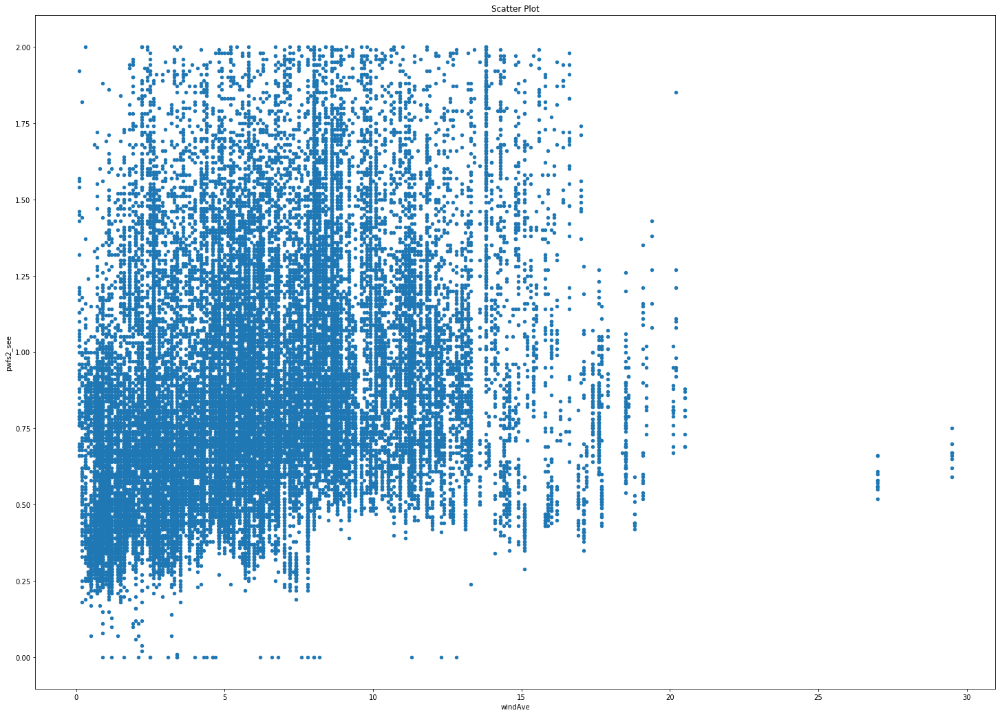

In [119]:
tfm9.plot.scatter(x='windAve', y='pwfs2_see', title='Scatter Plot', figsize=(25, 18) )

In [120]:
tfm9.drop(tfm9[(tfm9['windAve'] > 13 )].index, inplace=True)

In [122]:
tfm9.shape

(33275, 11)

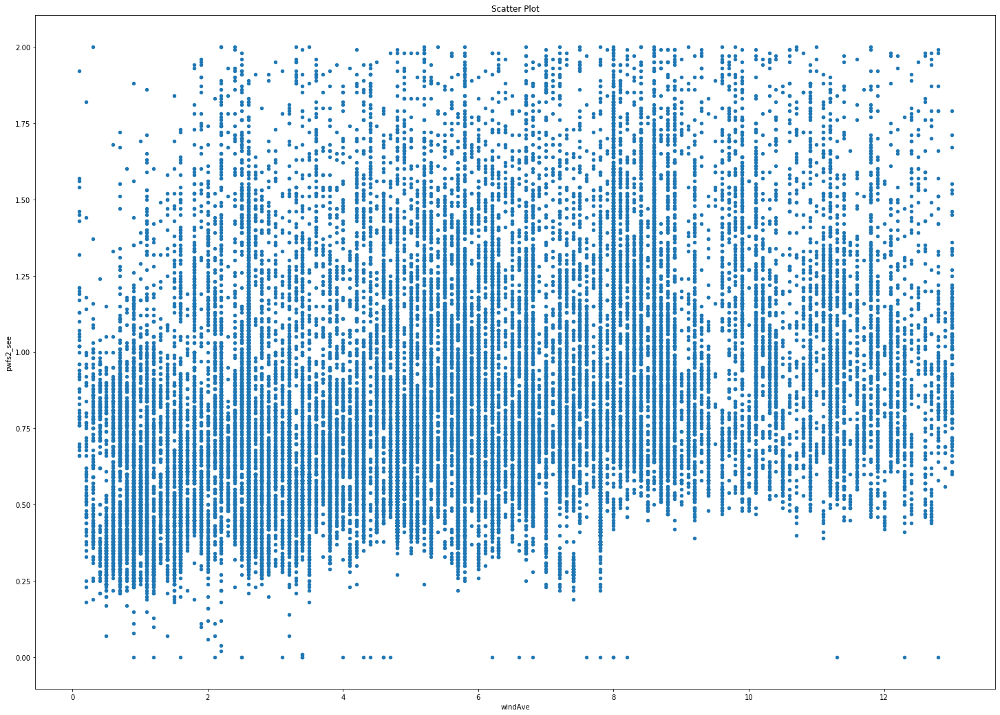

In [121]:
tfm9.plot.scatter(x='windAve', y='pwfs2_see', title='Scatter Plot', figsize=(25, 18) )